In [1]:
# libraries
import nltk
import pandas as pd
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import numpy as np
import csv
from nltk.stem import WordNetLemmatizer
import string
from nltk.corpus import wordnet
import re
import seaborn as sns

In [26]:
# nlts download
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package stopwords to C:\Users\Awais-
[nltk_data]     Mohammad\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to C:\Users\Awais-
[nltk_data]     Mohammad\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Awais-Mohammad\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [2]:
data=pd.read_csv('.\\Processed\\Split_Data\\Splitted\\train.csv',header='infer')

In [3]:
x=data[data['Sentiments']==1]
y=data[data['Sentiments']==-1]
z=data[data['Sentiments']==0]

C:\Users\Awais-Mohammad\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


[Text(0, 0, 'Positive'), Text(1, 0, 'Negative'), Text(2, 0, 'Neutral')]

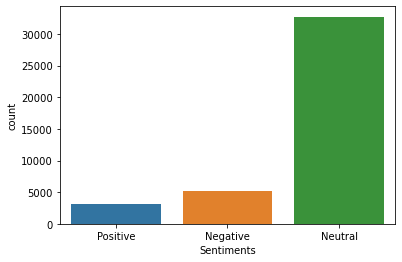

In [7]:
p=sns.countplot(data['Sentiments'])
p.set_xticklabels(['Positive','Negative','Neutral'])

In [8]:
# method to implement stop words removal
filteredSentences = []
def removestop():
    stop_words = set(stopwords.words('english'))
    r_txt = df['ReviewText']
    for i in range(0, len(r_txt)):
        sentence = []
        joinsentence = []
        word_tokens = word_tokenize(r_txt[i])
        for w in word_tokens:
            if w.lower() not in stop_words:
                sentence.append(w)
                joinsentence = (" ").join(sentence)
        filteredSentences.append(joinsentence)
    return filteredSentences

In [9]:
df=pd.read_csv('.\\Processed\\Split_Data\\Splitted\\train.csv',low_memory=False)
df.head(5)
removestop()

['nice comfy place stay . Rooms comfortable clean . Beds okay mine soft back hurting . kitchenette nice . staff friendly helpful well . Views great depending room situated . Nice gym use . gondola located end town hotel .',
 'really nice time hotel parents . room nice view nice well . best part stay restaurant inside hotel nice polite waitress named Wilj . fun family . thank lovely ...',
 'recommended us booking.com really friendly ! left luggage hotel checking flight evening really helpful that.The breakfast great ( cold cheeses , meats , cereals , juices , coffee , pastries , hard boiled eggs ) outdoor indoor dining area . short walk away train station convenient . also nice lounge area . Definitely worth go !',
 "tired arrived cranky baby . Pierre front desk helpful got us room quickly . difficulty door , handle pushed , instead , delayed us getting room . room clean though somewhat worn/dated ( old phones , ceiling bathroom areas needed repair/patched , carpet threadbare areas , et

In [29]:
writeExcel('AfterStopWords',filteredSentences)

ReviewText
removed col and added it back in also stored file
Sentiments
Wrong index


In [4]:
# write to excel
def writeExcel(Filename,data):
    for i in range(1, len(df.columns)):
        print(df.columns[i])
        if df.columns[i] == 'ReviewText':
            df.drop(df.columns[i], inplace=True, axis=1)
            df.insert(1, "ReviewText", data, True)
            df.to_csv('.\\processed\\'+Filename+'.csv', index=False)
            print('removed col and added it back in also stored file')
        else:
            print('Wrong index')

## =-=-=-=-=-=-=- Pos tagging and lemmitizatoin

In [10]:
# Pos tagging
def POS_taggs():
    for i in range(0, len(rTxt)):
        token = word_tokenize(rTxt[i])
        afterTag = nltk.pos_tag(token)
        tokened_Sen.append(afterTag)
    return tokened_Sen

In [ ]:
tokened_Sen = []
df=pd.read_csv('.\\processed\\AfterStopWords.csv',low_memory=False)
df.head(4)
rTxt = df['ReviewText']
POS_taggs()

In [13]:
def get_wordnet_pos(treebank_tag):
    print(treebank_tag)
    if treebank_tag.startswith('J'):
        return wordnet.ADJ
    elif treebank_tag.startswith('V'):
        return wordnet.VERB
    elif treebank_tag.startswith('N'):
        return wordnet.NOUN
    elif treebank_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN

In [ ]:
lemmitized=[]
lemmatizer = WordNetLemmatizer()
for i in range(0,len(tokened_Sen)):
    sentence = []
    joinsentence = []
    for j in range(0,len(tokened_Sen[i])):
        word=lemmatizer.lemmatize(tokened_Sen[i][j][0].lower(),get_wordnet_pos(tokened_Sen[i][j][1]))
        sentence.append(word)
        joinsentence = (" ").join(sentence) 
    lemmitized.append(joinsentence)

JJ
NN
NN
NN
.
NNP
JJ
NN
.
NNP
JJ
NN
JJ
RB
VBG
.
NN
JJ
.
NN
RB
JJ
RB
.
NNS
JJ
JJ
NN
VBN
.
NNP
NN
NN
.
NN
JJ
NN
NN
NN
.
RB
JJ
NN
NN
NNS
.
NN
JJ
NN
RB
RB
.
JJS
NN
NN
JJ
JJ
NN
JJ
JJ
NN
VBN
NNP
.
NN
NN
.
NN
RB
:
VBD
PRP
VB
RB
JJ
.
JJ
JJ
NN
VBG
NN
VBG
RB
JJ
NN
NN
JJ
(
JJ
NNS
,
NNS
,
NNS
,
NNS
,
NN
,
NNS
,
RB
VBD
NNS
)
VBP
JJ
VBG
NN
.
JJ
NN
RB
JJ
NN
NN
.
RB
JJ
NN
NN
.
RB
JJ
VBP
.
VBN
VBD
JJ
NN
.
NNP
JJ
NN
JJ
VBD
PRP
NN
RB
.
NN
NN
,
VB
VBN
,
RB
,
VBD
PRP
VBG
NN
.
NN
JJ
IN
RB
VBN
(
JJ
NNS
,
NN
NN
NNS
VBN
VBD
,
NN
NN
NNS
,
FW
.
)
.
JJ
NN
NN
VBP
PRP
VB
JJ
NNS
VBP
NN
NN
POS
NN
.
VB
NN
VBD
PRP
NNP
RB
JJ
NN
VBD
RB
JJ
NN
NN
NN
.
NNP
NN
CC
NN
:
NN
,
VB
NNP
,
NN
RB
JJ
VBN
RB
,
RB
VBD
PRP
VB
JJ
JJ
NN
,
NN
NN
VBG
JJ
NN
,
NN
JJ
RB
CD
NNS
VBG
NN
NN
NN
.
.
NN
:
VBN
NN
.
JJ
:
NNP
NN
NN
,
NN
,
NN
.
JJ
NN
RB
JJ
JJ
NN
NN
RB
RB
RB
JJ
NN
NN
VB
JJ
NNS
NN
.
NN
RB
JJ
NN
JJ
NN
NNS
VBP
NN
JJ
NN
CD
JJ
NNS
JJ
JJ
NN
,
NN
RB
JJ
JJ
RB
VBP
IN
NNS
RB
,
NN
.
NN
RB
JJ
NN
.
NN
NN
CD
NNS
NNP
NNP
.
JJ
NN
NN
NN
NN
.
JJ
JJ
NN
VBD
V

JJ
NNS
.
VB
RB
NN
VB
NNS
NNP
VBD
.
JJ
NN
.
NNP
JJ
NNP
.
RB
VBD
CD
NN
NN
NN
VBG
NNP
NNP
NNP
.
MD
VB
VB
.
NNP
NN
JJ
JJ
NN
NNP
NN
RB
JJ
.
NNS
JJ
NN
RB
MD
VB
NNP
NNP
NNP
NNP
.
NN
NN
NN
NN
.
NNP
NNP
NN
NN
,
NN
JJ
NN
VBN
JJ
NN
NN
JJ
NNP
:
JJ
NNS
JJ
JJ
NN
.
JJ
NNS
NN
NN
,
JJ
JJ
NNS
.
MD
RB
VB
RB
VB
JJ
NN
NN
JJ
JJ
NN
NNP
NNP
VBZ
JJ
NN
.
VBN
NN
.
NN
VBZ
NNP
NN
,
JJ
JJ
.
POS
JJS
JJ
JJ
RB
JJ
NN
:
JJ
NN
.
JJ
NN
NN
NN
NNP
.
NN
.
JJR
,
RB
JJ
NN
NN
.
JJ
NN
JJ
NN
.
NNP
NN
NN
NN
.
VBG
JJ
:
NN
NN
VBP
JJ
NNS
.
MD
RB
VB
.
RB
JJ
NNS
NN
VBD
.
NN
NNS
VBP
CD
NNS
,
RB
JJ
VBG
JJ
JJ
NNS
.
JJS
NN
NNS
VBP
NN
VBG
CD
NN
NN
RB
RB
.
NNP
VBZ
,
CD
NNS
,
POS
JJ
NN
VBP
RB
VBN
.
CD
)
NN
JJ
NN
.
VB
JJ
NN
JJ
NN
)
NNP
:
UH
,
POS
JJ
JJ
RB
VBD
NN
VBG
NNP
:
CD
NN
IN
JJ
NN
)
NNP
JJ
NN
.
NN
NN
JJ
JJ
NNP
NN
.
CD
)
NNP
RB
JJ
NNP
NN
NN
NN
NN
)
NNP
NN
NNS
JJ
,
JJ
NN
JJ
NN
NN
NNS
.
JJ
NN
VBP
RB
JJ
JJ
NN
.
NNP
CD
.
NNP
)
RB
VB
IN
CD
NN
.
NNS
RB
VB
JJ
,
JJ
NN
NN
,
NNS
JJ
NN
NN
RB
JJ
.
RB
,
NN
NN
NN
)
JJ
NN
VBZ
NNP
MD
RB
VB
IN
NN
.
RB
MD


RB
VBG
JJ
NNS
RB
VBP
VBN
NN
JJ
NN
NN
.
RB
JJ
JJ
NN
VBD
NN
NN
JJ
CD
.
CD
NNS
IN
JJ
VBD
NN
.
VBN
RB
VB
JJ
NN
NN
NN
.
NN
VBD
,
RB
VB
JJ
NN
JJ
RB
VBG
JJ
NN
.
NN
VBD
CD
,
JJR
CD
NNS
VBP
.
JJ
JJ
.
NN
VBP
JJ
NN
.
JJ
VBN
.
VBD
RB
JJ
JJ
NN
VBN
JJ
NN
.
JJ
JJ
NN
NN
NNP
RB
NN
.
RB
VB
RB
NN
,
NN
.
VBD
NN
VBG
NN
,
RB
JJ
JJ
VBN
NN
NN
NN
NN
.
NNP
,
JJ
NN
RB
JJ
NN
VBD
NN
CD
JJ
NN
.
NNP
JJ
NN
NN
NNP
RB
.
NNP
JJ
NNS
:
RB
$
CD
,
NNP
NNS
RB
.
NNP
VBD
NN
NN
VBG
JJ
NNS
,
NN
NN
.
VB
$
CD
NNP
.
NN
VBP
RB
VB
.
VB
NNP
NN
JJ
RB
NN
VBG
RB
.
VB
NN
IN
NN
DT
NNP
VBG
NN
RB
RB
VB
NNS
.
RB
RB
RB
$
CD
(
JJ
NNP
NNS
)
,
MD
RB
VB
JJ
JJ
NN
.
MD
RB
VB
NN
IN
RB
JJ
JJ
NN
.
UH
JJ
JJ
NN
NNS
JJ
NN
,
RB
NNP
,
NN
NN
JJ
NN
NN
CD
NNS
VBG
,
VBG
,
NN
RB
VBD
JJ
NN
NN
JJS
RB
$
CD
JJ
NN
NN
NN
.
VB
RB
MD
VB
NN
CD
NN
CD
NN
.
VB
JJ
.
JJ
NN
NN
.
VBG
NNP
,
VB
VBP
JJS
CD
NN
NN
.
NNP
,
JJ
NNS
JJ
NN
.
NNP
JJ
JJ
.
NN
NNS
CC
NN
:
NN
NN
NNS
VBP
NN
.
JJ
NN
JJ
JJ
NNS
.
NNP
VBD
NN
.
VBN
JJ
NN
NN
NN
JJ
NN
JJ
NN
NN
VB
.
CC
JJ
JJ
NN
NN
JJ
.
NN
NN
,
JJ
JJ
V

NN
NN
:
NN
NNP
.
NN
NNS
(
CD
NNS
IN
NN
)
,
VBP
NN
NN
NN
:
JJ
NN
.
VBP
NN
JJ
NN
VBG
.
NNP
JJ
,
IN
CC
NN
:
JJ
NN
.
NN
VBD
NNP
NNP
NNP
CD
NNS
NNP
CD
,
VBD
,
JJ
NNP
,
IN
NN
,
NN
,
NN
CD
NNS
RB
NN
NNP
NNP
.
NN
NN
MD
VB
CD
JJ
NN
,
IN
POS
POS
.
VBP
CD
NNS
,
IN
JJ
RB
NN
.
RB
RB
JJ
IN
JJ
,
JJ
NN
.
NN
,
''
NNP
POS
NN
,
RB
JJ
VBN
,
''
POS
POS
NNP
POS
NN
.
VBP
,
JJ
NN
NNP
NNP
,
NNS
NNP
NNP
,
JJ
VB
VBN
NNP
POS
JJ
NN
NN
.
RB
,
NN
NNP
NN
NN
NN
,
NN
NN
,
VBD
JJ
NN
NN
NN
:
JJ
NN
:
VBN
NN
.
NN
NN
VBG
VBG
NN
NN
.
NNP
NNP
NN
NN
NN
NN
POS
CD
NN
VB
NN
.
NN
,
IN
NNP
NNP
NN
NN
.
VB
VBG
RB
.
VBN
JJ
NN
CD
NN
.
VB
NN
VBN
NN
NN
.
VBD
CD
NN
NN
JJ
NN
JJ
NN
JJ
NNS
JJ
NN
JJ
NN
NN
JJ
NN
,
JJ
NN
VBD
NN
JJ
NNS
VBP
RB
NNP
NNP
NN
,
RB
RB
JJ
.
VBG
JJ
CC
NN
:
NNP
CC
NN
:
NN
JJ
RB
.
JJ
NN
NNP
JJ
NNS
NN
.
MD
VB
NN
JJ
NN
:
JJ
NNS
NNS
NNP
NNP
VBD
JJ
NN
NN
RB
VBD
JJ
JJ
NN
NN
NNS
VBD
.
NNS
,
NN
NN
.
NN
NNS
VBP
JJ
NN
NNS
VBG
NN
NNP
NNP
NNS
NNS
VBP
NN
.
RB
JJ
NNS
NN
NNP
.
VBP
VBN
NN
NN
VBD
NN
NN
,
VBG
JJ
NN
NN
VBG
JJ
DT
NN
.
(
VBZ


JJ
NN
.
NNP
,
VBD
NN
NN
,
JJ
NN
NN
NNS
,
JJ
NN
,
JJ
NN
JJ
VBP
NN
RB
.
IN
NN
,
NNP
,
DT
NN
VBD
NN
,
VBZ
JJ
NN
NN
NN
,
VBD
JJ
JJ
NN
IN
,
JJ
VBP
JJ
NN
NNP
NNP
.
NNP
NNP
NN
NNS
DT
NN
NN
NN
.
JJ
.
JJ
NN
EX
NNS
NNS
RB
VBP
JJ
NN
NN
.
VBG
NN
NNS
,
NN
NNS
,
JJ
NNS
JJ
NN
NNS
NN
NN
VBD
NNS
.
NNP
IN
NN
NN
NN
,
VBG
NN
IN
RB
VBG
VBG
NN
.
NN
VBD
CD
NNS
NN
CD
NN
NN
NNP
MD
RB
VB
JJR
NN
.
RB
VBN
JJ
JJ
NN
NNP
NNP
NNP
VBZ
JJ
.
VBN
NNP
NNP
NNP
VBD
JJ
NN
,
JJ
VBD
JJ
NN
NN
.
CD
NN
JJ
NNS
NNS
.
NN
VBZ
RB
JJ
,
RB
NNP
.
NNP
VBD
RB
VBD
NN
JJS
NN
NN
DT
NNP
VBD
NN
NNP
NNP
CD
VBD
PRP
PDT
NN
RB
.
.
JJ
.
.
''
POS
NN
NN
VBG
:
$
CD
IN
NN
NN
NN
,
RB
JJ
VBN
NN
MD
VB
JJ
NNP
.
MD
RB
VB
IN
.
.
NNP
NN
.
NNP
NN
NN
JJ
.
NN
VBD
NN
POS
JJ
NNS
JJ
NN
.
NN
NN
NNS
JJ
JJ
NN
.
NN
NN
JJ
NN
NNP
NNP
,
JJ
NN
JJ
,
RB
JJ
JJ
NN
POS
IN
.
NNP
RB
JJ
NN
NNS
VBP
NN
NN
JJ
.
JJ
IN
NN
JJ
VB
RB
NNP
NNP
NN
NNP
NNP
NNS
.
NN
NNP
NNP
POS
CD
NNS
VBD
CD
JJ
NNS
IN
:
NNP
NNP
.
CD
NN
(
NNP
)
CC
NN
:
CD
NN
.
VBN
.
NNP
JJ
NN
NN
JJ
NN
RB
.
VB
NN
NN
.
JJ
NN
NN
NN

NN
NN
NN
RB
JJ
.
NN
VBZ
JJ
RB
VBP
NN
JJ
JJ
NN
RB
JJ
NN
.
NN
RB
NNP
.
NN
JJ
NN
VBD
CD
NNS
RB
VBP
.
VBN
IN
VBG
NN
RB
JJ
NNS
,
VBG
NNS
NN
.
NN
RB
JJ
.
VB
NN
NN
NN
.
RB
IN
JJ
NN
,
NN
JJ
NN
MD
VB
,
NNP
NN
VBD
JJ
.
JJ
NN
NN
VBZ
VBG
NN
,
VBP
JJ
VBZ
JJ
.
NN
JJ
,
RB
VBN
.
NN
NN
,
JJ
.
VBN
JJ
JJ
.
VBG
VBN
JJ
NN
NN
VBD
RB
NN
NN
VBD
.
RB
JJ
NNS
,
NN
NN
NN
NN
JJ
.
JJ
NNS
VBN
NNS
,
JJ
NN
RB
.
RB
JJ
JJ
NN
.
VBG
JJ
NN
,
VB
NNP
RB
NN
,
MD
RB
VB
.
RB
RB
NNP
NN
NN
.
NNP
CD
NN
NN
NNP
NN
.
NNP
JJ
JJ
.
NNP
NN
NN
NN
NN
.
NNP
NN
NN
.
NNP
NN
NN
NN
.
JJ
NN
JJ
NN
.
MD
RB
VB
NN
NN
.
NNP
NN
JJ
NN
.
NN
NNS
RB
,
JJ
,
JJ
JJ
NN
.
NNP
VBZ
JJ
NN
,
VBD
PRP
NN
NNS
,
NNS
VBD
PRP
VBN
NNS
NNP
.
RB
VBP
PRP
JJ
NNS
,
NNS
NNS
NNP
NNP
.
JJ
VBP
JJ
NN
,
NN
,
NN
NNS
VBP
NN
NN
NNP
NNP
NNP
JJ
,
NNS
VBP
NN
NN
JJS
NN
VBP
RB
RB
VBN
NNP
NNP
.
VBD
JJ
RB
NN
VBD
PRP
RB
,
JJ
JJ
NN
JJ
NN
.
.
NN
JJ
NN
JJ
.
.
JJ
JJ
NN
.
.
JJ
NN
RB
JJ
.
RB
JJ
NN
NNS
.
NNP
POS
NN
NN
,
NNP
NNP
NNP
NN
JJ
NN
NNS
.
NN
NN
JJ
.
NNP
JJ
NNS
.
NNS
VBD
NN
VBD
RB
JJ
NN
,
RB


NN
.
NN
NN
,
JJ
,
NNP
,
JJ
NNP
,
RB
JJ
NN
.
RB
JJ
NN
:
VBG
RB
.
JJS
,
JJ
NNP
NN
,
VBD
CD
CD
NNS
,
CD
NNS
.
NNP
NNP
VBZ
NNP
NN
NN
NN
.
VBN
NNP
,
RB
NNP
NN
RB
JJ
.
NNS
RB
JJ
,
JJ
JJ
.
NNP
NN
,
JJ
NN
NN
NNS
RB
JJ
NN
NNP
RB
JJ
NN
,
VBG
NN
POS
JJ
NNS
.
NNP
RB
VBG
,
JJ
NN
NN
,
CD
NNS
VBD
VB
RB
NN
,
JJ
NN
,
RB
JJ
,
JJ
NN
VBZ
JJ
NN
NN
NN
.
NNP
NN
,
JJ
JJ
JJ
NNP
NN
,
JJ
JJ
.
.
NN
NN
,
RB
JJ
NNS
IN
NNS
.
.
RB
JJ
NN
,
NN
IN
NN
,
RB
NNS
NN
.
CD
JJ
NNS
NN
(
NNP
NNP
)
JJ
JJ
NNS
VBP
NN
JJ
VBZ
RB
.
NNP
RB
VBD
VB
VB
RB
RB
VBD
NN
NN
.
RB
NNS
VBG
NN
NN
,
NN
NN
NN
VBD
NN
RB
JJ
.
.
RB
VBG
RB
VBN
NN
NNS
:
NN
.
VBN
NN
RB
NNP
NNP
POS
JJ
JJ
JJ
NNP
NN
NNP
NNP
JJS
NN
,
RB
VBP
.
VBN
JJ
NN
NNP
IN
NN
NNP
NN
NN
VBG
JJ
NN
VBN
JJ
VBD
:
JJ
NN
,
CD
JJ
NNS
JJ
NN
,
RB
JJ
CD
NN
JJ
NNS
,
JJ
NN
NNS
,
JJ
NN
NN
VBD
JJ
NN
,
VBG
NN
NN
,
JJ
NN
NN
,
NN
NN
.
NN
NN
CD
NN
NNP
$
CD
(
NNP
$
CD
NN
)
FW
NN
VBD
JJ
NN
VBG
VBD
JJ
NN
NN
,
NN
VBD
.
VB
NN
,
JJ
NN
JJ
NN
NN
NN
VBD
JJ
NN
RB
VB
VB
RB
JJ
JJ
NN
,
VBD
JJ
JJ
NN
IN
NN
.
JJ
NN
,
VBZ
NNS

RB
VB
NN
.
.
VBG
NNP
IN
VBG
RB
.
NN
,
NN
NN
NNS
RB
NNP
,
NN
VBG
RB
JJ
NNP
NNP
NNP
NN
RB
JJ
RB
,
JJ
NN
,
VB
RB
VBN
NNS
.
NNP
NN
,
JJ
NN
JJ
NNS
RB
VBP
VBG
NN
NNP
,
VBD
JJ
NN
CD
NNP
NNP
NNP
.
VBD
NN
IN
VBG
NN
JJ
NNS
IN
NNP
NNP
,
MD
RB
VB
NN
VBG
RB
.
NN
NN
.
JJR
NN
,
RB
VB
.
NNS
NN
VBP
VBN
NN
.
NN
NN
,
VBN
NNS
,
VBD
JJ
.
MD
RB
VB
.
JJ
NNS
NNP
NNP
VBP
JJ
NNP
IN
RB
JJ
.
VB
RB
JJ
.
VBG
JJ
JJ
NN
RB
JJ
NN
.
JJ
NN
JJ
NNP
NNP
NN
.
JJS
NN
NN
,
JJ
NN
JJ
RB
.
VBG
NN
JJ
,
NN
NN
,
RB
NN
:
NN
JJ
NN
.
NN
JJ
.
NN
.
NN
JJ
.
RB
:
NN
NN
.
RB
JJ
:
NN
RB
NN
NNP
NN
.
RB
JJ
RB
JJ
NN
.
JJ
NN
NN
NN
NN
NN
NN
NN
NN
.
NN
JJ
NN
RB
JJ
NN
RB
JJ
NN
.
RB
JJ
NN
.
UH
,
NNS
RB
JJ
,
JJ
NN
JJ
RB
JJ
JJ
VBG
NN
NN
NN
NN
NN
JJ
NNS
.
JJ
JJ
NN
,
JJ
NNS
JJ
NN
,
VBZ
RB
VBN
JJ
NN
.
VB
IN
VBG
NN
,
NNS
VBP
(
NN
VB
,
NNS
,
NN
,
NNS
,
NN
NNP
CC
NN
:
FW
.
.
.
)
NN
NNS
.
VB
JJ
NN
NNS
NNP
.
NNP
POS
JJ
NN
.
CC
JJ
NN
:
:
)
VBD
NNP
.
NNP
CD
NNS
NNP
VBN
.
JJ
NN
.
VB
NN
RB
RB
NN
IN
NNP
NNS
.
NN
JJ
NN
.
NN
VBD
RB
,
VB
VBN
JJ
JJ
JJ
JJ
NN
NN
JJ
NN
(

.
NN
VBD
CD
,
NN
.
RB
JJ
NN
NN
NN
NNP
JJ
JJ
NNP
POS
NNS
,
JJ
VBG
NNS
NN
,
NN
,
NNS
NNS
JJ
NN
RB
NNS
VBG
NNS
CC
NNP
RB
,
RB
,
RB
JJ
NN
VBD
JJ
NN
.
JJ
,
JJ
VBP
JJR
NN
NN
NN
NNS
VBP
NN
.
VB
JJ
NN
IN
RB
VB
NN
NN
NN
NN
NN
.
NN
NNP
,
RB
JJ
NN
NN
.
VBN
NN
NN
CC
NN
:
CC
VB
CC
VB
:
PRP
NN
NN
NNP
.
NN
JJ
.
NN
JJ
,
JJ
,
JJ
.
NN
NN
JJ
,
JJ
.
NN
JJ
NN
.
VBD
JJ
NN
VBP
JJ
NNS
.
JJ
NN
JJ
,
VB
NN
.
MD
VB
VBG
NNP
RB
,
RB
JJ
NN
.
JJ
JJ
NN
MD
VB
VB
JJ
NN
NN
.
VBZ
CD
NN
NN
NNP
NNP
.
NN
JJ
JJR
NN
VBN
,
VBG
NNS
,
NN
,
NNS
,
NN
,
NNS
.
RB
MD
VB
NN
RB
JJ
.
JJ
NN
NN
NNS
RB
MD
RB
VB
.
NN
NN
,
JJ
NN
NN
NN
VBD
NN
JJ
JJ
NN
NN
.
VB
JJ
JJ
NN
RB
VBG
NN
.
NN
JJ
:
)
RB
,
JJ
NN
NNP
,
VBD
JJ
.
JJ
JJ
NNS
NN
,
NN
,
RB
VBN
NN
NN
NN
.
VBD
JJ
NN
NN
,
JJ
,
RBR
VBG
NN
VBZ
JJ
NN
NN
,
VBP
CD
NNS
NNS
.
VBD
NN
,
JJ
,
NN
.
JJ
NNP
,
RB
JJ
NNP
NNP
.
JJ
JJ
NNS
,
VBD
CD
NNS
VBP
NN
,
JJ
.
NNP
JJ
,
NN
JJ
,
MD
VB
NNP
NNP
.
JJ
NN
VBD
JJ
VB
JJ
NN
NN
JJ
NN
,
,
VBN
NN
CD
NNS
,
VBD
NN
NNP
NNP
.
JJ
NN
NNP
NNP
NNP
NN
.
NN
CC
NN
:
CC
VBD
JJ
NN
JJ
N

NN
NN
NNS
(
JJ
)
,
RB
JJ
JJ
NNS
JJ
VBP
RB
VBG
JJR
NN
NN
.
JJ
NN
NN
NN
NN
NN
NN
NN
VBD
NN
NN
.
NNS
VBP
RB
VBN
.
NN
JJ
JJR
NNS
RB
JJ
JJ
NNS
.
NNP
NN
NNP
NNS
.
JJS
NN
POS
JJ
JJ
NN
NN
JJ
JJ
NN
.
VBN
NN
NN
VB
NN
,
RB
JJ
.
:
)
IN
NN
,
VBD
VBN
CC
NN
:
NN
NN
CC
NN
:
NN
VBD
JJ
NN
NN
.
,
VBD
NN
NN
VB
:
NNP
:
NN
.
.
RB
VBG
,
RB
VBD
NN
.
POS
CD
NNS
VBP
RB
DT
NNS
JJ
NN
.
POS
NN
JJ
JJ
NNS
NN
NN
NNS
.
NN
JJ
NN
NN
NN
NN
.
RB
JJ
.
NNP
CD
NNS
NN
NNP
VBG
NNP
VBD
JJ
NN
NN
JJ
NN
.
NN
RB
JJ
IN
JJ
NN
,
MD
VB
NNP
VBD
PRP
VBP
VB
JJ
NNS
:
VBD
CD
NN
VBG
RB
CD
:
NN
NNP
.
NNP
VBD
NN
NNS
RB
NN
.
NN
JJ
VBG
NN
VBG
VBD
JJ
JJ
:
JJ
JJ
NNP
NN
,
VBG
JJ
NNP
:
NN
MD
.
NNP
RB
VBD
JJ
NN
NN
NN
NNS
VBP
NNS
JJ
NNS
NNS
NNS
IN
CD
NNS
VBP
.
NN
VBD
JJ
NN
NNS
VBP
.
JJ
NN
NNP
NNP
,
NNP
NNP
NN
,
NN
.
VB
JJ
NNS
RB
NNS
JJ
NNS
:
NN
JJ
VBP
RB
JJ
CD
.
.
NN
NNP
NNP
NNP
CC
NN
:
NNP
VBD
VBG
NN
(
VBG
)
NNP
,
RBR
JJ
NN
DT
NNP
CC
NN
:
NNP
NNP
NNP
,
VBD
RBR
VB
NN
RB
VBN
.
VB
VBN
JJ
NN
IN
JJ
CD
NNS
JJ
.
VBN
NN
NNP
,
NN
,
NNS
,
VBN
NN
.
VBN
JJ
NN
NN

VBG
VBZ
NNP
NNP
VBD
.
NNP
.
(
NNP
:
NN
JJ
JJ
NN
NN
:
)
NNS
:
:
NN
NN
.
NN
.
VBG
JJ
NNS
VBD
JJ
VBN
NNS
VBP
VB
NNS
(
RB
,
JJ
NN
NN
VBP
JJR
NN
)
:
POS
JJ
NN
,
VBG
JJ
NN
NN
NN
JJ
:
JJ
NN
NN
:
MD
VB
MD
VB
NNS
.
VBD
.
.
.
UH
,
VBN
.
NNP
NNP
NNP
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NNP
NNP
CD
NNS
VBP
VBG
NNP
NNP
.
POS
JJ
NN
.
NNP
NN
RB
JJ
VBG
JJ
NNP
.
VBN
JJ
NN
VBG
JJ
CD
NN
VB
NNP
.
NNS
CD
CD
RB
VBN
,
JJ
RB
JJ
.
NN
JJ
JJ
NN
.
CD
NNS
.
RB
JJ
JJ
NN
.
JJR
NN
CD
JJ
JJ
NN
JJ
NN
NN
.
(
NNP
CD
NN
NN
:
IN
NN
:
RB
VBP
VBN
RB
)
VBD
JJ
.
NN
NN
CD
NN
.
NNP
CD
NN
NN
NN
NNS
.
NNP
CD
CD
NN
NN
CD
JJ
.
JJ
NNS
NN
NNS
MD
VB
JJ
VBG
NNS
.
NN
NNS
.
VBG
NNP
JJ
NN
NN
VBD
VBG
NN
.
VBN
IN
NN
NN
JJ
NNP
NNP
NN
VBD
.
JJ
NN
.
MD
RB
VB
.
RB
JJ
NN
NNP
.
NN
VBD
NN
NNP
NNP
.
NNP
RB
JJ
$
CD
JJ
JJ
RB
VBN
NN
.
NN
JJ
JJ
.
JJ
NNS
JJ
NN
,
CD
RB
.
VB
NN
,
JJ
NN
,
NN
NNS
NN
MD
RB
VB
.
NNP
VBD
.
MD
RB
VB
JJR
NN
,
RB
CD
NNS
RBR
RB
.
(
VBD
JJ
NN
.
)
NN
JJ
NN
.
NN
JJ
NN
VBN
.
JJ
NN
NNS


VBP
JJ
NNS
JJ
NN
,
RB
JJ
NN
RB
JJ
VBP
VBG
RP
,
RB
VBD
CD
NN
,
NN
,
VBD
NN
NN
NN
NN
VBG
PRP
NNS
NNS
VBP
NNP
RB
VBD
NN
PRP
.
NN
JJ
VBN
NN
JJ
NN
NN
VBD
JJ
NNS
.
NN
.
(
NNS
VBP
RB
JJ
.
)
VBP
VBG
NN
NN
NN
VB
NNP
CD
NNP
VB
JJ
RB
.
JJ
NN
.
JJ
JJ
JJ
NN
VBD
JJ
NN
NN
NN
.
NN
NN
VBP
NN
NN
VBP
NNS
JJ
NNP
NN
NN
NN
NNPS
.
NN
:
JJ
NN
VBP
RB
VB
JJ
:
POS
NNP
,
JJ
NN
VBP
JJ
NN
NN
.
NNS
NN
.
NNP
CC
NN
:
NNP
POS
NNP
.
NN
NN
.
NN
VBD
CD
NN
(
CD
NNS
,
JJ
NN
:
NN
,
JJ
NNS
)
,
NN
RB
NN
VBG
JJ
NN
.
NNP
VBD
PRP
NNP
NNP
POS
NN
JJ
NN
,
RB
VBD
JJ
IN
NN
NN
.
VB
NN
:
NN
,
JJR
NN
VBD
JJ
NN
VBG
NN
,
VBD
NNP
JJ
NN
MD
VB
.
RB
,
RB
VBD
PRP
NN
VB
PRP
RB
JJ
NNP
,
CC
NN
:
JJS
NN
NNP
.
CC
NN
:
NNP
NNP
CC
NN
:
NNP
JJ
JJ
NN
NN
,
NN
NN
RB
JJ
NN
(
JJ
NN
NN
,
RB
)
.
NN
RB
VBZ
NNP
POS
NN
NN
:
CC
NN
:
NNP
,
VB
POS
NN
.
CC
NN
:
(
JJ
NN
)
.
VBN
NN
JJ
NN
JJ
NN
NNP
NNP
.
JJS
NNS
VBD
JJ
NN
NN
VBD
NN
JJR
JJ
,
VBD
JJ
JJ
NN
VBD
JJ
NNP
NN
NN
VBD
JJR
NN
RB
RB
NNS
VBP
JJ
NN
NNS
NNP
NNP
.
NN
NN
VBD
NN
NN
VBD
RB
MD
VB
JJ
NN
NNS
RB
VBG
.
VBN
NN


NN
NNP
NN
VBP
JJ
NNP
MD
VB
NN
VBP
.
VBN
CC
NN
:
CC
CC
NN
:
NN
CD
NN
NN
VBD
JJ
NNP
NNP
.
NNP
NNP
NN
.
JJ
NNS
,
NN
NN
(
VBG
NN
NN
,
NN
NNS
,
JJ
NN
)
.
RB
JJ
.
RB
VBN
CD
NNS
NNP
CD
:
JJ
JJ
NN
MD
RB
VB
JJR
NN
JJ
NN
NN
,
RB
RBR
JJ
NN
NNS
VBP
NN
VBP
JJ
JJ
NN
.
NNP
JJ
NNP
VBD
VBG
PRP
,
RB
NN
NN
VBP
NN
JJ
NNS
.
(
RB
VB
,
NNS
MD
)
VB
MD
VB
VB
JJ
NNS
NN
NNS
,
RB
VB
NNP
POS
NN
.
NNP
NNP
NN
NN
NN
JJ
NN
.
NNP
NN
JJ
NN
NN
.
RB
JJ
VBP
VBN
VBG
NNP
NN
NNS
VBP
NN
.
NN
JJ
NN
.
NN
VBD
JJ
NNS
NN
.
NNP
NN
NN
NN
JJ
NNP
JJ
NN
.
NNS
JJ
NNP
NNP
JJ
NN
NN
,
NNP
VBG
NN
NN
NN
VBG
JJ
NN
NNP
NNP
NNP
NNP
NN
.
JJ
JJ
NN
JJ
JJ
NN
NN
.
NNS
VBP
RB
NNP
,
VBP
DT
NN
NN
.
RB
,
NNP
NNP
NNP
NNP
JJ
NN
,
RB
RB
VBN
JJ
JJ
NN
.
NNP
JJ
NNS
JJ
NN
.
JJ
NN
,
RB
RB
,
VBG
NN
NN
.
NNP
NN
NN
,
JJ
NN
JJ
NN
.
NNP
JJ
NN
NNP
.
RB
NN
JJ
JJ
NN
:
CD
NN
,
JJ
NN
NN
NN
NN
.
NN
MD
VB
RB
JJ
JJ
NN
NN
JJ
NN
NN
RB
JJ
NN
VBG
NN
,
MD
RB
VB
.
JJ
VB
NNP
,
JJ
NN
NN
NN
,
NN
NN
,
VBZ
RBR
JJ
,
JJ
JJ
NN
NN
NNS
CD
JJ
CC
NN
:
NN
.
NNP
RB
VBD
JJ
NN
.
VBD
RB
CD
NNS
NN


NN
JJ
NN
JJ
NN
JJ
.
NN
JJ
NN
RB
JJ
.
RB
VB
RB
JJ
VBG
JJ
JJ
NN
RB
VBP
CD
NNS
VBG
.
NNP
NN
NN
NN
VBD
JJ
NNP
JJ
NN
NN
NN
RB
JJ
JJ
CC
NN
:
NN
CC
NN
:
IN
.
NN
VBP
CD
NN
VBG
NN
.
,
JJ
NN
.
RB
NN
NN
NNP
JJ
NN
NN
NN
NN
VBZ
.
CD
NN
NN
NN
VBD
RB
NN
.
MD
VB
NN
VBN
JJ
JJ
NN
NN
NNP
JJ
NN
VB
NN
RB
NN
NN
NNP
.
NNP
JJ
JJ
JJ
NN
NN
NN
NNS
CC
JJ
NN
NNS
.
JJ
NN
NN
NN
NN
NN
RB
VBD
JJ
NN
NN
NN
VBD
CD
NN
NNP
.
NNP
,
NN
NN
JJ
VBD
NN
NN
PRP
VBP
PRP
NN
.
NN
NN
NN
VBN
RB
VBN
NN
VBD
JJ
CD
.
NN
JJ
JJ
.
NNP
NN
VBG
NNP
NN
NN
.
JJ
NN
JJ
NN
.
NNS
.
NN
NN
NN
.
NNP
VBD
JJ
NN
VBD
JJ
NN
.
RB
JJ
.
NNS
JJ
NN
NN
MD
RB
VB
JJ
.
NN
NNS
VBG
NN
.
JJ
,
JJ
NN
JJ
NN
NN
VBG
VB
NNS
.
NN
JJ
NN
NN
JJ
JJ
JJ
NN
NN
,
VBN
RB
VBG
NN
.
NNP
RB
JJ
NN
NNS
.
NNP
JJ
NN
NN
RB
VBP
NNP
,
NN
RB
JJ
NN
VBP
NNP
.
NN
JJ
NNS
:
JJ
NN
NN
VBD
JJ
,
CD
NN
MD
RB
VB
RB
VBG
JJ
VBG
NN
IN
VBG
NN
NN
JJ
:
MD
RB
RB
VB
NNP
JJ
NNS
,
NN
NNP
NN
NN
VBP
JJ
VBN
NN
JJ
NNP
NN
JJ
NN
,
NN
JJ
NN
NN
NN
.
RB
VBN
JJ
NNS
.
RB
VBD
NN
NN
JJ
NN
NN
.
JJ
NNS
NN
NN
RB
VB
JJ
POS
JJ
NN
CC
NN


JJ
NN
.
NN
JJ
NN
VBN
.
JJ
NN
NNP
JJ
NN
.
NN
VBD
CD
NNS
NN
NNP
.
JJ
NN
NN
,
NN
NN
:
JJ
JJ
NN
IN
VBG
NNS
.
NNP
NNP
VBN
VBG
NN
RB
VBN
.
NN
IN
NN
,
NN
IN
NN
.
VBN
JJ
JJ
NN
,
RB
VBN
RB
NNS
,
JJ
NNS
NN
VBN
NNS
.
NNP
NNP
JJ
JJ
NNS
,
NN
RBR
NNP
JJ
NN
.
RB
JJ
NN
NNS
VBP
JJ
NNP
NNP
NN
NNS
.
NNP
JJ
.
MD
VB
NN
.
NNP
NN
NNP
VBG
RB
VBN
VB
CD
NNS
:
.
NN
NN
.
IN
JJ
,
JJ
JJ
.
VBG
RB
VB
.
NNP
NN
JJ
NNP
NNP
NNP
.
NN
,
JJS
NN
NN
NNP
NNP
.
NNS
JJ
NN
JJ
,
VBG
NNP
NN
NNP
NNP
NNP
.
JJ
NNS
NNS
VBP
NN
.
NN
NNP
NNP
NNS
VBD
JJ
RB
NNP
RB
VBG
JJ
.
VBN
NNP
NNP
NN
NN
.
NN
VBD
NNS
:
JJ
,
JJ
,
JJ
,
JJ
NN
,
NN
NNS
.
NN
VBG
JJ
JJ
VBG
NNS
.
JJ
NN
JJ
NN
:
NNP
JJ
CD
NN
NN
VB
NN
,
JJ
NN
JJ
RB
NNS
,
VB
$
CD
NNP
NN
VBG
JJ
,
NNP
VB
JJ
$
CD
NN
RB
JJ
NN
.
JJ
NNP
NNP
CD
NNS
,
JJ
.
JJ
NN
JJ
JJ
NN
.
RB
VB
NN
.
MD
RB
VB
.
JJ
NN
,
JJ
NN
VBG
JJ
NNS
VBN
NN
JJ
JJ
NNS
.
NN
(
JJ
NN
NN
NN
)
NN
,
RB
VBN
,
JJ
,
JJ
RB
JJ
.
NN
RB
JJ
JJ
NN
,
JJ
NN
,
NNS
JJ
JJ
NN
JJ
NN
.
JJ
NN
NN
VB
JJ
NN
NN
.
NNS
JJ
,
JJ
JJ
NN
.
NNP
VBD
VBN
VBN
NN
JJ
NN
NN
VBN
N

VBG
NN
IN
IN
CD
NNS
RB
VBD
JJ
NN
NN
NN
,
VBP
NNS
VBP
NN
VBP
NN
.
CD
JJ
JJ
NN
.
RB
,
VBG
NN
RB
MD
RB
VB
CD
NN
VBN
DT
CD
NN
NN
CD
NNP
.
VBP
JJ
MD
RB
VB
JJ
NNS
NN
.
VB
MD
VB
NNP
NNP
NNP
.
JJ
NN
NN
.
NNP
VBZ
NNS
IN
VBG
NN
,
JJ
NN
JJ
NN
NN
.
POS
VB
RB
,
POS
VB
RB
.
VBD
CD
NNS
.
NNP
NN
,
NN
NN
NN
RB
NN
.
JJ
NN
.
JJ
NN
IN
NN
MD
VB
IN
NN
VBN
.
NNP
JJ
VBD
PRP
JJ
NN
DT
NN
.
VBD
NNS
VBG
NN
NN
NNP
.
JJ
NN
NN
NN
.
VBG
JJ
NN
VBG
NN
VBD
NNS
CD
NN
.
JJ
NN
NNP
NN
.
JJ
NN
.
IN
CD
NN
RB
JJ
NN
VBZ
JJ
NN
JJ
NN
NNP
NN
.
NN
NN
NN
.
NNP
NN
.
CD
NN
JJ
NN
VBD
NN
NN
NN
RB
,
NNS
POS
NN
NN
.
NNP
NN
RB
JJ
.
NNS
RB
JJ
IN
NN
RB
JJ
.
NNP
NN
NN
.
RB
VBD
JJ
NNS
VBG
NN
.
JJ
RB
NN
NN
.
RB
VBZ
JJ
NN
.
NN
RB
CD
NN
NN
RB
JJ
NN
NN
NNP
.
VB
JJ
NN
JJ
NN
NN
,
NN
,
NN
RB
JJ
NN
NN
.
MD
VB
.
NNP
JJ
RB
RB
JJ
NN
CD
NN
.
VBN
NNP
JJ
NN
NNP
:
CD
NN
NN
NN
NN
VBD
JJ
NN
JJ
JJ
NN
MD
VB
(
RB
)
.
NNP
JJ
JJ
(
VBG
VBN
NN
)
:
JJ
NN
JJ
VBZ
NN
:
:
(
.
NNP
NN
JJ
NN
NN
NN
(
NNP
)
:
VBN
NN
NN
NN
NN
VBG
NN
NNP
:
VBD
RB
,
RP
NN
NN
NNS
NN
NN
.
(
JJ
NN
M

JJ
NN
CD
.
NNS
VBD
JJ
RB
VBN
.
NNS
RB
JJ
.
NN
JJ
NN
.
JJ
NN
NN
NNP
JJ
.
,
NN
MD
RB
VB
NNP
NN
POS
NN
.
JJS
RB
NN
POS
NN
.
MD
VB
NN
.
VBN
JJ
RB
JJ
VBN
.
NNP
JJ
NNS
,
JJ
NN
NN
.
NNP
JJ
JJ
NN
NN
NN
NN
NN
NNS
JJ
NNP
NN
IN
NN
MD
VB
JJ
NN
.
NN
VBD
JJ
NNP
VBD
.
NNP
NN
RB
NN
NN
.
MD
RB
VB
NN
NN
NN
.
JJ
JJ
NN
CD
NN
NNS
NN
IN
JJ
.
NN
NNP
NNP
.
NNP
POS
(
CD
CD
NN
NN
NN
)
WP
VBP
VBG
NN
,
NN
NN
,
NN
JJ
NN
.
JJ
NN
NN
IN
NN
VBZ
RB
PRP
.
NNP
NNP
POS
NNP
:
VBZ
NN
IN
RB
JJ
VBP
NN
VBG
NNS
,
VBG
NN
JJ
NNS
,
JJ
NNS
VBG
VBG
NN
JJ
NN
.
JJ
NN
VBP
NN
MD
RB
VB
JJ
NN
.
VBN
JJ
NNP
NNP
,
VBD
NNS
RB
NNS
NNS
VBD
NN
.
JJ
NNS
,
POS
NN
MD
VB
NNP
NN
,
VBD
RB
JJ
NN
.
NNP
JJ
NNP
NNP
NN
.
NN
NN
NN
CD
NN
NN
.
NNP
JJ
JJ
NN
.
NN
NN
JJ
NNS
JJ
.
RB
NN
NN
NN
RB
NNS
.
RB
JJ
NN
.
NN
NNS
CD
NN
NN
,
VBP
JJ
:
MD
VB
JJR
CD
NN
.
NNP
JJ
NN
.
NNP
JJ
JJ
NN
.
JJ
JJ
NN
IN
NN
NN
,
NN
VBD
.
NNP
NN
,
RB
JJ
,
NN
VBD
VBN
.
NNP
CD
NNS
VBN
RB
JJ
NN
.
RB
VBD
VBG
RB
NNP
.
NNP
JJ
,
JJ
JJ
NN
JJ
JJ
.
VBP
RB
VB
JJ
NN
.
MD
RB
VB
.
NN
NN
.
RB
,
VBG
NNP
NN


NN
,
JJ
NN
NN
VBZ
RB
JJ
NN
JJ
JJ
NN
NN
JJ
NN
NNP
NN
PRP
VBP
JJ
NNP
NN
NN
JJ
NN
VBN
RB
,
NN
NN
NNS
JJ
NN
VBZ
NN
NN
.
NN
JJ
NNS
JJ
NN
,
NN
NN
JJ
VBP
CD
JJS
NNS
NNP
NNP
NN
NN
,
RB
VBD
JJ
NN
PRP
RB
NN
VBD
JJ
NNP
NN
VBD
PRP
VBZ
IN
NN
NN
IN
NN
NN
VBD
NN
NN
NN
CD
NN
NN
VBZ
VBZ
NNS
RB
VBP
NN
NN
.
JJ
CD
CD
NNS
RB
NNP
NNP
NNP
VBD
CD
NN
NNP
NNP
NNP
NN
NN
IN
NN
NN
,
NN
,
JJ
NN
IN
NN
NN
VBP
JJ
NN
NN
JJ
NN
NN
NNP
NNP
NN
NNS
,
JJ
NNS
,
JJ
NN
JJ
NN
.
JJ
NN
NN
NN
.
NNP
RB
VBD
VB
RB
DT
NN
RB
.
NNS
JJ
NN
,
JJ
NN
NN
.
VB
NN
NN
JJ
JJ
NN
NN
NN
.
NNS
VBD
NN
NN
JJ
NN
NN
NN
.
VBN
NN
NNP
,
NN
JJ
NN
RB
NN
.
NN
NNS
JJ
VBD
JJ
NN
NN
.
MD
VB
JJ
NN
NN
NN
NN
NN
NN
NN
.
JJ
NN
NN
NN
NN
.
NN
JJ
NN
NN
RB
NNS
NN
.
NNP
NN
RB
JJ
JJ
NN
RB
RB
JJ
NNS
NN
VBP
NNS
.
CD
NN
NN
JJ
.
JJ
NN
JJ
NN
.
JJ
JJ
NN
NN
NN
NNS
.
NNP
JJ
JJ
NN
VBG
NN
NN
IN
VBG
.
NNP
VBD
NN
NN
NN
RB
NN
VBN
.
VB
NN
:
VBD
CD
NNS
.
NN
NN
NNP
.
NN
JJ
,
CD
NNS
JJ
NNS
NNP
(
RBR
RB
NNS
)
.
NNP
NN
NN
,
NN
,
JJ
VBD
JJ
JJ
:
NNP
RB
JJ
.
NN
JJ
JJ
RB
VBN
,
RB
NN
,
JJ
NN
NNS
VBD

NN
RB
VBP
JJ
NNP
.
RB
,
JJ
NN
NNP
RBR
JJ
JJ
NN
.
VBG
JJ
NN
IN
JJ
NN
NN
,
VBD
NNP
NNP
NNP
.
VB
JJ
NNS
,
RB
VBN
.
NN
NN
RBR
NNP
NN
RB
RBR
.
JJ
NN
,
NNS
JJ
.
RB
,
JJ
RB
VBN
.
NN
RB
JJ
NN
,
JJ
NN
,
NN
NN
,
JJ
NN
JJ
NN
NN
.
NN
(
IN
JJR
CD
)
NN
,
.
NN
JJ
JJ
NN
.
JJ
,
NN
JJ
NN
NN
NNP
NNP
NNS
(
VBG
NNP
)
.
NN
NN
VBD
NN
CD
JJ
JJ
JJ
NN
NNP
NNP
NNP
NNP
.
NNS
VBP
JJ
.
VB
RB
VBG
RP
JJ
NN
NN
RB
NN
NNP
NNP
NN
.
UH
,
NN
NN
,
.
JJ
NN
NNP
NNP
POS
NNP
RB
CD
.
NN
VBP
NN
IN
NN
JJ
NN
NNS
.
NNP
NN
,
JJ
JJ
NN
NN
NN
.
VBN
JJ
NNS
NNS
.
NN
VBZ
VBP
RB
NN
NN
.
NNP
JJ
NNP
NNP
NNP
.
NNP
IN
VBG
NN
.
NN
NNP
NNS
NNP
NNP
.
NN
CD
JJ
NN
NN
.
NNP
RB
.
NN
NN
NNP
NN
JJ
NN
RB
JJ
JJ
NNS
VBG
JJ
NN
NNS
.
NN
VBN
NN
NNS
JJ
NN
NNS
(
RB
VBG
VBG
)
.
NN
,
IN
NNS
,
JJ
JJ
NN
VBN
NN
NN
.
JJ
NN
VBN
NNS
JJ
RB
,
PRP
NN
NN
VBD
NNS
NN
NNS
NNS
VBG
NN
NN
.
RB
JJ
JJ
.
NN
JJ
NN
NN
.
MD
RB
VB
RB
:
VBG
$
CD
.
VB
NN
NN
NN
CD
NNS
RB
JJ
NN
.
JJ
JJ
JJ
NN
JJ
NN
NN
NN
NNS
RB
IN
NN
JJ
NNS
IN
RB
JJ
NNS
.
VBN
JJ
NN
NNP
RB
RB
VBP
NN
POS
CD
NN
.
VBD
PRP
VB
PR

NN
.
JJ
NN
NN
.
NNP
,
NN
JJ
NN
NN
NN
NN
.
NN
NN
NN
JJ
VBN
NNS
.
POS
NN
JJ
NN
,
NNS
JJ
NN
NN
NN
.
NNP
NNP
NN
,
VBG
NN
.
POS
JJ
NN
IN
VBG
JJ
JJ
NNS
.
NN
JJ
:
JJ
NNP
NNP
NN
MD
VB
VB
NNP
NNP
.
NN
NN
,
RB
JJ
,
JJ
NN
NN
.
NN
RB
.
JJ
NNP
NNP
RB
VBD
NNS
.
MD
VB
CD
NN
,
MD
VB
.
NN
NN
,
VBD
RB
JJ
NN
VBG
NN
.
NN
NNS
,
VBD
NNP
NNP
VBD
.
VBG
JJ
NNS
NNP
NNP
NNP
.
VBD
NN
NNS
VBP
.
NN
,
NNP
,
NN
.
JJ
NN
VBD
NNS
.
JJ
JJ
NN
MD
VB
VB
RB
.
JJ
:
VB
NN
NNP
NNP
.
JJ
NN
NNP
.
NNP
NNP
JJ
NN
.
NNP
RB
VBP
NN
(
IN
NNP
NNS
)
.
.
VBP
VBN
JJ
NNS
NN
NN
NN
,
RB
VBG
VBP
NN
NN
JJ
NN
,
CD
.
NNP
NNP
NNP
NNP
JJ
.
VBN
NN
:
JJ
NN
.
VBG
NN
VBN
RB
VBN
NN
:
NNS
VBP
NN
NN
.
NNS
VBP
:
VB
JJ
NN
NN
:
PRP
VBP
JJ
NNS
JJ
NNS
JJ
NN
RB
VBZ
JJ
JJ
NNS
:
VBG
JJ
VBG
NNS
JJ
.
NNS
:
JJ
NNP
NN
:
NN
NN
NNP
NN
VBD
VBG
NN
RB
JJ
NN
,
VB
NN
NNS
NN
JJ
NN
JJ
NN
NNP
NN
NNS
:
NNP
NN
,
VBP
VBN
RB
JJ
JJ
NN
JJ
:
JJ
NN
NNP
NN
IN
NNP
NN
NNP
RB
JJ
.
VBG
NN
NN
NN
:
NN
.
NNP
NN
JJ
NN
NN
NNP
POS
CD
NN
NN
POS
NN
IN
VBG
RB
JJ
.
NNP
NN
NN
VBG
NN
NNP
VBP
NN
NN
RB
V

:
DT
NN
:
JJ
NN
POS
JJ
NN
NN
.
NNP
NN
NN
NN
NN
MD
RB
VB
NN
.
JJ
NN
NNS
RB
NN
,
MD
RB
VB
.
NN
NN
NN
NN
NN
.
NN
NN
NN
MD
RB
VB
JJ
NN
:
NN
VBG
NN
.
VBD
JJ
,
RB
VBN
NN
VBN
CD
NNS
.
NNP
NN
NN
NN
.
NNP
NN
:
IN
NN
NNS
VBG
NN
CC
NN
:
NN
.
VBG
NN
NN
.
NNP
JJ
,
VBD
JJ
,
NNS
VBP
,
NN
JJ
RB
VBN
.
NNP
NN
JJS
RB
NN
.
MD
RB
VB
.
JJ
NN
RBR
NN
NNP
NNP
.
NNP
NN
.
NNP
,
JJ
NN
NN
IN
NN
.
NNP
NN
NN
NN
NN
NN
.
JJ
NN
NN
NNS
.
JJ
NN
NN
.
VBN
NN
,
VBP
NNP
NN
NNP
NNP
NNP
,
NN
NNP
NN
NN
NNS
VBG
RB
NN
.
NN
NNP
CC
NN
:
NNP
,
IN
JJ
NN
(
IN
NNS
)
,
MD
VB
RB
JJ
,
JJ
NN
,
RB
VBZ
NNS
VBD
NNP
,
NN
NNS
JJ
JJ
NNS
JJ
NNS
RB
RB
NNS
VBD
RB
JJ
JJ
NNP
.
JJ
NN
NN
NNP
CD
NNS
,
RB
VBG
NN
JJ
JJR
,
JJ
,
JJ
RB
JJR
JJ
NNP
RB
JJ
NNS
RB
VBP
IN
NN
NN
,
JJ
NN
NN
RB
IN
VBG
NN
,
MD
JJ
IN
NN
NN
NN
NN
NN
JJ
JJ
NNS
.
MD
JJ
NN
,
NN
NNP
,
RB
JJR
NN
NN
NN
,
JJ
NN
VBG
JJ
JJ
RB
JJ
NNS
NN
VBZ
RB
,
RB
JJ
JJ
NNP
NN
,
RB
VBN
NNS
NNP
NNS
NN
,
NN
,
NN
NN
MD
JJ
VB
NNP
NNP
RB
VBG
.
JJ
NN
VBD
NNP
VBD
NN
.
JJ
NN
NNP
NN
,
VBD
NN
NN
VBP
NNP
.
NN
JJ
NN
NN
,
NN

JJ
NN
JJ
NN
VBD
JJ
VBG
NN
.
NN
RB
VBN
JJ
.
UH
,
NNS
JJ
,
JJ
JJ
NNP
NNS
VBP
JJ
NNS
.
NN
JJ
VBD
NNS
JJ
.
JJ
NN
MD
VB
NN
.
NN
NN
NN
VBD
JJ
NN
NN
.
RB
VBD
JJ
,
JJ
,
RB
JJ
NN
JJ
NN
.
NNP
NNP
NN
RB
VBD
NN
.
JJ
NN
RB
VBD
JJ
NNP
(
CD
NNS
RB
.
)
.
NNP
NNP
NNP
JJ
:
RB
JJ
NN
,
CD
JJ
NNS
NN
.
JJ
NNS
VBP
NN
VBG
NNP
IN
NNS
.
NNP
,
RB
JJ
JJ
NN
IN
NN
.
NNS
VBD
,
NN
NNS
JJ
NN
NN
:
RB
JJ
NN
.
NNP
VBG
NNS
JJ
NN
NN
RB
.
JJ
JJ
NN
VBD
JJ
VBN
.
IN
JJ
NNS
VBD
NN
CD
NN
,
RB
CD
,
NN
JJ
VBN
NN
PRP
.
VB
JJ
NN
JJ
NNS
VBP
JJ
POS
(
NNP
VBD
VBN
)
:
RB
VBP
JJ
NNS
VBN
NN
NNS
RB
VB
NN
,
IN
NN
:
NN
,
JJ
NN
NN
(
JJ
NNS
)
NN
.
NNP
JJ
NN
NN
NNS
.
RB
,
VBP
NN
JJ
NN
NNP
VBZ
RB
.
(
RB
CD
PRP
VBD
CD
NNS
DT
JJ
NN
.
JJ
.
RB
JJ
NNS
)
VBD
NN
.
JJ
NN
VBD
NN
VBG
NN
JJ
CD
NNS
JJ
.
NN
NN
RB
,
NN
VBD
PRP
NN
.
NNS
JJ
RB
JJ
NN
,
CD
NN
NNS
CD
NNS
MD
VB
RB
.
NN
RB
VBN
JJ
NN
CD
NNS
VBP
.
RB
JJ
NN
NN
CD
NNS
VBP
RB
.
NNP
NN
NNS
NN
,
VBN
NN
NN
VBD
NN
.
JJ
,
JJ
NN
.
NNP
NN
(
JJ
NN
)
.
NNP
VBD
,
VBG
NN
VBG
VBN
.
JJ
NN
NNS
,
JJ
NNS
.
NN
NN
NN
IN
V

NNS
,
JJ
NN
NNS
,
JJ
NN
JJ
JJ
NN
.
NN
JJ
,
NN
JJ
NN
NNS
JJ
NN
NNS
VBP
NNP
NNP
.
JJ
JJ
VBG
NN
NNS
VBZ
JJ
NN
CC
#
CD
:
NN
NNP
NN
NN
NN
VBN
.
JJ
NN
JJ
NN
NN
,
NNS
VBP
VB
NN
NN
NN
.
NN
RB
JJ
NNP
NNP
CC
#
CD
:
JJ
NN
NNS
JJ
NNS
.
NN
NNP
(
JJ
NN
VBG
JJ
NN
)
,
NNP
NN
NN
CD
NNS
RB
JJ
NNS
,
NNS
NN
(
NN
)
NN
NN
NNS
JJ
NNP
NNP
,
JJ
NN
NN
,
NNP
NNP
NNP
NNP
NNP
NNP
.
CD
JJ
NNP
NNP
VBG
JJ
NN
NNS
JJ
.
NN
,
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
NNP
NN
NNP
NNP
RB
NN
CD
NN
VBZ
JJ
JJ
NN
VBD
,
VBN
RB
VBG
JJ
NN
NNS
IN
NN
.
NNP
RB
VBG
JJ
NN
NN
NNS
NN
NNS
RB
JJ
JJ
NNS
VBD
NNS
.
RB
JJ
CD
POS
NN
NN
NN
.
NNS
JJ
NNS
,
JJ
NN
NNS
,
JJ
NN
JJ
JJ
NN
.
NN
JJ
,
NN
JJ
NN
NNS
JJ
NN
NNS
VBP
NNP
NNP
.
JJ
JJ
VBG
NN
NNS
VBZ
JJ
NN
POS
NN
NNP
NN
NN
NN
VBN
.
JJ
NN
JJ
NN
NN
,
NNS
VBP
VB
NN
NN
NN
.
NN
RB
JJ
NNP
NNP
POS
JJ
NN
NNS
JJ
NNS
.
NN
NNP
(
JJ
NN
VBG
JJ
NN
)
,
NNP
NN
NN
CD
NNS
RB
JJ
NNS
,
NNS
NN
(
NN
)
NN
NN
NNS
JJ
NNP
NNP
,
JJ
NN
NN
,
NNP
NNP
NNP
NNP
NNP
NNP
.
CD
JJ
NNP
NNP
VBG
JJ
NN
NNS
JJ
.
NN
,
NNP
POS
NNP
NN
N

NN
.
NNP
NNP
.
NN
NN
,
NN
,
NN
,
NN
,
NN
,
RB
NN
,
NN
,
JJ
NN
.
NNP
JJ
,
NN
NN
VBP
IN
NN
VB
VBG
RB
.
CD
NN
RB
JJ
NN
NN
JJ
JJ
NNP
.
NNS
VBN
JJ
NN
,
JJ
.
NN
,
NN
NN
JJ
NN
VBZ
CD
NNS
.
VB
JJ
CD
VBN
.
JJ
JJ
CD
NN
.
NN
NN
JJ
JJ
NNS
.
RB
,
NNP
RB
JJ
.
VB
VBG
IN
JJ
NNP
,
VBP
VBP
NNS
VBP
JJR
NNS
VBP
.
JJ
,
VBD
VB
RB
JJ
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
,
NN
NN
,
JJ
NNS
VBG
NNP
NNP
.
JJ
NN
JJ
NN
NN
NN
.
VB
VBG
NN
NN
.
JJ
NN
NN
RB
JJ
.
VBN
DT
NN
NN
.
.
JJ
NNS
JJ
NNS
.
JJ
RB
NNP
.
VBN
JJ
NN
NNS
NNP
POS
NN
.
VBG
$
CD
NN
NN
MD
VB
VB
$
CD
NN
.
NN
VB
NN
NN
RB
.
.
MD
VB
NN
(
JJ
)
VBD
NNS
.
NN
JJ
NN
NNP
NN
NN
NN
POS
NN
.
NN
POS
NN
NN
NN
VBD
NNP
NNP
.
NN
VBD
NN
JJ
NN
,
NNP
NNP
,
JJ
VBG
VBG
JJ
NN
.
NN
VBZ
NNP
NNP
JJ
.
NNP
NNP
NN
NN
NN
JJ
.
VBN
IN
JJ
VBG
JJ
.
JJ
NN
.
NN
NN
NNS
JJ
NN
VBD
NN
VBG
CD
NNS
NN
VBD
PRP
VB
NN
NN
JJ
NN
NN
RB
NNP
JJ
NN
VBG
JJ
NN
.
NN
VBD
CD
NNS
JJ
JJ
NN
VBN
VBP
.
NN
JJ
,
JJ
RB
JJ
.
NNP
JJ
VBG
JJ
NN
.
NN
RBR
NN
VBZ
JJ
NN
NNP
NN

NN
NN
NNP
.
VBD
CD
NNS
VBP
NNP
CD
.
CC
NN
:
NN
CC
NN
:
NN
NN
NNS
JJ
VBD
CD
NN
JJ
NN
NN
NN
JJ
NN
NN
NNS
JJ
NN
NN
.
RB
VBD
NNS
NN
VBG
VBD
NN
NN
.
NN
IN
NN
NN
VBD
NN
NN
.
NNP
JJ
JJ
NN
NN
,
NNS
NN
.
NNP
JJ
JJ
NN
NN
,
NN
JJ
NN
NNS
RB
.
JJ
,
JJ
VBN
NN
NN
JJ
NN
JJ
NN
.
MD
NN
VBG
NNP
.
JJ
NN
NNP
NN
,
NN
NN
VBD
JJ
,
JJ
CD
NN
NN
,
NN
NN
NN
NN
JJ
.
NNP
JJ
VBG
NN
JJ
NN
,
VBG
JJ
NN
NN
NNS
VBN
NN
NN
NN
NN
CD
(
VBG
NN
)
NN
VBD
JJ
NNS
VBG
NNS
VBD
NNS
,
VBP
JJ
NN
NN
NNP
JJ
JJ
NN
NN
RB
NN
JJ
JJ
NN
NN
MD
RB
VBD
:
RB
,
VBD
NN
NN
RB
JJ
.
VBD
NN
NN
VBD
JJ
NN
VBG
RB
MD
RB
.
VBD
JJ
NN
JJ
RB
IN
NN
NN
JJ
,
VBD
NN
,
VBD
NNP
NN
JJ
NNS
(
RB
JJ
)
,
NNP
NNP
NNP
:
,
VBD
NNS
NNP
NN
CC
NN
:
NN
VBD
NNP
NNP
NNP
NNP
VBZ
NNS
VBD
VBD
RB
VBN
NN
VBN
JJ
NNS
NN
NN
.
RB
.
VBG
RB
NN
RB
VBG
RB
VBG
NN
VBD
.
NNP
.
VBD
JJ
NN
RB
JJ
NN
VB
JJ
NN
.
VBD
JJ
VBN
NN
RB
JJ
NN
NN
RB
.
NNP
VBZ
VB
NN
RB
NN
.
NN
RB
VBD
NN
IN
JJ
NN
.
JJ
,
MD
RB
VB
NN
,
RB
VBD
VB
.
JJ
JJR
NN
RB
RB
NN
.
JJ
CD
NN
NN
.
NNP
NN
,
RB
JJ
.
MD
VB
NNP
NNP
.
NN
JJ
JJ
NN
RB
.

SYM
:
NN
NN
JJ
RB
JJR
NN
CD
MD
VB
.
RB
VBD
JJ
NN
:
JJ
VBG
NN
.
NN
JJ
:
JJ
NN
NN
VBG
JJR
,
CD
NNS
VBP
NN
.
NNP
NN
VBZ
JJ
JJ
NN
DT
CD
NNS
.
JJS
NN
NN
NN
.
POS
JJ
IN
NN
,
NNS
VBP
NNS
,
JJ
JJ
NN
NN
VBP
NNS
RB
RB
JJ
NN
VBN
JJ
,
JJ
NN
.
RB
RB
VB
NN
RB
.
VB
JJ
NNS
JJ
NNS
JJS
NN
NNS
VBP
RB
JJ
NN
,
RB
JJ
NN
.
POS
RB
JJ
,
RB
JJ
.
RB
JJ
RB
NNS
VBG
IN
JJ
.
VBN
JJ
NN
.
VBD
JJ
NN
RB
JJ
,
JJ
,
NN
RB
MD
RB
VB
JJ
NN
NN
,
NN
RB
JJ
,
RB
JJ
JJ
NNS
,
MD
RB
JJ
.
VBN
VBG
NNS
IN
NNP
,
NNP
,
RB
CD
(
CD
NNS
RB
NNP
)
NNP
.
NNP
POS
NNP
.
NNS
JJ
,
JJ
NNS
,
NNS
,
JJ
NN
NN
NN
NN
,
JJ
NN
NN
CD
NN
JJ
NN
,
CD
NN
NN
,
JJ
NN
.
NNP
CD
NN
VBZ
JJ
,
NN
JJ
NN
NN
RB
VBD
NN
.
NNS
JJR
.
NNS
VBD
NN
PRP
VBG
.
CD
NN
NNS
VBP
JJ
NNS
,
NN
.
VBN
JJ
NNS
NNS
VBP
NNS
RB
JJ
,
JJ
,
VBG
JJ
NN
VBD
NNS
JJ
NN
.
VBD
NN
VBP
JJ
NN
NN
.
RB
VBD
JJ
NN
MD
VB
.
NN
NN
,
NN
.
VBD
.
NN
NNS
VBD
NN
,
JJ
.
JJ
CD
NNS
RB
.
NN
NN
JJ
,
JJ
NN
JJ
VBP
JJ
NN
NN
.
NNP
NNS
RB
JJ
,
JJ
NNS
,
VBN
NN
,
NN
NN
NN
NN
RB
.
NNP
VBD
:
NN
NNS
,
NNS
,
NN
,
VBG
IN
NNS
,
NNS
,
JJ
N

RB
VBN
NNS
MD
VB
NN
.
VBG
NN
NNS
NN
(
CD
)
NN
JJ
NN
.
NNP
$
CD
IN
CD
NNS
JJ
VBP
NN
NN
NN
NN
NNS
VBG
NNP
VB
VBN
NN
VBN
NN
NN
VBG
VBD
PRP
JJ
NN
(
CD
)
JJ
NN
.
RB
VBD
PRP
JJ
NN
NN
VBD
.
NNP
,
JJ
NN
RB
JJ
NN
,
JJ
NN
JJ
VBN
NN
.
VBD
VBG
NN
VBG
RB
VBG
JJ
NN
NN
.
RB
VBD
RB
NN
NN
VBG
PRP
NN
NNS
JJ
CC
JJ
:
JJ
NN
CC
NN
:
.
VBD
NN
VBN
NN
.
NN
VBD
JJ
NNP
VBD
JJR
NN
NN
NN
JJ
NN
NN
NN
.
VBD
VB
PRP
VB
RB
VBN
NN
.
VBG
CD
JJ
NNS
VBD
NN
CD
.
NNP
CD
NN
VBG
RB
VBN
VBG
NN
IN
NNS
VBG
RB
.
JJ
NN
JJ
NN
,
JJ
NN
,
JJR
NN
MD
RB
VB
NNP
NNS
VBP
CD
NN
.
RB
,
NN
VBG
RB
VB
VBG
NN
CC
NN
:
CC
CC
NN
:
NN
.
VBN
NN
MD
CC
VB
:
PRP
VBP
CC
VBP
:
JJ
VBP
JJ
NN
RB
VB
,
NN
JJ
NN
RB
.
NNP
,
VBD
NN
,
MD
RB
VB
JJ
,
JJ
JJ
NN
NN
.
JJ
NN
VBD
VB
NN
NN
VBD
NNP
NN
NN
NN
RB
NN
.
VBD
RB
VBG
NN
JJ
NN
NN
,
VBG
NN
JJ
NN
NN
NN
.
NN
NN
JJ
NN
RBR
JJ
NN
NNS
.
RB
NNP
VB
JJ
.
JJ
NN
CD
IN
MD
RB
VB
JJ
NN
NN
NN
,
VB
NN
NN
CD
,
VBP
IN
NN
NN
VB
DT
NN
JJ
NN
VBD
PRP
VB
NN
NNS
VBP
RB
VBD
PRP
JJ
NN
POS
NN
.
JJ
NN
,
MD
RB
VB
JJ
NN
RB
VB
IN
VBG
RB
VBN
VBD
RB


MD
CD
NN
VBD
JJ
NN
JJ
NN
.
NN
VBG
JJ
NN
VBG
NNS
RB
NN
NN
VBD
JJ
NN
VBD
.
NN
VBG
VBG
NN
JJ
JJ
NN
.
NNP
NN
.
NNP
RB
JJ
VBG
JJ
JJ
NN
JJ
NN
.
JJ
JJ
JJ
NN
.
NNP
VBZ
JJ
NN
.
NNP
RB
JJ
NN
.
NNP
JJ
JJ
NN
.
JJ
NN
JJ
JJ
.
NN
VBD
CD
NNS
VBD
NN
.
NN
.
RB
JJR
NN
NN
NNP
NN
NN
VBD
.
NN
JJ
RB
VBN
.
JJ
NN
.
NNP
RB
.
NNP
VBD
NN
NN
VBD
JJ
.
NNP
NN
NNS
VBP
IN
JJ
NN
.
JJ
NN
JJ
NN
IN
NN
NN
NNS
VBP
JJ
NN
:
NNP
NN
NNP
,
JJ
.
.
.
IN
RB
CC
VB
:
JJ
CC
NN
:
,
NN
NN
NN
NN
.
NN
CD
NNP
.
NNP
JJ
NN
VBD
JJ
NNS
VBP
VBG
NN
.
RB
JJ
VBG
JJ
NN
NN
,
JJ
NN
.
VBG
NN
(
NN
RB
)
NN
.
NNP
NNP
NNP
RB
JJ
,
VBG
NN
,
JJ
NN
NN
.
NNP
NN
NN
JJ
RB
.
NNP
JJ
.
VBP
RB
JJ
RB
NN
VBD
RBR
JJ
,
NNS
VBP
.
NNP
NN
.
NNP
JJ
NN
NN
JJ
NN
.
NNP
NN
NN
RB
.
MD
RB
VB
VBG
NN
.
JJ
VBP
RB
VB
VBN
NN
NN
.
(
NNP
VBP
)
.
MD
VB
VBG
NNP
.
VB
VBG
NN
:
VBN
NNS
NNS
,
NN
,
NN
.
RB
VBD
CD
NNS
NNP
NNP
NNP
,
MD
RB
VB
NN
.
CD
JJ
NNS
VBD
PRP
RB
,
NN
RB
,
NNP
NN
NN
VBG
NNS
.
RB
NNP
VBD
PRP
JJ
NNS
NNS
IN
NNP
NN
,
NNS
VBG
.
NNS
VBD
,
NN
VBG
NNP
JJ
,
RB
JJ
.
IN
VBG
JJ
NNS
,
VB

.
VBN
NNP
NNP
NNP
CD
NNS
VBN
JJ
NN
,
NN
RB
VBN
JJ
NN
JJ
NN
.
NN
VBN
JJR
NN
JJ
NN
NNP
.
VBG
NN
IN
VBG
RB
NN
JJ
NN
.
NNS
JJ
RB
VB
NNS
NN
NN
NN
NN
NN
,
VBD
VBN
JJ
NN
.
NN
NNS
JJ
NN
NN
JJ
.
NN
,
JJR
NN
RBR
JJ
.
NNS
NNP
NN
RB
JJR
NNP
JJ
NN
.
JJ
,
JJ
NN
NN
NNP
.
JJ
NN
NN
,
RB
VBN
RB
JJ
NNP
NN
NNP
NN
NN
NNS
VBP
RB
JJ
NN
NN
JJ
JJ
NNP
JJ
NNP
NNP
POS
NN
JJ
NN
NN
NNP
NN
NN
.
RB
JJ
.
NNP
JJ
VBD
PRP
JJS
NNS
JJ
(
VB
NN
NN
VB
NN
,
VBN
)
FW
NN
NN
VBG
VBD
JJ
RB
VBN
.
JJ
NN
NNS
:
MD
VB
NN
,
JJ
NN
,
JJ
NN
,
FW
:
JJ
NN
:
RB
CD
NNS
NNP
NNP
(
VBP
NNS
VBG
.
)
VBD
NNS
VB
NNP
,
JJ
JJ
NN
NN
:
NN
$
CD
NN
(
NN
.
NN
CC
NN
:
NN
)
NN
NNP
CC
NN
:
NNP
NNP
RB
JJ
(
IN
NNP
NN
JJ
NNPS
VBG
RB
.
VB
JJ
NNS
:
NN
JJS
NN
.
NNP
JJ
NN
NNS
(
NN
.
)
)
VBD
NNP
NNP
NNP
.
.
.
NN
NNP
NN
,
VBG
NN
NN
:
JJ
VBP
NN
NN
JJ
NN
.
VBN
JJ
NN
.
NN
:
RB
,
VBD
NNS
VBZ
IN
$
CD
NNP
:
VBP
VBG
NN
VBD
NNP
JJ
$
CD
NNP
.
(
JJ
VBN
NN
,
VBP
JJ
.
)
VBD
NNS
NNP
CD
.
RB
,
NN
NNP
NNP
NN
VBD
$
CD
.
(
VB
VB
CD
NN
JJ
NN
NN
NN
JJ
NN
.
)
VBD
NN
VBD
,
NNS
(
RB
$
)
NN


.
NNS
,
VBN
NN
RB
VBN
.
JJ
,
JJ
NNP
NN
NN
VBN
RB
JJ
VBP
JJ
NN
,
JJ
IN
NNS
NN
RB
VBN
NN
CD
:
CD
JJ
NNS
.
NNP
NN
.
JJ
JJ
NN
NN
,
JJ
NN
RB
JJ
,
NNP
(
NN
)
NN
JJ
VBN
NNP
NN
VBD
CD
NN
NN
NN
VBG
PRP
VBG
.
VBN
JJ
NN
NN
,
NN
VBD
JJ
JJ
NN
NN
NN
VBD
RB
JJ
NN
JJ
,
NN
IN
NN
JJ
NN
,
VBD
JJ
JJ
NNS
,
RB
NN
VBD
NNS
VBN
RB
JJ
NN
.
RB
VBN
NNP
NNP
CD
NNS
JJ
NN
NNP
.
NN
JJ
JJ
NN
JJ
JJ
JJ
NN
NN
.
JJ
NN
NN
JJ
NN
NN
JJ
NNS
JJ
NN
.
MD
RB
VB
RB
.
VBN
JJ
JJ
NNS
CC
NN
:
RB
VBN
NN
JJ
NN
,
NN
RB
NNS
.
NNP
CC
NN
:
NNP
NNP
JJ
:
RB
NNP
.
VBN
IN
JJ
NN
NNP
NN
.
POS
JJ
NN
NNP
RB
VBD
NN
CC
NN
:
NN
VBD
.
NNP
CC
NN
:
NNP
RB
JJ
NN
RB
VBN
.
NN
NN
NNS
MD
RB
VB
VBG
NN
,
NN
CC
NN
:
JJ
JJ
NNS
.
NN
JJ
CC
NN
:
NNP
RB
VBD
NNS
VB
NN
.
RB
VBG
VBG
NNP
NN
.
VBZ
RB
JJ
NN
NN
NNP
CC
NN
:
NNP
NN
.
VB
JJ
NN
CC
NN
:
VB
IN
RB
NNP
.
NNP
JJ
NN
NN
NN
:
NN
NN
.
VBZ
RB
NN
.
NNP
.
MD
RB
VB
.
NN
CD
JJR
NNS
RBR
.
NNP
JJ
.
NNP
NNP
NNP
,
VBP
JJ
NN
VBZ
CD
NNS
.
NN
JJ
NN
CD
.
VB
JJ
NN
.
JJ
NN
JJ
.
NN
:
NNP
JJ
NN
.
NNS
JJ
,
RB
VBN
RB
,
JJ
NNS
VBP
JJ
CD
NN

NNP
JJ
NN
.
MD
VB
JJ
NNP
NNP
NN
.
NNP
JJ
JJ
.
NNP
JJ
NN
RB
JJ
(
NN
:
NN
NNS
VBP
NN
NN
VBD
NN
NN
VBG
NN
.
.
)
.
CD
NNS
:
MD
RB
VB
JJR
NN
VBG
NN
JJ
NNP
.
NN
VBD
CD
NN
JJ
NN
NNS
,
VBD
DT
NN
.
NN
NN
,
NN
VBD
PRP
VB
RB
NN
VBD
,
RB
VBD
JJ
NNS
NNS
NN
.
RB
VBD
JJ
NN
JJ
NN
,
,
JJ
NN
NNS
,
RB
JJ
NN
.
JJ
NN
,
IN
.
NNP
CD
NN
NN
:
NN
,
JJ
NN
.
JJ
JJ
NN
.
JJ
NN
.
MD
RB
VB
.
JJ
NN
.
NNS
JJ
VBD
JJ
NNS
VBN
RB
.
NN
JJ
NN
NN
.
NNS
VBD
JJ
NN
.
NN
VBD
JJ
RB
VBP
NN
NNS
NN
.
VBP
JJ
NN
NN
NN
NN
NN
VBG
NN
.
JJ
JJ
NNS
NNP
VB
NN
VBN
JJ
NNS
PRP
.
JJ
NN
VBP
NN
IN
NN
,
VBP
CD
NNS
NNS
.
CD
JJ
NNP
NNS
NN
IN
JJ
JJ
NN
DT
NN
VBN
NNP
.
NN
JJ
NN
NN
NN
.
NN
NN
RB
JJ
CD
VBG
JJ
.
NN
NNS
VBP
JJ
JJ
NN
JJ
JJ
NN
,
VB
VBP
JJ
NN
NNP
NN
.
.
JJ
NN
JJ
JJ
NN
.
RB
JJ
NN
NNS
JJ
.
NNP
JJ
.
NNP
VBD
JJ
NN
.
NNP
RB
JJ
.
VBP
JJ
NN
NN
NNP
.
IN
NN
VBN
NN
NN
NN
NN
NN
VB
NNP
NNS
VBP
,
NN
NN
.
VB
VBD
NN
VBD
JJ
NN
(
NN
)
,
NN
NN
NN
MD
VB
JJ
(
NN
VBN
JJ
NN
CD
)
.
VBN
RP
NN
,
VBD
NN
NN
,
VBD
NN
VBN
NNP
NNP
IN
VBG
JJ
NN
.
VBD
JJ
RB
RB
RB
NNS
IN
JJ
NN

JJ
NN
,
VBZ
RB
JJ
,
RB
JJ
,
RB
VBN
VBN
,
RB
RB
VB
.
NNP
:
NN
,
JJ
NN
:
NN
IN
VBG
NN
(
VBG
NN
)
.
JJ
NN
NN
NN
NN
NN
JJ
.
NNP
:
JJ
VBN
JJ
,
RB
VBN
,
RB
JJ
,
VBD
RB
JJ
RB
JJ
:
NN
JJ
JJ
NN
.
NNS
VBD
NN
.
NNP
JJ
NN
,
JJ
JJ
NNP
NN
NN
NN
NN
(
JJR
NNS
RB
RB
JJ
NNP
POS
NN
VBD
RB
JJ
)
FW
NNP
NNS
.
NNP
:
NNP
NN
NN
,
JJ
NN
NN
,
JJ
NN
.
NNP
:
RB
JJ
JJ
NN
NN
.
JJ
NN
NN
RB
,
VBP
NNS
,
NN
NN
.
JJ
,
JJ
VBG
(
POS
VB
RB
)
NN
NN
NN
.
JJ
NN
NN
.
RB
JJ
NN
.
JJ
:
MD
VB
NNP
NNP
IN
NN
MD
RB
VB
.
JJ
NN
.
JJ
NNP
NNP
NNP
NNP
JJ
NN
NNS
NN
.
JJ
NN
JJ
NN
.
JJ
NN
JJ
NNS
.
JJ
NN
NN
.
MD
RB
VB
VBG
NN
.
RB
JJ
JJ
JJ
NN
.
VBG
JJ
NNS
VBP
JJ
IN
VBG
NNS
NNS
RB
NN
.
NN
NN
JJ
NN
.
JJ
NN
JJ
NN
JJ
.
RB
VBG
NNS
.
NNP
RB
VBD
JJ
,
JJ
NN
NNS
.
NNP
VBZ
JJ
.
JJ
NN
RB
JJ
RB
JJ
NN
NNS
VBP
VBP
NN
JJ
NN
.
RB
JJ
JJ
NN
NN
NN
NN
NN
.
NNP
NN
JJ
JJ
JJ
VBD
.
VB
VBG
NN
JJ
NN
NNS
VBP
NN
JJ
NN
VBP
JJ
RB
.
JJ
NN
.
NN
JJ
NN
,
RB
JJ
NNS
IN
VBG
NN
JJ
NNS
.
JJ
NNS
,
JJ
NN
.
NNP
JJ
NN
,
NN
,
JJ
,
NN
NN
JJ
NN
.
NNP
JJ
NN
NNS
JJ
NNS
.
NNP
NN
NN
,
RB
VBP
J

NNS
JJ
JJ
.
NNP
JJ
:
JJ
JJ
JJ
NNS
.
VBN
CD
NN
JJ
NN
.
NNP
JJ
NN
NN
JJ
NN
JJ
VBN
VBN
.
NNP
RB
MD
VB
NN
.
NNP
VBD
NN
NNS
JJ
NN
.
NNS
JJ
JJ
,
NN
NN
RB
VBD
NN
.
CD
NNS
VBP
NN
.
NN
RB
JJ
.
JJ
NN
NN
NN
(
IN
CD
NNS
NNS
)
.
CD
NN
:
RB
VBD
NN
,
JJ
VBN
NN
NN
NN
.
JJ
NN
,
RB
,
JJ
NN
NN
:
VBN
JJ
NN
NNS
VBP
JJ
.
NN
NN
,
,
NN
RB
NNP
.
JJS
NN
NNS
NN
NN
,
NN
JJ
NN
VBP
.
VB
NN
IN
(
UH
,
JJ
JJ
NN
.
)
JJ
NN
.
RB
VB
VBG
NN
RB
NN
.
IN
JJ
NN
,
JJ
VBP
JJ
NN
,
NNS
JJ
,
JJ
NN
,
NN
,
VBZ
NN
NN
,
NNS
RB
,
RB
VBN
,
FW
NNS
IN
NNS
.
NN
JJ
,
JJ
JJ
JJ
NN
NN
,
JJ
,
JJ
RB
VBN
.
NN
JJ
RB
VBP
.
NN
NN
.
NN
JJ
NN
JJ
NN
RB
JJ
NN
NNS
IN
NN
.
JJ
NN
NN
VB
JJ
JJ
NN
RB
,
JJ
JJ
NN
RB
NN
NNS
VBN
JJ
RB
JJ
JJ
NN
.
VBD
NNP
NNP
NN
VBD
VB
JJ
NN
NNP
$
CD
MD
RB
.
VB
VBG
NNS
NNP
,
JJ
,
NNS
VBD
JJ
,
VBD
.
NNP
CD
NNS
.
POS
JJR
NN
,
NN
RB
JJ
JJ
NN
.
RB
JJ
,
VBD
JJ
,
JJ
NNS
RB
NNS
VBN
(
RB
VBP
NNS
)
.
DT
JJ
NN
NN
VBD
,
JJ
NN
NN
NNS
VBP
NNS
JJ
NN
NNP
JJ
RB
.
MD
VB
RB
JJ
NN
.
CD
JJS
NN
NNS
VBP
VBN
NN
NNP
.
NNP
NNP
NNP
NN
JJ
.
VBD
JJ
NN
CC
NN
:


VBD
NNS
:
RB
VBD
JJ
NN
,
NN
NN
,
JJ
NN
,
NN
JJ
NN
RB
.
JJ
NNP
NNP
NNP
NNP
.
NN
RB
.
JJ
NN
NN
RB
.
JJ
JJ
NN
,
NN
NNS
,
VBG
NNS
.
RB
RB
.
JJ
NN
.
JJ
NN
IN
NN
NNP
NNS
VBP
JJ
NN
.
JJ
NN
VBP
RB
VBN
.
RB
IN
VBN
NN
JJ
NN
,
RB
VBD
JJ
NN
NN
CC
NN
:
VBZ
.
MD
VB
,
VBD
JJ
NN
NN
NN
.
VBN
NN
JJ
NN
VBD
JJR
NN
NN
.
VBN
VBD
NN
NN
NN
RB
JJ
VBG
JJ
VBD
JJS
NN
VBN
RB
RB
VBN
NNP
NNP
,
NNP
NNP
,
NNP
,
NNP
CD
NNS
NNS
NN
VBD
NN
.
RB
NN
NN
RBS
JJ
NN
NN
.
JJ
JJ
NN
NN
NN
.
MD
RB
JJ
NN
.
VBN
NNP
CD
.
NNP
NN
NN
NNP
NNP
NN
.
VBP
RB
JJS
RB
VB
RB
.
NN
RB
JJ
JJ
.
JJ
JJ
VBG
NN
IN
NN
JJ
NN
.
JJ
NN
RB
RB
.
NN
VBG
NN
NN
.
JJ
RB
VBD
NN
.
NN
,
JJ
,
VBG
RB
VBN
.
RB
,
VBG
NN
NN
.
NN
VBZ
RB
JJ
IN
VBG
RB
NN
NNS
.
NNP
,
NN
JJ
JJ
,
CD
JJ
NNS
,
JJ
NN
NN
NN
:
RB
NN
NNP
MD
RB
VB
JJR
NN
.
IN
NN
NN
CD
NN
NN
NN
NN
.
NN
VBN
VBP
VBG
NN
JJ
NN
NN
JJ
JJ
NN
VBP
IN
JJ
NNS
VBP
,
VBP
NN
JJ
JJ
NN
.
JJ
NN
VBD
JJ
CD
POS
NN
VBG
VBG
VBG
NN
RB
JJ
.
NNS
JJ
JJ
NNP
NN
,
VBZ
JJ
.
MD
VB
NN
NN
,
JJ
NN
NNS
JJ
VBP
RB
,
JJ
NNS
JJ
NN
NN
VBP
NNS
VBP
.
JJ
NN
NNP


VBD
MD
.
JJ
NNP
NNP
POS
NNP
RB
NN
NNP
,
CD
.
NN
JJ
JJ
NN
JJ
NN
VBG
NN
NNP
.
NNP
.
NN
NN
.
.
NNS
JJ
JJ
NN
JJ
NN
JJ
NN
.
JJ
NN
JJ
JJ
NN
IN
NN
,
NN
.
NN
IN
JJ
JJ
NN
VBD
JJ
NN
NNP
NNP
RB
VBD
JJ
NN
.
JJ
VBG
JJ
NNS
MD
VB
.
.
VBP
RB
VBG
JJ
NN
NN
.
NNP
VBD
RB
NN
NN
VBD
VBD
JJ
JJ
NN
.
RB
VBD
NNP
JJ
NN
.
VBN
JJ
NN
.
NNP
VBD
NN
NN
.
NNS
NNP
NNP
.
NN
CD
NNS
NNP
NNP
.
JJ
NN
.
NN
JJ
,
VBD
JJ
,
RB
VBG
NN
NN
,
NN
RB
JJ
.
JJ
RB
NN
CC
#
CD
:
VBG
JJ
NN
CC
#
CD
:
VBG
CD
RB
NN
NNS
VBD
NN
NN
,
RB
VBP
,
NNS
.
RB
VBD
NNS
NN
NNS
,
,
VBN
NN
.
DT
NN
,
NN
VBG
RB
,
NN
.
JJ
NN
NN
,
JJ
NN
,
VBD
NN
(
RB
VBG
IN
VBG
JJS
JJ
NNS
VBP
NN
MD
VB
NN
NN
VBD
NN
JJ
NNS
.
)
NN
RB
JJ
VBD
,
VBD
NN
IN
NN
.
RB
JJ
JJ
NNS
JJ
NN
NNS
VBP
VBG
NNS
RBR
RB
IN
VBN
RB
JJ
NN
NN
NN
NN
NN
,
VBD
VBN
,
NN
VBD
DT
NN
NN
VBD
JJ
NN
MD
VB
:
PRP
VBP
JJ
NNP
NN
NN
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
CD
NNS
NNP
NNP
.
JJ
NN
.
NN
JJ
,
VBD
JJ
,
RB
VBG
NN
NN
,
NN
RB
JJ
.
JJ
RB
NN
VBG
JJ
NN
''
VBG
CD
RB
NN
NNS
VBD
NN
NN
,
RB
VBP
,
NNS
.
RB
VBD
NNS
NN
NNS
,
,
VBN
NN
.


NNP
NN
NN
.
NNP
NN
NN
.
NN
JJ
JJ
.
NNS
JJ
.
NNP
NNP
JJ
NN
NN
VBN
NN
(
CD
NN
NN
)
VBD
JJ
NN
NN
NN
.
VBZ
RB
JJ
NN
NN
JJ
NN
NNS
.
RB
JJ
NN
.
VBN
JJ
NNP
NNP
POS
NN
.
JJ
IN
JJ
NNS
VBP
NNP
NNP
POS
CC
NN
:
IN
NNS
.
NN
RB
JJ
.
VBG
NN
.
VBN
NN
.
VB
NN
,
NN
.
NNP
NNP
RB
JJ
NNP
CC
NN
:
NNP
RB
VBD
.
NN
VBD
CD
NN
,
JJ
NN
.
NN
JJ
VB
RB
IN
JJ
NN
,
JJ
NN
.
NNS
VBP
PRP
NN
,
VBG
JJ
NN
.
VBN
NN
JJ
RB
NN
.
VB
JJ
JJ
NN
,
VBD
NN
NN
NN
(
JJ
NN
,
)
VBP
NN
NNP
NN
,
NN
,
JJ
JJ
NN
NN
,
VBP
,
VBP
NNS
MD
VB
VBG
CD
JJ
NN
MD
RB
JJR
NN
NN
.
RB
NN
NN
CD
NN
JJ
JJ
JJ
NN
.
RB
JJ
RB
,
NN
JJ
.
RB
$
CD
$
CD
NN
,
VBN
NN
.
MD
RB
VB
RB
JJ
NNS
NN
.
VBN
NNP
NNP
NNP
NN
VBD
PRP
VBD
NN
.
VBN
JJ
RB
JJ
NN
.
NN
JJ
CD
JJ
NN
.
NN
NNS
VBD
RB
NN
RB
VBG
NN
RB
RB
RB
.
NN
CD
CD
NN
VBD
NN
NN
,
JJR
NN
NNP
NNP
NNP
NNP
RB
RB
NN
NN
.
NNS
VBD
NN
NN
VBD
NN
NN
NNS
.
VB
.
JJ
JJ
NN
NN
,
NNS
,
NNS
,
NNS
.
NN
VBG
VBD
JJS
NN
.
NN
VBD
NN
NN
NNS
.
VBN
JJ
CD
.
JJ
JJ
NNS
RB
VBN
.
NN
JJ
NN
VBD
RB
JJR
NN
NN
.
JJ
NNP
NNP
JJ
.
RB
JJ
NN
IN
JJ
NN
.
JJ
NN
NNS
VBP
N

.
NN
NN
.
NN
JJ
NN
NNS
.
NN
NN
:
IN
JJ
JJ
NN
VBD
JJ
RB
.
NN
JJ
DT
NN
JJ
VBD
RB
JJ
,
JJ
,
NN
(
RB
VBP
.
)
NNP
.
NNP
NN
NN
VBD
NN
JJ
JJS
NNS
VBP
RB
VBN
.
NN
NN
JJ
,
JJ
NNS
,
JJ
NN
VBG
NN
,
JJ
NN
NN
.
JJ
RB
VBG
NN
JJ
NN
MD
VB
JJR
,
JJ
NN
NN
NN
NN
RBR
,
NN
VBD
NN
JJ
JJ
NN
NN
NN
JJ
NN
JJ
NN
.
NN
JJ
JJ
NN
,
RB
NN
RB
JJ
JJ
:
VBD
PRP
VB
IN
JJ
NNS
:
NN
RB
JJ
RB
JJ
JJ
.
NNS
IN
VBG
NN
POS
JJ
NN
RB
NN
.
NNP
JJ
VBD
PRP
NN
IN
$
CD
CD
NN
.
NNP
JJ
NN
MD
RB
VB
NNP
NNP
JJ
NN
NN
.
JJ
NN
NNS
VBD
VBN
VBN
NN
NN
IN
CD
NNS
.
VBN
NN
NN
VBD
JJ
NN
.
RB
NNS
VBG
NN
JJ
NN
,
RB
JJ
NN
.
NN
RB
RB
CC
JJ
NNP
,
IN
CD
JJ
NN
.
POS
JJ
NNP
NNP
IN
VBG
NN
NN
,
IN
JJ
NNS
VBD
NNS
NNS
.
RB
VBN
NN
NN
.
VBG
RB
JJ
.
NN
NNS
NN
JJ
,
RB
RB
JJ
NN
.
VBG
NN
VBG
NN
.
NN
CD
NN
RB
JJ
NN
.
NN
JJ
JJ
NN
.
NN
JJ
JJ
NN
VBD
DT
NN
.
MD
RB
VB
.
VBN
NNP
CD
:
CD
.
NN
CD
NN
NNS
,
NN
NN
NN
.
NN
JJS
NN
NN
RB
VBD
.
NN
,
VB
POS
VB
,
VB
MD
VBN
NN
.
JJ
NN
.
NN
NNP
NN
NN
VBN
NNS
NNP
CD
RB
VB
NNP
CC
NN
:
NNP
.
VBN
NN
NNS
,
RB
JJ
RB
JJ
VBG
(
NN
VBZ
JJ
NNP
.
)
J

VBP
NNP
VBP
NN
NN
JJ
JJ
.
.
NN
JJ
VBG
RB
CD
NN
MD
VB
NN
NN
VBN
MD
VB
RB
VBN
RB
JJ
NN
NNS
.
NNP
JJ
NN
:
JJ
NN
NN
NN
JJ
NN
.
NNP
VBZ
JJ
JJ
NN
JJ
NN
NN
:
RB
VB
NN
VBG
NN
.
POS
JJ
,
NNS
NN
IN
NN
.
IN
CD
NNS
VBG
.
,
JJ
NN
JJ
NN
NN
NNS
VBP
NN
.
NN
NNS
VBD
JJ
RB
RB
JJ
.
NNP
JJ
RB
JJ
,
VBD
NN
,
VBP
,
NN
NN
.
IN
,
JJR
NN
JJ
NN
,
RB
JJ
NNS
VBP
JJ
NN
MD
VB
VBG
JJR
VBN
.
RB
,
NNS
RB
JJ
NNS
NN
MD
RB
VB
NNS
NNS
.
NNS
RB
VBD
NN
NN
.
NNP
VBG
NN
.
NN
RB
RB
JJ
.
NNP
NNP
JJ
VBG
JJ
NN
NN
JJ
VBN
NN
JJ
NN
.
NNP
NN
NN
.
JJ
JJ
NN
VBN
(
RB
MD
RB
VBD
NNP
POS
JJ
.
NN
NN
.
)
VBP
NNP
NNP
JJ
NN
NN
.
NN
NN
,
VBD
JJ
.
NN
NN
VBG
NN
NN
NN
.
VBD
NNS
VBN
JJ
NN
.
NN
JJ
NN
JJ
NN
.
NN
RB
JJ
VBG
NN
NN
,
JJ
.
NN
VBG
JJ
:
NN
RB
DT
NN
NNP
NN
NN
RB
,
NNS
VBP
RB
JJ
NNS
VBP
.
RB
RB
,
VBD
JJ
NNS
VBP
VBN
NN
NN
,
MD
VB
NNS
VB
JJ
NN
,
JJ
,
JJ
:
)
.
RB
JJ
NNS
,
JJ
RB
NN
.
VBN
NNP
NNP
NNP
NNP
NN
NN
.
JJ
NN
VBD
CD
NN
VBN
.
RB
NNS
VBN
JJ
NNS
VBP
RB
VBG
JJ
NN
JJ
NN
NN
JJ
NN
RB
NN
,
IN
JJ
JJ
,
NN
NN
.
NN
VBN
JJ
RB
JJ
NN
NNS
.
VBN
JJ
NNS
:
V

RB
JJ
NN
NNS
:
NN
,
JJ
NN
NNS
VBP
,
RB
VBN
JJ
.
JJ
NN
NNP
VBD
NNP
VBG
VBN
.
VBN
CC
NN
:
NN
CC
NN
:
VBG
NN
JJ
CD
NN
NN
.
NN
VBZ
JJ
,
JJ
PRP
,
IN
JJ
NNS
MD
VB
:
JJS
NN
NN
VBP
NN
RB
.
NNP
,
RB
,
VBD
NN
NN
,
CC
JJ
NN
,
VBP
NN
VBD
JJ
NN
RB
.
VB
NN
RB
VB
JJ
(
IN
CD
NNS
VBN
JJ
NNS
JJ
NNS
)
.
CD
NNS
JJ
NN
IN
VBD
JJS
JJ
JJ
VBN
NN
VBD
JJ
VB
CD
NNS
VBP
(
CD
JJ
CD
NN
)
NN
MD
RB
VB
.
VBG
NN
VBD
NNS
$
CD
(
NN
)
MD
RB
VBN
NNS
VBD
.
VB
NN
NNS
MD
VBN
PRP
NN
MD
PRP
RB
RB
:
VBN
MD
RB
VB
RB
IN
JJ
PRP
VBP
.
NN
NN
MD
VB
NN
CC
NN
:
NN
CC
NN
:
VBG
RB
VBN
NN
NN
.
JJ
NN
JJ
NNP
NN
JJ
NN
RB
.
NNP
VBD
RB
VBN
NNS
NN
NN
JJ
.
RB
JJ
NN
NNP
NNP
NNP
:
VBD
JJ
CC
NN
:
CC
JJ
NN
JJ
.
MD
RB
VB
NN
VBN
NN
,
NN
.
JJ
NNS
RB
.
VBG
NNP
CD
NNS
VBG
NNP
NN
.
NN
JJ
JJ
NN
JJ
NN
.
NN
NN
,
NNP
NN
VBD
NN
NNP
NNP
RB
.
NNP
NNP
,
NN
NNP
NNP
FW
NN
RB
NN
.
NN
NN
RB
JJ
JJ
NN
NN
,
JJ
RB
NN
NN
.
NNP
JJ
,
NNP
NNP
VBD
JJ
NN
,
$
CD
NN
VBD
JJ
NNS
.
NNP
VBG
NN
NN
.
JJ
NN
NN
NNP
VBD
NN
RB
JJ
NN
NN
NN
NN
,
JJ
NNS
,
JJ
NNS
.
VBN
.
NNP
IN
VBG
VBD
VBG
NNP


NN
.
VBD
RB
NNP
,
NN
NNP
VBG
PRP
NNS
VBP
:
NN
.
RB
JJ
VBG
NN
NN
NN
NN
.
JJ
CD
NNS
NNP
NNP
NNP
.
VBD
VBN
NN
NN
VBG
NNP
,
NNP
NNP
JJ
NN
.
JJ
JJ
NN
,
JJ
NN
NN
,
VBZ
NNS
.
VB
NN
RB
NN
:
NN
IN
JJ
NN
.
NN
NN
(
JJ
JJS
NN
)
JJ
NN
JJ
NN
.
RB
VBG
JJ
NNS
JJ
,
JJS
RB
VBN
.
VB
VBZ
RB
NNS
VBP
NNS
VBP
NN
.
JJ
JJR
NN
NNS
JJR
NNS
.
NN
CC
#
CD
:
NN
JJ
NN
:
NN
,
JJ
NN
VBG
NN
NNS
VBP
NN
,
VB
NNS
CC
#
CD
:
NN
NN
.
NNP
JJ
NN
NN
,
VBD
NN
NN
.
NN
VBD
JJ
NN
NN
,
JJ
JJ
NNS
NN
.
CD
JJ
NN
,
RB
JJS
NN
NN
,
NNP
NN
NN
VBN
IN
NN
NN
CC
#
CD
:
NN
NN
.
VBG
NN
,
VB
RB
RB
JJ
NN
:
CC
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
CD
NNS
NNP
NNP
NNP
.
VBD
VBN
NN
NN
VBG
NNP
,
NNP
NNP
JJ
NN
.
JJ
JJ
NN
,
JJ
NN
NN
,
VBZ
NNS
.
VB
NN
RB
NN
:
NN
IN
JJ
NN
.
NN
NN
(
JJ
JJS
NN
)
JJ
NN
JJ
NN
.
RB
VBG
JJ
NNS
JJ
,
JJS
RB
VBN
.
VB
VBZ
RB
NNS
VBP
NNS
VBP
NN
.
JJ
JJR
NN
NNS
JJR
NNS
.
NN
POS
NN
RB
NN
:
NN
,
JJ
NN
VBG
NN
NNS
VBP
NN
,
VB
NNS
POS
NN
NN
.
NNP
JJ
NN
NN
,
VBD
NN
NN
.
NN
VBD
JJ
NN
NN
,
JJ
JJ
NNS
NN
.
CD
JJ
NN
,
RB
JJS
NN
NN
,
NNP

NN
)
CD
NN
NNS
VBD
,
CD
VBD
IN
NN
VBN
.
JJ
NN
NN
MD
VB
JJ
NN
JJ
(
JJ
NN
NNP
NNS
VBD
)
:
RB
JJ
NN
NN
NNP
RB
RB
MD
JJ
NN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBN
RB
JJ
NN
NN
VBD
RB
JJ
CD
.
IN
JJ
NN
JJ
NN
NN
NN
NN
.
NN
JJ
(
JJ
NNS
)
IN
CD
NNS
RB
VBP
JJ
NNS
JJ
NN
NN
,
CD
NNS
RB
VBP
.
NN
RB
JJ
NN
.
VBN
.
NN
RB
.
NN
NN
JJ
,
NN
JJ
.
NNP
NN
.
JJ
NNP
IN
VBG
NN
,
NNP
NNP
(
JJ
NN
NN
NN
)
CD
NNS
RB
.
NNP
NNP
,
JJ
NNP
CD
NNS
RB
.
RB
MD
VB
NNP
NNP
NNP
.
NNP
,
JJ
NN
JJR
NN
JJ
NN
.
NN
VBD
RB
NN
.
NN
JJ
JJ
VBN
,
VBG
NNS
JJ
CD
.
RB
JJ
VB
NN
SYM
:
JJ
JJ
VBN
NN
NN
.
NNP
NN
NN
,
JJ
VBG
JJ
NN
IN
JJ
NNP
.
VBD
JJ
NNP
NN
,
RB
JJ
VBP
VBG
.
NN
JJ
NN
NN
NN
JJ
NN
NN
.
NN
IN
NN
NN
NNP
NNP
CD
NN
NNP
RB
VBP
NN
NN
.
JJ
NNS
IN
NNS
VBP
,
JJ
NN
NNP
NNP
CC
#
CD
:
NN
RB
VBP
JJ
JJ
NN
NN
NN
JJ
NN
CC
#
CD
:
JJ
NN
JJS
NN
.
JJ
JJ
NNS
NNS
NN
NN
,
JJ
NN
JJ
.
NNP
NNS
VBD
NN
NN
NN
NN
RB
JJ
,
VBG
.
NNP
JJ
NNP
NNP
NNP
NN
,
JJ
,
NN
JJ
NN
.
RB
JJR
NN
NNS
:
RB
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
`

MD
RB
VBN
NN
CD
,
VBD
JJ
RB
.
VBP
VBN
JJ
NNS
VBP
JJ
NNS
NNP
.
NNP
POS
NN
NN
,
VBD
RB
.
NNP
.
VBG
NN
,
NNP
NN
,
NNS
VBP
NNS
JJ
NN
.
NNP
:
NNP
NN
NN
.
JJ
NN
VBZ
NNS
.
NN
VBD
NN
JJ
NN
.
VBN
.
VB
JJ
VBG
JJ
PRP
NNS
VBP
JJ
NNS
.
NN
NN
NN
NNS
.
VBN
NN
VBN
RB
.
JJ
JJ
NN
VBN
NN
JJ
JJ
NN
NNP
.
NNP
JJ
JJ
NN
NN
JJ
.
NN
NN
NN
JJ
NN
JJ
NN
.
VBN
RB
VBN
RB
.
JJ
RB
VBP
.
NN
MD
VB
NNS
(
JJ
NN
NN
.
)
MD
RB
VB
NN
.
JJ
NN
VBG
RB
.
MD
VB
.
NNP
JJ
.
NNP
VBZ
FW
RB
VBD
JJ
NN
VBD
VBD
JJ
NN
NNS
IN
NNS
.
VBD
PRP
VB
JJ
NN
.
NN
.
VBN
NNP
RB
VBD
JJ
NN
VBD
PRP
VB
.
VBD
PRP
NN
VBD
NNS
VBN
.
NNP
,
NNP
NNP
RB
JJ
NNS
,
VBG
PRP
VBP
NN
NNS
JJ
NN
POS
JJ
NNP
,
NNP
NNP
,
NNP
NNP
NNP
NNP
NNP
.
NNP
VBZ
JJ
NN
VBP
JJ
NN
NN
.
VB
NN
NNP
RB
VBD
NN
NNS
NN
NN
VBN
NN
RB
VBD
PRP
NN
NN
NNP
NNP
.
NN
MD
VB
NNS
NN
VBD
.
NNP
JJ
JJ
VBP
PRP
VBZ
NN
NN
.
NNP
NN
NN
NN
JJ
NN
VBD
VB
JJ
NNP
NNP
RB
NN
JJ
NN
RB
JJ
VB
PRP
RB
.
NNS
RBR
JJ
NN
NN
JJ
JJ
NN
.
VBD
CD
NNS
VBN
NN
NNS
NN
.
NNP
VBD
NNP
NNP
NN
NN
VBD
JJ
NN
NN
VBG
.
NNP
NNP
IN
VBG
NNP
JJ
NN
PRP
NN

NN
NNP
VBP
JJ
MD
RB
.
NN
NN
NNS
NN
VBP
JJ
NN
.
VBD
NN
,
VBG
NN
JJ
NN
RB
RB
JJ
.
VBD
NN
NNP
MD
RB
VB
.
VB
NN
,
NNS
RB
VBP
VBN
JJ
RB
VBN
NN
NN
NN
NN
.
VBN
JJ
NN
JJ
VBD
VBG
JJ
NN
VBD
JJ
NN
NN
.
MD
VB
MD
VB
CC
VB
:
JJ
CC
NN
:
VBN
DT
NN
.
VBZ
JJ
NN
.
.
JJ
NN
POS
NN
.
NN
NN
NN
MD
VB
VBG
JJ
JJ
JJ
NN
NN
.
IN
VBG
NN
NNP
NNP
NNP
RB
IN
VBG
NNP
.
JJ
NNS
NNS
IN
JJ
NN
.
NNP
NNS
NN
VBP
JJ
VB
RB
.
RB
JJ
NNP
NNP
NN
.
NN
,
RB
,
RB
VBZ
RB
JJR
NNS
.
JJ
NNS
:
JJ
NN
:
JJ
NN
.
NN
VBG
.
JJ
NNS
JJ
NN
.
JJ
JJ
NN
VBG
CD
NNS
.
NNP
VBG
NNS
VBN
.
NNP
JJ
NN
NNP
NNP
.
NNP
JJ
,
JJ
NN
NN
RB
JJ
,
JJ
NN
:
NNP
JJ
NN
VBD
RB
.
NNP
VBD
NN
NN
NN
.
VBG
RP
JJ
NNP
VBD
JJ
NNS
.
VBD
IN
CC
NN
:
NNP
CC
NN
:
NN
NN
.
VB
NN
JJ
NN
NN
.
RB
IN
VBP
RB
JJ
,
NN
NN
.
MD
RB
VB
VBG
NN
CC
NN
:
NNP
CC
NN
:
IN
.
RB
JJ
JJ
NN
,
JJ
JJR
.
JJ
NN
.
NNP
NNP
NNP
NN
NNP
NNP
JJ
NN
CD
NNS
NNS
.
VBG
VBP
NN
,
VBG
NN
VBG
NN
.
NNS
RB
VBG
NN
,
NNP
NN
RB
VBG
NN
(
JJ
NN
)
NN
RB
JJ
,
NN
NN
NN
VBD
CD
NNS
RB
NN
NNP
JJ
NN
.
VBN
NNP
,
NNP
.
NNP
JJ
JJ
NN
NN
.
NN
JJ
NN
.


:
NN
JJ
VBP
VBG
VBD
RB
VBG
.
VBD
,
NN
VBD
RB
.
VB
NN
.
RB
JJ
VBG
NN
.
NN
MD
VB
NN
PRP
.
VBN
NN
NN
NN
JJ
NN
IN
NN
.
RB
CD
JJ
NNS
NN
NN
NNP
NNP
VBP
NN
.
VBZ
RB
NN
IN
JJ
NN
RB
VBN
RB
RB
VBN
JJ
JJ
NN
(
NN
VBD
)
NN
JJ
NN
JJS
NN
.
NN
JJ
JJ
NN
.
VB
NN
IN
VBP
VBG
NN
RB
POS
JJ
JJ
NN
.
VBG
VBG
NNS
,
RB
VBG
NN
NN
MD
RB
VB
NN
NN
NN
.
JJS
.
VB
RB
RB
RB
,
NN
CD
NNS
NN
PRP
VBD
NN
,
RB
.
MD
VB
NN
NN
VBG
NNP
,
JJ
NN
.
NN
NN
NN
JJ
VBP
VBG
JJ
NN
NN
RB
NNS
.
NNP
JJ
NN
NNP
NNP
,
NN
VBG
JJ
NN
NN
NN
JJ
NN
,
RB
CD
NNS
JJ
NN
NNS
VBP
FW
:
JJ
NN
,
JJ
NN
JJ
VBP
VBG
NNP
JJ
NN
VBG
JJ
JJ
JJ
NN
NN
NN
,
NNP
NNP
NNP
JJ
RB
JJ
NN
RB
NNP
NNP
NNP
VBD
NN
POS
NN
.
NN
VBD
NN
NN
NN
NNP
.
RB
JJ
NN
.
IN
JJ
NN
VBG
NN
,
NN
RB
VBN
NN
.
NN
NN
NN
VBG
JJ
NN
VBD
RB
RB
NN
NN
.
VB
JJ
NN
JJ
VBD
PRP
RB
VBD
NN
.
JJ
NN
VBD
RB
JJ
NN
.
RB
JJ
NN
NN
VBD
JJ
NN
.
NN
VBN
RB
NN
NN
IN
NN
NN
,
NNS
,
NNS
,
NN
.
RB
VBP
NNP
POS
NN
NN
NNP
JJ
,
RB
JJ
NN
.
JJ
JJ
JJ
NN
.
NN
CD
NN
NN
,
NN
NN
.
NNP
JJ
JJ
.
JJ
NN
JJ
NN
.
NNP
VBZ
JJ
NNS
CC
NN
:
JJ
CC
NN
:
VBN
,


NN
JJ
NN
,
JJ
NN
IN
VBG
JJ
JJ
VBG
JJ
NN
NNS
.
RB
JJ
.
RB
VBN
NN
.
JJ
JJ
CD
NN
NN
.
VBN
NN
NN
NN
CC
NN
:
RB
VB
NN
.
VBN
JJ
NN
VBP
RB
VB
.
JJ
NN
,
JJ
NN
JJ
NN
CC
NN
:
JJ
NN
,
RB
CC
NN
:
JJ
NN
NN
.
JJ
NN
VBG
JJ
VB
NNS
NNP
.
NN
.
NNP
NN
CD
NNS
JJ
VBP
(
CD
NNS
VBP
VBN
)
FW
JJ
NN
NN
NN
NN
,
NN
DT
NN
NN
,
NNS
,
CD
NN
NN
,
JJ
NNS
NN
VBG
NN
JJ
NN
VBD
NNS
JJ
NN
,
JJ
NN
NN
JJ
NN
NN
JJ
VBN
NN
CD
NNS
RB
.
JJ
NN
JJ
NN
RBR
NN
NNP
NNP
,
VBG
NN
JJ
NN
NN
.
NNP
JJ
JJ
(
JJ
NNS
)
,
VBP
JJ
NNS
RB
JJ
.
NN
NN
JJ
NN
,
JJ
NN
,
RB
JJ
NNP
CD
POS
JJ
NN
NNP
NNP
NNP
.
VBD
PRP
VB
IN
NNS
RB
RB
IN
NNS
VBG
NN
,
VBN
.
JJ
NN
NNS
NN
NN
(
$
CD
)
NN
NN
JJ
NN
(
$
CD
)
.
JJ
NN
NN
.
NNP
NN
VBP
VBG
JJ
NNP
NNP
.
VBG
CD
NNS
,
VBG
CD
JJ
NNS
,
VBG
NN
VBD
JJ
NN
NN
NN
NN
.
NNP
JJ
NN
VBD
PRP
NN
VBD
NN
NN
.
VBN
NN
.
VB
PRP
NN
NNS
NN
:
VBN
NNP
NN
.
NN
JJ
.
NN
NNS
,
NN
JJ
NN
NN
NN
.
NN
NN
NN
NN
NN
NN
NN
,
NN
VBD
RB
JJ
NNS
.
JJ
NN
.
JJ
NN
VBD
IN
NN
.
NN
JJ
NN
JJ
IN
MD
VBP
VBN
IN
CD
RB
JJ
NN
NN
NN
.
RB
VB
VB
``
JJ
``
NN
.
JJ
JJ
NN
JJ
JJ
.
M

JJ
.
NNP
NN
.
JJ
NN
,
CD
NN
VBG
NNP
.
JJ
NN
IN
.
JJ
NN
.
NN
NN
NN
,
JJ
NN
NNS
,
NN
NN
.
NN
JJ
,
JJ
NN
JJ
NN
NNS
JJ
JJ
NN
RB
JJ
NN
,
RB
VB
JJ
NN
VBD
NN
.
VB
RB
NNP
,
RB
VBG
.
NN
NNS
NN
.
CD
NN
IN
VBG
NN
NN
JJ
RB
IN
.
NNS
JJ
NN
NN
,
JJ
NN
.
NN
RB
JJ
NNS
JJ
JJ
NN
NN
RB
JJ
.
NN
VBG
NNS
VBN
VBG
JJR
JJ
NN
NN
NN
NN
NN
NN
NN
RB
JJ
CD
NNS
NNS
,
NNP
NNS
NN
NN
MD
RB
.
VBN
JJ
NN
VBG
NN
NN
.
NN
VBD
JJ
NN
RB
VB
VB
JJ
NN
JJ
NN
.
NN
NN
VBD
JJ
VBD
JJ
NN
VBG
NNP
NN
(
NNS
CD
NN
:
NN
NNP
NNP
VBZ
JJ
NN
NN
VB
:
NN
NN
NN
RB
NN
:
NN
NNS
VBN
NN
)
VBZ
NNP
NNP
NNP
JJ
JJ
NN
JJ
NN
VBG
NNP
NN
.
NN
RB
CD
NNS
,
JJ
NNS
CD
NNS
VBP
RB
.
VBD
RB
VBG
NN
(
JJ
NN
NN
)
NN
VBD
PRP
RP
NN
CC
NN
:
CC
CC
NN
:
:
NN
:
NN
NNP
.
NN
VBD
VBG
NN
.
NN
VBD
JJ
NN
NN
IN
NNP
NN
NN
NN
,
VBD
RP
VBG
JJ
NN
RB
NN
.
VBD
PRP
NN
NN
VB
RB
NN
.
VBN
IN
NNP
NNS
,
RB
RB
,
VBG
NNS
VBN
.
JJ
.
NN
JJ
JJ
NNP
NN
NN
,
FW
FW
JJR
NN
NNP
NNP
NN
:
NN
NN
.
(
NN
NN
NNS
VBP
:
NNS
JJ
JJ
NN
)
.
NNP
NN
:
RB
VBD
NN
JJ
JJ
NN
.
NN
RB
VBD
PRP
VB
NNS
JJ
NN
NN
,
VBD
PRP
VB
NN
J

DT
JJ
NN
NNP
NNP
NN
RB
NN
,
NNP
NNP
.
RB
,
JJ
JJ
.
NN
JJ
,
NN
MD
RB
VB
,
NNS
IN
NN
NN
JJ
NNS
.
VB
RB
NN
NN
NNS
VBP
JJ
NN
.
VBN
RB
JJ
NN
NNP
VBZ
JJ
NNS
,
JJ
NNS
,
NN
,
NN
NN
,
JJ
NN
.
NNP
IN
JJ
NN
JJ
NN
NN
MD
VB
CD
POS
,
JJ
NN
NNS
NN
NNS
VBD
JJ
NNS
.
JJ
NN
RB
VBP
,
IN
NNS
,
IN
POS
NNS
,
VBG
NNS
JJ
NNS
.
RB
JJ
NN
NNP
NNP
JJ
NN
NN
.
NNP
NNP
NNP
NNP
DT
JJ
NN
.
NNP
.
VBD
JJ
NNS
.
NNS
IN
NN
RB
CC
RB
:
NNP
NNP
CC
NN
:
NN
RB
VBG
NNS
,
MD
VB
VBG
JJ
NNS
IN
NN
VBG
NN
VBZ
RB
.
,
VBD
RB
,
JJ
NN
JJ
NN
CD
NN
.
NN
VBZ
CC
NN
:
NNS
CD
NNS
,
VBG
NNP
NNP
(
RB
)
,
NNP
,
NN
NN
NNP
NNP
.
VBG
NNP
NNP
NNP
CD
NN
,
NN
RB
JJ
NNS
:
NNP
NN
NN
CC
CD
NNS
NN
VBP
SYM
:
POS
(
JJS
)
NN
,
JJ
NN
.
NNS
VBP
VBP
RB
VB
JJ
NNS
.
UH
,
,
NN
JJ
,
JJ
NN
NN
RB
VBG
RB
.
NNS
VBP
JJ
,
NN
NN
,
NN
CC
NN
:
CC
JJ
NN
,
NN
JJ
NN
(
NN
.
NNS
)
.
VB
CD
NN
VBZ
NN
IN
NN
NNP
,
VBZ
VBG
NNS
NNP
VBP
NN
NN
NN
,
RB
VBG
NN
NN
:
NNP
,
JJ
NN
NN
NN
,
NN
VBG
NNS
RB
CD
NN
VBZ
NN
IN
VBD
(
NNP
NNP
NNP
)
MD
VB
NN
MD
VB
MD
VB
JJR
NNP
NNP
.
VBG
NN
,
NN
NN
CD
JJS


JJ
NN
NN
NN
NN
NN
VBD
VBD
NN
NNS
.
RB
NN
NN
NN
VBZ
JJ
VBN
.
NN
JJ
NN
.
NNS
JJ
JJR
CC
NN
:
CC
NN
NN
.
NNS
VBP
JJ
NN
NNS
.
JJ
JJ
NN
NNS
.
JJ
NN
.
NNP
NN
,
NN
JJ
NN
VBN
.
VB
JJ
:
VBP
RB
VB
NN
VBN
NN
.
VB
JJ
NNS
.
NN
NNS
,
JJ
NNS
,
NNS
.
CD
NN
JJ
.
JJ
.
JJ
JJ
NN
VBZ
JJ
.
NN
VBD
CD
NN
NNP
NN
NNP
.
JJ
NN
NNP
.
JJ
JJ
NN
NN
NNS
.
NN
JJ
JJR
VBZ
NN
NN
.
NN
RB
JJ
NN
JJ
.
MD
RB
VB
NN
.
VB
NN
JJ
NN
VB
NN
NN
VBP
NN
NNP
NN
.
JJ
NN
NNS
.
JJ
NN
.
VBG
VBP
NNP
NNP
NNP
NN
NNP
NN
NNP
,
NN
NN
.
JJ
,
VB
NNP
NN
,
JJ
NN
(
CD
NN
NN
,
VBZ
$
CD
NN
)
.
JJ
JJ
RB
.
VBN
NNP
NNP
VBP
RB
VB
RB
.
NNP
NN
,
RB
RB
RB
.
NNP
NNP
NN
NN
NN
,
IN
JJ
NN
VBG
NN
,
JJ
JJ
NNS
JJ
JJ
NN
NN
NN
JJ
NNS
(
JJ
NN
IN
CD
)
,
NN
JJ
,
JJ
JJ
JJ
(
JJ
NNP
)
.
NN
NN
VBP
VB
JJ
NNS
NN
VB
NN
NNS
,
NN
NNP
VBG
NN
JJ
NN
NN
CD
NN
NNS
VBP
VBP
VBG
NN
JJ
NN
VBD
JJ
JJ
RB
VBD
MD
VB
JJ
MD
CD
NN
CD
NNS
RB
VBD
IN
,
NN
RB
VBD
NNS
VB
NN
CD
JJ
NN
NN
NN
VBD
CD
,
VBD
NN
NN
VBD
NNS
VBD
NN
JJ
JJ
JJ
NN
NN
NN
NNS
RB
NNS
.
NN
JJ
JJ
NN
NNS
MD
VB
CD
NNS
NNS
NN
JJ
NN
VBG
JJ
NN


VB
NN
.
RB
VB
IN
NN
NN
NN
VBZ
NNP
NNP
NNP
NNP
JJ
NN
,
VBG
NN
NN
RB
:
RB
RB
.
VBN
RB
NNP
.
RB
JJ
NN
MD
RB
VB
NNS
VB
NNS
VBP
RB
JJ
.
NNP
VBZ
VBP
.
VBP
JJ
NN
,
VBP
NNP
NN
NN
JJ
IN
NN
NN
NNP
NNP
NNP
.
RB
RBR
VBG
JJ
MD
VB
IN
NNP
CC
NN
:
NNP
VBZ
JJ
RBS
NNP
NNP
NNP
RB
.
JJ
NN
JJ
NN
POS
NN
(
MD
CD
)
NN
VBG
VBG
JJ
VBG
NNP
NN
NN
:
NN
VBP
RB
VB
JJ
RB
VBP
RP
NN
.
VBG
JJ
VBN
NN
.
JJ
NN
NN
MD
RB
RB
VB
NNS
IN
.
NN
.
,
RB
JJ
NN
NNP
CC
NN
:
NN
CC
NN
:
JJ
NN
,
VBP
CD
RB
IN
NN
NN
.
CC
JJ
NN
.
UH
.
CD
NN
,
RB
VB
JJ
$
CD
,
NN
NN
.
VBD
JJ
NN
NN
VBD
JJ
NN
NN
VBD
MD
VB
JJ
NN
NN
NN
,
NN
MD
RB
VB
NNP
NN
MD
VB
$
CD
NN
.
NN
NN
,
VBP
NNP
VBD
JJ
NN
NNP
JJ
NN
.
JJ
NN
,
NN
,
JJR
JJ
NN
.
JJ
NNS
VBP
CD
NN
NNS
VBP
JJ
NNP
JJ
NN
,
NNS
VBP
,
JJ
NN
.
NN
NNP
RB
DT
NN
VBD
RB
DT
NN
NN
JJ
NN
VBN
,
(
IN
NN
)
NN
,
RB
JJ
:
NN
CD
NN
NNP
CD
,
NN
VBZ
NN
JJ
JJ
NN
NN
.
VB
JJ
JJ
NN
NNS
,
VBP
JJ
NN
NN
,
JJ
NN
NN
,
RB
VBP
VB
RP
RB
JJ
NN
.
JJ
NN
NN
JJ
NN
.
JJ
JJ
RB
RB
VBN
NN
.
DT
JJ
NN
RB
JJ
NN
JJ
NN
.
NNP
,
NNP
VBP
JJ
VBP
CD
NNS
NNP
NNP
N

VBD
NN
NNP
VBP
JJ
NN
JJ
NN
VBG
.
VBN
JJ
NN
NNP
(
CD
NNS
JJ
NNP
NN
)
VBD
NN
.
DT
NN
VBD
VB
NNP
NNP
JJ
NN
NN
.
NN
NN
JJ
,
RB
JJ
NN
,
NN
JJ
NN
.
RB
JJ
JJ
NNS
IN
JJ
NN
NNS
VBP
JJ
JJ
NN
.
NNP
IN
NN
.
VBG
NNS
RB
VBD
VBG
JJ
JJ
NN
NN
JJ
NN
NN
NN
NN
NN
NN
VBD
CD
NNS
NN
VBD
DT
NN
VBZ
RB
JJ
JJ
JJ
NN
NN
NN
IN
MD
VB
JJ
NN
(
NN
)
NN
VBD
NN
JJ
RB
NN
VBD
NN
VBD
NN
.
IN
MD
VB
JJ
JJ
NN
VBD
VBG
JJ
NNP
VBP
JJ
NN
.
VBN
.
NNP
JJ
IN
JJ
NN
RB
VB
JJ
NN
.
NNP
RB
RB
.
JJ
NN
JJ
NNS
.
JJ
NN
VBZ
JJ
NN
RB
VB
IN
JJ
NN
.
NN
JJ
JJ
(
IN
NNP
NNP
NN
)
NN
JJ
NN
JJ
NN
JJ
.
CD
JJ
NN
VBG
JJ
NN
.
NN
VBD
VB
NN
RB
NN
NN
NNP
VB
NN
NNP
NNP
NNP
.
VB
NNS
RB
NN
,
JJ
RB
MD
VBG
RB
VBN
NNP
JJ
NN
,
VBD
JJ
NNP
NNP
.
JJR
NNP
NNP
NN
IN
NN
.
JJ
,
JJ
JJ
NN
,
VBN
NN
NN
,
JJ
RB
VBN
.
NN
JJ
,
JJ
NN
VBG
NN
.
NN
NN
,
JJ
NN
JJ
.
JJ
CD
NN
NN
,
NNS
NNS
NNS
VBP
.
VB
JJ
JJ
NNS
VBG
VBG
NN
NN
,
VBN
,
JJ
NNP
NNP
NNP
,
JJ
NN
.
NNP
CD
NNP
CD
JJS
NNS
MD
VB
.
POS
NN
,
JJ
,
JJ
(
IN
JJ
)
NN
NN
.
VBN
,
NNP
NN
VBD
NN
VB
PRP
JJ
NN
.
NN
:
RB
,
JJ
JJ
VBG
NN
.
RB
JJ


,
JJ
NN
.
JJ
NN
NN
MD
VB
NN
MD
VB
JJ
NN
NN
.
RB
NN
JJ
,
JJ
NN
.
RB
VB
NN
:
RB
VB
JJ
NNP
NNP
NNP
VBP
JJ
NNS
NN
.
JJ
JJ
NN
NN
VBP
JJ
NN
.
NNS
JJ
,
JJ
NN
.
JJ
NN
VBN
JJ
NN
VBZ
NN
NN
NN
VBG
JJ
NN
JJ
NNP
.
NN
IN
VBG
NN
.
JJ
NNS
JJ
CD
POS
VBN
NN
VBN
.
VBN
JJ
NNS
IN
NN
.
NNP
JJ
JJ
NN
.
VBN
VBG
RB
JJ
JJ
NN
,
NNS
RP
NNS
JJ
.
JJ
NN
.
NNP
NN
.
NNP
JJ
.
MD
VB
VBG
JJ
VB
JJ
NN
.
NN
NN
NN
NNS
VBP
NN
.
JJ
NN
NN
.
NNP
VBD
NNP
JJ
NN
NN
VBP
JJ
NN
NN
JJ
NN
NNS
VBN
.
VBD
NN
NN
VBD
IN
JJ
NN
NN
JJ
NN
RB
VBD
.
RB
VBD
JJ
NN
IN
NN
NNS
MD
RB
VB
RB
.
NN
RB
IN
NN
,
NN
JJ
NN
NN
NN
.
MD
RB
VB
.
VBD
,
CD
NN
NN
,
NNP
,
NN
NN
RB
VBD
NN
NN
NN
NN
RB
.
VBN
NN
NN
PRP
,
VBD
NN
,
NN
,
NN
NNS
NN
.
VBD
NN
NN
IN
.
VBD
VB
NNP
,
RB
JJ
NN
.
VBN
NN
NN
,
VBD
NN
VBD
RB
VBN
.
VBD
NN
NN
VBN
NN
VBD
RB
.
NNP
,
VBG
NN
.
VBD
NN
,
CD
NNS
NNP
CC
NN
:
NNP
NN
NN
,
VBD
NNS
NNP
NNP
.
NNP
,
NN
NN
NNP
.
VBN
JJ
NN
NNS
NNP
CC
NN
:
NNP
.
NN
,
NN
VBZ
RB
NN
NN
NNS
,
JJ
NNS
.
NN
JJ
NN
NN
NN
NNP
NNP
CC
NN
:
JJ
.
JJ
NN
RB
JJ
CC
NN
:
NN
NNS
VBP
JJ
NN
,
VBD

NN
VBD
NNS
VBD
JJ
.
:
VBD
NNP
NNP
,
NN
NN
NN
RB
VBD
PRP
RP
NN
.
JJ
NN
MD
VB
.
JJ
NN
NN
.
VBD
RB
JJ
NN
VBD
PRP
VBD
PRP
JJ
NN
VBG
JJ
:
NN
.
JJ
MD
VB
VB
RB
JJ
RB
.
JJ
NN
IN
NN
NNS
RB
VBP
NN
MD
VB
NN
NNS
MD
VB
.
NNS
IN
NN
NN
NN
NN
NN
.
JJ
NN
NN
JJ
NN
.
NN
IN
RB
JJ
.
JJ
NN
VBD
RB
.
NN
MD
VB
NN
$
CD
CD
NNS
.
VBD
RB
NN
.
VBN
VBG
NN
NNP
CC
#
CD
:
NNP
.
NNS
VBD
JJ
NN
NN
NNP
CC
#
CD
:
NNP
VBG
NN
JJ
NNP
JJ
VBG
NN
.
NN
RB
,
RB
VBZ
NNS
VBG
RB
.
NNP
NN
NN
NN
.
JJ
NNS
.
VBG
MD
VB
JJR
CC
#
CD
:
VB
NNP
NNP
NN
NN
NN
.
NNP
NN
NNS
CC
NN
:
CC
CC
NN
:
NN
.
NNP
NN
.
NNP
NN
NNP
NNP
,
NNP
NNP
CC
#
CD
:
NNP
NNP
VBG
NN
.
JJ
NN
NNP
,
NNP
NNP
NNP
NNP
NNP
,
NNP
NNP
NNP
NNP
.
JJ
NNS
JJ
NNS
IN
VBG
NN
.
NN
VBG
JJ
NN
.
VB
RB
RB
VBN
NN
NN
NNS
.
NN
VBG
NNS
NN
JJ
NN
JJ
NN
VBN
,
JJ
NN
NN
,
RB
,
JJ
,
JJ
.
VBN
NNS
VBD
NN
.
NNP
NN
JJ
VBD
JJ
NNS
RBR
NN
NN
NNS
VBP
:
JJ
NN
IN
NNS
.
RB
NN
,
NNS
JJ
NN
.
JJ
NNP
NNP
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
NN
VBD
VBG
NN
NNP
POS
NNP
.
NNS
VBD
JJ
NN
NN
NNP
POS
NNP
VBG
NN
JJ


.
VB
JJ
NN
JJ
NN
NN
VBG
NNS
.
NN
JJ
NNS
VBP
NN
NN
.
RB
VB
VB
NNP
,
NN
MD
VB
.
VBN
NN
.
CD
JJS
VBZ
NNP
NNP
.
NNP
VBZ
CD
JJ
NNS
IN
.
JJ
NN
.
NNP
JJ
NN
.
VBG
JJ
NN
.
NN
VBG
NN
NNP
(
RB
VB
NN
)
NNP
NNS
NN
,
JJ
NNS
.
JJ
NN
VBD
JJ
NN
NN
.
NN
VBD
RP
JJ
NN
.
NN
,
JJ
,
NNS
JJ
.
NN
NN
JJ
JJ
NN
NN
JJ
JJ
NN
VBG
RB
VBN
NNS
NN
JJ
VBG
NN
NN
NN
CD
NN
JJ
NN
VBD
JJ
NN
JJ
NN
.
JJ
JJ
NN
NN
NN
,
NN
NNS
,
NNS
NNS
.
NN
NN
NN
JJ
RB
VBN
.
NN
RB
IN
JJ
NN
JJ
JJ
NN
NN
NN
.
JJ
NN
VBG
NN
JJ
NN
.
JJ
NNS
VBG
NNS
NNS
,
VB
NN
NNP
NNP
NN
.
JJ
NNS
VBP
NN
NN
NN
CC
NN
:
NNP
CC
NN
:
.
NN
NN
NNS
.
VBN
NNP
NNP
JJ
NN
CD
NNS
IN
NN
.
VBG
NN
NNP
CC
NN
:
NNP
NN
(
JJ
VBG
RB
VBD
)
JJ
NN
.
NNP
VBG
JJ
NN
NNP
.
NNP
JJ
NN
VBD
NN
NN
PRP
VBD
NN
POS
NN
NN
NNS
JJ
NN
(
NNP
NNP
POS
NNP
)
.
NNP
NN
.
IN
VBG
CC
NN
:
CD
NN
JJ
NN
CC
NN
:
NN
,
VB
NNP
NNP
.
NN
NN
IN
NN
JJS
NNP
.
JJ
NN
.
.
JJ
NNP
NNP
JJ
NN
NN
JJ
NN
.
VBG
NN
NN
NN
IN
NN
JJ
NN
.
JJ
JJ
NNP
NN
NNP
NNP
JJ
NN
,
JJ
JJ
JJ
JJ
JJ
NN
NN
:
NNP
NN
NNP
.
NN
JJ
,
JJ
.
JJ
JJ
NN
,
NNS
NNS
.
NN
,
VBP


NNP
NN
NN
VBG
NN
.
CD
NNS
,
CD
NN
NN
JJ
.
NN
JJ
.
NNP
NN
NN
,
NN
IN
VBD
JJ
JJ
NN
NNS
NNS
,
NNS
,
VBZ
NN
JJ
NN
NNS
.
JJ
NN
NNP
MD
VB
.
NN
VBD
NN
VBG
NN
NN
JJ
NN
.
CD
JJ
JJ
NN
NNS
VBP
RB
.
NN
RB
RB
VB
NN
NNP
NNP
NN
NN
.
NNP
NNP
CD
JJS
NN
NNS
.
NN
JJ
,
JJ
,
JJ
NN
NN
RB
VBD
NN
NN
PRP
VBP
PRP
VB
NN
.
VBN
JJ
NN
NN
VBG
NN
NN
.
CC
,
VBN
DT
NN
(
VBG
VBG
JJ
NN
NN
)
VBD
.
RB
JJ
.
JJ
NN
VBP
.
NN
NN
,
NN
VBG
NN
IN
NN
NNP
NNP
VBG
NNS
JJ
NN
VBD
NN
(
JJ
RB
VBP
VBN
)
.
VBN
VBD
NN
VBD
JJ
PRP
VBP
PRP
JJ
NNS
JJ
JJ
NN
.
VBN
NNS
NN
RB
JJ
.
NN
NN
NN
.
RB
NN
NN
RB
JJ
.
NN
VBP
RB
JJ
VBG
NNS
.
NNP
NN
JJ
NN
VBN
JJ
NN
NN
JJ
JJ
JJ
NNS
JJ
NN
NN
,
MD
VB
JJ
NN
,
NN
NN
VBD
VB
JJ
JJ
NN
NN
VBP
NNS
VBP
.
JJ
NN
VBP
NN
POS
NN
.
NN
RB
JJ
:
VBN
IN
NN
,
IN
JJ
JJ
NNS
VBG
,
JJ
NNS
RB
VB
.
RB
VBZ
RB
VBN
NN
NN
JJ
JJ
NNS
.
NNP
JJ
NN
.
VBP
VBN
NN
NNS
RB
JJ
NNP
JJ
NN
JJ
NN
RB
JJ
JJ
JJ
CD
NNP
VBD
.
NN
RB
VBG
VBN
JJ
PRP
.
JJ
NN
VBD
PRP
JJ
NN
.
RB
JJ
NN
,
NN
NN
,
JJ
NN
,
JJ
,
JJ
JJ
NN
,
JJ
NN
NN
NN
VBD
DT
NN
.
VBN
MD
VB
JJ
NN
NNS
IN
,


NN
NN
.
RB
RB
VBN
,
IN
NN
VBD
NN
.
NNP
,
NN
NN
,
VBP
RB
VBN
NNS
NN
VBD
CD
VBG
NNS
RB
JJ
NN
.
MD
RB
VB
NN
VBG
NNP
NNP
.
JJ
NN
NN
JJ
NN
NN
.
JJ
NN
NN
NN
NN
VBD
NN
NN
.
JJ
NN
,
RB
VBN
,
RB
JJ
.
JJ
NNP
NNP
NNP
NNP
NNP
NN
VBG
NN
.
VBN
JJ
JJ
JJ
NN
NN
POS
NN
.
NN
NN
(
RB
NN
,
NN
)
NN
JJ
NN
NNS
NNS
.
VB
RB
JJ
NN
VBG
VBP
.
:
NNP
NNP
JJ
NN
.
POS
JJ
NN
VBZ
NN
VBZ
VBZ
JJS
NN
JJ
.
NN
NNS
NNS
NNS
JJ
NN
IN
,
NN
VBN
VBG
NN
.
NN
VBD
JJ
NN
NN
VBD
RB
.
NNS
,
JJ
NN
JJ
NN
.
NN
IN
NN
JJ
JJ
,
VBN
NN
JJ
NN
.
VB
NN
RB
RB
JJ
NN
NN
.
VBN
NN
NNP
,
VBD
NNP
NNP
NNP
CD
NNS
.
JJ
JJ
NN
NN
,
CC
JJ
.
JJ
NNP
NNP
VBD
VBG
NN
NNS
VBG
JJ
DT
NN
VBD
JJ
NN
JJ
DT
NN
.
NN
NN
JJ
NN
NNP
VBD
VB
NN
NN
.
NN
RB
NNS
IN
NN
,
NN
NN
NN
NN
JJ
NN
.
NN
,
VBN
NN
JJ
DT
NN
.
RB
VBD
VBG
NN
NN
,
RB
NNP
NNP
NN
RB
JJ
RB
IN
NN
NN
JJ
NN
,
VBP
VBD
JJ
NNS
JJ
JJ
NN
NNP
NNP
NNP
VB
JJ
NN
JJ
.
JJ
NN
JJ
NN
.
VBP
NN
RB
NN
RB
VBZ
NNS
IN
NN
.
NN
NN
,
NN
NN
,
NN
NN
NN
.
JJ
NNS
NN
.
NNP
VBG
NN
RB
IN
NN
.
NN
JJ
NN
NNP
NNP
.
VBD
CD
NNS
.
NNP
JJ
NN
JJ
JJ
NN
.
JJ
JJ


NNP
(
VBG
RB
VBG
)
FW
NN
NN
NN
.
RB
JJS
NNP
VBD
NN
VBN
.
VBG
JJ
JJ
NN
JJ
.
NN
NN
RBR
.
MD
VB
NN
NN
.
NNP
NNP
.
JJ
NN
NN
JJ
NN
JJ
NN
NN
NN
NN
NN
.
NN
:
NNP
JJ
NN
,
JJ
NN
JJ
NN
.
NNS
JJ
NN
JJ
.
MD
RB
VB
NNS
.
JJ
JJ
MD
VB
IN
NN
VBG
,
NN
NN
.
JJ
NN
RB
.
RB
NN
NN
JJ
VBG
NN
NN
NN
NNS
.
VBN
NN
RB
.
NN
RB
JJ
.
NNP
JJ
NN
JJ
.
NNP
JJ
NN
.
NNP
NN
NN
JJ
NN
IN
NN
,
RB
VBN
NN
NN
.
NN
MD
RB
RB
VBN
.
JJ
NN
JJ
NN
NN
.
NN
VBD
NNP
.
JJ
JJ
JJ
NNS
VBP
NN
DT
NN
.
CD
NNS
IN
JJ
VBG
NN
NN
NN
.
JJ
NN
JJ
NN
VBZ
JJ
NN
.
JJ
JJ
NN
.
JJ
.
JJ
JJ
NNS
VBG
NNS
.
JJS
NN
NNP
NNP
VB
NN
JJS
NN
NNP
NNP
NN
NN
.
VBD
JJ
NN
JJ
NN
.
NN
,
IN
JJ
NN
NNS
,
JJ
NN
NNS
,
NN
NN
,
NN
,
JJ
NNS
,
NN
NNS
,
NN
NN
,
JJ
NN
:
NN
NN
VBD
JJ
NNP
NNP
,
VBD
NN
IN
NNP
.
NN
JJ
NN
NNP
.
NNP
.
NNS
JJ
VBD
RB
JJ
DT
NN
JJ
JJ
NNS
NN
JJ
NN
NN
.
NN
NNS
RB
VBD
NN
JJ
NNS
.
RB
JJ
JJ
NN
NN
RB
NN
.
NN
JJ
:
JJ
NN
JJ
JJ
NN
NN
VBD
NNP
NN
,
VBD
JJ
JJ
NNS
.
NNS
JJ
,
JJ
NNS
,
NN
CC
JJ
NNP
.
JJ
VBG
NNS
RB
IN
JJ
NN
JJ
JJ
NN
NN
NNS
JJ
NN
.
VB
NN
JJ
NN
NNS
NNP
NNP
NNP
NNP
NN

,
VBP
RB
VBG
JJ
NN
JJ
NN
.
NNS
JJ
,
IN
NN
RB
.
PRP
MD
NN
NN
NN
NN
RB
RB
.
NNS
JJ
NN
JJ
,
JJ
NNS
IN
NN
NN
.
NNS
IN
NN
,
RB
(
NN
NNS
)
JJ
NNS
,
FW
.
JJ
NN
VBG
VBG
.
JJ
NNS
JJ
NN
.
JJ
NN
VB
CD
VBZ
NNS
NN
.
VB
NNP
NNP
NNP
.
NNS
JJ
.
NN
NN
.
POS
JJ
RB
JJ
.
VB
NNS
RB
,
CD
JJ
NNS
JJ
NN
JJ
NNS
RB
JJ
NN
NN
VBG
NNP
.
JJ
NNS
VBG
.
JJ
JJ
NNS
JJ
JJ
NN
NN
.
NNP
NN
VBG
NN
IN
NNS
,
VBD
NNP
NNP
.
NNP
JJ
NN
NN
NN
NN
.
JJ
NN
NN
,
JJ
VBP
RB
NN
NN
NN
.
NNP
NN
NNS
NNP
,
NN
NN
NN
VBZ
RP
NNS
.
NNP
NNP
NN
JJ
NN
NN
.
JJ
VBD
NN
NN
NNP
NNP
NN
.
NNP
NNP
RB
JJ
NNS
,
VBG
NNP
NNP
(
JJS
,
RB
VBN
NN
RB
:
NN
,
NN
NNS
VBZ
JJ
NNS
RB
)
.
NNP
NNP
,
CD
NN
NN
NNS
,
IN
.
NNP
POS
JJ
NN
.
JJ
VB
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
.
RB
JJ
JJ
NN
NN
JJ
NNP
NNP
,
NN
NNS
VBP
NN
NN
NN
.
NNP
.
POS
JJ
JJ
NN
.
NNP
NNP
NNP
NN
.
MD
RB
VB
NNS
NN
NN
NNS
,
VB
JJ
NNP
NNP
.
NNS
:
NN
JJ
.
JJ
:
JJ
NN
.
VBD
NN
NN
.
JJ
,
RB
VBN
NN
NN
NN
,
JJ
NN
NNS
,
JJ
NNS
,
JJ
NN
NN
.
VBG
RB
JJ
NN
.
NNP
NN
JJ
.
NN
JJ
JJ
NN
NN
NN
.
POS
CD
NN
NN
VBG
JJR
.
NNS
RB
VBN
RB

JJ
.
NN
JJ
,
JJ
JJS
MD
VB
JJ
NNS
.
,
VBP
VBN
NN
NNS
VBP
JJ
VBD
PRP
WDT
VBD
VBP
JJ
NN
NN
NN
,
NN
NN
JJ
VBN
VBP
PRP
WDT
VBP
RB
VBP
PRP
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
VBG
RB
RBR
JJ
CD
.
VBZ
IN
VBZ
RB
RBR
.
RB
JJ
NN
.
VB
NNP
NNP
RB
RB
RB
RB
.
JJ
CD
JJ
NNS
NNP
VBG
NNP
NNP
NN
.
NN
NN
NN
NN
CD
NN
NN
NNP
NNP
.
NNP
JJ
RB
JJ
JJ
NN
.
NN
RB
JJ
.
NNP
VBZ
JJ
NN
NNS
VBG
VBD
JJ
NN
.
MD
JJ
NN
.
JJ
NN
.
NNP
,
JJ
NN
.
JJ
NN
JJ
NNS
.
NN
JJ
JJ
.
NN
JJ
.
NN
NN
VBN
RB
(
IN
NN
VBG
NN
)
.
JJ
JJ
NNS
NN
VBD
NN
NN
,
NN
.
NN
NN
JJ
NN
.
IN
NNP
NNP
NNP
,
NN
NN
NN
JJ
NN
NN
.
RB
VB
JJ
NN
RB
NN
:
NN
,
NNS
VBP
,
VBP
VBN
NNS
VBP
MD
VB
VBN
NN
(
JJ
NN
VBP
NN
IN
NN
NNS
)
.
RB
NN
NN
VBP
RB
JJ
NN
.
NN
NNP
VBG
JJ
NN
RB
.
IN
RB
VBN
JJ
NN
,
RB
VB
NN
.
RB
RB
JJ
NN
NNS
VBP
NN
.
VBD
JJ
NN
VBD
RB
JJ
JJ
NN
.
NNS
VBP
VBP
.
CC
,
NN
NN
DT
NN
NN
.
VBN
NN
,
NN
NNS
VBP
CD
NN
NN
.
NNS
,
CD
NN
NN
NNS
.
NN
JJ
NN
.
VBD
RB
VBN
VBN
.
NN
IN
NNS
VBN
NN
NN
.
VB
IN
NN
NN
NN
NNS
RB
.
JJ
,
JJ

NNP
NNP
RB
VBG
NN
VBP
RB
VBG
NN
.
(
NNP
NNP
NNP
JJ
NN
)
NN
NN
,
RB
JJ
.
NNP
NN
JJ
NN
NNS
NNP
,
JJ
NN
,
JJ
,
NN
RB
VBD
JJ
RB
VBN
RB
JJ
NN
POS
NN
,
NN
POS
JJ
CD
NNP
NN
''
,
RB
JJ
JJ
JJ
NN
NN
VBD
,
JJ
NN
NN
:
JJ
NN
NN
MD
RB
VB
.
RB
JJ
JJ
NNS
RB
,
NN
JJ
NN
JJ
NN
.
NNS
RB
JJ
NN
.
RB
JJ
NN
NNS
VBP
NN
VBG
NN
,
NNS
,
NNS
,
FW
.
VBZ
RB
JJ
VBP
NN
VBD
JJ
NN
JJ
NN
JJ
NN
.
NNS
JJ
,
NN
RB
,
JJ
JJ
JJ
JJ
NN
.
CC
NN
NNP
.
VB
NN
JJ
NN
.
UH
,
NN
JJ
(
RB
VBN
)
VBN
JJ
NN
JJ
NN
VBD
RB
VBN
NNP
.
NNP
POS
RB
JJR
(
NN
)
.
NN
:
JJ
NN
NN
NN
NNP
NNP
NN
NN
NNS
VBP
NN
JJ
NNS
(
VBG
NNP
NN
)
,
NNS
JJ
NN
NN
.
VB
JJ
NN
NN
.
NN
NN
NNS
,
NN
JJ
NN
NN
.
VB
VBG
MD
VB
NNS
JJ
:
NN
NN
NN
VBG
NN
.
NN
:
JJ
JJ
NN
,
NNP
,
NNP
NN
,
NN
,
RB
JJ
NN
JJ
NN
NN
.
NN
:
NNP
NN
NN
NNP
NNP
NNS
,
NNS
,
NNS
,
NNS
,
NN
,
JJ
NNS
VBP
CC
NNS
,
NN
,
NNS
VBD
JJ
NN
.
RB
RB
VBN
NN
VBN
NN
NN
NN
VBP
JJ
NNS
NNP
VBP
NN
NN
NN
NN
NN
CD
NNS
RB
(
VBN
NNP
NNP
NNP
)
JJ
JJ
NN
:
NNP
JJ
NN
VBD
CD
NN
VBD
NN
VBN
.
VBD
VBG
NNP
(
VB
VBG
NN
NN
NN
NN
,
VBZ
RB
RB
)
VBD
JJ


NN
RB
VBD
JJ
NN
.
JJ
NN
,
VB
NN
VBG
NNS
NNP
NNP
NN
CC
NN
:
NN
CC
NN
:
NNS
RB
JJ
.
NN
NN
NN
,
JJ
NN
NN
NN
RBS
,
NN
NN
NNS
JJ
.
NNP
JJ
JJ
NN
,
RB
VBN
MD
VB
VBG
NN
.
NNP
RB
JJ
RB
.
NN
NN
JJ
NN
RB
NN
.
VBN
JJ
NN
NNP
,
VBD
NNP
NNS
.
POS
JJ
,
RB
VB
NN
,
NN
JJ
NN
.
NN
VBD
JJ
NN
RB
NN
:
JJ
JJ
NNS
,
VBP
NNS
JJ
JJ
NNS
NN
.
NNP
JJ
NNS
SYM
:
RB
VB
RP
NNS
:
NNS
IN
VBG
NN
,
NNP
NN
NN
VBD
VBG
NN
NN
VBP
NN
NN
NN
.
UH
,
NN
NN
,
POS
NN
.
CC
NN
VBD
,
VBD
PRP
VBG
NNS
JJ
NNS
NN
VBG
:
NN
.
NNS
JJ
.
POS
JJ
NN
,
JJ
JJ
NN
VBZ
NNP
NN
NN
.
MD
VB
NN
.
NNP
NN
,
NN
.
NNP
NNP
JJ
NNS
:
NN
VBP
VBG
NNP
NN
NN
JJ
,
JJ
JJ
NNP
NNP
NNP
NN
.
VB
JJ
NN
POS
RB
JJ
NNP
.
NNP
NN
NN
VBG
NN
NNS
VBP
VBN
NN
NN
.
JJ
NN
RB
VBD
NN
.
VBG
NN
FW
VB
JJ
NN
NN
,
VBZ
VBG
JJ
NN
JJ
NN
NNS
.
NNS
,
JJ
NN
,
NNS
VBD
.
POS
RB
NNP
NNP
NN
RB
VBD
VBG
NNS
,
IN
VBD
JJ
NN
VBG
NN
IN
NN
NNS
RB
RB
,
JJ
NNS
NNS
.
JJR
NN
JJR
VBG
NN
:
RB
VBG
VBP
JJ
VBP
VB
VBP
JJ
NN
NN
NN
,
RB
JJ
.
NNP
NNP
,
NN
,
NNP
,
RB
JJ
.
POS
JJ
NNS
RB
NN
NN
NN
MD
VB
,
RB
JJ
,
RB
VBG
POS
JJ
N

JJ
NN
CD
.
MD
VB
.
NNP
JJ
NN
JJ
NN
NN
,
VBD
NN
JJ
NN
NN
.
VBN
NN
NNS
VBP
VBN
NN
PRP
NN
MD
RB
VB
NN
:
VBN
NNP
.
JJ
JJ
NN
NNP
.
NNP
VBG
NN
JJ
NN
JJ
NN
NN
.
NNS
RB
NNP
NN
JJ
.
NNS
JJ
,
NN
RB
JJ
,
NN
NNS
VBN
.
JJ
NN
,
NN
NNS
NN
NN
JJ
VBD
JJ
RB
.
NNP
VBD
NNP
NN
NN
NNP
.
NN
JJ
NN
RB
.
VBN
NN
JJ
NN
NN
.
NN
NNP
NNP
NN
,
MD
VB
NN
NN
NN
NNS
RB
NN
,
RB
VB
CD
NN
NNS
.
NN
IN
CD
NNS
VBP
JJ
NN
VBN
.
VB
JJ
NN
NN
:
VBN
NN
NN
NN
JJ
VBD
JJ
NN
NNP
RB
NNP
CD
.
NN
JJ
,
NN
NN
,
NN
NN
NN
JJ
VBZ
:
NN
,
RB
,
JJ
.
CD
JJS
NN
NNS
MD
VB
NNP
POS
.
NN
:
CD
NN
NN
JJ
NNP
NN
NN
NN
,
RB
NN
.
RB
RB
VB
.
MD
VB
VBZ
NN
.
JJ
:
JJ
NN
,
JJ
NNS
,
JJ
NN
.
MD
VB
RB
NNP
NNP
VBD
JJ
NN
NNP
NNP
NNP
NNP
NNP
.
VBN
NN
.
RB
JJ
NN
NNS
,
JJ
.
NNS
VBD
JJ
NN
.
NNP
JJ
RB
.
NNS
NN
.
VB
JJ
NN
NN
.
JJ
NN
VBD
CD
JJ
NNS
VBP
JJ
NNS
.
VBD
CD
NNS
(
JJ
NN
NN
NNP
)
RB
VBN
NN
JJ
NN
.
NN
NN
JJ
NN
NN
,
NN
JJ
JJ
NN
NN
NN
NN
JJ
NN
VBD
JJ
NNS
,
JJ
NNS
NNS
.
VBN
NN
NN
,
NN
NN
NN
JJ
.
MD
RB
VB
NNP
NNP
VBD
VB
JJ
.
RB
JJ
,
JJ
,
JJ
.
VB
JJ
,
JJ
,
VBG
NN
VB
NNP
NNP

JJ
NNS
VBP
VBG
NN
NN
RB
(
RB
JJR
NN
JJ
NNS
RB
VBN
)
.
VBZ
RB
JJ
NNS
NN
CC
#
CD
:
JJ
NNS
VBP
NNS
JJ
NN
.
VBN
NNP
NNP
NN
.
VBN
JJ
NN
VBD
PRP
RB
,
VBD
VBP
JJS
NN
NN
.
RB
,
VBD
RB
JJ
,
JJ
NN
VBG
NN
,
JJ
JJ
NN
NNP
NNP
NN
.
NN
NN
NN
RB
JJ
CC
#
CD
:
NN
,
VB
NN
.
NN
NN
,
CD
PRP
,
MD
VB
RB
JJ
NN
.
VBN
NN
NN
NN
,
NN
,
NN
,
NN
.
NN
VBD
NNS
.
VBD
JJ
RB
JJ
VBG
NN
VBD
NN
MD
VB
PRP
VBG
NN
,
RB
VBN
NN
.
,
CD
JJ
NN
NNS
,
VBD
DT
NN
RB
JJ
NN
.
JJ
NN
.
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBD
CD
NNS
NN
,
RB
JJ
NN
.
JJ
NNS
VBP
VBG
NN
NN
RB
(
RB
JJR
NN
JJ
NNS
RB
VBN
)
.
VBZ
RB
JJ
NNS
NN
POS
JJ
NNS
VBP
NNS
JJ
NN
.
VBN
NNP
NNP
NN
.
VBN
JJ
NN
VBD
PRP
RB
,
VBD
VBP
JJS
NN
NN
.
RB
,
VBD
RB
JJ
,
JJ
NN
VBG
NN
,
JJ
JJ
NN
NNP
NNP
NN
.
NN
NN
NN
RB
NN
POS
NN
,
VB
NN
.
NN
NN
,
CD
PRP
,
MD
VB
RB
JJ
NN
.
VBN
NN
NN
NN
,
NN
,
NN
,
NN
.
NN
VBD
NNS
.
VBD
JJ
RB
JJ
VBG
NN
VBD
NN
MD
VB
PRP
VBG
NN
,
RB
VBN
NN
.
,
CD
JJ
NN
NNS
,
VBD
DT
NN
RB
JJ
NN
.
JJ
NN
.
VBN
.
NN
RB
VBD
.
NN
PRP
VBP
,
VBG
VBG
NN
,
JJ
NN
MD
RB
V

RB
VBP
,
JJ
NN
.
NN
NN
VB
NN
.
RB
NN
RB
.
NNP
VBZ
JJ
NN
.
VBN
JJ
NN
IN
NN
NN
.
JJ
NN
NNS
NNP
NNP
NN
.
VBD
JJ
NN
,
RB
IN
NN
,
NNS
JJ
NNS
VBG
NN
.
NN
NN
RB
,
JJ
.
VBN
NN
JJ
,
JJ
.
NNP
JJ
JJ
NN
.
NN
NNS
,
NN
VBN
.
NN
,
NN
NN
,
JJ
JJ
NN
.
JJ
NN
NNS
NN
JJ
,
JJ
NN
JJ
NN
NN
.
VBD
NN
NN
,
DT
NN
JJ
NN
.
VBN
NN
JJ
,
JJS
CD
RB
VBN
NN
NNS
.
JJ
JJ
MD
VB
.
NN
.
NN
VBG
NN
NNP
NNP
.
NN
VBD
,
VBD
JJ
NN
NN
.
RB
JJ
NN
MD
RB
VB
JJ
.
NNS
POS
NN
POS
JJ
NNS
,
VBN
IN
NN
.
NN
VBG
RB
VBN
.
NN
NNP
NNP
NNP
,
RB
VBG
.
NN
NN
VBG
JJ
NNS
VBG
NNS
NN
.
NNP
RB
VBD
VB
DT
JJ
NN
.
VB
JJ
NN
.
NN
VBN
NN
VBN
NN
RB
.
NNP
NN
CC
NN
:
NNP
CD
NNS
.
RB
JJ
NN
VBD
DT
NN
NN
.
NN
VBD
,
VBD
,
VBN
JJ
NN
.
JJ
NN
NNP
VBD
JJ
NN
RB
.
VBD
NN
NNS
,
NNS
NNS
VBG
PRP
JJ
NN
.
NN
JJ
.
NN
JJ
.
NN
NN
VBD
JJ
.
NNP
VBD
JJ
NNS
.
VBD
JJ
JJ
NNS
VBG
JJ
NNS
NNP
.
JJ
NN
.
NN
.
VBD
JJ
JJ
NN
.
JJ
NN
JJ
CD
NNS
NNP
NN
.
RB
VBN
,
JJ
,
JJ
NN
(
JJ
NN
RB
)
.
NNP
RB
VBD
NN
NN
VBD
NN
VBN
.
NNP
JJ
NN
JJ
NN
.
NNP
JJ
,
JJ
(
NN
RB
)
VBP
VBG
NN
,
JJ
NN
NN
RB
JJ
NNS
,
VBG
N

.
JJ
JJ
NN
NN
.
NNP
JJ
VBD
VB
NN
JJ
NN
JJ
.
VBN
NN
,
NN
NN
NN
.
RB
,
JJ
NNP
,
NNP
NNP
NNP
NN
.
NN
VBD
IN
JJ
JJ
NN
RB
VBN
.
NNS
JJ
JJ
NN
.
JJ
NN
VBD
JJ
NN
.
JJR
JJ
NN
NN
NN
NN
MD
VB
IN
VBG
NN
NN
.
NN
VBD
JJ
VBD
JJ
JJ
.
JJ
NN
VBG
NN
VB
NNP
JJ
JJR
NN
.
JJ
NN
NN
IN
JJ
NN
.
JJ
NN
.
VBN
CD
NNS
.
NNS
JJ
.
NN
NN
,
VB
NNS
JJR
NNS
.
NNS
VBN
NN
.
NN
MD
VB
RB
JJ
NN
.
NN
JJ
NN
.
NN
VBD
JJ
NNS
NNS
NNS
.
VBG
NN
VBG
JJR
NNS
JJ
NN
.
JJ
NN
RB
JJ
VBP
RB
RB
DT
NN
NNP
NNP
NNP
.
NNP
NNP
NN
,
VBP
VBZ
JJ
NN
.
NNP
NNP
JJ
RB
RB
JJ
,
NNP
NN
RB
.
NNP
JJ
NN
CD
NNS
NN
NNP
NNP
.
.
JJ
NNP
NNP
JJ
NN
NN
NN
NN
NN
NN
.
JJ
.
.
JJ
NN
JJ
NNS
.
RB
VBD
JJ
,
JJ
NN
.
JJ
NN
RB
,
JJ
,
JJ
NN
.
JJ
,
JJ
,
JJ
.
VBN
JJ
JJ
NN
VBN
JJ
NN
.
RB
JJ
NN
NN
(
NNP
NNP
NNS
VBD
)
VBD
NNP
NNP
NN
NN
.
NN
JJ
NN
.
NN
JJ
RB
FW
.
RB
JJ
VB
RB
NN
(
CD
)
.
NN
VBG
JJ
.
JJ
NN
VBD
NN
.
JJ
JJ
NNS
RB
JJ
.
JJ
NN
JJ
,
JJ
JJ
NN
JJ
,
JJ
NN
NN
.
POS
JJ
JJ
JJ
NN
RB
.
NNP
NNP
NNP
NN
JJ
NN
.
NN
NN
NN
:
CD
JJS
NN
:
VBP
NNS
RB
.
NN
VBP
IN
NN
.
VBN
NN
NN
NNP
RB
VBD
JJ
,


VBD
JJ
NN
.
JJ
JJ
NN
NNS
VBD
JJ
,
NNS
JJ
.
NN
JJ
NN
.
JJ
VBG
JJ
NN
NN
(
NN
NN
RB
NN
NNS
VBP
)
.
NNP
IN
RB
JJ
IN
NNS
VBP
NN
.
JJR
NN
VBD
CD
NNS
VBD
NN
NN
JJ
NN
NN
NNS
VBD
RB
.
NN
NN
JJR
NN
NN
NN
,
NN
NN
VBZ
NN
NN
NNS
.
NN
RB
VBD
PRP
NNS
NN
.
RB
VBN
NN
NN
POS
NN
NN
JJ
NN
NN
.
RB
JJ
NNP
NN
POS
NN
NN
VBD
JJ
.
NN
JJ
JJ
,
JJ
NN
NNP
.
JJ
NN
VBP
NNP
NNP
NN
.
JJ
NN
JJ
NN
,
IN
NN
VBN
NNP
VB
NN
RB
VBZ
JJ
NN
NN
VBN
NN
.
NNP
JJ
NN
RB
.
JJ
JJ
NN
NN
.
VBD
CD
NN
VBG
RB
NNP
.
NNP
RB
JJ
VBG
RB
RB
JJ
.
NN
VBP
RB
NN
NN
VBG
NN
.
NNP
,
NNP
,
NNP
,
NNP
NN
NN
NNP
NNS
NNP
NNP
.
NN
NN
NN
IN
NN
JJ
NNS
VBD
JJ
NN
.
NNS
RB
VBP
.
JJ
NN
MD
RB
VB
.
NNP
NN
.
JJ
JJ
NN
.
JJ
JJ
JJ
JJ
VBN
NNS
.
NNP
NN
VBD
.
NNP
NN
.
MD
RB
VB
.
NNS
,
NNS
.
MD
RB
VB
.
NNP
NN
.
VBN
NNP
NNP
CD
CD
.
JJ
NN
NN
MD
VB
VB
RB
RB
NNP
NNP
.
NN
JJ
NN
NN
NN
NN
NN
(
CD
)
JJ
,
RB
VBN
,
VBD
NN
.
RB
NN
NN
NN
RB
NN
JJ
JJ
.
VBG
NN
NNP
NNP
,
NN
NN
.
.
RB
JJ
NNP
NNP
.
.
.
VBN
JJ
NN
JJ
CD
NNS
RB
NN
.
JJ
NNS
,
JJ
NN
,
RB
NN
JJ
NN
.
POS
RB
JJ
NN
NN
VBD
NN
(
JJ
.
)


NN
NN
IN
VBG
.
NN
NN
(
NN
)
JJ
:
VBD
VBG
NN
NNS
NNS
VBG
NN
NN
.
RB
JJ
:
MD
RB
VB
NNP
NN
NNP
.
VBN
CD
NNS
.
NNP
NN
NNS
VBP
NNS
,
NN
NNS
,
NN
,
RB
,
FW
:
JJ
NNS
JJ
JJ
NN
VBP
NNS
JJ
NN
JJ
NN
NN
.
NNP
NN
NN
NN
NN
JJ
NN
:
JJ
NN
NN
NN
.
JJ
VBG
VBG
VBG
NN
JJ
.
RB
JJ
JJ
NNS
JJ
NN
.
NN
VBD
JJ
JJ
NN
NN
.
NNP
NNP
NNP
NN
NN
.
NNP
VBD
.
NNP
VBD
RB
JJ
.
JJ
JJ
NN
RB
.
JJ
NN
NN
NNS
NNP
.
RB
JJ
JJ
NN
.
POS
JJ
,
VBZ
VBG
JJ
NNS
:
NN
JJ
,
JJ
NN
NNS
VBG
VBD
,
NN
JJ
NN
NN
VBZ
RB
JJ
NN
.
POS
NN
JJ
NN
,
RB
JJ
NN
NNS
,
NN
JJ
NNS
.
POS
NN
NN
,
VB
JJ
NN
POS
IN
NN
NNP
NNS
:
JJ
NNS
VBP
NNS
VBN
IN
JJ
NN
NN
,
JJ
NN
(
RB
VB
NNS
.
)
:
JJ
NN
NN
VBD
NN
POS
NN
NN
,
IN
JJ
NN
NN
VBD
PRP
VB
MD
RB
VB
,
CD
CD
NNS
.
RB
JJ
NN
NN
,
VBN
NN
JJ
NNP
NN
IN
VBG
NN
.
NN
JJ
,
NN
RB
,
NN
NN
.
NNP
,
NN
,
JJ
NN
NNP
.
VB
JJ
NN
DT
NN
.
RB
,
NNP
NN
.
NN
MD
VB
JJS
JJ
CC
JJ
NN
.
NN
NNP
JJ
JJ
NN
NNP
,
RB
IN
NN
.
JJS
NN
NN
NNS
.
NN
NN
.
JJ
NN
,
VBD
NN
JJ
JJ
.
VBN
JJ
NN
JJS
.
VBN
NNS
NNP
NNP
NN
VBD
NN
CD
NN
JJ
NN
.
POS
JJ
NN
NNS
.
NN
JJ
NN
.
NNP
,

NN
.
JJ
NN
VBD
JJ
JJ
NN
RB
NN
VBD
.
VBD
JJ
NNS
VBP
JJ
NN
NN
VBD
JJ
NN
JJ
NN
.
NNP
VBP
RB
JJ
.
NNS
RB
VBN
JJ
NN
RB
VBD
VBG
.
VB
JJR
JJ
JJ
NN
RB
CD
NN
NN
NN
:
JJ
JJ
NN
VBD
NN
NN
CD
JJ
RB
NN
VBD
(
VBG
VBN
NN
)
NN
VBG
NN
MD
VB
NN
NN
.
JJ
NN
MD
VB
NN
NN
.
VBD
NN
,
VBD
JJ
NN
NN
RB
MD
VB
NNS
VBP
.
VBN
NN
(
JJ
NN
VBP
JJ
NN
VBZ
)
NN
.
NNP
.
VB
NNS
VBN
JJ
NN
VBD
NN
MD
VB
RB
NN
NN
.
VBD
PRP
RB
IN
CD
NNS
VBP
CC
VBP
:
CC
CC
NN
:
CC
NN
NN
NN
JJ
,
JJ
NNP
NN
,
JJ
JJ
NN
NNP
NN
,
NN
NN
NN
CC
NN
:
NN
NN
NNS
.
JJ
JJ
NN
NNP
.
CC
CD
NNS
VBP
NNP
NN
NN
.
RB
VB
,
JJ
JJ
NN
CD
NNS
NN
NNP
NNP
(
NNP
)
.
VBG
NN
NN
VB
JJ
NN
NN
,
JJ
NN
NN
NNP
NNP
NN
VBG
NNP
NNP
:
POS
JJ
,
JJ
(
RB
CD
NNS
)
VBP
NN
MD
RB
VB
.
JJ
CD
NN
NN
NNP
.
NNP
JJ
NN
VB
JJ
NN
.
NNP
VBD
PRP
IN
NN
JJ
NN
VB
JJ
NN
NN
:
VBP
RB
VBN
RB
JJ
.
NN
VBG
RB
RB
NNS
,
JJ
NN
NN
NN
,
VBD
JJ
VBG
NN
NN
VBD
,
NN
NN
.
RB
JJ
RB
VBN
.
NNP
NNP
JJ
VBG
NNS
.
VBG
JJ
NN
:
NN
RB
VBD
RB
.
JJ
NNS
IN
NN
RB
JJ
.
NN
RB
VBD
JJ
NNS
VBP
CD
IN
NN
VBP
RB
NN
.
MD
RB
VB
RB
JJ
NNS
NN
RB
NN
.


JJ
NN
.
NN
JJ
.
NNS
JJ
JJ
.
RB
,
NN
JJ
.
VBN
VBP
JJ
IN
JJ
JJ
NN
NNP
NNP
.
NNP
NNP
VBG
NNS
:
NNS
VBG
NN
.
VBP
JJ
JJ
NNS
,
VBG
NN
NN
NN
,
JJ
NN
VBG
RB
NNP
NNP
,
VBZ
JJ
NN
.
VBZ
JJ
,
JJ
,
JJ
VBN
.
NN
JJ
NN
VBG
NNS
NN
NN
JJ
VBD
JJ
NN
.
RB
VBD
VB
VBN
CD
JJ
NN
.
MD
RB
VB
.
NNS
JJ
JJR
JJ
NN
VBG
JJ
.
NNP
MD
VB
JJ
JJ
NN
NN
NN
.
NNP
NN
NNS
NNS
RB
VBN
JJ
VBG
NN
NN
.
JJ
NN
.
NN
JJ
DT
NN
.
NNP
NN
,
VBG
JJ
,
JJ
NN
,
NN
NN
,
RB
NN
JJ
NN
.
NNP
VBG
NN
JJ
NN
.
MD
JJ
NN
NNS
.
VBD
NNP
CD
.
NNP
CD
NNS
NNP
CD
.
NN
NN
VBD
.
VB
RB
NNS
.
RB
NN
NNS
JJ
.
NNP
RB
JJ
,
JJ
JJ
.
NNP
NN
NN
.
NN
JJ
NN
NN
.
NNP
NN
RB
IN
NN
NN
NN
CD
NN
NN
.
CD
NNS
VBP
VBG
JJR
NN
.
NN
IN
NNP
JJ
NN
,
VBD
RB
VBN
MD
VB
VBG
NN
NNS
VBP
VBG
NN
.
RB
JJ
NN
NN
NN
VBD
RB
JJ
NNS
JJ
NN
JJ
VBG
NN
NN
VBG
NNS
VBP
JJ
JJ
NN
(
NNP
)
JJ
.
NNS
VBP
JJ
NN
JJ
NN
NNS
VBG
JJ
NN
NNS
.
NNP
NN
VBG
JJ
NN
VBG
JJR
.
NN
JJ
NN
MD
RB
VB
JJ
NN
NN
NN
JJ
NN
RB
JJ
NN
NN
,
VBP
NN
NNS
.
VB
JJ
NN
JJ
NN
NN
VBZ
JJ
NN
NN
.
JJR
NN
NN
NN
NN
NN
JJ
JJ
NN
NN
VBG
NNS
,
NN
,
JJ
NN
,
VBZ
N

NNS
,
JJ
.
NNP
NN
NN
VBG
NN
,
NN
VBP
JJ
NN
CD
NNS
RB
VBD
,
JJ
NN
VBP
NNP
NNP
NN
VBN
,
VBD
RB
JJ
JJ
NN
RB
VBD
PRP
VB
RB
JJ
RB
JJ
NN
NN
JJ
,
VBZ
JJ
JJ
NNS
,
JJ
NN
JJ
NNS
NNS
JJ
JJ
NN
.
VBG
NNS
RB
NNS
VBG
NN
VBZ
CD
VBD
JJ
NN
VBD
NN
,
NN
NN
,
JJ
NN
,
JJ
NNS
VBP
JJ
NNS
.
NNP
NN
,
RB
CD
JJ
NNS
.
JJR
NN
VBN
JJ
JJ
RB
NN
.
NN
NN
JJ
RB
NN
JJ
JJ
RB
MD
VB
.
NNP
NNP
NN
VB
JJ
NN
.
RB
JJS
JJ
NN
NN
.
RB
VBN
NNP
NNP
NNP
JJ
NNS
JJ
,
JJ
NN
NN
RB
CD
VBG
NN
.
VB
JJ
RB
,
VBD
NN
.
JJ
NN
NN
JJ
JJ
,
NN
JJ
NN
,
NN
NN
JJ
.
RB
JJ
NN
NN
,
JJ
NN
.
NN
IN
NN
CD
NNP
VBD
NNP
NNP
NN
VBD
JJ
NN
.
NNP
NNP
NN
VBG
JJ
NN
VBG
NN
RB
JJ
JJ
NN
NN
.
NN
JJ
JJ
NN
NNS
VBP
NN
NN
NN
NN
.
NNP
POS
NN
VBG
JJ
NN
NN
,
VBN
NN
.
VBD
NN
RB
VBD
NN
NNP
.
NNP
VBD
NNP
VBD
CD
NN
NNS
VBN
RB
.
VBN
PRP
VBP
RB
VBG
NN
NN
,
RB
VBZ
RB
VBG
RB
.
NNS
JJ
NN
:
VB
IN
NN
.
NNS
VBP
VBN
NNS
.
NNS
JJ
NNS
NNS
RB
VBD
VBN
NN
VBD
RB
.
JJ
VBD
JJ
NN
NN
NN
VBD
PRP
NN
.
VBD
JJ
NN
NN
WRB
NN
.
VBD
JJ
VBN
(
JJ
)
VBD
PRP
NNP
,
NNP
NNP
,
RB
VBD
IN
NN
NN
MD
VB
NN
JJ
NN
.
JJ
JJ
N

NN
JJ
JJ
NN
VBN
NNP
NN
.
VBG
NN
NN
.
NN
NN
JJ
.
JJ
NN
IN
NN
NN
MD
VB
RB
CC
NN
:
NN
CC
NN
:
NN
NN
.
(
RB
VBZ
JJ
NN
.
)
NN
VBZ
RB
,
VBG
NN
NN
JJ
NN
,
RB
NN
NN
VBP
RB
NN
NNS
NNS
.
RB
JJ
NN
NN
JJ
NN
NN
,
NN
MD
VB
JJ
VB
.
NN
JJ
RB
JJ
JJ
NN
,
RB
VB
DT
MD
RB
VB
,
RB
VBG
,
RB
VBP
RB
RB
.
JJ
NNP
NN
NN
JJ
NN
JJ
NN
,
NNP
NNP
.
NNP
NNP
,
RB
JJ
RB
IN
JJ
NNS
VBP
NNP
VBG
RB
RB
,
NN
NN
,
JJ
JJ
,
JJ
VBP
JJ
JJ
RB
VBN
NNS
JJ
JJ
NN
CD
NNP
POS
JJ
NNS
NN
IN
:
RB
JJ
NNP
RB
NNP
NNP
NN
NN
JJ
NN
NNS
.
NN
VBD
NN
VBG
NN
VBD
,
JJ
CD
NN
NN
JJ
NN
.
NN
NN
VBD
NN
VBD
JJ
NN
,
NN
.
NN
JJ
NN
VBG
JJ
NNS
.
VBD
NN
NN
,
JJ
NN
NN
NN
NN
JJR
JJ
NN
.
NNS
,
NN
NN
NN
,
VBD
JJ
NN
JJ
NN
VBG
NN
NN
VBD
PRP
VB
VBN
.
RB
JJ
JJ
NN
NNS
RB
.
VBP
JJ
NN
NN
,
VBD
JJ
JJ
NN
VBN
NN
NN
.
NN
NN
NNS
NN
,
NN
JJ
RB
VBN
RB
VBN
NN
.
RB
NN
NN
.
NN
RB
JJ
.
NNP
.
NNP
POS
NNS
NNS
,
JJ
DT
NN
.
NN
,
JJ
NN
:
NN
JJ
NN
:
JJ
JJ
NN
:
JJS
NN
NNS
VBP
RB
VBN
.
VB
RB
JJ
NN
NN
IN
WP
JJ
NN
.
NNP
NN
VBZ
JJ
NN
NNS
VBD
NNP
NNP
JJ
NN
NNP
NN
VBZ
JJ
NN
NNS
NNS
VBP
RB
VB
NN
,


JJ
NNS
,
NN
NN
RB
JJ
NNS
.
NN
NNS
,
JJ
NN
.
NNS
VBD
RB
VBG
CD
.
NN
VBD
RB
JJ
NN
.
VBP
CD
NNS
JJ
JJ
NN
NN
NNP
NNP
NN
RB
VBN
.
CD
JJ
NN
NN
NN
.
CD
,
JJ
NN
NN
VBZ
VBP
VB
JJ
CD
VBP
JJ
NN
JJ
.
NN
JJ
VBG
NN
RB
.
NN
RB
VBD
VBN
NNS
JJ
NN
JJ
NN
NNS
VBP
JJ
IN
POS
JJ
NN
POS
NN
VBG
RB
.
RB
JJ
RB
VBP
NNP
NNP
NN
VBG
JJ
NN
JJ
NN
JJ
MD
RB
VB
VB
JJ
NNP
.
NNP
JJ
NN
NN
JJ
NN
.
POS
JJ
NN
NN
NNP
JJ
NN
NN
NNP
NN
NN
VBG
NN
.
NN
NN
JJ
.
NNP
,
VBG
NNS
.
JJ
JJ
NNS
JJ
NN
.
JJ
NN
.
NNP
JJ
NN
.
NNP
JJ
.
NN
JJ
NN
.
NNP
NN
NN
NN
JJ
NN
.
NNP
,
RB
,
VBP
NN
VBP
NN
JJS
.
NNS
JJ
,
RB
VBN
,
VBG
RB
,
NN
JJ
.
NNP
IN
NN
,
JJ
NNP
JJ
NN
NN
NN
NN
RB
.
NNP
NN
,
JJ
NN
,
JJ
NN
.
NN
NN
,
JJ
NN
NN
.
:
JJ
VBP
JJ
VBD
.
RB
JJ
RB
VBG
.
NN
NN
.
NN
CD
$
NN
RB
VBN
RP
NNS
.
NN
NN
,
VB
RB
.
NN
RB
JJ
NN
,
NNS
VBP
,
NNS
JJ
.
NNS
JJ
NN
NN
.
NN
NN
VBZ
JJ
NN
NNP
NNP
NN
.
VB
RB
NN
NNS
VBP
NN
RB
JJ
NN
.
NNS
JJ
NN
NNS
JJ
.
JJ
NN
NNS
.
JJ
NNP
NN
JJ
NN
.
JJ
NN
JJ
NN
NN
(
RB
VBP
NN
)
VBP
VBN
JJ
JJ
NNS
VBG
NN
.
RB
JJ
.
JJ
JJ
JJ
JJ
NN
NN
NN
NNS
,
VBP
VBN

POS
NN
VBG
JJ
JJ
NNS
,
JJ
NNS
VBZ
JJ
NN
NN
.
NNS
JJ
VBN
.
NNP
NNP
NNP
RB
NN
.
NN
NNP
.
VBD
RB
NN
NN
NN
NN
NN
JJ
(
NNP
)
,
VBN
JJ
NN
NN
VBD
RB
NN
,
VBN
.
NNP
NN
.
JJ
NN
.
JJ
VBD
JJ
NN
NN
RB
NN
(
VBG
NN
,
RB
NNP
NNP
NNS
JJ
JJ
NN
)
.
JJ
NN
NN
VBD
.
VBN
NN
JJ
NNS
NN
.
VBN
NN
NNS
,
NN
MD
VB
RB
.
JJ
NN
NNP
VBD
.
VBN
.
NN
VBD
JJ
NN
,
RB
NN
.
VBD
PRP
NNP
,
NN
.
JJ
NNS
VBZ
NNS
,
RB
VBD
PRP
NNS
,
VBD
VBN
.
NN
JJ
,
JJ
NN
,
JJ
NN
,
NN
VBD
NN
,
JJ
NN
,
NN
NN
NNS
,
CD
NNS
.
NNP
NN
,
NN
RB
VBD
CD
POS
.
JJ
NN
NN
NN
,
NN
,
MD
RB
VB
.
CD
NN
NN
VBD
CD
NNS
NNP
VBD
CD
JJ
NN
NNS
VBP
NNP
NN
CD
RB
RBS
JJ
NN
NN
NN
VBD
NN
.
NNP
NNP
CD
NN
NN
NN
VBD
JJ
NN
NNS
RB
.
NN
JJ
NN
NN
NNS
.
NNP
VBZ
NNS
IN
CD
NN
NN
.
NNS
JJ
,
JJ
NN
,
NN
JJ
NN
NN
NN
RB
JJ
.
NN
VBD
JJ
NNP
NNP
POS
VBG
VBZ
NN
RB
VBD
JJ
NNP
.
NN
VBG
JJ
NN
NNP
NN
IN
VBN
NN
NN
.
RB
VBG
NN
RB
VBD
NN
POS
NN
NN
VBP
RB
RB
NNP
.
NN
VBD
RB
JJ
NN
RB
JJ
.
NN
JJ
JJ
VBZ
RB
.
RB
RB
NN
,
JJ
NNS
,
NN
VBD
NNS
,
JJ
NN
,
JJ
NN
NN
NN
.
JJS
NN
RB
NNS
NN
VBD
JJ
NN
.
NNP
NN
JJ
NN
VB

NN
:
NN
,
NN
,
NN
NNS
VBD
(
NN
,
VBG
NN
,
FW
.
)
NNP
VBD
PRP
NNP
NNP
JJ
NN
JJ
JJ
JJ
NN
VBD
IN
NN
VBG
.
VBN
PRP
JJ
NNS
,
JJ
NN
NNS
VBP
VB
JJ
.
VBD
NN
RB
VBD
JJ
NN
NN
,
IN
NN
NN
NNP
CC
NN
:
NNP
JJ
NNS
MD
RB
VB
.
NNP
CC
NN
:
NNP
RB
VBD
RBR
JJ
NNS
NNS
RB
VBP
NNS
VBG
RB
.
RB
JJ
NN
,
NN
NN
NN
,
NN
NN
JJ
NNS
NN
NNS
VBG
NN
VBD
PRP
VB
IN
JJ
NN
RB
RB
NN
,
DT
NN
NN
JJ
VBZ
NNS
JJ
PRP
.
NN
IN
JJ
JJ
NN
NN
VBG
.
NN
RB
JJ
,
VBG
NN
NN
NN
,
VBG
NNP
,
JJ
NN
RB
RB
RB
VBN
RP
NN
IN
NNP
CC
NN
:
DT
NN
CC
NN
:
.
VBP
VB
RB
,
VBP
RB
DT
NN
IN
VBG
NN
,
NNP
NNP
NN
VBP
NN
.
NN
VBD
IN
NNS
VBP
JJ
JJ
NN
NNP
.
RB
VBG
RP
JJ
NN
NNP
.
JJ
NNS
VBP
.
NN
VBD
NNP
CD
.
VBN
NN
CD
.
VB
JJ
.
VBD
JJ
NN
NN
.
NNP
JJ
NN
.
NN
JJ
NN
VBD
NN
.
NN
JJ
NN
NN
NN
.
NNP
NN
.
NN
NN
PRP
CD
$
NNS
VBD
CD
NNS
VBN
NN
NN
NNP
NNP
NNP
NNP
,
NN
VBD
JJ
RB
JJ
NN
.
JJ
NN
NN
.
NN
VBZ
JJ
,
JJ
NN
VBD
.
RB
RB
JJ
NN
NNP
,
NN
.
MD
RB
VB
NN
NN
.
NNP
VBP
VBN
NN
NN
JJ
NN
PRP
NNP
NNP
NN
.
NNP
NNP
NNP
NNP
,
NNS
JJ
NN
NN
VBD
NN
.
VB
JJ
NN
,
NNP
NNP
,
NNP
NNP
NNP
VB
NN
R

.
NN
NNP
NNP
NNP
NNP
CD
VBN
NNS
NN
.
JJ
NN
,
JJ
NN
JJ
JJ
NNS
NNS
RB
.
RB
,
JJR
NN
VBD
NNS
.
VBN
VBG
JJ
NNS
VBG
JJ
NNS
JJ
NN
JJ
NNS
.
NNS
JJR
,
VBD
RB
NNS
VBD
VBN
NN
NN
VBN
JJ
CD
CC
#
CD
:
CD
CC
#
CD
:
JJ
NNS
JJ
(
CD
RB
NN
NNS
)
,
VB
RB
JJ
NNS
VBD
JJ
NN
NN
(
CD
NN
)
.
NN
VBD
JJ
NNS
RB
JJ
,
VBG
NN
VBD
JJ
NN
NN
NN
NN
JJ
JJ
.
JJ
NN
MD
VB
NNS
NNP
NNP
RB
VBZ
CD
CD
NN
(
NNS
)
.
JJ
NNS
NN
NN
JJ
,
JJ
RB
JJ
NN
NNS
VBP
JJ
NN
NNS
,
RB
NN
NNP
(
CD
JJ
NNP
)
VBZ
CD
CD
NN
.
NN
VBD
RB
JJ
VBG
.
VB
CD
CD
NN
JJ
NN
,
VBP
JJ
NN
.
NN
NN
(
:
RB
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
NNP
NNP
NNP
NNP
CD
VBN
NNS
NN
.
JJ
NN
,
JJ
NN
JJ
JJ
NNS
NNS
RB
.
RB
,
JJR
NN
VBD
NNS
.
VBN
VBG
JJ
NNS
VBG
JJ
NNS
JJ
NN
JJ
NNS
.
NNS
JJR
,
VBD
RB
NNS
VBD
VBN
NN
NN
VBN
JJ
CD
POS
CD
POS
.
NNS
JJ
(
CD
RB
NN
NNS
)
,
VB
RB
JJ
NNS
VBD
JJ
NN
NN
(
CD
NN
)
.
NN
VBD
JJ
NNS
RB
JJ
,
VBG
NN
VBD
JJ
NN
NN
NN
NN
JJ
JJ
.
JJ
NN
MD
VB
NNS
NNP
NNP
RB
VBZ
CD
CD
NN
(
NNS
)
.
JJ
NNS
NN
NN
JJ
,
JJ
RB
JJ
NN
NNS
VBP
JJ
NN
NNS
,
RB
NN
NNP
(
CD
JJ


.
NN
NN
NN
,
JJ
NNS
JJ
NN
RB
RB
.
VBD
CD
NNS
NN
JJ
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
JJ
NN
JJ
NNS
JJ
NN
MD
JJ
.
NNS
NNP
NNP
POS
NNP
RB
VBP
NNS
NNP
NNP
NNP
WDT
CD
JJ
NN
NN
,
RB
JJ
NN
.
JJ
NN
JJ
NN
VB
NNS
JJ
.
VBD
VBG
NN
.
NNP
NNS
NN
VBG
NN
NN
.
JJ
NNPS
JJS
NN
NNS
,
NNS
NNS
,
NN
NN
NNS
JJ
.
VBN
NN
NN
,
VB
JJ
NN
NN
NNS
NN
.
VBD
IN
JJ
VBG
NN
.
VB
JJ
NN
NN
NN
,
RB
VBG
NN
JJ
NN
NN
JJR
NN
,
VBZ
JJ
RB
NN
NN
,
VB
VBG
JJ
JJ
NN
.
RB
CD
JJ
NN
NN
CD
NNS
CD
CD
NNS
NN
POS
NN
NNS
,
VBP
JJS
CD
CD
.
NN
NN
NN
,
JJ
NNS
JJ
NN
RB
RB
.
VBD
CD
NNS
NN
JJ
NN
NN
NN
NN
JJ
.
VBD
JJ
NNS
RB
RB
VBP
NN
VBP
PRP
NNS
,
DT
CD
NN
JJ
NNS
.
JJ
NN
NN
JJ
NN
VBN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
JJS
NN
NN
VBP
VBP
DT
NN
,
NN
.
VB
NNP
CC
NN
:
NNP
VBD
VBP
JJ
VBZ
JJ
NNS
VBP
JJ
NNP
DT
NN
.
MD
VB
NNP
NNP
JJ
NNP
DT
NN
.
VBN
CD
NNS
VBD
NNP
NN
NN
,
JJ
NN
,
NN
NN
RB
JJ
NN
NN
.
JJ
NN
RB
NN
NN
VBD
JJ
NN
JJ
JJ
VBN
NN
NN
NNP
NN
,
VBP
NN
,
RB
IN
NNP
NNP
.
NNP
NN
VBG


NN
NN
.
NN
NN
RB
VBD
CD
JJ
NN
.
.
.
JJ
NN
NN
,
MD
RB
VB
JJ
NN
,
RB
JJ
VBG
.
.
.
NN
NNP
NNP
JJ
.
NN
NN
,
JJ
CD
.
NN
VBD
RB
RB
.
NNP
VBP
,
VBP
NN
.
.
.
.
VBP
VBG
VBP
NNS
VBP
CC
VBP
:
VB
RB
.
.
VBN
JJ
NNP
VBD
JJ
JJ
JJ
NN
,
JJ
NN
NN
,
JJ
NN
VBD
JJ
NN
,
CD
NNS
VBP
NNP
NNP
NNP
.
NN
MD
VB
JJ
NN
VBG
NN
.
JJ
NN
,
JJ
NNS
JJ
NN
VBD
JJ
NN
CC
NN
:
CC
:
JJ
NN
.
CC
.
.
.
NN
NN
IN
NN
.
RB
JJ
RB
SYM
:
NNS
VBP
JJ
JJ
NN
.
JJ
.
RB
IN
NN
RB
JJ
NNS
NN
,
VBD
NN
.
JJ
NN
JJ
NN
NN
NN
,
JJ
NN
NNS
.
VBD
CD
NNS
NNP
NNP
NNP
NN
NN
,
JJ
RB
VBN
.
NNS
JJ
,
NN
NNS
RB
JJ
,
JJ
JJ
JJ
NNS
NNP
.
NNS
RB
VBN
,
JJ
NN
JJ
NN
NN
VBD
JJ
NN
.
JJ
NNS
NN
NN
.
NN
NN
,
NN
JJ
.
IN
NN
NN
,
VBD
JJ
NNS
JJ
NN
,
JJ
,
JJ
NNS
JJ
NN
.
NN
,
NNP
NNP
NNP
,
NN
,
NNS
VBD
RB
VBN
NN
NN
NNS
NN
NNS
,
NNS
NNS
VBD
,
NNS
JJ
NN
NNS
VBP
JJ
NN
VBD
NN
POS
NNS
VBP
RB
,
JJ
NN
.
MD
RB
VB
RB
,
MD
VB
NN
NNS
.
NN
NN
NN
,
RB
VBG
NN
NN
VBG
NN
VB
NN
.
NNS
JJ
JJ
.
NN
NN
JJ
RB
MD
VB
JJ
NN
VBD
.
RB
VB
NNS
JJ
,
JJ
NN
,
NN
,
NN
,
NN
:
NNP
VBN
.
:
NN
NNS
JJ
NN
,
NN
JJ
VBN
JJ


RB
,
VBZ
NNP
NNP
VBD
NN
NN
.
JJ
VBD
RB
JJ
VB
RB
.
NNS
JJ
,
JJ
,
NNS
VBP
JJ
JJ
.
NN
VBD
JJ
NNS
,
NN
,
VBG
NNS
.
NN
NN
NN
JJ
NN
NNS
VBD
JJ
NN
RB
RB
VB
JJ
NN
.
VBP
JJ
VBN
VBD
RB
VBG
NN
.
NN
NN
VBD
PRP
VB
RB
,
NN
NN
NNS
NNP
NNP
,
RB
VBD
NNS
NN
NN
MD
VB
NNS
VBZ
JJ
.
NN
JJ
JJ
NN
NN
IN
NN
NN
.
JJ
NN
JJ
CC
NN
,
RB
JJ
JJ
NNP
NNS
RB
VB
NN
.
VBG
JJ
NN
,
JJ
,
JJ
NNS
JJ
NN
.
JJ
NN
NN
NN
.
JJ
JJR
NN
NN
(
JJ
NN
)
NN
RB
VBN
NNS
JJR
VBN
,
JJ
NNS
.
NN
NNS
VBZ
NN
,
RB
VBD
.
NN
JJ
,
JJ
JJR
.
NN
VBD
JJ
JJ
NNS
.
NN
JJ
.
RB
JJ
VB
NN
NN
RB
VB
.
NNP
NN
JJ
NN
NN
.
MD
RB
VB
,
NNS
NNP
NN
NNS
.
NNP
CD
NN
VBD
NNP
,
VBG
RB
.
JJS
NN
NN
JJ
NN
,
CC
CD
NNS
JJ
JJ
VBG
NN
RB
JJ
JJ
NN
NN
,
JJ
NN
.
JJ
NNS
CD
NNS
VBP
NN
.
JJ
NN
JJ
NN
NN
NNP
NN
RB
VBD
PRP
VB
JJ
NN
NN
NN
NN
MD
VB
NNP
VB
PRP
VB
RB
JJ
NNP
NN
NN
MD
VB
JJ
NNS
NN
.
JJ
JJ
NN
JJ
JJ
NN
.
JJ
CD
NN
.
JJ
NN
.
VBG
JJ
JJ
VBN
.
NN
JJ
.
.
NNP
JJ
NNS
.
VBP
VB
RB
RB
.
VBG
NN
NN
.
RB
,
JJ
,
JJ
,
JJ
NN
NNS
VBD
NN
NNP
NNP
RB
NNP
CC
NN
:
NNP
MD
RB
VB
NN
.
NN
NN
VBD
CD
JJ
NNS
.
DT
N

VBG
NN
.
:
NN
VBD
.
NN
MD
RB
VB
NN
NNS
:
RB
VB
JJ
NNP
.
VB
NN
VBD
JJ
NNS
VBP
NN
.
CC
VBD
NN
NNS
.
NNP
JJ
:
NN
JJ
NN
NNS
VBP
JJ
NN
.
RB
NNP
,
NN
NNP
RBR
NNP
NNP
:
NN
NNP
:
JJ
NN
.
,
VBD
VBG
JJ
NN
NN
VBG
CC
NN
:
NNS
CC
NN
:
JJ
NN
.
RB
VBP
VBN
NN
,
VBD
JJ
NN
DT
CD
NNS
NNS
,
JJ
NNS
NN
.
NNP
RB
:
NN
VBZ
RB
JJ
JJ
NN
VB
.
RB
VB
NN
.
JJ
VB
JJ
NNS
VBP
VBN
NN
NN
NNP
NN
NN
.
JJ
NN
:
RB
NN
(
JJ
NN
)
VBD
JJ
.
JJ
NN
.
NNP
POS
JJ
NN
:
NN
MD
JJ
NNS
:
RB
POS
JJ
NN
NNP
:
RB
VB
NNP
NN
NN
NNS
VBD
VBN
JJ
NNS
.
NNP
VBZ
NN
NN
NN
NNP
NN
VBD
.
VBG
JJ
NNS
,
RB
VB
JJ
VBP
JJ
NN
VBG
VBD
JJ
JJ
:
VB
JJ
NNS
VBP
JJ
NN
:
,
JJ
.
DT
CD
NNS
NNS
,
NN
NN
NN
VBG
JJ
NN
RB
NN
:
NN
:
NN
RB
.
VB
NN
VBG
RB
:
VBN
RBR
NN
.
NN
NN
.
NN
VBG
VBD
JJS
.
NN
JJ
NN
VBG
CC
NN
:
CC
VB
CC
NNS
:
MD
VB
NNS
.
NNP
JJ
NNS
MD
VB
JJ
NNS
JJ
VBD
JJ
JJ
NN
VBD
.
NN
NN
NN
.
JJ
NNP
NN
VBG
.
NNP
NN
VBG
.
NN
VBG
JJ
.
VBN
NN
NNS
.
NN
VBZ
CC
NN
:
CC
NN
VBD
CC
NN
:
RB
NNP
NN
VBD
.
JJ
NN
.
VBG
NN
.
NNP
NN
.
IN
NN
NN
NN
JJ
NN
NN
NN
IN
:
RB
IN
JJ
NN
SYM
:
VBG
NNS


VBD
NN
VBD
VB
JJ
NN
,
NNS
.
VB
.
,
NN
VBD
VBG
.
VBN
DT
NN
NN
CD
NN
,
VBZ
NNS
NNS
,
NN
,
NNS
,
NNS
:
MD
VB
VB
.
.
.
IN
CD
NNS
VBD
VB
,
NNP
VBP
VB
NN
.
JJ
,
NN
,
VBG
NN
VBZ
RB
CD
:
CD
NNS
:
NNP
,
MD
VB
NN
.
JJ
DT
NN
.
VBG
JJ
NNS
JJ
.
RB
JJ
JJ
NN
.
NN
NN
.
NNP
NN
.
NN
VBD
PRP
NN
VBN
,
VBG
NN
NNS
,
NN
.
NN
NN
JJ
NN
.
NN
VBZ
RB
VBN
JJ
NN
.
JJ
NN
RB
VBG
.
NN
JJ
JJ
RB
,
JJ
NN
NNS
VBP
,
JJR
NN
JJ
NN
.
CD
NN
,
NN
NN
JJ
NN
NN
NNP
NNP
,
MD
VB
NNP
NNP
NNP
IN
NN
.
NN
.
NN
NN
NN
NN
.
JJ
NN
NNS
JJ
JJ
NN
VBD
NN
.
VBN
JJ
NN
.
VBG
NN
POS
JJ
NNS
.
NN
NNS
JJ
NN
,
VBD
JJ
NN
NN
NN
RB
VBG
NNS
NN
,
NNS
NNS
VBG
VBN
JJ
NN
.
MD
VBD
VBG
NN
CD
RB
VB
NNS
VBP
NNS
NN
NN
NN
.
POS
JJ
NN
JJ
NN
VBD
NN
NNS
VBP
NN
NN
NNS
VBD
NNS
.
JJ
,
JJ
NN
MD
VB
.
JJ
NN
PRP
.
NN
VBZ
NNP
POS
NN
NNP
NNP
(
VBG
NNP
NN
,
NNP
)
VBD
JJ
JJ
CD
NNS
NN
.
VBN
JJ
JJ
IN
NN
.
JJ
NNP
IN
CD
VBD
RB
JJ
NN
NN
NNP
.
NN
VBD
POS
JJ
NN
RB
VBN
NNP
RB
VBD
PRP
JJR
NN
.
NN
,
VBG
VBD
PRP
VBD
NN
NN
,
JJ
NN
.
NNP
JJ
JJ
NN
(
JJ
NNP
DT
NN
NNS
)
WP$
NN
VBZ
.
RB
,
VBG
,
J

NNS
.
JJ
VBD
NN
NNP
MD
VB
NNP
NNP
JJ
NN
,
JJ
NN
JJ
NN
NN
NN
NN
NN
,
RB
VBN
NN
,
RB
JJ
.
VBN
NN
VBD
JJ
PRP
VBP
JJ
NNS
NN
NN
(
JJ
RB
VBN
)
JJ
NN
NNP
VBD
RB
JJ
VBG
NN
JJ
.
NN
NN
RB
,
JJ
NN
VBD
JJ
NN
JJ
JJ
NN
NN
.
JJ
NN
JJ
NN
NNS
,
NNS
JJ
NNS
.
RB
JJ
NN
JJ
NN
.
VBG
RB
JJ
NN
.
NN
VBD
NN
NNP
NNP
.
VBN
NN
NN
VBN
NN
POS
JJ
NN
VBP
NNP
NNP
,
NNP
NNP
NNP
.
RB
VBD
NNP
NNP
NNP
VB
RB
JJ
NN
NN
.
NNP
,
NN
NN
,
JJ
NN
.
JJ
NN
NN
RB
VBN
NN
.
NNP
JJ
JJ
.
JJ
NN
NN
JJ
JJ
JJ
NN
.
NNP
NNP
NNP
CD
JJS
NN
NN
JJ
NNP
NNP
NN
VBG
JJ
NNS
.
NNP
JJ
NNP
NN
NNS
.
RB
VB
VBZ
NNS
VBP
RB
NN
VBP
NNP
NNP
.
NNP
NNP
:
JJ
VBD
RB
.
NNP
JJ
NN
.
NN
VBD
NN
JJ
NN
NN
MD
VBN
VB
RBR
.
NN
JJ
JJ
NN
.
NN
NN
NN
NN
.
VBN
NNS
RBR
,
FW
.
,
VBD
JJ
NN
RB
VBG
JJ
NNS
.
NN
NN
NN
MD
.
VB
VBG
JJ
NN
.
JJ
NN
VBG
NN
,
JJ
NN
.
VBP
JJ
NN
NN
NN
NN
VBZ
RB
VBN
.
JJ
,
RB
,
VBD
IN
CD
NN
.
VBG
JJ
,
VBZ
$
CD
IN
NN
.
NNP
NN
,
JJ
NN
,
JJ
NN
NN
VBZ
RP
NN
.
MD
VB
NN
.
NNP
NN
NNS
,
VBD
NNP
CC
NN
:
VBD
IN
NN
CC
NN
:
CC
NN
.
NN
JJ
NN
.
NNS
VBG
,
JJ
NN
.
VBD
NN
IN
JJ
PRP

VB
NN
NN
MD
JJ
VB
NNS
NN
NN
NNP
NNP
.
MD
RB
RB
VB
IN
NN
:
RB
SYM
:
NN
RB
VBG
JJ
NNS
VBG
.
VBN
JJ
NN
RB
JJ
NNP
NNS
VBP
JJ
JJ
NN
NN
NNS
NNP
.
NNS
VBN
JJ
NN
NN
NNS
NNS
NNP
NNP
NNP
NNP
NNP
.
NNS
VBP
JJ
NNS
JJ
NNS
VBP
RB
JJ
NN
NNP
NNP
NNP
JJR
NNS
NNP
NNP
NNP
POS
NNP
.
VBD
NN
NNS
VBP
NNS
NNS
VBP
JJ
JJ
NN
JJ
NN
NN
NN
VBD
.
NNP
NNP
RB
JJ
NN
NNS
VBP
NN
,
NN
NN
NN
.
NNS
NNS
RB
VBP
JJ
NN
NN
MD
VB
JJ
NNS
NNP
NNP
.
VB
NN
JJ
NN
NNS
JJ
NNS
VBD
,
NN
NN
VB
NN
NNS
RB
.
RB
VBN
IN
NN
,
RB
JJ
NN
,
IN
NNS
NNS
,
JJ
NN
NNP
NN
,
VBN
RB
JJ
RB
VBN
:
NN
RB
JJ
NN
.
NN
JJ
JJ
NN
RB
VBG
,
RB
JJ
NNS
NN
NN
RB
.
JJ
NN
CD
PRP
VBG
NNS
NN
JJ
VBN
,
RB
NN
JJ
NN
.
JJ
NN
NN
,
NNS
VBD
NN
NNP
NN
NNS
NN
NN
,
(
IN
RB
NNS
IN
.
)
,
RB
VBN
.
POS
JJ
NN
,
RB
VB
JJ
VB
NN
NN
VBD
JJ
NNS
NNS
VBP
JJ
NN
NN
.
RB
VB
RB
VB
RP
NNS
VBP
JJ
NN
IN
NN
,
VBN
RB
,
JJ
,
JJ
POS
NNS
VBP
NN
(
NN
NN
)
NN
''
NN
''
JJ
.
MD
RB
VB
.
VBN
VBP
CD
JJR
NNS
(
CD
CD
)
.
JJ
NN
.
CD
NNS
IN
NN
,
JJ
NN
CD
PRP
.
VBG
NN
NN
,
NNS
VBP
JJ
NN
JJ
NN
.
NNS
JJ
,
JJ
NN
.
NNS
JJ
NN


JJ
JJ
,
NN
RB
VBG
JJ
NN
JJ
.
RB
JJ
NN
MD
RB
VB
NN
NNS
.
NNS
:
MD
RB
VB
RB
.
JJ
:
JJ
NN
NN
JJ
JJ
NN
.
JJ
NN
,
.
NNS
VBP
NN
JJ
RB
JJ
.
VB
NNP
POS
JJ
NNS
NN
.
NN
JJ
.
NN
VBP
JJ
.
NNP
NN
.
NNP
NN
NN
NNP
.
VBD
NN
NN
NN
NN
(
NN
NN
)
.
JJ
JJ
NN
.
MD
VB
RB
.
JJ
VBG
NN
JJS
RB
JJ
NN
MD
RB
VB
RB
NNP
,
NNP
NNP
.
VB
JJ
NN
NN
RBR
NN
NN
.
NN
VBD
JJ
NN
NN
NN
NN
.
MD
NNS
VBG
NN
NNP
,
NNP
,
NNP
,
NNP
NNP
NNP
NNP
VBD
JJ
JJ
.
NN
.
NN
NN
JJ
NN
NN
NN
.
NNP
NN
NN
NN
.
NN
.
NNP
,
JJ
NN
JJ
NN
.
NNP
NN
,
POS
JJ
NN
.
NN
VBP
,
POS
JJ
NN
.
JJ
NNS
IN
NNS
VBP
NN
NN
NN
.
RB
VBG
NNS
VB
NN
.
JJ
NN
JJ
NN
,
NNP
VBZ
NN
.
VBG
JJ
RB
JJ
NN
(
JJ
NNS
)
,
VBG
MD
RB
VBG
VBG
VBN
,
VBP
JJ
.
RB
JJS
JJ
NN
NN
,
JJ
NNS
VBP
DT
NN
JJ
.
JJ
NN
CD
NNS
JJ
NN
,
JJ
NN
.
JJ
NN
NNS
VBD
VBN
.
,
JJ
NN
.
NNP
NN
,
NN
,
JJ
NN
JJ
NN
.
NNP
JJ
NN
.
VBN
NNS
IN
JJ
NN
,
JJ
NN
NNS
,
VBG
NN
NN
,
JJ
NN
NN
.
NNP
JJ
JJ
.
VBD
CD
NNS
.
JJ
NN
IN
NN
:
RB
JJ
NN
NN
JJ
NN
,
JJ
NN
NN
VBD
PRP
VB
MD
NN
.
VB
NN
NN
,
NN
NN
.
NNP
NN
NN
IN
.
NNP
JJ
NN
NN
JJ
JJ
JJ
NN
VBN
RB


NNP
NNS
RB
NNP
CD
NN
NN
RB
,
JJ
NN
IN
JJR
NN
.
JJ
NNP
,
NNP
,
NNP
,
NN
(
NNP
NNP
)
NNP
NN
(
RB
VBN
)
CD
NN
VB
.
NN
NN
VBD
NNS
VB
MD
RB
VB
JJ
.
VB
NNP
RB
RB
MD
VB
NN
NN
VBG
JJ
NNP
NN
NNP
.
JJ
NN
VBN
VBG
JJ
NNP
NNP
NNS
.
NN
VBD
CD
NNS
CD
CD
NNS
JJ
NNS
.
NN
IN
NN
NN
,
RB
JJ
VBG
NNS
.
JJ
NN
VBG
,
RB
VBD
NN
.
JJ
NNS
NNS
IN
CD
NN
.
NN
.
NNP
CD
NNS
RB
NNP
CD
NNS
RB
.
NN
RB
JJ
NN
NNS
VBG
NNS
NNS
.
NN
NNS
JJ
IN
,
VBD
JJ
IN
NN
.
NN
NNS
VBG
NN
NN
,
RB
RB
.
NN
IN
,
VBD
,
RB
PRP
.
NN
NN
,
IN
NNS
MD
VB
:
NNS
NNS
VBD
NN
.
NNS
JJ
NN
.
RB
JJ
NN
NN
VBD
JJ
NN
.
NNP
JJ
NN
,
VBD
JJ
DT
NN
NNS
,
RB
VBZ
JJR
VBG
NNP
POS
NN
.
RB
NN
NN
,
IN
JJ
JJ
NNS
RB
.
JJ
,
JJ
NN
MD
VB
,
RB
NN
(
VBD
NN
NNP
:
$
CD
IN
NN
)
.
VBN
CD
NNS
RB
VBD
,
JJ
NN
NN
,
NN
.
JJ
.
IN
NNS
RB
JJ
,
JJ
NN
.
JJ
JJ
NN
JJ
NNS
VBN
NNP
.
NN
RB
JJ
.
RB
JJ
NN
.
NNS
NN
RB
NN
VBG
.
NN
JJ
RB
JJ
NN
.
JJ
NN
VBD
IN
NN
POS
NN
.
JJ
JJ
NN
JJ
NN
NN
NN
.
VB
NN
NN
JJ
.
VBD
NN
:
NN
NN
.
MD
VB
JJ
NN
VBG
NN
JJ
NNP
NNP
NNP
NNP
.
JJ
JJ
RB
JJ
.
NNP
VBD
IN
NN
PRP
RB
NNP
RB

NN
NNS
NNP
IN
VBG
NN
NN
.
RB
,
NNP
NN
NN
,
NN
VBD
NN
NN
NN
.
NN
NN
,
NN
NN
NN
,
JJ
NN
NN
,
NN
VBG
JJ
NNS
VBD
VBN
JJ
NNS
VBD
JJ
,
JJ
NN
.
JJ
JJ
,
JJ
.
NN
JJ
JJ
NNS
NN
NN
,
NNS
,
NNS
VBP
.
NN
JJ
RB
,
JJR
JJ
JJ
NN
JJ
NN
NNP
,
NN
NN
VBD
RB
NN
NN
,
JJ
JJ
NN
NN
JJ
CD
NN
VBG
NN
NN
.
MD
VB
RB
RBR
,
JJ
JJ
NN
IN
NN
JJR
NN
.
JJ
JJ
NN
,
JJ
NN
.
NNP
NNS
JJ
NNS
VBP
NN
NNS
VBP
VBG
NNS
,
NN
NNS
,
JJ
JJ
NN
NN
.
NNP
JJ
NN
JJ
NNS
.
VBN
NNP
NNP
NNP
,
NN
NN
,
NN
RB
VBG
JJ
NNS
JJ
NNS
.
NN
MD
RB
VB
JJ
NN
NN
,
RB
.
RB
JJ
NNS
NN
.
JJ
NN
NNP
VBD
.
NNP
CC
NN
:
CC
NNP
NNP
RB
VBD
RB
.
NN
VBN
JJ
NN
NN
VBD
NN
.
VB
JJ
NN
RB
RB
JJ
JJ
NN
.
NNS
NNP
NNP
VBD
NN
VBN
NN
.
RB
VBN
RP
JJ
NN
.
NN
.
JJ
NNS
JJ
,
JJ
NN
NN
,
JJ
NN
CC
NN
:
VB
NN
NN
.
MD
RB
VB
VB
RB
RB
NNP
JJ
NN
.
NNP
NN
CC
NN
:
VB
JJ
JJ
NN
.
JJ
NN
,
NN
JJ
(
JJ
)
FW
NN
NNS
VBP
NN
JJ
NN
,
IN
JJ
NNS
VBP
EX
POS
JJ
NN
,
MD
VB
NN
,
RB
JJ
NN
JJ
NN
NN
MD
VB
RB
NN
.
NN
NN
NN
,
JJ
NNP
,
NNP
.
NN
RB
.
JJ
NN
NN
.
NN
NN
VBN
VBP
VBN
NN
JJ
NN
,
NNP
.
RB
VBD
VBD
JJ
,
MD
VB
.
NN
NN


NN
.
VB
$
CD
NN
NN
NN
.
$
CD
NN
JJ
NN
,
RB
,
VBD
VBZ
RBR
JJ
IN
VBG
JJ
NN
NN
,
NN
RB
,
NN
NN
RB
VBN
,
JJ
NN
NN
JJ
RB
,
NN
NN
RB
RB
JJ
NN
,
RB
NNP
NN
.
NN
JJ
NN
.
JJ
CD
NN
RB
VB
VBG
NN
NN
NN
.
NN
NNS
VBP
JJ
.
RB
JJ
VB
CD
NN
NN
.
NN
VBD
VBD
NN
.
VBN
NN
NN
RB
.
NN
VBD
NN
NN
VBD
RB
JJ
VBD
NN
NN
NN
.
JJ
NN
.
NNP
NN
NN
NN
IN
.
NNP
JJ
NN
IN
JJ
NNS
VBG
RB
RB
.
NN
JJ
JJ
NNS
,
RB
VBP
JJ
NNS
VBG
.
NNP
NN
.
CD
NN
MD
JJ
NN
RBR
NN
NN
,
NN
,
VBD
RP
NNP
NNP
.
NNP
NN
VBZ
JJ
.
NN
NN
NNP
NNP
VBD
NNP
.
NN
NN
,
NN
,
RB
VBN
,
JJ
,
NN
JJ
.
NNP
JJ
NN
RB
JJ
VBD
JJ
RB
NN
.
MD
VB
NN
.
VBN
CD
NNS
VBP
NN
VBN
NN
.
NN
NNS
JJ
JJ
NNS
NN
.
VBG
NNS
NN
POS
.
NNP
NN
NN
JJ
NN
.
JJ
NN
JJ
NN
RB
NNP
NNP
NNP
IN
CD
NNS
.
POS
JJR
NN
,
RB
VBN
NNS
RB
JJ
JJ
.
MD
VB
NN
NN
,
NN
,
NN
VBG
NN
.
VBN
JJ
NN
:
NN
RB
,
NN
RB
VBN
RB
NN
,
IN
JJ
VBG
NN
NNP
NNP
VBZ
JJ
NN
NN
.
RB
RB
JJ
NN
NN
VB
NN
NN
JJ
NN
NN
.
NNP
NN
.
NNP
JJ
JJ
NN
NN
.
RB
NN
:
VB
JJ
NN
NN
RBS
JJ
NN
NN
VBP
RB
.
JJ
NN
JJ
NN
.
VB
NN
NN
VBG
NNP
NNP
.
NNP
NN
JJ
NNP
.
NN
JJ
JJ
NN
.
RB

RB
NN
NN
NNS
JJ
.
NN
MD
VB
NNP
VB
NNP
JJ
JJ
NN
JJ
.
.
.
.
JJ
NN
VBD
JJ
NN
NN
.
NNS
JJ
NN
RB
JJ
NN
IN
VBG
JJ
NN
NN
NN
JJ
NN
RB
,
MD
VB
JJ
NN
NN
IN
JJ
NN
.
NNP
NN
JJ
NN
,
NNP
NN
NNP
NN
.
NNP
NN
JJ
NNP
NN
NN
VBP
JJ
NN
NNS
.
JJ
NNS
NN
VBD
NNP
VBG
NN
VBP
NNS
JJ
NN
.
JJ
NN
NN
,
JJ
NNS
JJ
NN
:
VBD
CD
NNS
JJ
NN
:
NN
RB
VBN
,
VB
UH
,
JJ
NN
JJ
NN
:
RB
JJ
NN
JJ
IN
NN
NNP
NN
NN
.
VBN
CD
NNS
JJ
,
JJ
NN
RB
JJ
NNP
.
IN
NNP
NNP
NNP
NNP
NNP
NNP
.
NN
RB
RB
,
JJ
,
RB
JJ
,
RB
VB
JJ
.
VB
JJ
JJ
NN
NNP
:
NNS
VBP
.
NNP
NN
NN
.
NN
VBG
JJ
NN
RB
:
NN
NNS
NNS
.
NN
NNP
NN
(
CD
)
.
NN
NN
.
NN
JJ
.
NN
,
NN
,
NNP
NN
VBD
.
NN
JJ
NN
,
NN
NN
.
VB
JJ
NN
NN
,
NN
JJ
NN
.
JJ
NN
NNP
CD
:
CD
NN
#
CD
.
NN
RB
JJ
.
NNS
RB
NNP
NNP
RB
JJ
RB
JJ
NNS
.
NNS
VBD
NN
JJ
JJR
NN
.
VB
NN
IN
CD
VBD
NN
.
NN
VBG
VBN
NN
NN
VBP
NN
JJ
MD
VB
NN
NN
.
RB
VBP
JJ
VBG
JJ
NN
JJ
JJ
NN
NN
VB
JJ
NN
.
JJ
NN
NNP
NNP
NN
.
NNP
JJ
VBG
JJ
NN
.
NN
:
NNP
NNS
NN
JJR
NNS
MD
NNS
NNS
NNS
.
JJ
:
NN
JJ
NN
NNP
NNP
,
RB
RB
VB
NN
.
MD
JJ
VBN
NNP
NNP
JJ
NN
.
NNP
NNP
VBG
.
N

JJ
NNS
:
NN
NNS
RB
JJ
NNS
VBN
.
JJ
NNS
JJ
NN
NN
.
JJ
NNS
NNP
.
VBP
JJ
CD
IN
NN
IN
NN
CD
NN
MD
VB
JJ
NN
NN
NN
.
VBZ
CD
NN
NN
.
VBZ
NN
CD
NN
MD
VB
.
JJ
NN
(
$
CD
)
,
VBD
NN
RB
NN
JJ
NN
(
JJ
NN
)
,
JJ
NNP
,
JJ
JJ
NN
RB
VBG
VBN
.
JJ
CD
JJ
NN
JJR
JJ
NNS
NNP
NNP
VBP
NN
NN
.
NN
JJ
NNP
VBD
NNS
.
MD
VB
RB
.
NN
RB
,
JJ
.
RB
JJ
NN
.
NN
NN
NN
NN
JJ
NN
.
POS
RB
VBN
NNS
JJ
NNS
IN
VBG
NN
,
NN
NN
.
JJ
NN
NN
JJ
NN
NN
.
NNP
.
POS
JJ
NN
POS
NN
JJ
JJ
.
POS
JJ
NN
RB
VBN
.
MD
VB
RB
JJ
NNS
NN
.
NN
RB
VBN
NN
.
CD
NNS
VBG
.
JJ
RB
VB
RB
JJ
NN
NN
.
NNS
JJ
NN
NN
VB
NN
JJS
.
NN
NN
NN
.
RB
VB
.
NNP
NNP
.
NNP
NN
JJ
NN
.
NNP
VBG
JJ
NN
.
JJ
NN
NN
NNP
.
NN
NN
VBP
JJ
JJ
.
NN
JJ
NN
.
JJ
JJ
NN
JJ
NN
.
JJ
NNP
JJ
JJ
NN
NN
VBZ
JJ
NN
RB
NN
.
NNP
JJ
,
JJ
.
VBG
NN
.
.
NNP
VBP
VBG
:
NN
.
JJ
JJ
NN
NNP
.
MD
VB
JJ
NN
.
JJ
JJ
NN
,
NNP
NNP
NN
.
NNS
MD
VB
NN
.
VB
VBG
JJ
NN
NN
,
VBN
.
RB
JJ
RB
VBG
RB
JJ
NN
.
NNS
NNS
VBD
NN
IN
NNS
.
NNP
VBZ
NN
NN
VBN
NN
POS
NN
.
RB
.
WRB
NN
NNP
VBP
RB
JJ
JJ
NN
RB
JJ
NN
NN
NNS
,
JJ
NN
VBN
NN
NN
NN
NN
RB


:
NN
NN
VBP
RB
.
,
VBP
NNP
RB
.
NN
NN
:
NNP
,
JJ
.
NNS
PRP
VBD
JJ
,
JJ
VBN
.
JJ
NN
NN
.
RB
VBZ
JJ
NNS
NN
.
NN
NNS
RB
VBN
JJ
:
NN
NNS
.
NN
VBN
IN
NN
(
CD
NN
NN
)
IN
NN
.
JJ
NN
JJ
IN
CD
NNS
.
NN
NN
CD
JJ
NN
.
RB
JJ
NNP
.
NN
NN
NN
NNP
,
VBD
RB
JJ
NN
NN
.
JJ
JJ
NN
.
NNP
NN
NN
RB
VBN
.
NNP
VBZ
CD
NNP
JJ
VBG
NN
.
NNP
RB
VBD
RB
JJ
.
NN
VBD
.
NN
VBD
JJ
NN
.
JJ
NN
,
NN
,
NN
NN
NN
NNS
RB
VBP
VBN
NN
IN
VBG
NN
.
,
NN
NN
.
NNP
NNP
NNP
,
NNP
NN
.
MD
RB
VB
NNP
NNP
.
CD
NNS
,
CD
CD
:
JJ
NN
NN
VBZ
NNS
NN
NN
JJ
,
NN
,
JJ
VBG
JJ
VBG
NN
NNP
.
NN
RB
VBP
JJ
RB
VBP
NN
JJ
JJ
.
NNP
(
NN
)
NNP
JJ
NN
RB
VBD
VB
JJ
NNP
NNP
JJ
JJ
VBG
NN
IN
NN
NN
VBP
CD
NNS
VBD
NNP
:
RB
VB
NNP
NNP
NN
NNP
VBD
NNP
NN
VBG
NN
VBG
NN
.
RB
VBG
RB
VB
NNP
NNP
.
VBN
JJ
JJ
NN
,
RB
JJ
RB
VBD
JJ
JJ
NN
CD
NNS
DT
JJ
NN
NN
.
NN
RB
VBN
NN
RB
JJ
.
NN
JJ
NN
NN
JJ
NNS
NN
.
JJ
,
NN
VBG
NN
NN
,
JJ
NN
,
NN
,
NNS
,
NN
NNS
JJ
NN
.
NN
NN
JJ
JJ
JJ
JJ
NN
NNS
JJ
NN
.
JJ
JJ
NN
JJ
NN
NNS
,
NNS
,
JJ
NN
JJ
NNS
VBP
VBN
JJ
NN
VBD
NN
CD
NN
RB
NN
.
RB
NN
VBG
NNS
RB
VB

NN
NN
.
JJ
NN
NN
,
NNP
,
JJ
NN
.
JJ
JJ
NN
IN
NN
.
VB
,
NN
JJ
RB
JJ
.
NN
JJ
RB
VBG
.
RB
VBD
JJ
JJ
NN
.
NN
JJ
NN
,
JJ
NN
VBP
VBN
NN
,
NNS
MD
VB
IN
VBG
NN
.
VBP
JJ
NN
VBG
NN
RB
NNS
IN
NN
.
MD
RB
RB
.
NNP
NNP
MD
JJ
NNS
JJ
.
JJ
JJ
VBD
RB
VBN
RB
,
VBD
PRP
NN
RB
RB
.
JJ
NN
,
JJ
VBN
NNS
.
CD
NN
NN
IN
JJ
NN
.
RB
RB
VBG
JJ
NNP
.
NN
JJ
,
JJ
JJ
NN
NN
JJ
.
NNP
JJ
NN
NN
,
JJ
NN
NNS
NN
POS
NNS
.
NN
JJ
.
,
JJ
NN
JJ
NNS
.
NNP
NN
,
NN
NN
NNS
.
VBN
VBP
JJ
NN
NNP
NNP
NN
,
RB
VBZ
NN
.
NN
JJ
RB
JJ
NN
.
RB
JJ
NN
JJ
NN
.
NN
RB
JJ
.
NN
NN
NNS
JJ
VBD
MD
VB
JJ
.
JJ
NN
NN
(
NN
CD
)
VBD
.
JJ
NN
JJ
NN
NN
NNP
NN
NNP
NN
RB
JJ
JJ
.
NN
JJ
NN
NN
,
JJ
NN
NN
,
NN
JJ
NN
NN
.
NN
VBP
NN
(
JJ
)
RB
JJ
VBD
NN
.
NN
NN
.
VBP
IN
VBG
NN
NNS
,
JJ
NN
,
NNP
NNP
,
VBZ
NNS
NNS
.
RB
JJ
NN
VBZ
NNS
VBP
CD
NNS
JJ
IN
JJ
NNS
RB
.
JJ
NN
NN
VBD
RB
,
JJ
NN
.
VB
.
NN
.
NN
NNS
NNS
JJ
VBP
RB
.
NNP
JJ
NNS
VBN
NNS
.
NNP
NN
.
NNP
JJ
.
NNP
NN
.
MD
VB
RB
IN
NNP
.
IN
NN
RB
NN
.
IN
VBG
NN
.
JJ
NN
.
JJ
NNS
NN
.
NNP
NNP
RB
VBZ
JJ
NN
.
NN
RB
VBD
NNS
.
NN
JJ


.
NN
.
NNP
,
NN
,
NN
RB
RB
JJ
JJ
.
NNP
NN
RB
JJ
NN
RB
NN
.
NNS
VBP
NN
NN
NNS
VBP
JJ
NN
.
JJ
NN
(
JJ
NNP
JJ
NNP
CD
)
,
NN
,
NN
,
NN
,
JJ
NN
.
VBP
NNP
NNP
NN
,
NN
(
NN
RB
)
RB
VBP
NNS
RB
.
MD
RB
.
JJ
NN
.
POS
NN
,
JJ
,
RB
VBN
JJ
.
NNP
NN
JJ
,
VBZ
RB
NNS
,
NNS
NNS
.
VBD
JJ
JJ
NNS
VBP
NN
,
FW
NN
,
NN
NN
NN
NNS
,
NN
NNS
,
JJ
JJ
NNS
,
VBP
JJR
NN
,
FW
.
NN
JJ
,
JJ
JJ
,
.
JJ
NN
NNP
CD
.
VBN
NN
,
JJ
JJ
NNS
,
RB
JJ
NN
,
JJ
NN
,
NN
NN
JJ
.
VB
JJ
NN
NN
,
NN
NN
NN
,
NN
NNS
RB
VBD
JJ
NN
.
NN
VBD
NNP
CD
NN
NN
.
VBD
JJ
NNS
,
VBG
NN
NNS
JJ
NN
NN
RB
JJ
NN
IN
.
NN
NN
JJ
.
RB
VBD
NN
NN
MD
VB
NN
RB
VBN
.
NNS
JJ
JJ
.
NN
CD
NN
NN
NN
NN
.
NNS
IN
VBG
NN
.
NNS
VBP
JJS
NN
JJ
JJ
NN
.
NNP
.
JJ
JJ
NNP
.
NNP
VBD
JJ
NN
.
NNP
,
NNP
,
NNP
,
NNP
RB
VBD
VBN
JJ
JJ
.
JJ
JJ
NNS
IN
NN
.
RB
JJ
.
.
.
NN
NN
RB
NNP
NNP
NN
.
MD
VB
NN
.
NN
NN
NN
NNS
JJ
MD
VB
NNS
NNS
IN
NN
RB
.
RB
NN
VBD
JJR
NN
(
JJR
NN
)
.
RB
JJ
NN
.
NN
JJ
,
JJ
MD
VB
JJ
NN
NN
VBP
JJ
NN
.
NN
NN
NN
.
NN
RB
JJ
NN
NNS
VBD
NN
.
NNS
NN
NN
JJ
:
VBN
VB
JJ
NNS
RB
VBN
.
VBG

JJ
NN
NN
,
JJ
NN
.
NN
JJ
RB
,
NN
NN
NNS
VBP
JJ
VBN
NN
DT
NN
.
NN
VBD
VB
JJ
JJ
NN
(
CD
CD
)
,
VBN
NN
MD
VBD
JJ
JJ
NN
.
JJ
NN
VBD
JJ
NN
NN
PRP
VBG
NNS
RB
NN
,
NNS
VBD
JJ
.
VB
JJ
NNP
NNP
CD
JJR
NNS
JJ
NN
.
RB
JJ
NN
NN
JJ
NN
JJ
NNS
NNS
VBD
JJ
JJ
JJ
NN
VBD
JJ
JJ
NNS
VBG
.
NN
NNS
VBD
JJ
JJ
NN
RB
VBN
NN
NN
.
RB
JJ
NN
NN
VBD
JJ
NN
.
VBD
JJ
NNS
VBP
NNS
VBG
JJ
NNS
VBG
VB
NN
NN
RB
NNS
VBP
NN
NNS
.
RB
,
JJ
NN
JJ
NN
VBZ
NNS
JJ
JJS
NN
.
POS
JJ
JJ
NN
JJ
NN
NNP
NNP
,
RB
JJ
JJ
NN
NN
VBG
NNS
.
NN
NN
NN
NN
.
VBN
NNS
NNS
JJ
NN
.
NNP
NN
.
NNP
JJ
NN
NNP
NN
NN
.
RB
VBD
JJ
NN
VBG
JJ
NN
(
NNP
)
NNP
VBG
NN
.
JJ
VBD
.
NNP
RB
RB
.
NN
CD
NNS
RB
RB
VBN
,
JJ
.
JJ
NN
NN
RB
VBN
.
JJ
NN
JJ
JJ
JJ
NN
.
JJ
NN
NN
.
JJ
.
JJ
NN
NN
NN
VBD
RB
NNS
NNS
,
JJ
NN
NN
NN
.
VB
JJ
NNS
VBG
NN
NN
NN
NN
NNP
.
JJ
JJ
PRP
VBP
JJ
NN
NN
NNS
VBP
JJ
NN
VBN
JJ
JJ
NN
.
NNP
VBZ
RB
NNP
NNP
NN
NN
,
NNS
NNS
.
NNP
VBZ
NNS
JJ
VBP
JJ
NN
NN
NN
.
VBN
NN
NN
RB
.
RB
RB
RB
NN
.
NN
:
NNS
VBP
IN
NN
.
JJ
:
RB
VBD
NN
NNP
NNP
.
JJ
NN
JJ
NN
VBG
NN
NN
.
JJ
JJ
NN
.
J

VBG
VBG
.
JJS
NN
RB
,
VBD
NN
VBD
JJ
NN
CC
NN
:
CD
MD
RB
VB
RB
.
NN
VBZ
NN
,
PRP
VBZ
RB
JJ
VBP
RB
VB
JJ
NN
,
JJ
MD
VB
.
NNP
RB
VBD
JJ
NN
NN
NNS
,
NNS
,
NN
NNS
,
VBZ
RB
JJ
NNP
NN
JJ
VBP
JJ
NNS
IN
NN
,
JJ
NN
NNP
VBD
VBG
JJ
NNS
.
RB
JJ
NN
VBG
VBD
PRP
JJ
NN
NN
.
IN
NN
RB
VBD
,
VBG
VBN
NN
RB
JJ
RB
RBR
JJ
.
NNS
JJ
NNP
JJ
RB
MD
VB
RB
JJ
NN
NNS
.
NNP
JJ
JJ
VBN
NNS
.
JJ
JJ
NNP
RB
VBD
NNP
NNS
RB
JJ
NN
NN
NNP
NNP
NNP
,
NN
,
NNP
NNP
JJ
NN
VB
RB
.
VBG
VBP
JJ
VBN
RB
MD
RB
VB
VB
NNP
,
IN
JJ
NN
NN
NN
NNP
NN
JJ
NN
NN
JJS
NN
RB
VBD
RB
.
NN
RB
RB
JJ
NN
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NNP
JJ
NN
:
JJ
,
RB
VBN
NN
VBG
NNP
NNP
NNP
.
NNP
NN
JJ
NNS
RB
,
JJ
NNP
NNP
NN
NN
,
VBG
NN
NNS
.
VBD
,
JJ
NN
NN
,
NN
RB
VBD
NNS
,
VBG
NN
IN
NNP
NNP
NNP
.
NN
JJ
NNS
JJ
,
JJ
NNS
.
RB
,
CC
NN
:
NNP
CC
NN
:
NNS
JJ
,
JJ
NN
,
JJ
NN
NN
NN
NN
.
VBD
,
JJS
NN
MD
VB
NN
NN
,
RB
NN
VBP
JJ
NN
.
JJR
NNS
JJ
,
VBN
.
NNP
,
VB
NNP
,
JJ
NN
NN
NN
.
JJ
JJ
NN
NN
NN
.
JJ
NN
NN
NN
NN
RB
.
NN
NN
JJ
NNS
N

VBP
RB
JJ
IN
NN
.
:
)
VBN
NN
,
JJ
NN
VBG
NNP
NNP
VBG
NNP
.
NN
VBP
RB
.
NN
JJ
NN
NN
VBP
NNP
NNP
NN
.
NNS
RB
JJ
NNS
VBN
.
NNP
NNP
NNP
JJ
NN
NNS
VBP
JJ
NNS
.
CD
NNS
VBP
NN
NN
JJ
.
JJ
:
JJ
CD
:
VB
IN
JJ
NN
NN
NN
CD
VBZ
.
VBG
VBP
VBP
VBN
RB
,
VBD
NN
JJ
NNS
NNP
:
VBD
NNP
:
VBD
JJ
NN
:
VBN
RB
JJ
VBG
VBD
JJ
NN
(
VB
JJ
NN
NN
)
NN
NN
NN
NN
VBD
NN
NN
NNS
NNP
NNP
:
NNP
NNP
NNP
JJ
:
NN
NN
(
RB
VB
JJ
NN
)
NN
VBD
PRP
RB
VBD
VB
RB
.
NNP
RB
VBD
,
NN
IN
NN
NN
(
JJ
NN
:
JJ
NN
NN
VBD
,
NNS
RB
VB
CD
NNS
.
:
NN
JJ
,
VBD
JJ
NNS
.
)
IN
VBP
NN
(
NN
,
VBP
JJ
.
)
,
CD
NN
NNS
VBG
NNS
:
JJ
NN
RB
,
NNS
IN
NN
NN
NN
NN
NN
VBD
VBG
CC
NN
:
VBZ
.
NN
CC
NN
:
:
VBD
CD
NNS
CD
NNS
RB
VBD
(
MD
VB
RB
RB
)
,
MD
VB
JJ
JJ
(
RB
VB
IN
:
NN
RB
RB
.
)
.
JJ
NNS
IN
NN
NN
VBD
NNS
VBD
NN
RB
RB
.
VBZ
JJ
VBG
NN
JJ
NN
(
CD
)
NN
,
NN
JJ
:
JJ
NN
,
JJ
NN
NN
,
JJ
,
JJ
NN
:
NNP
RB
VBP
RB
JJ
NN
:
VBP
JJ
NNP
NNP
.
JJ
NN
VBN
NNP
.
NNP
POS
JJ
NN
NN
.
RB
RB
JJ
NNS
MD
VB
VBN
VB
JJ
NN
NN
.
VBN
NN
NN
NN
VBN
NNS
JJ
NN
.
JJ
NN
NNP
.
NNP
POS
RB
JJ
.
JJ
NN

IN
NNP
VBP
NNS
RB
IN
JJ
NN
.
NNP
RB
VBD
JJ
NN
NN
IN
,
JJ
NN
.
NNP
NNP
VBG
JJ
JJ
NN
IN
JJ
JJ
NN
.
NN
VBG
NN
NNS
NN
NN
VBD
JJ
CD
NNS
.
MD
RB
VB
JJ
NN
NN
NNP
NNP
NNP
.
VBP
RB
JJ
NNS
NN
.
VBD
JJ
NN
VBD
NNP
,
VBG
VBP
JJ
NN
MD
JJ
JJ
NN
NN
VBG
NN
NN
.
VBN
VBD
NN
VBN
RB
VBN
.
JJS
NN
NN
.
JJ
JJ
JJ
JJ
NN
,
NNP
NNP
NN
.
NNP
NNP
CC
NN
:
NNP
VBG
NN
,
MD
VB
JJ
RB
VBP
NNS
NN
VBP
NN
.
NNP
.
NNP
NNP
IN
JJ
NN
CD
NNS
,
JJ
NN
NNS
JJ
JJ
.
NNP
NN
.
NNP
NNS
:
NN
,
JJ
NNS
,
JJ
NN
NN
NN
.
JJ
NNS
JJ
NN
NN
.
VBN
RB
JJ
NN
IN
NN
NNS
.
JJ
JJ
NN
NN
,
JJ
IN
JJ
,
RB
JJ
NNS
NNS
,
JJ
NNS
NNP
NNP
RB
NNP
NNP
.
VBD
,
IN
,
VBD
VBG
JJ
RB
VBN
,
JJ
NN
,
RB
VBG
.
NN
VBG
JJ
JJ
NN
RBR
NN
CD
NNS
JJ
JJ
CD
NNS
NN
NNS
.
NN
RB
NNP
RB
VBD
NNP
NNP
VBG
NN
NN
NN
:
JJ
NN
NN
NNP
CD
MD
RB
VB
.
IN
NN
,
JJ
NN
NN
RB
VBG
.
NN
JJ
JJ
.
NNP
,
JJ
NN
,
NN
NN
,
NN
,
JJ
,
NN
VBG
NN
,
JJ
NN
,
CC
.
JJ
NN
:
NN
NN
NN
NNP
NNP
RB
VBP
.
RB
NNP
NN
JJ
NN
NN
,
RB
VBD
JJ
NNS
.
NNP
,
JJ
NN
NN
JJ
NN
RB
JJ
JJ
NN
.
VB
RB
FW
NNP
NNP
NNP
NNP
.
NN
VBN
.
NNP
,
MD
VB
NN
V

NNS
VBG
JJ
NN
IN
NN
NN
NN
.
.
,
JJ
NN
JJ
.
NNP
JJS
.
NNP
NN
VBD
JJ
NN
NN
.
JJ
NN
,
VBG
JJ
NN
,
JJ
NN
.
JJ
JJ
NN
.
JJ
NN
JJ
NN
.
MD
VB
.
NN
JJ
JJ
NN
NN
.
NN
JJ
NN
JJ
.
NNP
JJ
JJ
NN
RB
VBN
.
VB
VBP
RB
VB
PRP
.
JJ
NNP
VBD
JJ
NN
JJ
NNS
,
JJ
NN
NNP
VBD
RB
JJ
NNP
.
VBD
PRP
NN
NN
RB
VBD
PRP
JJ
NN
.
VBN
CD
NNS
NNP
NNP
JJ
,
JJ
NN
,
RB
IN
VBN
JJ
NNS
JJ
VBN
RP
JJ
JJ
NN
VBD
VBG
NNS
NN
POS
JJ
NN
VB
NN
NN
NN
NN
,
NN
NN
.
VB
VBD
JJ
JJ
NN
JJ
NNS
RB
VBD
.
NN
JJ
NN
NN
RB
VBN
JJ
NNS
,
POS
RB
IN
CD
NNS
POS
NN
RB
JJ
NN
NN
,
POS
JJ
NN
VBG
IN
NNP
POS
.
NN
NNP
NNP
JJ
NNS
VBP
VBG
NNP
,
NNP
NNP
.
NN
RB
JJ
CD
.
VB
JJ
NN
,
NN
NNS
,
NNS
VBP
.
JJ
.
NN
,
NN
NN
.
NN
RB
JJ
,
VBG
NN
NNS
,
NNS
NNS
VBG
NN
.
VBD
NNP
,
NN
VBD
RP
NN
.
NNP
VBZ
NN
.
.
RB
JJ
NN
,
NN
JJ
JJ
,
RB
JJ
.
NNP
NNP
:
NNP
VBP
JJ
NN
.
JJ
NNP
.
RB
JJ
NN
NN
.
NNP
JJ
NN
.
NNP
VBD
NN
,
VBD
NN
.
NNP
NNP
RB
RB
NNP
NNP
,
CD
NNS
VBP
NN
.
JJ
JJ
NN
NN
NN
NNP
NN
.
VBG
NNP
NNP
NNP
JJ
NN
JJ
.
NNS
VBP
NN
NN
VBG
NN
NN
NN
VBD
JJ
NN
VBD
NN
.
NNP
RB
.
JJ
NN
JJ
JJ
,
JJ
NN


(
VBG
RB
.
)
.
NN
VBP
NN
NN
RB
VB
VBN
,
JJ
NN
JJ
NNS
VBD
RP
NN
.
RB
VB
NN
NN
,
VB
JJR
NNP
.
JJ
NN
JJ
NN
,
JJ
NN
,
JJ
NN
VBN
.
JJ
JJR
VBN
NN
NN
RB
JJ
.
MD
VB
NN
JJ
NN
NN
.
NN
NN
IN
NN
RB
NNP
NNS
.
NN
JJ
,
NNP
NNP
,
RB
NN
NN
NNS
.
POS
JJ
VBG
NN
,
JJR
NNS
JJ
JJR
NN
.
VBP
VBN
NN
RB
RB
NN
,
VBZ
JJ
.
NNS
VBG
RB
NN
IN
RB
JJ
.
POS
JJ
NN
NNS
NN
,
NNS
.
NN
NN
VBG
JJ
NNS
NNP
NNP
NNP
.
VB
NN
JJ
NNS
JJ
IN
NN
NN
JJ
NN
VBD
NN
NNS
,
NN
MD
VB
NN
NN
NN
RB
.
NN
RB
JJ
NNS
NNP
NN
NNP
,
NN
JJS
RB
NNP
NNP
NNP
NNP
VBG
JJ
JJ
NN
JJ
NN
.
NN
JJ
NN
RB
VBN
VBG
NN
NN
NNS
.
VB
JJ
NNS
VB
RB
JJ
NNS
NNP
NNP
MD
RB
VB
VBG
NNP
CC
NN
:
NNP
VBP
JJ
NNS
:
CD
JJS
NNP
CC
NN
:
NNP
RB
VBD
RB
.
RB
VBN
(
JJ
NNS
VBP
JJ
NNS
VBG
JJR
NN
)
.
NN
JJ
,
JJ
RB
VBN
,
JJ
NN
NN
,
NN
NN
VBG
CD
JJ
NN
NN
NN
.
NNP
JJ
:
NN
NN
VBD
JJ
.
JJ
NN
.
VBN
,
JJ
NN
VBN
.
NN
VBD
PRP
CD
JJ
NNS
RB
NN
,
VBD
PRP
JJ
NN
JJ
NN
.
JJ
VBG
NN
NN
NN
.
NNP
VBN
.
NNP
CD
,
NNP
NNP
NNP
.
.
.
.
VBP
RB
CD
JJ
NN
JJ
IN
NN
,
RB
VBZ
NN
.
NNP
JJ
JJ
NN
JJ
NN
.
NNP
VB
RB
RB
,
POS
RB
JJ


.
NN
JJ
NN
JJ
NN
VBD
DT
.
NNP
NN
CD
NN
IN
NN
,
VBZ
VBG
JJ
NNS
NN
:
VBD
CD
JJ
CD
,
RB
NN
NN
VBN
.
JJ
JJ
NN
NN
RB
NN
NN
NNS
VBG
NN
VBD
NNP
NN
MD
RB
VB
VB
NNS
DT
VBD
NN
.
VB
NN
IN
CD
JJ
NN
CD
CD
NNS
RB
NN
,
JJ
VBP
NN
IN
.
JJ
NN
NNP
NN
NN
,
VBG
JJ
NN
NNS
VBP
JJ
NN
,
VBD
JJ
NNS
VBD
JJ
NN
.
RB
VBZ
NNP
,
VBD
PRP
VB
JJ
NNS
JJ
NNS
.
JJ
NN
NN
,
MD
VB
JJ
NN
.
VB
IN
NNP
NN
,
RB
NNS
NNS
VBG
VBD
CD
:
VBP
CD
NNS
CC
NN
:
NN
CD
NN
NN
VBD
CC
NN
:
:
VBD
JJ
NN
.
NNP
NN
VBG
,
JJ
,
JJ
NN
.
NNP
RB
VBD
VB
RB
.
JJS
NN
NNS
NN
,
IN
NNS
.
NN
,
JJ
NN
MD
VB
VB
NN
CD
NN
.
JJ
JJ
NN
NNP
:
JJ
VB
IN
JJ
NN
IN
,
JJR
NN
NNP
RB
NNP
NNP
NN
.
NNP
NNS
,
JJ
NN
,
RB
NN
JJ
,
JJ
,
JJ
VBN
NNS
.
NNS
JJ
,
NNS
,
JJ
.
VBN
MD
VB
JJR
NN
,
VBD
VBN
NN
.
JJ
,
JJ
NN
,
JJ
NN
,
NN
JJ
NN
.
NN
RB
JJ
NN
JJ
RB
JJ
:
NNP
POS
NNP
VBD
JJ
IN
NN
NNP
NNP
POS
NNP
NNP
,
VB
JJ
.
NNP
JJ
NN
NNP
NN
NN
NNS
NNS
.
NN
RB
JJ
NN
.
JJ
VBG
NNS
NNP
JJ
NN
NN
.
NN
NN
(
VBN
IN
NNS
)
VBP
JJ
.
JJ
VBG
NNS
NNP
NNS
VBP
NN
NNS
.
NN
NNP
RB
.
RB
JJ
JJ
NN
VBP
NNP
.
NNP
NNP
NNP
CD


NNP
,
VBP
JJ
NN
.
NN
JJ
NN
,
JJ
NN
VBG
JJ
NN
,
IN
JJ
NN
:
VBG
NN
,
NN
,
FW
VBP
VBN
IN
JJ
NN
NN
NNP
RB
NN
NNS
VBP
JJ
RB
VBG
,
JJ
NN
NN
RB
IN
NN
.
RB
JJ
NN
NN
IN
NN
IN
RB
JJ
NN
CD
NNS
.
NN
RB
JJ
NN
IN
JJ
NN
,
VBD
NNS
,
NN
NN
NN
NN
.
VB
RB
JJ
NN
VBD
RB
VBN
NN
NN
RB
JJ
JJ
NN
JJ
,
IN
RB
JJ
VBN
,
VBD
NNS
IN
NN
VBN
.
RB
VBG
RB
$
CD
JJ
NN
,
$
CD
NNP
NN
IN
NN
.
NN
VBG
NN
NN
VBD
RB
VBN
IN
JJ
JJ
.
NN
IN
NN
NN
NN
CC
NNS
VBG
JJ
NN
.
RB
NN
NN
NN
NN
:
JJ
NNS
,
NNS
VBP
NN
NN
IN
NN
JJ
NN
NNS
.
JJ
RB
VBN
JJ
NNP
NNP
JJ
,
JJ
NN
NNP
NNP
:
JJ
NN
NNS
VBP
,
VBP
NN
NN
VBZ
JJ
JJ
VBG
NN
.
VBN
VBN
JJ
NN
:
NN
IN
,
VBZ
RB
JJ
NNS
VBP
VBG
JJ
.
NNS
JJ
,
JJ
JJ
.
JJ
NN
NN
NNP
NNP
VBZ
.
VBN
JJ
$
CD
IN
NN
JJ
NNS
POS
,
RB
JJ
NN
VBP
VBN
NN
.
VBD
PRP
VB
NN
NN
,
IN
NNS
JJ
NN
RB
NN
VBZ
NN
RB
.
NNP
NN
VBZ
JJS
RB
JJ
,
VB
NN
NN
,
CD
NN
NN
.
NN
VBZ
NNS
VBD
IN
CD
JJ
CD
NNS
VBP
JJ
JJ
NN
VBG
VBG
JJ
CD
NN
JJR
NNP
.
VBG
JJ
NN
,
NN
,
RB
JJ
IN
VBP
RB
VBP
NN
JJ
NN
.
NNP
CD
NNS
NNP
CD
.
VB
NN
JJ
JJ
NN
CD
NNS
JJ
NN
.
VBN
JJ
NN
RB
IN
NN
,
VB

NN
NNS
NN
.
NNP
NNS
MD
VB
NN
,
MD
VB
NNS
VBD
NN
NN
VBP
RB
RB
.
JJ
NN
NNP
VBG
NNP
NN
RB
JJ
,
JJ
NN
NN
,
MD
VB
NN
MD
VB
JJ
NNS
VBP
JJ
NN
MD
VB
NN
JJ
,
VBG
RB
JJ
NNP
NNP
VBZ
RB
JJ
NN
NNS
.
RB
VBN
IN
NN
JJ
NNS
NNS
,
VBZ
RB
JJ
NN
NN
NN
NN
,
NN
NN
.
NN
VBD
NN
NN
,
VBD
NNP
CD
NN
,
NN
VBD
NNP
NNP
NNP
NNP
NN
.
JJ
NN
VBD
JJ
NN
(
RB
VBP
,
RB
JJ
)
.
RB
JJ
NN
NN
JJ
.
NNP
NN
VBG
NN
,
WDT
NN
NN
.
RB
RB
JJ
NN
,
RB
JJ
NN
.
NNP
RB
JJ
NNS
VBP
RB
NNP
NNP
NNP
NNP
NNP
.
VBG
RB
VBG
RB
JJ
NNS
CD
JJ
NN
NN
NN
VBP
NNP
NNP
NN
,
JJ
NNS
.
VBP
IN
NN
RB
NN
MD
VB
NN
IN
NN
JJ
NN
.
DT
NN
IN
VBG
NN
NN
VBD
NNP
NNP
.
NNP
MD
VB
NN
.
JJ
.
VB
RB
JJ
VBP
NNP
NNP
NNP
NN
.
JJ
NN
.
NN
NN
DT
NN
VB
NN
.
NN
.
NN
VBG
NNS
JJ
VBN
NNS
RB
JJ
NNS
JJ
NN
RB
JJ
.
JJ
,
JJ
JJ
NNS
RB
MD
VB
RB
JJ
NN
RB
JJ
NNS
IN
NN
NN
RB
JJ
JJ
NN
MD
VB
NNS
NNP
VBG
RB
JJ
NN
.
JJ
NN
,
RB
,
JJ
NN
NNP
.
VBD
JJ
NN
VBN
.
NN
JJ
RB
VBN
NN
,
VBD
JJ
,
NN
NN
JJ
NNS
RB
VBP
VB
NNP
,
VBN
RB
,
VBD
JJ
JJ
JJ
NN
,
VBG
NN
NNP
NNS
.
JJ
NN
NN
JJ
JJ
,
NNS
.
CD
NN
:
RB
VBN
JJ
NN
.
NN
V

)
VBP
NN
.
NN
RB
MD
VB
NNP
,
VBZ
NN
JJ
NN
NN
NNS
.
NN
VBP
NN
VBG
.
VBD
CD
NNS
RB
VBD
NN
JJ
.
VBG
RB
JJ
NN
.
NN
VBD
NN
.
CD
JJ
NN
NN
.
NN
NN
.
JJ
NNS
VBD
IN
NN
NN
.
NN
VBZ
CD
NN
.
JJR
NN
JJ
NN
MD
VBN
NN
:
)
JJR
NN
NN
NN
NN
.
JJ
JJ
.
NN
JJ
NN
NNS
NN
.
NN
JJ
VBG
JJ
NNS
.
NN
VBD
NN
.
NN
.
NN
JJ
.
VBP
JJ
NN
VBP
NN
.
NN
VBP
NNS
VBP
NN
VBP
CD
NNS
.
NN
NN
NN
CD
NNS
.
NN
NN
.
NN
NN
JJ
.
NNS
IN
.
NN
VBZ
NN
NN
NN
JJ
NN
.
RB
JJ
NNS
.
VBD
NN
.
UH
NN
IN
VBG
CD
NNS
NN
VBD
CD
NNS
JJ
NN
.
NN
NN
NN
RB
.
NN
RB
VBG
.
MD
VBN
VBD
JJ
NN
NNP
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBP
NN
VBG
.
VBD
CD
NNS
RB
VBD
NN
JJ
.
VBG
RB
JJ
NN
.
NN
VBD
NN
.
CD
JJ
NN
NN
.
NN
NN
.
JJ
NNS
VBD
IN
NN
NN
.
NN
VBZ
CD
NN
.
JJR
NN
JJ
NN
MD
VBN
NN
:
)
JJR
NN
NN
NN
NN
.
JJ
JJ
.
NN
JJ
NN
NNS
NN
.
NN
JJ
VBG
JJ
NNS
.
NN
VBD
NN
.
NN
.
NN
JJ
.
VBP
JJ
NN
VBP
NN
.
NN
VBP
NNS
VBP
NN
VBP
CD
NNS
.
NN
NN
NN
CD
NNS
.
NN
NN
.
NN
NN
JJ
.
NNS
IN
.
NN
VBZ
NN
NN
NN
JJ
NN
.
RB
JJ
NNS
.
VBD
NN
.
UH
NN
IN
VBG
CD
NNS
NN
VBD
CD
NNS
JJ
NN
.


JJ
.
NNP
JJ
NN
.
VBD
JJ
NN
NN
NNS
.
JJ
NN
IN
VBG
RB
NN
JJ
.
RB
.
NN
:
NN
JJ
NN
NN
CD
NNS
.
CD
NNS
.
VBD
RB
JJ
CD
NNS
MD
RB
VB
CD
NN
NN
NN
.
JJ
:
IN
JJ
JJ
NN
NN
.
NNP
JJ
NN
RB
JJ
.
RB
IN
NNS
.
NN
RB
JJ
:
NNP
NN
NN
NN
VBG
NN
JJ
NN
.
CD
NNS
JJ
NN
.
RB
IN
NNS
VBN
JJ
JJ
NNS
VBD
NN
NN
.
VBN
NN
NN
VBD
JJ
NN
CD
NN
NN
NN
.
VB
JJ
NNS
.
RB
VBD
PRP
,
NNS
NNS
RB
NNS
.
VBG
NN
NNS
VBP
.
NNP
NN
CD
NN
NN
NN
NN
JJ
NN
.
RB
VBD
CD
JJ
CD
JJ
NN
,
RB
NN
VBG
CD
VBZ
VBN
VBD
CD
NNS
CD
NN
NN
.
VBN
JJ
NN
(
JJ
NN
)
NNS
RB
VBP
NN
POS
JJ
NN
NNS
,
RB
VBZ
JJ
NNS
.
NN
JJ
JJ
NN
RB
VBZ
NN
VBD
JJ
JJ
NNP
VBD
NN
,
NN
NN
MD
VB
,
VB
NN
NN
JJ
NN
VBD
NN
RB
VBD
JJ
NN
NN
NNS
.
RB
VBD
PRP
NNS
,
NN
JJ
NN
.
RB
RB
JJ
NN
VBP
NN
NN
VB
NN
NNS
RB
VB
NN
(
NNS
VBP
VBG
NN
NNS
)
VBP
RB
JJ
NN
.
NN
JJ
NN
NN
.
NNS
JJ
,
JJ
,
JJ
NN
,
VBG
NN
.
NN
RB
VBG
,
RB
VBD
JJ
JJ
NN
VBD
NN
.
JJ
NN
NN
.
NNP
JJ
VBD
JJ
NN
VBG
NN
.
NNP
VBG
NN
JJ
NN
JJ
NN
NNS
,
VBP
VB
CD
JJ
NN
.
NNP
NN
NN
VBP
JJ
NN
NN
NN
VBZ
RB
JJ
NN
NN
VBG
NN
NNS
VBZ
.
VB
NN
NNP
JJ
NN
.
RB
VBP
JJ

JJ
JJ
JJ
RB
.
NNS
JJ
NN
,
RB
NN
NN
VBD
JJ
NN
VBD
VBD
NN
VBP
RB
VB
VBG
NN
.
POS
NN
JJ
IN
CD
NN
NNS
VBG
JJ
NN
VBD
JJ
NN
.
NN
VBG
NN
VBD
MD
VB
JJ
NN
.
VBP
RB
RB
JJ
JJ
NN
VBD
RB
JJ
CD
JJ
NN
MD
RB
RB
VBN
NN
NNS
(
VBN
RB
CD
NN
RB
RB
)
.
JJ
NN
RB
VBP
POS
VBG
NNS
.
MD
VB
NN
VBG
RB
NN
NNS
RB
NNS
(
JJ
)
VBG
,
MD
VB
.
NN
MD
VB
.
VBN
JJ
VBG
NN
VBP
RB
JJ
NNS
NNP
MD
RB
VB
NN
.
MD
JJ
NN
,
RB
JJ
NN
(
UH
,
RB
NN
NN
.
)
VBD
,
NNS
VBP
JJ
IN
VBP
JJ
NN
NN
JJ
NN
,
IN
NN
NN
RB
VBN
RBR
.
JJ
NN
VB
VB
JJ
NN
VBD
NN
JJ
NN
VBD
VB
RBR
JJ
NN
NNS
VBG
NN
POS
JJ
NN
.
NNP
JJ
,
JJ
NN
NNP
NNP
NN
JJ
NN
NNS
VBP
.
POS
RB
JJ
NN
NNP
NNP
NNP
:
CD
NNS
.
NN
RB
.
VBD
$
CD
NN
.
JJ
NNS
NN
MD
VB
NN
JJ
NN
,
$
CD
VBN
IN
NNS
RB
JJ
NN
VBZ
RB
JJ
JJR
VBP
JJ
NN
RB
JJ
.
MD
VB
RB
.
RB
,
RB
NNS
JJ
.
NNS
IN
,
MD
VB
NN
RB
VB
:
VB
JJ
NNS
VBP
JJ
NNS
NN
,
NN
CC
NN
:
NN
CC
NN
:
NN
(
VBG
NNS
)
.
MD
VB
VB
.
NN
VBP
RB
JJ
NNS
.
RB
JJ
NN
VBN
RB
JJ
NN
NN
.
NNP
JJ
NN
NN
JJ
.
JJ
NN
NN
RB
.
NN
NN
.
VBN
NN
NN
NNP
VBD
RB
.
RB
.
VBG
NN
NN
VBD
JJ
NN
NN
IN
NNS
.


FW
FW
NN
NN
JJ
NN
RB
VBZ
CD
NN
NN
.
NNP
JJ
NN
.
MD
VB
NN
VBG
NNP
NNS
VBP
JJ
NN
RB
JJ
NN
.
JJ
NN
.
JJ
NN
NN
VBD
JJ
NNS
NN
POS
NN
RB
VBD
JJ
NN
VBP
JJ
NN
VBN
.
NN
RB
JJ
,
NN
NN
,
NN
:
JJ
NN
NN
.
NN
NNP
NNP
NNP
JJ
JJ
NN
NNP
JJ
CD
NNS
RB
.
,
RB
JJ
NNS
RB
VBD
NN
MD
$
CD
NN
JJ
JJ
NN
NNP
.
NN
JJ
NN
NNP
VBD
NN
VBG
VBD
$
CD
NN
.
NN
VBD
JJ
VBD
JJ
VBD
NN
.
NN
VBD
,
VBD
NN
VBD
NN
.
VBD
.
VBN
JJ
NN
#
NN
.
NN
NNP
VBD
JJ
NNS
VBN
.
JJ
NN
NN
.
RB
VBN
NN
NNS
,
NN
.
NN
VBD
JJ
NN
NN
,
JJ
NNS
VBP
NNS
VBG
NNP
NN
,
RB
VBN
IN
.
JJ
JJ
NN
NN
,
JJ
NN
,
JJ
NN
NN
.
VBD
CD
NN
NN
NN
JJ
.
JJ
NN
NN
.
VB
JJ
NN
:
VBN
JJ
,
JJ
NN
NN
VBN
.
MD
VB
RB
JJ
NN
.
NNP
NN
NNS
NN
VBP
NN
NN
VBG
NNS
FW
.
NN
,
MD
VB
,
VB
RB
.
NN
CD
NNS
NN
MD
VB
,
JJ
JJ
NN
NN
,
NN
JJ
RB
,
NN
NN
,
JJ
NN
,
JJ
NN
NNS
JJ
NN
NNS
IN
,
NN
JJ
JJ
NN
VBN
,
JJ
NN
JJ
JJ
VBG
NN
NN
,
RB
MD
VB
NNS
NN
,
VB
VBP
VBN
.
JJ
NN
NN
JJ
NN
NN
,
RB
NN
,
JJ
NN
VBG
NN
,
JJ
JJ
JJ
VBG
NN
CC
NN
:
NNS
,
NN
NN
,
NN
NNS
VBZ
.
NN
JJ
,
VBD
PRP
VB
RB
JJ
.
NN
NN
NN
POS
JJ
NN
RB
NNP
NN
.
MD
R

JJ
JJ
NN
,
VB
VBP
JJ
RB
RB
NNP
POS
CD
RB
.
JJS
NN
NN
CD
NN
.
JJ
JJ
NN
.
VBG
RB
VBD
NN
JJ
.
RB
JJ
JJ
NN
JJ
NN
.
NNP
NN
.
IN
VBG
NN
JJ
NNP
NNP
NN
.
JJ
JJ
NNS
IN
NNS
JJ
NNS
NNS
VBD
VBG
IN
VBG
NN
.
NNP
NN
NN
NN
NN
.
RB
VBN
JJ
NNP
NNP
NNP
NNP
NNP
NNP
.
.
VBD
JJ
NN
,
VBD
IN
VBG
NN
.
NN
RB
VBN
,
JJ
JJ
,
RB
JJ
.
CD
NN
NNP
CC
NN
:
NNP
POS
RB
VBN
.
JJ
NN
,
NN
VBD
JJ
JJ
NN
.
NN
NN
NN
NN
NN
.
VBN
,
RB
JJ
NN
.
.
NNS
NNP
RB
JJ
NN
NNP
NNP
RB
NN
POS
NN
.
NN
,
JJ
,
VBG
,
JJ
.
RB
JJ
NN
.
NNS
IN
NN
JJ
VBD
NN
(
VBN
)
NNS
MD
RB
VB
JJ
.
JJ
JJ
NNP
NN
.
RB
VBP
NN
NN
,
VBZ
VBG
NNP
NN
.
JJ
NN
POS
JJ
.
NNP
NN
NNP
NN
POS
NN
.
RB
VBP
JJ
NNS
RB
VBZ
NN
NN
.
NN
VBD
RB
VBN
NN
NN
CC
NN
:
NN
.
VBN
NNS
NN
,
VB
JJ
IN
NN
.
NNP
CC
NN
:
JJ
NNS
RB
VBD
RB
VBP
VBG
NN
.
NNP
MD
VB
NN
JJ
:
JJ
JJ
,
JJ
NNS
VBN
.
NNP
JJ
NN
NN
VBP
RB
JJ
(
JJ
JJ
.
)
.
NN
POS
NN
RB
JJ
NN
:
RB
CD
NN
NN
,
VBG
NN
NNS
NNP
NN
.
CD
NN
NN
NNP
NN
CC
NN
:
NNP
.
RB
NN
NN
JJ
NN
NN
MD
VB
JJ
JJ
NN
JJ
NN
.
RB
CD
NNS
NNS
NN
VBP
:
POS
NN
.
VBN
JJ
JJ
NN
NN
.
NNP
NNP
VBZ

JJ
NN
JJ
NN
.
UH
NN
JJ
(
CD
)
NN
NN
NNS
NN
.
NNP
JJ
NN
.
JJ
VBG
NN
NNS
JJ
JJ
JJR
NN
.
JJ
NN
(
JJ
VBG
)
NN
NN
NN
.
NNP
NN
,
VBP
,
NN
.
VBN
NN
NNS
VBP
NN
VB
JJ
NN
VBD
$
CD
.
NNP
RB
.
CD
NNS
RB
VB
NN
NN
(
VBG
VBN
.
)
.
VBG
VBD
JJ
NN
.
VBG
NNP
NNP
JJ
.
VBN
NNP
VBG
NNP
NNP
.
VBG
JJ
,
JJ
JJ
NN
JJ
NNS
.
JJ
NN
.
RB
RB
VBN
RB
JJR
JJ
NNS
NN
.
NN
VBG
.
NNP
,
JJ
NNS
JJ
,
JJ
NN
JJ
VBG
JJ
IN
JJ
JJ
NN
JJ
NNS
(
JJ
)
:
VBG
JJ
JJ
NNS
MD
VB
NNP
,
VBD
IN
NNP
NNP
NNP
NN
NNP
NNP
NN
.
CD
NN
VBD
VBN
,
RB
VBP
JJ
JJ
.
NN
JJ
NN
:
VBN
NN
CD
NNS
VBN
.
VBN
NNP
NNP
VB
NNP
NNP
,
NNP
NNP
NNP
NNP
NNP
RB
RB
.
NN
RB
JJ
JJ
NN
.
NN
NN
JJ
JJ
NN
JJ
NN
.
RB
VBD
NNP
NNP
VBG
NNS
,
NNS
,
NN
,
JJ
NNS
.
JJ
NN
NN
.
NNP
RB
VBD
NN
NN
NNS
VBN
.
IN
NN
NN
NN
NN
.
NNP
NNS
JJ
NN
.
NNP
MD
VB
.
JJ
NN
NN
,
NN
,
JJ
NN
NN
NN
.
VBN
NNP
JJ
CD
NNS
RB
NNP
:
CD
NN
NN
NNP
CD
NN
VBG
NNP
.
NNS
RB
,
RB
VBN
,
NN
,
JJ
.
NN
RB
JJ
NN
NN
,
NN
NNS
,
NN
,
JJ
NNS
.
(
VBG
NN
IN
NN
.
)
NNP
NN
RBR
JJ
NN
RB
VBD
VBD
PRP
NNP
NNP
NN
NN
MD
VB
JJ
NNS
VBD
.
JJ
VBG
JJ
NN

VBG
JJ
NN
RB
VBN
JJR
NN
NNP
NNP
VBG
NN
NN
JJ
NN
NN
.
VB
NN
NN
IN
NN
NN
.
NN
NN
VBD
JJ
VBP
VBN
.
VB
NN
RB
JJ
,
CD
RB
JJ
NNS
RB
VB
JJR
NN
.
NN
NN
RB
,
VBG
JJ
NN
JJS
NN
NN
NN
,
JJ
NN
NN
JJ
NN
.
CC
NNS
JJ
NN
VBD
JJ
NN
JJ
NNS
RB
VBN
VBN
NNS
IN
NN
RB
VBD
NN
NNS
,
VBG
JJ
NN
JJ
RB
VBP
,
RB
NNS
.
VBD
VBG
NN
.
JJ
NN
,
NNP
,
NN
,
NN
.
CD
NN
VBD
JJ
NN
,
NN
VBD
NN
.
VBZ
JJ
JJ
NN
.
VBG
JJ
NNS
VBD
JJ
JJ
NN
,
JJ
JJ
JJ
NN
NN
NN
NNS
:
VB
JJ
NN
,
VBG
JJ
JJ
.
NNS
VBP
NN
NN
MD
VB
JJ
,
NN
JJ
.
POS
JJ
NNS
VBP
RB
.
NNP
NNP
IN
NN
NN
JJ
NN
.
VBD
JJ
NN
NN
NNS
.
POS
RB
JJ
JJS
JJ
NN
MD
RB
VB
NN
.
NNP
NN
,
NNP
NNS
NN
.
JJ
NN
VB
MD
VB
NN
.
NNP
JJ
NN
JJ
NNS
NNP
NNP
NN
.
NN
VBZ
NN
RBS
NN
NNS
.
NN
VBP
JJ
NN
VBP
JJ
NN
IN
NN
.
VBD
CD
NNS
RB
JJ
.
VB
JJ
NN
.
RB
NN
NN
VBZ
NN
NN
,
VBZ
NN
NN
NN
(
RB
VBZ
)
VB
NN
.
NN
,
NNP
JJ
NN
.
NN
NN
JJ
NN
.
NNP
NNP
JJ
VBG
NN
JJ
NN
,
JJ
NN
NN
NN
NN
,
NNP
NN
,
NNS
CC
NN
:
NNS
,
NNS
(
VBG
NNP
NN
)
NNS
.
NNP
NN
NNS
VBP
NN
NNS
VBD
NN
.
MD
RB
VB
VBG
.
RB
NNP
NNP
NN
NNP
.
NNP
,
VBG
NN
.
VBN
JJ
NN

NN
NNS
VBG
NNP
NNP
VBG
NN
NN
NN
VBZ
NNS
.
VB
VBG
JJ
NNS
VB
JJ
NNS
JJ
NNS
NNS
JJ
NN
.
IN
NN
,
JJ
NN
IN
VBG
NN
NN
.
NN
VBD
JJ
NN
NN
VBG
NNP
,
NN
JJ
RB
.
NN
JJ
NN
JJ
NN
NN
JJ
NN
.
NN
VBD
VBN
NN
JJ
,
RB
RB
JJ
NN
.
VBG
JJ
NNS
NNP
VBP
NNP
NNP
RB
NN
NN
NN
NN
,
NN
NN
NN
VBD
NNS
NN
NNS
,
NN
JJ
NNP
NN
VBG
NN
,
CD
NNS
VBP
RB
,
NN
.
JJ
NN
NNS
NNP
NN
RB
VBD
NNP
NNP
NNP
JJ
NNS
.
RB
JJ
.
NNP
RB
VBP
JJ
.
VB
RB
VBG
RB
.
NNP
NN
NN
NNP
NNP
.
RB
VBD
NN
JJ
.
NN
JJ
NN
NNS
NN
NNS
.
NNP
JJ
NN
NN
NN
NNS
.
NN
NNS
NNS
NNS
,
VBG
NN
,
CD
NN
VBZ
NN
NN
.
NNP
NN
RB
CD
NNS
VBP
NN
NN
JJ
CD
NN
RB
VBN
NN
,
NN
VBN
JJ
JJ
NN
VBG
NN
.
NN
RB
NN
NN
IN
NN
NN
IN
NN
.
NN
NN
JJ
RB
VBP
NNP
MD
RB
VB
.
NNP
JJ
JJ
.
NNP
RB
JJ
NN
.
NN
VBD
JJ
RB
.
RB
VBP
JJ
NNP
NN
NN
NN
.
NN
:
RB
VBD
,
NN
.
JJ
:
VBN
IN
NN
.
JJ
NN
.
CD
NN
NN
NN
,
NN
NN
,
JJ
NN
JJ
.
NN
JJ
JJ
NN
.
JJ
NNS
VBP
JJ
NN
.
NNP
NN
NNS
IN
VBG
NN
.
CD
PRP
VBD
NN
JJ
CD
NN
NN
.
NNP
JJ
,
JJ
JJ
NN
JJ
NN
NN
NN
NN
.
NNP
NN
NNP
NNP
JJ
.
NNP
RB
VBD
.
NNP
NNP
,
NNP
,
NN
,
JJ
NN
NN
.
RB
JJ
NNP

NNS
NNS
VBG
NN
.
MD
RB
VB
VBG
NNP
VBN
RB
JJ
NN
NN
JJ
NN
.
NNP
JJ
NN
VBP
RB
JJ
NN
NN
VBN
VBP
RB
JJ
.
NN
NN
JJ
JJ
NN
.
VBG
NN
VBD
VBP
RB
VB
NN
.
CD
NN
IN
.
NN
VBP
NN
NN
NNS
NN
,
JJ
NN
.
JJ
VBG
NNP
NN
.
RB
,
JJ
NN
.
VB
NN
NNS
MD
VB
NN
JJ
NNS
,
NNS
NN
NNS
.
NNS
VBG
NN
JJ
NNS
VBG
NNS
$
CD
NNP
IN
NN
$
CD
NNP
.
VBG
JJ
NN
.
JJ
JJ
NN
VBD
NN
JJ
NN
JJ
NN
.
VBN
RP
NNP
RB
CD
NNS
.
VBD
JJ
NNS
VBP
,
VBP
NNS
NNP
NNP
JJS
NN
.
JJ
.
CD
NN
NN
NN
RB
NN
VBD
VBG
.
NN
VBD
PRP
VBP
JJ
NNS
.
NN
RB
JJ
NN
,
VBG
JJ
PRP
RB
MD
.
MD
VB
NN
NN
.
.
.
NNP
NNP
VBD
JJ
NN
NNS
NNP
NNP
NNP
.
VBN
RB
JJ
JJ
NN
NNP
NNP
VBD
JJS
NN
VBD
CD
NN
NN
RB
JJ
.
NN
NN
JJ
NN
NN
JJ
NN
VBD
JJ
JJ
NN
JJ
NN
NN
,
NNS
VBD
NNS
CC
IN
JJ
NN
RB
VB
NNS
JJ
.
NNS
VBP
NNS
VBP
NNS
RB
JJ
NNP
NNS
VBG
NNP
NNP
NN
VBD
NNS
IN
NN
NN
,
IN
NNS
IN
NN
,
JJR
JJR
NN
RB
VBN
NNS
VBP
.
JJ
JJ
NN
NN
NN
.
NNP
JJ
NNP
NNP
NN
.
NNP
JJ
JJ
NN
.
NNP
JJ
NN
NN
NN
JJ
NN
JJ
NN
.
NNP
NN
,
JJ
JJ
.
NNP
RB
.
JJ
NN
CD
NNS
RB
.
NNP
JJ
JJ
JJ
NN
NN
.
NNP
RB
VBD
,
VBG
NNS
.
$
CD
NN
RB
RB
JJ
.
JJ


VBZ
JJ
JJ
NNS
VBD
:
:
RB
JJ
NN
.
JJ
NN
NN
NNP
NNP
JJ
JJ
JJ
JJ
JJ
NN
JJ
:
:
NNS
NN
NN
NN
NN
VBZ
JJ
NN
.
NN
NNS
MD
VB
JJR
NN
NN
NN
MD
VB
.
MD
VB
NN
NNS
JJ
NNS
.
NNP
,
NN
,
JJ
NN
RB
VBD
IN
JJ
NN
NNS
RB
NNS
.
NN
JJ
JJ
NN
NN
,
NN
.
NNP
JJ
(
NNS
JJ
NN
NNS
,
JJ
NN
,
JJ
NNS
JJ
NN
)
,
NNP
VBD
NNS
JJS
NNS
NN
NNS
VBP
IN
NNP
.
RB
RB
.
NNP
CD
NNS
NNP
,
JJ
NN
,
RB
VBG
JJ
JJ
NNS
,
JJ
NN
NN
RB
JJ
JJ
NN
RB
VBD
,
IN
NN
RB
VBG
.
MD
RB
VB
NN
NN
NN
JJ
,
RB
VB
PRP
VB
CD
JJ
NNS
.
NNP
NN
VBG
VBP
JJ
NNS
NNP
,
JJ
NN
VBD
JJ
NN
NNS
NN
.
RB
RB
RB
VB
NNS
IN
NN
,
IN
JJ
JJ
NN
JJ
JJ
NN
NN
NN
NN
NN
NN
.
JJ
JJ
JJ
NN
RB
JJ
NN
NN
JJ
NN
.
NN
NNP
VBP
NN
JJ
NN
NN
,
VBG
NNS
NNS
VBG
RB
.
NN
VBG
NNP
MD
VB
JJ
JJ
NN
.
NN
RB
JJ
NNP
NNP
NN
POS
.
JJ
NN
VBD
NN
.
NN
MD
VB
IN
NN
NN
NNS
JJ
VBD
.
VBN
CD
NNS
CD
JJR
JJ
NNS
NNP
.
IN
NNP
NNP
NN
NNP
,
NNP
NN
JJ
VBZ
NNP
.
NNP
NN
JJ
CD
JJ
NN
VBD
RB
JJ
NNS
RB
NNS
NNP
(
NNP
NNP
,
NNP
FW
NNP
NNS
JJ
NN
.
NNS
RB
JJ
(
JJ
NN
NNS
)
,
JJ
NN
.
NNP
RB
JJ
NN
RB
JJ
.
JJ
NN
(
CD
NNP
NN
,
RB
VBZ
RB
)
.
NN
JJ


JJ
,
NN
JJ
.
RB
JJ
NNP
.
NNP
VBZ
NNS
NN
.
NNP
NNP
VBD
RB
JJ
NNS
RB
VBP
IN
.
NN
VBD
NN
VBD
NN
NN
,
VBN
JJS
JJ
NN
NN
RB
.
VB
JJ
RB
,
RB
VBP
VBG
RB
NNP
NNP
.
JJ
NN
VBN
NNP
RB
NN
,
NN
VBG
VBG
PRP
VBP
JJ
NNS
NNS
,
NNP
RB
VBD
CD
PRP
VBP
NN
VBN
NN
NN
,
RB
VBG
.
RB
.
JJ
NN
NNP
JJ
VBG
PRP
NN
,
NNP
NN
NN
NNS
VBD
PRP
VBZ
JJ
VBG
NN
NNS
RP
JJ
NN
.
NN
RB
JJ
VB
IN
JJ
NNP
.
NNP
JJ
RB
NN
MD
RB
VB
.
VB
JJ
RB
VBG
NNS
NN
.
.
RB
JJ
.
NN
CD
NN
NNP
NNP
NNP
NNP
.
CD
NN
NNP
NN
CD
NN
.
VBD
RB
JJ
VBD
JJ
RB
NN
.
NN
JJ
,
JJ
JJ
NN
RB
.
NN
VBG
NN
JJ
NN
.
VBN
NN
RB
JJ
,
JJ
NN
JJ
NN
IN
JJ
JJ
NN
.
CC
JJ
VBN
RB
VBN
JJ
NNS
,
NN
,
NN
:
,
RB
VB
JJ
NN
CD
NN
NN
NN
.
NNS
RB
JJ
,
NNS
RB
JJ
.
RB
VBD
CD
JJS
NNS
VBP
RB
,
VBD
VBG
JJ
NNP
VBD
JJ
NN
RB
.
NNS
NN
,
VBD
NNP
,
NN
JJ
NNS
VBP
JJ
RB
.
VBD
JJ
NNS
JJS
NN
NN
,
RB
VBD
NNS
DT
NN
VBN
,
VBG
NN
MD
VB
JJ
NN
NNS
NN
VBP
JJ
NN
,
VBD
JJ
NN
NN
NNP
.
JJ
NNS
VBD
JJ
RB
NN
NN
,
RB
,
NNP
NN
VBD
JJ
NN
NN
NNS
RB
JJ
JJ
NNS
.
(
VB
CD
.
)
NNP
NN
NNP
VBZ
JJ
JJ
JJ
NN
NN
.
NNP
NN
NN
.
NNP
NN
JJ
,
RB


.
CD
NNS
RB
NNP
NNP
NNP
NNP
,
JJ
NN
NNS
,
VBP
CD
NN
JJ
NN
,
JJ
NN
,
JJ
NN
,
JJ
NN
,
JJ
NNP
.
JJR
NN
NNP
.
NNP
JJ
NN
.
VBN
JJ
NN
VBD
NN
NN
RBR
CD
,
NN
VBD
CD
.
NNP
NN
VBG
NN
,
NN
NNS
,
NNS
VBP
NN
RB
.
JJ
JJ
,
VBD
JJ
VBN
NN
NN
.
NNP
JJ
NN
VBN
RB
.
(
NNP
.
)
NNP
NN
IN
NNS
JJ
NNS
.
NNP
VBD
JJ
NN
.
,
VBD
PRP
RB
VBD
JJ
NN
VBD
RB
VBN
NN
JJ
NN
RB
NN
.
NNP
NN
CD
NNS
NNP
NN
.
NNP
NN
NN
.
NN
RB
JJ
NN
,
NN
NN
RB
JJ
,
JJ
JJ
NN
NN
,
IN
JJ
NN
MD
VB
JJ
,
NN
VBG
RB
JJ
NN
NN
NN
.
MD
VB
NN
NN
.
NNP
NN
VBD
NN
.
NN
NN
NN
RB
JJ
NN
.
VBD
PRP
VB
NN
CD
NNS
(
NN
POS
JJ
)
VBD
NN
JJ
NN
NN
,
JJ
VBP
NN
NN
NN
,
JJ
NN
NN
.
JJ
NN
NN
NNP
CC
.
JJ
NN
JJ
JJ
JJ
JJ
NN
VBG
NN
NNP
.
NN
NN
.
JJ
NN
,
JJ
NN
NN
NN
.
JJ
,
JJ
,
JJ
.
POS
JJ
JJ
NN
NNS
,
NN
NNS
JJ
VBP
JJ
NN
.
NNS
.
VBP
VBG
RB
VBG
RB
.
IN
JJ
NN
NN
VB
NN
,
MD
RB
VB
NN
NNP
NNP
NNP
CC
NN
:
NNP
NNP
.
VBZ
JJ
JJ
NN
.
POS
JJ
VB
RB
VBN
JJ
NNS
.
IN
NN
NNS
NN
JJ
NN
(
NNS
VBN
IN
NNP
NNS
:
:
JJ
.
)
,
NNP
POS
JJ
NN
NNS
(
VBN
RB
NN
NN
)
.
NN
,
RB
NNP
,
NN
.
NN
VBD
NN
NN
RB
,
.
JJ
JJ

NNP
VBG
JJ
.
VB
NNP
JJ
NN
.
JJ
,
VB
JJR
,
JJR
NNS
NNP
NNP
NN
NN
RB
.
CD
NN
NN
JJ
,
JJ
NNS
,
JJ
NNS
JJ
NN
.
NNP
JJR
NN
NN
.
NN
JJ
NN
NN
.
VBP
RB
JJ
NNS
,
RB
JJ
NN
.
VB
NN
,
NNS
VBP
,
NN
NNS
JJ
NN
.
VBN
JJ
JJ
NN
IN
NN
NNS
.
IN
NNP
NNP
,
NNP
NNP
,
JJ
VBP
JJ
NNS
IN
NNP
.
NNP
RB
VBP
NN
NN
NN
.
VBN
CD
NNS
NNP
.
NN
JJ
NN
JJ
NN
,
RB
JJ
NN
.
NN
JJ
,
JJ
JJ
,
JJ
NN
.
NNP
RB
RB
MD
VB
CD
VBZ
JJ
(
JJ
VBG
JJ
NN
)
.
NNP
NN
MD
JJ
,
RB
JJ
NN
.
IN
JJ
NN
,
RB
JJ
NN
VBN
.
JJ
NN
VBG
NNP
VBG
NN
.
JJ
JJ
NN
MD
RB
VB
RB
.
VBN
JJ
NN
NNP
NN
JJ
JJ
NN
NN
.
VBN
JJ
JJ
NN
VBG
.
VBD
,
RB
VBD
NN
JJR
JJ
NNP
NN
.
VBN
NN
,
JJ
.
.
NNP
NNP
JJR
,
NN
JJ
CC
NN
:
NN
JJS
JJ
NN
VBD
NN
.
.
.
RB
VBD
JJ
NN
NNS
VBP
JJ
NN
NN
VBN
JJ
JJR
NN
.
VB
JJ
NNP
NN
,
JJ
CC
NN
:
VBG
.
NNP
RB
.
NN
NN
JJ
.
NNP
CC
NN
:
JJ
NN
JJ
RB
.
JJ
NN
.
NNP
NN
.
NNP
CC
NN
:
NN
NN
JJ
.
JJR
NN
VBD
NNP
CD
NN
.
NN
JJ
.
NN
JJS
NNP
NNP
VB
NNP
NNS
NNP
NNP
RB
.
NNP
NNP
NNP
NNP
NN
NNS
JJ
VBP
VB
NN
NN
VBD
VBG
NN
.
JJ
NN
VBP
IN
NNP
IN
VBG
.
$
CD
IN
NN
CD
NNS
VBZ
VBP
IN
DT
DT

NN
,
VB
NN
.
NN
NN
VBG
.
JJ
JJ
NN
VBD
JJ
NN
.
NN
JJ
NN
RB
JJ
NN
NN
VBD
JJ
.
NN
VBD
JJ
JJ
NN
NN
.
VBG
NN
NN
NNP
,
RB
NN
VBZ
CD
JJR
NN
NN
VBD
RB
JJ
NN
,
IN
$
CD
RB
JJR
JJ
NN
NNS
NN
.
JJ
,
JJ
NN
,
NNS
MD
RB
VB
JJ
NN
.
NN
JJ
NN
JJ
NN
NNP
NN
.
VBZ
JJ
JJ
IN
RB
NNS
VBP
JJ
.
NNS
JJ
JJ
NN
.
NNP
,
VBP
NN
NN
JJ
.
NNP
VBG
CD
NN
NN
NNP
.
NNP
NNS
NN
VBZ
CD
NN
NN
NNS
VBP
NN
VBP
NN
VBP
NN
NN
NN
PRP
JJ
NNS
VBD
NNP
MD
VB
VBN
JJ
NN
NN
.
VBD
$
CD
NN
NN
.
NNP
RB
VBD
JJ
JJ
NN
.
CD
JJ
NNS
JJ
NN
CD
NNS
CD
CD
JJ
.
JJ
NN
NN
MD
VB
JJ
NNS
:
NNP
JJ
VBG
NN
JJ
JJ
NNP
NNP
NN
VBD
NNP
NN
POS
JJ
CD
,
NN
VBP
RB
VB
NN
.
NN
VBD
NNP
NNP
JJ
NNS
:
$
CD
NN
NN
.
VBD
VBN
NN
JJ
NN
NN
CD
NN
VBN
,
RB
VBD
NN
NN
NN
NN
NN
VBG
RB
.
VB
NN
VBN
RB
JJ
NN
,
RB
VBG
$
CD
IN
NN
NNP
RB
JJ
NN
NN
VBG
JJ
NNS
NNP
VBD
CD
NN
RB
VBG
JJ
CD
NNS
CD
CD
PRP
JJ
VBZ
PRP
.
VB
JJ
NN
VBD
JJ
NN
JJ
NN
(
CD
)
NN
VBP
CD
VBZ
NN
VBG
JJ
JJ
JJ
NN
,
VBD
JJ
JJ
VBD
NN
NN
NN
VBD
VB
PRP
JJ
NN
NNS
.
VBN
NN
NN
NNS
RB
,
VBP
NN
POS
NN
VBD
.
VBN
VBG
VBN
.
RB
JJ
NN
.
RB
VB
NN
NN


RB
VBZ
JJ
NN
,
RB
JJ
NN
NN
VBP
NN
.
RB
VBZ
NNS
RB
VBD
.
JJ
NNS
JJ
NNP
.
CD
NNS
VBP
JJ
.
JJ
JJ
NNS
NNS
.
JJ
NN
NN
,
NNP
NNP
NNP
,
RB
JJ
NNS
JJ
NNS
.
NN
JJ
NN
.
RB
JJ
NNS
NNP
JJ
NNS
IN
NNS
RB
CD
NNS
VBP
NNP
NNP
NNP
NNS
(
JJ
NN
NN
)
VBZ
RB
VBN
NNS
VBG
.
NNP
CC
NN
:
MD
VB
CC
NNS
:
NN
.
VBN
JJ
NN
NN
RB
NNP
CC
NN
:
NNP
,
IN
VBG
NN
NN
NN
.
JJ
NN
RB
JJ
NN
(
CD
NN
)
NN
NN
(
CD
NN
)
.
NNP
JJ
NN
,
JJ
NN
NN
.
NNP
RB
JJ
NN
VBZ
JJ
RB
JJ
NN
NN
NN
.
POS
NN
POS
NN
.
NNP
NN
RB
,
POS
NNS
JJ
.
NN
NN
VB
NN
VBG
NN
NN
.
NNP
NN
,
NN
NN
,
NN
,
JJ
NN
.
JJ
JJ
NNS
.
NNS
JJ
NNP
.
NNP
NN
JJ
NN
.
NNP
VBZ
VBP
NNP
NNP
NNS
.
VBN
NN
VBD
NN
:
JJ
NN
RB
VBG
.
NN
.
NNP
PRP
.
NNP
RB
VBZ
NNP
POS
NNP
NN
NNP
(
VBP
VBN
RB
NNS
RB
)
NN
JJS
VBG
PRP$
PRP
.
RB
RB
VB
JJ
NN
NN
.
VBN
,
VB
NN
,
VBD
JJ
NN
.
CD
NN
VBP
VBN
JJ
NN
.
NN
NNS
:
JJ
NN
NNP
NNP
NNP
NNP
.
VBN
IN
NN
IN
NN
VBN
NNP
NNP
VBZ
JJ
JJ
NNS
,
JJ
NN
NN
NNP
NNP
NNP
.
NNP
.
CD
JJ
NN
NN
PRP
JJ
SYM
:
NN
NNP
FW
NNP
NN
,
NNS
VBP
(
VBG
NNS
IN
NN
)
VBD
NNS
,
JJ
JJ
VB
$
CD
$
CD
CD
(
JJ


NN
NN
VBD
NN
,
VBD
MD
RB
VB
NNP
:
JJS
NN
NNP
NNP
NNP
.
VBD
JJ
(
CD
)
VBD
PRP
NNS
VBD
NNP
VBG
.
JJ
JJ
NN
.
NN
RB
NN
JJ
.
NN
NN
NN
(
JJ
NNP
NN
)
NN
.
NNP
CD
NN
NN
NN
.
NNP
NNS
JJ
,
JJ
.
JJ
NN
NN
NN
.
NN
NN
VBG
NN
NN
RB
NN
.
NNP
NN
RB
JJ
.
VBN
NN
NN
NN
NN
.
NNP
VBP
JJ
NN
.
JJ
,
JJ
VBN
JJ
NN
.
JJ
NN
MD
VB
.
VBN
JJ
NN
JJR
JJ
.
NNP
VBP
VBD
VB
VBG
VBG
NN
NNS
.
JJ
NNS
CD
VBN
NN
:
RB
CD
NNS
VBP
CD
NN
NN
NN
:
VBD
JJ
NN
NN
VBG
NN
NN
NN
CD
NNP
.
NN
VBD
VBG
NNP
NN
NNS
VBP
NN
.
RB
JJ
,
CD
VBZ
NNS
NN
(
JJ
NN
NNS
RB
)
NNS
VBD
RB
.
VB
.
.
.
JJ
NN
VBN
NN
NN
NN
.
RB
JJS
NNS
NNP
RB
VBP
RB
CD
JJS
.
NN
NN
JJ
NN
NN
JJ
.
NN
NN
RB
.
JJ
NN
JJ
.
NNP
RB
VBD
NN
NN
VBD
NN
.
,
JJ
NN
,
JJ
NN
NN
JJ
NN
NNP
NNP
NNS
CD
NN
NN
NN
NN
(
CD
NN
RB
JJ
)
NN
NN
.
RB
VBZ
JJ
.
NNP
NN
VBD
JJ
,
VBG
NN
.
NNP
NN
RB
JJ
.
NN
JJ
(
IN
NN
NN
,
NN
:
RB
RB
JJ
NN
NN
.
VBG
NNP
NNP
NNP
VBD
NN
NN
IN
NN
NN
.
NN
VBD
VBN
IN
NNP
NNP
POS
.
NN
JJ
,
JJ
,
NN
JJ
JJ
NN
.
NNP
JJ
,
JJ
,
JJ
,
JJ
,
VBG
NN
JJ
NN
,
JJ
NN
,
RB
VBD
,
NN
JJ
NN
.
NNP
JJ
NNP
VBG
JJ
N

NN
,
RB
JJ
NN
JJ
NN
(
IN
NN
NN
VBD
JJ
)
.
JJ
NNP
.
NNP
NNS
,
JJ
NN
.
NNP
NN
NNP
CD
RB
CD
JJS
NNS
VBP
RB
VBN
.
NNP
RB
JJ
RB
,
NN
JJ
VBD
RB
JJ
.
NN
NN
RB
.
NNP
NN
,
JJ
NN
NN
,
JJ
NNS
.
RB
VBP
RB
.
NNP
CD
NNS
JJ
NN
CD
JJ
NN
NNP
,
RB
VBG
NN
NN
NN
POS
NN
''
NN
JJ
.
JJ
.
NNP
NNP
VBD
JJ
NN
NN
JJ
NN
NNS
JJ
NNS
.
VB
JJ
NN
,
JJ
NN
NNS
JJ
JJ
NN
VBD
NN
.
(
JJ
NN
CC
NN
:
NN
NN
JJ
NN
RB
VBD
RB
.
)
VBP
RB
JJR
NN
JJ
NN
NN
RB
,
VBG
JJ
.
NN
,
MD
VB
JJR
JJ
NN
NN
.
RB
JJ
NNS
NN
.
IN
VBP
VBN
NN
RB
NN
.
NN
NN
VBD
NNP
CC
NN
:
NNP
JJ
NN
NN
NNP
CD
,
CD
.
RB
VBP
,
RB
VB
NN
.
MD
VB
,
VBG
NN
,
NNS
VBP
JJS
NN
,
MD
VB
VB
NNS
NN
.
NN
,
VBG
NNS
NN
,
NN
NNS
RB
.
NN
,
VBN
NNP
NNPS
NNP
,
VBD
RB
PRP
VBP
,
VBG
PRP
DT
NN
.
CD
NN
NNS
,
VBG
NN
NN
,
DT
NN
JJ
PRP
,
IN
NN
.
NN
CD
NNP
JJ
.
CC
JJ
NN
,
VBZ
JJ
NN
,
VBN
JJ
NN
.
NNS
CC
NN
:
NNP
,
MD
RB
.
NNP
NNP
NNS
VBG
VBD
JJ
.
MD
VB
RB
.
NN
JJ
VBG
PRP
VBP
VB
JJ
NN
.
NNS
JJ
NN
VBD
.
NNS
JJ
.
NNP
CD
NN
.
NNP
JJ
,
RB
VBN
NN
RB
RB
JJ
NN
JJ
NN
.
(
JJ
NN
JJ
NN
VBD
NN
NNS
VBD
.
)
NN
NN
.


JJ
NN
.
NN
NN
VBD
NNS
NN
NNS
NNS
NN
NN
NNS
VBP
JJ
NN
NNS
IN
.
NN
NNS
RB
NNS
,
JJ
NN
,
CC
IN
NN
NN
VBD
PRP
VB
VBN
JJR
NNS
NNS
VBP
VBG
NNP
NN
,
VBP
RB
.
NN
JJ
NN
NN
VBN
.
JJ
.
NN
RB
JJ
.
JJ
NN
RB
JJ
NN
,
RB
NN
.
NN
JJ
JJ
NN
NN
.
NNS
JJ
NN
VBD
RB
JJ
NN
NN
.
NNP
VBD
,
NN
NN
VBD
,
JJ
NN
.
RB
VBN
NN
JJ
NN
IN
NN
.
NN
RB
VBN
JJ
,
IN
NN
MD
VB
NN
RB
JJ
NNS
RB
JJ
NNS
NNS
VBG
JJ
VBG
NN
.
VBD
VBG
NN
NN
NN
VBP
CD
NN
IN
JJ
,
JJ
RB
JJ
,
MD
JJ
VB
NN
NN
.
RB
VBD
CD
NNS
NNP
NNP
NNP
CC
NN
:
NNP
VBG
NN
NN
NN
.
NNP
,
NNP
CC
NN
:
NN
VBD
JJ
NN
NNS
VBP
,
VBD
RB
VBG
PRP
VBP
JJ
NN
NNS
.
VBG
JJ
JJ
.
NNS
JJ
.
MD
VB
JJR
NN
JJ
NNP
.
MD
RB
VB
NNP
NNP
NNP
CC
NN
:
NNP
JJS
NN
NN
NNP
NNP
NNP
,
NNP
NN
RB
NN
NNS
IN
NN
VBG
NN
NN
VBZ
JJ
JJ
.
RB
JJ
NN
VBN
JJ
NN
NN
RB
JJ
NN
.
JJ
RB
VBN
NN
JJ
JJ
NN
RB
NN
VBD
NNP
NNP
,
VBZ
VBG
NN
,
VBP
VBG
NN
.
NN
JJ
JJ
JJ
NN
,
NN
NN
MD
MD
VB
.
NN
NN
JJ
NN
RB
NN
JJ
NNP
NNS
VBD
JJ
NN
NNS
.
NN
RB
NN
JJ
NNS
JJ
NNS
VBD
VBN
JJ
NNS
NNS
NNS
.
NN
NN
JJ
NN
NN
.
NN
NN
VBG
NNP
NNP
VBG
JJ
NN
NNP
JJ
NNP
NN
N

JJ
NN
NN
VBD
RB
JJ
NN
.
JJ
JJ
NN
NN
,
MD
RB
VB
RB
RB
JJ
JJR
.
NN
VBD
JJ
NN
NN
(
RB
VB
RB
)
JJ
:
JJ
JJ
NNS
,
NN
,
NN
,
JJ
NN
NN
.
RB
JJ
JJ
,
(
VB
.
)
RB
,
JJ
JJ
NN
.
NNS
NNP
NN
,
NNP
.
CD
.
RB
VBD
,
JJ
NN
RB
RB
.
CD
JJ
VBN
NNP
JJ
.
NNP
VBG
VBG
.
NNP
JJ
NN
VBD
NN
NN
JJ
.
JJ
JJ
NN
MD
VB
.
JJ
NN
IN
NN
NN
.
JJ
NN
VBG
NN
.
NNP
JJ
JJ
NN
.
RB
JJ
NN
JJ
NN
:
NNP
CD
.
NNS
JJ
NN
NN
VBD
NN
VBN
JJ
NN
JJ
.
VB
NNP
RB
NN
,
NN
CD
VBP
VBN
NN
.
NN
JJ
NN
.
NNP
JJ
.
NN
NN
JJS
,
RB
JJ
NN
.
NN
JJ
NN
,
JJ
NN
NN
IN
.
POS
RB
JJ
NNS
:
NN
NN
VBG
JJ
NN
JJ
NNP
,
NNP
.
NN
NN
RB
,
JJ
JJ
DT
NN
.
NN
NN
,
NNP
NNP
,
JJ
:
VBG
RB
IN
NN
NNS
.
NN
(
CD
)
VBD
JJ
NNS
NNS
JJ
NN
NNP
CD
NN
IN
NN
.
NN
VBZ
RB
JJ
,
JJ
RB
VBN
.
VB
RB
VBN
,
JJ
NN
NN
VBP
JJ
RB
JJ
NN
:
RB
VB
JJ
NN
VBG
NNS
.
VBN
DT
NN
NN
.
CD
NNS
IN
NN
.
NNP
CD
NNS
CD
NNS
.
NNP
JJ
NN
NN
NN
,
VBG
JJ
,
JJ
JJ
NNP
VBZ
NN
.
NNP
NN
RB
NN
NNS
NN
NN
NN
VBG
JJ
JJ
NN
.
NNP
NN
VBD
PRP
NN
NN
JJR
NN
RBR
NN
NNS
,
JJ
NN
NNP
VBG
PRP
JJ
NN
,
RB
VBD
NN
RB
RBR
.
NNP
JJ
NNS
NN
NNS
NNS
VBD
RB


,
NNP
NNP
NN
NN
.
NNP
VBD
NN
NN
NN
VB
NN
NN
NN
.
VBN
NNP
NNP
VBD
JJ
JJ
NN
.
MD
RB
VB
RB
,
JJ
DT
NN
NN
IN
CD
.
VB
VBD
IN
DT
NN
NNS
NN
JJ
:
JJ
VBP
RB
VBN
.
NN
RB
JJ
,
JJ
NN
JJ
,
NNS
RB
JJ
.
NN
NNP
,
CD
RB
VBN
NNP
NN
:
)
JJ
NN
,
JJ
NN
NN
.
NNP
NNS
VBG
.
JJ
NN
NN
JJ
NNS
.
JJ
NN
RB
JJ
.
JJ
NN
NN
,
NN
RB
JJ
.
RB
JJ
NN
NNS
.
JJ
:
VBN
JJ
NN
.
NN
RB
NNS
VBP
NN
RB
JJ
.
NN
NN
.
NNP
RB
JJ
.
JJ
NN
VBG
.
NN
NN
JJ
NNS
JJ
NN
.
RB
JJ
VBP
JJ
NNS
VBP
NN
NN
IN
NN
NN
NN
.
VBN
CD
NNS
NNS
JJ
NNP
.
JJ
NN
CD
NN
NNS
VBG
NN
,
VBD
JJ
NNP
NNP
.
VBD
VBG
CD
NNS
NN
,
VBD
VBG
NN
RB
VBD
NNP
NNP
NN
RB
RB
JJ
.
MD
VB
,
RB
CD
NN
NNP
NN
NN
NN
NN
JJ
RB
VBN
.
VBG
JJ
NN
,
JJ
NN
NN
,
JJ
NN
,
JJ
NNP
,
JJ
NNS
VBG
NN
,
VBG
NN
NN
.
NN
NN
VBN
,
RB
JJ
,
JJ
NN
NN
NNP
NN
RB
JJ
NN
.
VBG
NN
NN
JJ
NN
NN
NN
.
NN
JJ
NN
NN
IN
NN
:
NN
.
VB
CD
NN
:
VB
NN
NNS
.
NN
NN
NN
NN
.
JJ
NNS
VBP
JJ
NN
.
RB
JJ
VB
NN
,
VBD
JJ
NN
.
NN
JJ
RB
VBP
VBG
JJ
NNS
NN
NNS
JJ
NN
RB
RB
.
VB
NN
POS
JJS
NN
NN
RB
JJ
NNS
.
VBD
NN
VBG
NN
,
NN
NN
NNS
,
VBG
NN
,
RB
VB
RB
NN
N

NNS
.
NNP
NN
RB
IN
NNP
NNP
IN
JJ
VBG
NN
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
.
RB
JJ
NN
RB
,
JJ
NN
NNP
NN
,
NN
NN
.
JJ
NN
NN
VBG
NNP
.
VBN
JJ
JJ
NN
NN
NN
,
JJ
JJ
NN
.
NN
JJ
NNS
VBP
JJ
JJ
NNS
:
VBG
IN
JJ
NNS
VBG
NNP
NN
NN
NN
JJ
.
NN
RB
JJ
.
JJ
NN
JJ
NN
NN
NN
RB
JJ
NN
MD
RB
VB
.
MD
VB
VBG
NN
NN
VBN
NN
JJ
.
JJ
NN
NN
NNS
NNS
VBD
NNS
,
NNS
VBZ
JJ
JJR
NN
MD
.
NN
(
NNP
NNP
)
JJ
NN
NN
.
NN
VBG
NNS
VBD
PRP
VB
RB
VBN
NN
IN
NNS
.
NNS
JJ
,
NN
NN
VBD
,
NN
VBD
VBG
NN
NN
VBD
JJ
NN
NN
VBD
NN
.
CD
NNS
JJ
JJ
NN
VBD
NN
IN
NN
NN
JJ
NN
.
RB
,
NN
RB
.
JJ
NN
MD
VB
.
NN
RB
JJ
.
IN
JJ
JJ
NN
,
VB
CD
NNS
.
IN
NN
RB
,
NN
RB
NNS
VBP
IN
RB
JJ
NN
.
NN
VBD
JJR
NN
JJ
NN
.
VBN
NNP
NNP
NN
RB
JJ
NN
IN
JJ
NN
.
RB
VBD
NNP
NNP
NNP
(
NN
)
JJ
VBP
RB
NN
.
NNP
NNP
NNP
:
VBD
PRP
JJ
NN
.
VB
VBZ
JJ
NNS
VBN
JJ
NNS
VBD
NN
:
CD
PRP
.
NNP
NN
NN
.
,
NNP
,
IN
VBG
NNP
NN
NN
.
NN
VBD
RB
JJ
NN
NN
.
VB
VBG
RB
RB
.
JJ
NN
,
NNS
VBP
,
NN
NN
,
NN
JJ
NN
.
NNP
JJ
NNS
RB
.
NNP
VBG
JJ
VBN
NN
NN
IN
NN
NN
.
RB
JJ
VBG
NN
NN
NN
.
NNS
CD
JJ
VBD
CD
NNS
,
JJ
N

JJ
JJ
NN
,
NNS
JJ
,
JJ
VBP
IN
RB
.
NNS
VBG
RB
.
NNP
VBP
RB
.
JJ
NN
,
RB
VBZ
JJ
NN
.
NNS
DT
NN
VBN
NNP
NNP
NN
.
NN
VBP
VBG
NN
NN
.
NN
NNS
VBP
JJ
.
NN
JJ
,
POS
JJ
NN
VBP
NNS
.
VBZ
RB
JJ
JJ
NN
,
VBD
VB
NN
NN
.
POS
JJ
NN
NNS
VBD
NNS
IN
.
JJ
NN
NN
JJ
NN
NNS
VBD
NN
,
POS
JJ
NNP
NN
MD
VB
VBN
JJ
NNP
NNP
NN
NNP
NN
RB
NN
.
NNP
NN
NN
NN
,
NN
JJ
JJ
.
NN
VBD
NN
,
JJ
JJ
NNS
VBP
NN
.
NNP
JJ
NN
.
NN
JJ
NNS
VBG
RB
RB
,
RB
VBD
JJ
.
VBG
NN
MD
VB
NN
NN
.
VBN
NN
.
NN
JJ
NN
.
NN
JJ
.
IN
JJ
NN
NN
,
RB
JJ
NN
.
JJ
NN
VBD
PRP
JJ
VBD
PRP
JJ
.
VBN
.
VBG
NN
CD
NN
VBN
JJ
NN
.
VBN
IN
NNP
NNP
IN
NNP
NNP
JJ
NN
VBP
NNP
NN
JJ
NNP
NNP
.
NN
VBD
JJ
.
NNS
VBP
JJ
.
VBD
NN
NN
JJ
NN
NNS
VBD
.
VBN
CD
NNS
NN
NN
,
NN
RB
JJ
NN
VBD
RB
JJ
.
JJ
NN
RB
JJ
NN
:
JJS
NN
JJR
NN
RB
JJ
.
IN
NN
IN
NN
JJ
JJ
JJ
NN
.
NN
NN
RB
NNS
JJ
NN
DT
NN
JJ
NN
CD
NNS
NN
RB
VBN
JJ
NNS
RB
JJ
RB
RB
JJ
NN
VBG
JJ
NN
NN
NN
MD
RB
VB
NNS
VBG
RB
NN
NN
NN
.
.
VB
JJ
NN
RB
NN
NN
VBP
VB
NNP
.
NNP
NNP
VB
NNP
NNP
RB
,
VBP
VBP
RB
VBN
JJ
NN
NN
,
NN
,
NN
NN
NN
.
VBZ
IN
NNS
VB

VB
JJ
NN
NNS
VBP
CD
JJ
NN
NNP
RB
,
NN
VBD
RB
JJ
,
JJ
NN
RB
RB
.
VB
JJ
NN
NNS
.
JJ
NN
RB
VBD
JJ
NNS
.
JJ
NN
NN
NN
,
JJ
VBG
NN
.
NNP
.
NNP
JJ
NN
RB
JJ
NN
VBZ
NN
NNS
.
JJ
JJ
NN
.
VBN
JJ
,
JJ
NN
JJ
NN
.
NN
JJ
JJ
.
NN
JJ
NNP
VBD
RB
NNP
MD
RB
VB
.
NN
NNP
JJ
NN
NN
IN
NN
,
VBP
NN
RB
.
JJ
NN
.
JJ
NN
.
JJ
NNP
.
NNP
JJ
NN
NNP
NN
NN
NN
JJ
.
JJ
JJ
NN
NNP
NN
VBG
NNS
(
IN
NNP
NN
NN
.
)
.
NN
VBD
JJ
JJ
NN
RB
VBD
.
VBN
NNP
POS
JJ
RB
JJ
.
JJ
CD
NNS
VBG
NNP
NNP
NNP
.
NNP
NNP
JJ
NN
RB
JJ
RB
VBP
NN
VBN
VBP
PRP
VB
JJ
RB
MD
.
NNS
VBD
NN
NN
VBD
NNP
VBD
NN
NN
JJ
NNS
.
NN
NN
NN
VBP
JJ
NN
MD
RB
VB
VBG
NNP
NNP
NNP
VBZ
NN
.
NNP
NNP
NNP
.
.
.
.
JJ
,
JJ
,
JJ
NNS
NN
NN
.
VBN
NN
JJ
NN
IN
NN
NN
.
JJ
NN
NNS
VBP
.
CD
NNS
VBP
JJ
JJ
NNS
VBD
JJ
NN
.
IN
NN
POS
JJ
NN
NN
.
JJ
:
MD
VB
RB
.
VBG
NN
NN
VBD
NN
.
JJ
NN
JJ
NN
NN
NN
.
NN
JJ
NNP
NNP
RB
JJ
NNS
RB
NN
.
VBD
CD
NNS
VBG
NN
NN
JJ
VBD
CD
NN
NN
NNS
JJ
NNP
NN
CD
NN
,
NN
JJ
CD
NN
POS
JJ
NN
NN
JJ
NNS
NN
NN
JJ
NN
NN
NN
VBD
JJ
CD
NN
NN
NN
NN
CD
NN
NN
NN
JJS
NNS
VBP
IN
.
NNP
NN
.
NN


JJ
,
JJ
,
JJ
JJ
NN
NN
:
CC
VB
JJ
JJ
NN
NN
:
JJ
,
JJ
JJ
NN
.
NN
NN
NN
NNS
.
NN
,
MD
VB
RB
IN
NNS
JJR
NNS
.
CC
NN
:
CC
CC
NN
:
NN
NN
VBZ
POS
NN
.
RB
VBN
VBN
RBR
VBG
IN
IN
NN
VBG
NN
:
JJ
RB
NN
.
NN
NN
,
JJ
,
JJ
:
VBD
CD
.
NN
VBG
RB
JJ
,
IN
POS
JJS
NN
NN
VBP
VBN
,
RB
CD
NN
NNS
VBP
RB
VBN
.
POS
JJ
NN
VBG
,
NN
POS
NNP
NNP
,
NNP
,
NNP
,
NNP
,
NNP
,
NNP
NNP
,
NNP
,
NNP
.
NN
RB
NNS
VBP
,
RB
VB
IN
VBP
NN
.
$
CD
VBN
NN
RB
JJ
JJ
NN
NN
,
NN
NN
.
POS
NNS
IN
VBG
JJ
NN
POS
NN
POS
NNS
JJ
NNS
.
NNP
,
NN
,
UH
,
VBG
SYM
:
NN
,
VBG
NN
NN
NN
IN
NN
NNS
IN
.
NNP
:
VBG
JJ
NN
NN
NN
JJ
NNP
NN
NN
JJ
NN
:
CD
VBZ
NNS
.
NN
.
UH
,
JJ
NN
NNP
VBG
JJ
.
NNP
JJ
NN
.
JJ
:
NN
,
JJ
NN
NN
,
JJ
RB
JJ
.
VBN
VBD
VBG
RB
JJ
NNS
VBG
NNS
:
NN
NN
NNS
,
NN
NN
RB
.
UH
,
POS
JJ
.
NNP
.
NNP
NN
.
NN
RB
RB
JJ
.
NNP
RB
JJ
,
RB
NN
NN
.
VB
NNS
VBG
NN
.
VBG
JJS
JJ
JJ
NN
.
JJ
NN
NN
NNP
NNP
,
VBD
JJ
NN
IN
JJ
JJ
JJ
NN
VBP
NN
JJ
NN
JJ
NN
,
NNS
IN
JJ
.
NN
NN
JJ
NNS
IN
VBG
NN
,
VBG
NN
NN
NN
VBZ
NN
JJ
JJ
NN
RB
JJ
.
VBD
PRP
NNS
NNP
NNP
NN
NN
.
RB
NN
N

VBN
NNP
NNP
JJS
NN
JJ
NN
JJ
NN
,
VBD
NNP
NN
JJ
NN
.
MD
RB
VB
.
NNP
VBD
PRP
VBD
CD
JJ
NN
VBD
PRP
NNP
VBD
NN
NN
VBD
VBG
RB
NNP
.
NN
CD
JJS
NN
NN
NNP
.
VBN
RB
IN
NNP
NNP
NNP
JJ
NN
JJ
NN
NN
NNS
JJ
IN
JJ
NN
VBD
RBR
NNS
NNP
.
NN
NNP
RB
JJ
VBD
VB
NN
JJ
NN
NN
VBD
.
RB
VBD
PRP
JJ
NN
NNS
VBP
NN
.
NN
,
NNP
,
RB
RB
JJ
RB
JJ
NN
VBG
NN
.
NN
JJ
VBG
.
NN
VBN
NN
NNS
VBP
.
JJ
NN
,
NNP
NN
.
JJ
NN
,
NN
VBN
.
NNP
NN
NN
VBD
RB
JJ
NNP
NN
NN
.
NN
NNP
NNP
VBZ
NN
.
RB
NN
.
RB
JJS
NNP
VBD
.
NN
,
JJ
,
NN
NN
.
RB
JJ
NN
NN
NN
.
VBG
JJ
DT
NN
NNS
VBN
NN
JJ
NNP
NN
IN
NN
NN
IN
NNP
.
NN
POS
NN
JJ
NNS
.
JJ
NN
.
NN
NN
RB
:
NN
VBN
JJ
NNS
NNS
JJ
JJ
NN
.
NN
NN
VBD
JJ
CD
NN
:
RB
JJ
NN
NN
JJ
JJ
NNS
VBP
NN
RB
NN
.
VBD
IN
NNS
VBD
NN
JJ
NN
IN
VBG
NN
(
NN
,
JJ
,
FW
IN
CD
NNS
NN
)
.
NNP
JJ
JJ
NN
JJ
:
JJ
JJ
VBN
.
NN
JJ
RB
VBN
.
NNP
JJ
RB
VBN
NN
NN
.
NNP
JJ
NNS
,
NNS
,
NNS
,
NNS
VBD
NN
NN
.
NNP
JJ
NN
.
JJ
NN
IN
NN
:
JJ
NN
NN
:
JJ
.
MD
RB
VB
NN
:
JJ
NN
JJ
NN
.
JJ
NN
NN
POS
NN
NNP
.
CD
NNP
NNP
,
VBZ
NNP
VBG
.
NN
NN
NN
NNP
NNP
,
MD
.
VB

NN
.
POS
JJ
NNS
IN
,
NNP
CC
NNP
NNS
NNP
.
VBG
JJ
NN
NN
NN
NN
VBN
NN
RB
MD
VBN
.
NN
VBD
CD
NN
JJ
JJ
.
IN
NNP
NNS
POS
NN
,
CD
JJ
NN
,
JJ
.
JJ
NN
(
JJ
NN
NN
)
NN
IN
JJ
JJR
NN
(
NN
)
.
JJ
JJ
NN
JJ
NN
NN
VBP
NN
NN
.
VBN
NNP
CD
NN
,
RB
VBD
NNP
.
NN
NN
,
JJ
NN
.
NN
NN
.
NN
JJ
.
VBN
NNP
,
VBD
NN
RB
VBN
,
JJ
VBG
NN
NN
.
NN
JJ
,
JJ
NNS
.
MD
RB
VB
NNP
NNP
NN
VBG
NNP
.
NN
JJ
,
JJ
VBN
.
NNP
JJ
JJ
.
NNP
JJ
:
NN
JJ
.
MD
VB
JJ
NN
VB
NNP
.
NN
POS
NN
NN
.
NNP
NNP
NN
JJR
NNS
NN
NNS
,
NNS
VBD
NN
NNS
NNS
.
NN
RB
JJ
JJ
.
NN
MD
VB
JJ
,
MD
RB
VB
.
VBN
NN
NN
NN
NNP
NN
NNP
NN
.
NN
NN
VBD
VBN
(
RB
.
)
VBP
NN
MD
RB
VB
.
NN
NN
,
NN
JJ
NN
NN
''
NN
JJ
.
MD
VB
NN
NN
:
NNP
,
NNP
NNP
.
NNS
VBG
IN
NN
NN
JJ
NN
.
NN
IN
RB
RB
.
MD
VB
NN
RB
VB
.
VB
NN
VB
NNP
NNP
NN
VB
NNP
NN
.
NN
VBD
NN
NNP
VBD
JJ
NNS
,
IN
CD
NNS
NNP
.
VBN
NNP
JJ
NNP
NN
CC
NN
:
CC
CC
NN
:
CC
VBN
NNS
NNP
VBD
PRP
VB
NN
NN
.
JJ
:
NN
VBZ
JJ
NNS
VB
NNS
JJ
JJ
NN
,
JJ
NN
NN
NNP
RB
VBD
NNP
NN
VBN
VBP
JJ
VBG
NN
NN
(
JJ
.
)
.
NN
,
VBD
NN
NN
RB
JJ
.
JJ
NNS
VBD
CD
NNP


PRP
RB
NN
.
NNP
,
VBD
NNP
NNP
NNP
.
CD
JJ
NNS
JJ
NN
.
JJ
NN
JJ
JJ
NN
.
JJ
CD
NNS
JJ
JJ
NN
,
NN
JJ
NN
NN
:
NN
.
NN
VBD
CD
NN
NN
NNP
.
NN
NN
RB
JJ
NN
.
NNP
NN
RB
JJ
JJ
NN
NNS
JJ
NN
NN
JJ
NN
.
JJ
RB
NN
NN
IN
NNS
,
NN
NNS
VBP
JJ
JJ
NNP
NNP
IN
CD
NNS
VBG
NN
.
VBG
NN
RB
JJ
NN
:
NN
NNS
,
NN
NNS
,
JJ
NN
,
NNS
,
NNS
,
NN
NN
NNP
NNP
:
RB
VBD
NNP
NN
JJ
JJ
NN
NN
,
NN
NN
NNP
NNP
VB
NN
JJ
NN
.
RB
JJ
NN
MD
RB
VB
.
VBN
JJ
VBP
NNP
NN
JJ
JJ
NN
(
NN
NNS
)
.
NN
NN
,
JJ
NN
,
NN
,
JJ
NN
NN
.
NN
NN
,
JJ
.
NNP
RB
.
VBN
NNP
VBN
NNS
,
NN
NN
.
JJ
NN
,
IN
NN
JJ
JJ
MD
VB
JJ
NN
.
DT
JJ
NN
NN
NN
JJ
,
JJ
NN
NN
NN
NN
.
VBD
,
VBD
JJ
NN
VBD
,
NN
RB
JJ
.
NNP
JJ
VBD
RB
JJ
NN
.
JJ
NN
,
NN
JJ
NN
NN
NN
NN
.
VBN
NN
NN
,
VBG
JJ
NN
NN
NN
NN
VBZ
:
NN
MD
CD
NN
.
NN
VB
NN
RB
NNP
NNP
JJ
NN
JJ
NN
NN
.
POS
NN
NN
.
VBN
NN
JJ
,
NN
NN
,
VBG
NN
JJ
PRP
NN
VB
NN
NN
CD
.
MD
VB
RB
MD
RB
VB
VBG
NNP
.
JJ
NN
MD
VB
NN
.
JJ
NN
NNS
,
RB
NNS
,
CD
NNS
RB
NNP
NNP
.
JJ
NN
JJ
NNS
VBG
NN
NN
JJ
NN
.
NN
JJ
NNP
NNP
NNP
,
NN
,
NN
CD
CD
NN
.
NN
,
NN
.
JJ
NN


NN
NN
NN
JJ
,
NN
NN
,
NNS
POS
.
NN
VBZ
:
RB
,
RB
NN
JJ
NN
.
JJ
NNP
CD
NN
MD
VB
,
VBD
JJ
NN
JJ
NN
CD
IN
NN
VBD
NN
VBG
NN
.
NN
,
NN
.
VBG
NN
,
NN
NN
NN
NN
,
JJ
NN
VBD
JJ
JJ
NN
.
NN
NN
.
JJ
NN
.
JJ
NN
RB
JJ
CD
NNP
.
NNP
,
NN
NNS
VBP
RB
NNP
,
MD
NN
NN
VBD
NNP
NNP
NNP
NNP
NN
NN
,
JJ
JJ
NN
NN
.
NNP
RB
,
RB
NNP
,
NN
VBD
PRP
VBG
NNS
NNS
IN
JJ
NN
NN
.
NNP
NN
,
NN
JJ
.
.
NNP
JJ
,
VBG
JJR
CD
NN
,
VBP
NN
CD
JJ
NN
.
JJ
NN
,
MD
RB
VB
RB
NN
.
VBN
CD
NNS
JJ
NN
JJS
NN
CD
NN
NN
.
VBD
NN
NNP
NNP
JJ
NNP
NNP
NN
NN
.
,
CD
NN
NN
NNP
.
VBP
RB
VBG
JJ
NN
(
JJ
CD
NN
)
RB
JJ
NN
NN
NN
,
JJ
CD
NN
NNS
VBP
NNS
VB
NNP
,
RB
RB
.
NN
NN
CD
.
JJ
VBD
NNS
JJ
JJ
POS
NN
,
NN
,
NN
(
RB
VBN
VB
JJ
NN
)
,
VBD
JJ
NN
(
JJ
JJR
NNS
.
)
.
IN
RB
VBD
NNS
JJ
NNS
RB
,
RB
VBN
JJ
NN
.
NN
JJ
JJ
NN
VBG
NNS
NNS
.
MD
VB
VBD
CD
JJ
NN
VBD
VB
NNP
NNP
,
NNP
NNS
,
NNP
NNP
NNP
,
NNP
RB
VBG
NNP
NNP
.
NN
VBZ
NNP
NN
VBZ
NN
NNS
(
NN
NNS
,
NN
NN
NNS
)
,
NN
,
NN
,
JJ
NN
.
JJ
PRP
RB
VBD
.
JJ
NN
MD
VB
NNP
RB
NNP
.
VB
NNP
NNP
,
RB
NN
:
VB
NNP
NNP
NNP
.
NN
NN


RB
VBN
.
JJ
NN
NN
VB
JJ
NN
.
JJ
.
NNP
NN
NN
JJ
.
NNP
JJ
NN
NN
JJ
NNS
VBP
RB
NNS
VBP
NN
.
NNP
JJ
NN
NN
NN
NNS
NNP
NNP
.
NNP
RB
,
NNS
VBP
.
NN
VBD
NN
JJ
JJ
NN
NN
VBD
NN
NN
.
NNP
NN
RB
JJ
NN
NNS
NNS
.
MD
VB
VBG
JJ
NNP
CC
NN
:
NNP
(
CD
NNS
CC
NN
NN
)
.
NN
RB
VBN
,
JJ
NN
JJ
.
NN
NN
NN
NN
JJ
NN
NN
.
JJ
NN
,
JJ
NN
VBD
NN
NN
JJ
.
NN
PRP
VBG
RBR
JJ
JJ
NN
,
NN
VBD
NN
VBN
JJ
NN
NN
MD
VB
JJ
NN
NN
.
JJ
NN
JJ
NN
NNS
,
NN
VBD
JJ
RB
IN
NN
.
JJ
CD
NN
NN
NN
CD
NNS
POS
NN
NN
.
VB
VBG
JJR
CD
NNS
POS
NN
,
NN
NN
NN
(
VB
NN
)
VB
JJ
NNS
NNP
CC
NN
:
NNP
.
JJ
NN
,
NN
NN
IN
NNS
VBP
.
NN
VBD
RB
JJ
NN
NN
(
JJ
NN
)
,
JJ
NN
(
JJ
NN
NN
)
.
VBD
CD
NNS
VBP
NN
NN
VBG
NNP
NN
NNP
VBP
JJ
JJR
NN
NN
VBP
JJ
IN
,
JJ
NN
.
NNS
(
VBN
NNS
)
RB
VBN
VBN
,
JJ
.
RB
RB
,
VBG
JJ
,
NN
,
JJ
NN
.
(
JJ
NN
CD
NNS
JJ
JJ
.
)
JJ
NN
NN
,
VBG
JJ
JJ
NN
:
NNS
JJ
JJ
NN
JJ
NN
NN
NN
NN
JJ
NN
,
VBD
JJ
NNP
NN
NN
,
VBD
NN
,
CD
NNS
VBP
RB
.
JJ
NN
NN
(
RB
VBP
VBG
)
VBZ
NNS
RB
,
JJ
NN
NN
(
JJ
)
NN
.
NNP
NN
JJ
DT
NN
,
NNS
,
NN
,
NNS
,
VBD
NN
:
JJS
CD
VBG
JJ


VBN
.
VB
NNS
,
VBP
VBG
NN
NN
NN
MD
VB
RB
JJ
JJ
NN
.
JJ
NNP
NNP
JJ
JJ
NN
,
NN
VBD
JJ
JJ
NN
VBG
JJ
NN
.
NN
RB
JJ
,
MD
VB
JJ
NN
JJ
NNS
NN
NN
.
VBN
CC
NN
:
NN
CC
NN
:
.
NN
NN
JJ
NN
NN
.
JJ
NN
NNS
VBP
,
VBP
NNS
RB
(
CD
)
RB
NN
.
NN
CD
VBN
CD
NN
VBN
NN
(
JJ
JJ
NN
)
NN
NN
CC
#
CD
:
NNP
CC
#
CD
:
JJ
NN
.
JJ
NN
VBN
NNP
CC
#
CD
:
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
RB
VBD
,
JJ
NN
NNS
RB
VBP
IN
NN
NN
,
VBD
JJ
NNP
NNP
NN
.
NNS
RB
VBN
VBN
.
JJS
NN
PRP
IN
JJ
NNS
NN
.
VBN
RB
JJ
.
JJ
JJ
NNS
NNS
NN
,
NN
NN
NN
NN
VBN
.
VB
NNS
,
VBP
VBG
NN
NN
NN
MD
VB
RB
JJ
JJ
NN
.
JJ
NNP
NNP
JJ
JJ
NN
,
NN
VBD
JJ
JJ
NN
VBG
JJ
NN
.
NN
RB
JJ
,
MD
VB
JJ
NN
JJ
NNS
NN
NN
.
VBN
CC
NN
:
NN
CC
NN
:
.
NN
NN
JJ
NN
NN
.
JJ
NN
NNS
VBP
,
VBP
NNS
RB
(
CD
)
RB
NN
.
NN
CD
VBN
CD
NN
VBN
NN
(
JJ
JJ
NN
)
NN
NN
POS
NNP
POS
JJ
NN
.
JJ
NN
VBD
NNP
POS
NN
,
RB
VBN
JJ
NN
NN
JJ
NN
VBD
PRP
JJ
NN
,
JJ
NN
,
NN
NN
NNS
,
NN
NNS
VBP
JJ
NN
.
RB
JJ
NN
JJ
NN
NN
VBN
NN
,
NN
VBN
NN
NN
IN
NN
JJ
,
VBZ
RB
VBN
NN
,
JJ
RB
JJ
NNS
VBP
JJ
JJ
NNP
N

NN
MD
VB
NN
NN
NN
MD
)
JJ
NN
.
NNP
VBG
NN
NN
.
NNS
VBD
.
NNP
NN
NN
NN
NNP
RB
VBD
JJ
VBD
JJ
NN
NN
NN
.
JJ
NN
NNS
VBD
.
NNP
VBD
JJ
JJ
VBG
NN
.
RB
VBD
NNS
PRP
VBP
JJ
NN
NN
VBD
NN
NN
NN
.
NNP
JJ
NN
VB
NN
JJ
NN
NNS
NN
VBP
RB
VB
.
JJ
NN
JJ
JJ
NN
NNP
.
MD
VB
MD
VB
RB
NN
.
NNP
NNP
JJ
:
NN
NN
NN
.
NNP
NN
,
JJ
NN
,
NN
NN
,
VBG
PRP
VB
JJ
NN
VBG
PRP
NN
.
NN
JJ
NN
.
NNS
,
JJ
,
NNP
VBD
PRP
VB
NNS
VB
RP
PRP
NNS
JJ
JJ
NN
VBZ
JJ
NN
JJ
NN
NNP
CC
NN
:
NNP
NNP
.
JJ
NN
VBN
NNP
NNP
NNP
NN
VBG
NN
.
JJ
NN
VBG
NNP
NNP
VBZ
VBD
IN
NN
NN
NN
.
MD
RB
VBD
JJ
NN
NN
.
RB
VBN
NN
NNP
NNP
.
NN
JJ
NN
NN
JJ
NN
,
NN
NN
IN
JJ
NN
NNP
NNP
.
VBD
VBN
JJ
NN
VBD
NN
NN
RB
VBD
NN
NN
VBD
NNS
IN
NNS
VBP
VBG
JJ
JJ
NN
NNS
VBG
NN
.
NN
NN
IN
IN
VBG
VBN
VBP
CD
NNS
MD
VB
NN
RB
JJ
NN
RB
NN
.
JJ
NN
NN
NN
.
JJ
,
JJ
NN
.
VBD
NN
.
JJ
VBG
.
NNP
VBD
JJ
JJ
NN
JJ
NN
.
NNP
VBP
JJ
NN
.
RB
VBG
RB
.
NNS
VBZ
CD
CD
VBN
RB
CD
NN
JJ
JJ
NN
.
:
VBP
VBN
NN
POS
JJS
NNS
CD
NNS
NN
JJ
NN
.
NNP
NNP
NNP
VBZ
JJ
.
NN
VBD
VBP
DT
JJ
NN
CD
MD
VB
.
NN
JJ
RB
VBP
.
NN
NN
,


.
JJ
NN
VBD
.
VB
NNS
JJ
.
NNP
NNS
.
JJ
JJ
NN
,
NN
NN
NN
NN
NN
JJ
RB
VBP
NN
.
JJ
JJ
NN
NNS
NN
NNS
VBP
NN
.
NN
JJ
.
JJ
NN
.
VB
JJ
JJ
NN
NNS
IN
NN
CD
RB
JJ
.
VB
JJ
NNP
NNP
NN
.
NNS
JJ
NNS
VBP
JJ
NNS
.
MD
VB
.
NNP
.
RB
RB
PRP
RB
JJ
RB
NNS
NNP
RB
VBZ
VBG
.
MD
VB
.
RB
VBP
NN
JJ
JJ
NN
RB
VB
NN
NN
NN
.
NN
NNS
MD
VB
NNS
JJ
JJ
NNS
VBG
NN
.
JJ
JJ
NN
NN
NNP
POS
NNS
NNP
.
JJ
NN
.
RB
,
NN
NN
NNS
JJ
.
NNS
NNP
NNP
VBD
NNS
VBP
JJ
NN
.
JJ
NN
VBD
NN
IN
JJ
NN
.
VB
NN
NN
NN
VBD
JJ
JJ
JJ
NN
NN
.
VBG
JJ
JJ
NN
NN
.
VBN
NN
RB
NN
NNP
VBD
JJ
VBG
RB
VBN
NNP
POS
JJ
NN
NN
.
NNP
RB
VBD
NNP
RB
VBD
VBG
VBG
RB
JJ
JJ
NN
VBD
NN
RBS
JJ
NN
:
RB
VBD
IN
VBG
VBD
NN
,
JJ
VBD
NN
.
NN
NN
,
VBD
RB
JJ
NNP
,
JJ
NN
RB
JJ
NN
POS
NN
NN
JJ
NN
RB
NNP
NNP
NN
,
RB
VBZ
RB
JJ
NN
.
(
NNP
NN
VBP
NN
MD
VB
NNP
POS
NNS
VBP
NN
.
)
.
NNP
,
JJS
NN
RB
VBN
,
JJ
VBZ
NNP
POS
NN
RB
VBG
IN
.
NN
NN
JJ
JJ
NNS
,
NN
POS
VBG
RB
JJ
.
NN
JJ
,
JJ
CD
NN
NN
RB
NNP
POS
NN
NNP
IN
JJ
NN
:
RB
VBD
JJ
NNS
VBP
NN
NN
NN
,
RB
JJ
RB
JJ
NN
.
NNP
RB
VBD
JJ
NN
NN
VBZ
JJ
NNS
VB

JJ
NN
VBD
NN
CC
NN
:
NN
,
JJ
NN
NN
,
NNP
NN
NN
,
NN
,
NN
CC
NN
:
NN
,
NN
NN
JJ
NN
,
CD
JJ
NNS
JJ
JJ
CD
NNS
.
VBG
NN
JJ
JJ
NNS
,
JJR
NN
RB
JJ
.
NNP
NN
JJ
,
NN
NN
NN
RB
JJ
,
RB
CD
NN
.
JJ
NN
NN
NN
,
JJ
NN
NN
.
NN
NN
VBG
NNP
,
NN
RB
JJ
RB
JJ
NN
NN
,
NNP
CD
NNS
VBD
JJ
NNS
CD
.
VBP
RB
RB
JJ
NN
NN
NN
,
RB
VB
VB
NNP
NN
POS
JJ
NN
RB
VBP
JJ
NNP
VBP
POS
JJ
NN
NN
.
RB
VB
VB
CD
NNS
JJ
JJ
NN
NN
.
NNS
VBD
CD
,
CD
,
CD
NNS
.
RB
JJ
NN
NN
,
VBP
RB
JJ
NN
JJ
NN
NN
.
NN
JJ
RB
VBG
.
NN
RB
VBD
JJ
,
JJ
VBP
RB
VB
CD
NNS
.
JJ
NN
NN
NN
.
NNS
JJ
VBP
JJ
NN
,
VBG
NN
,
VBG
NN
.
VBN
NNS
NN
RB
.
JJ
NN
NN
NN
NNS
RB
.
VBG
$
CD
NN
NN
JJ
NN
JJ
NN
NN
.
NNP
VBZ
NN
,
NN
,
VB
JJ
NN
JJ
NN
NN
VBG
VBG
NN
NNS
.
VBD
JJ
JJ
NN
VBP
JJ
NN
VBG
.
VBD
CD
NN
JJ
NN
VBD
JJ
NN
VBG
NNS
.
NNP
JJ
NN
NN
.
JJ
NNP
NNP
NNP
NN
CD
NNS
NNP
VBD
VBG
.
JJ
NN
JJ
NN
NN
.
RB
VBD
NNP
NNP
.
NNS
VBD
CC
#
CD
:
VB
IN
NN
RB
RB
VB
NN
VB
NN
RBR
.
(
JJ
NNS
VBP
JJ
NNS
)
CC
JJ
JJ
NN
NN
NNP
CD
NNS
NN
(
IN
CC
#
CD
:
VBG
NN
VB
NN
)
NN
CD
NNS
NNP
RB
DT
NN
,
NN
NN
,
NN
,


,
JJS
NNS
.
NNP
JJ
RB
.
JJ
VBD
IN
JJ
NN
NN
,
MD
VB
.
NNP
JJ
NNP
NNP
.
NNP
CC
NN
:
NNP
CD
NN
NN
NN
NN
JJ
NNS
VBP
JJ
NNS
.
NN
RB
JJ
NN
.
NNP
NNP
.
JJ
NNS
MD
VB
VBG
RB
.
NNP
NN
,
JJ
NN
,
RB
,
NNP
NN
,
JJ
NN
NN
NN
NN
NN
.
JJ
JJ
NNP
NN
VBZ
JJ
NN
,
JJ
NN
.
NN
NNS
.
VB
NN
IN
JJ
NN
VBP
JJ
NNS
NN
.
NN
VBD
NN
JJ
VBP
VBN
.
NN
VBG
NN
.
RB
JJ
VBG
NN
VBZ
JJ
NN
NNP
VBD
VBN
RB
NN
.
NNP
NNP
NNP
JJ
VBG
NN
,
NN
,
NNS
VBP
NNP
.
RB
JJ
NN
,
NNS
JJ
RB
.
VB
NNS
JJ
VBP
NN
.
NN
NN
NN
,
NN
RB
JJS
NN
NN
.
NN
VBZ
JJ
NNS
NN
NNS
NN
NN
,
VBD
RB
:
NN
NN
(
JJ
,
VBG
VBG
NN
,
NN
NNS
,
NNS
)
VBP
NN
NN
.
NN
JJ
NN
,
JJ
,
JJ
,
JJ
NNS
VBP
JJ
NN
NN
.
VBD
RB
IN
NNP
CD
NNS
RB
JJ
NN
,
NN
,
NNS
,
FW
.
RB
JJ
NNP
NNP
,
JJ
NN
NN
NN
NN
.
NN
NN
NNS
,
VBP
IN
NN
NNS
CD
,
NNP
NNP
CD
NNS
RB
NNP
.
CC
#
CD
:
JJ
NNS
VBP
JJ
NNS
)
VBP
RB
JJ
RB
VBP
VBN
NNS
NN
,
RB
JJ
NN
CC
#
CD
:
VBG
:
NN
)
NN
VBN
NN
NNS
VBP
,
VBP
)
NN
NNS
RBR
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NNP
NNP
NNP
JJ
VBG
NN
,
NN
,
NNS
VBP
NNP
.
RB
JJ
NN
,
NNS
JJ
RB
.
VB


NNS
VBP
JJ
(
)
,
VBP
NN
JJS
NNP
(
CD
,
NN
.
NN
)
WDT
VBN
IN
,
VB
NN
NNS
VBP
NN
NN
.
NNP
NN
,
JJ
NN
NN
.
IN
RB
VBN
.
JJ
NN
,
RB
,
NN
,
VBG
NN
NN
,
VBD
NN
JJ
.
NN
VBD
NNS
,
NN
VBD
.
JJ
VBG
JJ
NN
NN
:
NNP
:
NN
JJ
.
NNP
CC
NN
:
NNP
NNP
VBP
IN
VBG
NNS
DT
NN
.
NN
CD
JJ
NNP
NNP
CD
NNS
JJ
NN
NN
NN
.
RB
JJ
NN
VBN
NN
RB
NN
NNP
NN
CC
NN
:
VBD
JJ
NNS
VBP
JJ
JJ
NN
JJ
NN
NN
VBN
NNP
CD
NNS
.
.
.
VBG
VB
CD
NNS
JJ
NN
.
NNP
VBD
.
NN
JJ
NN
JJ
NN
.
JJ
JJ
NN
NN
VBG
NN
JJ
JJ
NN
JJ
NNS
.
(
JJ
NNS
VBG
.
.
RB
JJ
NNS
.
.
)
JJ
NN
NN
VBD
JJ
JJ
IN
NN
VBD
NNS
NN
MD
VB
IN
.
NNP
JJ
NN
NN
VBD
JJ
VB
RB
RB
NNS
MD
RB
VB
JJ
NN
NNS
NNP
NN
.
NNS
JJ
JJ
NN
NN
JJ
.
NN
JJ
IN
NN
VBN
JJ
JJ
MD
RB
VB
RB
JJ
NN
NN
.
:
VBP
VBN
JJ
NN
JJ
NNS
.
VBZ
RB
,
RB
,
RB
,
NN
RB
JJ
NNS
VBZ
VBG
JJ
NN
VBZ
.
VBD
CD
NNS
VBG
VBG
CD
,
NN
NNS
JJ
NN
.
NN
JJ
:
JJ
NNS
IN
JJ
NN
CD
NNS
,
NN
NN
,
VBG
NN
NNS
JJ
NN
.
JJ
NN
JJ
NN
JJ
VBN
JJ
NNS
NN
JJ
NNS
:
JJ
NN
.
NNP
NN
NN
JJ
RB
.
NNP
MD
VB
VBD
JJ
NN
.
RB
JJ
NN
,
''
VBP
JJ
CD
NN
.
NNP
:
MD
VBN
.
JJ
JJ
CD
NNS
NN
:

CD
VBD
NN
RB
RB
JJ
.
NN
JJ
VBG
NN
NNP
.
VBG
CD
NNS
IN
NN
NN
IN
.
NNP
IN
:
VBD
JJ
CD
NNP
VBG
NN
VBD
JJ
(
JJ
NNP
NN
)
:
IN
RB
VB
JJ
RB
VB
NNS
RB
JJ
.
JJ
NN
RB
VBD
JJ
JJ
NN
:
NN
NN
RB
VBD
NNP
.
JJ
JJ
NN
CD
NNS
CD
NN
NN
VBN
JJ
NNS
.
NNP
MD
RB
VB
JJ
NN
NNS
IN
VBG
PRP
NN
.
NNP
NN
NN
NNP
NNP
:
NN
RB
IN
NN
.
NNP
NN
,
NN
NN
,
NN
NN
,
NN
JJ
JJ
CC
JJ
NN
.
NN
,
VBD
NNS
,
NN
NN
.
NNP
JJ
:
NN
NN
JJ
NN
.
JJ
JJ
JJ
NNS
,
VBG
NNS
,
JJ
NN
JJ
NN
NN
.
JJ
NN
,
JJ
NNS
.
NNP
NN
NN
IN
JJ
NN
JJ
CD
NN
.
NNP
RB
VBD
VB
.
NN
RB
JJ
,
VB
NN
.
RB
VBG
NN
,
JJ
NN
.
NN
NNS
RB
JJ
.
NNS
JJ
,
POS
JJ
.
NNP
,
POS
RB
JJ
NN
,
MD
VB
NN
VB
RB
JJ
NN
NN
VBZ
NN
POS
RB
JJ
VBG
JJ
NN
NN
NN
.
DT
NN
VBG
VBG
JJ
.
NN
NN
NN
,
RB
VBN
.
MD
VB
NN
NN
VBG
JJ
NNP
.
JJ
NN
.
NNP
JJ
NN
NN
RB
VBD
VBN
.
NNP
JJ
.
JJ
IN
NN
RB
JJ
NN
NNS
NN
NNP
NNP
.
MD
VB
NN
VBG
NNP
NNP
NN
VBG
CD
NN
JJ
VBG
JJ
NNS
.
RB
VBP
JJ
NN
,
JJ
NNS
MD
VB
JJ
.
VBN
NNP
.
NNP
POS
NNP
NN
VBD
NN
.
IN
NN
,
VBD
JJ
NN
,
NNS
,
NNS
VBD
NN
,
JJ
JJ
NN
.
NNS
RB
JJS
VBP
.
VBD
JJ
NN
VBG
NNP
NN
NN


JJ
NN
,
NN
,
NN
NN
NNS
.
MD
RB
VB
JJ
NNP
NN
NN
VBD
PRP
VBP
JJR
NNS
RB
VBD
.
NNP
NN
NN
NN
NN
,
JJ
NN
,
VBG
VBN
JJ
,
JJ
,
RB
JJ
JJ
NN
.
CD
NN
VBZ
RB
VBG
NN
NN
NNS
,
DT
NN
VBD
JJ
RB
JJ
RB
.
DT
JJ
CD
VBD
JJ
JJ
NN
POS
NNS
,
NN
,
NN
JJS
NN
NNS
:
NNP
NNS
NN
VBP
NNP
NNP
,
NN
NN
NNP
NNP
IN
NN
CD
.
VBN
NN
RB
JJ
NN
.
NN
NNP
,
VBP
NN
NN
VB
NN
JJ
VBG
NN
NN
.
RB
JJ
,
JJ
NN
NN
VBD
VBG
NN
NNS
,
MD
VB
JJ
JJS
NN
NN
VBD
.
JJ
RB
,
NNP
JJ
NN
,
JJ
NNS
.
VBP
JJ
MD
VBN
NN
,
JJ
NN
VBD
CD
NNS
,
VBG
NN
NN
,
VBD
VBN
NNS
.
RB
VBD
,
NN
VBD
NN
NN
NNS
,
JJ
NN
JJ
NN
.
JJ
NNS
,
NNS
NN
NN
POS
JJ
NN
,
NN
,
VBD
NN
,
NN
NN
.
NN
,
JJS
NN
,
RB
JJ
VBG
RB
,
CD
NN
VBG
PRP
JJ
JJ
NN
NNS
RB
VBG
NN
VB
.
CD
VBD
PRP
VBD
JJ
JJ
NNS
,
RB
JJ
JJ
NN
RB
JJ
NN
NNP
NNP
NN
NN
,
RB
NNP
NNP
,
NN
.
NNP
NNP
NN
NN
VBD
NN
JJ
JJ
.
NNP
,
NNP
NNP
NNS
VBP
JJ
NN
.
,
RB
JJ
NNS
JJ
NNS
,
JJ
,
RB
RBS
NN
NN
VBP
NNP
NNP
.
NNP
NN
NNP
NNP
VBG
JJ
JJ
NN
JJ
NNS
,
VBD
RB
JJ
NNS
VBD
JJ
NN
JJ
NN
NNP
NNP
NNP
NNP
NN
,
VBG
NN
RB
JJS
NN
VBG
NN
NNS
.
RB
,
VBD
JJ
NN
VBG
JJ


NN
NN
,
IN
JJS
NN
JJ
CD
NNS
.
NN
JJ
NN
VBD
NN
NNS
JJ
.
.
NN
JJ
PRP
.
IN
VBG
NN
NN
(
CD
NNS
)
.
JJ
NN
RB
NN
.
JJ
NN
NN
NN
JJ
JJ
NN
.
VBN
NN
JJ
JJ
NN
NN
JJ
NN
.
VBN
RB
JJ
NN
JJ
NN
JJ
.
JJ
NN
NN
NNS
VBP
DT
NN
VBN
IN
NN
NN
.
NN
NNS
VBD
.
VBG
CD
NNS
JJ
NNS
NN
,
VB
NN
NN
JJ
NN
.
VBG
NN
,
JJ
NN
VB
DT
RB
VBN
NN
PRP
.
,
VBP
NNS
JJ
NN
NN
NN
NN
NN
JJ
NN
MD
RB
VB
NN
.
VB
VB
VBG
POS
JJ
NN
NNP
VBN
.
VB
NN
JJ
NNS
VBD
NNS
,
VBD
JJ
VBG
JJ
NNS
VBN
RB
.
VBD
,
VBD
VBN
.
NNP
NNP
(
NN
VBN
RB
)
JJ
NN
VBG
IN
JJ
.
NN
JJ
.
NN
RB
JJ
NNP
IN
.
RB
JJ
NN
.
VBD
VBD
RB
NN
VBD
NN
IN
NN
.
NN
(
#
CD
)
JJ
NN
(
VB
JJR
NN
JJ
NN
VBD
NN
NN
JJ
JJ
NNP
RB
RB
,
JJ
NN
MD
VB
.
MD
VB
IN
.
NN
NN
VBZ
NN
,
NN
,
WDT
.
JJ
NN
VBN
RB
JJ
NNS
.
NN
NN
DT
NN
VBN
VBP
CD
NN
.
UH
,
VB
JJ
JJ
NN
JJ
NN
NN
VBD
NN
.
RB
VB
NN
JJ
NNP
JJ
NN
.
NN
VBD
NNP
NN
NN
RB
VB
RB
RB
VBD
VBN
NN
VBD
NN
.
RB
JJ
.
RB
VBD
NN
NN
DT
NN
VBD
RBR
JJ
VBD
JJ
NN
NN
PRP
VBP
RB
VBG
NN
VBG
VBG
VB
PRP
NN
VBN
.
RB
VBP
JJ
NN
VBN
(
VB
VBP
VBG
NNP
NNP
NNP
.
.
:
UH
.
VBD
VBD
RB
NNS
,
RB


CC
NNS
:
JJ
NN
CC
NN
:
NN
.
JJ
IN
NNP
NNP
.
NN
RB
VBD
NN
NN
,
IN
NNS
NN
RB
VBD
NN
VBD
JJ
.
RB
VBD
JJ
NN
JJ
:
NNS
,
VBD
NNS
,
NNS
,
NN
,
NNS
,
.
NNP
JJ
RB
NN
.
JJ
NNP
NNP
JJ
NN
NNP
NN
CD
NN
JJ
NN
.
NN
VBD
NN
VBD
JJ
JJ
NN
.
RB
VBD
CD
JJ
NN
JJ
NN
VBD
CD
NN
NN
.
NN
JJ
JJ
,
JJ
JJ
JJ
NN
NN
VBZ
JJ
NN
NN
JJ
NN
.
NN
NN
VBD
RB
,
NN
NN
NNS
JJ
NN
.
NNS
,
NN
NN
NN
NN
.
NN
RB
NN
,
JJ
.
NN
RB
JJ
NN
NN
VBD
NN
NN
.
NNP
JJ
,
RB
VBP
NNS
.
IN
NN
NN
NNS
,
VBG
NN
.
NN
,
NN
,
NN
,
JJ
,
JJ
,
JJ
NN
NN
,
CC
DT
NN
NNS
.
NN
NNP
NN
CD
NNS
,
NN
JJ
RB
VBN
.
NNS
RB
JJ
NNS
,
VBZ
MD
VB
.
VBN
JJ
NN
NNS
NN
NNP
,
$
CD
NN
VBD
CD
NN
.
NN
.
VB
MD
VB
,
VBD
PRP
CD
NN
NN
VBN
VBD
JJ
NNS
VBP
,
MD
VB
JJ
NN
,
IN
NN
.
NNP
NNP
NN
,
VBZ
RB
,
VBG
NNS
NN
:
NN
VBP
.
NNP
NN
VBG
DT
JJ
NN
.
JJ
JJ
NN
NNS
RB
.
NN
JJ
NNP
NN
,
VBN
.
NN
JJ
NN
VB
RB
NN
NNS
.
NNP
JJ
NN
.
.
NN
NN
.
JJ
NN
.
NN
RB
VB
NN
JJ
JJ
JJ
NNS
JJ
NNS
VBP
.
NN
JJ
.
NN
NN
.
JJ
,
JJ
NN
.
NNP
NN
NN
JJ
:
JJ
NN
,
NN
NN
,
MD
VB
VB
NN
NN
.
NNP
RB
JJ
.
JJ
NN
NNP
RB
NN
NN
RB
JJ
.
NN
VBG


NNP
RB
JJ
JJ
NN
RB
VB
JJ
CD
NN
JJ
JJ
MD
VB
VBG
NNP
.
NN
NN
NN
.
JJ
JJ
NN
VBG
JJ
JJ
NN
.
NNP
JJ
.
NNP
NN
NN
NN
VBD
VBG
NN
.
JJ
VBG
NN
JJ
NNS
IN
NN
NN
.
VB
NN
NN
VB
RB
VBG
NN
VBP
JJ
NNS
IN
NNP
NNP
NNP
NNP
VBZ
RB
VBN
.
VBN
JJ
NN
VBG
RB
NNP
NN
NN
RB
NNP
NNP
,
CD
NN
VBD
JJ
RB
VBD
JJ
NN
NN
CD
NNS
RB
.
VBN
RB
JJ
NN
VBG
CD
NNS
NN
,
RB
NN
VBD
.
VBD
NN
JJ
NN
NN
VBD
:
NNS
:
NN
:
NN
.
IN
JJ
NNP
NN
NN
VBD
RB
NNP
NN
,
NN
VBD
PRP
VB
IN
.
JJ
JJ
NN
VBD
VB
PRP
JJ
NNP
NNP
NN
$
CD
JJ
NN
RB
RB
VBN
.
NN
,
POS
NN
NN
MD
VB
JJ
,
RB
.
CD
NNS
RB
,
UH
JJ
JJ
NN
NN
JJ
NN
.
JJ
NN
VBD
MD
VBP
VBN
NN
NN
,
JJ
:
VBN
NN
NN
NN
VBP
NN
VBZ
JJ
JJ
JJ
RB
RB
RB
JJ
NN
NN
NNP
RB
.
,
NN
NN
,
NN
NN
.
NN
VBD
JJ
NN
VBD
RB
JJ
NN
RB
JJ
RB
RB
,
NN
NN
VBD
NN
RB
VBD
,
JJ
NN
NN
NN
NNS
VBP
VBG
PRP
VBG
JJ
NN
.
VBP
RB
JJ
NN
VBD
NN
NN
NN
NN
JJ
NN
NNS
RB
VBD
NN
VBN
NN
RB
NNP
NNP
MD
VB
NN
,
RB
JJ
,
JJ
NNS
RB
RB
VBD
JJ
NNS
NN
NN
JJ
VBP
JJ
NN
JJR
NN
JJS
NN
,
RB
.
NN
JJ
CD
NNS
NNP
.
NNP
NNP
VBZ
VBP
RB
JJ
NNS
:
JJ
NN
NNS
NN
(
VBN
)
,
JJ
NNS
NN
,
NN
N

NNS
MD
RB
VB
JJ
NNS
VBG
JJ
NN
.
RB
VBN
NNP
NNP
NNS
MD
VB
PRP
.
MD
RB
VB
.
JJ
NNP
.
VB
NN
VBN
NNS
.
NNS
JJ
NN
RB
.
NN
:
JJ
NN
,
IN
POS
RB
JJ
NN
.
JJ
:
NNS
JJ
.
VBG
JJ
,
NN
RB
NNP
NN
.
NNP
RB
NN
RB
.
NN
VBZ
NNP
.
NNP
,
NNS
,
NN
NN
NN
.
MD
VB
NN
.
RB
JJ
NN
,
RB
NN
NN
.
NN
NNP
NNP
DT
NN
NNS
.
IN
JJ
NNS
VBP
JJR
NNS
.
VBG
NNP
CC
NN
:
NNP
VBD
NNS
RBR
NNS
.
RB
VBD
JJ
NN
JJ
NN
VBD
JJ
NN
.
NNP
CC
NN
:
NNP
CD
NN
NN
NNP
NNP
NN
NNP
,
JJ
NN
CD
NNS
JJS
NN
.
NN
JJ
JJ
.
NN
JJ
CD
NN
VBG
NNS
.
NN
NNP
NNP
JJ
NNP
IN
VBG
NN
RB
VBD
.
RB
NN
.
RB
VBN
NN
JJ
,
JJ
JJ
NN
.
JJS
NN
VBD
NNP
,
VBP
JJS
JJ
.
JJ
,
JJ
,
RB
JJ
.
NNS
JJ
,
RB
VBN
VBN
JJ
JJ
NN
IN
VBG
VBN
NN
(
DT
IN
NN
IN
NN
)
FW
JJ
JJ
NN
JJ
NN
NN
JJ
NNS
VBP
NN
JJ
RB
RB
JJ
NN
NN
NN
NN
NN
JJ
JJ
RB
VBP
JJ
NN
VBP
NN
JJ
NN
NNS
.
NNP
NN
NN
NN
NN
.
NNP
NNS
NN
MD
VB
JJ
JJ
NN
JJ
NNS
.
NN
NN
JJ
NNS
JJ
VBN
NN
NN
NN
JJ
NN
.
:
)
VBP
VBN
JJ
NNS
JJ
NNS
,
JJ
,
JJ
.
NN
VBZ
JJ
.
VB
NN
NN
.
JJ
NNS
VBP
VBG
NNS
JJ
NNS
VBP
JJ
NN
JJ
NN
RB
NN
JJ
NNS
.
NNS
NN
VBP
RB
VBN
RB
NNS
MD
RB


JJ
JJ
NN
VBG
JJ
NN
NN
NN
VBG
NN
.
NN
,
NN
JJ
NN
VBP
VBN
NNS
.
NN
JJ
,
VBD
RB
CD
NNS
.
RB
.
JJ
NN
JJ
NN
VBZ
NN
.
NNP
NN
.
VBG
RB
JJ
(
CD
$
IN
NN
)
RB
VB
JJ
NN
RB
VBN
NN
NN
.
VBG
NN
NN
.
VB
CD
NNS
.
NN
JJ
JJ
NN
,
JJ
NNS
NNS
VBP
JJ
NN
NN
RB
JJS
NNS
RB
JJ
NN
NN
.
NN
:
NNP
JJ
.
JJ
:
NN
NN
.
RB
VBN
.
VBN
NNP
CD
JJ
JJ
NN
NN
RB
RB
JJ
NN
NN
.
CD
JJ
NNS
VBD
JJ
NN
NN
.
NN
RB
JJ
NNP
,
MD
RB
VB
JJR
NNS
,
VBZ
NNS
.
NN
NN
NN
VBP
NN
NNS
CD
NNS
,
JJ
NN
NN
NN
JJ
JJ
.
NNS
JJ
,
RB
JJ
NNS
.
NN
NN
,
NN
VBG
NN
,
NN
NN
RB
NNP
NN
NNP
.
VBD
RP
JJ
NN
RB
JJ
NNS
VBZ
JJ
NN
NN
.
NN
JJ
,
NNP
NNP
NNP
NNP
CD
NNS
RB
.
VBN
NN
NNP
NN
RB
JJ
.
MD
RB
VB
JJ
NN
.
VBN
NN
.
JJ
JJ
NNS
,
NN
VBD
JJ
.
NNS
RBR
JJ
,
JJ
NN
JJ
RB
.
NNP
JJ
NN
,
JJ
NN
JJ
NN
RB
.
RB
RB
VB
NN
JJR
$
CD
NN
NN
.
NNP
NN
RB
,
JJ
NNS
NN
NN
NNS
.
NNP
JJ
.
MD
VB
NN
.
NNS
NNP
NNP
NNP
NNP
CD
,
CD
.
NN
NN
JJ
NN
.
NN
NN
NN
NN
.
NNP
VBD
NN
.
NN
JJ
JJ
NN
JJ
NN
NN
.
NN
JJ
JJ
NN
RB
JJ
.
RB
VBD
NNP
CD
NN
NN
NNP
POS
VBG
NN
.
VBN
NN
JJ
.
JJS
NN
NN
NN
.
NN
JJ
JJ
NNP
IN
VBG
NN


NNS
,
JJ
NN
JJS
NN
NNP
VBG
JJ
NN
NN
JJ
NNS
:
VBG
:
NNS
,
VBG
NNS
NN
RB
NN
,
RB
NN
NNP
NNP
NN
NN
JJ
NN
NNP
NNP
.
JJ
NN
,
RB
JJ
NN
NN
.
NNS
VBP
NNP
NN
NNP
(
VBG
NN
,
NNP
)
VB
NN
JJ
NN
NN
VBP
NN
RB
.
NN
NN
,
NN
NN
JJ
RB
VBN
NNS
JJ
JJ
.
VB
JJ
RB
RB
JJ
.
NNP
VBG
NNS
VBG
NNS
VBD
RB
NNS
VBD
JJ
NNS
JJ
JJ
NN
.
NN
RB
NN
JJ
NN
NN
MD
VB
.
NN
NNS
RB
NN
JJ
NN
NN
NN
MD
VB
JJ
NNS
RB
,
JJR
IN
.
VBG
JJ
NN
NNP
NNP
NNP
NN
NN
.
VBN
JJ
JJ
CD
JJ
NN
NNS
VBP
NNP
.
NNP
,
NN
NNS
NNP
,
JJ
NN
NN
JJ
NNS
VBZ
JJ
VBG
NN
NN
NNS
JJ
NNS
NN
NNS
,
VBP
NN
NN
NNS
VBD
JJ
JJ
NN
NN
NNS
.
NN
RB
VBZ
,
JJ
,
JJ
NN
.
JJ
JJ
JJ
.
NNP
VB
NNS
VBP
NN
NN
RB
,
NNP
VBZ
VBD
IN
JJ
NNS
RB
VBG
NNS
.
NNP
VBZ
JJ
NN
VBD
NNS
NNS
JJ
NN
.
RB
VB
VB
RB
VBN
NN
VBD
JJ
NN
.
NN
NNP
CC
NN
:
JJ
NN
CD
NNS
VBP
NN
NN
NN
VBG
NN
.
RB
MD
RB
VB
NN
VBG
NN
NN
NN
NNP
.
MD
VB
NN
NNP
NNP
RB
VBP
.
IN
NNS
,
RB
RB
JJ
NN
NN
NN
.
DT
NN
RB
VB
,
VBD
VBG
JJ
NNS
VBD
RB
VBN
JJ
NN
.
JJ
NN
,
JJ
NNS
,
VBG
IN
NNP
.
IN
NNP
POS
NNP
(
JJ
NN
NNP
NNS
)
NNP
(
JJ
NN
NNS
)
.
IN
NN
NNP
NNP
PO

,
JJ
CC
NN
:
NNS
,
NN
,
NN
,
JJR
NNP
POS
,
JJ
NN
:
JJ
NNS
NNP
NNP
NNP
JJ
NN
,
JJ
NN
NN
VB
RB
JJ
NNS
.
JJ
JJ
NNS
RB
,
NN
,
NN
NNS
,
NN
VBD
MD
RB
RB
VB
CC
VB
:
PRP
CC
NN
:
.
RB
JJ
NN
NN
JJ
JJ
NNP
,
RB
POS
NNP
NNP
JJ
JJ
JJ
NNS
VBG
:
NN
NN
JJ
RB
IN
RB
JJ
.
NN
NN
MD
RB
RB
VB
,
RB
VB
RP
NNP
NNP
NNP
VBD
JJ
NNS
:
NNP
NNP
JJ
NN
NN
RB
:
VBP
RB
NN
VBD
JJ
JJ
NNS
.
JJ
NNS
JJ
JJ
NN
NN
,
NN
NN
NN
VBZ
NN
,
POS
NN
NN
,
JJ
NN
,
RB
RB
JJ
NNS
,
JJ
VBP
JJ
NNP
NNP
NN
VBD
JJ
NN
NN
NN
.
NNP
CC
NN
:
NNP
,
NN
NN
NN
,
MD
VB
CD
NNP
NNP
NNP
NNP
,
VB
RB
.
VBD
NNP
NNP
,
NN
,
NNP
NNP
,
NNP
NNP
,
NNP
NNP
,
NNP
NNP
,
NNP
NNP
:
JJ
NN
.
NNP
NNP
RB
VBP
JJ
NN
VBD
VBN
.
MD
VB
RB
NN
.
JJ
NN
RB
JJ
,
JJ
NN
,
JJ
NN
NN
NN
.
VBN
,
RB
VB
NN
,
MD
RB
VB
NN
.
CD
NN
NNS
JJ
NNP
NN
VBG
POS
NNS
VBG
.
NN
NN
JJ
JJ
.
NNP
JJ
NN
NN
.
IN
RB
JJ
,
VBG
NN
NNS
.
JJ
NN
JJ
NN
NN
POS
RB
JJ
CD
CD
NN
NN
JJ
NN
.
NN
VBP
JJ
MD
RB
JJ
NN
.
NNS
RB
VBD
.
VBP
RBR
VBG
NNS
.
RB
MD
VBP
VBN
VBP
JJ
VBP
RB
.
VB
JJ
NN
NNS
NNS
RB
VBG
.
JJ
NNS
:
NNS
NN
VBD
IN
RB
VBN
JJ

(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
JJ
.
NNP
NN
NNS
.
JJ
NN
NNP
NNP
POS
.
JJ
NNP
NNP
NN
NN
.
NNS
VBP
NN
CD
.
NN
VBD
JJ
NN
.
VBZ
RB
.
NN
VBG
NN
.
JJ
JJ
.
NNP
JJ
.
RB
JJ
NN
.
VBN
NNP
VBG
RB
RB
IN
NN
.
NN
JJ
JJ
NNS
RB
VBD
JJ
NN
.
NNP
VBD
PRP
JJ
NN
NN
NN
NN
JJ
.
JJ
RB
VBG
JJ
NN
.
VBN
NN
JJ
,
JJ
NN
VBP
VBG
NNP
VBG
NNS
.
NN
VBG
NN
NN
VBZ
NN
.
NNP
JJ
NN
,
NNS
NNS
.
JJ
JJ
NN
.
IN
CD
NN
,
NN
MD
RB
VB
.
NNP
NNP
NN
.
NN
VBD
NNS
JJ
NNS
VBP
NNP
.
NN
JJ
,
JJ
JJ
NNS
,
NN
,
NN
,
NNP
NN
,
FW
.
NN
JJ
,
JJR
JJ
JJ
NNS
VBP
RP
.
JJR
NN
(
CD
POS
CD
CC
NN
:
)
JJR
JJ
JJ
NN
,
NN
VBD
NN
.
VBN
(
CD
NN
)
NN
NN
NNS
JJ
,
NN
NNP
:
RB
VBD
,
JJ
.
MD
VB
NN
.
NN
RB
JJ
,
VBD
JJ
RB
.
NN
VBD
NNS
.
#
CD
NN
VBZ
JJ
IN
NN
:
NN
NN
NN
.
NN
''
NN
RB
NN
,
VB
NN
,
JJR
VB
NN
NN
.
JJ
JJ
NN
,
NN
VBP
.
POS
JJR
NN
NN
VBZ
NNP
NN
,
POS
NN
NNS
(
JJ
)
NN
NNS
.
CD
JJ
NN
NNP
NN
.
NN
NN
NN
NN
,
CD
NNS
NNP
.
NN
NN
VBD
NNP
NNP
.
NNS
VBD
,
JJ
CD
NNS
NN
.
RB
JJ
NN
VBG
JJ
NNP
.
JJS
NN
RB
.
.
.
.
VBN
NN
JJ
NN
NNP
NNP
:
VBG
NNP
NNP
NNP
NNS
,
VBG

JJ
NN
.
RB
VBN
NN
.
NNP
,
JJ
NN
NN
MD
VB
VBG
JJ
NN
JJR
.
JJ
VB
RB
JJ
NN
VBD
.
NNP
NNP
:
JJ
JJ
VBN
NN
NNP
NNP
.
IN
NN
NN
NN
VBD
NN
NNS
NN
NNS
NN
.
RB
,
JJ
NN
JJ
NN
.
NNP
NN
NN
JJ
NN
.
NNP
NN
JJ
NN
.
NNP
VBD
RB
JJ
NN
NNS
.
NN
MD
POS
JJ
NN
,
JJ
NN
JJ
NN
.
NN
JJ
NN
.
NNP
NNP
NN
NN
NN
.
JJ
NN
NNP
.
NNP
NN
NN
NNS
NNS
VBD
NN
.
DT
NN
VBP
NN
,
NN
VBG
JJ
NN
JJ
NN
NN
.
JJ
NN
NN
NN
.
NN
VBD
VBN
.
VBN
JJ
NN
RB
.
JJ
NN
,
VBG
NN
VBD
JJ
JJ
NNS
VBD
JJ
NN
NNS
VBP
JJ
NN
JJ
RB
NN
JJ
NN
NN
JJ
NNP
NNP
POS
CD
NNS
,
VBP
NN
NN
MD
VB
RB
JJ
.
RB
:
NN
RB
RB
JJ
NN
.
NN
JJ
JJ
NN
NN
,
VBP
,
NNP
VBP
JJ
NN
VBD
NNP
NNP
.
NNP
NN
,
NNP
,
JJ
JJ
NN
,
NNP
VBD
JJ
NN
NN
NNS
.
UH
,
JJ
NN
:
NN
JJ
RB
VBD
NN
IN
.
NNP
NN
VBD
NN
NN
NN
JJ
NN
VBN
.
RB
JJ
JJ
NN
CD
NNP
NNS
VBG
NN
VBG
JJR
JJ
NN
NN
JJ
,
RB
NNP
CC
NN
:
NNP
NN
,
VBP
NN
NN
NNS
JJ
.
NNP
NN
RB
JJ
.
VB
IN
NN
NNP
NNP
JJR
VBG
CD
JJ
JJ
NNS
JJ
NNS
,
$
CD
NN
NN
JJ
NN
:
NN
VBP
NN
VBN
.
NN
:
VBN
NN
VBD
,
RB
VBZ
NN
VBG
MD
VB
NN
NN
NN
.
JJ
:
JJ
JJ
JJ
NN
,
JJ
NN
NNS
VBN
NN
.
RB
NN
NN
VB

VBP
JJ
CD
)
NN
NN
VBD
NN
NNS
.
MD
RB
VB
JJ
NN
VBD
RB
JJ
JJ
NN
.
NNP
NNP
VBD
NN
VBD
NNP
RB
VBD
NN
VBN
,
VBG
JJ
NN
NN
VBP
JJ
NN
.
VBG
NN
NN
NNP
NN
RB
RB
NN
NN
NNS
JJ
NN
NNP
.
NN
NN
JJ
JJ
CD
NN
NN
NN
NN
.
NN
JJ
.
JJ
NN
,
JJ
NNS
NNS
,
NNS
,
NNS
NN
.
RB
JJ
NN
.
VBG
NN
,
VBZ
JJ
NN
VBD
NNS
IN
NN
.
JJ
NN
JJ
NN
NN
.
NN
JJ
JJ
NN
NN
NN
NN
.
RB
VBN
NN
VBZ
CD
NNS
VBP
VBG
NNP
IN
CD
NNS
VBP
RB
.
JJ
CC
NN
:
CC
JJ
NN
.
NNP
NN
CC
NN
:
RB
VB
NN
IN
NN
NNP
.
VBD
CD
NNS
VBP
CD
NNS
RB
VBG
.
VB
NN
VBD
PRP
JJ
NN
IN
VBG
.
VB
JJ
NNP
NN
NN
NN
.
JJ
NN
IN
CD
.
NN
JJ
NN
VBD
CD
NN
NN
.
NN
NN
NN
NN
RB
.
NN
JJ
JJ
NNS
.
NNS
JJ
.
NN
JJ
JJ
.
NN
NN
,
NNP
CD
RB
JJ
NNS
.
NN
,
JJ
NN
NN
VBG
JJ
.
NN
JJ
JJ
NNS
JJ
.
NN
CD
NN
JJ
NN
NN
.
JJ
NN
NN
NN
VBD
.
NNP
NN
VBD
NNS
RB
JJ
RB
JJ
NN
POS
JJ
NN
NN
MD
RB
VB
.
NN
NNP
CD
RB
JJ
.
NNP
NN
NN
,
RB
JJ
NN
.
VBD
RB
JJ
VBG
PRP
VB
JJ
VBG
NN
JJ
.
NNP
NNS
NNP
CD
VBG
JJ
JJ
NNS
VBP
.
NN
VBG
JJ
JJ
NN
,
''
RB
VBP
NNP
CD
RB
VBP
JJ
NN
NNP
.
RB
VB
VB
:
NN
:
NN
,
JJ
,
JJ
.
VBD
NN
NN
NN
CD
NN
RB
.
NNP
:


VBD
NNP
NNP
VBP
JJ
NN
.
VBP
JJ
NNS
NN
RB
VBG
NNS
NNP
NN
.
RB
VBP
NNS
VBP
NNS
.
NNP
JJ
RB
.
NNP
VBD
NNS
VBP
.
VBG
NNS
JJ
.
NNP
NN
,
JJ
NN
.
NN
MD
VB
NN
NN
NNP
$
CD
.
RB
.
.
.
.
NN
NNS
VBG
NN
RB
JJ
.
NNS
NNS
RB
RB
RB
.
NNS
IN
NNS
.
NN
NN
IN
NN
NN
.
NNS
NN
JJ
NN
MD
RB
VB
NN
NN
.
NN
NN
IN
NN
RB
NN
.
NN
VBG
NN
MD
VB
VBG
JJ
JJ
NNS
CD
NN
.
JJ
NN
NN
,
VBP
RB
VB
JJ
JJR
NN
NN
JJ
NN
.
NN
JJ
NN
.
NN
NN
RB
VBG
JJ
.
NNP
NN
NN
MD
VB
VBG
JJ
NN
JJ
NN
NNS
VBP
JJ
NN
.
JJ
NN
,
RB
VB
NN
NNS
RB
NN
NNP
.
NN
VBG
JJ
NN
VBZ
VBG
,
IN
NN
NN
.
JJ
NN
NN
,
JJ
JJ
NNS
,
VBZ
JJ
JJ
.
NN
NN
,
NN
VBG
NN
,
JJ
NNS
,
JJ
JJ
NN
,
NN
.
NNP
NNP
NN
JJ
NN
NN
.
VBN
NN
,
JJ
NN
NNP
,
NN
.
VBD
PRP
NN
JJ
JJ
.
NN
JJ
JJ
NN
.
NNP
JJ
NN
.
NNP
RB
JJ
.
MD
RB
VB
NN
.
.
VBN
NN
NN
RB
IN
RB
JJ
JJ
NNS
.
NN
JJ
NN
NN
.
RB
NN
NN
.
JJ
NN
NN
,
JJ
JJ
NN
,
NNS
,
NNS
.
NNP
NN
RB
JJ
JJ
NN
NN
VBG
NN
NNP
,
JJ
NNS
VBN
NNS
.
NN
JJ
NNS
VBP
VBG
NN
.
NNP
JJ
NNS
,
JJ
NN
.
NN
JJ
RB
VBD
JJ
VBZ
NN
NN
VB
JJ
NNS
RB
JJ
.
CD
NNS
,
VBN
JJ
NNS
NN
NN
JJ
NN
CD
NNS
JJ
NN
,
N

VB
JJ
NNS
VBP
JJ
NN
.
NNP
,
RB
VBG
NNP
,
NNP
,
VBD
CD
NNS
JJ
NN
NNP
NNP
,
VB
JJ
NNP
NN
VBG
NN
JJ
NNS
.
RB
JJ
,
JJ
NN
VBG
NN
NNS
JJ
.
JJ
NN
NN
NN
NN
VBD
NNP
NNP
.
NN
JJ
,
VBD
RB
,
NNS
VBP
NN
.
JJ
NN
,
NNP
VBD
,
JJ
NN
VBG
DT
NN
,
JJ
,
JJ
CD
NNS
RB
.
JJ
JJ
NN
NN
NN
NN
,
NN
VBN
IN
NN
NN
NN
.
JJ
NNS
VBP
JJ
NN
NNS
.
NN
RB
NN
VBN
JJ
VBN
NN
,
RB
IN
VBG
NN
NN
,
VBD
VBD
PRP
IN
NN
JJ
JJ
NN
NN
.
NN
JJ
NN
,
VB
JJ
NN
NNS
,
IN
NNP
NNP
.
NNP
JJ
JJ
RB
VBZ
NN
JJ
NN
IN
.
RB
RB
.
MD
VB
JJ
JJ
NN
NN
,
VBG
NN
,
NN
JJ
NNS
.
.
RB
VBD
.
NN
CD
:
JJ
VBG
JJ
NNS
:
NN
CD
NN
NN
NN
NN
CD
NNS
JJ
NN
CD
VBZ
RB
JJ
NNS
NNS
.
CC
CD
:
JJ
,
JJ
NN
NN
NN
(
JJ
VBN
NN
)
,
JJ
JJ
JJ
NN
.
NNS
NN
NNS
.
CC
CD
:
JJ
NN
.
NNS
CD
:
VBN
RB
JJ
JJ
NN
JJ
CD
.
VB
NN
NN
JJ
.
NN
CD
:
NN
VBD
IN
JJ
RB
JJ
:
NNS
,
NNS
VBD
JJ
NN
.
NN
:
NNP
.
JJ
CD
.
MD
VB
.
UH
.
VBN
NNP
NNP
RB
VBD
JJ
NNP
NNP
.
NN
CC
NN
:
VBG
NN
VBN
RB
JJ
NN
NN
CC
NN
:
NN
VBN
.
RB
JJ
VBG
NNP
CC
NN
:
NNP
NNP
NNP
NNP
NNP
.
NN
VBD
NN
NN
NNP
VBD
JJ
NN
NN
,
JJ
NN
,
JJ
VBP
JJ
NNP
,
NNP
NNP


NNS
CC
NN
:
VBN
IN
NN
CC
NN
:
IN
JJ
NNP
NNP
NN
NN
IN
JJ
NN
NNP
NN
.
JJ
JJ
NN
CC
NN
:
JJ
NNS
NN
(
RB
VB
.
)
RB
VB
NNS
:
NN
NN
NN
NN
.
(
JJ
NNS
NNP
NN
,
VB
JJ
NN
NN
:
NN
NNS
VBP
.
)
VBZ
NNP
CC
NN
:
NNP
NNP
JJ
NN
:
JJ
.
MD
RB
VB
.
NNP
RB
NN
,
VBD
NN
,
VBN
NN
CC
NN
:
CC
NN
NN
VBG
PRP
.
VBD
VB
NN
RB
,
VBD
CC
NN
:
VBN
NNS
,
VBD
JJ
NN
NN
MD
VB
RB
(
NNS
VBZ
)
.
CD
JJ
NN
VBZ
VBN
JJ
RB
NN
JJ
NN
NN
:
NNS
VBP
JJ
NN
(
VBN
NN
NN
,
NN
NN
NN
:
JJ
JJ
,
VBG
NNP
NN
(
VB
JJR
NN
NNP
NN
RB
,
)
,
NNS
)
VBP
$
VBD
IN
CD
NNS
.
VBN
JJ
JJ
NN
RB
,
JJ
NNS
NN
IN
NN
VBP
NN
NNS
IN
.
(
UH
,
VBD
JJ
NNS
.
)
CD
NNS
CD
NN
(
JJ
,
JJ
CC
NN
:
NN
)
.
JJ
NNP
POS
NNP
:
NN
JJ
,
JJ
JJ
(
DT
NN
)
VBZ
NN
:
VBD
NNP
NN
,
JJ
NNS
NNS
(
JJ
NN
NNP
NNP
CC
NN
:
NNP
VBP
NNP
IN
JJ
CD
)
VB
JJ
.
:
JJ
NN
(
RB
VB
CC
VB
:
VBN
NN
.
)
,
MD
VB
NNS
.
CC
NN
:
NN
,
VB
NN
NN
CC
NN
:
VB
VBP
CC
VBP
:
.
JJ
,
JJ
NN
:
RB
VBD
PRP
VBP
RB
VB
JJ
VBG
NNS
:
RB
IN
PRP
:
JJ
,
RB
VBG
NN
IN
NNS
.
JJ
,
JJ
NN
,
RB
JJ
NNS
VBP
.
(
CD
NN
NN
NN
VBP
.
)
VBP
JJ
NN
VBN
VBN
NN
NN

VBG
JJ
JJ
NN
NN
.
NN
,
NNS
,
VBP
NN
JJS
.
JJ
,
VBP
NN
,
VBP
RB
JJR
.
RB
JJ
NN
VBD
JJ
NN
JJ
NN
.
VB
JJR
NNS
.
VBN
JJ
NNP
NNP
NN
NN
NNP
NNP
NN
.
NNP
NNP
NN
VBN
NNP
NNP
VBP
JJ
.
NN
JJ
JJS
JJ
RB
VB
NN
JJ
NN
VBG
JJ
.
NNP
VBD
NN
,
JJ
NN
JJ
NN
CC
JJ
NN
.
NNS
VBP
MD
RB
VB
JJ
NNS
JJ
.
NN
JJ
NN
NN
CD
JJ
NNS
,
JJ
NN
,
JJ
NN
NNS
,
JJ
NNP
NNP
NN
.
NN
JJ
NN
IN
NN
MD
VB
VBN
JJR
JJ
NNS
JJ
NN
NNP
NN
,
NN
VBN
.
VBD
CD
NN
VB
NNP
NNP
.
RB
JJ
VB
VBN
.
RB
,
JJ
NN
.
JJ
NN
NN
,
RB
VBZ
,
JJ
NNS
.
NNS
.
NNP
NN
NN
,
NN
NN
NN
,
NN
RB
,
JJ
NN
.
NN
VBZ
VBZ
IN
JJ
NN
NN
NN
NN
NN
.
POS
RB
RB
VBG
NN
DT
NN
.
CC
NN
:
CC
VBD
RB
NN
NN
.
RB
JJ
NN
,
VBD
JJ
NN
JJ
NN
.
VBN
,
NN
NN
,
JJ
NN
.
(
JJ
.
)
RB
JJ
VBD
JJ
NN
.
JJ
NN
,
JJ
NNS
MD
VB
JJ
NNS
.
VBD
NNP
NNP
NN
NN
JJ
NN
.
NN
VBG
NN
NN
NN
JJ
.
NN
RB
IN
JJ
NNP
.
CC
#
CD
:
NN
NN
NN
,
RB
VBD
CC
#
CD
:
JJ
RB
.
RB
,
VBD
JJ
NNS
(
VBG
NN
NN
IN
JJ
JJ
.
.
)
RB
JJ
DT
JJ
NN
RB
JJ
NNS
VBP
.
NN
NN
,
VBP
NNP
NNP
IN
VBG
NN
RB
VBN
.
VBN
NNP
NN
,
IN
NN
NN
IN
NNP
.
VBN
JJ
NN
VBP
RB
JJ
NN
VBD
NN


NN
JJ
NN
.
NNS
NN
VBP
NNP
CD
JJ
NN
,
JJ
NN
RB
VBZ
.
NNS
JJ
JJ
IN
JJ
JJ
VBN
NNS
NN
.
,
CC
JJ
NNS
IN
JJ
NN
JJ
NNS
NNS
VBD
CD
NNS
,
RB
RB
JJ
.
JJ
NN
NNP
NNP
,
NN
NN
NN
RB
NN
.
VBN
NN
RB
JJ
NN
.
NN
RB
JJ
,
NN
NNS
JJ
,
NN
JJ
NN
(
VBG
)
.
NNS
:
VBD
JJR
NNS
:
RB
VB
VBG
.
NNS
VBD
JJ
NN
.
JJ
NNS
NNS
VBG
VBN
,
,
VBZ
IN
JJ
NN
NN
.
VBD
,
JJ
RB
,
JJ
NN
JJ
NN
NN
.
JJ
NN
,
JJ
NN
RB
JJ
NN
.
NNS
VBG
.
JJ
,
JJ
NN
.
NN
VBD
NNP
CD
CD
NNS
NNP
,
CD
.
NNS
JJ
VBN
.
NN
RB
JJ
NNP
NN
NN
NN
VBN
JJ
JJ
NN
.
NN
VBN
NNP
NNP
VBG
NNS
VBG
NNP
NNP
.
NN
NNP
JJ
NNP
NN
VBZ
RB
.
NN
VBZ
JJ
NN
.
MD
RB
VB
MD
VB
NN
NNS
.
NN
CD
(
CD
NNP
NN
)
VBD
CD
NNS
VBP
NN
NN
NNP
.
RB
NN
NNS
NN
,
RB
NNS
RB
IN
.
RB
,
IN
NN
,
NN
VBD
IN
NN
NNS
,
VBD
PRP
VBG
PRP
NNS
CD
NNS
RB
NN
(
JJ
NN
NNS
JJ
NNP
CC
NN
:
NN
RB
JJ
NN
NN
)
.
VBN
JJS
CD
NNS
(
JJ
NNS
NN
)
IN
NNS
,
RB
JJ
NN
,
NN
NN
,
NN
NN
NNS
NN
.
NNS
NN
,
NN
VBD
RB
(
JJ
)
,
JJR
NN
NN
,
NN
VBG
JJ
NN
(
JJ
NNS
JJ
)
,
JJ
NN
NN
NN
(
NNS
CC
NN
:
NNS
)
NN
(
JJ
NN
CC
NN
:
NNS
)
,
RB
RB
JJ
NN
,
JJ
NN
NN
(
JJ

NNP
NNP
NN
NN
:
RB
VB
.
VBN
RB
JJ
VBP
NN
MD
RB
VB
NNS
.
CD
NNS
,
CD
JJ
NN
JJ
NNS
,
VBN
JJ
JJ
NN
.
NN
RB
JJ
,
NN
VBD
PRP
VB
IN
NN
NNS
(
JJ
NN
.
)
NN
VBD
NN
,
JJ
NN
NN
NN
JJ
NN
NN
.
RB
VBD
NN
,
RB
IN
RB
JJ
NN
NN
VBD
,
NNP
VBD
NN
VB
RB
JJ
VB
JJ
NN
NN
.
NN
JJ
NN
,
RB
VBD
PRP
JJS
NN
NN
JJ
NN
VBD
JJ
VBD
JJ
:
VBZ
RB
JJ
VBP
NN
POS
NNS
NNS
.
VBN
NN
NN
VBP
.
NN
RB
VBD
VBG
NNP
:
NNS
RB
VBP
JJ
NN
NN
.
POS
JJS
NN
NN
RB
,
VBP
NN
POS
NN
,
NN
.
NNP
RB
NNP
NN
,
VBD
JJ
NNS
.
NN
RB
VBD
JJ
,
NN
VBZ
IN
NN
.
NNP
JJ
,
JJ
NN
.
NNP
MD
RB
VB
VBN
NN
.
NNP
NN
NN
NNP
JJ
NNS
RB
.
JJ
JJ
NN
,
JJ
NNS
,
JJ
NN
JJ
JJ
.
NN
VBD
NNP
.
NNP
POS
CD
JJ
NN
POS
NN
:
JJ
NN
VB
PRP
VB
VBD
NNP
POS
NNP
RB
JJ
,
JJ
JJ
NN
VBG
NNS
JJ
VBD
NNS
:
VBG
NN
VBD
JJ
RB
JJ
NN
NN
RB
JJ
JJ
JJ
NN
.
JJ
CD
NNS
NNS
RB
VBD
JJ
NN
VBD
.
JJ
NNS
:
RB
VBG
NN
IN
CC
NN
:
CC
CC
NN
:
JJ
VBN
(
JJ
.
VB
NN
:
NN
JJ
NN
)
,
NN
(
NNP
)
VBG
JJ
NN
JJ
NNP
NN
IN
NN
VBD
RB
JJ
(
JJ
RB
IN
)
,
JJ
NN
NNS
NNP
NN
,
JJ
NN
NN
RB
VBD
VBG
JJ
NNS
NNS
VBP
JJ
NNS
JJ
,
NNP
NN
JJ
NN
NN
VBD


.
VB
JJ
NN
NN
:
JJ
RB
VBD
MD
NN
VB
NN
VBN
.
NN
RB
RB
.
JJ
JJ
NN
.
NN
.
RB
VBN
VBP
NNP
CD
.
NN
JJ
RB
.
NNS
JJ
NN
,
JJR
NN
,
NNS
JJS
,
NN
RB
JJ
.
JJ
NN
,
JJ
NN
VBP
JJ
NNP
.
NNP
JJ
NN
,
JJ
JJ
NN
.
NNP
VBP
RB
JJ
JJ
NNS
.
JJ
NN
VBG
VBG
JJ
NNS
NN
(
NN
,
NN
,
RB
CD
NNS
JJ
,
JJ
NN
)
JJ
NN
NNP
NNP
CC
NN
:
NNP
.
NN
RB
JJ
.
NN
IN
NN
JJ
JJ
(
NN
)
:
VBN
NN
NNS
JJ
RB
.
JJ
NN
VB
NN
VB
NN
,
NN
NN
(
:
RB
)
NNP
NN
.
VBN
JJ
NN
JJ
NN
VBN
.
JJ
NN
NNP
NNS
VBP
JJR
JJ
NN
,
NN
NNP
VBD
JJ
JJ
JJ
NN
.
NNP
,
NN
,
JJ
NN
VBD
PRP
VB
NN
VBG
JJ
NN
NNS
NN
NNS
.
VB
JJ
NN
.
NNP
JJ
NN
NN
VBP
RB
VBN
.
NNP
NNS
,
NN
.
VB
NN
VBD
JJ
JJ
NN
.
NNP
NNS
JJ
,
NNS
NNS
VBG
.
NN
MD
VB
JJ
NN
.
NNP
RB
VBP
NNP
.
RB
JJ
NN
NN
RB
JJ
NN
NNP
NN
NN
.
JJ
,
JJ
NN
NNP
JJ
CD
NN
NN
NN
.
NN
RB
JJ
VBD
RB
JJ
NN
.
NNS
IN
NN
NN
.
RB
,
JJ
NN
NN
NN
.
NNP
NNS
,
VBP
VBN
JJ
NN
VBG
JJ
NN
VBD
NN
.
NN
NN
,
NN
JJ
NNS
NN
JJ
NN
JJ
.
VBP
VBN
JJ
NN
IN
CD
NNS
NNP
VBP
VBG
NN
NN
.
VBN
NNP
NNP
JJ
NN
NNP
CD
.
JJ
NN
VBG
NN
.
NN
JJ
.
NN
NNP
NNP
.
NN
DT
JJR
NN
NN
.
,
MD
RB
VB

VBP
NNS
JJ
JJ
NN
NN
,
JJ
,
JJ
JJ
NN
NNP
NN
NN
.
NN
JJ
NNS
JJ
VBP
NN
,
CD
NN
VB
CD
NN
VBN
NN
JJ
NN
NN
,
DT
NN
JJ
NN
JJ
NN
.
CC
JJ
NN
MD
VB
VBG
NN
.
NN
VBD
IN
JJ
NN
VBD
NN
.
NN
VBD
JJ
NN
JJ
NNS
VBP
NN
NNS
.
NN
JJ
RB
.
NN
JJ
JJ
NN
JJ
NN
.
NNS
VBP
NN
NNS
RB
JJ
NN
NNS
.
NNP
JJ
NNP
NN
.
JJ
NN
NN
NN
NNS
JJ
NN
NN
NNS
.
NNP
NNS
VBD
JJ
NN
NN
NN
JJ
NN
NN
.
NNP
NN
CD
NN
JJ
NN
.
NN
CD
NNS
NNP
CD
NNP
MD
VB
NNP
NN
,
JJ
JJ
NNS
,
IN
JJ
NNP
NN
,
NNP
,
JJ
NN
NN
IN
JJ
NN
NN
JJ
NN
JJ
VBD
JJ
NN
VBP
VBN
JJ
NNP
,
JJ
NN
NN
NN
NN
JJ
NN
NN
NN
NN
.
JJ
NN
NN
.
VBD
PRP
JJ
JJ
NN
VBG
NNS
.
NN
NN
JJ
JJ
.
JJ
NN
.
JJ
NN
NNP
NNP
JJ
.
JJ
NN
MD
VB
.
VBN
JJ
,
VBD
RB
JJ
,
NN
RB
JJ
.
NN
NN
NN
JJ
,
JJ
NN
VBD
JJ
NN
JJ
JJ
NN
JJ
NN
.
NNP
NN
NN
.
NNP
NN
CD
NNS
NN
NN
,
JJ
NN
NNS
VBP
.
VBN
RB
JJ
NNP
.
NNP
:
JJR
NNS
NNP
.
NNP
.
VB
NNP
NNP
POS
NN
,
NNS
,
NNS
NNS
.
NNP
.
NNP
POS
JJ
JJ
NNS
VBG
NN
.
NN
NN
NN
.
UH
.
NN
NN
,
NN
JJ
JJ
NN
NN
.
JJ
NN
.
NN
RB
NNP
JJ
NN
NN
RB
NN
.
NN
JJ
JJ
NN
VBG
NNP
.
NN
JJ
,
NN
NN
NN
CD
NNS
NN
.
NN
,
NN
VBD
I

.
NNS
JJ
JJ
NN
,
JJ
JJ
NN
.
NN
JJ
,
JJ
RB
JJ
JJ
NN
NN
,
IN
NN
VBG
VBG
VBN
NN
JJ
RB
.
RB
JJ
(
JJ
NNP
NNP
)
,
MD
VBD
NN
.
VBN
IN
JJR
RB
,
VBD
JJ
JJ
JJ
NNS
NNS
.
NNP
VBZ
JJ
,
JJ
NN
.
NN
NNS
RB
MD
RB
VBN
JJ
NN
:
RB
,
NN
NN
POS
RB
JJ
NN
NN
NN
VBG
.
VBG
NN
MD
VB
JJ
,
VB
JJ
NN
NN
JJ
NNS
VBP
,
JJ
NN
,
CD
POS
NN
NN
JJ
NN
.
JJ
NN
VBZ
VBG
NNS
.
NNP
NNP
NNP
NNP
NNP
MD
VB
NN
VBG
JJ
NN
RB
,
JJ
JJ
NN
.
NNP
JJ
NN
JJ
NNS
,
JJ
VBG
NN
RB
,
JJ
NN
NNP
NNP
NNP
NNP
(
NNP
)
.
VB
JJ
NN
,
VBP
JJ
.
JJ
NNP
NNP
NN
MD
RB
VB
.
VBN
VBD
RBR
NN
NN
.
NN
VBD
JJ
JJ
NNS
NN
VBG
NN
.
NN
NN
VBD
PRP
VB
NN
NN
.
NN
NN
RB
JJS
NN
VBP
RB
VBN
.
RB
JJ
NN
JJ
NNS
NNP
NNP
,
NN
.
NN
VBP
JJ
JJ
NNS
RB
VBN
.
VB
NN
NN
NNS
VBP
VBP
RB
VBG
VB
VBG
:
VBN
RB
NN
NN
NN
RB
.
JJ
JJ
.
MD
JJ
NN
NN
RB
VBZ
VBD
RB
IN
NN
.
NNP
VBD
NN
NN
NN
VBN
,
NN
,
NN
NN
.
NN
RB
JJ
,
RB
NNP
,
VBD
NN
RB
MD
.
VB
NNS
VBG
RB
NN
NN
.
NN
RB
JJ
,
JJ
NNS
.
NNS
VBP
RB
VB
NN
VBG
NN
NNS
VB
IN
JJ
NN
.
MD
RB
VB
NN
.
JJ
NN
NN
.
NN
JJ
RB
JJ
NN
NN
,
JJ
JJ
.
NN
JJ
NN
.
JJ
NN
NN
NNS
VBP
RP

,
JJ
NN
VB
JJ
NNP
NNP
,
JJ
NN
NN
,
CD
JJS
NN
NNS
RB
VBD
.
NNP
CD
NNS
JJ
VBD
NN
NN
.
NNP
NN
VBG
,
NN
JJ
,
NNS
JJ
NNS
VBP
.
NNS
VBP
:
JJ
JJ
:
MD
VB
JJ
VBN
NN
NN
.
VBD
JJ
NN
.
CD
JJ
NN
IN
NN
.
NN
JJ
.
RB
VBG
NN
.
VBD
VBG
NN
VBD
JJ
JJ
(
CD
NNS
VBP
)
NN
JJ
NN
NN
NN
NN
NN
VBZ
JJ
(
NN
NN
NN
.
)
.
NN
RB
JJ
.
IN
NN
IN
NN
,
JJ
NN
CD
NN
NN
NN
NN
(
NN
NN
)
FW
JJ
NN
.
RB
JJ
VB
,
RB
POS
JJ
JJ
NNS
VBP
.
NN
RB
.
NN
RB
VBD
VB
.
JJ
NN
NN
.
NNS
.
NNP
NN
JJ
NN
VBN
NN
.
JJ
NN
VBD
JJ
.
VBG
NNP
NNS
.
NNP
NNP
NNS
IN
NN
PRP
.
NNS
RB
VBP
,
JJ
NNS
NNP
,
JJ
NNS
JJ
NNS
.
RB
JJ
NN
NNP
.
NN
VBD
JJ
NNS
NN
:
NNP
NNP
NNP
NNP
NNP
JJ
NN
NN
NNP
NNP
.
NN
JJ
RB
VBN
.
JJ
NN
NN
.
NNP
NNS
VBP
JJS
RB
,
JJ
NN
.
VBG
JJ
NN
.
VBD
CD
NNS
.
JJ
.
VB
JJ
NN
NNS
JJ
.
NN
NN
.
NN
NN
NN
.
NN
JJ
.
NN
JJ
NN
NN
.
NN
RB
.
VBG
NN
NN
NN
VBZ
JJ
JJ
NN
NN
VBG
NN
.
VBG
JJ
NNS
,
MD
VB
JJ
NNP
JJ
NN
.
JJ
NN
NN
NN
,
RB
NNP
CD
JJ
RB
.
NNP
JJ
NN
.
NNP
NN
VBG
NN
.
NNP
JJ
,
RB
JJ
JJ
NN
(
JJ
NN
,
VBZ
JJ
NNS
)
.
VBG
NN
NN
JJ
NN
NN
,
NNS
,
NNS
,
NN
NN
,
JJ
JJ
N

JJ
NN
RB
,
MD
JJ
VBN
NN
NN
.
NNP
JJ
RB
VBD
JJ
NN
.
NN
.
NNP
VBD
.
JJ
NN
.
JJ
JJ
MD
VB
.
JJ
NN
NN
NN
.
NNS
VBG
NN
NNS
VBG
.
NNS
VBP
.
NN
NN
NNS
(
NN
)
VBD
JJ
NN
JJ
,
JJ
RB
VBN
JJ
NNP
POS
NN
,
JJ
JJ
NN
NN
JJ
VBG
IN
JJ
NNP
.
NN
VBG
JJ
:
RB
NNP
(
JJ
VBP
VBN
JJ
)
,
JJ
NN
NN
.
(
JJ
NN
NN
VBG
VBG
JJ
NNS
VBG
NN
NN
NN
)
.
VB
NN
,
VB
CD
NNS
NN
JJ
NN
,
.
NN
NN
VB
JJ
NNS
VB
RB
RB
CD
NN
NNS
VBP
RB
JJ
NNS
(
CD
CD
NN
)
,
JJ
NN
NN
VBP
RB
POS
NNS
VBP
POS
VBN
.
NN
RB
,
RB
VB
EX
VBZ
CD
NNS
NN
VBP
VBG
''
NN
.
VBN
CD
NNS
JJ
NNP
.
NN
RB
JJ
,
JJ
,
JJ
,
FW
.
VBZ
NN
NN
NN
NN
.
VBN
IN
CD
VBG
JJ
NNS
,
VBD
NN
RB
CD
(
VBD
RB
RB
VBP
RB
VB
NN
JJ
NN
)
.
VBN
IN
CD
NN
NN
JJ
.
NN
NN
RBR
NN
JJ
NN
.
NN
,
NNP
,
JJ
NNS
VBP
NN
NNS
VBP
.
VBN
NNP
CC
NN
:
NNP
:
RB
NN
VBZ
CD
.
,
RB
JJ
NN
.
NN
:
JJ
,
RB
VBN
,
JJ
NN
VBG
NN
.
NN
VBD
CD
NN
JJ
NN
,
NN
CD
JJ
NNS
.
NNP
RB
VBD
,
JJ
NN
NN
.
,
JJ
,
RB
JJ
NN
RB
.
NNP
NN
VBD
JJ
VBG
NN
IN
NN
:
NN
NN
NN
.
VBN
NN
NN
(
RB
VB
POS
JJ
.
)
NN
VBD
RB
CC
VBP
:
RB
VBP
$
CD
IN
NN
.
NN
JJ
NNP
NNP
NNS
VB

VB
JJ
NN
VBD
.
VBN
,
JJ
NNS
VBG
VBD
NN
JJ
NN
.
NNS
:
NNS
RB
VBZ
JJ
NNS
.
NNS
.
NN
VBD
VBG
NN
NN
,
RB
RB
VB
RB
.
RB
,
NNS
JJS
NN
,
VBD
RB
JJ
NN
MD
RB
VB
VB
RB
JJ
IN
VBG
NN
NN
NN
NN
.
VBD
JJ
NN
CD
NNS
VBD
.
VBD
NNS
VBN
VBP
CD
NN
NN
CD
NN
NN
.
NN
NN
NNS
,
CD
NN
JJ
PRP
.
NN
VBG
NN
.
MD
VB
VBG
CD
JJ
NNS
NNS
MD
VB
RB
NNP
,
VBD
JJ
JJ
NN
NN
NN
.
NN
VBP
JJ
NN
NN
RB
JJ
.
JJ
CD
NNS
PRP
.
VBP
RB
RB
VB
NN
RB
CD
NNS
.
VBD
VBD
JJ
NN
.
NN
RB
VBD
PRP
VBZ
CD
VBD
.
VBN
RP
NN
.
JJ
NN
NNS
NN
NN
.
RB
VBD
CD
NNS
RB
VBD
VBN
NN
VBN
.
JJ
VBD
PRP
CC
NN
:
CC
CC
NN
:
.
RB
RB
JJ
IN
NN
,
JJ
.
VBP
RB
RB
JJ
VBZ
NN
.
NN
NN
,
NN
NN
(
RB
VBZ
NN
)
NN
.
NN
NN
JJ
NN
,
NN
JJ
NN
.
JJ
NN
NN
,
NNS
VBP
JJS
.
JJ
NN
(
RB
NN
VBD
PRP
,
NNP
RB
.
)
MD
VB
NN
NN
NN
VBD
JJ
NN
NNS
.
JJS
NN
NN
NN
RB
NN
,
NNS
.
NN
NN
.
VBN
JJ
NNS
VBD
VBN
NN
.
NN
NN
JJ
.
VBN
IN
VBN
CD
NNS
.
VBD
CD
NNS
,
CC
JJ
NNS
MD
VB
NN
.
NN
NN
NN
.
JJ
,
RB
JJ
.
VB
JJ
NN
.
VBN
MD
VB
PRP
JJS
$
CD
JJ
NNS
.
NN
.
JJ
NN
.
NNS
:
NN
NN
NN
NN
CD
NN
.
JJ
JJ
.
JJ
NN
IN
JJ
NNS
VBD
NN

NN
NNS
.
JJ
NN
,
JJ
NN
.
MD
VB
NN
VBG
JJ
NN
NN
JJ
NN
NNS
:
NN
JJ
.
JJ
JJ
NN
NN
.
JJ
JJ
.
JJ
:
RB
IN
NN
NNS
.
VBZ
CD
NNS
VBP
.
NN
VBD
CD
NNS
VBN
DT
NN
.
NN
NN
,
NNS
VBP
,
JJ
,
CD
JJ
NN
NNP
.
NNS
CD
NN
NN
NN
NN
NN
NN
RB
RB
.
VBN
NN
NN
,
JJ
NN
:
VBN
CD
NN
NN
JJ
.
NN
JJ
JJ
NN
VBG
JJ
NNS
.
NN
NN
VBD
JJ
NNP
,
JJ
VBN
NN
CD
NN
NNS
.
NNS
JJ
JJ
VBN
JJ
NNS
VBN
.
NNP
JJ
VBD
PRP
NN
.
VB
JJ
JJ
NN
VBD
PRP
JJ
NN
NNP
NNP
RB
,
RB
JJ
.
VBD
NNS
RB
VBD
RB
JJ
NN
.
NN
NN
NN
,
RB
RB
JJ
.
NN
NNS
RBR
NN
.
JJ
JJ
NN
NNS
VBD
JJS
NN
.
VBG
JJR
JJ
NN
NN
VBG
JJR
JJ
.
JJ
NN
CD
NN
.
VB
NN
RB
NN
.
VB
JJ
NNP
NN
NN
,
JJ
NNS
JJ
NN
.
VB
,
NN
POS
NNS
VBD
.
JJ
NN
JJ
NN
.
VB
RB
NN
VBP
NNP
NNP
NNS
VBG
NNS
,
NNS
,
NNS
,
FW
.
JJ
NN
NNS
NNS
VBP
.
NNP
JJ
:
JJ
NN
.
RB
VBD
NNP
NNP
VBP
RB
.
JJ
NN
.
NN
VBD
JJ
JJ
NN
.
JJ
NN
NN
.
JJ
NN
:
JJ
RB
JJ
NN
NNS
.
JJ
JJ
NN
JJ
NN
NN
.
NNS
VBP
JJ
NN
RB
JJ
,
(
IN
NN
NN
NN
)
,
VBD
JJ
RB
NN
JJ
NN
NNS
VBP
NN
NNS
IN
VBP
JJ
NN
.
VBG
RB
VBN
NN
NN
CD
.
NN
IN
NN
NN
NN
CD
.
NN
NN
NN
NN
VB
JJ
NN
,
NN
VBN
RB
JJ

NN
JJ
CD
NNS
VBP
POS
VBN
,
MD
RB
VB
.
NNP
NN
VBG
NNS
.
RB
JJ
NN
VB
RB
JJ
NN
.
POS
JJ
JJ
NNP
.
VBD
NN
NNS
VBD
JJ
NN
NN
(
RB
VBN
NN
)
VBZ
NN
VBG
JJ
JJ
NN
JJ
.
JJ
NN
NN
.
NN
NN
NN
JJ
NN
.
:
)
NN
JJ
RB
,
RB
.
VBG
JJ
NNS
VBD
NNS
JJ
NN
.
NNS
NN
VBD
:
VBP
JJ
NN
VBD
RB
JJ
NN
NN
VBN
NN
PRP
VBP
.
RB
NN
VB
NN
NN
VBP
NN
NN
NNP
.
,
JJ
NN
.
MD
RB
VB
VB
RB
.
VBN
NN
MD
RB
VB
.
RB
VB
NN
JJ
NN
JJ
NN
RB
NNP
.
RB
,
JJ
NN
NN
,
UH
,
JJ
NN
.
NN
RB
RB
VBN
NNS
.
POS
JJ
,
JJ
NN
,
JJ
NN
,
NNS
MD
VB
JJ
NN
.
RB
IN
,
MD
VB
JJ
NN
,
JJ
JJ
NN
,
NN
,
JJ
NN
NN
NN
.
JJ
NN
,
NNP
NNP
NNP
,
MD
:
NNP
NN
NN
.
NN
JJ
IN
VBG
NN
NNP
POS
JJ
NNS
,
NNS
JJ
NNS
.
NNS
JJ
VBD
JJ
NN
.
NN
NN
JJ
NN
.
MD
RB
VB
NNP
VB
NNP
NNP
NN
.
RB
CD
.
NNP
VBZ
CD
NN
NN
.
NNP
NN
VBD
RB
JJ
CD
VBD
NN
.
VBN
NN
(
JJ
)
CD
JJ
NN
JJ
.
NNP
JJ
NN
VBG
NNS
.
VBG
NNS
VBP
JJ
NN
IN
NN
NN
RB
:
JJ
POS
NN
''
NN
NN
.
JJ
NN
NN
,
VBD
MD
VB
JJR
.
JJ
NN
.
NNP
JJ
JJ
.
NNP
NNS
JJ
.
NN
NNS
JJ
.
JJ
NN
(
NNP
POS
NN
)
NN
.
VB
NN
NNS
JJ
NN
.
NNP
VBD
.
IN
NN
NN
NNP
,
IN
NN
JJ
JJ
NN
NN


:
JJ
VBG
NN
NN
MD
VB
JJ
:
JJ
NN
JJ
IN
NN
,
RB
JJ
VBG
JJ
NN
.
NNP
JJ
NN
NN
,
NN
,
VBP
JJ
NNS
VBZ
RB
,
CD
.
VB
VBD
JJ
NN
VBG
RB
,
MD
VB
.
NN
,
NN
NNS
JJ
NN
JJ
NN
.
NN
NN
NN
,
VBP
NN
.
VB
JJ
JJ
NN
,
JJ
NN
.
RB
,
NN
NN
NN
NN
NN
NN
,
JJ
IN
NN
VBZ
JJ
NN
.
VBD
NN
,
VBD
RB
NN
VBN
.
NN
VBD
,
JJ
NN
NN
.
NN
VBP
CC
VBP
:
NN
CC
NN
:
CC
NN
NN
,
VB
VBG
JJ
NN
,
VBP
JJ
:
JJ
NNP
JJ
RB
NN
VBG
NNP
NNP
NNP
(
NN
VBN
RB
)
.
RB
JJ
JJ
NN
NNP
NNP
NNP
NNP
NN
NNP
,
NN
.
JJ
NN
NN
(
JJ
NN
)
NN
NN
NN
.
VBG
JJ
NN
,
RB
NNP
NN
,
NNS
VBG
.
VBN
NN
MD
RB
VB
NN
.
VBN
NNP
CC
NN
:
NNP
NNP
CD
NN
VB
NNP
.
IN
NN
VBN
RB
JJ
NN
JJ
NN
NNP
,
NNP
,
NNP
NNP
IN
NNS
VBG
NN
NN
.
RB
VBD
NNP
VBD
JJ
NN
JJ
NN
RB
.
NN
VBG
NNP
JJ
NN
NN
,
RB
VBP
VBG
NNS
JJ
NNP
NNP
.
NN
JJ
NNS
MD
VB
JJ
NN
,
NN
,
NN
,
JJ
NN
NN
,
VBD
JJ
NN
,
FW
.
(
IN
NN
VBP
RB
JJ
RB
NN
JJ
JJ
NN
)
.
CD
JJ
NN
RB
VBD
JJ
NN
RB
IN
NN
VBG
NN
NN
.
JJ
JJ
NN
NN
NN
.
NN
RB
VBD
VBG
JJ
NN
NNP
NNP
.
RB
RB
VBN
NNP
NNP
IN
NN
NNS
,
NNS
,
JJ
NN
POS
NN
NNS
.
NN
NN
RB
VBD
JJ
NNS
NNS
.
VBD
JJ
NN
JJ


NN
RB
JJ
.
NNS
JJ
,
JJ
NN
JJ
NN
VBG
JJ
NN
JJ
NN
NN
.
NNS
VBN
JJ
NN
VBN
NN
(
JJ
VBG
JJ
NNS
RB
VBP
RB
NN
)
JJ
NNP
CD
CD
NN
JJ
NN
.
NN
JJ
JJ
NN
JJ
NN
NN
NNS
.
NN
JJ
NN
NN
RB
VBN
.
NNP
RB
JJ
NN
NN
,
NNS
VBP
NNS
VBP
.
JJ
NN
RB
NN
NN
.
NN
CD
NN
NN
VBG
NN
VBN
NNS
.
JJ
NN
IN
NN
NN
NNS
VBP
JJ
NN
:
NNS
VBP
JJ
.
NN
JJ
NN
NN
MD
RB
VB
.
JJ
NN
NN
NNS
NNP
RB
RB
.
NN
NNS
NN
VBD
,
VBD
VBG
NN
JJ
NN
NN
NN
.
NNP
JJ
NN
.
JJ
NN
RB
JJ
JJ
NN
VBD
NN
NN
PRP
VBP
,
RB
VBN
JJ
NN
JJ
.
NNP
NNP
VBG
VB
RB
JJ
JJ
NNS
NN
NN
NN
MD
VB
NN
JJ
JJ
.
NN
NN
JJ
NNS
VBN
JJ
NN
.
RB
VBG
NN
NN
NN
:
NN
JJ
NN
.
JJ
:
NN
RB
JJ
.
JJ
RB
NNS
NNS
RB
JJ
VBN
CD
NNS
.
NNS
,
NN
(
NNP
NNP
)
,
NN
.
.
.
.
.
.
,
NN
,
NN
,
JJ
NN
NNS
NN
:
NN
JJ
NN
NN
:
JJ
.
JJ
NN
:
NN
JJ
NN
NNS
VBP
NN
NN
.
NNP
VBZ
VBP
JJ
RB
NNS
VBD
JJ
NN
:
MD
RB
VB
NNS
:
NN
NN
(
JJ
NN
NN
.
)
NN
.
MD
RB
VB
NNS
RB
VB
NN
NN
JJ
NN
.
NNP
NNP
NNP
NN
MD
VB
:
VBG
NN
MD
RB
.
JJ
NNS
VBP
NN
:
JJ
NN
VBN
NNS
JJ
VBG
VBG
VBG
MD
VB
JJ
JJ
NN
.
JJ
NN
NN
CD
VBZ
CD
POS
NN
NN
NN
JJ
NN
.
CC
CD
NNS
JJ
NN
,


NN
.
RB
VBD
JJ
NN
,
RB
NN
RB
VBD
CD
PRP
:
VBD
CD
NNS
NN
.
VBG
VBD
NN
CC
NN
:
CC
NN
CC
NN
:
IN
JJ
NN
(
JJ
NN
)
RB
VBD
JJ
NNP
NNP
NN
.
(
:
NNP
NNP
.
)
DT
NN
NN
,
VBG
NN
,
NN
NN
,
NN
NNS
NN
,
NNP
,
JJ
NN
JJ
PRP
JJ
NNS
VBD
RB
RB
JJ
NNS
VBG
NN
NN
NN
.
NNS
JJ
JJ
RB
JJ
NN
.
NN
RB
JJ
RB
VBN
(
JJ
)
.
NN
NNS
NN
(
IN
)
RB
JJ
.
JJ
NNS
JJ
JJ
NNS
.
NN
NNS
CC
NN
:
JJ
CC
NN
:
CC
NN
NN
NN
RB
JJ
VBN
MD
VB
.
RB
VBD
NN
RB
NNP
.
NN
NN
,
JJ
.
JJ
NNS
VBG
.
RB
JJ
NN
.
RB
JJ
NN
NN
NN
CC
NN
:
JJ
NNS
CC
NNS
:
CD
NNS
VBP
NN
NN
NN
NN
VB
IN
:
JJ
NN
.
RB
IN
JJ
NN
RB
VB
IN
NN
POS
NN
NN
JJ
RB
JJ
NNS
NNS
.
NN
MD
VB
JJ
VB
JJR
NN
RB
.
JJ
JJ
NN
,
RB
MD
.
VB
CC
VB
:
RB
CC
RB
:
.
JJ
JJ
RB
JJ
NN
NN
NN
.
NN
NNS
.
RB
NN
:
NN
NN
:
:
)
VBP
JJ
NN
JJ
NN
.
NNP
NN
VBZ
JJ
NNS
JJ
VBG
NN
NN
CC
NN
:
CD
IN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
RB
VBN
NN
NNS
.
JJ
NNP
VBD
JJ
NN
:
VBN
JJ
NN
,
IN
JJ
NN
VBD
,
NN
CD
NN
.
JJ
NN
VB
:
NN
NN
NN
.
NN
NN
,
VBD
JJ
NN
JJ
NN
VBN
,
RB
VBG
NN
NN
JJ
NN
.
JJ
NN


JJ
NN
NN
JJ
NNS
.
MD
RB
VB
JJR
NN
NN
,
MD
RB
VB
NN
NN
NNP
NNP
VBP
NNS
.
NNP
MD
.
RB
NN
,
JJ
NN
,
JJ
NN
JJ
NN
CD
NN
POS
NN
JJ
,
VBD
CD
NNS
RB
RB
JJ
NN
.
VBN
RB
.
NNP
JJ
NN
.
NN
NN
JJ
NN
.
VBD
VBG
.
NNS
JJ
,
VBG
VBZ
RB
NNP
NNP
,
JJ
NN
NN
.
RB
,
JJ
NN
NN
RB
JJ
NN
.
VBN
VBZ
CD
NNS
RB
RB
MD
RB
VB
RB
NN
NNS
VBP
VBD
JJ
JJR
JJ
NN
.
RB
,
JJ
NN
VBD
NN
(
JJ
)
VBN
.
NN
RB
NN
,
JJ
,
NNS
VBP
:
NNS
RB
JJ
:
NN
RB
VBD
RB
JJ
,
JJ
NN
NN
NN
NNS
.
VBD
RB
JJ
NNS
.
VBP
.
POS
JJ
NN
JJ
NNP
CD
NN
JJ
VBG
NNP
NN
JJ
,
NN
JJ
NN
NN
JJ
NN
NN
NN
NN
.
NN
NN
NN
JJ
NN
,
JJ
NN
NN
,
NN
NN
JJ
NNS
VBD
JJ
NN
.
JJ
NN
JJ
NN
JJ
NN
.
JJ
NN
VBG
NNP
NNP
VBD
DT
NN
.
VB
VBN
NN
RB
RB
.
JJ
NN
CD
NN
NNP
RB
JJ
NN
VBN
IN
NN
.
VB
NNP
POS
CD
NN
NN
,
JJ
JJ
NNS
.
NN
JJ
JJ
NN
NN
NN
.
NN
JJ
JJ
NN
NNS
JJ
NN
VBD
PRP
NN
NN
NN
RB
JJ
VBG
.
JJ
NN
VBD
JJ
NNS
IN
NN
VBN
.
RB
VBG
JJ
JJ
NN
.
NNP
NN
.
NNP
NN
RB
NNP
JJ
NN
RB
VBZ
VB
JJ
VBG
VBN
NN
.
:
)
NNP
NN
.
JJ
NN
(
JJ
NN
)
RB
JJ
JJ
NN
.
VBD
JJ
NN
RB
RB
.
NN
JJ
NN
JJ
NN
NN
,
JJR
JJ
NN
NNS
.
NN
MD
RB
VB
.


NNS
NN
VBG
VBD
RB
JJ
NNS
NN
.
NNP
NN
NN
NN
NNS
VBN
JJ
NN
.
NN
NN
NN
.
VBN
JJ
JJ
NNS
VBP
NNP
.
RB
,
NN
RB
JJ
JJ
.
NN
VBZ
RB
JJR
MD
VBN
JJ
NNS
VBP
VBN
.
JJ
NN
NN
,
JJ
NN
,
CD
NN
JJ
NN
NNP
NNP
NN
NNP
.
RB
JJ
NNS
VBP
NNP
.
VBD
NNPS
NNP
NNP
NN
,
JJ
NNS
,
NNS
VBP
NN
NNP
,
NNP
NN
,
NNP
NNP
NNS
NN
.
NN
VBD
JJ
NNP
NNP
NN
CD
NN
NN
.
NN
NNP
RB
NN
JJ
NN
NNP
.
NN
VBD
VBN
RB
RB
.
NN
JJ
RB
VBN
NNP
NNP
NN
.
VBG
JJ
NN
NN
RB
JJ
NN
.
VBD
NNP
NN
VBD
JJ
NN
NN
NNS
NN
CD
.
RB
JJ
VBP
NNP
JJ
NN
NNP
.
NN
RB
JJ
NN
JJ
NNS
JJ
NN
NN
.
MD
VB
NN
NNP
NN
NN
RB
NNP
NNP
,
NNP
NNP
POS
JJR
NN
VBG
NN
CD
NNS
NNP
NNP
JJ
NN
.
NN
JJ
NN
:
NNP
NN
VBD
NNP
NNS
VBG
.
NNP
JJ
NN
RB
JJ
VBD
NN
NN
NNP
NN
VBD
PRP
VB
NN
NN
CD
JJ
JJ
NN
NN
NN
NN
NN
RB
VBD
JJ
NN
,
JJ
NNS
JJ
NNS
CD
NN
NN
JJ
NN
NN
CD
NNS
VBP
JJR
RB
:
NN
NNP
NNP
.
NN
NN
NN
.
NN
VBN
CD
JJ
NN
CD
NN
''
MD
VB
,
VBZ
NN
JJ
,
JJ
NN
NN
NNS
.
VBN
JJ
JJ
VBG
NN
POS
NN
NN
NNS
VBP
JJ
JJ
NN
JJ
.
RB
NN
NNS
VBP
,
RB
VB
RB
.
VBN
JJ
JJ
.
NN
JJS
NN
NN
:
NN
VBD
NNS
NN
,
RB
VBN
NNS
,
NN
NN
MD
VB
.
V

NN
VBD
DT
NN
.
JJ
NNS
VBN
NN
.
CD
NN
IN
JJ
NN
VBD
.
NN
VBD
NNP
NNP
NNP
NN
VBD
IN
NNS
.
JJ
NN
.
NNP
NN
NNP
VBG
NN
NNS
JJ
.
NNP
NNP
NNP
NNP
NNP
,
NNP
NNP
VBG
JJ
NN
.
VBN
JJ
NN
VBG
NN
JJ
VBN
NN
RB
JJ
NN
,
NNP
,
JJ
NN
NN
.
NNP
RB
RB
JJ
NN
,
NN
,
VBP
JJ
NN
,
JJ
.
MD
VB
.
.
.
NN
,
JJ
JJ
NN
.
JJ
NNS
.
JJ
NN
NN
NN
.
NNS
:
JJR
NN
,
JJ
NNP
(
NNP
)
NN
,
JJ
NN
.
RB
,
VBD
.
JJ
:
JJ
NN
NNP
NN
.
JJ
NN
NN
.
RB
VBN
NN
VBD
NN
JJ
NN
VBD
RB
JJR
NN
.
MD
RB
VB
NN
.
NN
NN
NNS
JJ
NN
JJ
.
CD
MD
VB
NN
NN
.
NN
:
NN
NN
MD
VBP
NN
.
JJ
:
NN
NN
.
RB
VBD
NN
NN
NN
.
JJ
NN
,
VBD
CD
NNS
.
NNP
NN
JJ
JJ
.
NN
VBD
JJ
NN
VBN
.
NNP
NN
JJ
NN
.
MD
RB
VB
JJ
NN
RB
NN
,
JJ
NN
NN
VBZ
VBG
.
NN
VBD
NN
CD
NNS
.
JJ
JJ
.
JJ
NN
IN
JJ
NN
NNS
.
JJ
JJ
NN
,
JJ
NN
JJS
.
VBN
JJ
,
VBD
JJ
IN
NN
NNP
(
VBD
NNP
)
RB
VBD
NNS
NN
NN
CD
NNS
JJ
,
VBD
NNP
RB
VBD
JJ
NNP
.
NN
NN
,
JJS
VBP
RB
VBN
RB
NNS
RB
VB
PRP
VB
.
MD
RB
VB
RB
.
NN
RB
JJ
.
.
IN
JJ
JJ
NN
.
NN
IN
NN
RB
VBD
NN
NN
.
NN
.
NN
JJ
RB
,
NN
JJ
.
NN
IN
NN
NN
MD
VB
NNS
VB
.
JJ
NN
RB
JJ
,
NN
NN
JJ
JJ

,
CD
NN
VBD
$
CD
,
JJS
NN
VBD
NNP
.
JJ
VBD
CD
JJ
NNS
NN
VBD
,
NN
RB
VBD
JJ
PRP
VBP
PRP
VBP
JJ
NN
NNS
,
RB
VBD
PRP
VBP
JJ
NN
NNS
VBP
VBG
.
NN
NN
RB
NN
VBG
PRP
NN
NN
NNS
JJ
NN
VBD
JJ
NNS
VBN
JJ
JJ
NN
JJ
NN
NNP
MD
RB
VB
NN
MD
VBG
NNP
.
MD
RB
RBR
:
)
VBP
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
JJ
NN
:
NNS
VBG
MD
VB
NN
.
NN
JJ
VBN
.
NN
JJ
.
JJ
JJ
IN
JJ
NN
NN
NN
,
NN
JJR
NN
VBN
,
JJ
VBD
NN
JJ
.
NNP
RB
JJ
:
DT
NN
NN
.
IN
NN
NN
.
NNP
RB
,
JJ
NN
,
JJ
NN
.
VBD
JJ
NN
.
NNP
JJ
VBP
,
JJ
NN
,
NN
NNP
VBD
IN
.
NN
VBD
NN
CC
NN
:
NNP
CC
NN
:
VBZ
NNS
VBP
NN
NN
PRP
,
NN
.
.
.
.
.
JJ
NN
,
VBG
NN
NN
:
VB
NNS
.
.
VB
NN
.
.
NN
VB
RB
VB
.
.
.
.
NNP
NNP
NN
NNS
VBP
PRP
WDT
NN
POS
.
.
JJ
.
.
VB
VB
PRP
VB
JJ
NN
JJS
RB
.
CC
NN
:
NNP
CC
NN
:
MD
JJ
NN
,
JJ
NN
NN
.
VBN
NN
NN
NNP
.
VBN
NNP
NNP
.
JJ
,
JJ
NN
,
RB
JJ
,
JJ
NN
NN
NNS
NN
NN
NN
.
NN
JJ
JJ
NN
.
NNP
NNP
NNP
POS
JJ
RB
JJ
IN
JJ
NN
.
MD
VB
NN
NN
NN
RB
VBG
NN
NN
RB
RB
VB
NNS
NN
VBD
NN
NN
VB
NN
RB
VBD
NN
JJ
NNS
NNS
,
NN


.
RB
JJ
NN
JJ
.
NNS
JJ
NNP
NNP
NNP
SYM
:
NNP
VBD
NN
JJ
NN
.
.
JJ
NN
,
RB
VBN
NN
.
VBD
CD
NN
,
NN
VBP
NNP
NNP
RB
NN
JJ
.
VBP
VBN
,
MD
RB
RB
NNP
.
JJ
NN
IN
JJ
:
VBN
NN
NNS
,
JJ
NNS
,
NNP
NN
NNS
.
RB
JJ
NN
JJ
NN
.
NN
RB
VBD
.
VBN
NN
VBZ
VBN
VBG
JJ
(
JJS
NN
)
NN
.
NN
.
NN
JJ
,
JJ
.
NN
RB
(
JJ
NN
)
RB
VBN
JJ
NN
NNP
,
JJ
JJ
.
NN
VBG
NN
NN
NNS
.
MD
RB
,
RB
VBZ
PRP
.
NNP
JJ
NN
VBP
NN
NN
NN
JJR
NNS
.
NNP
VBG
NN
JJ
NN
NN
.
JJ
JJ
NNP
NN
VBG
NN
.
NN
VBD
JJ
NNP
NN
NN
CC
CD
NNS
RB
.
NNP
VBG
JJ
VBN
NN
NN
,
NN
NN
NN
JJ
NN
.
VBD
RB
JJ
NN
VBD
RB
.
NN
VBD
NN
NN
VBP
JJ
NNS
JJ
NNS
NN
.
NNS
JJ
NN
.
VBP
VBN
JJ
NNS
,
RB
JJ
NN
NN
VBG
NN
NN
VBD
RB
JJ
NNS
VBP
RB
.
NNP
NN
VBD
NN
NN
JJ
NN
JJ
NNS
.
POS
NN
JJ
JJ
NN
NN
VBD
.
VB
DT
NN
NN
MD
VB
.
VBN
JJ
NN
.
NN
VBD
NN
NNS
VBD
JJ
NN
NN
,
VBD
NN
NN
.
NN
NN
VBD
JJ
JJ
NNS
NN
(
RB
CD
NNS
NN
)
VBD
JJ
NN
NN
VBG
JJ
RB
.
NN
NN
NN
:
JJ
NN
,
JJ
NN
VBG
NN
,
NN
NN
,
JJ
NN
NN
.
RB
NN
NN
(
CD
)
JJ
VBG
JJ
NN
.
NN
VBD
JJ
NN
NN
MD
RB
VB
.
NN
NN
NNP
NNP
JJR
CC
NN
:
JJ
NN
CC
NN
:
NN
VBP
V

.
NN
NN
NN
VBD
JJ
NN
JJ
NN
(
NNS
)
.
JJ
NN
,
NNP
,
NN
NN
,
JJ
NN
,
NN
NN
,
JJ
JJ
NN
RB
.
NNP
VBD
JJ
NN
NN
RB
VBD
CD
CD
NNS
RB
.
JJ
JJ
JJ
JJ
NN
,
JJ
.
NN
JJ
,
JJ
NN
.
VBG
PRP
,
VBD
JJ
NN
,
RB
VBN
.
NN
JJ
,
NNS
VBP
,
CD
NN
NNS
RB
JJ
.
NN
JJ
,
VB
MD
VB
NN
VBN
JJR
JJ
NN
JJR
NN
JJ
NN
NN
NN
NN
NNS
.
VB
JJ
NN
.
JJ
NNS
,
NN
,
NN
,
NNS
VBP
.
,
JJ
NN
.
NNP
NN
,
JJ
NN
NN
,
JJ
JJ
NN
NN
,
NN
,
NN
,
JJ
RB
NN
,
VBN
JJ
NN
NN
NN
VBD
JJ
JJ
NN
NNS
.
VBD
VBG
JJ
NN
NN
RB
VBN
IN
JJ
NN
NN
.
NNP
JJ
VBD
CD
CD
,
CD
CD
NNS
,
VBD
NN
NN
NN
POS
JJ
NN
VBG
NN
,
VBD
NN
,
NNS
VBP
.
CD
CD
NNS
NNS
NNS
,
JJ
NNS
,
NNS
,
VBD
NN
NN
RB
JJ
JJ
NN
NNS
.
NNS
,
NN
NN
JJ
,
NN
,
RB
JJ
CD
NNS
,
VBD
NN
NNS
JJ
NN
.
NNP
,
NN
NN
NN
.
NN
RB
JJ
NNS
IN
NN
NNS
JJ
RB
CD
.
NN
VBZ
JJ
NN
,
CC
JJ
NN
.
VB
JJ
NN
NN
VBD
JJ
RB
VBN
.
NN
RB
NN
,
JJ
NN
VBG
NN
NNS
JJ
NNS
RP
NN
NNP
NN
,
VB
IN
VBG
JJ
JJ
NN
,
VB
JJ
NNS
VBP
NN
(
VB
RB
NNP
NNP
NNP
NN
VBZ
NNP
NNP
IN
NN
NNP
NNP
NNP
NNP
.
VB
JJ
NN
NN
.
JJ
NN
,
JJ
JJ
NN
NN
JJ
VBG
NNS
.
RB
,
JJ
NN
NNS
NN
JJ
NN
.
N

JJ
NN
NNP
.
IN
JJ
NN
.
NNP
NNP
JJ
NN
NN
VBZ
VBN
NNP
NNP
NN
.
VBG
NN
CC
NN
:
RB
VB
NN
(
JJ
NN
MD
VB
VBN
:
)
MD
VB
DT
NN
.
.
NNP
CC
NN
:
NNP
RB
VBD
NN
VBZ
NNS
.
NN
NN
NN
JJ
NN
NN
NN
VBG
NN
.
JJ
RB
MD
VB
JJ
JJ
NN
NN
.
MD
RB
VB
RB
RB
VBN
.
VBN
RB
JJ
NN
NNP
CC
NN
:
NNP
VBZ
JJ
NNS
RB
.
NNP
CD
NNS
JJ
VBP
JJ
NNP
.
VBD
NN
NNP
JJ
NN
NN
CC
NN
:
RB
VBG
NN
CD
NN
VBD
CD
JJ
NNS
.
NN
,
NN
NN
JJ
.
MD
RB
VB
VBG
NN
VBG
NNP
VBP
NN
NNP
NNP
NN
.
RB
JJ
NN
VBG
NN
NNS
JJ
NN
NN
:
NNP
,
NNP
,
NNP
,
NNP
,
NNP
.
NNP
NN
VBD
NN
RB
VBD
JJ
NN
NNS
VBD
NN
NN
NN
VBD
NN
.
JJ
NNP
NN
NN
:
RB
.
RB
VBN
NN
JJ
RB
JJS
NN
JJ
,
JJ
RB
VBG
.
NNP
VBG
NN
,
NNP
CD
NN
RB
JJ
NNP
NNP
NNP
CD
.
NN
VBD
JJ
NN
RB
NN
NNS
CD
,
JJ
NN
,
VBD
NNP
,
NNP
NNP
.
VBD
JJ
NN
NN
VBN
NNP
NNP
VBZ
VBN
.
VBN
RB
JJ
VBG
NNS
RB
NNP
NN
NNP
,
RB
VBD
JJ
NN
NNP
,
RB
MD
RB
VB
NN
NNS
VBP
JJ
NN
NN
.
NNS
NN
RB
JJ
NN
NN
JJ
,
JJ
NN
NNS
,
NN
,
NNS
,
NNS
,
NN
,
NN
NN
.
RB
JJ
.
NN
NN
VBG
NN
NN
NN
,
JJ
NNS
NNS
.
NNP
NN
NN
NNS
JJ
NNS
VBP
NNS
.
RB
VBZ
JJ
NNS
NNP
NNP
,
JJ
NN
RB
JJ

JJ
RB
VBD
NN
.
NNP
RB
VBD
NNP
RB
RB
VBZ
NNS
VBZ
NNS
JJ
VBG
NNS
VBP
JJ
JJ
NN
NNS
NN
VBD
CD
NN
NNP
CD
NN
NN
NN
NN
.
RB
VBP
IN
.
NN
POS
NN
''
,
NN
NNP
NN
CC
NN
:
JJ
NN
''
,
NN
POS
JJ
NN
,
RB
JJ
NN
NNS
POS
,
NN
''
:
NN
JJ
MD
VB
NNP
POS
,
VBG
NN
VBN
JJS
NN
VBP
RB
NN
CC
NN
:
,
NNP
NNP
NN
MD
RB
:
RB
JJ
RB
POS
.
NNP
NN
(
VB
NNS
)
.
NNP
,
NN
VBG
JJ
NN
,
VBD
NNS
VBD
JJ
NNS
VBP
DT
VBD
,
RB
JJ
NN
NN
NN
VBD
NNP
NNPS
CC
NN
:
NNS
RB
VBD
DT
NN
JJ
NN
VBD
:
RB
JJ
.
NNP
NN
NN
.
MD
RB
VB
RB
JJ
VBG
NN
NN
:
RB
JJ
NN
.
RB
JJ
NN
NN
POS
JJ
NN
JJ
NN
,
NN
JJ
VBD
JJ
NN
JJ
NN
.
RB
JJ
RB
NNP
NNP
NNP
RB
JJR
JJ
NN
NN
RB
NN
NN
NNP
NN
.
NNP
.
NNP
POS
NN
RB
JJ
JJ
NNS
POS
NN
NN
.
NN
CD
PRP
VBD
CD
JJ
NN
NNS
CD
NNS
.
NN
RB
JJ
,
VBG
NNS
NNS
VBP
NN
.
VBD
JJ
NN
NNP
CD
NN
VBD
NN
POS
NN
NNP
NN
.
NN
NN
VBN
NN
,
NN
,
NN
NNS
NNS
(
RB
IN
IN
,
NNS
.
)
.
NN
NN
.
RB
JJ
NNS
:
NNP
RB
JJ
VBD
PRP
NNS
.
NN
NN
NNS
NN
.
JJ
JJ
NNS
NN
NNS
.
NN
VBD
CD
NN
NN
NNS
,
NN
JJ
NNS
JJ
NN
NNS
,
FW
.
VBN
NN
VBN
JJ
JJ
NN
NN
,
VBP
RB
JJ
.
VBN
RB
VBD
NNS
NNS

.
NNS
JJ
RB
VBN
.
JJ
JJ
NN
.
MD
RB
VB
NN
NNS
NNS
,
NNS
,
NNS
VBP
.
NNS
NN
VBP
RB
.
NN
NNP
RB
,
VBG
.
JJ
NN
VBD
VBN
PRP
NN
VBD
NN
NN
JJ
NN
VBG
.
NN
RB
VBN
NN
NN
.
NN
JJ
JJR
JJ
.
NNP
PRP
NN
:
JJ
NN
NN
,
NNS
,
JJ
NN
,
NNS
,
NNS
JJ
NN
NN
:
NN
VBN
JJ
NN
NN
:
NN
JJ
NN
NN
NNS
.
NNP
CC
NN
:
NNP
VBD
JJ
NN
JJ
NN
.
VBD
JJ
NN
NN
CD
NN
NN
.
VB
CD
NN
NN
NN
CD
NNS
NN
NN
JJ
JJ
.
NN
JJ
VBD
JJ
NN
NN
NN
.
JJ
NN
NN
,
NN
NN
.
NN
NN
RB
JJ
VBG
NN
NN
JJ
NN
.
VBD
CD
NNS
VBN
NNS
VBP
JJ
.
JJ
NN
CD
.
NN
CD
NN
NNS
,
NN
,
NN
NN
,
NN
,
NN
NN
(
VB
,
VB
NN
)
.
NNS
JJ
,
NN
VBD
RB
JJ
NN
NN
.
JJ
NN
NN
.
NN
NN
VBZ
RB
VBN
VBD
NN
.
NNS
JJ
NN
NN
NNS
IN
NN
IN
RB
VB
NNS
JJ
NN
.
JJ
NN
NN
RB
JJ
.
NNS
JJ
.
RB
JJ
NNS
VBP
JJ
NN
NN
NN
RB
VB
NNS
JJ
NN
NNS
.
NN
IN
NN
JJ
JJ
NN
NN
.
MD
RB
VB
.
JJ
JJ
NNS
VBG
NNP
CC
NN
:
NNP
NNP
NNP
NNP
.
VB
JJ
VB
JJ
NN
NN
RB
JJ
.
NN
VBZ
NNS
JJ
NNS
IN
NN
VBN
NN
JJR
VBG
NN
,
NNP
CC
NN
:
NNP
MD
.
VB
NNS
JJ
CD
NNS
:
NN
RB
NN
NNP
,
VBG
JJ
NN
JJ
NN
VBD
JJ
JJ
NN
:
CD
NN
NN
NN
JJ
NN
NNS
JJ
NN
RB
JJ
NNS
,
RB
JJ
,

JJ
.
NNP
JJ
.
NNS
VBP
VBG
JJ
NN
,
NN
VBD
RB
JJ
JJ
NN
NN
,
VBG
NN
VBN
RB
JJ
,
JJ
NN
JJ
NN
.
NNS
JJ
,
JJ
,
JJ
JJ
JJ
NN
NN
JJ
.
NNP
VBD
PRP
,
VBD
JJ
NN
NN
MD
RB
RB
VB
NN
,
JJ
VBD
JJ
NN
JJ
NNS
.
CD
JJS
NNS
NN
NN
NN
,
RB
JJ
,
RB
JJ
JJ
NN
NN
MD
RB
VB
JJR
.
JJ
JJ
NN
.
NNP
JJ
.
NN
NN
.
NNP
NN
.
NN
CD
NN
NN
RB
.
NNP
NN
NN
VBG
JJ
NN
NNS
.
RB
MD
VB
NNS
RB
VBZ
NN
.
NNS
NNS
VBP
JJ
.
MD
VB
JJ
NNS
VBP
NN
JJ
NN
NN
NN
NN
RB
VBN
CC
VBP
:
NNP
JJ
NNS
NN
JJS
.
JJ
NN
.
NN
NNS
JJ
.
MD
RB
VB
RB
NNP
NNS
RB
NNS
NNP
NNP
.
RB
VBP
VBG
JJ
NNP
NNP
,
NNP
NNP
.
NNP
NN
,
NN
NN
JJ
RB
JJ
VBG
JJ
NNS
.
VBD
JJ
JJ
NN
RB
JJ
,
JJ
NN
VBG
NN
,
NN
VBD
JJ
NNS
.
NN
RB
JJ
JJ
NN
JJ
NN
NN
.
(
CD
NNS
IN
)
NN
RB
JJ
CD
JJ
NN
VBD
JJ
NNS
VBG
JJ
NN
NN
.
NNP
MD
RB
VB
NN
JJ
RB
JJ
CD
JJ
NN
.
MD
RB
RB
VB
JJ
NN
(
POS
RB
JJ
''
)
NNP
NN
NNS
JJ
,
JJ
NN
JJ
NN
JJ
NN
VBD
.
MD
VB
POS
RB
CD
JJ
:
NN
NN
,
JJ
NN
,
JJ
PRP
.
NNP
NN
,
NNS
JJ
,
NN
RB
JJ
.
NN
NNP
NN
NN
VBD
NN
.
NN
JJ
:
NN
POS
NN
RB
JJ
NNS
(
VBG
NNP
NNP
NN
NNS
)
JJ
NNS
.
VBP
RB
VB
JJ
NN
NN
,
POS

.
CC
NN
:
NNP
NN
.
NNP
NNS
NN
.
NN
NNP
CC
NN
:
NNP
NN
,
VBG
NN
POS
NN
NNP
CC
NN
:
NNP
PRP
.
CD
NNS
JJ
NN
NNS
JJ
.
VBN
VBD
JJ
NN
NN
VBD
JJ
JJ
NN
.
NN
VBZ
VBZ
NN
VBG
NNS
RB
.
NNP
JJ
,
RB
VBN
,
RB
VBN
JJ
.
NN
VBZ
,
JJ
JJ
NN
VBG
.
VBN
NN
NN
,
CD
NN
CD
NN
.
VBP
JJ
NNP
VB
JJ
JJR
VB
NNP
NNP
NNP
NN
NNP
NNP
NN
NNP
.
JJ
JJ
NN
NNP
NNP
.
VB
NN
NNP
IN
JJ
NN
NNS
.
NNP
NN
.
VBD
CD
JJ
NNS
NNP
NN
RB
RB
.
NN
,
MD
VB
NNP
CC
NN
:
NNP
RB
VBD
.
NNP
RB
VBD
NN
.
NNP
NN
,
NN
NN
,
JJ
NN
VBD
JJ
JJ
.
NN
VBD
NN
.
JJ
,
JJ
,
JJ
.
RB
JJ
NN
,
NN
RB
JJ
.
JJ
NNS
:
NNS
NN
,
NN
JJ
NN
CC
NN
:
JJ
NN
CC
NN
:
CC
NN
.
IN
NN
NN
,
VBD
NN
,
NNS
,
NN
(
RB
JJ
)
RB
JJ
NNS
,
POS
VBD
VBG
NN
.
RB
VBD
JJ
JJ
NN
JJR
,
RB
JJ
NN
.
VBZ
CD
NNS
(
JJ
NN
)
.
JJ
NN
NNS
RB
.
VB
NNP
JJ
VBP
JJ
NN
NN
.
RB
JJ
NN
NN
NN
NN
NN
CD
NNS
RB
.
NN
VBD
VBP
NNPS
NNS
NNP
NNP
NNS
.
NN
JJ
NNS
VBN
JJ
VB
JJ
NN
.
JJ
NN
JJ
JJ
NN
NN
.
JJ
NN
NN
NNP
NNP
VBZ
NN
NN
CD
IN
NN
.
VBN
NN
RB
VBN
IN
VBG
NN
NNS
NNS
MD
VBN
NNS
VBN
JJ
.
NNP
JJ
NN
JJ
NN
VBP
NN
NN
.
NN
VBD
NNP
NNP
NNP


.
CD
PRP
(
CD
NNS
CD
NNS
)
VBD
JJ
JJ
NN
JJ
VBG
VBN
NN
NN
NN
(
NNS
VBD
RB
JJ
)
NN
NN
IN
NN
JJ
NNS
VBG
RB
(
NN
)
NN
.
NNP
NN
,
RB
JJ
NN
NN
VBD
JJ
NN
NNP
.
RB
JJ
NNS
NN
NN
,
RB
JJ
JJ
NN
.
UH
,
JJ
NN
NN
,
VBD
NNS
VBN
NN
NN
NN
.
RB
JJ
NN
NN
NN
NN
NN
.
NN
(
NN
POS
NN
)
NN
NN
,
NN
NN
.
,
JJ
NN
RB
NN
.
VBN
CD
JJ
.
JJ
NNS
,
JJ
NN
NN
.
JJ
NN
.
NNP
NN
CD
NN
NNP
NNP
CD
NNS
NN
.
NNP
NNP
NN
,
VB
NNP
NNP
IN
NN
RB
VBP
NNP
NNP
NNP
NNP
NN
VB
JJ
NN
NN
NNP
NNS
VBP
RB
,
NNP
NNP
NN
NNP
.
IN
NN
,
VBN
VBD
NNS
CD
CD
VBD
NN
CD
CD
.
.
JJ
NNS
,
RB
,
JJ
JJR
NN
VBN
JJ
NN
.
JJ
NN
NN
VBD
PRP
CD
NN
POS
NN
MD
VB
NN
.
RB
JJ
.
NN
NN
,
RB
VBN
JJ
NN
.
NN
JJ
RB
RB
.
NN
JJ
.
,
JJ
NN
NNP
RB
VBD
.
NNP
NNP
VBZ
JJ
NN
.
NNS
DT
NN
NN
VBN
.
VB
VBG
JJ
JJ
NNS
,
VBP
JJ
VBG
NNP
.
NNP
POS
.
JJ
NN
VBD
JJ
RB
NNP
.
NNP
,
RB
VB
.
NNS
,
NN
NNS
,
NNS
,
NNS
,
VBG
NNS
,
FW
.
(
MD
VB
)
NN
NNS
.
NNP
.
RB
VB
JJ
NN
NN
RB
VBN
.
JJ
JJ
VBN
IN
NN
,
NN
JJ
RB
.
NN
NN
NN
,
NN
NNS
VBP
,
VBP
NN
NN
,
NN
NNS
.
NN
JJ
.
JJ
RB
JJ
NN
NNS
:
NN
JJ
NN
.
JJ
NN
NN
:
J

JJ
NN
JJ
NN
JJ
NN
.
VB
JJ
NN
.
NNP
RB
VBP
NN
NN
NN
NN
NN
NN
.
JJ
JJ
NN
VBD
CC
NN
:
JJ
CC
NN
:
NNS
VBP
,
WDT
VBZ
.
NNP
NN
IN
RB
JJ
RB
RB
JJ
NN
NN
RB
VBZ
RB
JJ
.
,
NNS
VBP
NN
NN
VBD
JJ
JJ
NN
(
VB
NNP
NN
)
:
NN
NN
(
CD
NN
NN
VBD
NNS
IN
NN
VBD
JJ
JJ
NNS
NN
)
.
JJ
NN
JJ
:
RB
NN
NN
NNS
JJ
NN
:
JJ
NN
NN
NNS
MD
VB
NN
VB
JJ
NN
NN
.
JJ
NN
,
NN
VBG
NN
.
RB
NN
.
NNP
CD
JJ
NNS
CD
NN
NN
NN
.
NN
VBD
JJ
NN
JJ
VBG
JJ
NN
IN
NN
NNS
IN
NN
NN
NNS
NN
NNS
JJ
NN
.
CD
JJ
NN
NNS
IN
CD
NNS
RB
VBP
JJ
NN
RB
VBN
RB
VBN
.
NN
NN
NNS
JJ
NN
JJ
NN
RB
NNS
.
NNP
NN
NN
NN
,
NNP
NNP
,
NNP
RB
NNP
VBP
NN
NN
,
RB
VB
JJ
NN
VBD
JJ
RB
NN
.
RB
,
JJS
NN
NN
VBZ
JJ
NN
,
NN
JJ
NNS
NNS
.
NN
MD
VBN
RB
(
JJ
NN
VBD
VBN
)
RB
JJ
VBG
NN
VBP
VB
JJ
NN
.
NNS
VBP
JJ
NN
NN
NN
,
JJ
NN
NN
(
JJ
NN
VBD
)
JJ
NN
JJ
NN
NN
JJ
NNS
.
NNS
JJ
NN
,
JJ
NNP
CD
JJS
VBP
VBN
IN
.
NNP
NN
,
NN
JJ
VBP
JJ
RB
NN
.
NNP
NNS
,
JJ
NN
.
NNP
IN
:
NNS
,
NN
NNS
VBP
RB
JJ
NNS
.
JJ
NN
NNP
RB
VB
VBD
VB
NN
NN
NN
NN
VBD
NN
NN
JJS
NN
NNS
RB
VBP
NN
JJ
NN
NN
VBD
PRP
JJ
VBD
PRP
VBZ
NNS

CC
NN
:
VB
VB
JJ
IN
NN
NN
NN
.
NNP
NNP
JJ
VBG
NN
NNP
MD
VB
JJ
JJR
NN
RB
VBD
VBG
NN
NN
VBG
NNP
NN
NN
JJ
JJ
NN
NNP
.
JJ
NN
NN
NNP
CC
NN
:
NNP
NNP
JJS
,
RB
VBP
VBG
NN
NNP
NNP
(
NN
)
.
NNS
RB
VBD
JJ
.
NN
JJ
VBZ
NN
JJ
JJ
NN
NN
NNP
,
JJ
NNS
VBP
VB
VB
CC
VB
:
JJ
CC
NN
:
NN
.
NNP
NN
VBZ
CD
VBG
JJ
IN
VBP
CD
NNS
:
JJ
NN
JJ
NN
NNP
.
JJ
NN
VBG
NNS
.
NNS
JJ
NN
FW
NNP
VBD
NNS
JJ
NNS
JJ
NNS
.
NN
VBZ
RB
JJ
.
JJ
PRP
JJ
NN
IN
VBG
VBD
NNP
NNP
POS
NNP
CD
JJ
NNS
.
NNP
.
VBG
NNS
NNP
NN
NNP
NNP
NN
.
JJ
NN
.
VBN
NN
NNS
JJ
NN
NN
.
JJ
NN
NNS
:
VB
JJ
NN
NN
NNP
VB
DT
NN
NNP
.
NN
(
NNS
VBP
)
RB
CD
NN
NN
NN
.
NNS
VBP
JJ
NN
RB
RB
VBN
RB
JJ
NN
.
JJ
NNS
VBD
NN
RB
.
NN
,
NN
NN
VBD
JJ
VBG
NNS
,
NN
NN
NN
NN
,
JJ
NN
NNS
JJ
JJ
NN
NN
POS
DT
NN
VBN
NN
.
NNP
NN
POS
JJ
NN
NN
.
NNP
IN
NN
.
NNP
VBD
NNP
JJ
NNS
NNS
.
RB
NN
RB
VBD
NN
.
VBG
NNP
NN
VBD
NNP
NN
NN
.
VBP
JJ
NN
VBD
JJ
JJR
:
NNS
:
NNP
VBP
JJ
NN
.
JJ
:
RB
VBN
NN
JJ
NN
NN
NNP
NN
NN
.
NNP
NNP
IN
VBG
NN
NN
VBD
NN
.
RB
JJ
NN
NN
.
VBN
JJ
NN
NN
NN
NN
.
MD
RB
VB
.
NN
NN
.
NN
NN
.

VBN
NNP
.
NN
.
JJ
NN
,
JJ
NN
,
JJ
NN
.
NNP
NN
.
NN
NN
VBD
RB
JJ
NN
.
NN
JJ
JJ
NN
NN
VBG
.
NN
NNS
NNS
,
JJ
JJ
VBN
NN
.
NNP
CC
NN
:
NNP
VBD
JJ
NN
VBG
NN
NN
.
RB
,
VBD
NN
VBG
NNP
,
NN
NN
.
JJ
,
RB
,
JJ
,
JJ
NN
NN
JJ
.
VBD
PRP
JJ
NN
NNP
,
RB
NNP
NNP
.
IN
VBG
NN
,
VBD
NN
NN
NN
,
JJ
NN
.
NN
JJ
NN
,
VBD
NNP
NNP
JJ
NN
NN
CD
.
NN
JJ
NN
JJ
JJ
.
NN
NNP
,
CD
NNS
.
VB
NNP
POS
,
NN
NN
VBD
JJ
NN
NN
VBP
NN
NN
VB
PRP
VB
PRP
,
VBZ
RB
VBN
:
NN
JJ
.
NNS
:
:
NN
.
RB
NN
VBG
JJ
JJ
NN
NN
NN
NN
.
NN
VBD
NN
,
VBZ
CC
NN
:
CC
CC
NN
:
:
POS
JJ
NN
NN
RB
,
VBG
NN
VBD
CC
NN
:
NNP
CC
NN
:
VBD
VBG
NN
NN
.
NNP
JJ
NN
IN
NNP
NN
:
NNP
:
NNP
NN
,
NNS
,
JJ
NN
VBD
JJ
NN
.
MD
VB
NN
IN
VBN
NNP
NNP
NNP
NNP
VBG
NN
VBD
CD
NNS
.
VBN
NNP
VBD
PRP
NN
NN
,
NNP
VBZ
JJ
NN
NN
MD
VB
NN
VBG
JJ
NNS
.
JJ
NN
CD
NNS
,
JJ
NN
NN
CD
NNS
NN
.
RB
CD
JJ
JJ
NN
NNP
,
JJ
VBG
NN
JJ
JJ
NN
NN
.
NNP
RB
VBD
NNS
VBD
NN
NN
VBD
JJ
NN
NN
DT
NN
.
RB
.
NNS
NNP
NNP
NNP
JJ
.
NNS
,
JJ
NNS
,
VBD
JJ
NNS
,
VBD
NN
,
NN
JJ
NN
NN
VBN
JJ
NN
.
JJ
JJ
JJ
NNP
NNP
NNP
NN
NN
JJ
N

.
NNP
.
NNP
RB
RB
NN
VB
NNS
RB
.
VBN
JJ
NN
JJ
NN
VBP
RB
RB
VB
NN
.
VBZ
.
VBN
NN
VBD
VBG
NN
(
NN
)
.
NNP
.
VBZ
JJ
NNS
NN
NN
VBG
NN
.
NNP
NN
RB
NNP
NNP
NN
IN
NN
.
NNP
NN
NN
JJ
NNS
NN
(
NNP
)
.
JJ
JJ
NN
.
NNS
NNS
.
NNS
:
NN
.
JJ
:
NN
JJ
CD
NN
NNS
NN
.
RB
IN
CD
NN
,
VBD
JJ
NN
.
JJ
NN
VBG
NNP
NNP
VBD
.
MD
VB
CD
.
NNP
.
NN
NNP
NNP
NN
:
NNP
NN
NN
NNP
IN
NNS
VBP
NNS
RB
JJ
NN
NN
NN
RB
VBP
NN
VBD
RB
JJ
JJ
NN
.
RB
JJ
NN
VBD
NN
NN
NN
NN
NN
NNP
NN
CD
NN
NNS
RB
,
JJ
,
RB
JJ
.
NN
JJ
VBN
NN
JJ
JJ
.
NN
JJ
NN
NN
RB
JJ
.
NN
NN
NNS
NN
NN
.
JJ
NN
,
VBN
CD
NNS
NNP
NNP
NNP
JJ
RB
JJ
NN
NNS
VBG
NN
.
POS
JJ
JJ
NN
NN
NNS
VBG
DT
NN
NN
NNP
NNP
NN
RB
VBD
RB
IN
POS
NN
,
RB
JJ
NN
.
NN
NN
:
NN
JJ
,
JJ
NN
VBN
,
NNP
NN
JJ
JJ
NNS
,
FW
.
NN
,
NN
VBD
JJ
VB
PRP
NNS
NN
.
NN
NN
,
VBD
PRP
NNS
NN
.
JJ
NNS
VBN
NN
NN
VBG
NN
NNP
NN
(
NN
POS
NN
)
NN
JJ
.
VB
RB
VB
NN
NN
.
NN
,
VBP
JJ
VBN
JJ
NN
POS
JJ
NN
RB
VBP
JJ
,
NN
NN
.
NN
VBN
NNP
JJ
NNP
NNP
NNP
,
RB
JJ
NN
.
VBN
NNS
NNP
JJ
NN
JJ
VB
$
CD
(
SYM
:
VBG
#
NN
,
CD
NNS
)
NN
NN
,
CD
NNS


.
NNP
CD
NN
JJ
,
NNS
JJ
NN
:
:
NN
.
NN
VBG
NN
JJS
.
JJ
NN
VBD
NN
JJ
VB
RB
JJR
NN
.
VBG
IN
VBG
NN
.
VBN
JJ
NN
CD
JJS
NN
.
.
.
.
JJ
NN
VBG
VB
JJ
NN
JJ
NN
NN
VBD
JJ
NN
.
VB
JJ
.
.
.
.
VBD
CD
NNS
NN
VBD
IN
JJ
CD
NN
VBN
NN
NNS
VBZ
RB
JJ
NN
.
.
NN
VBD
JJ
NN
(
JJ
)
VBD
JJ
NNS
VBP
.
.
JJ
.
NN
NN
,
NN
NN
NN
(
NN
VBN
VBG
VBG
NN
JJ
VBG
JJ
JJ
NN
VBD
JJ
NN
VBG
.
.
)
NN
RB
,
JJ
NN
.
RB
JJ
NN
VBG
NN
DT
NN
NN
.
.
RB
VB
JJ
,
JJ
NN
NN
NN
NN
,
JJ
NN
JJ
NN
NNS
,
,
MD
NN
,
JJ
VBP
NNS
NNS
VBP
JJ
NN
NN
.
CC
.
NN
VBD
NNP
NNP
RB
NN
NN
NNS
JJ
NN
.
RB
JJS
NN
NN
NN
NN
.
.
MD
VB
.
JJR
NN
.
JJ
NN
NN
VBD
JJ
,
JJ
RB
JJ
,
VBG
VBN
VBD
CD
NN
VBG
NN
.
RB
JJ
RB
NN
VBD
VBG
NNS
NNS
.
CC
JJ
NN
JJ
.
JJ
NN
.
NNP
NNP
NN
RB
RB
JJ
.
MD
VB
RB
VB
JJ
NN
.
JJ
NN
VBP
NNP
VBG
PRP
NN
.
JJ
JJ
JJ
NN
.
CC
NN
:
NNP
CC
NN
:
CC
NN
NNP
RB
JJ
NN
,
NN
NN
,
NN
NN
NNS
,
JJ
NN
,
JJ
NN
(
IN
NN
VBG
NN
RB
)
NN
VBD
JJ
NN
.
NNP
JJS
NN
VBG
JJS
NNS
VBP
NNS
VBD
NNP
VBD
CD
JJ
NNS
,
JJ
NN
NNP
NNP
.
JJ
JJ
NN
NN
.
NNP
VBD
NN
NNS
NNP
NN
NNP
VBD
.
JJ
NN
NNP
VBD


NN
NNP
.
NN
RB
JJ
,
RB
VBN
.
MD
RB
VB
NNS
NNP
,
JJ
JJ
.
NNP
JJ
NN
JJ
NNS
,
RB
NN
.
MD
VB
NN
.
.
JJ
JJ
NN
.
JJ
NNS
VBP
.
JJ
NN
NN
VBD
VBG
NNS
MD
RB
VB
JJ
RB
JJ
NN
VB
RB
.
JJ
NN
RB
JJ
.
NN
VBD
CD
JJ
NNP
NNP
RB
VBD
NNP
NNS
VBP
NNP
NNP
.
VB
JJ
NNS
NN
NN
.
NN
NNP
,
NNP
,
NNP
,
NNP
NNP
,
RB
JJ
NN
JJ
NN
RB
VBD
NNS
.
VBD
NNP
CD
NNS
RB
VBP
VBN
JJ
JJ
NN
JJ
NN
NN
NN
NNP
NNP
.
VBD
CC
NN
:
NNP
CC
NN
:
CD
NN
NN
NN
.
NN
JJ
NN
,
NNP
NNP
VBD
RB
NN
JJ
JJ
NN
NNP
RB
VBD
JJ
NN
NN
NN
NN
VBN
.
JJ
RB
JJ
VBN
JJ
NN
NN
NN
NN
NN
VBD
RB
RB
.
NNP
RB
VBD
NN
NN
IN
NN
NN
MD
VB
RB
JJ
NN
.
JJ
NNS
VBP
RB
VBN
NN
VB
JJ
CD
RB
VBN
NNP
NNP
NNP
.
VBG
JJ
JJ
NN
NNP
NNP
NNS
NN
.
VBG
JJ
RB
VBN
JJ
JJ
.
NNS
VBD
,
VBD
NN
CC
NN
:
JJ
CC
NN
:
NN
VBD
NN
NN
JJ
JJS
NNS
IN
RB
VBG
NN
.
VBD
PRP
JJ
JJ
NN
VBD
NNP
NNP
NNP
.
JJ
NN
VBD
CD
NNS
RB
VBP
NNP
NNP
NN
DT
NN
NNP
NNP
JJ
JJS
NNS
NNP
,
NNP
,
NNP
,
NNP
NNP
.
MD
RB
VB
.
.
JJ
NN
NN
NN
JJ
NN
.
JJ
NN
VBD
RB
JJ
.
MD
VB
NN
NN
VBZ
NN
VBZ
JJ
.
NNP
NN
NNS
IN
VBG
NN
JJ
NNS
NNS
.
JJ
NN
NNP
JJ
.
NN
JJ
NNP

)
NN
NN
,
NN
.
NNS
JJ
.
NN
NN
VBD
NNS
NN
.
JJ
NNS
NN
NN
JJ
CD
NNS
.
RB
JJ
CD
NNS
.
VBN
JJ
VBD
NNP
CD
NN
NN
VBP
.
NNS
VBD
,
NNS
.
VBG
NN
,
RB
JJ
CD
CD
NNS
VBP
.
VBN
NN
NN
RB
NN
VBD
NN
NN
.
VBD
NNS
.
NN
CD
NN
NNP
.
VBN
VBP
JJ
NN
.
NN
VBD
NN
NN
.
VBN
JJ
NN
.
NN
JJ
RB
.
NNP
JJ
.
VB
NN
NN
.
RB
VBP
DT
NN
NNP
,
MD
RB
VB
.
NN
NN
NNS
:
JJ
NN
JJ
NN
:
RB
VBN
JJ
NN
:
NN
RB
JJ
,
NN
,
CD
NN
NN
NNP
NNP
NN
NN
JJ
NN
.
VBN
NNPS
NNP
NN
.
VBN
NN
NN
JJ
JJR
NN
NN
VBG
NN
.
NN
NN
NN
NNP
NN
VBD
NN
NNP
.
NN
.
VBN
NN
VBG
NNS
NN
VBN
IN
NN
VBG
IN
NNS
NN
.
NN
NN
JJ
NN
,
NN
JJ
JJ
.
NN
JJ
.
JJ
NNP
NN
NN
NN
NN
.
VBD
NN
NN
NN
NNP
NN
NN
VBG
NN
RB
JJ
NN
NN
VBG
NN
NNS
.
NN
VBG
VBD
NNP
JJ
JJ
NNP
NNS
.
NNP
NNP
JJ
NN
JJ
NN
NNS
VBP
NN
.
NN
NN
NN
NN
NN
NN
.
NN
VBD
NN
RB
VBD
VBG
NN
JJ
NN
NN
VBD
RB
CD
JJS
RB
JJ
.
NNP
VBD
NN
JJ
NN
NN
VBD
NN
NN
VBD
.
NN
VBD
JJ
NN
RB
RB
VB
VBD
NN
JJ
VBD
RB
NN
VBD
NN
.
VB
NN
NN
NN
VBD
JJ
NNS
RB
JJ
NN
VBG
JJ
NN
VBD
JJ
NN
RB
NN
.
NN
NN
NNS
VBD
RB
VBN
CD
NN
RB
NN
CD
.
NNP
NNP
NNP
RB
NN
PRP
IN
VBG
DT
NN

NN
,
JJ
NN
NN
.
NN
JJ
NN
JJ
NN
MD
VB
NN
VBN
IN
VBN
NN
.
NN
RB
VBD
NNS
VBN
VBP
NN
NN
.
JJ
NN
.
JJ
,
NN
NN
.
VBN
JJ
DT
NN
.
NN
VBP
NN
NNP
NN
.
VB
JJ
NN
.
.
JJ
NNS
VBN
MD
VB
,
NN
JJ
,
NN
RB
,
VBG
RB
VBN
NNP
.
UH
,
MD
VB
JJ
CD
NN
NN
RB
NN
JJ
.
NN
CD
NN
NN
NN
NNP
,
JJ
NN
,
NN
NN
.
NNP
JJ
.
JJ
NN
.
VB
NN
JJ
NNS
,
RB
NN
NN
.
JJ
NNP
NNP
NNP
RB
RB
.
IN
NN
RB
NN
VBG
IN
NN
.
NN
RB
JJ
,
VBN
,
VBG
,
VBD
VBG
NN
RB
.
VB
CD
NN
NN
NN
VBG
NN
CC
NN
:
CC
NNP
CC
NN
:
NNS
VBP
JJ
NNS
VBD
NN
NNS
VBP
JJ
IN
NN
CD
NNP
NN
NN
NN
RB
RB
,
JJ
NN
NN
:
NNP
NNP
NN
,
RB
.
JJ
NN
,
RB
NN
.
NN
POS
NN
NN
,
VBP
NN
NNS
,
JJ
NN
NN
NNS
:
JJS
.
NN
JJ
NNS
.
NN
NN
.
POS
NNP
NNP
,
VBP
VBN
JJ
NNS
NN
.
VBP
JJ
NNP
NNP
NN
,
VBZ
POS
JJ
NN
NNS
,
NN
NNS
,
FW
.
NNP
JJ
NN
,
RB
.
NNP
NNP
JJ
NN
NN
.
CD
NNS
NNP
,
NNP
NNP
,
NNP
.
NN
,
VBG
NNS
.
NNS
RB
VBP
JJ
NN
NNS
.
RB
,
JJ
NN
(
NN
JJ
:
VBG
NN
)
.
RB
,
VBP
JJ
:
NN
CD
,
NN
RB
RB
JJ
,
NN
VBD
JJ
NN
.
NN
.
NN
NN
,
JJ
,
NN
RB
.
,
JJ
JJ
NN
NN
NNS
VBG
JJ
NN
NNP
NNP
.
JJ
NN
,
VBN
.
JJ
NN
NN
VBD
NN
NN
N

NN
RBR
NN
.
NN
CD
NN
JJ
JJ
NN
.
VB
RB
JJ
.
IN
NN
NN
NN
VBG
NN
VBG
NN
VBD
NNS
NNS
VBP
JJ
NN
.
NNP
NN
IN
NNS
.
JJ
NN
VBZ
NNS
.
NNP
NNP
VBD
PRP
JJ
NN
NN
NNP
NNP
VBP
JJ
NN
NN
.
NNS
JJ
,
JJ
,
JJ
,
JJ
RB
VBN
.
NN
JJ
NN
.
VBD
NN
NN
NNP
NNP
NNP
NNP
NNP
VBD
JJ
NN
.
JJ
JJ
NN
CD
NN
.
CD
JJ
NNS
JJ
JJ
NN
VBG
NN
JJ
NNP
NNP
.
NNS
JJ
,
JJ
JJR
VBN
,
RB
IN
NN
NNP
NNP
.
NN
CD
NNS
.
NN
RB
JJ
RB
,
NN
VBG
$
CD
IN
NN
(
MD
.
)
NN
VBD
JJ
.
NN
NN
,
VB
JJ
NN
NN
POS
.
NN
,
VBD
CD
NN
NNP
NN
NN
,
IN
RB
JJ
NNS
VBP
VBG
NN
.
JJ
NN
VBN
JJ
JJ
NNS
.
VBG
NN
JJ
JJ
NNP
JJ
NN
.
RB
VBD
NN
,
NN
,
NNS
.
NNP
VBD
JJ
,
JJ
NNS
NN
,
JJ
NN
NN
IN
.
MD
RB
VB
.
NNP
NN
.
JJ
NN
NN
NN
NNP
NNP
NN
.
IN
MD
VB
CD
JJ
,
NNS
NNS
RB
JJ
NN
.
NN
,
NNP
,
VBD
JJ
NN
.
IN
NN
POS
JJ
,
VBD
MD
VB
NN
JJ
NN
.
VBD
NN
RB
VBD
CD
NN
NN
NN
.
VB
NN
NN
.
NNP
,
NN
NN
RB
VBD
JJ
JJ
.
JJ
,
JJ
JJ
NN
.
MD
VB
VB
RB
.
NNS
JJ
NN
.
VBD
JJ
NN
NN
NN
CC
NN
:
JJ
NN
NN
,
VBZ
NN
NN
NNP
NNP
.
NNP
NN
NN
,
JJ
NNP
NNP
RB
RB
JJ
NN
NN
,
NN
,
VBZ
FW
.
JJ
NN
JJ
NN
.
NN
VBD
CD
NNS
RBR
RB
N

VB
NN
NN
NN
JJ
NN
.
NN
VBD
RB
VBN
,
NNS
VBP
.
RB
JJ
VB
JJ
NN
VBP
VBN
CD
JJ
NN
POS
IN
NN
JJ
NNS
VBP
NN
.
NNP
JJ
JJ
NN
.
VBN
JJ
(
CD
)
NNS
VBG
NN
NNP
NNP
.
NN
RB
VBG
JJ
.
VBD
NN
VBD
JJ
VB
NN
JJ
.
MD
RB
VB
NN
VBP
VBG
NN
NN
.
NNP
JJ
NN
VBP
NN
JJ
NN
CD
NNS
NNS
.
NNP
NN
VBZ
CD
JJ
.
NNP
RB
VBD
JJ
JJ
JJ
JJ
NN
NN
JJ
NNS
VBP
JJ
NN
NNS
RB
VBP
JJ
NN
.
NN
VBD
JJ
NNP
CD
NN
CD
RB
JJ
NN
NN
NN
JJ
NN
.
JJ
NN
NNP
NN
VBD
NN
.
VBD
NNP
NN
NN
:
VBG
JJ
NN
NN
NN
NNS
,
JJ
NN
,
RB
VBP
VBG
JJ
.
NNS
NNS
RB
,
JJ
NN
JJ
NN
NN
NN
,
RB
NN
NNP
RB
RB
JJ
:
JJ
NNS
NN
NN
VBD
,
JJ
VBD
NN
NN
VBG
JJ
JJ
,
JJ
NN
,
JJ
JJ
NN
:
NNP
JJ
NN
NNS
,
RB
JJ
NNS
,
NNS
,
RB
,
VBD
NNS
POS
NN
:
NNP
VBD
.
NN
NN
.
NNS
JJ
,
JJ
NN
JJ
NN
,
NN
NN
.
NNP
,
JJ
NNS
MD
JJ
NN
.
NNP
VBZ
RB
.
VBN
NNP
NN
NN
NNS
NNP
NN
RB
JJ
.
NNP
NN
VBG
JJ
NN
NN
VBG
JJ
.
NN
NN
JJ
NN
JJ
.
JJ
JJ
NN
RB
JJ
.
NN
JJ
NN
POS
JJ
NN
NN
.
NNP
JJ
NN
NN
.
NNP
.
JJ
NN
NN
,
RB
NN
.
JJ
NN
JJ
NN
.
JJ
JJ
NN
NN
VBG
.
CD
PRP
VBD
NN
NN
.
CD
NNS
,
VBG
NN
,
NN
JJ
NN
NN
.
NNS
NN
,
JJ
NNS
.
JJ
NN
VB

VB
JJ
NNS
.
VBD
JJ
NN
VBN
.
JJ
NN
DT
NN
JJ
NNS
.
NNS
JJ
.
JJR
NN
JJ
.
MD
VB
VBG
RB
RB
JJ
NN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
VBD
NNP
CD
,
VBG
NN
VBN
NNS
NN
NN
.
NN
JJ
VBP
NN
(
NNP
)
VBD
VBG
NNS
VBG
NN
VBP
RB
VBG
:
)
NN
NN
JJ
NN
.
NN
JJ
,
NN
NN
NN
,
IN
MD
RB
VB
JJ
NN
NN
JJ
NN
PRP
.
VBD
JJ
IN
JJ
NNS
.
NNP
NN
RB
.
NNP
JJ
NNP
.
VBN
JJ
NN
.
JJ
NN
JJ
.
NNP
CD
NN
JJ
.
VBD
NNS
NNS
VBP
CD
NN
,
CD
:
VBG
RB
:
)
MD
VB
.
JJ
NN
JJ
NNS
.
NN
JJ
NN
RB
.
JJ
NN
NN
VBD
NN
JJR
JJ
.
NN
NNP
NNP
NNP
NNP
NNP
JJ
.
NN
RB
JJ
,
JJ
JJ
,
NNS
JJ
JJ
,
NN
JJ
.
NN
NN
RB
JJ
.
NN
RB
JJ
VBD
JJ
NNP
.
NN
NN
.
NN
VBD
JJ
NNP
NN
VBD
NN
NN
.
JJ
NN
.
VB
PRP
VB
NN
,
RB
JJ
NN
.
JJ
NN
RB
,
JJ
,
VB
PRP
NN
CD
NN
JJ
NN
DT
NN
NN
.
VBD
JJ
NN
NNS
JJ
JJ
NN
.
NNP
JJ
,
NN
JJ
NN
.
MD
RB
VB
NN
VBD
NNP
POS
NNP
NN
CD
NN
.
JJ
,
JJ
NN
.
RB
,
POS
JJ
NN
NN
VBP
JJ
NN
:
JJ
NN
.
JJ
NN
NN
.
VBN
JJ
NN
RB
VBD
JJ
NN
NN
NN
.
NN
,
NN
,
JJ
NN
JJ
JJ
NN
:
JJ
NNS
NNS
,
NN
,
VBG
.
VB
JJ
NN
VBD
NNS
NN
NN
NNS
.

VBD
NN
JJ
.
)
VBP
NN
JJ
,
RB
JJ
,
JJ
NN
.
JJ
CD
NN
NN
NN
NNP
NNP
VBG
NN
.
NN
NN
NN
,
JJ
.
NN
JJ
,
VBG
JJ
NN
,
JJ
NNS
.
NN
NN
JJ
NN
,
NNS
JJ
JJ
.
NNP
JJ
NN
JJ
NN
.
JJ
NN
VBG
JJ
NN
,
RB
VBN
.
RB
JJ
JJ
NN
NN
NN
IN
NN
.
NNP
VBZ
JJ
.
JJ
NNS
,
VBD
VBG
RB
JJ
JJ
NN
NNP
NNP
JJ
NN
,
JJ
NN
RB
RB
.
MD
VBN
NN
CD
RB
CD
,
NNS
VBP
JJ
VBD
NNP
NNP
,
RB
IN
RB
VBN
NN
.
NNP
RB
JJ
.
RB
VBD
JJ
NN
NN
:
JJ
NNS
:
)
.
JJ
NN
NNP
NNP
(
CD
VBG
CD
JJ
NNS
)
:
JJR
NNS
VBD
NNP
CD
NNP
JJ
NN
.
NNP
RB
RB
VBN
,
JJ
,
VBN
JJ
.
NN
NNS
,
RB
VBN
NN
(
RB
VBD
JJ
NN
NN
CD
NNS
:
JJ
NN
VBZ
NNS
)
NNP
VBP
RB
VB
JJ
NN
,
''
RB
VB
NNS
JJ
NN
.
VBN
JJ
NNS
NNP
JJ
NNS
VBP
IN
NN
JJ
JJ
NN
NN
,
JJ
NN
NNP
.
VBD
JJ
NN
,
CD
NNS
VBG
IN
NN
JJ
NN
,
JJ
NN
.
IN
NN
NNP
CC
NN
:
NNP
,
NNS
VBG
PRP
NN
NNS
VBG
NN
CD
NN
,
MD
VB
NNS
VBD
JJ
NN
NN
VBP
IN
NNS
NN
.
VBN
VBD
JJ
NN
NN
NN
JJ
RB
VBG
NN
.
RB
VBD
PRP
VB
VBN
VBG
NN
JJ
NN
.
RB
VBG
NN
NN
,
RB
JJ
NN
IN
NN
NN
NNS
,
VBD
RB
JJ
JJ
NN
.
NNP
MD
VB
VB
JJ
CC
NN
:
NN
CC
NN
:
,
NN
VBD
,
JJ
.
NN
NN
NN
RB
,
JJ
VBP
JJ
NN

CD
NNS
VBD
RB
IN
VBN
NN
NN
NNS
.
NNP
JJ
NN
RB
VBN
VBN
NN
.
VBN
IN
JJ
.
NN
JJ
,
VBG
JJ
.
NNP
JJ
NNS
JJ
JJ
.
MD
RB
VB
JJ
,
POS
JJ
NN
,
JJS
NNS
IN
JJ
JJ
NNS
IN
NNP
VBD
NNP
NNP
CD
NN
NNS
NNS
VBD
DT
NN
.
NNP
NN
NN
VBG
JJ
NN
NN
VB
RB
JJ
NNS
RB
VBD
NNP
.
NNP
NNP
.
RB
JJ
JJ
NN
,
JJ
NN
NNS
VBP
RB
JJ
.
JJ
NNP
.
NNP
NN
VBP
PRP
.
NN
VBD
JJ
VBN
,
JJ
CD
NNS
VBP
JJ
NN
NN
JJ
.
NN
NN
,
NN
,
RB
JJ
NN
NNS
VBN
NN
.
JJ
NN
JJ
NNS
IN
.
RB
JJ
.
NN
VBZ
JJ
NN
JJ
NN
.
NN
NN
RB
VBG
.
VBN
RB
JJ
NNS
NN
.
RB
JJ
NN
VBG
NNS
.
IN
JJ
JJ
NN
VBN
JJ
NN
.
VB
JJ
NN
RB
RBR
,
JJ
NN
NN
VB
RB
NN
NN
IN
NNS
VBG
NNS
.
VBN
JJ
NN
NNS
NN
NN
.
NN
NN
JJ
RB
VBN
,
JJ
NN
NN
NN
.
NNP
JJ
.
NNP
NN
:
VBD
JJR
NN
NNS
.
NNP
JJS
JJ
NNP
,
RB
JJ
NNP
.
VBN
.
NNP
RB
VBD
.
NN
NN
NN
VBG
NN
,
RB
JJ
.
NN
,
RB
VBN
.
VBD
JJ
NN
,
JJ
NN
NN
,
IN
VBP
VBP
JJR
NN
VBG
NN
,
NN
.
NN
JJ
NN
MD
VB
,
JJ
NN
NN
,
JJ
NN
.
NN
NN
VBG
JJ
NN
.
VBN
VBG
NN
RB
RB
,
RB
NNP
NN
NN
.
JJS
JJ
NNS
.
JJ
NN
VBD
VBG
NN
,
VBD
JJ
NN
,
CD
NNS
MD
VB
JJ
NN
.
NN
NN
NN
,
RB
JJ
NNS
VBD
JJ
.
NN
JJ


JJ
NN
CC
NN
:
NNS
,
NNS
VBP
NN
.
IN
JJ
NN
,
NNS
VBG
(
JJ
NNP
)
.
NN
VBD
NN
NN
,
NN
JJ
NN
.
.
.
NNP
RB
,
JJ
NN
NN
.
NNP
IN
NN
NN
NNP
VBD
NNS
NNS
JJ
JJ
NNS
VBP
.
.
NNP
NN
NN
NN
NN
RB
JJ
NN
(
NNP
NNP
NNP
)
NNP
NN
VBZ
NN
.
.
NNP
RB
,
NNS
JJ
JJ
NNS
NNP
POS
NNP
NNP
NN
,
NNP
NNP
.
VBN
JJ
JJ
NNS
JJ
NN
NNP
.
NNP
RB
MD
VB
NN
.
NN
NN
VBD
PRP
JJS
NN
NN
NNP
,
NNP
NNP
,
JJ
NNP
,
RB
NNP
.
NNS
VBD
,
NNP
NN
VBP
NN
NN
JJ
NN
.
NNS
JJ
RB
VBN
,
NN
,
JJ
NN
JJ
NNS
NNP
NN
,
RB
VBN
IN
NN
NN
JJ
NN
JJ
NNS
NNP
.
NNP
,
VBG
RB
NNP
,
MD
VB
NN
JJ
NN
NNS
.
NNS
NNS
VBP
NNS
JJS
NN
NN
.
NNS
NNP
NNP
.
NN
IN
PRP
VBZ
.
NN
RB
VB
VB
JJ
NN
RB
VB
NN
JJ
MD
RB
NN
JJ
NN
.
RB
JJ
NN
.
NNP
JJ
.
NNP
JJ
:
JJ
NNP
NNP
VBG
NN
NN
JJ
NNP
.
JJ
NNS
NN
,
RB
RB
NN
PRP
.
POS
JJ
NN
JJ
JJ
NN
VBP
JJ
NN
JJ
NN
JJ
NN
.
POS
JJ
NN
NN
RB
VBG
NN
.
RB
VBP
JJ
NNS
JJ
NN
IN
NN
.
NN
JJ
RB
JJ
NN
.
RB
VBP
NNP
MD
RB
VB
.
JJ
NNP
NNP
NN
JJ
NN
.
NNP
JJ
JJ
NN
VBD
NN
NN
JJ
JJ
NN
.
NNP
JJ
RB
VBN
RB
JJ
NN
RB
VBG
.
JJR
JJ
JJ
JJR
NNS
.
NNP
JJ
NN
VBZ
NN
.
RB
JJ
.
JJ
CD
NNS

.
NN
JJ
NN
.
JJ
NN
NNS
VBD
RB
VBG
NN
JJ
NN
NNP
,
.
RB
NN
VBZ
JJ
JJ
NN
VBZ
VBG
NN
JJ
.
NN
VBG
.
NN
JJ
.
RB
VBZ
NNP
NN
NN
NNP
RB
CD
VBD
MD
RBR
.
RB
,
NNP
VBG
NN
NN
MD
RB
.
JJ
NNS
.
JJ
NN
.
NNP
JJ
VBD
JJ
JJ
NN
NN
NN
.
JJ
VBG
NN
IN
NN
.
NNP
JJ
.
NNP
NN
NN
.
JJ
NN
NN
.
NN
,
JJ
.
CD
RB
VBG
NNP
NN
.
NNP
NN
NN
NN
,
NN
NN
RB
JJ
NN
.
NNP
RB
DT
NN
,
NNP
NN
,
JJ
NN
:
NN
JJ
RB
VB
VBN
NNP
NNP
NNP
NNP
POS
NNP
NN
NNP
CD
.
VBD
CD
NN
NN
.
NN
JJ
NN
NN
NN
,
JJ
NN
NNS
.
NN
JJ
RB
RB
JJ
.
VBG
JJ
.
NN
IN
VBG
NN
NNP
NN
NN
NN
CD
NN
.
NN
NN
JJ
NN
.
NN
NN
NN
RB
MD
VB
JJ
.
NNP
NNP
NNP
NNP
CD
NNS
JJ
NNP
.
VBN
JJ
NN
NNP
NNP
.
JJ
CD
NN
NN
,
JJR
JJ
NN
NNS
,
JJ
NN
NN
NN
.
NN
JJ
NN
RB
,
IN
JJ
NN
.
MD
VB
JJ
,
NN
,
NN
.
VBD
JJ
JJ
NN
NN
MD
VB
NNP
JJ
NN
NN
IN
NN
NN
NN
IN
NN
NN
.
VBG
JJ
VBN
JJS
CD
NN
.
JJ
NNS
,
NNP
NNPS
JJ
VBG
NN
.
JJ
NN
NN
JJ
NN
VBN
IN
NNP
NNP
POS
NNP
,
NNP
NNP
NNP
IN
JJ
NNS
JJ
CD
NNP
.
NN
JJ
NN
NN
,
NNP
,
JJ
.
VBN
NN
.
JJ
NNP
NNP
.
VBD
NN
NN
NN
NN
.
NN
JJ
NN
NN
NNP
NN
.
JJ
NN
.
NN
VB
RB
VBG
CD
NN
NN
NN
RB


JJ
NN
NNS
VBP
NN
NN
NNS
IN
NNP
IN
NNP
,
NNP
NNP
RB
VBG
NNS
VBP
NNP
VBG
NNP
.
(
CD
NNS
CD
NNS
)
VBD
CD
NNS
VBP
NNP
CD
JJ
NNS
NNS
RB
RB
NN
NN
NN
VBD
JJ
NNS
.
NN
JJ
JJ
NNP
NN
:
NN
NN
NN
NNS
,
NNS
,
NNS
NNS
.
NN
.
VBZ
RB
JJ
NN
JJ
NN
JJ
NN
JJR
VBN
NN
:
RB
NNP
NNP
,
NNP
JJ
NN
.
NNP
.
JJ
NN
,
NN
,
NN
NN
.
VBN
NN
CD
NNS
NNP
VBN
VBZ
NN
NN
NN
VBG
NN
NN
.
NN
CD
CD
JJ
NNS
VBP
NNP
NNP
JJ
NN
NN
VBP
NN
IN
.
NNP
NN
RB
VBN
RB
RB
.
JJ
JJ
NNS
VBD
NN
NN
,
FW
NN
NN
NN
.
VB
CD
JJS
NN
NN
RB
VBN
JJ
VBG
NN
NNS
,
VB
JJS
NN
NN
NN
NN
.
NNP
RB
JJ
NN
CC
NN
:
NNS
CC
NN
:
NN
.
NNP
.
VB
JJ
NN
WRB
VBD
NN
,
VBD
JJ
.
NN
NNS
NN
NNS
NN
RB
CD
JJS
JJ
NN
NN
RB
RB
RB
NN
NN
NNP
VBD
.
VB
JJS
NN
NN
VBG
NNP
UH
,
JJ
NN
:
NN
NN
NN
.
JJ
NN
NNS
NN
NN
NNS
RB
JJ
NN
NN
NN
NN
NN
JJ
NN
.
POS
JJ
NN
RB
NNP
NNP
,
CD
NNPS
RB
NNP
NNP
NNP
NNP
.
NNP
RB
JJ
NN
NNS
.
JJ
NNP
NNP
VBZ
DT
NN
VBP
NNP
NNP
JJ
CD
.
IN
NNP
NNP
,
RB
JJ
VB
NNP
NNPS
NN
.
RB
NNP
VBD
,
JJ
NNP
NN
NN
.
JJ
JJ
CD
NN
NN
,
MD
RB
JJ
JJR
NN
JJ
JJ
NN
IN
NN
NN
VBD
JJ
NN
:
NNP
NN
:
NN
NN
VB

JJ
NN
NN
JJ
NN
NNS
JJ
NNS
NN
.
NNP
NNP
RB
VBD
JJ
NNP
NNP
NN
JJ
NN
.
RB
JJ
NNP
.
NNP
MD
VB
.
JJ
NN
NN
NN
.
VBN
NNP
CC
NN
:
NNP
VBG
NN
.
VBN
RB
VBD
JJ
NN
VBN
.
NNP
VBG
RB
NN
RB
VBD
NNS
.
RB
VBD
JJ
NN
NN
JJ
NNP
NN
.
NN
IN
JJ
MD
.
NN
NN
VBD
NNS
MD
VB
.
NNP
VBN
PRP
JJ
,
JJ
NN
.
NNP
RB
VBD
IN
VBG
JJ
VB
NN
(
RB
VBP
VBG
NN
NNS
PRP
.
.
JJ
.
.
)
VBP
NN
,
(
UH
,
JJ
NN
,
NNS
,
NN
)
,
NN
,
NN
,
NN
,
NN
:
NN
.
:
NN
JJS
NN
MD
RB
VB
NN
:
NNP
:
VBG
NNP
.
NNP
,
NNP
,
RB
,
JJ
NN
.
RBR
NN
,
NN
VBD
NNP
NNP
NNP
NNP
POS
NNP
.
NNS
JJ
NNP
NN
.
NN
RB
,
JJ
NN
.
CD
NN
NN
VBD
NN
NN
MD
VB
JJ
PRP
JJ
NN
,
NN
NN
:
JJ
NN
IN
NN
.
JJS
.
VBD
CD
CD
NN
NN
:
JJ
JJ
NN
.
NNP
NN
VBD
RB
IN
NN
,
NN
NNS
JJ
.
NNP
NN
,
.
NNP
VBD
.
JJ
NN
NNP
NN
.
.
NN
CD
NN
NN
VBD
IN
NN
NN
NN
CC
NN
:
NNP
.
NN
VBD
NN
VBN
NNP
(
NN
)
NN
RB
,
NN
VBD
:
NN
NN
JJ
NN
.
NN
VBD
JJ
JJ
VBG
JJ
NNS
VBG
NNP
NNP
.
VBD
CD
NN
NN
RB
VBD
JJ
NN
NNS
NNS
.
NN
NN
MD
VB
.
RB
JJ
NN
NN
.
.
NN
NN
NNP
POS
NNP
NNP
,
JJ
NN
NN
,
NN
VBD
NN
JJ
.
NNS
VBP
JJ
,
NN
NN
RB
JJ
VBG
JJ
NN
.
M

NN
.
JJ
:
NN
VB
NN
NN
.
.
.
VB
JJS
JJ
NN
NN
VBD
VBN
RP
RB
.
JJ
CC
NN
:
NN
VBZ
RB
CC
NN
:
.
CD
NNS
VBP
NN
NN
VBP
JJ
JJ
NNPS
.
RB
JJ
JJ
NNP
VBD
NN
.
JJ
NN
RB
.
NNP
NNP
NNP
VBD
NNP
NNP
.
NN
VBD
PRP
NN
NNP
NNP
CD
VBG
JJ
:
JJ
.
VBD
CD
,
NN
NN
RB
JJ
:
RB
JJ
,
JJ
VBD
NN
VBP
NN
JJ
.
NN
VBN
RBR
JJ
NN
NNS
VBN
RB
NN
.
.
JJ
RB
JJ
,
JJ
NN
,
JJ
NN
NN
NN
NN
JJ
NN
NN
NN
.
JJ
NN
NNP
,
JJ
VBG
NN
NNP
NNP
NNP
NNP
NNP
:
NN
.
NN
NNP
RB
VBD
JJ
NN
RB
JJ
NN
MD
RB
VB
RB
RB
.
NNP
VBD
JJ
JJ
NN
.
NNS
.
.
.
NN
VBD
CD
VBG
NN
RB
RB
VB
NNP
NNP
.
NN
NN
NNP
NN
JJ
NN
,
JJ
NN
NN
.
MD
RB
VB
JJ
NN
RB
NN
NN
VBD
JJ
JJ
NNP
.
NNP
.
NNP
.
JJ
NN
JJ
NN
NNP
VBG
JJ
JJ
.
NN
RB
NN
VBG
NN
NN
NNP
JJ
.
.
VBD
DT
NN
.
JJ
NN
NN
,
JJ
NN
.
NNS
VBD
JJ
NNS
:
JJ
VBP
NNS
NNS
NNS
VBP
.
NN
VBD
VBN
JJ
JJ
NN
VBG
PRP
VBP
JJ
NN
NNS
VBD
NN
IN
NN
,
NN
JJ
JJ
CC
NN
:
JJ
NN
VBZ
.
NNP
,
VBG
,
NNP
NN
NN
,
NNS
JJ
NN
.
.
NN
NNP
NNP
.
MD
RB
VB
JJ
NNP
.
NNPS
.
.
NNP
CC
NN
:
NNP
NN
VBG
NNP
NNP
JJ
NN
NNP
.
NN
VBP
JJ
NN
POS
JJ
NN
NN
NN
RB
NN
NN
NNP
VBP
JJ
NN
NN
NN
N

.
NN
JJ
NN
,
NN
JJ
:
JJ
NN
NN
NN
NNS
RB
RB
NN
,
NNS
NN
.
RB
JJ
NN
IN
NN
(
JJ
NN
)
WDT
MD
RB
VB
.
NN
JJ
NN
.
JJ
JJ
JJ
NN
NN
.
NN
VBG
JJ
NN
VBD
NN
.
NNS
JJ
NNS
VBP
RB
JJ
VBG
JJ
NN
.
RB
JJ
VB
JJ
VBN
CD
NN
NN
RB
VBG
NNP
MD
VB
MD
VB
NN
,
NN
NN
,
NN
NN
.
,
POS
RB
JJ
.
JJ
JJ
NN
POS
VBN
IN
NN
JJ
NN
.
JJ
NN
JJ
NNS
:
NN
NN
.
JJ
NN
NNP
NN
NN
MD
VBN
VB
,
JJ
,
JJ
,
NN
VBD
JJ
JJ
NN
NN
.
NN
JJ
NN
.
NN
VBN
NNP
#
CD
JJ
NN
,
VBG
JJ
.
NNP
VBG
NN
NN
JJ
.
NN
NN
,
NN
,
NN
NNS
JJ
NN
.
JJ
JJ
NN
.
NN
VBG
RB
VBN
NN
NN
IN
NNP
NNP
.
JJ
NN
NN
NN
VBD
NNP
NNP
,
NNP
NNP
CD
,
NNP
.
NN
CD
.
NN
JJ
,
VBD
JJ
.
NN
VBD
NNS
NN
(
JJ
CD
NNS
)
.
NN
JJ
JJ
.
NNS
JJ
NN
JJ
NN
.
NNP
NN
.
NNP
JJ
NN
.
JJ
JJ
NN
NN
.
JJ
NN
VBD
NN
NNS
VBP
VBG
NN
JJ
.
NN
NN
NN
RB
VBD
VBN
.
MD
RB
VB
NN
.
NNP
CD
NNS
NN
JJ
JJ
NN
.
NNP
JJ
RB
.
NN
NN
POS
NN
NN
NNP
MD
VB
VBG
JJ
JJ
NN
NN
NN
NN
NN
CD
NNP
NN
.
CC
NN
NN
VBD
RB
.
NNP
RB
JJ
JJ
NN
VBD
.
VBG
NN
MD
VB
.
RB
NN
IN
JJ
JJ
JJ
NN
.
VBN
CD
NNS
JJ
NN
NNP
NNP
,
VBD
NNP
.
JJ
JJ
NN
,
JJ
NN
NN
,
JJ
NNS
,
JJ
NNS
,
J

NN
NNP
NN
.
NNP
NN
IN
NN
.
NN
NNS
NNP
POS
NNP
NNP
IN
.
MD
VB
JJ
NN
VBP
NN
.
NNS
RB
JJ
.
RB
MD
RB
VB
NN
.
NN
JJ
JJ
NN
VBG
JJ
NN
.
NNP
.
NNP
VBN
VBG
RB
NN
NN
.
NN
NN
NN
NNP
JJ
NN
.
NN
(
NN
VBN
)
RB
JJ
NN
.
NNS
VBP
JJ
NNS
JJ
.
NN
JJ
NN
RB
NN
CD
NN
NN
IN
NNP
NNP
.
POS
NN
JJ
NN
EX
VBZ
JJ
NN
NN
NN
,
RB
VBD
RP
POS
VBG
VBG
NN
NN
JJ
NN
,
RB
JJ
NN
.
NNP
VBG
NNS
NN
NN
,
RB
JJ
MD
VB
.
NNP
NNP
RB
VBZ
JJ
NN
NN
NN
NN
NN
VBP
NN
VBD
CD
NNS
VBD
JJ
NNS
RB
,
RB
JJ
.
MD
RB
VB
NN
JJ
NN
NNS
MD
RB
VB
NNP
NNP
NN
VBG
NN
NNP
.
NNS
CD
JJS
NNP
CC
NN
:
NNP
RB
.
VBN
NN
NNP
RB
VBP
JJ
NN
NN
.
NNS
NNP
RB
VBD
.
JJ
JJ
VBZ
NN
NN
.
JJ
NN
NN
NN
PRP
VBG
NN
NN
JJ
NN
.
NN
JJ
RB
VBN
,
JJ
NN
,
JJ
NN
NN
RB
JJ
VBG
JJ
NN
RB
RB
JJ
NNP
NN
NN
NN
.
NNP
.
NNP
POS
JJ
.
NNS
NNS
VBP
CD
JJ
NNS
NNP
.
NN
JJ
VBD
NN
NN
.
NNS
,
VBD
JJ
VBN
NN
NN
NNS
.
VBD
,
NN
NNP
VBD
NN
:
NN
NN
NN
.
NN
JJ
NN
NN
NNS
NNS
.
JJ
NNS
VBP
NNP
NNP
NNP
NN
NN
.
MD
RB
VB
JJR
NN
JJ
NN
.
NN
JJ
,
VBD
RB
JJ
JJ
VBD
NN
NN
JJ
NN
.
NNP
JJ
JJ
NN
NN
NNS
RB
JJ
.
NNP
NN
NN
,
NN
NN
JJ


:
RB
VB
JJ
NN
NNP
JJ
NN
.
NN
NN
NNP
:
JJ
VBD
NNP
JJ
NNS
VBP
.
JJ
NN
NN
NNP
.
RB
JJ
NN
.
NNP
JJ
NN
VBD
PRP
NN
RB
.
JJ
JJ
NN
.
MD
RB
VB
.
JJS
NN
NNS
VBG
VB
JJ
RB
VBP
JJ
NNS
NN
.
RB
JJ
VB
NN
NNS
JJ
.
NN
JJ
.
JJ
NN
NNS
.
NNS
,
VBD
JJ
.
NN
NN
VBD
NNS
,
NN
,
NN
:
NN
NN
.
VB
.
JJ
NNS
JJ
NNS
NNS
.
NN
JJ
VBD
.
VBN
CD
NNS
.
CD
NN
JJ
JJ
NN
NN
NN
NN
JJ
NN
NN
NN
JJ
NN
.
VBN
NN
JJ
NN
JJ
NNS
VBG
JJ
NN
NN
VBD
JJ
,
JJ
NN
.
NN
VBD
JJ
NN
NN
JJ
JJ
NN
NN
NN
NN
NN
NN
NN
.
NNP
NN
NNP
VBD
VB
NNP
NNP
NNP
NNP
NNP
NNP
NN
JJ
NN
NN
NN
JJ
RB
NN
VBG
JJ
NN
.
JJ
NN
NNS
JJ
NN
.
MD
RB
VB
NN
MD
VB
VBG
NNP
.
JJ
NN
NN
.
NNP
NN
IN
NN
NN
.
NN
JJ
NN
NN
.
NN
NN
VBZ
NN
.
VBZ
IN
NN
NN
RB
JJ
JJ
NN
NNS
.
POS
JJ
JJ
NN
VBP
NN
,
MD
VB
POS
VBN
.
JJ
CD
RB
VBD
NNS
JJ
,
JJ
NNS
JJ
JJ
NNS
VBP
NN
CD
,
VBN
JJ
NN
NNP
,
JJ
NN
NN
RB
,
VBG
JJ
NNP
NNP
,
JJS
IN
NNP
(
MD
VB
VB
)
.
RB
JJ
NN
NN
JJ
JJ
NN
CC
NN
:
CC
CC
NN
:
VBN
NNP
NNP
CD
NNS
NN
VBN
IN
NN
RB
JJ
NN
RB
CD
JJ
NN
NN
VB
JJ
NN
NN
VBG
NN
NN
VBZ
JJ
NNP
,
NNP
RB
VBG
NNP
NNP
NNP
NNP
JJ
JJ
NNP
NN

VBD
NN
CD
JJ
NNS
JJ
,
JJ
NN
NN
NN
.
NN
NN
VBD
:
VBN
NNP
NNP
POS
NN
JJ
NN
.
NN
VBN
NNP
,
JJR
NNP
,
NN
,
JJ
NN
JJ
NNP
.
POS
JJ
NN
IN
JJ
NNP
,
VBZ
NNS
VBP
,
JJ
JJ
NN
JJR
JJ
.
NN
JJ
NN
:
NN
NN
,
VBP
RB
.
VB
VBP
NNS
JJ
,
MD
VB
NNS
.
VBG
JJ
NNS
MD
VB
.
RB
,
NN
VBG
,
JJ
NN
NN
JJ
NN
NNS
.
VB
NN
RB
,
RB
VB
JJ
NN
.
NN
VBP
NN
JJ
NNP
NNP
,
JJ
NN
,
VB
JJ
JJ
JJ
JJ
,
JJ
,
JJ
NN
JJ
,
JJ
NN
:
RB
RB
VB
RP
NNP
NNP
NNP
(
POS
VBP
)
VBP
NNP
JJ
NN
NNS
VBD
JJ
NN
,
JJ
NNS
,
JJ
NN
RB
JJ
NN
NN
,
JJ
NN
JJ
NN
MD
VB
VB
RB
.
NNP
,
JJ
NN
NN
NNP
NN
NNP
NNP
JJ
NNP
.
VBD
NNP
IN
JJ
NNP
.
JJ
JJ
NN
JJ
.
JJ
NN
NN
NN
JJ
JJ
.
NN
JJ
NN
VBD
NNP
.
NN
JJ
.
NNP
VBZ
JJ
NN
NNS
VBZ
NN
NN
.
NN
NNP
VBG
NN
NN
.
JJ
NN
NNS
VBP
NN
.
JJ
NN
JJ
NN
.
MD
VB
RB
NN
.
NNP
NNP
.
NNP
NNP
NNP
,
CD
NNP
NNP
NNP
NN
.
NNP
VBZ
JJR
JJ
NN
NNS
.
JJ
NNP
,
NNP
NNP
:
NNP
NN
VBZ
JJ
JJ
JJ
NNP
NNP
,
RB
VBZ
JJ
NN
.
NNP
NN
JJ
,
RB
NN
NN
VBD
JJR
.
NN
JJ
RB
VBN
.
NN
JJ
JJ
.
NNS
VBP
RB
JJ
.
NNP
NN
JJ
NN
.
CC
JJ
NN
,
RB
VBN
RB
NNP
NNP
NNP
.
NN
:
NNP
NN
VBZ
VBG
.
NNP
NN


NN
NNP
.
JJ
VBD
JJ
RB
NNP
CD
.
NN
VBD
NN
NNS
VBP
RB
,
NNS
VBP
RB
.
JJ
JJ
NNS
NN
NN
.
NN
JJ
JJ
JJ
NN
.
MD
RB
VB
NN
NNP
NNS
.
NNP
NN
.
NNP
VBG
NN
,
VBG
NNP
,
NN
NNS
.
JJ
NN
JJ
NN
.
JJ
NN
JJ
NN
.
JJ
NN
.
RB
JJ
.
NN
VBD
PRP
RB
VBD
JJ
NN
NN
.
NNP
NN
JJ
NN
JJ
NN
NN
.
JJ
NN
NN
NN
JJ
NNS
VBN
JJ
NN
.
VBN
JJ
NN
RB
RBR
JJ
JJ
NN
.
VB
NNP
NNP
JJ
NN
.
JJ
NN
.
MD
VB
.
NN
RB
JJ
:
JJ
,
JJ
NN
,
JJ
NN
VBG
JJ
NN
.
VBD
RB
NNP
,
RB
MD
VB
.
JJ
NN
NN
(
RB
)
VBG
NNS
NN
NNP
NNP
:
VBG
RP
NN
NNS
NNS
.
NN
VBD
,
MD
VBN
NN
.
NN
NNP
VBG
JJ
NN
VBG
NNP
.
NNP
JJS
NN
RB
JJ
,
JJ
NNS
RB
.
NNS
RB
RBR
JJ
NN
.
VB
RB
JJ
NNS
JJ
NN
.
IN
NN
,
NNP
.
NN
NNP
NN
NNP
JJ
.
NNP
JJ
NN
RB
VBD
PRP
JJ
NNS
VBP
NN
DT
NN
,
VBG
JJ
NN
.
RB
VBD
RB
JJ
RB
VBN
NNS
PRP
.
VB
JJ
NN
.
NN
VBP
VBG
NN
.
NNP
RB
VBZ
NN
NN
NN
NN
.
VB
NNS
.
NNP
VBZ
JJ
NN
.
NN
NNS
VBD
CC
JJ
,
JJ
JJ
JJ
RB
IN
VBD
CD
NNS
.
RB
RB
.
NNP
NNP
NNP
.
VBN
NN
JJ
NN
VBD
.
NN
RB
VB
NN
NNS
.
NNP
RB
JJ
.
NNP
JJ
.
NNP
JJ
NN
,
RB
JJ
NN
NN
.
NNP
NNP
RB
JJ
NNS
NN
.
JJ
NN
VBN
NNP
CD
VBZ
NN
JJ
:
VB

RB
VBD
:
IN
VBG
NN
.
NN
NNS
,
NN
NN
NNS
NNS
NN
.
VBN
VBG
NN
NN
RB
RB
,
VBG
NN
NN
NNS
VBP
NN
JJ
:
JJ
NN
VBG
NN
NN
.
NN
JJ
:
NN
,
NN
,
VB
NN
NN
RB
NN
.
JJ
NN
NNP
VBD
JJ
NN
MD
VB
NNP
NNP
VBD
JJ
NN
NN
VBZ
NNP
NN
.
RB
JJ
VBD
PRP
VB
RP
JJ
NN
NNS
JJ
NNS
IN
NN
.
VBD
NN
VBD
JJ
CD
NN
NNS
RB
VBN
NN
RB
RB
VBN
.
NN
JJ
NN
VBP
RB
RB
.
NN
JJ
NN
NN
.
NN
VBD
NN
,
NNS
NN
RB
,
JJ
.
NNS
JJ
IN
VBG
$
CD
NN
NN
CC
DT
$
CD
VBG
VB
NN
VBG
NN
.
JJ
NN
NNP
NNP
NNP
NNP
CD
NNS
,
NN
,
RB
.
NN
NN
DT
NN
VBG
NNS
NNS
,
NN
RB
NNS
.
VBN
NN
JJ
NN
,
RB
VB
NNS
.
JJ
VBD
CD
VBZ
NNP
NNP
NNP
,
JJ
RB
JJ
JJ
NNS
VBP
NN
POS
JJ
NN
,
JJ
(
JJ
NN
NN
)
,
CC
NN
:
NNP
CC
NN
:
NNS
RB
NNS
.
NN
JJ
,
RB
,
VBG
,
RB
VBN
.
NNP
NN
NNS
,
NNS
,
NN
RB
JJ
.
NN
NN
JJ
NN
NNP
,
VB
NN
.
MD
RB
VB
.
NNS
RB
.
NNP
JJ
NN
NN
VBD
CD
NN
.
NNP
JJ
JJ
NN
NN
NN
,
NN
RB
RB
.
NNP
JJ
.
MD
VB
VBG
,
NN
.
VBN
CD
NNS
,
RB
JJ
NN
VBD
PRP
(
NN
CD
)
JJ
NN
CD
JJ
NNS
RB
JJ
,
JJ
NN
RB
VBD
PRP
CC
NN
:
VBD
PRP
NN
NN
.
NN
CD
PRP
JJ
NN
JJ
CC
NN
:
CC
VB
NN
JJ
JJ
NN
VBZ
NNP
CC
NN
:
NNP
VBP

IN
NN
.
JJ
NN
VBD
PRP
VBG
NN
VBN
RB
NN
JJ
NN
,
NN
NN
.
RB
JJ
VBP
VBG
RB
VBG
.
VBD
JJ
NN
NNP
.
NNP
POS
JJ
NN
NN
NN
NN
MD
RB
VB
JJ
RB
JJ
NN
NN
NN
NN
.
RB
JJ
NNP
.
NNP
POS
JJ
NN
NN
IN
.
FW
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBN
NNP
NNP
CD
CD
,
JJ
NN
RB
JJ
,
JJ
NN
NN
.
VB
NN
VB
RB
JJ
VB
VB
NN
NN
RBR
NN
JJ
NNS
NN
.
VBG
NN
JJ
NN
MD
RB
VB
VB
JJ
JJS
.
RB
NN
NNS
NN
,
NN
NNS
NN
.
NNP
JJ
NN
NNP
NN
VBG
JJ
JJ
.
VBN
JJ
JJ
NN
NNP
NNP
NNP
.
RB
JJ
JJ
NN
.
CD
.
NNS
JJ
,
JJ
,
JJ
.
VBN
JJ
NN
NN
NN
JJR
:
JJ
NN
VBG
NN
.
CD
.
NN
JJ
.
NNS
VBP
,
VBP
,
VBP
JJ
NN
RB
JJ
.
NN
NN
.
NN
JJ
JJ
NN
IN
(
RB
)
NNP
NNP
POS
NNS
.
JJ
JJ
NN
IN
NNP
,
NN
NNS
NNS
RB
RB
.
JJ
JJ
NN
JJ
NN
.
NNS
VBD
NN
,
NNS
,
NNS
,
JJ
NN
,
NN
,
NN
,
NN
,
NN
NN
NN
NN
NN
RB
JJ
NN
IN
JJ
JJ
NN
.
RB
,
VBP
VBG
RB
NNP
NNP
NNP
DT
NN
CD
NN
:
NN
NN
RB
JJ
NNP
NN
NN
MD
RB
VB
VB
NNP
NNP
NNP
.
NNP
NNP
NNP
NN
MD
VB
:
IN
JJR
JJ
NNS
NNP
NNP
(
IN
MD
VB
.
)
IN
NN
NNS
.
RB
,
NNS
VBP
VBP
NNP
NN
NNS
NNP
,
JJ
NN
VBG
NN
.
JJ
JJ

JJ
CD
NNS
NNP
NN
NN
NN
.
JJ
JJ
NN
RB
VBD
PRP
JJ
NNS
NNS
.
NN
JJ
NN
VBD
JJ
NN
CD
NN
.
NN
.
JJ
NNS
VBD
,
NNS
.
NNP
JJ
NNS
NNS
.
NNP
JJ
VBZ
VBN
.
NN
NN
RBR
NN
.
NNP
POS
JJ
NN
NN
NN
NNP
NNS
.
NN
JJ
NN
.
JJ
NN
NN
,
NNP
NNP
NNP
NNP
NNP
.
RB
JJ
NNP
NNP
.
VBG
NN
VBP
RB
JJ
NN
,
VBG
NN
.
JJ
NN
JJ
NN
NNS
VBD
VB
RB
,
MD
VB
.
VBP
RB
VBN
IN
VBP
VBN
NN
VBN
JJ
NN
.
VBD
NN
NN
JJ
NN
CD
NN
NN
.
NNP
NNP
NN
JJ
,
JJ
NN
,
JJ
NN
NN
.
NN
JJ
JJ
NN
NNS
.
JJ
NN
VBZ
JJ
NNS
JJ
NN
NN
NN
NN
NN
NNS
JJ
NN
:
RB
VBN
NN
NN
NNP
,
JJ
JJ
CD
NN
NNS
VBP
JJ
NNS
NN
NN
NNP
NN
NN
.
JJ
JJ
NN
VBP
VBG
NN
RB
JJ
NN
.
VBG
JJ
NN
NN
NN
VBD
JJ
NN
NN
.
NNP
VBD
:
JJ
$
.
JJ
NN
VBN
.
NN
NN
NNP
NN
JJ
NN
JJ
.
MD
RB
VB
NN
JJR
NN
JJ
NNS
JJ
NN
NN
JJ
NN
JJ
NNS
VBP
RB
VB
JJ
NNS
.
VB
JJ
VBN
IN
NN
JJ
RB
VB
JJ
(
JJ
NN
NNS
:
NNP
)
.
MD
VB
NN
NN
NN
NNS
.
VB
NN
(
VBP
JJR
NN
NNS
(
VBP
RB
)
VBD
NN
JJ
NN
.
IN
JJ
JJ
NN
JJ
JJ
NN
.
VB
NN
VBP
RB
VB
RB
JJ
VBG
NNS
VBD
NNP
JJ
NN
.
NN
NNP
CD
NN
DT
NN
VBD
NN
NN
NNS
(
VBG
NNP
)
.
JJ
.
.
CD
NN
NN
NN
.
JJ
NN
JJ
NN
NN
NN


NN
.
NN
JJ
,
VBD
JJ
NNS
NN
.
NNP
RB
VBD
,
JJ
NN
,
JJ
NN
NNS
.
MD
VB
JJ
NN
JJ
NN
.
NNP
JJ
NN
JJ
JJ
NN
.
VBN
NN
VBN
NNS
,
JJ
NN
NNP
NN
NN
.
NN
VBD
JJ
IN
NNP
NNP
NNP
(
JJ
NN
)
.
RB
JJ
NN
NN
.
NN
JJ
JJ
IN
IN
NN
.
NN
VBD
JJ
NN
NN
.
JJ
NN
JJ
NN
.
NN
MD
VB
JJ
JJ
NN
,
RB
PRP
VBG
CD
NN
,
MD
VB
NN
NNS
VBP
JJR
NN
,
NN
,
JJ
NN
.
JJ
NN
NN
NN
VBD
JJ
.
JJ
NN
JJ
NNS
VBP
.
NN
NN
(
VBD
VBN
NN
NN
)
.
NNS
JJ
NN
JJ
,
JJ
JJ
NNS
NNS
.
NNS
NNS
,
NN
,
JJ
NNS
,
NN
NNS
NNS
,
NN
NN
RB
.
VB
VBG
NN
,
JJ
JJ
NN
NN
,
VBD
NN
NN
VBD
PRP
NN
VBZ
IN
NN
,
(
JJ
NN
NN
)
.
VB
JJ
NN
NN
NN
NN
NN
.
CD
NNS
JJ
VBG
NN
.
NN
JJ
JJ
JJ
NN
NNS
VBP
NN
NN
.
JJ
NN
NNS
VBG
JJ
NNS
IN
NNS
,
NNS
VBP
NNS
FW
.
RB
JJ
JJ
NN
JJ
NN
JJ
NN
NNP
NN
,
CD
NNS
RB
IN
NN
JJ
NN
NN
.
JJ
NNS
JJ
NN
(
NN
)
NNS
JJ
NN
,
RB
VBZ
NN
.
NNS
NN
NN
JJ
IN
CD
$
CD
NN
,
RB
NNS
VBP
NN
.
JJ
NN
JJ
NN
,
MD
VB
NN
VBN
NNP
JJ
:
NN
,
NN
,
JJ
NN
NN
.
JJ
CD
NN
VB
JJ
VBG
NNP
.
VBP
JJ
NN
RB
,
NN
IN
NN
NN
.
NN
NN
NNP
NN
RB
,
CD
NN
NN
NN
NN
,
JJ
VBG
JJ
NN
NN
VBG
.
NNS
VBD
JJ
NN
NN
NN
JJ
,


NN
NN
NN
.
NNS
JJ
RB
JJ
.
JJ
NN
NN
VBZ
JJ
NN
NNS
VBN
NN
.
NN
VBD
NN
JJ
RB
JJ
NN
JJ
NNS
CD
NN
NN
.
JJ
NN
JJ
NNS
NN
VBZ
CD
NNS
VBP
NN
.
NN
JJ
JJ
NN
,
NN
VBD
JJ
NN
NN
NNS
.
VBG
CC
NN
:
CC
VBP
CC
VBP
:
JJ
JJ
NNS
VBP
RB
VB
NN
.
RB
VB
VBN
NN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
NN
,
NN
JJ
NN
NN
NNP
VBD
JJ
.
JJ
NN
NN
NN
NNP
.
NN
POS
NNS
JJ
NNS
VBG
NN
JJ
VBD
JJ
JJ
NN
VBG
JJ
VBG
NN
.
NN
NN
NN
RB
VB
RB
JJ
NN
,
NN
NN
.
VBD
JJ
JJ
NN
VB
NN
NN
VBZ
JJ
NN
IN
RB
JJ
.
VBN
NNP
CD
NN
NN
NNS
.
NN
JJ
JJ
NN
JJ
NN
NN
,
RB
RB
RB
JJ
NNS
NN
.
NN
VBD
RB
JJ
NN
JJ
RB
JJ
VB
JJ
NNS
VBP
.
VB
CD
NN
VBD
NN
CD
NN
:
VBD
NN
MD
VB
,
CD
NNS
JJ
NNS
.
NN
VBP
:
JJ
RB
JJ
NN
NN
.
.
MD
VB
NNP
NNP
NN
VBZ
JJ
NNP
NNP
,
NN
CC
NN
:
CC
CC
NN
:
CC
NN
NN
JJ
NN
.
.
.
.
NN
)
NN
RB
JJ
NN
.
JJ
VBG
NN
VBD
NN
JJ
NN
NN
NN
NNP
CC
NN
:
NNP
CD
NNS
VBP
JJR
NNP
VBD
JJ
,
JJ
RB
VBG
JJ
RB
RB
NNP
,
NN
NN
(
JJ
IN
)
,
NNP
NNS
VBD
(
NN
VBN
)
NN
NNS
JJ
JJ
,
POS
JJ
JJ
.
NNP
VBD
NN
VBD
NN
NN
MD
NN
VB
NN
:
NNS


,
RB
NNP
NNP
NNP
,
IN
NN
NN
JJ
NN
.
CD
NN
NN
NN
RB
JJ
NN
,
JJ
NN
NN
VBD
PRP
JJ
NN
JJ
NN
,
JJ
NNS
NNS
,
JJ
NN
NNP
NNP
NNS
VBP
JJ
.
JJ
NN
RB
NN
,
VBP
VBG
NN
NN
RB
JJ
NN
.
VB
JJ
NN
RB
VBZ
NN
.
JJ
,
RB
JJ
VBP
NN
IN
JJ
NN
VBP
RB
RB
,
VBP
POS
JJ
NN
,
JJ
NNS
VBG
JJ
NNS
VBP
NN
.
RB
RB
JJ
.
RB
VB
NN
NN
NNP
POS
NNP
CC
NN
:
NNP
.
JJ
NN
NN
JJ
NNS
RB
VB
JJ
JJ
JJ
VBN
NN
JJ
NN
VBD
NN
RB
IN
JJ
JJ
,
JJ
NN
NN
NN
.
NN
JJ
NN
VBD
PRP
VB
VB
IN
NN
MD
VB
.
VB
NN
JJ
VBG
JJ
JJ
JJ
NN
JJ
NNS
.
NN
VBD
NNP
NNP
CD
NN
NN
NNP
NN
NN
,
RB
JJ
VBP
CD
NN
VBD
JJ
NN
.
JJ
JJ
NN
NN
VBD
IN
NNS
NNS
RB
NN
,
VBD
PRP
VB
JJ
NN
NN
NN
VBD
RB
IN
JJ
NNS
JJ
NNS
VBD
JJ
JJ
JJ
NN
NNP
NN
NN
NN
VBN
JJ
JJ
NN
NN
NN
JJ
NN
,
NN
NN
RB
JJ
VBD
RB
JJR
NN
RB
JJR
NNS
.
NNS
NN
NN
NN
NN
MD
VB
VB
JJ
NN
.
(
NN
.
)
JJ
NN
VBG
NN
NN
,
VBD
JJ
.
NNS
JJ
VBG
.
NN
NN
NN
.
VB
MD
VB
RB
JJ
NN
.
VBN
CD
NNS
.
RB
VBN
:
JJ
JJ
NNP
FW
NNP
NN
NN
.
JJ
NN
,
RB
VBD
JJ
NN
.
JJ
NN
.
NNP
JJ
NN
.
NNP
NN
JJ
NN
NN
RB
JJ
NN
(
NNS
VBG
NN
)
.
VBG
NN
NNS
.
JJ
NN
JJ
JJ
NNS
VBP
NNS
.
NNP


NNP
NNP
NNP
NNP
MD
VB
VBN
.
NN
RB
JJ
VBG
NN
NN
,
JJ
NN
NN
,
CD
NNS
,
JJ
NN
,
JJ
JJ
NN
,
JJ
NN
NN
NN
NN
.
NN
NN
NNP
NNP
VBD
JJ
NN
JJ
.
NNP
IN
NN
RB
VBD
JJ
NN
NNP
POS
JJ
.
NN
VBP
NN
JJ
,
VB
NNP
NNP
JJ
CD
.
NN
NNP
VBD
NN
MD
RB
VB
NN
.
NN
JJ
NN
NN
NN
,
CD
NNS
RB
NN
MD
VB
NN
.
JJS
NN
NN
,
VBN
NN
VBD
NN
MD
VB
JJ
NN
.
NNP
JJ
NN
RB
,
VBD
PRP
NN
VBD
JJ
NN
NNP
NN
.
NN
JJ
NNS
JJ
NNS
.
NN
RB
NN
,
JJ
NNS
VBD
RB
JJ
NN
.
NN
RB
VBN
NN
,
NNS
,
RB
JJ
RB
NN
CD
,
CD
,
CD
,
JJ
JJ
NNS
.
JJ
NN
,
JJ
NN
NNS
.
JJS
NN
NN
VBP
VBN
NNS
.
RB
DT
NN
NN
NN
VBG
JJ
CD
NN
NN
.
JJ
NN
JJ
NN
NNP
NNP
,
VBD
NNP
.
NN
VBG
NNS
,
NNS
VBP
.
VBN
JJ
NNP
NNP
RB
RB
VBN
NN
NN
NN
MD
RB
VB
PRP
NN
NN
.
JJ
NNS
,
VBG
PRP
VBP
JJ
NNS
NN
VBG
JJ
.
NN
VBD
RB
JJ
NN
NN
NN
.
VBG
JJ
RB
VBN
JJ
JJ
NNS
VBD
JJ
JJ
NNS
VBD
RB
.
RB
,
NNS
CC
NN
:
NN
RB
CC
NN
:
.
NN
VBG
NNS
CC
NN
:
NN
CC
NN
:
JJ
NN
VBG
RB
RB
JJ
,
NN
,
RB
VBD
NNS
.
RB
NN
NN
VBD
CD
NN
NN
.
RB
VB
,
JJ
JJ
NN
NN
NN
.
RB
,
NN
JJ
MD
RB
VB
,
RB
,
JJ
.
JJ
,
VB
MD
VB
NN
JJ
JJ
.
NN
NN
,
JJ
NN
VBD
JJ
NNS

JJ
JJ
,
JJ
VBP
CD
NN
NN
.
NNP
JJ
JJ
NN
VBZ
CD
NNP
.
NNP
JJ
NN
.
NN
JJ
NNS
VBG
CD
VBG
NN
NN
JJ
NN
NN
NN
.
NNP
JJ
NN
JJ
NN
(
IN
RB
NN
)
JJ
NN
.
CD
VBG
JJ
NN
RB
VBD
NN
RB
.
VBN
NNP
NNP
NNP
NNP
CD
NN
JJ
JJ
NN
.
NN
RB
RB
VBG
VBD
NN
RB
VBG
RB
IN
JJ
VBG
NN
NN
NN
JJ
.
NN
NN
VBP
JJS
NN
NN
NNP
NNP
.
JJ
NNP
NNP
NN
JJ
NN
NN
.
NN
VBZ
VBG
VBN
NNP
NN
,
MD
RB
VB
JJ
JJ
NN
NN
IN
FW
JJ
NN
NNP
,
VBP
IN
JJ
NNS
VBP
JJ
NN
RB
JJ
NN
.
IN
NN
JJ
NN
NNP
(
JJ
NNS
JJ
NNS
.
)
IN
NN
JJ
VBG
NNS
VBP
NNP
NNP
VBP
IN
NNP
.
RB
VBP
VBG
NN
,
POS
JJ
NN
RBR
JJ
NN
MD
VBN
VB
NN
,
VB
VBD
PRP
JJ
NN
RB
VBG
VBN
JJ
JJ
NN
RB
VBN
.
NN
RB
JJ
NN
CD
NNS
.
NNP
NNP
NN
VBG
NNS
JJ
JJ
NNP
NN
.
UH
.
NN
JJ
.
NN
JJ
NN
NN
NN
.
VBN
NN
RBR
.
NNS
JJ
NNP
NN
.
VBN
JJ
NNS
VBP
NN
.
NN
NN
NNP
VBD
.
JJ
NN
VBN
RB
NNS
.
NNP
JJ
CC
NN
:
JJ
CC
NN
:
RB
VBN
NN
NN
.
NN
NN
NNP
NN
.
POS
NN
NN
VBD
NNS
CC
NN
:
VBZ
IN
RB
JJ
NN
.
NN
(
JJ
)
JJ
NN
VBP
JJ
VB
JJ
NNS
NN
.
NNP
NN
NN
VBP
RB
VB
NN
DT
NN
.
RB
VB
JJ
NN
NN
MD
VB
RB
JJR
.
JJ
NN
NN
RB
JJ
NN
NN
VBZ
NNS
VBP
VBG
NN
JJ


MD
VB
.
JJ
NN
VBD
CD
JJ
NN
NNS
,
RB
NNS
VBP
NN
WRB
VBD
NN
NNS
MD
VB
VB
NN
NN
,
VBG
PRP
VBG
NNS
VBG
NN
.
NN
NN
(
JJ
NN
NN
)
RB
NN
JJ
NN
,
JJ
JJ
NNS
JJ
NN
NNP
NN
,
JJ
IN
NN
,
VBG
IN
RB
NN
.
JJ
NN
NN
NN
,
NNP
NNS
.
NNP
VBD
RBR
JJ
JJ
NN
VBP
NN
JJ
NN
JJ
,
JJ
.
UH
NNS
JJ
NN
,
VBG
NN
,
RB
NN
JJ
NN
,
NN
VBN
.
NNP
MD
RB
VB
RB
.
NN
NN
VBG
JJ
NN
(
JJ
NN
NN
)
.
JJ
NN
NN
NN
,
NN
,
VBG
NN
,
CD
NNS
CD
NNS
.
JJ
NN
NN
NN
VBG
JJ
JJ
NNS
.
IN
NN
NN
,
JJ
VBG
JJ
NN
NN
,
VBG
JJR
NN
JJ
NN
.
NN
JJ
JJ
NN
JJ
NN
VBG
NN
NN
.
VBD
CD
NNS
NNS
RB
NNS
RB
,
MD
VB
RB
NN
NN
NN
RB
VBD
JJ
JJ
NN
NN
NN
.
JJ
NN
NN
,
IN
NN
.
VBN
JJ
NN
NN
JJ
NN
.
CD
NN
NN
,
NN
NN
,
CC
NN
:
NNP
.
CC
NN
:
.
NN
VBZ
IN
CD
VBD
NN
:
JJ
NN
VBD
JJ
,
JJ
NN
,
VBD
CD
,
JJ
NN
VBD
.
NNP
NNP
,
VBD
NN
MD
RB
VB
.
JJ
NN
NN
NNS
NNS
NN
JJ
NN
JJ
NN
.
NNP
DT
NN
NN
.
NN
VBD
CD
NN
NN
VBG
NNP
.
POS
RB
VBN
JJ
NNS
RB
.
VBD
VBG
NN
NN
JJ
VBP
NNS
NN
.
NNS
VBD
IN
NN
NN
VB
MD
VB
VB
JJ
RB
JJR
NN
NNS
.
NN
RB
VBG
NN
JJ
RB
RB
NN
JJ
JJ
.
NNS
NN
JJ
NN
.
NN
VBG
RB
VB
NN
.
VBG
JJ
JJ


VBD
VBG
NN
.
VB
NN
VBD
JJ
NN
VBD
NN
,
NN
RB
VBG
NN
NN
.
VBD
IN
NN
NN
NN
VBN
.
JJ
NN
RB
CD
JJ
NNS
,
RB
NN
VBD
.
RB
VBD
NN
VBD
RB
NN
NN
RB
JJ
NN
NN
.
RB
VBN
VBN
VBD
NN
.
MD
VB
RB
JJ
VBD
NN
VBN
VBD
JJ
NN
VBD
JJ
NN
$
CD
RB
VB
VBN
JJ
VBP
NN
NN
.
IN
VBG
NN
,
VBD
NN
VBD
NN
CD
NNS
RB
VBG
.
VBN
JJ
NN
NN
,
NN
NN
VBD
NN
MD
RB
MD
RB
VB
NN
NN
MD
VB
VBN
NN
.
RB
JJ
VBG
NN
NN
VBD
JJ
JJ
NN
.
RB
JJ
NN
,
NN
VBG
NN
NN
VBN
.
JJ
NN
NN
VBD
JJ
NN
VB
NN
,
JJ
NN
NN
,
JJ
DT
NN
,
RB
VBD
VBN
JJ
NN
CC
NN
:
VB
NN
RB
NN
POS
CC
NN
:
.
NN
VBD
NN
VBG
NN
NN
MD
VB
NN
RB
JJ
RB
PRP
.
RB
JJ
NN
VBG
JJ
NN
.
NN
NN
NN
RB
JJ
VBD
CC
NN
:
VB
CC
NN
:
.
RB
,
RB
VBG
NN
:
NN
VBD
NN
JJ
NN
VBN
NN
,
VBD
NN
.
RB
JJ
JJ
NN
NN
RB
JJ
JJ
NN
VBG
NNP
.
VB
JJ
NN
,
VBD
NNS
VBN
VBD
.
RB
VB
NNP
NNP
,
IN
NN
NN
JJ
VBD
JJ
NN
.
VBG
JJ
NN
RB
.
JJ
NN
.
NN
JJ
JJ
NN
NN
.
RB
VBD
JJ
JJ
NN
NN
JJ
NN
:
NN
NN
.
VBD
JJ
NN
IN
:
NNP
NNP
JJ
VBP
:
VBN
NN
NNS
.
JJ
JJ
NN
,
VBN
RB
,
RB
CD
NNS
.
JJ
NN
,
VBD
JJ
NN
JJ
,
RB
VBN
,
JJ
JJ
NN
.
VBN
NN
(
NN
VBG
NN
VBD
NN
)
VBZ
JJ


NN
RB
VBN
NN
:
JJ
NN
NN
NN
NN
JJ
NN
.
RB
JJ
JJ
NN
VBD
VBG
NNS
,
VBD
NN
POS
JJ
NN
NN
)
NNP
NN
.
NN
JJ
NN
VBN
NNS
,
NNP
NN
,
JJ
NN
.
NNP
)
NN
,
NNP
,
JJ
JJ
NN
NN
.
NNP
JJ
NN
,
JJ
JJ
NN
CD
NN
.
NNP
NN
JJ
NN
)
NNP
NNS
JJ
NN
JJ
NN
.
CD
NNS
JJ
NN
VBD
JJ
JJ
NNS
.
NN
NNS
RB
JJ
.
NN
NN
,
NN
NN
NN
VBP
NN
)
NN
JJ
.
VBN
IN
JJ
JJ
JJ
NN
,
NN
CD
NN
NN
NN
NNS
NNP
NNP
.
RB
NN
NNS
DT
NN
VBG
NNS
JJ
NNS
VBP
.
NN
RB
JJ
NNP
NNP
VBG
JJ
NN
NNS
.
JJ
NN
NN
NN
NN
NNS
VBP
NNS
VBD
JJ
NN
,
NN
JJ
NN
NN
.
NN
JJ
NNP
NNP
.
RB
.
NNP
.
VBN
NN
NN
NNP
NNP
NN
.
NN
JJ
,
NN
NN
,
RB
.
JJ
NN
NN
.
CD
NNS
RB
NNP
NNP
,
CD
NNS
RB
CD
,
VBG
VB
JJ
NN
VB
RB
JJ
.
NN
NN
,
NN
NN
NN
NNS
,
VB
NN
IN
NN
VBP
NNP
.
VBG
VB
RB
,
UH
,
NN
.
UH
,
JJ
VBP
RB
VB
NN
,
NN
NNS
VBG
NN
,
NNS
VBG
RB
VBG
NN
.
VBD
,
NN
RB
JJ
,
MD
VB
.
VBN
JJ
NN
NNPS
NN
VBD
JJ
NN
NN
,
VBP
VBN
JJ
JJ
NN
PRP
.
VBN
JJ
NN
NN
NNP
NN
NN
,
JJ
RB
VBP
PRP
RB
VBD
NN
JJR
JJR
RB
NN
.
NN
RB
JJ
VBD
JJ
NN
JJ
NN
,
VBN
RB
IN
NN
VBN
NN
IN
VBG
NN
.
NN
JJ
IN
VBN
RB
JJ
IN
NN
VBN
JJ
NN
,
JJ
JJ
NNS
,


JJ
CD
MD
,
RB
,
VBD
NNS
JJ
NN
,
IN
JJ
NN
NN
,
RB
JJ
NN
,
NN
.
NN
JJ
RB
VB
VBG
JJ
NN
NNS
,
NN
,
UH
,
RB
CD
POS
JJ
NN
.
MD
VB
CD
NNS
NN
VBD
,
NN
NN
(
NN
)
NN
NN
RB
MD
RB
VB
NN
JJ
NN
.
RB
JJ
NNS
,
JJ
NN
NN
.
VBN
NN
RB
MD
VB
.
NN
NN
.
RB
RB
.
NN
CD
NNS
JJ
NN
RB
,
NN
VBD
JJ
NN
JJ
NN
JJ
NN
NN
VBG
NNP
NNP
NN
VBZ
NNP
NNP
NNP
RB
.
VBG
CD
NNS
NNP
VBG
NNS
NNP
,
VBD
JJ
NN
,
NN
NN
NN
VB
JJ
.
VBN
RB
JJ
.
RB
VBN
NN
NN
NN
IN
NN
NNS
VBP
.
NN
NNP
NN
JJ
NN
NNS
VBP
IN
JJR
NN
.
VBN
,
JJ
.
JJ
JJ
NN
.
,
RB
VBN
IN
VBN
NN
NN
,
RB
VBZ
NN
,
RB
VB
.
RB
VBD
JJ
NN
CD
NNS
JJ
.
VB
JJ
NNP
VBN
NNS
VBP
NN
:
JJ
.
NN
VBD
IN
,
VBD
NN
JJ
NN
,
JJ
NN
NN
NN
NN
NNS
,
VBD
JJ
NN
NN
NN
,
JJ
NN
NN
NN
VBD
,
JJ
NN
NN
RB
NN
NN
.
NN
,
VB
JJ
NN
VB
JJ
NN
JJ
NN
NN
.
VBG
JJ
NNS
,
VBP
JJ
NN
.
RB
,
MD
VBN
VB
NN
JJ
NN
NN
NN
NN
NN
NNP
NN
NN
NNS
.
JJ
NNS
VBG
NN
NNS
NNP
.
NNP
NN
.
NNP
,
NNS
.
NNS
JJ
,
JJ
VBN
NN
.
RB
VBD
IN
NNP
NN
.
VBG
JJ
NN
VBD
NNS
VB
NN
.
NNP
NN
.
JJ
NN
NN
.
JJ
NN
.
NNP
MD
VB
NN
NN
VBG
.
JJ
NN
JJ
NN
RB
JJ
NN
,
NN
NN
NN
RB
,
JJ

NNS
VBD
CD
IN
NN
VBD
IN
JJ
NN
.
JJ
NN
NN
NN
.
,
VBZ
NN
:
NN
:
NN
VBP
JJ
NN
,
NN
NN
NN
NN
:
VBD
CD
NN
NN
NNS
VBG
.
RB
VB
NN
,
VBG
NN
NN
.
NN
,
NNP
NN
NNP
NNP
,
VBP
NN
NN
.
.
.
NNPS
NNS
VBD
NN
VBD
JJ
,
NN
MD
VB
JJ
NN
NNP
NN
:
CD
NN
,
VBD
VBN
JJ
NN
.
IN
IN
IN
NN
CD
NN
NN
NN
NN
,
JJ
NN
NNP
NNP
NNP
NNP
NNP
NNP
,
NNP
.
NNP
,
NN
VBD
NN
,
VB
JJ
NN
NN
NNS
VBP
,
NN
.
IN
JJ
NN
RB
JJ
NNS
NN
NN
JJ
NN
NN
NN
DT
NN
VBD
VBG
NN
.
RB
JJ
NN
RB
VB
JJ
NN
:
NNP
VBD
NN
.
VB
VBG
NN
VBD
CD
NNS
NN
.
JJ
NN
VBG
NN
.
NNP
IN
NNP
:
NN
NN
NN
(
JJ
CD
NN
)
JJ
NN
:
VBG
NNP
NNP
RB
JJ
.
JJ
JJ
JJ
NN
.
NN
JJ
VBG
JJ
.
NN
JJ
NN
NNS
JJ
.
NNS
VBN
.
NN
NN
NN
NN
.
NNS
JJ
NN
NN
IN
NN
.
NN
NN
NN
VBD
NNS
JJ
NN
.
JJ
NN
RB
.
JJ
NN
NN
,
JJ
NN
NN
,
JJ
NN
.
VBD
NN
(
JJ
NN
NNP
)
VBD
JJ
NN
JJ
NN
PRP
.
NN
JJ
NNP
NNP
,
RB
VB
NN
.
JJ
NN
NNP
NN
.
NN
VBD
JJ
RB
JJ
,
RB
JJ
.
JJ
RB
VB
JJ
NN
IN
:
RB
JJ
NN
NN
NN
NNP
.
NN
JJ
NN
NN
VBD
NN
NN
JJ
.
NNS
JJ
NN
NN
.
NN
JJ
JJ
NN
MD
VB
NN
.
NN
JJ
.
VB
JJ
JJ
NN
.
,
NN
,
NN
,
NN
,
FW
JJ
.
NNP
RB
NN
VBD
JJ
NN
NN

JJ
NNP
CC
NN
:
NNP
.
NNS
JJ
.
NN
JJ
NN
RB
JJ
NN
.
JJR
NN
JJS
NN
.
NN
,
NN
,
JJ
,
NNP
.
NNP
VBZ
RB
RB
.
NNP
JJ
,
RB
,
JJ
NN
.
NNP
VBZ
NN
JJ
CD
MD
VB
.
NN
JJ
.
MD
RB
VB
JJ
NN
RB
.
NN
,
CD
NNS
,
EX
JJ
JJ
NN
,
JJ
NN
.
JJ
,
JJS
NN
VBG
NN
JJ
NN
RB
RB
NN
NN
VBZ
NNP
:
:
NN
.
VBD
CD
NN
VBD
NN
.
NN
JJ
,
MD
VB
JJR
JJ
NN
NN
NN
JJR
.
NNP
JJ
NN
JJ
NN
NN
.
RB
JJ
JJ
NN
,
JJ
NN
RB
JJ
NN
NN
NN
,
MD
VB
.
NNS
VBP
RB
.
VBN
NNP
CD
NN
NN
,
VBG
NNP
NNP
NNP
NNP
.
JJ
NNS
VBP
RB
JJ
NN
NN
,
JJ
NN
VBG
JJ
NN
NN
JJ
IN
RB
RB
VBN
VBD
.
NN
JJ
JJ
,
JJ
NNS
DT
NN
NN
RB
JJ
.
VBN
JJ
NN
JJ
NNS
VBG
RB
NN
NN
CD
NN
NN
NN
,
JJ
.
NNP
NN
VBD
NNP
JJ
NN
CD
NN
NN
.
NN
JJ
NNS
NNP
,
NNP
NNP
.
VBD
JJ
NN
,
RB
JJ
NNP
.
NN
NN
CD
NN
,
RB
VB
JJ
NN
CD
NN
NNS
(
RB
VB
)
MD
VB
VB
NNP
CD
NNS
,
VBG
RB
,
NNS
VBP
JJ
NN
NN
NN
RB
VBN
NN
NN
.
JJ
JJ
VB
RBR
NN
NN
RB
VBG
NN
.
VB
JJ
VB
JJ
JJ
POS
NN
NN
NN
.
,
JJ
NN
,
MD
RB
VB
NN
NNP
NNP
NN
VBN
NN
NN
VBP
NN
.
NN
,
RB
.
NNP
,
JJ
NN
,
NN
NN
.
NNP
JJ
,
JJ
NN
IN
VBG
NN
.
MD
RB
VB
.
JJ
JJ
NNS
.
NN
JJ
NN
PRP
.
NNS

NNS
VBD
VBD
JJ
,
JJ
.
JJ
NN
NN
IN
NN
JJ
JJ
NN
NNS
CC
NN
:
CC
CC
NN
:
NNS
.
JJ
.
NNS
,
NNS
,
VBG
NNS
:
IN
JJ
NN
NN
,
JJ
NNS
IN
.
JJ
JJ
NN
NN
NN
NNS
NNS
,
RB
,
CC
NN
:
VBD
CC
NN
:
.
VBD
JJ
,
JJ
RBR
JJ
CC
NN
:
NN
NN
CC
NN
:
NN
NNS
VBN
.
NN
MD
VB
,
NN
NNS
VBD
NN
,
JJ
NN
VB
NN
.
NNP
,
CD
NN
VBG
NNP
NNP
,
JJ
NN
NNS
JJ
NN
.
IN
RB
JJ
VBP
POS
NN
VB
JJ
NN
NN
.
JJ
NN
NN
,
NN
JJ
JJ
VBG
JJ
JJ
NN
NNP
.
VBZ
CD
NNS
RB
JJ
NNS
NN
.
NN
.
.
.
NNP
CC
NN
:
NNP
JJ
:
JJ
NNP
NNP
NN
,
VBP
JJ
NN
.
NN
JJ
NN
(
JJ
NNP
CD
)
MD
JJ
JJ
NN
NNP
.
CD
NN
,
RB
VBP
JJ
RB
VBZ
CD
NNS
VBP
JJ
JJ
.
VBZ
RB
IN
NNS
NN
,
VBG
JJ
NN
.
NNS
VBD
,
NN
NN
NN
,
NN
NNS
(
JJS
)
JJ
,
MD
VB
VB
VBG
.
NNP
JJ
,
VBZ
JJ
NN
NN
(
IN
NNS
)
,
VBP
JJ
NN
.
POS
JJ
NN
NN
(
RB
CC
NN
:
NN
CC
NN
:
)
VBP
NN
NN
NN
JJ
NN
,
IN
NN
CC
NN
:
CC
NN
:
NNS
NNP
JJ
NNS
VBP
NNS
.
NN
JJ
NNS
JJ
CD
NN
.
POS
NN
NN
RB
.
NNP
NN
NNP
.
NNP
,
JJ
NNS
,
JJ
NN
VBN
NN
NN
NNS
RB
NN
.
RB
VB
NN
NN
,
JJ
NN
NN
NNS
.
NN
JJ
NN
JJ
NN
JJ
NN
NN
.
JJ
NN
NN
.
JJ
NN
JJ
NN
.
NN
RB
JJ
.
VBN
JJ
NN
,
JJ


NN
NN
,
VBD
JJ
NN
,
JJ
NN
,
JJ
NN
POS
RB
JJ
JJ
NN
NN
RB
JJ
NNP
NNP
.
NN
CD
NNS
VBP
JJ
NN
,
JJ
NN
NN
,
NN
,
NN
,
JJ
NN
,
FW
.
NN
VBD
NN
VBD
NNS
,
JJ
VBG
NN
,
NN
NN
.
JJ
,
JJ
,
JJ
NN
NNS
.
MD
VB
RB
MD
VB
NNS
.
POS
JJ
NN
JJ
JJ
NN
,
NN
NN
.
POS
JJR
,
NN
JJ
VBG
NNS
NNS
VBD
.
NN
JJ
NN
JJ
NN
NNS
,
NNS
.
NN
JJ
IN
,
NN
MD
RB
VB
.
NN
,
NN
,
NNS
,
NN
,
NN
NNS
VBD
PRP
NN
JJ
NN
NNS
JJ
RB
.
NN
VBP
RB
RB
VBP
NNP
NNP
NNP
,
NN
CD
NN
JJ
.
NN
NN
.
RB
VBN
NN
NN
NN
.
JJ
JJ
MD
VB
NN
JJ
NN
.
VBN
VBN
NN
NN
,
CD
RB
VBD
IN
NN
VBN
NN
.
VBN
.
JJ
JJ
NN
IN
.
RB
JJ
MD
RB
VB
JJ
VBN
JJ
NN
.
JJS
MD
VB
CD
NN
CD
RB
NN
.
JJ
NN
RB
JJ
NN
NNS
NN
VBG
NN
.
NNP
CD
JJ
NN
JJ
NN
NN
NNP
NNP
NNP
NNP
.
RB
VBN
NNP
IN
NN
NNP
.
RB
RB
JJ
NN
JJ
NN
NNP
.
NNS
VBD
NN
CD
JJ
JJ
NN
,
JJ
NN
,
JJ
NN
.
NNP
NN
NN
IN
NN
JJ
NN
NN
.
MD
RB
VB
NNP
FW
NNP
NNS
.
NNP
JJ
NN
.
JJ
NN
VBN
JJ
(
.
)
CC
NN
:
CC
NN
CC
NN
:
,
RB
,
JJ
CC
NN
:
VBG
NN
,
JJ
NN
,
JJ
NN
NN
,
JJ
NN
NN
RB
JJ
JJ
JJ
NN
.
:
)
VBP
.
NN
IN
CD
JJ
NN
,
JJ
NN
.
RB
,
''
POS
NN
NN
,
NN
NNS
RB
JJ
NNP

RB
JJ
,
JJ
NN
VBD
RB
JJ
NN
VBN
VB
VB
PRP
VB
JJ
PRP
JJR
NN
.
JJ
NN
MD
RB
VB
,
MD
VB
NN
,
RB
NN
,
JJ
.
,
JJ
NN
RB
VBG
.
NNP
RB
VBD
,
RB
JJ
,
JJ
NN
.
CD
VBD
.
NN
VBG
JJ
NNP
NNP
CD
.
VBN
NNP
NNP
NN
CD
NNS
JJ
.
NN
NN
,
RB
VBN
,
IN
JJ
.
RB
,
NN
NN
.
NNP
VBD
JJ
NN
NN
NN
NNS
,
CD
JJR
NNS
,
CD
NN
.
CC
JJ
NN
,
:
NNP
JJ
NN
NNP
:
JJ
NN
POS
CD
NN
NN
NNP
NNP
JJ
NN
JJ
NN
RB
VBN
JJ
NNS
:
NNP
NNP
IN
JJ
VBG
NN
NNS
JJ
NN
NN
NN
NN
JJ
NN
IN
JJ
NN
NN
,
NN
NN
VBN
.
NN
JJ
NN
JJ
NN
MD
VB
VBG
RB
RB
NN
NN
VBD
JJ
NN
RBR
VBN
JJ
NN
VBD
.
NN
CD
NN
VBD
NN
NN
.
JJ
NN
NN
NNP
NNP
NN
.
JJ
NN
.
JJ
NN
NN
NNP
JJS
.
RB
JJ
VB
PRP
WDT
VBD
VBD
NN
.
JJ
NN
JJ
NN
.
JJ
NN
RB
JJ
,
RB
JJ
NN
.
VBN
NN
.
NN
JJ
JJ
NN
RB
,
.
CD
CD
NNS
VBN
JJ
NN
NNP
.
NNP
JJ
NN
RB
JJ
NN
NN
JJ
NNS
NN
.
RB
JJS
NN
VBD
JJ
RB
VBN
.
VBN
JJ
JJ
NN
NN
NN
.
NNP
NN
VBD
:
NNP
JJ
NN
NNP
JJ
NN
:
VBP
POS
IN
JJ
NN
:
VBP
NN
RB
VB
NN
NN
JJ
NN
NNP
NNP
VBP
VBG
NN
,
IN
NN
:
NNS
,
VBG
NN
JJ
NN
NN
VBP
NN
NN
NN
JJ
.
NN
JJ
VBG
RB
VBD
NN
NN
VBD
CC
.
MD
VB
NN
.
NNP
VBG
NNP
NNS
.
JJ


NNS
NN
.
JJ
NN
NN
JJ
NN
JJ
NN
.
JJ
NN
CD
NN
NN
VBG
JJR
CD
NN
NN
NN
NN
NNS
IN
NN
JJ
NN
NN
VBZ
.
JJ
NN
,
JJ
NN
NNS
.
NN
NN
WRB
NN
.
JJ
NNS
VBP
NN
NNS
.
NNP
JJ
NN
NN
RB
.
VB
JJ
NN
.
VBN
JJ
JJ
NN
VBN
NN
RB
.
VBN
JJ
,
JJ
JJ
NN
IN
,
RB
NN
,
JJ
.
NNP
JJ
NN
,
JJ
NN
,
JJ
NN
.
NNP
JJ
.
NNP
JJ
NN
NNS
,
NN
,
NN
,
NN
,
NNS
,
NN
.
JJ
JJ
JJ
NN
NNP
NN
.
NNP
NN
NN
.
JJ
JJ
VBN
CD
NN
.
JJ
NN
NN
NNP
NNP
RB
VBD
JJ
NN
.
JJ
JJ
.
NNP
JJ
RB
.
NNP
JJ
:
JJ
NNP
.
VBN
CD
NNS
DT
NN
NNS
.
NNP
,
RB
VBN
RB
JJ
NN
CD
JJS
NNS
NNP
.
NNS
RB
VBN
(
JJ
,
RB
,
IN
)
NN
.
NN
NN
RB
JJ
NN
NN
JJ
JJ
JJ
NNS
,
RB
IN
NNP
RB
CD
JJS
NN
.
JJ
NN
VBG
JJ
NN
NNS
.
NN
NN
,
NN
.
VBZ
JJ
JJ
JJ
NN
.
RB
NN
NNP
.
NNP
NNP
NN
.
IN
NNP
VBP
NN
NN
.
VBN
NNS
NN
.
NNS
JJ
.
RB
JJ
JJ
JJ
JJ
NN
.
NNP
JJ
.
NN
JJ
JJ
NN
,
RB
RB
JJ
NN
RB
.
JJ
,
RB
VBN
JJ
NNS
,
NNS
,
NNS
.
NNP
JJ
IN
NN
PRP
VBP
NNS
VBG
NNS
.
VBN
JJ
NN
,
JJ
NN
.
JJ
NN
RB
VBN
.
NNP
VBD
NN
NN
.
RB
RB
.
NN
JJ
NN
,
JJ
NN
NN
,
NN
NN
,
JJ
NNS
,
NN
,
NN
,
JJ
NNS
MD
VB
,
NN
NN
,
VBD
NN
VBN
VBN
.
VB
IN
JJ
NN


NN
NN
,
FW
FW
NN
NN
.
NNP
NN
NN
NN
NN
FW
NN
NN
NN
NN
NN
NN
NN
NN
.
NNP
NN
.
NNP
VBD
JJ
NN
NN
.
JJ
NN
,
RB
JJ
JJ
NN
:
RB
RB
NN
JJ
.
JJ
NN
.
JJ
NN
NN
VBP
RB
NN
.
NNP
JJ
,
JJS
VBD
NNP
.
VB
NNP
NN
NN
NNS
MD
VB
:
RB
VBZ
NN
.
NNP
NN
VBD
NN
RB
VBD
NN
NNS
VBD
.
MD
VB
.
JJ
NN
NN
NN
.
NN
RB
RB
JJ
.
VBN
JJ
NN
NN
NN
RB
JJ
VBP
PRP
NNS
RB
VBN
NN
.
NNS
JJ
NNS
JJ
.
RB
JJ
JJ
NNS
.
NN
NN
NN
.
VBD
VBG
(
NNS
VBP
)
VBN
NN
NN
NN
VB
NN
NN
NNS
.
NN
VBD
MD
NN
VBN
.
RB
VB
JJ
CD
.
VB
RB
RB
VBN
.
VBN
VBD
IN
NN
VBD
RB
,
VBD
UH
.
NNP
NNS
RB
CD
VBD
VBN
.
RB
VBD
JJ
NN
NNP
NNP
VBD
RB
MD
RB
VB
VB
RB
JJ
NN
NN
NN
NN
,
NNP
,
RB
IN
VBP
RB
IN
NN
.
VBD
PRP
JJ
NN
.
NN
NN
NN
NN
RB
.
NNP
NN
POS
NN
NN
JJ
CD
NNS
NN
POS
VBN
NN
.
VBN
JJ
NN
VBG
NN
JJ
VBD
NN
,
RB
NN
CC
NN
NNS
VBN
.
VBD
NN
NN
MD
RB
VB
JJ
,
NNS
VBD
RB
JJ
JJ
NN
,
MD
RB
VB
JJ
NN
.
NNP
JJ
NN
.
NNP
RB
JJ
NN
.
NNP
VBD
IN
NN
JJ
JJ
.
NNP
RB
JJ
NN
NN
.
NNP
VBG
JJ
NNP
JJ
CD
.
JJ
NNP
NNP
JJ
NN
VBD
CD
NN
NN
NNP
RB
NN
NN
.
NN
CD
NN
NN
NN
RB
JJ
.
VBN
NN
NN
,
CD
NN
.
VB
NNS
JJ
NN
IN

JJ
NN
RB
NN
.
JJ
NN
NNS
NN
(
JJ
,
RB
VB
)
NN
NN
VBP
JJ
NNS
VBP
JJ
NNS
JJ
NNS
RB
.
NN
JJ
JJ
NN
JJ
NNS
,
JJ
NNS
,
NNS
JJ
:
JJ
NN
MD
VB
NNP
NNP
NNP
NNP
.
RB
JJ
NN
NN
VBG
NN
,
VBG
NN
MD
RB
VB
.
VBG
NNP
,
NN
NNP
NNP
.
RB
MD
VB
,
JJ
.
NN
:
NNP
NN
RB
VB
NN
MD
VB
.
VB
JJ
NN
.
RB
VB
.
NNP
NNP
,
NNP
VBN
IN
NN
NNP
VBD
JJ
NN
.
JJ
JJ
NN
NN
JJ
NNS
JJ
:
NN
JJ
NN
VBD
VBN
NN
NN
,
VBG
NN
NN
NN
NN
.
:
NN
NN
RB
JJ
,
NN
RB
VBD
NN
NNS
.
:
NN
JJ
JJ
JJ
NN
SYM
:
NN
IN
VBG
NN
.
:
NNS
JJ
NNS
VBP
VBN
RB
JJ
MD
VB
JJ
NN
JJ
NN
NNP
NNP
NNP
NN
VBP
RB
VBN
RB
:
RB
VBP
NN
,
VB
WDT
VBP
VBP
.
NNS
VBZ
JJ
NNS
JJS
JJ
NNP
NN
JJ
JJ
NNS
:
NN
VBD
JJ
.
JJ
,
JJ
.
NN
VBD
IN
VBG
VB
VBN
,
IN
VBN
NN
NN
NN
JJ
NN
MD
VB
VBG
(
RB
CD
NN
VBZ
.
)
.
JJ
CD
NN
VBZ
JJ
JJ
NN
.
NNP
JJ
,
JJ
JJ
NN
JJ
NN
JJ
NNS
NN
NNS
.
JJ
NN
NN
.
JJ
NN
NN
,
MD
RB
VB
VBG
NNP
.
NNS
:
NNP
,
RB
NN
.
JJ
JJ
NN
VBN
JJ
JJ
NN
.
JJ
NN
IN
VBG
NN
NN
RB
RB
RB
POS
NN
:
NN
RB
JJ
NN
NNS
JJR
.
NNP
JJ
.
JJ
NN
NN
VBG
NN
RB
NN
,
RB
JJ
JJ
.
NN
VBD
JJ
NNS
NN
NN
NN
.
NN
JJ
,
NN
RB
JJ
.
MD


.
JJ
,
RB
JJ
NN
.
IN
JJ
NN
.
NN
JJ
NN
.
JJ
JJ
NN
NN
NN
VBG
NNS
.
NN
JJ
RB
VBN
:
VBN
JJ
NN
NN
.
NN
JJ
NNS
JJ
NNS
NN
NN
JJ
,
RB
CD
NNS
.
VB
NN
RB
.
JJ
NN
NN
:
NNP
NN
RB
NN
VBD
JJ
NN
NN
NNS
.
VB
JJ
NN
NN
NN
NN
NNS
.
NN
NNS
JJ
JJ
NNP
.
JJ
JJ
NN
NN
.
NN
NNS
JJ
VBN
.
NNP
JJ
NN
.
NN
NN
RB
.
NNP
NN
JJ
NN
.
NNP
CC
NN
:
NNP
JJ
NN
NN
.
NN
VBG
JJ
JJ
NNS
JJ
NNS
,
NN
NN
.
NNS
JJ
JJ
NNS
RB
RB
VBN
.
RBR
CD
NNS
RB
CD
NN
NN
MD
VB
NN
NN
VBG
JJ
NN
NNP
.
NN
NNS
NNP
NNP
,
NN
RB
VBN
VBD
NNS
VBG
VBD
RB
NN
.
NNP
NNP
NNP
JJ
JJ
.
NN
NN
,
JJ
,
JJ
.
NN
CD
NNS
NNP
NNP
VBD
VBG
VB
JJ
NNP
NNP
.
JJ
NNP
IN
NNS
NNS
RB
VBN
NNS
.
JJ
,
NN
VBG
JJ
JJ
NN
NNP
NN
NN
.
RB
JJ
NN
NN
NN
NN
NN
,
JJ
NN
JJ
NN
NN
NN
.
NNP
VBD
JJ
,
POS
JJ
NN
,
JJ
.
JJ
NN
NNP
NNP
(
RB
VBZ
PRP
)
RB
VBP
JJ
NNS
.
CD
NN
NN
NN
.
NNS
RB
.
NN
JJ
JJ
,
NN
JJ
CD
NNS
.
JJ
NN
NN
JJ
JJ
JJ
.
NN
JJ
NN
NN
NN
VBZ
RB
MD
VB
.
NNP
JJ
CD
NN
JJ
NN
NN
,
VBG
JJ
NN
.
NN
VBD
NN
NNP
NNP
.
VBN
RB
NN
,
JJ
NN
VBN
VBG
JJ
NN
NN
NN
.
NN
RB
VBD
,
VBP
VBN
RB
.
NN
JJ
NN
RB
VBG
.
NN
NN
JJ
NN

VBD
JJR
.
JJ
NN
VBD
RB
JJ
NN
JJ
NN
NN
NNS
(
NN
,
NN
NN
,
NN
NN
,
FW
.
)
JJ
JJ
NN
NN
NN
JJ
NNS
VBP
RB
VBN
VBN
NN
NN
NN
(
NN
NN
JJ
NN
VBG
POS
)
.
JJS
NN
VBG
NN
,
JJ
NN
NNS
,
JJ
NN
NNS
VBG
NN
NNP
:
JJ
NN
NN
.
NN
NNS
CD
NNS
JJ
,
NNS
JJ
DT
NN
:
NN
:
NNS
VBN
JJ
IN
JJ
NNS
NN
NN
JJ
.
VBN
CD
NNS
:
VB
JJ
JJ
NN
NN
(
JJ
,
JJ
NN
,
RB
JJ
(
$
CD
NNP
NNS
)
,
JJ
NNS
(
$
CD
NNP
$
CD
)
NN
NN
VBN
NN
(
,
FW
(
JJ
$
JJ
)
JJ
JJ
NN
NN
(
JJ
JJ
NN
VBG
NN
NN
)
.
NN
RB
VBZ
NN
NN
VB
NN
JJ
NNS
VBP
JJ
JJ
NN
NNS
,
NN
NN
,
JJ
NN
,
FW
.
VB
NNS
VBG
IN
NN
VBP
JJ
NN
NNS
JJ
NN
(
VBG
NN
)
:
JJ
NN
NN
.
NN
RB
JJ
NN
NN
RB
JJ
NNS
,
JJ
NN
NN
NN
(
JJ
)
,
JJ
JJ
NN
(
JJ
)
,
JJ
JJ
JJ
NN
VBD
JJ
JJ
NN
,
JJ
JJ
NN
.
NNP
NNP
POS
JJ
NN
JJ
RB
JJ
NN
NN
(
JJ
)
NN
VBD
NN
NN
NN
VB
JJ
JJ
MD
VB
NN
VBN
JJ
NN
(
NN
,
CD
:
CD
,
CD
:
CD
NNP
,
FW
.
)
.
JJ
JJ
JJ
NNS
MD
VB
JJ
NN
NNS
RB
RB
,
VBZ
JJ
JJ
NN
NNP
(
NN
POS
NN
NN
)
RB
(
DT
JJ
NN
)
JJ
NNP
NNP
.
NNP
POS
NNP
NNP
POS
NN
RB
JJ
JJ
JJ
NN
JJ
NN
.
NN
CD
NN
(
,
NN
IN
JJ
:
$
CD
CD
CD
NN
VB
PRP
)
.
NNP
RB
V

IN
VBG
NN
VBD
JJ
:
JJ
NN
JJ
NN
)
,
RB
JJ
NNS
VBP
JJ
NN
.
NNP
,
MD
VB
NN
.
JJ
NN
JJ
NN
NN
.
JJ
NN
MD
RB
VB
NN
VB
JJ
,
DT
NN
NN
VBD
PRP
VBD
NNS
VBG
NN
NNS
,
VBG
NN
RB
VBG
NNS
VBG
NNS
VB
NNS
VBN
.
RB
JJ
NN
NN
NN
NN
NN
,
JJ
NN
(
JJ
NNP
NNS
)
CD
JJ
NNS
(
NNP
NN
)
NN
.
JJ
NN
NN
VBZ
JJ
NN
NN
VBG
NN
VBG
NNP
POS
MD
VB
JJ
NNS
NNP
NN
.
NN
NN
NN
VBD
JJ
NN
.
JJ
NN
VBD
NN
NN
NNS
VBD
NNS
NN
JJ
JJ
NN
.
RB
RB
VBN
JJ
NN
NN
NN
,
JJ
NN
NN
NN
,
JJ
NN
,
JJ
NN
,
NN
,
NN
,
NN
.
RB
MD
RB
VB
JJ
NN
CD
JJ
IN
,
VBP
POS
JJ
.
VB
CD
NN
NNP
.
NNP
NN
NN
RB
VBN
JJS
JJ
NN
,
RB
JJ
NNS
NN
,
JJ
POS
JJ
NN
NN
.
NNS
JJ
NNS
VBP
JJ
NN
NN
.
NN
JJ
JJ
JJ
NN
VBN
NNP
NNP
NNP
NNP
,
VBG
.
RB
VB
NNS
VB
,
JJ
NN
.
JJ
NN
JJS
NN
,
JJ
NN
NN
.
MD
VB
VB
RB
NN
NNS
JJ
NN
JJ
.
VBN
JJ
VBG
NNP
.
VBD
PRP
NN
JJ
NNP
NNP
VBZ
NNS
NNP
.
NNP
JJ
NN
RB
.
VBD
JJ
VBD
JJ
VBD
NN
.
JJ
NN
NN
NN
VBD
JJ
PRP
VBP
PRP
JJ
NN
.
JJ
NN
NN
JJ
NN
.
JJ
NN
NNP
NN
NN
.
RB
VBN
VBP
NNP
NNP
NNP
.
NN
NN
,
NN
RB
JJ
NN
.
NNS
JJ
VBP
NN
NN
VB
NN
JJ
.
NN
NN
JJ
NN
JJ
NNS
.
NN
RB
NN
NNP


NN
NN
.
JJ
NN
IN
VBZ
CD
.
NNS
NNS
.
NNP
NN
NN
VBG
.
NNP
NN
NN
.
NNP
NN
JJ
.
VBG
NN
RB
.
NN
CD
NNS
NN
NN
.
NNP
RB
,
NNS
VBP
.
UH
:
NNP
RB
CD
NN
.
IN
NN
,
RB
VBN
,
VBN
NNS
.
NNP
NN
RB
VBD
.
VBN
JJ
NN
.
NN
VBD
JJ
NN
,
JJ
.
JJ
NN
.
NNP
VBD
NN
.
NNP
JJ
JJ
NN
.
NNP
JJ
JJ
NN
,
RB
JJ
NN
NN
NN
,
NN
JJ
NN
NNS
.
JJ
NN
NN
JJR
NN
JJ
JJ
NN
JJ
NN
NN
NN
NN
NN
JJ
.
NN
JJ
NN
NN
NNS
,
RB
VBZ
NN
,
VBD
NNS
,
NN
NNS
.
NN
MD
VB
NN
VBG
.
JJ
NNS
VBP
JJ
NN
,
NNS
NNP
NNP
NN
.
VBD
CD
JJ
NNS
NN
,
NN
,
RB
CD
RB
RBR
CD
NN
.
VBN
NNP
NN
VBD
JJ
NN
NN
,
RB
NN
.
JJ
NNS
NN
JJ
,
JJ
JJ
NN
NN
NN
RB
VBN
JJ
VBG
NNP
NN
RB
JJ
NNP
NN
.
NN
NN
VBN
IN
CD
JJ
JJ
NN
JJ
NN
JJ
,
JJ
NN
,
JJ
JJ
NN
,
NN
NN
NN
.
NN
JJ
NN
NN
,
CD
NN
JJR
JJ
,
JJ
JJ
NN
JJR
VBP
RB
VB
JJ
NN
NN
,
JJ
NN
NN
NN
VBG
NN
VBG
NN
NN
,
NN
VBG
VBN
NN
NN
,
RB
VBD
NN
VBN
JJ
CD
NN
NN
NN
NN
RB
MD
VB
NN
.
NNP
JJ
.
NNP
RB
VBD
JJ
.
NNP
RB
VBD
,
JJ
,
VBN
.
JJ
JJ
NN
JJ
NN
RB
NN
.
NNP
NN
VBD
IN
NN
.
NNP
JJ
.
VBG
JJ
NNS
VBP
.
NN
JJ
NN
VBD
VBN
.
JJ
NN
VBN
NN
JJ
.
NNP
NN
MD
VB
PRP
.
NNP

NNS
VBD
,
RB
VBN
RB
NN
,
VBP
JJ
NN
NN
NN
,
VBP
PDT
NN
NN
VBN
DT
JJ
NN
NN
JJ
VB
JJ
NN
.
JJ
NNP
NN
.
NNP
MD
VB
IN
VBG
NNS
.
NN
JJ
NN
.
VBG
JJ
NN
NN
.
JJ
NN
NNS
NNS
JJ
JJ
NN
NNS
VBG
NN
,
JJ
NN
,
RB
VBD
JJ
JJ
NN
JJ
JJ
NNP
NN
.
VB
CD
NN
NN
JJR
NNS
MD
VB
NN
VB
NNP
.
NNP
NN
,
JJ
NN
NN
CD
CD
NNP
NN
NN
VBD
IN
NN
NN
.
NN
NN
NN
,
JJ
NN
NN
JJ
NN
NN
VB
VBP
PRP
.
NN
VBD
PRP
JJ
NN
NN
NN
VBD
VBG
NN
NN
VB
NNP
NN
.
JJ
CD
JJ
NNS
VBP
.
JJ
JJ
NN
VBD
JJ
NN
IN
NNP
.
RB
,
RB
JJ
JJ
NN
.
JJ
NN
,
JJ
NN
,
JJ
VBZ
JJ
NN
JJ
NN
JJ
NN
NN
NNS
NN
,
NN
NN
RB
JJ
RB
.
NN
NNS
RB
JJ
NN
VBD
NNS
VBG
JJ
.
VBD
CD
NNS
JJ
NN
NNP
NNS
VBP
.
.
.
.
JJ
NN
.
JJ
NN
.
NNP
IN
NN
NNP
NNS
NN
NNP
NNP
,
NNP
NNP
,
NNP
NNP
NNP
NNP
.
POS
IN
NN
NNP
JJ
NN
NNS
.
NN
CC
NN
:
NNP
CC
NN
:
NNP
NNP
IN
NNP
DT
NN
VBD
JJ
NN
VBG
.
NNP
JJ
NN
NNP
.
VBD
NNP
NNP
NN
NN
VBD
VBN
NN
.
NN
JJ
NN
.
.
NN
NN
NN
NN
VBZ
RB
JJ
NN
VBP
VBG
NNP
NNP
.
NN
VBZ
JJ
NN
$
CD
NN
RB
.
MD
RB
VB
NN
.
JJ
NN
NN
.
$
CD
NN
NN
.
JJ
JJ
NN
NN
NN
.
NNP
NN
NN
NN
.
NNP
JJ
NN
NN
RB
.
NN
NN
VBD
NNS
.

NNP
:
POS
VBP
VBG
.
JJ
:
NNS
VBP
NN
.
NNP
NN
VBD
RB
VBN
NNS
NN
.
NN
RB
CD
PRP
VBG
CD
JJ
NNS
.
NNS
VBD
JJ
NNS
VBN
NN
NN
VBD
NNS
VBP
VBG
PRP
JJ
JJ
NN
NNS
JJ
NNP
NNP
NN
RB
VBN
IN
NNP
NN
NN
VBD
JJ
NN
JJ
JJ
JJ
NN
VBD
NNP
NNP
NNP
CD
NN
JJ
NN
.
RB
JJ
NNS
NNP
VBZ
JJ
NN
NNS
VBZ
NN
RB
,
VBD
NNS
NN
JJ
NN
.
RB
JJ
NN
NN
.
NNP
JJ
NN
VBG
NN
.
NNP
NN
.
NNP
NNS
,
NNS
,
NN
,
NN
,
NNS
.
NNS
RB
JJ
.
NNS
JJ
.
JJ
JJ
NN
NNP
.
RB
VB
.
NN
.
NNP
JJ
NN
NN
JJ
NN
NN
VBZ
NNS
.
NNP
NN
:
JJ
NN
NNP
NN
RB
VBN
NN
.
NN
NNS
JJ
,
JJ
NN
RB
JJ
NNS
VBG
NNP
NN
.
NN
RB
VBN
NN
VBG
VB
,
RB
VBZ
NNS
IN
NN
.
MD
RB
VB
NN
NN
.
NNP
JJ
NN
.
NN
NN
NN
RBR
JJ
.
NNP
NNP
NN
VBD
NNS
,
NNS
NNP
NNP
.
VBN
RB
JJ
JJ
NN
NN
.
JJ
NN
NNP
NNP
NN
,
JJ
NN
NN
.
JJ
VBG
NN
JJ
NN
,
NN
NNS
JJ
NN
VBD
NN
.
NNP
NNP
,
VBG
NN
.
VBN
NNS
JJ
NN
NNS
NN
NN
.
IN
JJ
NN
JJ
VB
NNP
JJ
NN
JJR
NNS
.
RB
VBP
RB
NN
JJ
NN
NN
.
RB
CC
NN
:
NN
CC
NN
:
.
VBP
JJ
(
RB
JJR
.
)
,
RB
JJ
NN
NN
.
RB
NNP
NNP
VBG
CD
NN
NNP
NNP
VBZ
:
NN
JJ
NN
NNS
IN
.
NNP
(
IN
RB
JJ
NN
)
RB
,
VBD
NN
JJ
NN
NN
J

VBD
.
RB
VBP
JJ
NN
VBP
NN
.
NNP
NN
JJ
NN
NN
NN
,
NNP
NNP
,
NNP
NNP
.
IN
NN
,
VBD
NN
NN
NN
RB
VBD
NN
.
NNP
VBG
NN
VBP
JJ
JJ
JJ
JJ
NN
NN
VBD
JJ
NN
NN
.
NNP
JJ
NN
NNS
,
JJ
NN
RB
NNS
RB
RB
VB
.
NNP
JJ
JJ
(
JJ
NNS
VBD
JJ
CD
NN
)
.
VBN
JJ
NN
JJ
NN
.
NNP
NN
,
NN
,
VBD
NN
VB
RB
,
VBD
IN
VBG
JJ
NN
MD
VB
NN
JJ
NN
NN
NN
.
NNP
NN
VBD
NNP
NNP
,
JJ
NN
RB
VBD
VBN
NN
NN
NN
NN
NNS
,
NNS
RB
VBD
JJ
JJ
,
JJ
,
NN
,
JJ
NN
JJ
NN
NN
JJ
NN
VBD
CD
NNS
RB
POS
VBD
RB
RB
JJ
NN
VBP
NNS
NNP
NNP
NNP
JJ
NN
.
NN
VBD
NNS
RB
,
VBG
NN
RB
JJ
JJ
.
JJ
.
NN
VBD
JJ
JJ
NN
,
JJ
VBG
NN
,
CC
#
CD
:
JJ
.
RB
VBD
NNS
,
VBD
IN
NNP
JJ
NN
,
JJ
NN
VBD
.
NNS
RB
JJ
,
RB
VBN
:
CC
#
CD
:
NN
NN
.
NN
,
JJ
NN
JJ
JJ
NN
,
JJ
JJ
NN
NN
NNS
NN
,
JJ
NN
,
RB
NN
NNS
VBG
NN
IN
NNS
JJ
NN
.
NN
:
NN
NN
NNP
NN
NN
NN
NN
:
JJ
,
RB
,
(
VBN
MD
VB
RB
JJ
JJ
.
)
,
JJ
NN
JJ
.
NNS
RB
VBP
RB
JJ
NNS
VBP
JJ
NN
.
NN
JJ
NN
NNS
VBG
JJ
NN
.
RB
VBD
MD
JJ
NN
VBP
NN
NNS
,
IN
CC
#
CD
:
RB
VB
JJ
JJ
NN
.
NN
JJ
,
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBD
NNS
RB
,


VBN
JJ
NNS
VBN
JJ
,
JJ
NN
.
NN
NN
NN
JJ
NNP
JJ
NNS
.
NN
VBD
NNP
NNP
,
VBD
JJ
NN
NN
NN
.
NNP
JJ
JJ
JJ
,
JJ
NNS
.
VB
NNP
NNP
VBP
VB
RB
JJ
JJR
VB
NNP
NNP
NNP
.
NNP
NNP
.
NNP
NNP
NN
NN
RB
JJ
NNP
CC
NN
:
NNP
NN
NN
,
NN
NN
NN
.
RB
VBP
JJ
NN
NN
.
RB
JJ
NN
NN
VBP
CC
VBP
:
JJ
JJ
NN
CC
NN
:
.
NNS
VBD
VBD
JJ
NN
,
VBD
NN
RB
JJ
NN
,
VBD
VB
JJ
NN
VBD
JJ
NN
JJ
NNP
,
JJ
NN
,
NN
,
FW
,
VBG
NN
JJ
NN
NN
,
NNS
,
VBZ
NN
IN
NNP
NNP
JJ
NN
.
IN
NN
JJ
NN
VBP
JJ
NNS
JJ
NN
,
JJ
NN
,
RB
JJ
VBD
NN
.
JJ
NN
NN
.
JJ
NNS
NNS
.
MD
VB
VBG
NNS
NNS
NNS
VBP
JJS
NN
NN
NN
,
JJ
,
JJ
.
VBN
VBG
JJ
NN
.
NNP
NN
NN
.
VBG
RB
VBG
.
NN
NN
MD
RB
CD
CD
.
JJ
NN
.
VBG
JJ
NNP
NN
:
JJ
JJ
NN
.
NNP
NNP
CC
NN
:
VB
CC
NN
:
:
NN
NNP
MD
VB
NN
.
NN
RB
JJ
.
VBD
CD
NN
NN
NNP
:
NN
CD
NN
NN
.
NN
JJ
CD
,
NN
,
JJ
.
JJ
NNS
,
NN
.
NN
RB
VBD
,
NN
VBG
NN
.
NN
NN
NN
,
VB
NN
NN
JJ
:
VB
VB
JJ
NN
JJ
NN
NN
NN
,
IN
CD
RB
NNP
.
NN
JJ
NNS
,
VBP
NN
.
NNP
,
NN
JJ
NN
,
CD
JJS
NNS
VBP
:
JJ
NN
VBD
JJ
NNS
NNP
IN
CD
NN
NN
.
VBN
JJ
NN
.
NN
NN
NN
.
JJ
JJ
NNP
VBD
NN
.
JJ
NN

NN
JJ
JJ
NN
JJ
NN
JJ
VBD
:
NN
CD
RB
.
NNS
NN
:
NN
,
JJ
NN
JJ
NN
NN
JJ
NNS
.
NN
JJ
JJ
NN
NNS
,
RB
IN
JJ
NN
NNS
VBP
JJ
NN
NN
RB
RB
VBP
VBN
JJ
NNS
NNP
,
JJ
NNS
JJ
JJ
JJ
NN
NNS
:
JJ
.
RB
VB
NN
NN
MD
VB
VBG
RB
NN
NN
.
NNP
JJ
JJ
NN
NN
NNS
JJ
NN
.
RB
RB
VB
.
JJ
,
IN
JJ
,
RB
JJ
NN
VBN
(
JJ
NNP
)
VBD
VBD
JJ
NN
MD
RB
VB
JJ
NN
.
VBN
JJ
NN
CD
NN
,
JJ
NN
VBP
RB
RB
VBN
NN
NN
,
RB
JJ
.
NN
JJ
,
RB
RB
VB
VBG
PRP
''
NN
.
NN
JJ
,
NN
NN
VBG
NNP
NNP
.
RB
VBG
RB
.
VBN
NN
,
VBP
JJ
NNS
.
NNS
VBP
NN
(
RB
VBN
IN
JJ
VBG
NN
NN
NN
)
RB
JJ
.
VBN
JJ
JJ
NN
CD
,
NN
VBD
NNS
VBN
NN
JJ
NN
.
RB
JJ
NN
NN
VBG
NNP
.
JJ
NNS
,
NN
RB
JJ
NN
.
VBN
VBG
NN
.
MD
VBN
CD
CD
CD
NNS
NN
.
JJ
NN
JJ
NN
NN
.
VBD
CD
NNS
NN
.
NN
JJ
JJ
NN
RB
CC
.
NN
NN
RB
JJ
RB
JJ
NNS
NN
.
NN
RB
VBD
NN
NN
VBN
.
NN
.
JJ
NN
NNP
NNP
MD
RB
VB
RB
VBG
RB
RB
NN
.
VB
JJ
NN
,
NN
NN
NN
,
VBG
NNP
NNP
VBG
NN
NN
,
VBG
NNP
.
NNS
JJ
,
NNS
VBP
,
NN
SYM
:
NN
MD
VB
NN
.
NNP
NN
,
JJ
NN
,
JJ
NN
.
NNP
VBZ
JJ
:
JJ
NN
.
NN
JJ
NNP
CD
,
NNS
NN
,
NNS
JJ
.
VBG
JJ
NNS
JJS
JJ
NN
JJ
.
NN
N

NN
,
JJ
JJ
NN
IN
JJ
JJ
VBN
.
JJ
JJ
NN
NN
.
IN
JJ
NNS
VBN
NN
(
JJ
NNS
NNS
RB
IN
)
NN
RB
.
RB
JJ
NNS
IN
.
NN
,
JJ
NN
.
IN
NN
,
MD
VB
.
NN
,
NN
NNS
,
JJ
IN
,
MD
VB
NN
VBG
NNP
NNP
.
NNS
JJ
NNS
RB
JJ
.
NNP
NN
NN
DT
NN
NNP
NN
VBD
JJ
NN
,
NN
NN
NN
,
JJ
NNS
,
JJ
NNS
,
NN
NNS
DT
NN
.
NN
,
NN
,
JJS
CD
JJ
NNS
:
JJ
NN
.
VBD
JJ
NN
JJ
VBP
PRP
NN
RB
JJ
.
NNP
NNP
.
JJ
NN
NN
VBD
NN
RB
JJ
RB
.
NNP
JJ
:
NN
DT
NN
RB
JJ
NN
NN
:
JJ
JJR
VBN
RB
NN
VBN
JJ
NN
NN
.
JJ
NNS
,
JJ
NN
JJ
.
NN
NN
,
VBG
NN
CD
NNS
.
MD
VB
JJ
NNS
CD
NN
MD
VB
NNS
NN
.
JJ
NN
NNP
VBD
NN
VBN
NNS
.
NNP
NN
NNP
.
VBN
NN
JJ
NN
NN
VBD
PRP
JJ
NN
.
NN
VBG
NN
JJ
NN
VBD
JJ
NN
NN
CD
NN
.
NN
MD
RB
VB
NN
MD
VB
MD
VB
JJ
NN
.
JJ
NN
NN
NNS
VBD
JJ
NNS
.
VBN
MD
VB
VBN
NN
RB
VB
.
NN
NN
:
JJ
NN
.
RB
IN
JJ
JJ
NN
VBD
NNS
VBP
:
NN
JJ
NNS
VBP
NN
NN
RB
VBN
.
VBG
CD
NN
.
JJ
NN
RB
JJ
RB
.
NN
JJ
JJ
,
JJ
NNS
VBP
RB
VB
NN
JJ
NN
NNS
NN
VBZ
.
NN
JJ
RB
MD
RB
VB
JJ
NN
MD
VB
JJR
NN
IN
NN
.
MD
RB
VB
RB
VBN
VBG
NN
.
VB
JJ
NN
.
NN
IN
.
MD
VB
NN
JJ
RB
VBN
NN
NN
.
NNP
JJ
NN
NN
NN

JJ
NN
.
NNP
NN
NN
RB
VBP
VB
NN
NN
NN
NN
NN
RB
JJ
NN
POS
RB
NNS
VBP
NNP
NN
VBD
.
JJ
VBZ
RB
JJ
NN
NNS
.
VBN
CC
NN
:
CC
CC
NN
:
VBG
JJ
NN
JJ
JJ
NNS
NN
NN
VBD
VBG
JJ
VBG
NNS
.
VBN
NNS
(
JJ
NN
NN
)
NN
IN
NNP
NNP
JJ
JJ
NNP
NNP
,
RB
.
NN
NN
NN
JJ
NN
.
VB
JJ
JJ
NNS
VBP
NN
NNS
IN
JJ
NN
,
NNS
,
VBD
,
JJ
NN
VBP
JJ
NN
.
RB
VB
JJ
NN
NN
.
RB
,
JJ
NN
NN
RB
,
JJ
NN
.
MD
VB
.
JJ
CD
NN
.
RB
VBN
RB
JJ
NN
NN
NNS
.
NN
NN
VBG
JJ
NN
NN
JJ
JJR
VBN
.
NNP
NNP
RB
CD
VBZ
RB
VBN
NNP
NNP
NNP
.
NNP
NN
VBD
,
NN
RB
VBD
VBG
NNS
RB
.
JJ
NN
,
JJS
NN
NNP
VBZ
JJR
IN
NN
NN
NN
NN
NNS
JJ
JJ
NNS
NNS
VBP
RB
.
NNP
NN
NN
VBG
NNP
VBG
RB
NN
NN
.
NNP
,
CD
NN
NNS
JJ
CD
JJ
NN
NNS
NN
,
NNP
POS
NNP
NNP
IN
VBG
NN
RB
VB
JJ
NN
NN
RB
.
VBG
RB
JJ
JJ
NNP
NN
NN
VBP
NN
NNS
.
MD
VB
IN
NN
.
POS
JJ
JJ
NN
NN
VBP
NNP
NNP
NN
NNP
NNP
.
VBD
NN
NNP
NNP
NN
VBD
JJ
.
VBG
RB
VBN
NN
,
NN
NN
NN
NN
RB
.
IN
JJ
VBG
NN
NNS
,
NNS
,
NN
NNS
,
JJ
NNS
.
VBP
JJ
RB
JJ
NN
.
NN
NN
VBD
VBG
RB
NN
.
IN
,
NN
RB
JJ
.
VBD
JJ
JJ
NNP
NNP
NN
,
VBD
JJ
NN
NN
JJ
JJ
NNS
.
NNS
VBZ
RB
J

RB
,
NN
IN
CD
NN
)
.
VBN
NN
NN
VBN
VBD
MD
VB
NN
NN
.
NN
VBG
JJ
:
JJ
NN
RB
JJ
NNP
NNP
JJ
NNP
NNP
.
CD
NNS
IN
CD
JJ
NN
NN
NNS
RB
VBD
VBN
NN
POS
JJ
NN
.
JJ
NN
NNS
NNS
VBP
JJ
VBZ
NN
VBG
NNS
JJS
NN
NN
(
JJ
NN
)
VB
NN
RB
RB
.
NNS
JJ
JJ
RB
VBP
JJ
NNP
.
NNP
,
JJ
NN
.
NNP
NN
JJ
NNS
JJ
NNS
.
JJ
NN
.
JJ
NN
.
RB
JJ
VBZ
NN
NNS
VBN
NN
.
NN
NN
,
VBD
JJ
NN
NN
.
NNP
MD
VB
JJ
NN
VBG
NN
NN
.
NNP
NN
JJ
RB
VBD
VBP
PRP
VBP
NNP
NN
.
:
)
MD
RB
VB
.
RB
VBP
NN
JJ
NNS
JJ
NN
.
JJ
NN
.
NNP
NN
NN
NN
VBD
RB
VBN
NNS
JJ
NNS
VBP
VBD
RB
NN
RB
NN
NN
JJ
VBZ
JJ
NN
JJ
NN
JJ
NN
RB
NN
JJ
NN
VBD
VBD
RB
NN
VBN
JJ
JJ
RB
JJ
NN
JJ
NN
JJ
NN
VBD
PRP
RB
VBG
NN
NN
JJ
NN
NN
JJ
JJ
VB
JJ
NN
JJ
VBP
NN
VBP
CD
NN
.
JJ
NN
VBG
NNP
NNP
NNP
.
VBD
NNP
CD
JJ
NN
NNP
.
NN
JJ
NN
JJ
NN
NN
,
JJR
NN
NN
JJ
.
JJ
NN
,
VBD
JJ
,
CD
NNS
VBN
RB
.
VB
NN
NN
NN
,
VBD
CD
NN
NN
RB
RB
JJ
.
JJ
NN
NN
,
NN
NN
.
VBD
JJ
,
VBD
JJ
NN
,
VBN
NN
,
MD
VB
.
NNP
NN
,
:
JJ
VBN
,
NN
JJ
,
NNP
NNP
NN
(
JJ
NN
)
VB
VB
NNP
NN
,
VBP
.
JJ
NNS
IN
NN
NN
CD
.
NN
.
IN
NN
JJ
RB
,
JJ
JJ
:
NN


.
NN
JJ
NN
(
NN
MD
VB
JJ
NN
)
CD
NN
CD
PRP
NN
.
VBN
NN
(
RB
NNP
CD
)
.
NNP
JJ
.
JJ
,
NNS
VBP
.
NNP
NN
NN
JJ
NN
VBP
RB
VB
.
NN
,
NNS
(
NN
,
JJ
NNS
,
NNS
,
NN
)
IN
NN
NNS
.
NN
,
NN
,
NN
,
NN
,
VBZ
NN
.
NNP
JJ
NNS
JJ
.
NNS
:
VBG
NNS
NN
RB
JJ
NN
(
RB
VB
NN
VBG
.
)
.
RB
,
NN
NN
JJ
NN
,
VB
NN
.
NN
NN
RBR
CD
NNS
JJ
JJ
NNS
:
NN
NNS
VBP
NN
JJ
NN
RB
RB
NN
(
NNP
NNP
NNP
)
NN
NNS
.
RB
JJ
VBN
NN
.
VBG
NN
NN
,
NN
VBZ
JJ
.
RB
NNS
VBP
VBP
JJ
NN
.
NNP
VBG
.
NNP
JJ
JJ
NN
NNS
JJ
.
NN
NN
NN
NNS
JJ
JJ
NN
RB
JJ
NN
NNS
.
NNP
RB
NN
RB
JJ
NN
IN
CD
NNS
VBP
JJR
IN
VBG
NN
NNS
VBG
NN
.
VBN
NN
NN
JJ
NN
VBD
JJ
NN
JJ
NN
.
NN
JJ
NN
VBD
VBZ
JJ
RB
JJ
JJ
NN
NN
NN
NNS
,
RB
NNS
MD
VB
.
VBN
DT
NN
NNS
NN
NN
VBD
NN
NN
.
NNP
NN
NN
NNS
NN
MD
VB
MD
VB
NN
NN
NN
.
JJ
NN
JJ
NN
JJ
NNS
VBD
JJ
NN
IN
CD
.
NNS
JJ
,
JJ
NN
.
CD
JJS
NNS
NN
NN
.
JJ
JJ
NN
.
JJ
NN
NN
RB
JJ
NN
,
JJ
NNP
NN
NN
.
VBN
JJ
NN
,
JJ
NN
NN
JJ
JJ
NNP
NN
.
RB
VBD
PRP
JJ
NN
,
JJ
JJ
NN
.
NN
VBZ
JJ
NN
NN
RB
NNS
,
JJ
NN
NN
VBD
NN
.
VBN
NN
NNP
CD
NN
CD
JJ
NN
.
NN
NNS
VBZ
VB
N

NNP
NNP
NNP
NNP
(
VB
RB
)
.
VBP
(
)
RBR
JJ
NNS
,
NNP
CD
POS
NN
VBZ
NNS
JJR
NNS
NNP
.
VBN
VBG
NNP
NNP
,
NNP
NNP
,
JJ
NN
,
IN
NN
NNP
.
NN
JJ
:
CD
JJ
VBG
NNS
NN
NN
(
JJ
NN
)
,
RB
JJ
NNS
VBP
.
RB
,
NN
:
JJ
,
JJ
.
JJ
NNS
,
NNP
NN
NNS
,
NNS
NNS
.
NNP
NN
.
NNP
RB
.
JJ
NN
RB
,
NNS
JJ
.
JJ
:
JJ
NN
JJ
NN
.
JJ
RB
JJ
NN
NN
NN
,
JJ
NN
JJ
NN
JJ
NN
NNP
.
NNP
VBG
NN
NNP
JJ
NNS
.
VB
NNP
CD
NNS
NN
NNP
NNP
NNP
.
NN
RB
VBN
,
JJ
NN
NN
NN
,
IN
NN
NN
NN
.
NN
JJ
.
NN
RB
.
NN
,
CD
NN
NNP
NNP
NNP
IN
CD
NNS
.
RB
,
CD
NN
NN
.
JJ
NNS
RB
.
NN
RB
.
CD
NN
RB
CD
JJ
NN
.
NN
JJ
,
NN
.
RB
NN
VBD
JJ
JJ
JJ
NN
JJ
NN
.
.
NNP
NN
JJ
NNS
VBD
NNS
.
NNP
NN
MD
VB
JJ
NN
NN
VB
CD
NNS
JJ
NNS
.
.
VBD
JJ
NNS
RB
VBP
:
NNP
JJ
NN
NN
NNS
NN
.
NN
JJ
VBD
JJ
NN
.
NNP
JJ
,
CD
NN
NN
.
VBD
CD
NNS
:
CD
JJ
NN
NN
NN
CD
NN
NN
NN
NN
.
NNS
VBD
JJ
NNS
RB
JJ
,
JJ
RB
VBN
.
NNS
JJ
.
NN
NN
NN
JJ
JJ
VBN
NN
VBG
NN
VBG
VBG
NN
.
JJ
VBD
CD
NNS
:
RB
JJ
.
.
NNP
NNP
NNP
VBD
JJ
NN
CD
NN
:
JJ
NN
NN
.
NNP
VBD
JJ
NN
:
JJ
MD
VB
JJ
NN
RB
JJ
NN
NN
JJ
:
NN
VBG
JJ
NN
.
NNS

.
MD
JJ
VBG
NN
,
JJ
NN
PRP
VBZ
VBD
NN
MD
RB
VB
NN
MD
VB
NN
NNS
.
NNP
NN
NNS
.
RB
VBP
JJ
NNS
JJ
NNP
VBD
.
VB
JJ
NN
NN
CD
.
JJ
NN
VBG
JJ
JJ
NNS
VBP
VBN
NN
.
NN
JJ
NN
NN
.
VBN
JJ
NNS
VBP
VBD
JJ
JJ
RB
CD
NN
.
NNS
MD
VB
VBG
PRP
.
NN
JJ
JJ
NN
.
NNS
VBP
CD
NNS
NN
.
NN
VB
NN
VBD
JJ
NN
.
JJ
NNP
JJ
NN
VBD
JJ
NN
.
RB
VBD
VB
PRP
JJ
NN
.
JJ
NN
NNS
VBZ
VB
NN
VBN
RB
NN
.
JJ
NN
.
NN
JJ
NN
.
RB
JJ
NN
VBG
NN
.
JJ
NN
VBG
MD
VB
NN
.
VBN
NNP
NNP
NNP
NNP
NNP
NN
NN
JJ
NN
NN
NNP
NN
,
RB
JJ
NN
NN
IN
JJ
NN
NN
,
JJ
NN
.
VBN
VBD
RB
JJ
:
NN
NN
,
NN
NN
IN
NN
NN
(
VBN
NN
)
VBD
NN
MD
VB
:
NN
NN
RB
JJ
:
NN
,
NN
,
NN
NNS
,
NNS
,
NNS
,
RB
VBN
NN
NN
RB
VBD
.
JJ
NN
NN
NNS
.
NNS
RB
RB
VBP
NNS
:
NN
(
NN
)
,
NN
VBD
RB
(
IN
VBG
IN
)
.
RB
VB
IN
RB
VB
NN
DT
NN
DT
NN
VBN
NN
NN
NN
CC
NN
:
CC
VB
:
NN
MD
RB
.
JJ
NN
NN
,
VBD
MD
VB
CD
NNS
RB
.
.
:
JJ
NN
,
CD
NNS
RB
VBD
.
VB
CD
NNS
VBP
.
JJ
JJ
IN
.
MD
RB
VB
VBN
JJ
NN
.
IN
NN
,
MD
VB
RB
JJ
JJ
NN
JJ
NN
NN
,
MD
VB
VBG
NNS
.
CD
NNS
,
CD
NN
CC
NN
:
CD
NN
.
RB
JJ
,
JJ
CC
NN
:
CC
CC
NN
:
NN


JJ
.
.
.
.
NN
VBP
NN
PRP
RB
IN
RB
VBN
VB
PRP
VB
JJ
NNP
.
VB
PRP
VB
NN
NN
NN
VBD
PRP
IN
NN
NN
.
JJ
NN
NNS
VBD
JJ
RB
NN
.
VBD
VBG
CD
NN
NN
NN
JJ
NN
NNS
NN
(
JJ
JJ
NN
)
VBZ
JJ
NN
CD
NN
CD
VBD
CD
CD
VBD
VBD
CD
JJ
NNS
RB
VBN
.
VBD
VBG
NNP
NNP
CD
PRP
.
JJ
.
NN
NN
NN
CD
NN
.
IN
JJ
NN
VBD
NN
,
MD
JJ
NN
NNP
NN
.
RB
JJ
NN
PRP
VBD
VBP
CD
NNS
IN
NN
NN
.
RB
VB
NNS
IN
JJ
NN
MD
VB
IN
NN
VBP
NN
JJS
MD
RB
.
MD
RB
VB
VBG
RB
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBN
NNP
.
NNP
POS
NNP
CD
,
JJ
NN
NN
VBG
NNS
,
CD
NNS
JJ
NN
NNS
.
RB
RB
VBN
.
VBN
NN
NN
NN
NN
,
RB
NN
,
VBD
NN
JJ
NN
NN
.
NNP
RB
JJ
.
VBG
NN
.
NN
VBD
VBN
IN
NN
.
NN
VBD
RB
NN
,
JJR
NN
.
.
.
NNP
NN
,
NNS
.
NNP
JJ
.
CD
NN
MD
VB
VBG
RB
RB
JJ
VBN
JJS
.
NN
VBD
VBG
NN
RB
JJ
NN
NN
NN
MD
VB
DT
NN
IN
CD
NN
)
NNP
JJ
NNP
VBD
VB
CD
NNS
RB
VBP
RB
JJ
.
JJ
MD
RB
VB
CD
NNS
NN
NN
JJ
NN
.
NNS
JJ
NNP
NNP
NNP
NNP
VBG
JJ
NN
VBD
NNP
NN
.
CD
NNS
NNP
:
JJ
NN
NN
,
NN
.
NNP
RB
,
JJ
NNS
IN
VBG
NN
.
NNP
NN
,
RB
NNS
,
NNS
VBP
VBD

NN
VBD
$
CD
.
NN
VBD
JJ
CD
PRP
VBG
JJ
NN
NN
RB
JJ
NN
NN
NN
NN
JJ
NNP
NNP
JJ
NN
NN
NN
(
NNP
NNP
)
VBP
NN
.
JJ
.
NN
JJ
NN
VBG
NN
,
VBG
JJ
JJ
NNS
NNP
VBG
PRP
JJS
NNS
NN
NN
NNPS
VB
:
)
VBP
VBZ
.
JJ
NN
.
NN
VBD
JJ
NNP
NNP
VBD
JJ
NN
.
.
NN
NN
RB
NN
,
IN
VBG
CD
NN
,
VB
NN
NN
,
RB
JJ
,
VBZ
NN
VBD
JJ
.
NN
NN
VB
JJ
NN
.
NNP
JJ
NN
.
NN
NNS
JJ
.
NN
RB
NN
VB
.
IN
NNP
NNP
NN
RB
VBD
VBG
JJ
NN
NNS
VBP
VB
NN
NN
.
VBN
NNP
NNP
NNP
NNP
CD
NNS
.
VBD
NNP
NNP
:
CD
NN
IN
NN
JJ
NN
(
NN
NN
CD
NNS
,
JJ
)
NN
(
RB
NN
,
RB
)
NN
.
JJS
NN
VBD
NNP
NN
NN
VBZ
NN
NNS
:
JJ
NNS
VBD
JJ
,
RB
JJ
VBG
NN
VBD
JJ
NN
.
JJ
NN
.
NNP
NN
JJ
NN
NN
.
NNP
RB
NNP
NNP
VBD
NN
VBP
NN
JJ
.
NNP
JJ
VBG
.
NNP
VBD
.
CD
NNS
NN
CD
.
RB
RB
NN
IN
JJ
NN
DT
NN
.
VBG
NN
RB
,
VBG
,
NN
JJ
CC
NN
:
NN
VBD
NN
VBP
NN
.
NNP
.
NNP
CC
#
CD
:
VBN
NNS
CC
NN
:
.
VBD
JJ
NNS
VBG
NN
(
NNP
)
JJ
NNS
VBD
VBN
(
NNP
)
.
NN
VBP
NN
MD
VB
.
NN
,
VBD
CC
NN
:
JJ
NN
NN
.
NNP
JJ
NN
NN
(
NNS
RB
VB
JJ
)
.
MD
VB
NN
.
NNP
CC
NN
:
NNP
JJ
NN
NNS
.
VBN
DT
NN
NN
VBD
.
JJ
NNP
NN
CC
NN
:
V

JJ
NN
JJ
NN
NN
NN
VBZ
NNP
,
POS
JJ
NN
NNS
NNP
VBD
VB
RB
JJ
VB
NN
NN
NNP
.
NNP
NNP
NNP
NNP
NNP
RB
VBD
JJ
NNP
NNP
,
NNP
NNP
.
NN
JJ
JJ
JJ
.
JJ
NN
JJ
JJ
NN
NN
VBZ
RB
.
VBG
JJ
$
CD
IN
NN
NN
RB
JJ
JJ
NNP
NNP
.
NN
NN
VBG
.
JJ
NN
IN
NNP
CD
NNP
NNS
VBP
JJ
,
IN
NN
NNP
,
VB
VB
NN
NNS
,
NN
NNS
,
JJ
NN
NN
NN
NN
VBG
VBG
NNP
,
NN
NNP
VBZ
NNP
NNP
NNP
RB
VBD
JJS
NN
NN
.
VBG
NN
NN
JJ
NN
NN
NN
,
RB
VBN
RB
JJ
NN
,
NN
VBN
JJS
NN
NNS
(
CD
CD
NNS
)
NN
NN
NN
RB
.
JJ
NN
NN
NN
CC
NN
:
CC
NNP
CC
NN
:
.
RB
,
RB
VBG
NN
NN
NN
NN
,
VBD
NNP
,
VB
VBN
NNP
NN
NN
.
NNP
:
RB
VBD
VBN
NNP
IN
NN
CD
NN
NN
NN
,
VBD
VB
$
CD
IN
NN
.
NN
NN
NN
,
VBN
NN
NNP
NNP
VBD
,
JJ
NN
NN
.
NN
,
VBG
NNP
NNP
JJ
,
JJ
NN
NN
NN
NN
VBP
JJ
NNP
,
RB
JJ
NNP
.
RB
VB
PRP
VBN
NN
NN
NN
JJ
NN
IN
RB
VBG
VB
$
CD
.
.
RB
,
NN
VBD
$
CD
VBG
NN
CD
NNS
,
VBP
NN
VBG
VBG
VB
PRP
VB
POS
$
CD
NN
VBG
NN
VBG
JJR
JJ
NN
VBD
JJ
,
JJ
NN
.
RB
JJ
NN
VBD
NNP
NNP
VBG
JJ
NN
NN
NN
,
JJ
.
NN
JJ
NNS
VBP
JJ
NNS
RB
VBN
.
NN
RB
JJ
.
VBD
RB
NN
NN
NN
VBD
NN
NNP
NNP
NNP
RB
JJ
NN
NNS
VBP
J

,
JJ
NN
JJ
NN
NN
NNS
NN
VBP
JJ
NN
JJ
NN
NN
NN
CC
NN
:
NNP
VBD
CC
NN
:
JJ
:
NN
NNS
VBP
VB
:
NN
.
JJ
NN
NN
VBD
VBG
JJ
NNP
RB
JJ
,
RB
JJ
JJ
NNS
JJ
NNP
NN
JJS
:
VBN
NN
NN
NN
VBD
NN
NN
PRP
VBD
IN
VBG
JJ
NN
RB
JJ
IN
NNS
POS
NNS
VBG
NN
VBN
NNP
NN
NN
.
VBG
VBG
NN
NNS
JJ
JJ
JJ
NN
.
VB
NN
JJ
NN
JJ
NN
.
CC
JJ
NNS
VBN
VBP
VB
JJ
NN
NNP
.
NNP
NNP
JJ
CC
,
POS
VBN
NN
.
JJ
NN
VBZ
NN
JJ
NN
NNS
.
,
NN
,
NNS
RB
VBP
NNP
NN
,
NNP
NNP
NN
NNS
JJ
NN
,
JJ
NN
,
JJ
NN
.
POS
VBG
NN
NN
.
POS
NN
:
POS
RB
JJ
JJ
VBG
JJ
NN
NNS
NN
.
RB
JJ
NN
NN
,
IN
NN
(
JJ
NN
)
JJS
NN
VBD
.
NNP
RB
VBD
.
POS
RB
JJ
JJ
NN
JJ
JJ
JJ
NN
NN
VBD
JJ
NNP
.
NN
NN
JJ
JJ
NN
.
NN
JJ
NN
RB
.
NN
NN
JJ
NN
,
MD
VB
VB
RB
.
VB
NN
NN
VB
NN
NN
VBN
.
POS
RB
CD
JJS
.
JJ
NN
,
NN
,
NNS
,
FW
,
JJ
NNS
JJ
RB
JJ
VBG
.
POS
JJ
CC
NN
:
NNP
NN
CC
NN
:
,
MD
VB
NN
NN
JJ
NN
NN
RB
VB
NN
JJ
NN
NNS
.
NN
NNS
.
VBN
NNP
NNP
CD
NNS
CD
VBD
NN
NN
NN
.
VBN
NNS
JJ
NN
JJ
NN
.
NNS
JJ
NNS
JJ
.
VB
RB
VBN
NN
NN
NN
NN
.
NN
NN
NN
VBZ
NNS
RB
.
NN
RB
VBN
NN
NNS
RB
NN
JJ
NN
NNP
.
NNS
VBD
JJ
J

NNP
.
VBN
NN
NN
VBG
RBR
JJ
JJ
NN
,
MD
RB
VB
NN
.
RB
VBD
JJ
NN
NNS
,
VBD
NNP
,
VBG
VBG
VB
JJS
NN
JJ
.
,
VBD
NN
,
VBD
VBG
JJ
RBR
VBN
,
NN
NN
.
RB
JJ
VBP
NN
VBP
NN
NN
NN
NN
JJ
,
NNP
VBG
RB
VBN
NN
(
NNP
.
)
MD
RB
VB
.
RB
IN
NN
NN
,
IN
RB
VB
NN
RB
JJ
(
CD
VBD
RB
.
)
.
JJ
NN
RB
,
JJ
NN
JJ
JJ
.
JJ
JJ
NN
VBD
JJ
,
JJ
NN
JJ
NN
NN
NN
VBZ
NN
NNS
VBN
NN
.
RB
JJ
VB
JJ
NN
,
NN
NN
RB
JJ
.
NN
JJ
NNS
JJ
NN
RB
,
NNP
NNP
NNP
NNP
CD
NNS
RB
,
RB
CC
NN
:
JJ
CC
NN
:
VB
JJ
NN
VBG
NNS
.
NN
,
VBP
VBD
CD
NNS
NN
,
VBD
DT
NN
,
IN
NN
JJ
JJ
NN
NNS
VBP
RB
NNP
NNP
NNP
NNP
NNP
RB
,
RB
RB
,
RB
VBP
NNP
NNS
NN
NN
NNP
NNP
NNP
.
NN
JJ
NN
NNS
VBD
,
VBN
IN
NN
CC
NN
:
JJ
CC
NN
:
NN
VBD
NN
NN
VBD
,
RB
RB
VB
MD
VB
NN
CD
JJ
NNS
.
NNS
JJ
NNP
,
NNP
,
NNP
,
NNP
,
NNP
,
JJ
NN
NNP
NNP
NNP
NNP
NNP
:
NN
NNP
JJ
NN
.
NN
VBD
NN
NN
VBD
NN
NN
.
JJS
NN
MD
VB
.
.
JJ
JJ
NN
NNP
NN
NN
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBG
NNP
NNP
IN
CD
NNS
.
POS
JJ
JJ
NNS
VBN
JJ
.
VBG
RB
VBN
NNS
NNP
,
VBD
JJ
JJ
NN
NNP
.
VBN
JJ
NNP
VBD
N

NN
VBG
VBG
NN
VBP
JJ
NNS
NN
NN
.
NNP
NNPS
JJ
NNP
.
CD
NN
NNS
,
JJ
,
JJ
NN
JJ
NNP
NN
NN
NN
NN
JJ
NN
.
JJ
NN
.
JJ
JJ
NNP
NNP
VBG
JJ
JJ
JJ
NN
CC
JJ
NNP
VBD
JJ
JJ
NN
JJ
$
CD
NN
VBD
IN
NNS
NN
JJ
.
NNP
RB
NNP
NNP
.
JJ
IN
JJ
NN
,
NN
NN
IN
RB
VBG
NNS
VBD
JJ
NN
IN
NNS
VBP
VBG
CD
NNS
(
NNP
,
NNP
,
NNP
NNP
NNP
)
.
JJ
JJ
NN
CD
NN
.
NN
JJ
NN
NN
,
JJ
RB
.
NNP
NN
NN
NNS
.
VB
JJ
NN
,
VBG
NN
NNP
VBD
JJ
.
NN
NNS
RB
JJ
.
JJ
NN
NNS
,
VBN
MD
VB
JJ
NN
NN
NN
NN
.
JJ
NNS
VBP
JJ
JJ
NNS
,
VBP
RB
NNS
VBD
JJ
NN
VBG
JJ
NN
.
NNP
NNP
JJS
.
JJ
NN
VBN
VBN
RB
.
NN
NN
,
VBP
NN
NN
NN
NN
NN
VBN
RB
IN
NN
.
VB
JJ
NN
NN
VBD
NN
NN
JJ
NN
.
JJ
NN
NN
NN
NN
NN
NN
CD
NN
NN
JJ
NN
NN
NN
NN
JJ
NN
NN
IN
NN
:
NNP
JJ
RB
,
NNP
MD
RB
JJ
.
RB
RB
VBG
VB
RB
NN
NN
:
RB
.
JJ
NN
(
JJ
NN
)
,
JJ
NN
MD
VB
VBN
IN
NN
.
VBD
JJ
NN
NN
NNP
NN
VBG
PRP
.
NN
JJ
JJ
,
JJ
.
NN
NN
,
RB
MD
VB
.
NNP
NNS
,
VBP
RB
JJ
JJ
NN
NN
,
VBG
NN
,
MD
VB
JJ
NN
VBP
NN
NN
.
CD
NN
NN
CD
PRP
VBP
RB
RB
VB
NN
JJ
RB
NN
NN
NN
NN
NN
NN
.
NNP
JJ
VB
NN
JJ
NN
JJ
NN
NN
MD
RB
VB
NN
.
NNP
N

NNS
.
RB
NN
.
NN
RB
RB
NN
:
VBD
NNS
,
JJ
NN
VBD
CD
NNS
JJ
JJ
NN
RB
JJ
JJ
NN
VBG
JJ
JJ
NN
JJ
NN
(
NNS
IN
JJ
NN
)
NN
NN
.
IN
JJS
NN
,
NN
RB
VBG
.
NN
JJ
,
JJ
JJS
NN
NN
JJ
(
JJ
.
VBN
JJ
NNS
JJ
NNP
,
NNS
VBP
:
JJ
NN
NNP
,
VBZ
)
,
RB
JJ
NN
VBZ
(
JJ
NN
NN
JJ
NN
NN
,
NN
NN
RB
NNS
VBP
)
.
JJ
NN
.
VBP
JJ
NN
,
VB
NN
VBG
NN
CC
NN
:
CD
CC
NN
:
.
VBD
CD
,
NNP
,
NN
NN
,
NN
,
NN
NN
,
VBZ
VBG
NN
,
VBD
NN
NN
.
JJ
NNS
VBP
NN
,
NN
VBD
JJ
NN
.
VBG
NNP
NN
NNS
NN
.
NN
JJ
JJ
NN
.
NNP
RB
RB
JJ
:
VB
RP
NNS
MD
VB
JJ
JJ
NN
.
NN
VBD
RB
CD
NN
VB
RB
NN
.
NN
VBP
PRP
JJ
NNP
,
NNS
NNP
RB
NN
.
NN
JJ
NN
VBG
.
VBD
JJ
NN
NN
NNS
IN
VBG
NN
.
NN
MD
VB
NN
JJ
JJ
NN
VBG
NN
NN
JJ
.
JJ
RB
VBN
NN
.
VBG
RB
JJ
NN
.
VBN
JJ
NNS
VBN
.
VBD
JJ
RB
VBG
,
VBN
.
VBN
,
JJ
IN
VBN
RB
.
VBN
RB
.
NN
RB
.
NN
JJ
NN
:
NNS
VBP
VBP
JJ
NN
JJ
JJ
.
NNP
JJ
JJ
IN
NNS
JJ
.
NNP
VBD
JJ
NN
RB
VBN
JJ
NN
NN
.
JJ
NN
NN
,
JJ
NN
VBD
JJ
NN
NN
NN
NN
:
NN
NN
CD
NN
JJ
JJ
NNS
NN
JJ
.
JJ
NNP
.
NNP
VBD
,
JJ
,
JJ
,
JJ
JJ
.
RB
JJ
NN
JJ
VBP
VB
NN
.
NNS
NN
,
JJ
NN
.
NNP
NN
VBD

NN
.
NN
JJ
NN
NN
.
JJ
NN
NN
CD
NN
,
VBG
NN
NN
,
NN
VBD
VBD
RB
NNS
VBP
JJ
NN
DT
JJ
NN
,
NN
,
JJ
NN
RB
JJ
NN
NN
.
VBN
NNS
VBP
NN
NN
JJ
NN
RB
JJ
NN
.
NN
VBD
JJ
NN
.
.
(
NNS
RB
JJ
)
.
NN
NN
,
RB
JJ
NNS
VBP
VBG
,
JJ
NN
NN
VB
JJ
JJ
NN
DT
NN
NN
RB
VBG
RP
CD
NN
.
NNP
CD
NN
.
VB
NN
NN
NNS
,
NN
JJ
.
NNP
NN
.
JJ
NN
JJ
NN
JJ
NN
(
NN
,
NN
,
NN
)
.
JJ
NNS
JJ
RB
JJ
NN
.
NN
(
CD
NNS
CD
NNS
)
VBD
VBG
NNP
.
VBD
NN
NN
CD
NN
CD
NN
.
NN
VBD
NN
NN
.
NNP
JJ
IN
VBG
NN
,
CD
NNS
,
CD
NNS
.
JJ
NN
VBD
PRP
NN
,
VBD
PRP
JJ
NN
,
VBD
PRP
NN
NN
.
NN
NN
VBN
,
VBP
VBN
NN
.
NN
NN
NN
.
NNP
NN
VBD
CC
NN
:
NNP
NNP
CC
NN
:
VB
NN
NN
NN
.
NN
JJ
,
RB
VBN
VBN
NN
NN
.
JJ
JJ
NN
VBD
NN
NN
RB
DT
NN
.
VB
JJ
JJ
NN
JJ
NN
VBD
RB
NN
JJ
NN
.
VBN
JJ
NN
JJ
NN
.
NN
NNP
RB
VBD
JJ
JJ
NNS
.
JJ
JJ
NNP
#
CD
NN
.
NNP
JJS
NN
,
NN
,
NNS
JJ
NNS
.
VBN
JJ
NNP
NNP
NN
.
NN
VBD
JJ
NN
NN
MD
RB
VB
.
VBN
NN
VBD
RB
JJ
NN
NN
NN
VBN
NN
NN
NN
.
VBN
NNP
NNP
NN
.
NN
VBD
NN
,
VBD
RP
NN
NN
NN
.
VBD
,
NN
RB
,
VBD
NN
NN
NN
.
NNS
RB
,
NNP
VBD
NN
VBD
.
VBD
MD
RB
MD
,
VB

JJ
NN
:
NN
VBD
RB
,
VBD
VBN
JJ
NN
JJ
NN
(
VB
,
RB
)
,
NNP
VBD
.
NNP
VBD
:
RB
,
NNS
VBP
NN
NN
.
UH
,
NN
.
.
.
NN
RB
JJ
,
JJ
NN
.
VBD
NNS
,
VBD
NN
.
JJR
NN
VBD
RB
NNS
.
VBD
CD
NNS
,
CD
NNS
JJ
NN
.
JJ
NN
NN
,
NN
NN
VBN
,
JJ
NN
:
JJ
JJ
NN
,
NN
NNS
RB
NN
.
NN
NNS
,
RB
VBP
:
NN
VBD
JJ
JJ
NN
VBD
NN
JJ
NN
VBP
NN
VB
JJ
NN
NN
:
VBD
RB
.
NNP
VBD
,
JJ
NN
NN
RB
.
NN
JJ
NN
,
JJ
NNS
:
RB
JJ
.
NNS
NNS
,
JJ
NNS
VBP
CD
NNS
CD
NNS
,
IN
NNS
VBP
NN
NNS
JJ
NN
NNS
MD
VB
RB
:
VBD
VBG
.
IN
VBG
JJ
,
VBD
NN
,
MD
RB
VB
VBG
NN
,
IN
JJ
NN
NNP
NNS
VBP
NN
,
NN
NN
NNS
CD
NNS
PRP
.
JJ
JJ
NNS
CD
NNS
.
VBD
JJ
NN
,
CD
NN
JJ
,
NN
.
JJ
NN
VBD
DT
NN
VBD
NN
NNS
VBG
NN
.
MD
NN
NN
NN
CD
NN
,
RB
JJ
NN
,
VBD
JJ
NN
VBN
RBR
NNS
,
JJ
,
NNS
IN
JJ
JJ
NN
NNS
.
NN
JJ
,
JJ
NN
NNS
VBG
NNS
NN
.
RB
JJ
JJ
NN
RB
,
JJ
NN
JJ
NN
,
JJ
JJ
NNS
.
JJ
NN
NN
NN
NNP
,
VBD
CD
JJ
NNS
VBD
NNS
NNS
,
RB
VB
NN
NN
NN
.
JJ
NN
.
NNP
VBD
NN
NN
NNS
,
NNP
NNS
,
VBP
JJ
,
JJ
NN
.
JJ
NN
NN
,
VB
CD
NN
,
JJ
NN
NN
.
NNP
NN
.
NNP
JJ
,
VBZ
JJ
JJ
.
NNP
JJ
RB
.
NNP
VBD
NN
NN

,
NN
,
NN
,
NNS
,
NNS
,
NNS
,
NN
,
JJ
NN
,
NNS
,
FW
)
VBZ
NNP
IN
JJ
NN
NNP
NN
CD
(
NNP
NNP
)
,
RB
IN
NNP
POS
NNP
(
JJ
.
)
IN
JJ
NN
,
RB
NN
NN
.
NN
RB
NNS
,
JJ
NNP
JJ
NN
,
NN
NNS
.
VBN
CD
NNS
.
CC
NN
:
JJ
NN
NN
NNP
NN
NNS
,
NN
,
FW
.
NN
CC
JJ
NN
NNP
NN
NNS
:
NNP
NNS
NNP
NN
NNP
RB
,
MD
VB
RB
NN
NNP
NNP
.
MD
VB
NN
.
VBN
VBG
NN
CD
NNS
JJ
JJ
VBD
VB
DT
CC
NN
:
NN
CC
NN
:
VBN
NNS
,
VBD
VBP
IN
NN
NN
NN
NN
.
NNP
NNP
.
NNS
JJ
,
NNS
VBP
,
JJ
.
NN
JJ
,
JJ
NN
NNS
,
RB
NNS
.
VBD
CD
NNS
,
NNS
NN
RB
NN
NN
,
RB
RB
VBD
NN
NN
.
NNP
JJ
,
RB
NNS
NNP
NNP
NNP
NNP
,
RB
VBD
JJ
NN
NN
NN
IN
JJ
NN
MD
$
CD
VBG
NN
,
MD
RB
VB
NN
.
.
NN
,
NN
,
NN
.
NNP
NN
JJ
NN
NN
VBP
RB
VBN
.
JJ
NN
RB
JJ
NNS
VBG
,
NN
VBG
JJ
NNP
NNP
NN
JJ
NN
,
VBP
JJ
NN
.
VB
NN
RB
NN
(
IN
CD
NNS
)
NN
,
JJ
JJ
VBG
NN
JJ
NN
CC
NN
:
VBG
JJ
NN
.
NNP
JJ
NN
JJ
JJ
VBG
NN
.
NNP
VBZ
VBP
PRP
JJ
JJ
VBN
NNS
WRB
JJ
NN
IN
NN
NN
JJ
JJ
NN
.
NNP
NNP
JJ
JJ
,
JJ
NN
.
NN
VBD
NN
,
VBD
JJ
NN
.
NNP
,
NN
NN
.
VBD
JJ
NNS
PRP
VBP
.
NNS
CD
JJ
NNS
.
VBG
NN
RB
NN
.
NN
JJ
PRP
.
NN

JJ
JJ
NN
NNS
,
,
VBG
VBN
,
VBN
NN
,
DT
NN
.
VBZ
JJ
JJ
NN
NN
NN
.
JJ
NN
VBG
VB
JJ
NN
NNS
.
NN
NN
NNP
NNP
RB
VBD
.
JJ
NN
NN
,
NN
JJ
NN
NN
.
CC
JJ
NN
RB
RB
.
NN
RB
,
NNS
VBP
JJR
JJ
NN
JJ
NNS
VBP
JJ
NN
.
NNP
,
JJ
NN
VBG
NNP
NNS
.
NN
RB
MD
RB
VB
VBG
JJ
NNP
VBZ
NN
VBG
JJ
NN
.
VBN
JJS
NN
NN
RB
VBN
NN
NN
NNS
NN
.
NNP
JJ
RB
JJ
NN
NN
.
NNP
JJ
NN
NN
NN
VBZ
.
RB
JJ
VBG
.
NN
VBD
CD
NN
VBP
JJ
NN
JJ
NN
NN
MD
RB
VB
NN
JJ
NN
NN
.
NN
VBD
JJ
NN
VBD
JJ
VBG
NN
MD
VB
VB
JJ
NNS
JJ
NN
CD
NN
NN
NNP
.
VBD
NNP
NNP
,
VBD
JJ
NN
NN
VBZ
NNP
,
NNP
,
NNP
NNP
NNP
NNP
.
MD
VBD
JJ
NNS
:
VBG
RP
NNP
NNP
MD
NN
.
NN
NNP
NN
NN
(
NNS
,
JJ
NNS
)
MD
VB
JJ
NN
NN
.
NN
NN
NN
VBN
JJ
NN
NNS
NNS
.
RB
VB
NNS
VBG
,
NN
VBD
NNS
VBG
NN
,
VBN
NN
JJ
NNS
NN
.
NNP
NNS
NNP
CD
,
NNP
RB
NN
VBG
NN
.
NN
NN
VBD
JJ
NNS
JJ
JJ
NN
NNS
.
NNP
JJ
VB
VBG
CD
NN
NNS
NNP
NNP
.
JJ
JJ
NN
.
POS
JJ
JJ
NN
MD
RB
VB
JJ
NN
NN
RB
,
RB
NN
NN
.
JJ
NN
NN
NN
RB
(
RB
)
VBN
NN
NNP
JJ
NN
.
RB
VBD
JJ
NN
NN
NN
NNS
VBD
JJS
JJ
NN
.
(
NNP
NNP
NNP
NNP
NNP
:
.
)
NNP
NN
,
NNS
,
NN
NN

MD
VB
NNS
IN
DT
NN
.
NN
CC
NN
:
JJ
JJ
NNS
NNS
RB
JJ
CC
NN
:
MD
RB
VB
JJR
NNS
RB
.
MD
RB
VB
NN
CC
NN
:
MD
RB
NN
.
POS
JJ
NNP
NNP
NN
CC
NN
:
NNP
NNP
NNP
NNP
CC
NN
:
.
VBN
NN
POS
NN
,
NN
,
JJ
NN
,
JJ
NN
CC
NN
:
NN
.
VB
NN
POS
NN
NN
.
NNP
NNS
.
NN
NN
NN
.
NNP
NN
NN
NN
,
JJ
NN
,
NNS
VBP
,
NN
JJ
.
JJ
NNS
VBP
NN
NN
JJ
NN
.
JJ
NN
JJ
JJ
NN
.
MD
VB
.
NN
RB
RB
VB
JJS
CD
NNS
IN
NN
NN
.
NNP
NN
NNS
NN
NN
VBD
NN
.
JJS
NN
NN
(
MD
RB
NNP
NNP
NNP
VBD
CD
NNS
RB
)
,
NNP
NNP
NNP
:
NNP
MD
NN
:
VBN
JJ
NN
.
VBN
NNP
NN
CC
NN
:
CC
JJ
NNS
NNS
RB
VBD
.
JJ
NN
NN
JJ
NN
.
NN
VBD
JJ
NN
NN
NN
NN
JJ
.
NN
RB
VBN
NN
NN
JJ
NN
.
NNP
JJ
NN
,
JJ
NN
JJ
NNS
RB
JJ
NNP
NN
.
VBD
VBG
VBG
NN
MD
VB
NN
VBG
NN
:
NN
.
CC
NN
:
NN
NN
CD
PRP
VB
NN
CC
NN
:
.
VBD
,
VBN
NN
JJ
JJ
NN
JJ
NNP
NN
JJ
NN
VBD
.
NNP
JJ
:
JJ
VBD
NN
NNP
NN
VBD
RB
CD
.
,
JJ
NN
JJ
RB
JJ
NN
NN
NN
NNP
VBD
VBN
JJ
NN
.
,
RB
NN
VB
NN
:
RB
VBD
RB
VBG
NNS
RB
VBG
NN
RB
,
JJ
NN
JJ
NN
VBG
NN
.
NNP
JJ
NN
NN
NN
NN
.
NN
VBG
JJ
NN
NN
NN
.
JJ
NN
NN
NN
NN
NNP
NNP
NN
JJ
NN
RB
VBD
VB
RB
J

JJ
JJ
JJ
NN
IN
VBG
JJ
VB
CD
CD
NNS
NNP
.
NN
NN
,
RB
VBN
.
NN
VBN
.
MD
RB
VB
NN
NN
NN
.
NNP
JJ
NN
NNS
.
NNP
JJ
,
JJ
VBD
NN
.
JJ
IN
NN
NN
MD
VB
.
NN
NNP
NNP
JJ
NN
NNP
NN
.
NNP
JJ
VBD
VBG
NN
NN
.
NNP
NN
.
RB
VBP
NN
.
NNP
JJ
NN
VBP
.
RB
JJ
NNP
NN
RB
NN
NN
,
IN
VBG
NN
JJ
NNS
,
RB
VBN
IN
NN
.
NN
NN
JJ
,
VBZ
JJ
NNS
VBP
JJ
JJ
NN
.
NNP
NNP
NN
,
VBD
JJ
JJ
NN
.
JJ
NN
NN
NN
,
RB
VBD
CD
JJ
NNS
JJ
JJ
NN
.
NN
NN
NN
CD
NNS
,
NN
NN
NN
DT
NN
RB
VBG
.
NNP
VBD
NN
NN
RB
NNP
.
NN
NN
(
JJ
JJ
NN
)
JJ
RB
VBG
DT
.
NNS
NN
NNS
IN
NN
RB
JJR
JJ
NN
JJ
NN
NN
,
JJ
NN
NNP
VBZ
NNS
,
JJ
NN
VBN
JJ
NN
NNS
RP
NNP
.
JJ
NN
RB
VBD
NN
.
IN
NN
VBG
JJS
,
VBD
NN
VBN
NNP
VBD
JJ
NN
.
RB
,
NN
,
NN
,
JJ
RB
VBN
VB
RB
JJ
JJR
.
NN
NN
,
:
VBG
JJ
NN
.
NN
VBD
NN
JJ
.
NNP
NNP
VBD
RB
JJ
NN
NN
NNP
NN
IN
NN
$
CD
NN
VBG
NNS
VBG
NN
.
RB
VBD
JJ
NN
RB
IN
NN
NN
.
NN
$
CD
NN
.
JJ
NN
.
VB
NN
VBG
NNP
POS
NNP
CC
JJ
NN
CD
,
JJ
NN
,
JJ
JJ
NN
.
NN
RB
JJ
NN
.
JJ
NN
VBN
NN
NNS
.
VBD
CD
NNS
VBP
$
CD
NN
.
VB
NN
RB
,
JJ
NN
.
NN
JJ
NN
.
NNP
JJ
NNS
,
NNS
.
NNP
VB

,
IN
JJ
,
NN
,
VBP
NN
JJ
,
NN
JJ
JJ
NN
NN
NN
NN
,
JJ
NN
NN
VB
JJ
NN
,
JJ
JJ
NN
NN
:
IN
VBP
JJ
NN
,
NN
NN
.
NN
NNP
NNP
,
VBD
NNS
,
NN
NNS
.
VB
RP
NNP
NNP
.
NNP
JJ
NN
NN
IN
FW
NNP
NNP
JJ
JJ
NN
.
RB
VBN
,
JJ
NN
,
NN
JJ
NN
RB
RB
NN
NN
NNS
$
CD
NN
NN
NN
NN
.
NNP
NN
RB
IN
NN
NN
.
RB
,
VBP
RB
VB
NN
,
VBG
NN
JJ
,
JJ
NN
VBN
VBN
,
IN
VBG
NN
(
NN
)
.
NNP
NNP
VBD
CD
NN
NN
NNP
.
VBD
NN
NN
JJ
JJ
JJ
.
VB
JJ
RB
VBD
NN
IN
NN
.
VBG
JJ
NN
,
VBD
JJ
NNS
VBG
NN
MD
VB
JJ
,
JJ
NN
.
JJ
NN
NN
IN
JJ
NN
NN
,
JJ
NN
VBD
JJ
VB
JJ
.
NNP
NNS
:
NNP
NNS
,
JJ
NNS
,
NN
NNS
,
JJ
NN
NN
,
FW
NN
NN
,
JJ
JJ
NN
,
VBD
CC
NN
:
VBZ
JJ
.
NNP
JJ
JJ
NN
VBD
JJ
NNS
RB
NN
NN
JJ
NNS
.
RB
VBD
NN
NNS
.
VBN
VBP
:
NNS
.
(
CD
NNS
VBD
CD
NNS
CD
)
VBD
NN
NNP
NNP
NNP
NNP
.
VBG
RB
VBG
NN
NN
.
NN
(
CD
NN
)
JJ
NN
.
NNP
RB
VBD
VBG
RB
CD
NN
.
NN
NN
RB
NN
NNS
.
JJ
NNP
RB
.
JJ
JJ
NN
NN
.
NNP
VBG
NN
NN
JJ
NN
.
MD
RB
VB
NN
NN
.
JJ
VBG
JJ
JJ
NN
NN
NN
,
RB
VB
NNS
JJ
RB
JJ
NN
NN
NNP
.
RB
,
VB
JJ
NNS
,
JJ
VBP
VBG
JJ
JJ
NN
NN
VBN
(
VBN
NN
)
.
VBD
CD
NN
NN
VBN

VB
NN
VB
NN
,
JJ
NN
NN
VBZ
NN
JJ
NN
NN
JJ
NN
NN
.
.
JJ
JJ
NN
JJ
NN
.
NN
NN
VBZ
JJ
JJ
NNS
NNS
NN
NNS
,
NN
.
.
JJ
NN
NN
.
JJ
NN
VBZ
NNS
NN
VBD
RB
.
RB
JJ
NN
NN
NN
MD
VB
.
NNP
NNP
NNP
RB
CD
NNS
RB
,
VBP
JJ
NN
NN
NN
NN
:
RB
VB
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
NN
,
VBZ
JJ
NN
.
CD
NN
NN
CD
NNS
VBD
JJ
VBP
NNS
VBP
PRP
NNS
,
NN
JJ
JJ
JJ
RB
VBN
VBG
.
VBN
,
JJ
,
JJ
NN
.
,
JJ
NN
.
NN
NNS
JJ
NN
NN
.
JJ
NN
JJ
.
NN
JJ
NNS
CD
NNP
NNPS
VBZ
NN
JJ
NN
.
NN
JJ
VBP
NN
.
NN
JJ
NN
RB
JJ
,
VB
NN
VB
NN
,
JJ
NN
NN
VBZ
NN
JJ
NN
NN
JJ
NN
NN
.
.
JJ
JJ
NN
JJ
NN
.
NN
NN
VBZ
JJ
JJ
NNS
NNS
NN
NNS
,
NN
.
.
JJ
NN
NN
.
JJ
NN
VBZ
NNS
NN
VBD
RB
.
RB
JJ
NN
NN
NN
MD
VB
.
NNP
NNP
NNP
RB
CD
NNS
RB
,
VBP
JJ
NN
NN
NN
NN
:
RB
VB
JJ
NN
NN
RB
VB
.
.
VB
.
.
MD
VB
VBG
RB
RB
JJ
JJ
NN
,
VBP
NN
.
NNS
NNP
.
JJ
NNPS
.
.
JJ
JJ
NN
NNP
NN
NN
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
NNP
NNP
.
NN
JJ
,
JJ
,
JJ
NN
,
JJ
NN
JJ
NN
.
NNP
NN
NN
JJ
VBD
NN
NN
.
NN
JJ
,
CD
NN
NN
(
VBN
.
)
JJ
NNS
RB
RB
.
JJ
NN
NN

VBD
RB
NN
JJ
NNP
NNP
NNP
JJ
NNP
,
VBD
CD
VBD
NNP
CC
NN
:
CC
NN
)
.
VB
JJ
JJ
NNP
,
VBD
RB
VB
.
JJ
NNS
RB
VBP
JJ
NNP
NN
NN
.
NNP
VBD
RB
RB
PRP
VBD
NNP
NNS
RB
RB
VBZ
NNS
VBD
JJ
JJ
.
NNS
VBD
NN
NN
,
VBD
NN
VBP
JJ
VBP
NN
.
NN
JJ
NNS
VBD
NN
.
NNP
NN
NN
JJ
VBG
RB
VBN
NNS
.
VBG
JJ
NN
NN
VBG
NNP
NNP
.
NN
JJ
NN
NNS
VBG
NN
VBD
JJ
NNS
:
JJ
RB
.
NN
JJ
NN
NN
NN
NN
.
NN
NNS
VBP
JJ
NNS
NN
RB
VBG
VBG
JJ
NNS
VBP
VBG
IN
NN
NNS
.
VBN
JJ
NN
CD
NN
NN
:
VBD
NNS
NN
:
NN
NN
.
.
VBD
NN
NN
VBD
MD
VB
CD
NNS
.
NN
NN
.
VBG
NN
NN
VBD
VBN
NN
VBN
NN
NN
VBN
.
IN
VBG
NN
NNP
VBZ
JJ
NN
POS
.
NNP
NN
VBZ
NNS
.
JJ
NN
.
.
.
JJR
NN
POS
VBN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
CC
NN
:
NNP
RB
VBD
VB
JJ
NNS
NNP
RB
VBP
.
NN
JJ
,
NN
JJ
NNS
VBP
.
NN
JJ
NN
NN
VBD
PRP
VBP
NN
NN
CD
NN
VB
.
NNP
VBD
.
NNS
VBP
JJ
.
NN
NN
,
RB
JJ
NN
NN
,
,
RB
VBG
.
NNP
JJ
NNS
.
NNP
VBD
.
NNP
NN
NN
.
NNP
JJ
.
MD
VB
NNS
IN
PRP
PRP
VBG
RB
.
VBN
NN
NNS
VBP
NN
VBG
NNS
VBD
,
PRP
VBD
.
NN
NN
JJ
.
NN
NN
.
JJ
NN
N

NNS
JJ
,
JJ
CC
NN
:
JJ
.
JJ
NNS
CC
NN
:
JJ
NN
.
NNS
VBD
NN
VBG
NN
,
VBG
NN
NN
.
NN
JJ
CC
NN
:
CC
:
NN
JJ
NN
NNS
RB
:
RB
JJ
JJ
NN
,
RB
JJ
NN
.
MD
RB
VB
NN
RB
RB
.
NN
JJS
NN
NN
.
JJ
VBG
NNP
NNP
NN
RB
IN
NN
NNP
POS
NNP
NNP
NN
.
IN
JJ
NN
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
VBD
JJ
NN
IN
NN
NN
.
VB
JJ
NN
JJ
NNS
.
VBZ
JJ
.
NN
IN
VBG
NN
NN
NN
NN
NN
(
VBN
NNS
NN
)
.
RB
JJ
,
MD
VB
NN
JJ
JJ
NN
.
JJ
JJ
NN
NN
VBD
PRP
CD
JJ
NNS
JJ
NN
.
IN
VBG
NNP
NNP
,
$
CD
(
NN
VBG
)
CD
NNS
,
JJR
NNS
.
NNP
.
NN
,
JJ
NN
,
JJ
NN
.
NN
JJ
NNS
JJ
NN
.
NN
JJ
NNP
NN
JJS
NN
NNS
JJ
NN
NN
NN
NN
.
RB
JJ
NN
.
NNP
NN
.
JJ
NN
.
NNP
,
JJ
NN
JJ
NN
.
JJ
NN
NN
MD
VB
,
IN
RB
JJ
NN
NN
MD
VB
DT
NN
NN
NN
,
VBP
RB
VB
RP
VBG
NN
PRP
,
VBD
JJ
NN
MD
.
NNP
JJ
NNP
NNS
NN
,
JJ
NNP
RB
JJR
JJ
,
JJ
.
MD
VB
RB
,
VBD
NNP
RB
VBD
MD
.
NN
NNS
POS
NN
NN
RB
JJ
NNP
NNP
,
VBD
JJ
NN
NN
NNP
NNP
,
JJ
NN
.
VB
RB
JJ
CD
CD
JJ
NNS
.
RB
VBN
NN
VBG
JJ
NNS
(
JJ
NN
,
NNP
NN
NN
,
NNP
NN
:
)
,
JJS
NN
NN
NN
VBZ
JJ
NN
.
VBN
JJ
NN
NNP
NNP
,
NN
RB
JJ
.
VBG


NN
,
VB
NNS
NN
,
NN
(
VB
NN
JJ
NN
)
NNS
VBP
NN
.
NNP
NNP
CD
NNP
.
VBD
.
NN
:
NN
.
.
JJ
:
CD
NN
,
IN
CD
NN
RB
JJ
JJ
RB
RBR
VBG
NN
RB
VBD
JJ
.
CD
.
NNP
NN
NN
NN
NN
CD
.
JJ
NN
NN
NN
NN
NN
IN
JJ
NNS
NNP
CD
.
NNP
NN
IN
NN
CD
NN
:
JJ
NN
JJ
NN
VBD
VB
VBD
NNP
VBD
JJ
JJ
NNP
.
NN
VBD
JJ
NN
VBD
IN
JJ
NN
PRP
.
VBD
RB
VBG
JJ
,
JJ
.
JJ
NN
VBG
JJ
NN
NNP
NNP
RB
RB
RB
.
NNP
NNP
RB
JJ
NN
VBD
NN
NN
NN
RB
NN
RP
.
VB
NN
.
NN
.
NNP
NN
:
JJ
,
JJ
JJ
NNS
.
JJ
NN
VBP
NN
:
JJ
NN
IN
NN
RB
.
VBP
VB
RB
RB
VBP
:
JJ
.
JJ
NN
VB
NNP
NNP
:
JJ
.
JJ
CD
NN
CD
NN
NN
NN
NNP
NNP
NN
NN
NN
NNP
JJ
NN
.
NN
JJ
JJ
NN
NN
NN
NN
NN
NN
NNS
,
VBG
,
JJ
NNS
.
NN
JJ
NN
NN
VBD
RB
.
NN
JJ
,
VBN
NN
JJ
NN
.
NN
JJ
NN
JJ
.
RB
JJ
JJ
NNS
VBP
NN
''
NNP
NNP
VBD
NN
NN
NN
CD
JJS
RB
JJ
NNS
MD
VB
.
VB
NNS
NN
JJ
,
NN
NNS
VBD
JJ
.
NN
NN
JJ
NN
NN
.
RB
RB
,
JJ
NN
NN
RB
VBN
JJ
NNS
RB
NN
NN
.
VBG
.
VBD
CD
NNS
RB
JJ
NN
VB
NN
NNS
:
RB
JJ
VBP
NN
VBG
JJ
RB
JJ
DT
NN
NN
NN
:
NN
NNS
.
RB
JJ
JJ
MD
VB
NN
IN
RB
VBN
JJ
.
NN
NN
:
NN
.
.
JJ
:
NN
.
JJ
VBG
JJ
.
VBN
NNP
NNS


JJ
NN
.
NNS
RB
JJ
VBN
NN
RB
RB
.
JJ
NN
VB
NNS
RB
VBP
JJ
NN
.
VBN
NN
JJ
NN
.
CD
NN
NN
,
JJ
,
JJ
NNS
,
JJ
JJ
NN
,
RB
NN
.
NNS
NNS
,
VBD
JJ
NN
,
NNS
VBP
.
NNP
NN
NN
NN
.
JJ
.
NNP
CC
NN
:
NNP
VBG
PRP
JJ
NNP
CC
NN
:
NNP
CD
(
NN
VBD
JJ
RB
)
VBG
JJ
:
)
NN
.
.
NN
JJ
,
JJ
VBD
JJ
,
RB
VB
JJ
NNS
,
VBG
IN
NN
:
,
NNP
.
.
.
:
)
CC
NN
:
JJ
NN
:
)
)
)
)
CC
NN
:
RB
NNS
VBP
,
RB
VBZ
NNP
CC
NN
:
NNP
:
)
)
)
)
)
)
NN
:
NN
NN
.
NN
VBG
NN
.
VBG
RB
RB
NN
JJ
NN
JJ
NN
VBD
JJ
:
NNP
JJ
VBD
JJ
JJ
JJ
JJ
NN
VBZ
VBZ
.
JJ
NN
NNS
.
JJ
JJ
NN
NN
.
JJ
JJ
NNS
NN
.
NNP
NN
NNS
.
NNP
NN
NN
NN
NN
.
JJS
NN
NN
NNP
NNP
NN
.
VBZ
CC
NN
:
CD
CC
NN
:
NN
,
VBG
NN
NN
,
RB
RB
.
VB
JJ
NN
VBG
NNP
NNP
,
MD
RB
VB
NN
.
POS
JJ
IN
NN
.
JJ
NN
JJ
JJ
NN
NN
.
RB
NN
.
RB
JJ
NN
.
JJ
NN
NN
.
NNP
JJ
,
NN
NN
JJ
JJ
,
NN
MD
RB
VB
.
VBN
DT
JJ
NN
.
VBN
NN
.
JJ
NNP
NNP
NNP
NNP
NNP
,
JJ
NN
NN
.
NN
JJ
NNS
.
VBN
IN
NNS
JJ
NN
JJ
NNS
.
VBD
JJ
VBG
NN
VBD
NNS
VBG
NN
.
VBG
NN
NN
NNP
RB
VBZ
,
JJ
NN
NNS
.
NNP
PRP
JJ
NN
VBD
JJ
NN
NNP
VBD
NNP
NN
.
NNP
NNP
,
VBZ
RB
VBN

VBN
NN
NN
,
NNS
VBD
RB
.
NNP
VBG
RBR
JJ
.
NN
VBG
NN
NNS
NN
.
VBN
NN
NNS
,
VB
NN
(
JJ
NN
NN
)
NN
VBP
NN
RB
VBZ
VBN
NN
.
JJ
NN
NN
NNS
.
NNP
VBD
JJ
JJ
.
VBN
NN
,
JJ
NN
NNS
.
NNP
JJR
NN
NNP
IN
NN
,
RB
JJ
CD
NN
NN
JJ
VBZ
NNP
NNP
.
JJ
NNS
NN
.
NNP
VBD
$
CD
NN
VBG
VBN
NN
NN
IN
NN
VBD
$
CD
.
RB
VBG
NN
.
NNP
,
NNP
NNP
.
NNP
JJ
NN
.
CD
JJ
NNP
NN
.
NN
,
NN
,
JJ
NN
VBZ
VBG
RB
.
DT
NN
JJ
NN
.
.
VB
JJ
NN
NN
NN
VBG
.
NNS
,
RB
,
JJ
.
JJ
NN
RB
VBG
NNS
VBP
.
NNP
RB
VBD
VB
NNP
.
.
.
.
.
NNP
,
NN
,
NN
.
.
.
.
.
NN
RB
JJ
,
IN
RB
NN
NNS
VBP
NN
VBN
RB
NN
.
VBP
VBG
NN
NNS
VBP
RB
VBN
RB
NN
,
RBS
JJ
NN
JJ
NN
NN
NN
NN
.
VBP
RB
IN
NN
NNS
VBP
NNS
.
NNP
NN
VBD
NNS
NNS
VBP
NN
NN
NNP
.
VBN
RB
NN
NN
VBN
NN
VBD
.
VBD
VBN
NN
NN
VBD
NN
JJ
JJ
NN
NN
,
CD
NNS
NN
(
JJ
CD
NNS
VBP
NNP
)
.
NN
NN
.
JJ
JJ
NN
,
JJ
.
NN
NN
,
JJ
NN
NN
NN
NNS
.
VBN
NN
NN
VBN
NN
PRP
VBP
(
JJ
NN
)
.
NN
RB
VBD
JJ
,
VBD
NN
JJ
NN
.
NNS
VBP
JJ
IN
JJ
NNP
.
NNP
NN
NN
,
NN
NN
NN
,
NN
NNP
NNP
(
VBG
RB
RB
)
,
VBP
NNP
NN
NNP
NN
NNS
JJ
NN
.
NN
RB
JJ
NN
,
NN
,
NNS

NN
:
NN
VBG
NNS
.
JJ
NN
VBD
JJ
NNS
VBP
NN
NNP
VBD
PRP
VB
JJ
JJ
NN
.
RB
MD
RB
VB
NNS
NNP
JJ
NN
.
NNP
JJ
NN
,
NNP
VBZ
JJ
NN
VBZ
VBP
VBG
NNS
NNS
.
VB
RB
VBG
VBG
NNS
RB
VBP
NNP
POS
JJ
NN
NN
.
JJ
NN
RB
NN
.
JJ
JJ
NN
JJ
NNS
.
NNP
JJ
NN
VBG
VBD
JJ
NNS
VBP
NN
.
JJ
NN
JJ
VBD
NNS
.
MD
RB
NN
NN
NN
.
NN
RB
JJ
.
NN
VBG
NN
.
RB
JJ
NN
IN
PRP
VBG
VBN
VBN
NN
RB
.
NN
RB
.
NN
JJ
NN
.
VB
NN
NN
NN
RB
NN
.
MD
RB
VB
.
RB
,
VB
VB
JJ
NN
NN
.
VB
JJ
IN
JJ
NN
,
NN
NN
.
POS
JJ
NN
VBP
NN
JJ
NN
(
VB
MD
VBN
VB
NN
RB
JJ
VBG
NN
NN
)
.
NN
RB
JJ
.
JJ
NN
NN
CD
NN
NN
RB
VBD
PRP
NN
.
NN
(
VBN
)
NN
NN
JJ
RB
VBP
CC
VBP
:
NNS
CC
NN
:
NN
.
NN
JJ
JJ
NN
MD
VB
JJR
.
JJ
RB
JJ
NNS
JJ
NN
NN
VBG
VBD
JJ
NN
VBG
VBD
NN
.
NN
,
VBN
VBD
NN
.
VB
NN
.
NNP
NN
.
VBN
NNP
CD
NNP
RB
VBD
.
NN
RB
JJ
,
CD
NNS
VBP
RB
NNP
NNP
,
NNS
NNS
,
NNS
VBP
.
NN
RB
JJ
,
NNS
RB
JJ
VBD
JJ
.
NNP
JJ
NN
.
VBG
NNP
NN
RB
CD
NN
.
NNP
CD
NNS
JJ
JJ
,
JJ
JJ
JJ
NN
.
NNP
JJ
NN
,
NNP
VBD
JJ
NN
NN
NN
NN
NN
,
JJ
NN
NN
,
NNS
VBG
JJ
NN
NN
VBD
RB
JJ
NN
NN
.
NN
NN
,
NN
JJ
NN
,
JJ
NN


VB
NN
.
:
)
VB
JJ
JJ
NN
VBD
NN
.
NN
RB
JJ
,
RB
VBD
PRP
JJ
NN
NN
JJ
JJ
NN
RB
VBD
JJ
NN
NN
.
NNS
JJ
CC
NN
:
VBZ
VBP
RB
JJ
NN
NNS
NNS
VBG
NN
(
IN
NN
JJ
)
VBZ
JJ
NN
NN
JJ
VBG
NN
NN
,
RB
JJ
VBG
NNS
NN
VBP
RB
JJ
NN
NN
,
JJ
VBG
JJ
NN
VBG
VBG
JJ
$
CD
VBP
IN
NN
NN
(
$
CD
NN
,
$
CD
NN
NN
NN
,
FW
,
FW
)
VBP
JJ
NN
.
JJ
NN
NN
NN
,
JJ
NN
NN
VBD
.
NNP
RB
JJ
NN
.
NNP
JJ
NN
,
NN
,
VB
NN
RB
JJ
JJ
NNS
IN
JJ
NN
NNP
,
NN
NNS
VBP
,
JJ
NN
NN
,
JJ
NN
NN
:
RB
VBP
NNS
NNP
NNP
NNP
NN
NNS
.
RB
JJ
JJ
NN
JJ
.
JJ
,
NNP
NNP
,
VBZ
CD
NN
VBZ
NNP
NNP
.
RB
NNS
NNS
VBZ
NN
VB
IN
JJ
NNS
VBG
NN
.
.
NNP
NN
,
JJ
NN
.
NNP
NNP
NNP
RB
VBP
JJ
CD
NNS
IN
NNP
CD
.
NNP
VBG
JJ
NN
PRP
NNP
NNP
NN
(
JJ
CD
NN
MD
VB
JJR
)
.
NN
JJ
NN
NN
NN
,
NN
NN
,
RB
MD
VB
.
NNP
,
JJ
NN
JJ
NNS
.
NNP
NN
.
NNP
NN
NNP
NNP
(
NN
CD
NN
NN
MD
VB
JJ
VB
NN
NN
.
)
.
NN
RB
:
JJ
NN
NN
NN
VBD
JJ
NN
JJ
,
JJ
NN
NN
NN
.
NN
JJ
NNP
NNP
JJ
NN
RB
RBR
JJ
NN
.
RB
VB
JJ
RB
JJ
.
NN
NN
NN
RB
JJ
.
NNS
VBP
NN
MD
.
VBN
NNP
CD
.
NN
JJ
NN
.
CD
JJ
NN
NNP
NNP
JJ
NN
JJ
NNS
.
NNS
JJ
NNS
JJ

,
NNS
.
VB
RB
JJ
JJ
NNS
.
NN
,
NN
RB
VBD
VBD
PRP
VB
JJ
.
NN
VBG
JJ
,
VBD
JJ
.
NN
VBD
RB
NNS
.
NN
VBD
NN
,
VBG
JJ
NN
:
UH
,
VBG
NNS
VBP
IN
MD
VB
VBG
.
NN
RB
JJ
(
JJ
NN
.
CC
MD
VB
NN
)
.
JJ
NN
,
VBG
NN
,
JJ
NN
VBZ
NN
.
.
NNS
,
NN
.
VBD
VBG
NNS
NNS
.
JJ
NN
VBG
NN
NNP
.
NNP
,
RB
VBN
NNS
,
RB
VBG
NNS
.
NN
JJ
RB
JJ
.
JJ
NNP
NN
,
.
NNS
VBN
,
JJ
NN
.
VBN
NNP
NNP
NN
CD
NNS
MD
VB
JJ
.
MD
RB
.
JJ
RB
NN
,
CC
JJ
JJ
NN
,
RB
VBZ
VBG
.
MD
RB
VB
.
NNP
NNP
NNP
VBD
JJ
NNP
NNP
RB
VBZ
JJ
VBG
NNS
NNP
.
RB
JJ
NN
NNS
JJ
NNS
.
NN
RB
JJ
VBP
JJ
NN
.
VBG
NN
NN
JJ
JJ
JJ
NN
JJ
NN
.
NN
JJ
NN
JJ
NN
NN
VBG
VB
JJ
NN
NN
.
NNP
VBG
JJ
RB
VBD
NN
NN
VBD
NNP
.
NNP
,
IN
NN
VBP
JJ
NN
JJ
NN
NN
.
VBN
JJ
NN
,
NN
VBD
NN
,
NN
JJ
RB
VBN
.
NNP
RB
VBG
JJ
NN
IN
JJ
NN
VBZ
JJR
.
NN
VBD
NN
NN
NN
NN
NNS
JJ
RB
JJ
JJ
NN
NN
NN
.
NN
JJ
VBP
VB
JJ
NN
.
NNP
JJ
NN
RB
.
MD
RB
VBG
.
VBD
JJ
NN
NN
NN
NNP
NNP
CD
JJ
NNS
.
RB
,
VBG
NNS
IN
NNP
NNP
NNP
NNP
NN
.
IN
VBG
VBG
NNP
,
VBD
RB
JJ
JJ
IN
NNP
NN
NNP
NN
VBD
IN
CD
NN
JJ
NNS
NNP
NNP
.
NNP
RB
VBD
JJR
NN
N

NN
NN
.
RB
JJ
.
JJ
JJ
JJ
CD
CD
NNS
VBG
NN
JJ
MD
VB
RB
.
NNP
NN
JJ
NN
(
JJ
IN
.
)
.
JJ
VB
PRP
VB
NNS
VB
NN
NN
VBP
JJ
NN
NN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
CD
VBN
JJ
NNS
NN
.
RB
JJ
NN
NN
(
NN
)
NN
VBG
NN
NN
NN
NN
NN
.
RB
JJ
,
RB
VBN
RB
JJ
NNS
.
NNS
NNP
VBG
NN
.
NNP
VBZ
RB
,
NNS
NNS
VBP
JJR
:
NN
VBD
IN
JJ
(
JJ
VBG
NNS
,
RB
NNP
.
)
MD
VB
VBG
:
JJ
NN
.
VBN
JJ
NN
RB
VBD
JJ
NN
NNP
.
NN
VBZ
NNP
NNP
NN
RB
RB
JJ
NNP
VBD
RB
VBN
CD
.
NN
POS
JJ
JJ
NN
JJS
NNS
POS
JJ
JJ
RB
JJ
NN
NN
NN
NNP
NN
NNS
VBZ
JJ
NN
NN
NN
JJ
NNS
VBG
NN
.
NN
JJ
:
JJ
NN
IN
JJ
VBG
NN
NN
VBP
RB
RB
JJ
JJ
JJ
RB
.
IN
JJ
NNS
,
JJ
NN
RB
JJ
VBN
.
JJ
,
JJ
,
JJ
NN
NN
NN
JJ
NN
NN
.
VBD
CD
NNS
NN
NNP
NN
NN
.
CD
POS
,
VBD
NNP
RB
JJ
NN
.
NN
JJ
NN
NN
JJ
JJ
NNS
IN
NNP
NNP
,
NNP
NNP
NNP
.
NN
JJ
JJ
.
VBN
JJ
NN
,
NN
JJ
NN
NNS
.
JJ
NN
JJ
JJ
NN
.
VBN
,
JJ
NN
RB
.
JJ
CD
NN
NN
NN
VBD
NNP
,
VBD
NNS
.
CD
JJ
NN
NN
,
CD
NNP
.
NN
.
JJ
.
NN
RB
IN
JJ
JJ
NNS
IN
PRP
VBP
CC
VBP
:
CD
NNP
CC
NN
:
,
RB
IN
VBD


JJ
JJ
NN
JJ
NN
RB
VBD
NN
JJ
VBG
NN
.
CD
NNP
NN
VBD
NNP
NNP
NN
CD
JJS
NNS
MD
VB
.
NNP
NNP
JJ
NNP
CD
JJ
NN
NN
.
VB
NN
NNS
VBP
NNP
NNP
JJ
JJ
NN
NN
NN
(
JJ
NNS
NNP
,
VBG
NN
)
JJ
NN
.
NNP
VBD
PRP
NNS
(
JJ
NNS
)
VBZ
,
NNP
FW
NNP
IN
JJ
JJ
NNS
VBG
JJS
NNS
VBN
.
NNP
JJ
PRP
VBG
.
NN
RB
RB
JJ
RB
.
NN
VBZ
VBP
IN
NNP
NNP
NN
NNS
VBP
.
NN
JJ
NN
NNP
NNS
JJ
NN
RB
RB
JJ
.
NN
JJ
NN
NN
.
RB
VBP
NN
JJ
NN
.
NN
VBP
RB
RB
NN
NN
VBP
VB
DT
NN
.
$
CD
RB
RB
RB
NN
IN
VBG
NN
NN
NN
NN
.
VB
NN
NNS
.
NNP
CD
VBG
JJ
NN
.
POS
VBN
IN
NN
NN
NN
JJS
NN
.
NN
VBD
NN
VBN
JJ
NN
NN
NN
.
JJ
NN
:
NNP
NNP
JJ
.
RB
NN
JJ
,
JJ
NN
,
NNS
RB
JJ
NNS
NN
MD
VB
.
NNP
VBD
.
CD
NN
NN
VBG
.
NN
JJ
NN
,
NN
NN
,
NN
NN
JJ
JJ
JJ
NN
NN
VBG
NN
NN
RB
VBD
JJ
NN
NN
.
JJ
NN
CD
NNP
JJ
NN
,
VBD
JJ
NNS
NN
,
JJ
.
JJ
NN
NN
,
VBD
NN
NN
VBD
,
VBG
.
NN
JJ
,
JJ
NN
NN
,
RB
IN
NN
NN
.
JJ
NN
RB
.
NN
VBD
RB
JJ
NN
JJ
JJ
NN
MD
RB
VB
,
NN
JJS
NN
VBG
NNS
RB
,
RB
RB
.
NNS
VBP
NN
JJR
NN
CD
VBZ
NN
VB
NNP
NNP
POS
NNP
NN
.
NNS
JJ
RB
MD
VB
IN
.
NN
NN
VBN
JJ
NN
JJ
NNP
NNS
VBP
NNS

NNS
NN
NN
NN
NN
NNS
VBG
NN
RB
NNP
VBD
NN
RB
JJ
NN
RB
JJ
NN
VBN
JJ
JJ
NN
RB
NN
POS
NNS
:
NN
JJ
NNS
JJ
NN
JJ
NN
NN
NN
VBP
RB
VBN
VBN
NN
.
NN
CC
CD
NNS
RB
VBP
.
JJ
NN
,
NN
NN
.
NNP
NN
.
RB
VBN
NN
JJ
NNP
NN
JJ
NN
.
NNP
NN
.
NNP
NNS
.
NNP
NN
JJ
NN
.
NNP
NN
(
CD
$
)
VBN
IN
NN
NN
.
VBG
CD
NN
NN
NN
NN
.
CD
NNS
VBN
IN
NN
JJ
NN
.
RB
VBN
IN
JJ
NNP
,
IN
VBG
NN
NN
.
RB
JJ
JJ
NN
RB
VBZ
JJ
JJ
.
NNS
RB
VBN
JJ
NNS
,
JJ
NNS
JJ
NN
NNS
.
NNP
,
NN
,
NN
,
RB
NN
.
JJ
.
JJ
NN
RB
RB
JJ
NN
NN
(
JJ
NN
NN
)
IN
JJ
NN
,
RB
JJ
VBD
JJ
.
NN
JJ
,
VBG
PRP
VB
JJ
RB
JJ
NNS
.
NNP
,
VBD
JJ
JJ
NN
NN
.
JJ
NN
JJ
NN
RB
JJ
NN
.
NNP
(
JJ
NN
NN
)
RB
JJ
.
JJ
VBD
JJ
NNS
,
JJ
.
JJ
JJ
NNS
NNP
.
RB
VBG
.
NN
JJ
NN
NN
,
NN
NNS
.
NN
NN
(
RB
,
NN
VBG
)
VBP
RB
VBG
RB
.
VBN
RB
RB
IN
.
NN
JJ
NN
,
NN
NN
CC
NN
:
NNS
NN
.
VBN
JJ
NN
(
JJ
)
MD
JJ
NN
VBD
JJ
JJ
NN
NN
NN
(
CD
NN
NN
)
.
,
JJ
NN
.
IN
JJ
NN
,
JJ
JJ
NN
NN
,
RB
NN
.
NN
JJ
NN
VBN
NN
.
NNP
NN
NN
JJ
.
NN
JJ
VBG
NN
VBG
NN
NN
,
IN
VBN
RB
,
JJ
NN
NN
PRP
VBP
VBG
.
RB
,
NN
RB
VBD
RB
NNP
,
VBZ
JJ


.
JJ
:
JJ
,
JJ
NNS
NN
VBG
NNS
.
NNP
NN
NN
CD
NN
NN
NNS
,
NNS
,
FW
.
VB
NNP
NNS
RB
JJ
JJ
NN
.
JJ
NNP
CD
NNP
CD
,
CD
.
VBG
JJ
.
VBN
JJ
NN
VBG
NN
.
NN
JJ
RB
JJ
.
NN
VBD
NN
VBD
CC
NNS
:
NN
CC
NN
:
CC
NN
NN
NN
RB
.
JJ
NN
RB
VBD
IN
NN
PRP
NN
VBN
.
NN
JJ
NNP
NNP
NN
.
NN
NN
JJ
.
JJ
NN
RB
JJ
.
RB
JJ
NN
NN
NN
.
JJ
NN
.
RB
JJ
.
JJ
NN
JJS
NN
JJ
NN
.
MD
RB
VB
NNS
NN
PRP
,
JJ
NN
,
NN
IN
RB
JJ
NN
NN
NNS
NN
.
JJ
NN
NNS
,
JJ
NN
NN
,
JJ
NN
.
NNP
NNP
VBD
PRP
RB
,
VBD
PRP
VB
JJ
.
VBN
PRP
NN
,
VBD
PRP
RP
VBG
NN
VB
NN
NN
NN
RB
VBG
NN
NNP
.
NN
JJ
NN
NNP
NNP
.
VBD
CD
NN
JJ
POS
NNS
NN
,
VBG
CC
NN
:
NN
.
RB
,
JJ
JJ
NN
.
NNS
VBG
JJ
,
VBG
NNS
NNS
NN
.
JJ
JJ
NNS
,
RB
VBN
NN
NN
MD
VB
.
NNP
JJ
NN
RB
.
RB
VBN
:
JJ
NN
JJ
VBG
NNS
,
RB
RB
NN
NNS
.
NNP
NN
JJ
JJ
NN
NN
NN
RB
JJ
NN
.
JJ
:
VBD
CD
NNS
VBP
NNP
NNP
NNP
:
IN
VBG
NN
NN
MD
VBN
VB
NN
NN
NN
:
NN
NN
NN
,
VBG
VBN
NN
IN
VBG
NN
.
VB
JJ
NN
JJ
NN
:
NN
NNS
,
JJ
NN
,
NN
,
RB
JJ
NN
.
NNP
JJ
JJ
VBG
JJ
NN
JJ
NN
.
NN
MD
MD
RB
VB
JJ
NN
VBD
JJ
JJ
NN
.
NNP
NN
JJ
:
NNS
JJ
NN
,
NNS


VB
NN
RB
VBD
JJ
VBG
VBG
NNS
JJ
NNS
NNS
.
JJ
NN
VBN
RB
VBN
.
NN
NN
JJ
NNS
VBP
VBD
RB
JJ
.
MD
RB
VB
NN
JJ
NN
DT
NN
VBN
.
NN
NNS
IN
NN
CD
NNP
POS
JJS
NNS
.
NNP
NN
RB
VBG
(
VB
$
CD
NN
)
:
JJ
NN
.
JJ
VBD
NN
NNP
,
VBD
NN
NN
RBR
JJ
NN
,
NNP
NNP
JJ
NN
.
JJ
JJ
NNP
,
RB
IN
VBG
NN
NN
,
NNP
NNP
,
NNP
NN
,
NN
JJ
NNS
.
NNP
IN
NNP
RB
,
NNP
NNP
RB
JJ
NN
.
NNP
NNP
NNP
RB
VBD
IN
NN
IN
NNP
NN
RB
JJ
,
JJ
NN
.
MD
RB
VB
RB
JJ
NNS
JJ
VBD
NNP
NNP
(
VBP
NNP
.
)
,
JJ
NNP
NNP
NN
NN
VBG
NNP
.
RB
VBG
JJ
NN
NN
JJ
NN
VBN
JJ
RB
VBP
JJ
NN
VBD
NNS
RB
RB
.
NNP
JJ
NN
JJ
NN
NN
NN
JJ
.
JJ
NN
NN
NNP
VBP
JJ
NN
JJ
NNP
.
VB
JJ
NN
VBP
RB
JJ
JJ
NN
.
NN
RB
JJ
,
VBD
PRP
NNS
,
JJ
NN
NN
,
VBG
NN
,
VBP
JJ
NN
JJ
NN
JJ
NN
RB
JJ
,
JJ
,
JJ
NN
.
NNP
NN
,
VBG
NN
JJ
NN
NNS
VBP
JJ
NN
NN
NN
,
VBP
RB
NN
JJ
VBD
JJ
NNS
RB
VBD
JJ
NN
RB
JJ
NN
VBG
JJ
JJ
NN
NN
RB
JJ
NN
NNP
.
JJ
JJ
JJ
NN
JJR
NN
JJ
NNP
.
NNP
NN
JJ
NN
(
VBG
JJ
NN
NN
:
RB
.
)
.
RB
NN
NN
NN
,
NNP
.
JJ
NN
NN
VBD
,
NN
VBD
RB
.
NNP
(
JJ
)
NNS
RB
.
NNP
RB
RB
NNS
NN
JJR
NN
NN
,
JJ
JJ
NN
.
JJ


.
NNP
JJ
NN
.
NNP
VBG
JJ
NN
.
NN
JJ
NN
NN
NN
.
NN
NN
NN
NNS
.
NN
VBD
JJ
NNS
RB
VBP
RB
VB
.
NNP
NN
NN
NN
VBD
JJ
NN
JJ
NNS
DT
NN
VBD
JJ
JJ
NN
JJ
JJ
NN
RB
VB
JJ
NNP
NN
JJ
VB
NNP
VBP
RB
VBN
JJ
NN
POS
NN
.
NNS
RB
JJ
NN
NN
.
NN
NN
,
NN
JJ
.
JJ
NNP
JJ
NN
JJ
NNP
.
NNP
NNP
NNP
NNP
JJ
NNP
NNP
,
MD
RB
VB
NN
.
NNP
NN
,
NNS
.
VB
CD
NN
NN
NN
JJ
NN
NN
VBD
NN
NNP
CD
NN
POS
NN
NNP
NN
NN
NNP
NNP
.
NN
JJ
NN
NN
JJ
(
JJ
RB
NN
)
.
JJ
NN
JJ
.
NN
NN
NN
,
VBP
JJ
NN
,
MD
VB
NN
NN
.
NN
CD
NN
NN
NNP
NNP
,
JJ
NN
.
JJ
JJ
JJ
NN
.
NNP
JJ
NNS
JJ
.
NNP
VBD
JJ
NNS
JJ
NN
,
JJ
NN
.
NNP
(
JJ
NN
NN
)
RB
VBD
NN
NNS
RB
:
NN
NN
.
JJS
NN
VBN
NN
NN
.
CD
NN
CD
NNS
JJ
.
CD
NNS
NNS
VBP
JJ
,
RB
VBP
.
NNP
VBD
NN
NN
POS
NN
NNP
CD
.
JJ
NN
.
.
:
VBD
CD
NNS
,
VBD
RB
RBR
NNS
VBD
NNP
.
VBD
JJ
NN
JJ
NN
.
NNP
JJ
NN
RB
NNP
JJ
NN
RB
JJ
.
NN
NNP
:
JJ
JJ
NN
,
RB
JJ
JJ
NN
RB
.
VBN
NNP
JJ
NN
VBP
JJ
JJ
NN
NN
NN
:
VBD
JJ
NNP
NN
NN
NN
NN
.
.
NNP
RB
JJ
NN
NNS
VBP
NNP
RB
JJ
NN
JJ
$
CD
JJ
CD
NNS
VBP
NN
NN
NN
.
.
NNP
VBZ
JJ
JJ
NNS
VBG
JJ
NN
NNP
.
MD
VB
N

NN
JJ
NN
,
NN
,
VBN
NN
NN
(
JJ
CD
VBN
CD
RB
JJ
NN
NN
NNS
)
,
JJ
NN
RB
VBN
IN
JJ
NN
CD
.
NN
VBZ
RB
CD
.
VB
JJ
NN
JJ
NN
,
VBD
IN
JJ
NN
MD
RB
VB
RB
CD
(
VBN
)
VBD
JJ
NN
.
RB
,
RB
NN
.
MD
VB
JJ
NN
,
MD
,
MD
VB
VB
JJ
NN
NNS
NN
CD
NNS
NN
:
NN
NNS
JJ
RB
.
VB
IN
JJ
NN
RB
VBD
IN
RB
VBN
NN
NNS
NNS
,
NN
VBD
RB
JJ
NNS
.
CD
NN
JJ
NN
VBD
NN
,
NN
VBD
,
VBD
NN
VBG
NN
,
NN
VBD
NN
IN
VBG
.
DT
NN
VBD
NN
VBG
NN
NNP
RB
.
RB
JJ
NNS
PRP
,
RB
JJ
NN
JJ
NNS
.
VB
NNS
VB
.
NN
NNS
:
JJ
NN
VBD
NN
:
NN
,
RB
IN
MD
VB
NN
NN
NN
JJ
,
RB
IN
NN
VBD
CC
NN
:
VBG
NN
NN
NN
CC
NN
:
.
,
JJ
JJ
NN
JJ
RB
VBZ
NN
NN
,
JJ
VBP
NN
RB
IN
JJ
NN
VBG
NN
NN
.
NNS
VBN
IN
JJ
NN
NN
NN
,
NN
NNS
VBP
VBP
IN
NN
VBP
NN
.
JJ
JJ
VBZ
RBR
JJ
NN
.
NN
NNS
VBN
RB
JJ
NN
,
NN
NN
NNS
RB
JJ
,
NN
,
NN
VBG
NN
.
IN
NN
NNS
VBP
JJ
RB
,
JJ
NN
NN
NN
NNS
JJ
JJ
VB
.
RB
,
NN
VBD
NN
VBD
JJ
NN
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
VBD
CD
NNS
NN
.
JJ
NN
.
NN
CD
NN
JJ
NN
NN
.
NN
IN
RB
NN
.
NN
JJ
NN
NN
NNS
VBP
.
JJR
NN
JJ

,
VBD
VB
NN
.
MD
VBP
VBN
PRP
NN
NN
.
RB
RB
VBN
NN
NN
NN
.
VB
NN
VBD
PRP
NN
,
RB
VB
PRP
RB
VBD
NN
.
NN
VBZ
NN
POS
JJ
NN
.
NNP
JJ
NNS
.
NNP
JJ
NN
VBG
RB
NNP
,
VBZ
JJ
NN
VBP
.
NN
JJ
JJ
,
POS
NN
,
POS
MD
VB
.
NN
VBD
NNP
CD
NNS
NNP
NNP
NN
,
NN
NNP
NNP
.
VBG
RBR
NNS
,
RB
JJ
NN
,
NN
NN
.
NNP
NNP
NN
,
VB
VBD
NNS
.
NN
RB
,
RB
JJ
VBN
,
JJ
,
JJ
NN
,
VBD
NNS
JJ
NN
JJ
JJ
NN
NN
.
VBN
NN
NN
POS
NN
,
VBD
CD
CD
NNS
VBD
NN
RB
.
NNP
NNP
RB
JJ
,
NN
NN
,
RB
NN
RB
,
RB
VBD
NN
.
VBG
JJ
JJ
,
JJ
JJ
NNS
NN
.
NN
JJ
NN
NNP
JJ
,
NN
,
RB
NN
NN
NN
.
NNP
NN
CC
NN
:
NNP
NNP
CC
NN
:
NN
,
VB
NN
VBG
NNS
NN
NN
VBD
,
RB
VBD
VBG
NN
,
MD
RB
VB
.
VBD
NNS
,
RB
VB
NN
.
RB
VB
VBG
JJ
NNS
IN
.
NNP
JJ
NN
.
NN
NN
JJ
RB
JJ
NN
.
NN
VBD
NN
NNP
VBZ
JJ
NN
RB
.
VBG
VBG
NN
.
NN
JJ
NNP
VBD
JJ
NN
PRP
.
NN
,
POS
JJ
NN
NN
,
VBD
JJ
JJ
.
JJ
:
JJ
NN
VBG
NN
.
JJ
RB
VBP
NNS
NNP
NN
NNP
NNP
,
VBD
NN
NNP
RB
RB
VBN
,
VBG
RB
VBG
RB
RB
,
VBD
JJ
NN
(
NN
RB
VBD
)
NN
,
JJ
NN
NN
,
NNP
NN
VBD
DT
NN
IN
NN
NN
VBD
JJ
JJ
IN
VBG
JJ
JJ
NN
NN
JJ
JJ
,
VB
JJ
JJ
,
JJ
J

NN
,
IN
JJ
,
RB
JJ
NN
,
RB
IN
NN
NNS
NN
NNS
JJ
NNP
NNP
.
JJ
NN
NNS
VBP
VBG
NNP
NN
.
MD
VB
NN
(
VB
RB
NNP
)
VBD
NN
JJ
NNS
VBD
MD
VB
JJ
JJ
NN
:
NN
NN
NN
,
VBP
NNP
(
NNP
NNP
NN
,
IN
NN
.
)
.
NN
VBD
CD
NNS
VBP
MD
VB
NN
,
NNS
JJ
:
NN
JJ
NN
NNP
NN
VBG
NN
,
JJ
NN
NN
,
VBD
NN
NN
.
VB
NN
NNS
VBG
NNS
RB
VBD
JJ
RB
NNS
,
NN
NN
.
VBN
JJ
NN
NN
:
NN
.
RB
VBD
NN
NNP
VBD
JJ
NNP
NN
NN
.
NNP
NNS
JJ
:
NN
NNS
,
NN
NN
,
NN
RB
JJ
NN
,
NN
.
NN
NN
NN
JJ
NN
NN
NN
.
IN
VBG
NNS
NNP
NNP
VBD
JJ
NNP
.
NNP
JJ
NN
VBN
,
JJ
NN
NN
.
CD
NN
NN
VBG
NNP
NN
NN
RBS
NN
NN
NNP
,
NNS
NNP
POS
NNS
.
NNS
NNP
NNP
JJ
NN
,
NN
JJ
.
.
NNP
RB
VBD
PRP
NN
,
JJ
JJ
VBD
VB
NN
NN
NN
.
VB
RB
JJ
NNP
CC
NN
:
NNP
VBZ
DT
NN
VBN
.
NNS
NNP
.
NNP
NNP
CC
NN
:
NNP
VBD
NNP
RB
JJS
NN
.
JJ
NN
JJ
NN
NN
NNS
.
JJ
NN
JJ
JJ
NN
NN
.
NN
NNS
NNS
RB
IN
JJ
RB
.
NN
POS
JJ
NN
NNS
RB
VBN
NNS
.
NN
RB
JJ
RB
.
NNS
RB
VBP
JJ
IN
JJ
JJ
NN
.
NN
RB
RB
VBN
JJ
NNS
NN
NNS
,
RB
JJ
JJ
NNS
.
RB
JJ
NNS
IN
,
VBG
IN
VBG
NN
.
RB
JJ
NN
NN
JJ
NN
.
NN
:
NN
JJ
JJ
,
JJ
JJ
NN
NN
.
RB
JJ
NN
NNS

NN
NN
MD
RB
VB
.
NNP
RB
,
JJ
NN
NNP
NNP
,
NNP
NN
NNS
,
RB
JJ
,
JJ
NN
JJ
NN
NN
NN
CD
NNS
JJ
NN
NNP
JJ
NN
NN
JJ
JJ
NN
JJ
NN
VBD
DT
NN
JJR
JJ
JJ
NN
JJ
JJ
RB
VBG
VB
NNP
JJ
VBG
VBP
JJ
VBP
VBG
NN
CD
NNS
JJ
NN
NN
NN
:
POS
JJ
NN
NNP
VBG
NN
NNP
NNP
NNP
NNP
.
NN
NNS
(
RB
VBZ
)
NNS
IN
VBG
NN
NN
.
NN
RB
VBD
:
NN
RB
RB
.
MD
RB
VB
.
VBD
CD
NNS
VBN
.
JJ
NN
NN
,
JJ
,
NN
,
JJ
VBP
.
VBP
IN
VBG
RB
VBN
RP
JJ
VBG
JJ
NN
RB
VBD
.
MD
JJ
NN
IN
NN
RB
JJ
NN
.
JJ
NN
NN
VBD
PRP
.
RB
VBN
(
IN
JJ
VBG
JJ
NNS
NNP
)
:
JJ
CC
NN
:
JJ
NN
,
JJ
NN
:
NN
NN
:
NN
JJ
CC
NN
:
JJ
.
JJ
NNS
.
NN
VBG
CC
NN
:
MD
VB
VB
VBG
NNP
.
NN
NNP
CD
NNS
NN
.
NNS
JJ
JJ
NN
NN
RBR
.
NN
JJ
JJ
NNS
VBP
RB
NN
.
NNS
NNS
VBP
JJ
NN
NN
VBP
.
VBP
NN
NN
.
NN
CD
NN
NN
JJ
JJ
NN
NN
.
RB
JJ
NN
NN
,
NN
JJ
NN
NN
NNS
.
NN
JJ
JJ
NNS
,
NN
NN
JJ
NN
NN
VBZ
JJ
NN
.
VB
JJ
JJ
JJ
NNS
,
JJ
JJR
NN
JJ
RB
VBN
NN
.
NN
JJ
NN
NN
VBD
JJ
NNS
VBP
NN
.
JJ
JJ
NN
NNS
NN
NN
NN
.
JJ
NN
RB
JJ
NNP
NNP
NNP
,
JJ
NN
,
NN
NNS
,
NNS
VBP
JJ
IN
NN
VBG
.
VBN
JJ
NNS
.
NN
NN
JJ
NN
NNS
VBP
JJ
NN
NN
N

NN
CD
.
NN
,
JJ
NN
.
NN
NN
,
RB
,
NN
,
VB
,
VBG
NN
.
(
UH
,
MD
VB
.
)
IN
NNP
NNP
NNP
NNP
VBD
JJ
.
JJ
NN
JJ
NN
VBD
:
JJ
NN
.
NNP
NN
NN
.
VBN
JJ
NNP
NNP
MD
RB
VB
CD
NN
NNS
.
VB
NN
VBD
NNP
:
VBG
NN
RB
RBR
VBN
.
JJ
NN
VBG
NN
,
POS
NN
,
NN
POS
.
RB
NNS
JJ
JJ
NN
.
NNP
NN
NN
VBD
NN
POS
NN
VBD
JJ
JJ
NN
NNS
VBP
RB
MD
RB
VB
NN
VB
JJ
JJ
JJ
NN
VBD
JJ
NN
JJ
JJ
NN
IN
VBG
NN
VBN
.
NNP
VBD
JJ
JJ
JJ
NN
NN
RB
VB
RB
NN
JJ
RB
NN
NNP
.
NNP
VB
NN
JJ
NN
JJ
NN
NNP
NNP
.
NN
NN
NN
VBZ
NNP
NNS
NN
JJ
NN
.
NN
JJ
:
NN
JJ
NNS
.
NN
JJ
JJ
JJ
NN
.
MD
RB
VB
NNP
,
VBP
JJ
NN
NNP
NNS
,
VBP
IN
NN
.
NN
CD
.
VB
JJ
NN
VBD
NN
.
NN
VB
JJ
NN
:
NN
:
MD
RB
VB
JJ
NNS
.
VBD
,
,
JJ
NNS
VBP
NN
.
NN
NN
NN
NNP
NN
.
POS
JJ
.
NNP
,
JJ
,
JJ
,
JJ
.
RB
VBD
NN
NN
RB
JJ
NN
.
RB
VBD
JJ
NNS
JJ
NN
NN
JJ
.
JJ
NN
VBD
JJ
NN
JJ
NN
.
NN
VBG
NN
JJ
NNP
NNP
.
MD
RB
VB
NNP
NN
VBG
JJ
NN
NN
NNP
NNP
.
NNS
RB
VBN
,
RB
JJ
NNS
NNP
.
VBN
NN
NNS
.
NNP
VBN
VBP
RB
.
NN
NN
JJ
NN
.
JJ
RB
VBD
JJ
NN
NN
NN
NN
.
VBD
JJ
NN
.
VBD
JJR
VBN
NN
WRB
NN
.
NN
CD
IN
NN
NN
VBG
.
RB


NN
)
VBD
JJ
NNS
VBG
NN
,
NN
VBD
NN
NN
NN
NNP
,
NNP
NN
JJ
JJ
NN
NN
NN
NN
NNS
:
NNS
NNS
,
VBG
NNS
VBG
.
JJ
NN
RB
JJ
,
JJ
NN
,
NN
RB
JJ
JJ
NN
,
NNS
NNS
NNS
MD
RB
VB
,
FW
VBN
IN
NN
.
JJ
NNS
VBG
NN
VBG
JJ
NN
VBG
NN
NN
NN
NNS
JJ
.
RB
VB
VBN
JJ
NNS
NNS
,
VBD
IN
VBG
NNP
.
NN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
CD
NN
VBG
NNP
NN
JJ
NNS
JJ
NNP
JJ
NN
.
NN
RB
VBN
RB
,
NNS
RP
NN
RB
,
JJ
NN
NN
RB
JJ
.
NN
NNS
VBP
RB
JJ
,
JJ
NN
JJ
NN
NN
.
RB
VBN
.
RB
NN
NNP
,
NN
.
JJ
NNP
.
NN
JJS
VBP
VBN
CD
NN
JJ
NN
RB
JJ
NN
NN
.
VB
.
NN
JJ
RB
JJ
NN
.
VBD
VBG
NN
NN
,
NN
NN
,
FW
NN
NN
NN
NN
NN
NN
.
NN
JJ
,
VBP
VBG
NN
JJ
JJ
.
NN
VBD
RB
JJ
.
NN
NN
NN
VBG
JJ
RB
.
JJ
NNS
IN
VBN
VBP
NN
VBZ
VBG
MD
VB
VB
VB
.
.
IN
NN
.
NNS
VBP
CC
VBP
:
JJ
.
NNP
RB
.
JJ
NNS
.
MD
VB
.
JJ
NNS
JJ
VBP
NN
,
VBP
NN
JJ
NN
NN
NN
VBP
NN
NN
.
VBD
JJ
JJ
NN
CD
NNS
,
RB
VBN
.
NN
NN
VBG
,
VBD
JJ
JJ
NNS
.
RB
NN
NNS
VBN
JJ
NN
,
VBG
NN
,
NNS
VBG
CD
RB
VBD
JJ
NN
NN
JJS
VBP
PRP
JJ
NN
,
JJ
NN
.
NN
VBG
JJS
.
NNP
JJ
NN


VBD
NNP
NNP
JJ
NNS
NN
NNS
VBP
JJ
NNP
NNP
POS
.
VBP
VBN
DT
NN
VBP
VBN
:
NN
NN
,
NN
NNS
VBG
.
VBN
NN
RB
JJ
.
NN
NNS
RB
RB
,
IN
NN
NN
NN
VBN
RB
JJ
NN
.
NN
JJ
NN
.
NNP
VBP
NN
NN
VBG
NN
NN
NN
:
)
NNP
NNP
VBD
RB
.
JJ
NN
VBG
JJ
NN
:
NNS
JJ
.
NNP
JJ
NN
NN
NNS
JJ
NN
NN
.
NNP
NNP
JJ
NN
NN
JJ
JJ
NNS
.
NNP
JJ
NN
NN
NN
JJ
VBD
,
NNP
NN
JJ
NNS
.
NN
JJ
NN
NN
VBG
NNP
.
NN
JJ
,
JJ
JJ
NNS
NN
JJS
.
NNP
MD
VB
NN
NN
.
NN
NN
NN
.
VBN
IN
JJ
NNP
NNP
NNP
NNP
.
JJ
NN
NN
.
NN
NN
VBP
NN
JJ
.
NN
VBZ
RB
JJ
VBG
NN
MD
VB
NN
NN
NN
.
JJ
NN
JJ
VBN
JJ
NN
NN
,
IN
JJ
VBG
NN
NN
VBZ
VBP
JJ
VBD
CD
NNS
.
NN
VBD
JJ
NNP
.
VBG
JJ
NNS
.
NN
JJ
.
NNS
VBD
JJ
JJ
NN
,
JJ
NNS
,
NN
,
NN
NNS
,
CD
NNS
NN
,
NN
,
NNS
,
JJ
NNS
(
VB
NN
)
,
JJ
NN
.
JJ
NN
JJ
JJ
NN
:
VBP
JJR
:
NN
NN
VBD
NN
.
JJ
NN
JJ
NN
VBD
JJ
NN
.
NN
JJ
,
JJ
,
JJ
,
JJ
NN
.
NN
RB
JJ
.
NN
JJ
VBP
NN
VBD
JJ
NNS
:
NNS
NNS
.
NNP
NN
NN
VBD
JJ
.
VB
JJ
NN
.
RB
JJ
NN
CD
NN
NN
JJ
NNP
NN
NNS
IN
VBG
NN
.
NNP
NN
NNP
,
JJ
NN
NN
,
RB
VBN
,
VBD
JJ
NNS
.
NNP
VBG
JJ
NNP
NNS
,
JJ
JJ
NN
,
NNP
NN
JJ
N

RB
.
NNP
JJ
NN
RB
NN
.
.
NN
VBD
NN
NN
NNS
.
VBG
RB
NNP
VBG
NN
NN
,
JJ
NN
VBD
NNP
VBD
RB
JJ
NN
CC
NN
:
NN
.
NN
RB
JJ
JJ
RB
VBN
NNP
NN
(
NNS
NN
)
.
NN
RB
JJ
RB
JJ
NN
NNS
.
JJ
JJ
NN
VBD
JJ
JJ
JJ
NN
,
VBG
JJ
VB
IN
NN
.
JJ
NN
NN
MD
VB
NN
NNP
.
RB
VBG
NNP
NNP
NNS
,
VBD
NN
VBG
JJ
NN
.
NNP
NNP
CD
CC
NN
:
NNP
NNP
CC
NN
:
NNS
JJ
NNP
NNP
.
VBD
RB
JJ
NN
NNP
NN
.
VBP
JJ
JJ
.
NNS
JJ
VBD
RB
.
NN
RB
RB
JJ
VBN
JJ
NNS
NNS
.
VBP
VBG
VBG
NNP
,
NN
.
NNP
RB
JJ
.
NN
RB
JJ
,
NN
JJ
,
NN
NN
.
RB
VBD
JJ
NN
VBD
VBN
.
JJ
NN
NN
.
NNP
NN
JJ
NN
.
NN
JJ
JJ
NN
.
NN
NN
JJ
RB
.
NN
JJ
NNS
,
IN
NN
.
NN
JJ
NN
JJ
NN
NNS
JJ
NN
NNS
IN
NN
NN
NN
.
VB
JJ
JJ
NN
NN
:
VB
NN
VBG
JJ
NN
,
VBP
NNP
NN
.
NNP
JJR
CC
NN
:
NNP
CC
NN
:
NN
NN
JJ
JJ
NNS
.
NNP
NN
NNP
NNP
:
JJ
NN
NNS
,
NNS
,
NN
.
VBG
$
CD
:
NN
VBD
NN
NN
RB
RB
.
VB
PRP
JJ
NNS
VBP
NN
IN
NNS
NN
.
JJR
NN
NN
,
RB
RB
VBN
NNS
NNP
NNS
:
VBG
NN
NN
(
RB
VB
POS
JJ
NN
NNS
)
.
VBG
NN
NN
,
VBZ
JJ
NN
.
NN
JJ
JJ
NN
NN
,
UH
NNS
NN
(
NN
)
VBZ
JJ
NN
RB
NNS
VBG
,
VBG
RB
RB
.
VB
MD
VB
JJR
:
MD
RB
VB


NN
VBP
NNS
,
JJ
NN
JJ
NN
,
JJ
NN
.
NNP
NN
JJ
NN
VBD
NN
NN
DT
JJ
NN
VBG
JJS
NN
NN
.
MD
VB
RB
JJ
NN
.
VBN
NNP
RB
VBP
RB
VBN
JJ
NN
NN
VBD
NN
VBN
NNP
NNP
NNP
RB
VBD
JJ
NN
JJ
NN
VBD
JJ
NN
.
MD
RB
VB
JJ
NNP
NNS
NNP
NNS
VBD
NN
NNS
VBP
VBN
:
NN
NN
VBZ
NNS
NN
RB
VBD
NN
VBD
JJ
NN
NN
JJ
NN
NNP
NN
NN
NN
JJ
NN
NNS
JJ
NN
VBG
VBG
PRP
JJ
NN
NN
.
VBG
VBG
PRP
NNS
NNP
RB
JJ
NNP
JJS
JJ
NN
NN
NNP
NN
JJ
JJ
NN
RB
VBD
JJ
JJ
NN
VBZ
JJ
NN
JJ
JJ
NN
NN
.
JJ
NN
IN
NN
VBG
JJR
.
JJ
JJ
,
NN
NN
.
JJ
NNS
VBP
NNS
IN
NN
NNS
RB
.
NN
NN
NN
NNP
VBD
NN
NNP
VBD
JJ
NN
.
NNP
JJ
NN
.
NN
RB
JJ
,
MD
VB
VB
NN
NNS
JJ
NN
,
NN
.
NNP
,
NN
VBD
RB
JJ
,
NN
VBG
NN
.
VBP
JJ
CD
NN
NN
JJ
NN
,
VBD
JJ
NN
JJ
NN
NN
NNS
RB
VBP
NN
.
NNP
NNP
CD
VBD
NNS
VBG
NN
,
VBP
JJ
NN
.
JJ
JJ
NN
,
RB
VBG
NN
JJ
NNS
(
IN
RB
VBG
.
)
JJ
NN
NNS
RB
JJ
NN
.
NN
NN
NN
,
NN
VBG
NN
NN
RB
,
JJ
NN
VBD
,
CD
VBD
(
NNP
.
)
JJ
NN
,
JJ
NNS
.
JJ
VBG
NN
NNS
VBD
JJ
NN
.
NNP
NNP
NNS
NN
NN
.
JJ
VBG
NN
:
NN
VBD
PRP
VBD
RB
NN
MD
RB
VB
JJ
NN
:
VBD
NN
,
VBN
NN
RB
VBN
JJ
.
NN
RB
VBN
VBP
NNP

.
JJ
NN
RB
MD
VB
.
NN
NN
VBD
VBN
NNP
NN
,
VBG
JJ
.
NNP
NNS
JJ
RB
RB
,
IN
RB
VB
NN
POS
NNS
.
VB
RB
NN
NNS
VBN
,
NNS
MD
RB
VB
.
NN
:
NN
JJ
NN
NN
.
NNP
VBP
RB
JJ
NN
NNS
VBD
.
JJ
:
NN
JJ
,
JJ
NN
NNP
NN
JJ
NN
.
NN
NN
RB
VB
RB
NN
NN
NN
.
RB
VBN
NN
NNP
.
VBD
DT
NN
VBD
JJ
NN
NNS
NN
NN
.
NN
NN
NNS
IN
NN
,
JJ
JJ
NN
.
NN
,
RB
VB
NN
NN
CD
,
VBZ
JJR
JJ
VBP
VBN
.
NN
VBZ
CC
NNS
NN
JJ
NN
:
DT
NN
JJ
JJ
NN
.
VB
NNS
IN
NNP
NNP
,
JJ
NN
,
JJ
NN
VBN
JJ
JJ
JJ
NN
JJ
NNS
NN
VBG
NNP
NN
NN
.
NNS
JJ
JJ
VBN
RB
RB
.
NN
,
NN
NN
VBD
NN
.
NN
,
JJ
VBD
NNP
NN
VBD
RB
.
RB
JJ
.
VB
.
VBP
VBN
VBP
JJ
NN
NN
NNP
NN
NNS
,
NNP
NNP
NN
.
RB
JJ
,
JJ
NN
,
JJ
NN
JJ
NNS
.
NN
RB
JJ
NN
NN
NNP
,
NN
,
IN
NN
NN
NN
NN
.
NNP
NN
JJ
:
JJ
NN
CD
NNS
VBP
JJ
NN
MD
RB
VB
NN
.
JJ
NN
NNS
CD
JJS
(
JJ
)
NNS
NN
.
RB
JJ
JJ
NN
JJ
NNP
NNP
(
JJ
NN
NN
)
NN
NNP
NN
VBG
RB
JJ
NN
,
JJ
.
NN
VBD
NN
NNP
.
NNP
POS
RB
DT
NN
NN
.
NN
VBD
NN
NN
NN
(
RB
VBP
NNP
NNP
)
RB
VBP
JJ
VBG
CD
(
CD
.
)
NNS
POS
NNS
VBP
JJ
NNP
.
JJ
NN
JJ
NN
VBP
JJ
NNS
VBG
RB
NN
.
,
NN
VBD
IN
NN
JJ
J

JJ
JJ
NN
.
NN
VBD
CD
NNP
NN
NN
,
IN
JJ
NN
VBD
CD
NNS
CD
NNS
NN
.
NN
.
NNS
JJ
,
JJ
,
JJ
JJ
NN
NN
JJ
NN
NN
NN
.
JJ
NN
NN
NN
JJ
.
NN
VBZ
VBP
NNS
VBP
.
JJ
NN
NNS
VBP
RB
VB
VBG
JJ
NN
NNS
RB
VBP
JJ
NN
NN
NN
NN
JJ
NN
NN
(
JJ
NNS
VBP
NN
)
.
RB
,
NN
NNP
NNP
NN
NN
JJ
JJ
NN
NN
.
VBN
RB
VB
VBD
PRP
VB
NNS
VBN
VBP
JJ
VBP
JJ
NN
VBD
NN
NN
VBG
NNP
,
VBD
.
NN
VBG
NN
VB
PRP
JJ
NN
.
VBN
NNP
NNP
NNP
.
VBG
JJ
JJ
NN
NNP
VBD
JJ
JJ
NN
NN
NN
NN
NN
.
NNS
NNS
NNP
NNS
RB
JJ
NNS
,
VBD
NNP
NN
.
NN
JJ
,
JJ
,
JJ
JJ
.
JJS
JJ
VBD
JJ
NN
VBD
JJ
NN
NN
.
NN
NN
JJ
:
VBN
JJ
NN
NN
NN
RB
JJ
(
JJ
NN
NN
,
VBN
NN
IN
NN
)
.
VBG
NNP
NNP
NN
NN
,
JJ
NN
NNP
IN
NN
.
POS
JJ
IN
NN
NN
NN
,
NN
JJ
NN
)
.
VBP
JJ
,
JJ
,
JJ
(
JJ
JJ
)
,
VBP
NNP
.
NN
VBD
CD
NN
NN
.
NN
POS
JJ
NN
NN
NN
NN
VBG
JJ
NNS
.
VBD
NN
POS
NN
RB
JJ
CD
PRP
.
POS
JJ
NN
NN
JJ
NN
RB
.
RB
VBG
NN
NN
NN
NN
NN
NN
RB
VB
JJ
.
NN
JJ
NN
.
RB
,
NN
NN
NN
:
JJ
NNS
VBG
NN
NN
POS
NN
VBD
JJ
NN
NN
(
VBD
NNP
)
RB
VBP
JJ
NN
NN
.
NN
NN
NNS
RB
JJ
RB
JJ
.
JJ
NNS
NN
VBP
NN
IN
JJ
NN
NN
RB
JJ
NN
NN
.
N

NN
.
VBN
NN
NN
NN
NN
IN
CD
NNP
NN
.
NN
CD
NNS
VBP
,
IN
VBN
.
CD
NNS
VBD
,
VBG
JJ
NN
NN
.
NN
VBD
,
VBD
,
NN
NN
NN
.
NN
RB
VBD
NN
NNS
VBP
,
VBG
NN
NNP
NN
NN
NN
NN
.
RB
NNP
JJ
.
NN
RB
VBN
JJ
NN
IN
RB
VB
NNP
NNP
.
JJS
NN
.
NNP
NN
NN
.
MD
JJ
VB
JJ
NNP
.
JJ
NN
NNP
CD
VBD
NN
.
CD
JJ
NN
NNS
JJ
JJ
VBN
NN
.
NNP
NN
NN
,
JJ
VBG
JJ
NN
NN
NN
NNP
JJ
.
NN
JJ
,
JJ
JJ
.
NNP
NN
RBR
JJ
NN
.
RB
VB
JJ
NN
.
NN
JJ
NN
.
NNP
VBD
NN
MD
RB
VB
JJ
NN
.
NN
NN
VBD
JJ
NN
NNP
NNP
JJ
NN
.
JJ
NN
VBG
JJ
NN
NNP
NNP
.
NN
NN
RB
RB
NN
RB
RB
VBD
NN
CC
VB
NNS
NNP
NNP
NN
.
NN
NN
NNP
MD
VB
JJ
PRP
.
VB
NNP
RB
VBG
NN
.
IN
VBG
NNS
NN
NNS
NNS
VBD
NN
NNS
PRP
VBP
NNP
NNP
VBP
PRP
NN
.
JJ
JJ
NN
RB
JJ
NN
.
VBP
NN
POS
NN
NNP
RB
JJ
RB
VBD
VBP
PRP
VBP
JJ
NN
RB
JJ
NNP
NNP
VBZ
VBN
.
NN
NN
RB
VBN
RB
VBN
JJ
.
,
NN
,
VBD
JJ
NN
NN
.
VBD
RB
JJ
NN
NN
NNP
NNP
.
NN
VBD
RB
JJ
NN
NN
POS
VBN
NN
JJ
JJ
NNS
.
NNP
IN
RB
VBG
JJ
NN
MD
VB
.
NN
IN
RB
VBN
JJ
CD
JJ
NN
NNS
NNS
,
RB
.
CD
NN
JJ
NN
VBD
NN
NN
NN
NN
JJ
NN
JJ
JJ
NN
.
RB
JJ
NNP
NNP
JJ
NN
.
NN
JJ
VBD
VBD
N

#
CD
:
IN
CD
NN
NN
JJ
.
RB
JJ
NN
CD
NN
VBG
VBN
JJ
NNS
JJ
NNP
.
NN
VBD
JJ
VBG
RB
VBG
JJ
NNS
NN
.
RB
VBP
NN
VBN
NNP
MD
VB
JJ
NN
NN
NNS
.
NNP
NN
CC
#
CD
:
JJ
NN
NNP
VBD
NN
NN
NN
NN
JJ
JJ
NN
.
JJ
NN
RB
RB
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBD
CD
NNS
JJ
NN
CD
NN
.
VBG
NN
,
NN
,
NN
,
NN
JJ
NN
JJ
NN
.
NN
VBG
NN
NN
,
JJ
NNS
VBP
JJ
NN
NN
,
VBP
NN
NNS
VBP
NNS
VBG
NN
NNS
NNS
IN
VBG
NN
VBD
JJ
NNP
NNP
POS
NNP
NNP
NNP
NNS
VBD
PRP
CD
NN
NN
MD
VB
NNP
NN
.
NN
VBD
NN
RB
IN
CD
NN
NN
JJ
.
RB
JJ
NN
CD
NN
VBG
VBN
JJ
NNS
JJ
NNP
.
NN
VBD
JJ
VBG
RB
VBG
JJ
NNS
NN
.
RB
VBP
NN
VBN
NNP
MD
VB
JJ
NN
NN
NNS
.
NNP
NN
RB
VB
NN
NNP
VBD
NN
NN
NN
NN
JJ
JJ
NN
.
JJ
NN
RB
RB
JJ
NN
VBG
NN
JJ
NN
.
NNP
RB
RB
NNS
VBP
RB
NN
,
NN
NN
VBP
NN
NNP
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBD
NNP
NNP
NN
NN
VBG
JJ
NN
NN
NN
CD
.
CD
JJ
NN
.
JJ
JJ
,
CD
NNS
,
CD
NN
NN
JJ
NN
.
NN
RB
RB
VBN
CC
NN
:
VBN
,
NNP
NN
NN
,
NNS
JJ
RB
.
NN
NN
,
NN
CC
NN
:
JJ
NN
JJ
NN
JJ
NN
.
(
UH
VB

NNP
NN
NNP
RB
NNP
CD
.
VBN
NN
NNP
NNP
NN
CD
NN
NN
RB
.
JJ
NN
NNP
NNP
RB
VBD
DT
NN
RBR
NN
NN
VBD
JJ
NNS
VBG
NNS
VBG
IN
JJ
.
VBD
RB
JJ
NNP
NNP
NN
NNP
JJ
NN
VBD
JJ
NNP
:
RB
VBG
NN
NNS
VBP
CD
NN
NNS
VBD
RB
NN
NN
VBD
NNP
CD
JJ
NN
NN
NN
NN
.
JJ
NN
NNP
MD
VB
NN
RB
JJ
JJ
RB
CD
VBD
NN
VBG
NN
NN
JJ
NN
NNP
NNP
NNP
VBD
RB
JJ
NN
.
VBD
JJ
NNS
(
JJ
)
VBD
CD
NNS
IN
NN
(
NNP
NN
)
VBG
NN
.
VBN
JJR
JJ
JJ
NN
NN
(
JJ
NN
NN
.
)
NN
NN
JJ
NN
NN
NN
IN
RB
JJ
:
NN
,
NN
,
NNS
VBP
:
RB
VBN
NNS
VBN
NNP
VBP
JJ
NN
NN
VBD
PRP
CD
NNS
VBP
NN
NN
VBG
NNP
VBN
NN
CD
NN
NN
JJ
NN
NN
.
VBZ
RB
JJ
NN
NN
NN
CD
NNS
.
NN
CD
NNS
VBP
NNP
NNP
VBP
NN
.
RB
JJ
JJ
NNP
JJ
NNP
.
NNP
,
VBZ
NN
.
VB
,
NN
NN
JJ
NN
NN
,
JJ
VBG
NNS
RB
.
JJS
NN
NN
NN
VBN
.
NNP
VBD
JJ
.
NN
NN
NN
.
NNP
JJ
NN
NNP
NNP
.
NNP
NN
JJ
NN
NN
VBD
JJ
.
RB
JJ
NN
VBG
NNS
NNS
VBN
JJ
NNS
NN
.
RB
JJ
NN
NN
JJR
NN
NN
NN
NN
NNS
:
NN
,
NN
JJ
NN
.
JJ
NN
NN
NN
JJ
.
NN
NN
.
NN
NN
VBG
JJ
.
MD
VB
NNS
VBP
JJ
NN
.
NNP
DT
NN
NNS
PRP
VBD
VBD
NNP
.
.
.
.
JJ
NN
NN
NN
NNP
.
,
IN
PRP
,
JJ
NNP
IN
N

.
JJ
NN
JJ
,
NN
.
VBG
NN
.
JJS
NN
NN
NNP
VBG
NNP
NNP
POS
NNP
CC
NN
:
NNP
.
JJ
NNS
NNS
VBP
NNS
NN
.
IN
VBG
NN
NN
NN
JJ
NNS
.
NNP
RB
VBD
JJ
NN
.
JJ
NN
RB
.
VBN
NN
IN
NN
.
NNP
NN
VBD
JJ
NN
.
NNP
NN
NN
.
JJ
NN
JJ
NN
NNS
.
NNP
VBD
JJ
JJ
.
NNS
JJ
JJ
JJ
NN
.
NN
RB
JJ
.
NNS
VBN
RB
VB
RB
JJ
.
NN
JJ
JJ
NNS
IN
NNP
NNP
NN
NNP
NNP
.
VBN
JJ
NN
NNP
NN
VBD
NN
RB
.
RB
RB
JJ
NN
.
VBD
,
NN
JJ
NN
JJ
.
JJ
,
JJ
NN
NN
,
WP
NN
RB
RB
JJ
NN
NN
NN
NNS
IN
PRP
VBP
JJ
NN
JJ
NN
.
NN
JJ
VBN
NNS
MD
VB
NN
.
VBD
NN
NN
,
RB
JJ
,
JJ
NNP
NN
JJ
NN
NN
RB
RB
.
.
VBG
NN
,
JJ
NN
JJ
,
NNS
RB
VB
NN
,
,
NN
NN
.
.
.
.
JJ
CD
NN
NNP
NN
NN
NNS
.
NN
MD
VBG
NN
VBG
JJ
VBG
JJ
JJ
NN
JJ
NN
RB
JJ
.
NN
,
RB
JJ
RB
VBN
NN
.
VBN
NNP
RB
IN
NN
VBZ
VBN
NNS
NNP
NNS
VBP
NNS
VBD
VBG
NN
NNS
VBD
JJ
NN
RB
VBD
JJ
NN
NN
.
DT
JJ
NN
NNP
.
NNP
NN
NN
,
NN
JJ
RB
VBN
,
VB
JJ
JJ
VBG
POS
JJ
NN
.
JJ
NN
JJ
NN
.
NN
WRB
CD
NNS
VBG
JJ
NNP
NN
,
RB
JJ
VBD
JJ
NNP
NNP
.
NNP
NN
JJ
,
NNS
JJ
NN
NN
.
NNP
,
JJ
NNS
VBP
CD
POS
NN
JJ
.
NNS
JJ
NNS
VBP
.
IN
JJ
VBP
JJ
NN
RB
JJ
VB
NN


NNP
NN
NN
JJ
NN
JJ
NN
.
VB
JJ
NNP
VBP
NNP
NNP
,
VBP
NNS
NNS
.
VBD
VBG
NNP
NN
.
NN
RB
,
JJ
NN
,
VBP
$
CD
.
NN
RB
JJ
JJ
NN
VBG
JJ
NN
VBD
JJ
.
NNP
CD
NNS
NN
VBD
RB
CD
NNP
CD
:
CD
NNP
CD
NNS
NNP
NNP
NNP
(
CD
NN
)
CD
NN
NNP
NN
(
CD
NN
)
NNP
NNP
NNP
JJ
RB
NN
CD
NNP
RB
RB
RBR
.
NNP
NNP
NNP
VBD
JJ
NN
VBP
CD
NN
NN
.
NNP
NN
VBD
VBG
NN
.
JJ
RB
CD
NNS
NN
,
NNS
JJ
NNS
NN
JJ
NNS
VBG
CD
NN
.
NNP
CC
JJ
NN
NNP
CC
NN
:
NNP
NNP
,
RB
VBD
JJ
JJR
NNP
NN
RB
NN
,
JJ
NN
NN
,
JJ
NNS
JJ
NN
NN
(
JJ
.
CD
JJ
CD
)
,
RB
NN
,
NN
NN
,
NN
,
NN
RB
CC
NN
:
JJ
NN
NN
,
CD
NN
VBG
JJ
NN
.
VBN
NN
NN
JJ
JJ
JJ
.
NNP
RB
VBD
VB
JJ
JJ
NNS
.
MD
RB
VB
NN
NNP
NNP
NN
.
IN
JJ
JJ
NN
VBD
JJ
$
$
$
(
NNP
CD
)
,
VBN
NN
,
JJ
NN
,
JJ
NN
VBP
RB
JJ
VBG
JJ
NNS
NNP
.
NNP
JJ
NN
RB
JJ
NNP
NN
NNP
NNP
JJ
:
JJ
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NNP
CD
NNS
NN
VBD
RB
CD
NNP
CD
:
CD
NNP
CD
NNS
NNP
NNP
NNP
(
CD
NN
)
CD
NN
NNP
NN
(
CD
NN
)
NNP
NNP
NNP
JJ
RB
NN
CD
NNP
RB
RB
RBR
.
NNP
NNP
NNP
VBD
JJ
NN
VBP
CD
NN
NN
.
NNP
NN
VBD
VBG
NN
.
JJ
RB
CD
NN

NNS
JJ
,
JJ
NN
NNS
VBP
IN
VBG
NN
.
MD
VB
IN
VBG
NN
JJ
NN
NNP
NNP
NNP
NNP
NNP
NNP
.
JJ
NN
NN
NN
JJ
NN
NN
NN
JJ
NN
CD
NNS
IN
NN
NN
VBD
NN
RB
NN
.
NNP
NN
,
NN
,
CD
IN
NN
JJ
.
NNP
JJ
RB
.
NNP
JJS
NN
,
JJ
JJ
NN
.
JJ
NNS
VBP
NN
NN
NN
MD
NNS
.
NN
JJ
,
JJ
NN
VBD
NN
NN
NN
NN
.
JJ
NN
NN
NNS
NN
NN
,
RB
NN
VBZ
NN
.
JJS
CD
VBD
,
JJ
NNS
VBG
NN
VBG
.
NN
CD
,
JJ
NN
NN
NN
NN
JJ
NN
NN
(
CD
IN
NN
)
NN
JJ
NN
JJ
NN
NN
.
CD
JJ
NN
NN
,
JJ
NN
IN
.
NN
NN
,
NN
NN
,
IN
NNP
NNP
JJ
.
VBP
JJ
JJ
JJ
NN
.
NNP
VBP
RB
.
JJ
NN
CD
NN
VBG
RB
NNP
NNP
NN
.
RB
JJ
NN
VBD
CD
CD
NN
NN
NN
,
RB
CD
NN
JJ
NN
CD
NNS
.
NN
JJ
RB
JJ
JJ
NNS
CD
NN
,
VBP
JJ
NN
,
VBG
.
NNS
JJ
JJ
NN
NN
NN
CD
,
RB
NN
VBG
JJ
NN
IN
.
NNP
JJ
VBP
JJ
NNS
VBP
VBG
JJ
NN
NN
.
VBP
NN
NNS
NNP
NN
NN
(
JJ
NN
)
CD
NNS
VBP
RB
JJ
JJ
NN
CD
NNS
.
MD
VB
JJ
NN
NNS
VBG
JJ
NNS
.
JJ
JJ
NN
VBP
NN
CD
VBG
VBG
NNP
NN
NN
,
JJ
NN
NN
RB
VB
NN
.
VBN
NNP
NNP
NNP
VBP
NNP
CD
VBD
JJ
NN
IN
VBG
NN
FW
JJ
NN
.
VBD
CD
NNS
MD
RB
VB
.
NN
NN
JJ
JJ
.
RB
JJ
VBP
JJ
JJ
:
VBN
RP
JJ
NN
NN
NN
IN
.
JJ
NN
JJ


.
NNPS
JJ
.
IN
VBG
VBP
VBG
NNP
,
JJ
NN
NN
RB
JJ
NN
,
NN
NNP
,
RB
JJ
JJ
NN
NN
:
NNP
VBP
NN
JJ
NN
JJ
NN
NN
VBD
NN
,
NN
NN
,
IN
NN
NN
,
JJ
.
NNS
VBD
JJ
NN
NN
,
NN
NNS
,
JJ
NN
.
CC
JJ
NN
VB
NN
CD
NN
.
NNP
RB
VBD
NNS
JJ
NN
:
)
NN
JJ
JJ
NN
:
RB
VB
JJ
NN
NNS
VBG
NN
:
JJ
JJ
.
NNP
JJ
NN
NN
NN
VBG
NN
RB
JJ
NN
RB
:
RB
JJ
NN
NN
NNP
NNS
NN
VBN
NNP
JJ
NNS
NNP
VBD
JJ
NN
JJ
NNS
.
VBD
PRP
JJ
NN
NN
VBD
NN
NNP
RB
VBG
NN
.
NNP
NNP
NNP
NN
NN
CD
NNS
VBP
JJ
NNS
,
JJ
NN
,
JJ
NN
.
NN
NN
RB
JJ
,
JJ
NN
JJ
JJ
NN
NN
,
VBG
NN
.
NNP
CD
NNS
NNP
.
NNP
JJ
,
JJ
NN
JJ
NN
.
NN
NN
NN
RB
VBN
.
NNP
NN
IN
NNS
NNS
.
NNP
.
NNP
RB
VBD
NN
.
JJ
NN
NN
NNP
NNP
NNP
NN
.
VBN
RB
.
JJ
NN
NNS
,
NNS
VBP
RB
.
JJS
JJ
NN
NN
.
NN
VBZ
NN
.
NN
NN
JJ
NN
,
VB
JJ
NN
.
MD
RB
VB
NNP
CD
NNS
.
JJ
NN
NNP
NNP
NN
.
RB
.
NN
RB
CD
NNS
.
NNP
JJ
NN
JJ
.
JJ
JJ
NNS
NN
NN
.
JJ
NN
,
NNS
JJ
RB
JJ
.
NN
NN
NN
,
NN
.
JJ
NN
,
JJ
.
VBN
RB
PRP
VBD
CD
NN
.
MD
VB
VBG
NNS
NN
NN
.
VBD
JJ
,
IN
MD
VB
NN
JJ
NN
.
NN
NN
,
RB
VB
NN
RB
.
VBD
NN
RB
.
VBG
VBG
VBG
NNP
NNP
CD
.
JJ
NN

NNS
VBP
NN
JJ
NN
VBG
VBP
NN
JJ
(
VBN
)
JJ
NN
NN
,
NN
.
NN
RB
VBD
JJ
NNP
NNP
NNP
NNS
VBP
NN
NN
.
(
JJ
NNP
NN
)
NNP
NN
JJ
RB
JJ
NNS
NNS
JJ
RB
.
NN
VBD
NN
NN
NNS
RB
VBN
NN
VBG
JJ
VBG
.
NNS
RB
VBP
JJ
NNS
IN
NN
VBN
.
NNP
JJ
NNS
VBP
NN
VBG
JJ
NNS
NN
JJ
NN
JJ
NNS
JJ
JJ
NN
NNP
NN
NNS
.
VB
JJ
NNS
NNP
.
VBG
NN
JJ
JJ
JJS
NN
,
RB
JJ
JJ
NN
VBZ
NNS
NN
VBZ
VB
JJ
NN
NN
.
JJ
NN
RB
JJ
NNS
.
NNP
NNP
JJ
:
NN
.
JJ
NN
NN
NNP
.
NNP
NN
,
JJ
NN
JJ
NN
NN
JJ
NN
NN
.
NNP
VBG
NN
,
JJ
NN
,
JJ
NN
.
JJ
NN
,
VBZ
NNS
RB
IN
NN
RB
JJ
VBD
,
JJ
NN
NNS
RB
JJ
NN
VBG
$
CD
IN
NN
NN
.
RB
JJ
NN
JJ
JJ
NN
RB
JJ
JJ
NNS
VBP
RB
,
JJ
NN
POS
NN
:
RB
JJ
NN
NN
.
VBG
NNS
RB
VBG
VBN
.
RB
,
JJ
VBG
RB
VBN
JJS
NN
NNP
.
VB
JJ
NN
,
VBG
VBG
JJ
NN
.
NN
VBD
,
JJ
NNS
JJ
,
NN
VBG
JJ
NN
RB
.
NN
VBG
NN
JJ
NN
VB
NN
.
(
NNS
,
VBP
JJ
JJ
NN
VBD
JJR
NN
)
NN
RB
.
NN
,
NNP
RB
VBZ
JJ
.
NN
VBD
VBN
RB
.
NN
NN
VBD
NNP
NNP
NNP
.
VBN
NNS
VBG
NN
CD
NNS
.
NNP
JJ
NN
.
VBZ
NN
NNS
PRP
JJ
NNS
.
VBD
NN
POS
NN
NN
NN
NN
.
RB
VBD
NNS
NN
POS
NN
NN
RB
VBG
NN
.
NN
NN
NN
NN
NN


NN
VBD
PRP
RP
NNP
RB
VB
NN
.
VB
PRP
VB
CD
NNS
RB
,
NN
NN
RB
VBG
,
:
NN
RB
NN
,
VBG
NNS
,
VBG
JJS
NN
NNS
VBD
JJ
NNS
VBP
JJ
NNS
.
NN
IN
NN
NNP
,
NN
JJ
NN
NN
,
NN
,
NN
,
NN
,
JJ
NN
,
RB
VBG
JJS
NN
VBP
RB
VBN
.
VBN
NNP
NN
NNP
.
VBD
CD
NNS
.
JJ
.
JJ
NN
.
JJ
VBD
VBN
JJ
NN
.
NN
,
VBG
NN
,
VBG
NN
JJ
NN
JJ
NNS
NNS
,
JJ
NN
JJ
NN
.
NN
VBD
NN
NN
NN
VBD
,
NNS
VBD
,
JJ
NN
NN
VBD
NN
VBD
JJ
NN
POS
NN
NN
.
JJ
NN
.
NN
JJ
JJ
.
VB
JJ
NN
RB
,
VBD
JJ
NN
NNS
.
VBN
VBP
CD
NN
NN
,
VBD
PRP
RP
JJ
NNS
IN
NN
.
WRB
VBD
JJ
NN
,
VBD
NN
,
VBD
IN
NN
FW
.
RB
JJ
NN
RB
NN
.
NN
NNS
JJ
JJ
.
VBN
NN
NN
NN
NN
.
RB
JJ
NN
NN
.
JJ
NNS
NN
RB
RB
.
NNP
(
VB
.
)
VBP
JJ
NN
NN
.
NN
VBG
NN
NN
,
CD
VBZ
NN
NN
VBD
PRP
RB
VBD
NN
.
NN
NN
VBD
RB
JJ
NN
PRP
.
RB
JJ
NN
JJ
NN
,
NN
VBN
RB
.
JJ
NN
NN
NNP
NNP
.
VBD
RB
VBN
.
JJ
NN
.
NN
VBP
RB
RB
.
NN
NN
NNP
RB
.
JJ
NN
RB
VBP
NN
RB
RB
VBP
NNP
.
NN
JJ
NN
VBD
NNP
JJ
RB
.
NNS
JJ
RB
VBN
JJ
NN
.
NNS
RB
JJ
NN
MD
RB
VB
.
VB
NN
DT
NN
CC
NN
NN
NN
VBP
JJ
JJ
NN
VBD
NNP
NN
JJ
NN
JJ
JJ
NN
:
JJ
NN
VBG
NN
.
MD
RB
VB

JJ
NN
,
JJ
RB
VB
,
CD
NNS
JJ
NN
NN
VB
NN
.
NNP
JJ
NN
.
NNS
RB
JJ
JJ
JJ
NNS
NN
NN
JJ
JJ
NN
NN
JJ
NN
,
NN
JJ
,
NN
JJ
.
NN
NN
VBZ
RB
NNP
NN
:
NNS
NNS
,
NNS
VBG
NNS
JJ
NN
,
NN
JJ
NN
NN
.
VBG
NNP
CC
NN
:
NNP
NNP
NNP
NNS
NN
JJ
NNS
.
NN
NN
JJ
.
NN
NNS
RP
NN
MD
VB
NNP
NNP
.
JJ
NN
RB
NNP
NNP
,
NNP
NNP
NNP
,
NNP
NNP
,
JJ
NNS
.
DT
JJ
NN
NN
RB
CD
JJ
NN
NNP
NNP
NNP
NN
VBZ
JJ
NNP
NNP
,
NNP
NNP
,
NNP
NNP
,
VBG
NN
NNP
NNP
,
JJ
NNS
IN
JJR
NNP
NNP
NN
.
RB
,
NN
CD
NN
NN
RB
JJ
NNP
NNP
NNP
.
NN
NN
JJ
NN
NN
,
VBZ
JJ
NN
NN
RB
.
NNS
JJ
,
NN
RB
JJ
.
RB
JJ
NN
.
JJ
NN
.
NN
VBD
JJ
NN
.
NNP
NNS
.
VBN
NN
.
MD
VB
.
NNP
NN
.
NN
NN
.
VB
CD
NNS
.
JJ
NNS
NN
RB
JJ
.
VBD
CD
NNS
VBD
.
NNP
NN
NN
NNS
NN
NN
.
NNP
:
NN
NN
NN
,
NN
NN
VBG
NNS
(
JJ
NN
NNP
)
,
JJ
NN
NN
.
VBP
JJ
JJ
NN
RB
JJ
NNP
.
NN
NN
,
NN
VBD
JJ
VBN
.
NN
JJ
:
JJ
,
RB
JJ
VBN
NN
.
JJ
JJ
NN
NN
VBD
NN
,
NN
NN
,
VBD
JJ
NNS
VBD
JJ
NN
NN
VBD
JJR
.
NN
(
JJ
NN
JJ
NN
)
RBR
JJ
NN
SYM
:
VBN
NN
RB
NN
.
NNP
NN
NN
VBD
NN
NN
NN
VBG
JJ
JJ
NNS
.
JJ
NN
,
NN
JJ
NN
.
VBG
JJ
NN
JJ
NNS

VBZ
:
NN
JJ
.
RB
VB
JJ
NN
.
JJ
JJ
NN
VBD
NN
JJ
NNS
NNP
CC
NN
:
NNP
NN
.
NNP
JJ
NN
.
NNP
NN
,
JJ
NN
,
NN
VBD
RB
JJ
NN
.
JJ
NNS
VBP
IN
NN
VBN
JJ
.
NN
VBG
PRP
JJ
JJ
JJ
NN
NN
RB
NNS
VBP
VBP
VB
JJR
NN
:
NN
RB
JJ
NNP
RB
JJ
NN
:
NN
NN
:
NNS
VBP
RB
RB
JJ
NN
.
JJ
CD
NN
NNP
NNP
VBG
NNP
JJ
VBG
NN
.
NN
IN
VBG
NN
NN
NN
,
VBZ
NNS
.
VBG
NNP
NNP
NN
NNP
NNS
POS
NN
,
IN
NN
.
JJ
NN
VBD
PRP
NN
NNS
VBD
NNS
NN
(
VBG
JJS
JJ
NN
NNS
)
VBP
NN
RB
JJ
,
JJ
NN
VBN
JJ
NN
.
NNS
VBD
,
NN
NN
.
VBN
NNP
NNP
POS
NNP
NNP
(
NNP
NNP
NNP
NNP
)
VBD
CD
JJ
JJ
NN
.
VBN
NN
NN
VBN
RB
IN
NN
NN
NNS
VBP
NN
.
NN
VBG
VBN
IN
VBG
NNP
NNP
RB
JJR
CD
NNP
NNP
.
NN
VBN
JJ
NNP
JJ
NN
NN
NNS
.
NN
JJS
NN
RB
VBD
JJ
JJ
NN
.
JJ
NN
NN
NN
NN
.
NN
NN
JJ
NN
JJ
NN
NNP
NNP
NNS
.
VBN
CD
NNS
RB
JJ
NN
NN
VBD
.
RB
VB
NN
NNP
NNP
VBG
NN
,
NN
NNS
,
VBD
NN
NN
VBZ
JJ
JJ
NN
.
NN
RB
JJ
NN
.
NN
VBD
JJ
JJ
NN
,
JJ
NN
RB
JJ
NN
NN
.
JJ
NN
JJ
CD
NN
RB
VBD
.
NNP
,
NN
RB
JJ
RB
VBN
NN
JJ
NN
VBD
JJ
MD
VB
NN
.
.
NN
JJ
RB
VBN
RB
JJ
VBD
JJ
.
NN
JJ
JJR
NN
NN
MD
NN
NN
,
NN
NN
VBD
P

VB
NN
NNS
,
JJ
NN
(
JJ
,
JJ
NN
,
NN
)
VBZ
NN
VBZ
JJ
RB
.
VB
JJ
NN
RB
IN
JJ
NN
.
NN
VBD
NNP
,
NN
JJ
.
NN
,
VBP
RB
VBP
IN
RB
VBN
JJ
NN
.
JJ
JJ
VB
JJ
NN
.
JJ
VBD
RB
,
JJ
.
NN
,
FW
FW
NN
VBN
IN
NN
.
VB
VBD
JJ
NN
VBG
NN
.
RB
VBD
RB
VBD
PRP
$
CD
NNS
JJ
NN
.
VBN
JJ
NN
NN
NN
.
RB
,
NN
NNS
VBP
NN
JJ
.
NN
JJ
NN
,
NN
.
NNP
VBD
IN
NN
.
VBN
NNP
NN
RB
.
MD
VB
NNP
NNP
NNP
,
RB
.
RB
VB
IN
JJ
JJ
NN
NN
.
VBG
,
IN
NN
VBD
NN
NN
.
VBD
JJ
NN
JJ
NN
NN
JJ
.
MD
RB
RBR
CD
JJ
NN
(
RB
RB
CD
JJ
VBN
)
.
JJ
JJ
NN
NN
NN
VBD
PRP
.
VBG
.
RB
VBD
JJ
NN
VBG
NNS
IN
NNP
.
MD
RB
VB
NN
NN
NN
.
JJ
JJ
NN
MD
VB
RB
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NNP
VBD
JJ
JJ
NNP
NNP
:
NN
NN
NNP
NNP
CD
NN
NN
NNP
NNP
JJ
NN
NN
.
VB
JJ
JJ
NN
.
NNS
RB
JJ
.
NN
VBD
CD
NNS
VBG
JJ
NN
,
CD
CC
NN
:
NN
,
JJ
JJ
NNS
VBP
NN
CD
NNS
.
NN
NNS
VBP
JJ
,
JJ
NN
NN
JJS
NN
NN
JJ
NN
NN
.
NNS
NN
RB
JJ
:
RB
RB
VBP
JJ
JJ
NN
.
NNP
POS
JJ
NN
.
NN
NNS
RB
VBP
NN
NN
JJ
NN
.
NNP
,
NNP
,
NNP
,
NNP
,
NNP
FW
.
JJ
NN
JJ
NN
NN

NN
VBD
NN
NNP
NNP
JJ
NN
.
NN
JJ
NN
VBG
.
NN
JJ
,
JJ
NN
NN
JJ
NN
.
JJ
NNS
CC
NN
NNS
VBP
RB
NN
NN
.
NN
JJ
NN
NNS
RB
RB
.
RB
JJ
IN
JJ
.
NNP
NNP
.
JJ
VBD
NNP
CD
.
NN
RBR
:
NN
JJR
NN
.
NNS
MD
VB
:
NN
JJ
NN
NNS
:
NN
POS
NNS
NNS
:
JJ
JJ
,
JJ
NN
.
NNP
NN
JJ
,
JJ
NN
.
MD
VB
CD
VBN
.
NN
,
JJ
JJ
NN
,
VBN
NN
(
NN
CD
NN
VBZ
CD
JJ
CD
)
,
NN
,
NN
,
JJ
NN
JJ
NN
RB
VBN
.
RB
NN
,
VBP
,
JJ
NN
,
NN
.
JJ
NN
#
CD
,
RB
JJ
NN
,
RB
JJ
NN
NN
.
VBP
NNS
VBP
VBN
,
RB
VB
NN
.
NNP
VBG
NN
NNP
:
JJ
,
JJ
NN
.
NNP
VBD
RB
JJ
NN
.
NNP
NN
NN
NN
NN
MD
RB
VB
MD
VB
DT
NN
.
JJ
NN
NN
,
JJ
VB
RB
NN
RB
.
NN
,
JJ
NNS
,
JJ
NN
RB
,
JJ
NN
VBD
RB
JJ
NN
NN
.
JJ
NN
NN
.
VB
JJ
NN
,
NN
RB
JJ
NNS
,
VB
JJ
NN
,
VBP
JJ
NN
VBG
NN
NN
NN
.
POS
JJ
NN
VBG
NN
.
NNS
MD
JJ
NN
,
POS
JJS
JJ
NN
NN
RB
VBD
.
JJ
NN
JJ
NN
.
MD
VB
VB
NN
RB
.
NN
VBD
NN
NNP
NNP
JJ
NN
NN
CD
NNP
.
NNP
NNP
NN
RB
NN
NN
NN
VBG
JJ
NNS
.
MD
VB
JJ
NN
,
NNP
NNP
NNP
NN
NNP
NNP
.
NNP
.
NN
JJ
NN
VBN
NN
NN
.
JJ
NN
JJ
NN
.
,
VBD
NN
NNS
VBP
NNS
.
NN
VBG
NNS
NN
IN
JJ
.
NN
JJ
JJ
VBG
:
IN
NNP
.

:
CC
NN
VBZ
NNS
.
RB
,
NN
RB
JJ
JJ
NN
NN
NNS
.
VBG
NNP
.
NNP
CC
#
CD
:
JJ
NN
JJ
NN
CD
NNS
.
NN
NN
NN
NN
NN
JJ
NN
NN
,
RB
JJ
NN
JJ
NNS
.
VBD
JJ
NN
CD
JJS
NNS
RB
.
NNP
.
NNP
CC
#
CD
:
NN
NN
NN
VB
NN
VBG
NN
NN
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
FW
NN
NNS
VBP
VBG
JJ
NN
,
VBN
.
RBR
JJ
NNS
,
JJ
VBP
VBP
NN
VBD
JJ
NNS
,
NN
JJ
NN
NNS
(
NN
NN
,
JJ
NN
,
NN
NN
,
NN
NN
,
NN
,
VBG
NNS
RB
VBG
NNS
)
.
VB
NN
,
RB
JJ
NN
,
JJ
VBG
NNS
NN
NN
.
VBG
NN
,
MD
RB
VB
NN
NN
VBP
VBG
NN
CD
VBG
NN
MD
RB
VB
JJ
NN
NN
NN
IN
JJ
,
NN
CC
NN
:
CC
NN
VBZ
NNS
.
RB
,
NN
RB
JJ
JJ
NN
NN
NNS
.
VBG
NNP
.
NNP
POS
JJ
NN
JJ
NN
CD
NNS
.
NN
NN
NN
NN
NN
JJ
NN
NN
,
RB
JJ
NN
JJ
NNS
.
VBD
JJ
NN
CD
JJS
NNS
RB
.
NNP
.
NNP
POS
NN
NN
NN
VB
NN
VBG
NN
NN
JJ
NN
NN
JJ
NN
.
RB
VBN
NN
NN
NNS
VBP
NN
NN
.
NN
NN
,
DT
VBP
NN
NN
,
NN
,
VB
JJ
NN
NN
NN
NN
NN
(
NN
)
.
RB
VBZ
JJ
NNS
IN
NNS
VBP
NN
(
,
NN
)
CC
VBG
NN
JJ
NN
VB
JJ
NN
.
MD
RB
VB
VB
NN
IN
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
N

NN
VB
NN
VBD
NN
NN
,
JJ
VBG
NNS
NNS
.
NN
.
NN
RB
JJ
NN
JJ
NN
NNS
VBD
NN
NN
VBP
RB
VBN
MD
VBG
NN
NN
NN
,
RB
VBN
NNS
MD
RB
VB
RB
JJ
NN
NN
RB
VB
JJ
RB
VB
NN
JJ
:
RB
RB
VB
RB
MD
VB
VBG
.
NN
NN
NNS
VBP
NNS
MD
VB
,
VBG
NN
.
RB
RB
VB
NNS
NNS
NN
NN
VBG
.
JJ
NNS
VBG
NNS
VBD
JJ
NN
.
RB
VBN
RB
VB
JJ
JJ
NN
RB
VBD
NN
IN
NNS
.
(
NN
NN
NN
.
)
NNS
NN
NN
MD
VB
:
JJ
NN
NN
NN
JJ
:
JJ
JJ
.
NN
:
NN
.
JJ
:
RB
JJ
NN
VBD
JJ
NN
NNS
JJ
JJ
JJ
NN
NN
NN
JJ
NN
NN
NNS
JJ
VBP
JJ
VBG
JJ
NN
JJ
NN
.
NN
RB
JJ
,
JJ
NN
.
NN
JJ
NN
,
JJ
NN
,
JJ
NN
NN
NN
NNS
JJ
NNS
(
CD
NNP
)
.
JJ
JJ
NN
.
RB
VB
NN
MD
RB
VB
RB
RB
JJ
NN
,
JJ
VBP
IN
VBG
NN
NN
,
RB
VBP
NN
NNP
JJ
NNS
JJ
JJ
NN
NN
NNS
.
NN
CD
NN
NN
NN
,
JJR
:
RB
JJ
NN
.
NN
NN
,
RB
JJ
NNS
NN
,
VBP
RB
JJ
NNS
NN
:
JJ
NN
NN
RB
NN
NNP
VBD
JJ
NNP
.
CD
JJ
NN
JJ
NN
.
NNS
MD
VB
CD
JJ
NN
NN
NN
JJ
NN
.
NNP
JJ
NN
,
NN
JJ
NNS
.
NN
CD
NN
NN
NNP
NNP
CD
NN
NN
JJ
NN
NN
.
NN
RB
JJ
NN
JJ
NN
NN
RB
RB
NN
VBD
JJ
JJ
NN
NN
NN
.
NNP
JJ
,
VBG
JJ
RB
NN
.
NNP
JJ
VBD
NN
JJ
NN
NN
VBD
RB
.
JJS
JJ
NN
VBD
NNS
.
NNP

JJ
NNS
RB
.
NN
RB
RB
JJ
NN
RB
(
IN
NN
NN
.
)
NN
JJ
NN
JJ
NN
NNP
NNP
.
JJ
JJ
NN
JJ
.
VB
JJ
NN
.
NN
RB
JJ
.
MD
RB
VB
.
POS
NN
NN
,
VBD
JJ
NN
NN
.
VBN
JJS
NN
CD
NNS
RB
VBD
.
VBG
NN
VBG
VBN
,
NN
RB
JJ
JJ
.
NN
NN
VBD
VBG
JJ
NN
VBD
NN
:
RB
VB
JJ
NN
.
NNS
JJ
:
VBG
NN
JJ
NN
VBG
.
VBN
CD
NNS
NNP
RB
NN
.
NN
VBD
PRP
JJ
NNS
VBP
.
RB
VBD
PRP
NN
JJ
NNS
,
RB
JJ
.
NNS
VBD
RB
JJ
NN
.
RB
JJ
VBN
JJ
VBG
NN
NN
,
VBP
PRP
.
NNP
RB
JJ
JJ
,
VBN
IN
JJ
NN
.
NN
NN
RB
RB
MD
VB
NN
.
MD
VB
NN
JJ
NN
NN
NNP
.
NN
NN
NN
.
NN
VBG
JJ
.
NN
JJ
NN
JJ
NN
.
NN
JJ
JJ
NN
NNS
NNS
.
RB
JJ
NNP
.
NN
NN
MD
RB
VB
.
NNP
NNP
,
NNP
NN
,
NNP
NNP
NN
NN
.
JJ
CC
JJ
NN
NN
NN
.
JJ
NN
NN
.
$
CD
VBZ
JJ
JJ
RB
VBG
NN
.
VBG
NN
DT
JJ
NN
NN
.
RB
VBD
NN
NN
,
NN
NN
NN
.
RB
JJ
NN
NN
.
NNS
VBP
,
NNS
VBP
JJ
NNS
NN
.
RB
JJ
NN
.
NN
RB
VBN
JJ
NNP
NNP
VBP
JJ
NN
JJ
NNS
.
JJ
NN
JJ
NN
JJ
NN
VB
NN
.
JJ
JJ
NN
,
NNS
VBG
JJ
NN
NN
.
NNP
NN
POS
VB
NN
JJ
NN
NN
NN
.
VBN
NNP
NNP
VB
VBG
.
NNP
JJ
,
JJ
NN
.
NNP
RB
VBD
NNS
,
NNS
,
NNS
,
VBG
NNS
FW
.
NN
NNP
JJ
NN
.
NNP
JJ
NN


.
NN
JJ
,
JJ
,
JJ
RB
NNP
NNP
VBD
VBD
JJ
.
NN
VBG
VBG
NN
,
VBG
NN
NNS
NNP
VBP
VBG
NNS
NN
NNS
RB
VBD
JJ
NN
.
NN
JJ
NN
CD
NN
NN
VB
RB
JJ
NN
.
JJ
,
JJ
JJ
JJ
NNS
JJ
NNS
VBD
JJ
NNP
NN
NN
,
NN
NN
NN
VBD
NN
NN
RB
VBN
IN
NN
NN
NNP
NN
NNP
NNP
NN
JJ
NN
NN
JJ
JJ
JJ
NN
NN
(
NN
)
JJ
NNS
JJ
NNS
MD
VB
VB
CD
NN
NN
.
NN
RB
,
JJ
NN
NNS
IN
.
NN
NN
,
JJ
JJ
NN
.
VB
RB
NNP
NNP
,
RB
JJ
NNP
NNP
:
.
.
.
VBN
CD
NNS
NN
.
NN
JJ
,
CD
NN
NNS
,
NNP
NN
,
JJ
NN
RB
JJ
NNS
NN
,
JJ
NN
NN
.
NN
JJ
CD
EX
NN
NNS
VBN
IN
NN
VBG
NNS
NNS
JJ
NN
,
NN
VBN
NNP
NNP
.
NN
.
VBG
JJ
JJ
.
NNP
VBD
PRP
JJ
NNS
VBP
NN
NN
.
VBP
RB
VB
NN
.
NNP
NN
NNP
NN
JJ
NN
.
NN
CD
NN
NN
.
JJ
NN
.
NN
JJ
NN
NN
.
RB
RB
,
NNS
RB
VBP
NN
CC
NN
:
NN
MD
RB
VB
.
RB
JJ
NN
,
NN
NN
VBZ
JJ
JJ
RB
JJ
NNS
.
JJ
NN
NN
NN
,
POS
NN
POS
NN
.
NN
VBZ
RB
JJ
,
POS
CD
NNPS
,
RB
.
.
VB
NN
.
RB
JJ
NNP
NNP
.
JJ
NN
,
NN
RB
JJ
.
VB
RB
NN
.
VBN
NN
JJ
NN
.
NNP
JJ
RB
NNP
NN
MD
VB
PRP
.
NNP
RB
VBD
JJ
JJ
NN
NN
VBD
RB
JJ
NNS
,
NN
JJ
VBG
JJ
NN
VBN
VBG
NN
.
NNP
NNP
:
NN
JJ
NN
NNP
NN
NNS
RB
IN
NN
N

JJ
.
NNS
VBP
RB
VB
.
NNP
NN
NN
NN
NNS
VBD
VB
NN
NNS
VBP
.
NNP
NN
JJ
NN
.
VBG
NN
NN
NNS
MD
VB
.
NNP
JJ
RB
VBZ
.
NN
NN
VBN
RB
NN
.
POS
JJ
NN
NN
VBD
JJ
NNS
JJ
JJ
NN
NNS
.
.
JJ
JJ
NN
NNP
NN
NN
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NNP
VBG
NN
NNP
VBD
NN
NN
JJ
.
NN
JJ
JJ
NN
JJ
NN
VBZ
JJ
NN
.
NN
VBD
VBP
NN
NN
NN
(
NNS
VBP
NN
)
VBD
VBD
JJ
RB
VBD
RB
JJ
NN
NN
.
NN
JJ
NN
IN
NN
VBZ
JJ
IN
NN
NN
NN
JJ
NN
VBZ
RB
NN
RB
.
NNP
RB
JJ
NN
NN
VBP
VBN
JJ
CD
CD
JJ
NNS
.
NNP
JJ
.
JJ
NN
NN
JJ
NN
VBP
MD
VB
VBG
JJ
JJ
NNS
.
NNP
VBG
NN
,
JJ
NNS
,
NNS
MD
NN
NN
,
NNS
VBP
VBP
JJ
JJ
NN
JJ
NN
JJ
JJ
,
JJ
,
JJ
PRP
VBD
JJ
NN
.
.
.
JJ
NN
,
VBN
JJ
JJ
NN
JJ
NNS
NNP
,
NNP
,
VBD
VBG
VBG
NNP
NN
.
JJ
JJ
NN
JJ
NN
NN
VBD
VBG
NNS
,
VBD
VBG
NN
NN
NN
NN
VBP
CD
NN
.
NN
JJ
,
NNS
RB
VBD
JJ
.
NN
NN
NN
,
RB
JJ
.
NN
VBG
JJ
NN
NN
VBD
VBG
.
NN
JJ
VBN
.
NNP
NN
NN
JJ
NN
.
NNP
NNP
CD
JJS
NNS
RB
VBN
.
NN
VBD
CD
NNS
.
NN
JJ
.
NNS
JJ
JJ
JJ
NN
.
NN
JJ
.
NN
JJ
NN
VBG
NN
NNP
NNP
.
NNP
NN
VBD
JJ
NNS
RB
JJ
NN
.
VBD
CD
NNS
VBD

.
VBD
NNP
NNP
VBD
NNS
.
NNP
NNP
RB
RB
NN
NN
NN
NN
RB
.
VBD
NN
JJ
NN
VBN
RB
NN
.
NNS
JJ
,
JJ
JJ
,
NNS
VBD
JJ
NN
.
JJ
NNS
,
NNS
,
NNS
,
JJ
NN
JJ
.
NNP
NNP
VBG
NN
VBP
JJ
NN
.
NNP
JJ
NN
VBZ
JJ
NN
VBP
.
NN
NNS
.
(
NN
NNS
VBP
JJ
NNS
.
)
NN
NNP
VBD
JJ
NN
VB
IN
VBG
.
RB
IN
VB
,
JJ
NN
NN
.
NN
JJ
NN
JJ
NN
NNP
.
NNS
JJ
JJ
,
NN
NN
.
JJ
NN
NNP
,
NN
,
NNP
NNP
,
NNS
,
VBD
NNS
VB
JJ
PRP
.
VBN
JJ
NN
,
JJ
NN
NN
NN
VBG
RB
.
NNP
VBP
NN
VBG
NNP
.
JJ
:
JJ
NN
RB
JJ
.
JJ
NN
JJ
NN
CC
JJ
NN
.
RB
CD
NN
CD
NN
NN
NNP
NNP
NNP
NNP
NNP
NNP
.
NN
.
.
JJ
NNS
,
NN
,
JJ
NNP
NN
,
VBG
,
JJ
VBZ
VBN
RB
IN
JJ
NN
NNP
JJ
CD
NNS
NN
NN
CD
NN
VBZ
VBG
RB
.
JJ
NNS
,
NN
JJ
NN
.
CC
#
CD
:
NN
:
IN
NN
VBD
JJS
NN
NN
NNP
NN
.
VBD
NN
NN
VBD
NNP
NN
NNS
VBG
.
CC
#
CD
:
RB
VB
,
JJ
NNS
,
NNS
,
NNS
NN
VBZ
JJ
,
JJ
NN
VBP
VBN
NNS
.
NNS
CC
#
CD
:
NN
NN
NNP
NN
:
JJ
NN
,
NN
NN
NNS
VB
JJ
NN
.
NNP
,
NNP
NNP
NNS
NN
.
NN
NN
NN
,
VBP
NN
NN
.
NNS
NNS
MD
NNS
,
RB
JJ
.
NNP
NN
,
VBP
JJ
NN
VBD
NNP
.
RB
VB
NNP
,
NNP
NNP
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``


NNP
NNP
RB
VBZ
RB
JJ
,
JJ
,
RB
JJ
NNS
IN
CD
NN
NN
,
VBD
JJ
NN
.
NN
NN
IN
RB
JJ
NN
JJ
,
JJ
.
NN
NN
VBP
VBG
NN
RB
RB
JJ
,
JJ
.
VB
JJ
NNS
JJ
NNP
NN
,
NN
VBD
RB
JJ
NN
POS
.
NNP
JJ
NN
,
NNS
VBD
:
NN
NN
,
NN
NN
,
NN
NN
POS
''
NN
VBD
,
RB
RB
RB
.
VB
RB
JJ
VBN
RB
NNS
,
NNS
,
NNS
.
NN
NN
VBD
JJR
JJ
NN
JJ
NN
JJ
CC
NN
:
.
NNP
VBD
NN
NN
NN
NN
,
NN
,
JJ
.
IN
,
JJ
NN
VBP
CD
NN
IN
NNP
POS
JJ
NN
NN
.
RB
JJ
NN
VBP
NNP
NNP
.
JJ
NN
JJ
:
JJ
NNS
NNP
VBD
NN
NN
PRP
NN
.
RB
JJ
NN
NN
.
RB
JJ
NNP
NNP
NNP
VBG
NNP
NNP
NNP
NNP
VBG
JJ
.
NN
VBN
IN
NNP
.
VB
RB
CD
NNP
NNP
NNS
.
NNP
JJ
.
NNP
NNP
NNP
,
NNP
VBG
NNP
NN
VBG
JJ
JJ
NN
.
NNP
VB
RB
RB
JJ
PRP
JJ
NN
VBP
DT
NN
NN
JJS
.
JJ
JJ
VBN
NN
IN
NN
NNP
NNP
JJ
NNS
JJ
.
RB
JJ
CD
NN
NN
VBD
NN
.
NN
,
VB
VB
RB
.
JJ
NN
NN
VBP
VBP
JJ
RB
.
RB
,
NNP
NN
NN
RB
JJ
VBG
.
NNS
RB
JJ
(
NNS
VBD
JJ
NN
)
NN
NN
NN
IN
NN
NN
.
MD
RB
VB
.
VBN
CD
NN
NN
NNP
NN
.
NN
JJ
JJ
NNS
NN
,
NN
NN
.
RB
JJ
NNS
JJ
NNS
.
NNS
JJ
,
RB
JJ
VBG
JJ
$
CD
IN
NN
VB
NN
NN
NNS
$
CD
IN
NN
.
NN
NN
JJ
NNS
NNP
NN
NN
JJ
.
NNP
NN

NN
MD
VB
PRP
VBP
NNP
IN
NN
,
RB
.
NNP
JJ
NNP
NN
JJR
NN
NNP
NNP
.
NNS
JJ
MD
VB
,
JJS
RB
JJR
NNS
NNP
NN
,
VBN
NN
NNS
,
JJ
JJ
NN
,
JJ
NNP
NN
IN
NN
,
JJ
NNS
,
JJ
NN
NN
JJ
NN
.
NN
NNP
VBD
NN
MD
RB
VB
,
NNP
VBD
JJ
VBN
.
NN
NN
VBD
NN
VBN
RB
JJ
RB
JJ
.
NN
NN
RB
RB
,
JJ
NN
NN
.
JJ
NN
,
NN
NN
,
VB
NN
PRP
,
NN
VBN
RB
,
NN
VBD
NN
,
JJ
NN
,
,
NN
NN
NN
VBD
RB
.
CD
NNS
,
VBP
NN
RB
NN
NNS
RB
.
NNS
IN
NN
NN
CD
NN
.
VB
JJ
NN
DT
,
VBD
NN
NNS
CD
NN
,
NN
NNS
VBG
JJ
.
NNS
NNS
RB
NN
JJ
,
VBP
POS
JJ
JJ
NN
JJ
NN
NNS
.
RB
,
VBP
NN
VBN
.
JJ
NN
RB
MD
RB
VB
JJ
NNS
.
RB
,
NN
VBD
NN
IN
DT
.
JJ
.
NNS
:
NN
NN
JJ
NN
JJ
IN
POS
RB
JJ
JJ
NN
.
JJ
:
RB
JJ
NN
,
JJ
NNS
JJ
NN
VBN
JJ
NN
NN
CD
NNS
NN
VBD
JJR
RBR
,
NNP
RB
NN
NN
NN
NN
NNP
NN
JJ
JJ
JJ
JJ
NNP
NN
NN
NNS
NNPS
,
NN
,
NN
NN
NN
VBP
JJ
NN
VBN
NN
NN
VBZ
NNP
NNP
CD
NN
RB
JJ
NN
,
JJ
NN
,
RB
JJ
NN
VB
JJ
(
RB
VBG
NN
JJ
.
.
.
)
JJ
NN
NN
(
NNS
VBP
RB
)
RB
JJ
NN
NN
VBD
NN
CD
NN
VBG
NNP
JJ
VBP
RB
NN
.
JJ
NN
NNP
:
JJ
NN
VBG
VBD
JJ
NN
VBD
NNS
JJ
NN
,
NNS
VBP
,
NN
NN
NNS
VBP
,
JJ
JJ


NNS
RB
VBG
RP
NNP
VBD
NN
VBG
NN
MD
VB
JJ
NN
.
JJ
NN
NN
VBG
JJ
JJ
PRP
.
NN
VBG
NN
NN
NN
VBG
.
NNP
JJS
VBD
NN
CD
.
JJ
JJ
NN
JJ
NN
NNS
.
VBD
VBG
NN
VBG
JJ
NNS
VBG
RB
RB
JJ
.
VB
RB
NN
NN
MD
RB
VB
NN
.
VBG
JJ
IN
JJ
NN
MD
NN
RB
VB
RB
VB
NN
CD
NNS
JJ
.
VBD
NN
.
NN
JJ
NN
NN
JJ
NNP
NNP
.
JJ
JJ
NN
MD
VB
CD
VBG
NN
.
VBG
JJ
NN
IN
NNP
NNPS
VBD
IN
JJ
NNP
NNP
NNP
NNP
NNP
.
MD
RB
VB
NN
NN
NN
JJ
JJ
NN
.
VB
JJ
,
JJ
JJ
RB
JJ
,
NNS
JJ
NN
NN
.
NNP
NN
:
)
MD
RB
VB
NN
(
NN
NN
)
NN
.
NNP
NN
NN
NN
VBZ
VBG
NNS
.
IN
VBN
RB
JJ
NN
,
NNS
JJ
NNS
.
CD
JJS
NNS
IN
.
NNP
JJ
VB
RB
.
JJ
NN
NNS
.
RB
VBN
JJ
NN
NNP
NNP
JJ
NNS
RB
NN
.
NN
JJ
RB
VB
.
RB
JJ
NN
.
CC
:
NN
.
NN
NN
JJ
NN
VBD
NN
MD
VB
NN
NNS
VBG
JJ
.
CD
RB
VBP
VBG
NN
VBG
RB
:
NN
JJ
.
NN
JJ
NNS
.
CD
NN
NN
RB
JJ
JJ
VBG
NN
JJ
NN
.
NN
NN
JJ
JJ
RB
JJ
NN
.
JJ
NN
.
NN
NN
,
VBG
NN
,
NN
RB
NNP
,
JJ
NN
JJS
NN
VBP
NN
NN
.
,
NN
NN
.
NN
RB
JJ
,
VBD
PRP
VBP
JJ
NNS
RB
VBN
.
NN
NN
.
.
.
MD
NNP
VB
NN
NN
NN
NN
NNS
.
NNS
RB
JJ
.
NNP
NNP
NNS
NN
NN
JJ
NN
VBG
NNP
.
NNS
JJ
JJ
NN
.
NNP
NNP


VB
JJ
NN
)
CC
NN
:
VBN
JJ
JJ
NN
CC
NN
:
NN
VBD
JJ
VBG
IN
NNS
JJ
JJ
NNS
,
NNS
JJ
JJ
JJ
NN
IN
JJR
NNS
.
NN
JJ
NN
NN
RB
VBN
JJ
NN
NN
VBD
NNP
NN
CC
NN
:
CC
JJ
NNS
NN
RB
JJ
NN
NN
.
JJ
RB
VB
VBG
.
RB
JJ
,
JJ
VBG
NNS
JJ
VBD
.
VB
JJ
NN
NN
NN
NN
NN
.
VB
JJ
NNP
NNP
VB
JJ
JJ
NNS
.
RB
VBN
VBP
NNP
NNP
NNP
NNP
.
NN
JJ
NNS
VBP
.
JJ
NN
NN
,
JJ
VBG
JJ
NN
NN
NN
NN
.
NN
VBD
JJ
NNS
RB
RB
VBN
.
VBG
NN
MD
RB
VB
JJ
NNP
,
NNP
VBG
NN
NN
NNP
NNP
NNP
NNP
.
VBD
JJ
NN
JJ
VBN
VBP
PRP
.
POS
JJ
JJ
NN
NN
PRP
VBP
VB
RB
.
JJS
NNPS
,
NNP
NNP
.
NN
NN
NN
.
POS
JJ
NNS
RB
RB
,
NNP
NNP
NNP
NNP
.
NN
NN
VBD
NNP
NNP
NNP
JJ
NN
NN
.
VBD
NNS
JJ
NN
MD
VB
NNS
.
JJ
IN
NN
NNS
:
RB
VBN
NN
VBG
VBN
RB
VBN
NN
.
NNP
,
JJ
JJ
NN
NNS
.
NN
JJ
NNS
NNS
.
NN
JJ
NN
NN
JJ
.
JJS
NN
VBD
NNP
.
NNP
POS
JJ
VBN
NN
,
JJ
NN
VB
PRP
.
RBR
RB
JJ
NNS
,
NN
RB
VBG
NN
JJ
.
JJ
NN
,
RB
VB
VB
.
JJ
NNP
NNP
VBD
NN
NN
JJ
NN
JJ
NN
.
NN
RB
JJ
RB
VBD
JJ
NN
.
VBN
NN
NN
JJ
NN
MD
,
MD
.
VB
MD
VB
NNS
VBG
NNS
JJ
NNS
,
VBD
MD
VBN
NNS
,
RB
JJ
NNS
VBP
NNS
NN
,
RB
VB
JJ
NNS
RB
NN
,

NN
NN
.
NN
VBD
NN
RBR
NNS
.
JJ
,
JJ
NNP
NNP
CC
NN
:
VB
NNS
NNS
VBP
NN
NN
VBD
NN
VBG
NN
VBD
NN
.
VBG
RB
JJ
CC
NN
:
NN
NN
CC
NN
:
VBD
RB
JJ
NN
.
$
CD
MD
VBG
JJ
JJ
NN
NN
.
NN
,
NN
CC
NN
:
RB
NN
VB
JJ
NN
NN
NN
NN
RB
NN
VB
MD
VB
VB
NNP
NN
NNP
NN
NN
CC
NN
:
NN
.
JJ
NNP
NNP
POS
RB
RB
JJ
JJ
NNS
NNP
NNP
VBD
RB
JJ
NN
VBG
NN
NNP
NNP
.
VBN
NNP
RB
VBZ
RB
.
NN
RB
NN
,
VBG
JJ
.
NNP
JJ
NN
.
NN
RB
JJ
,
VBD
JJ
NN
,
NN
,
JJ
NN
.
VB
NNP
VBG
NNS
NN
VBD
VBG
NN
NNS
VBD
JJ
NNS
VBP
JJ
NN
.
VB
NN
.
NN
VBD
PRP
JJ
NNS
NN
VBD
JJ
NNS
VBP
VBN
NN
JJ
NN
.
JJ
NN
JJ
NN
NNS
NN
JJ
NN
JJ
VBD
NN
VBD
NN
NN
VBD
JJ
JJ
NN
NN
VBD
NN
.
NNP
,
VBZ
,
JJ
NN
NN
RB
VBN
.
JJ
RB
JJ
NN
RB
VBG
RB
JJ
NN
NNP
NNP
.
NN
VBD
NNP
NNS
VBP
NNP
.
NNS
JJ
JJ
NN
JJ
NN
,
RB
NNP
.
NN
NN
,
VBD
PRP
VB
JJ
VBD
NN
.
VB
.
JJ
JJ
JJ
NNS
VBD
NN
.
NNP
JJ
NN
.
VBD
CD
NNS
NNP
CD
NN
NN
NN
NNP
NNP
.
NN
NN
VBD
NN
JJ
NN
NN
,
VBD
,
VBN
JJ
NN
CD
NN
NNS
NN
(
VB
VBP
RB
.
)
,
NN
RB
JJ
NNP
NNS
NN
POS
NN
VBD
NNS
.
NN
JJ
,
JJ
,
JJ
NNS
.
NNP
VBZ
NNS
JJS
,
VBG
NN
.
VBD
NN
DT
NN
,

VBD
JJ
JJ
NN
NN
.
RB
NNP
NNP
JJ
NN
NN
NN
.
JJ
NN
NN
NN
.
JJ
NN
VBD
JJ
NN
NN
.
NN
JJ
.
VBD
VBG
RB
NNP
VBP
NN
.
NNS
IN
NN
VBD
JJ
,
JJ
NN
VBD
VBN
.
NN
.
JJ
VBD
NN
RB
NN
.
NN
NNP
VBD
JJ
NN
NNS
NN
VBN
JJ
NN
.
RB
VBD
JJ
JJ
NN
JJ
NNS
.
NN
NN
RB
NN
(
NNP
NNP
VBZ
NNS
.
)
JJ
NN
.
JJS
NN
NNP
,
NN
VBZ
VB
NN
.
VBD
NN
NN
VBD
JJ
NN
RB
NN
VBG
PRP
VB
PRP
DT
.
NN
VBG
NN
NNP
RB
JJ
:
JJ
NN
RB
MD
JJ
.
JJ
JJ
:
JJ
VBD
PRP
RP
JJ
NN
.
RB
VBD
JJ
NN
NN
VBZ
JJ
NN
NNP
.
NNP
VB
RB
.
NN
MD
VB
NN
IN
NNP
.
NNS
JJ
,
NN
RB
JJ
,
NN
JJ
NN
.
NNS
JJ
NN
.
JJ
NN
NN
.
NN
JJ
JJ
NN
NNP
NNP
NNP
NN
.
NN
NNS
JJ
JJ
JJ
NNS
NNP
JJ
RB
JJ
NN
.
NNP
,
NNP
NNP
.
NNP
NN
.
JJ
NN
.
NNP
VBD
PRP
JJ
NN
VBD
JJ
.
MD
VB
NNS
NN
RB
.
NNS
JJ
NN
NN
VBZ
JJ
.
NNP
JJ
NN
.
VBN
RB
JJ
.
JJS
NN
NN
JJ
NN
NN
.
RB
JJ
JJ
NN
.
NN
IN
VBG
NN
NN
JJ
JJ
NNP
NNP
.
RB
VB
VBG
NN
VBG
NN
,
JJ
NN
NN
JJ
JJ
NN
,
NN
NNS
RB
RB
JJ
NN
.
CD
NN
NN
.
JJ
NN
NNP
NN
NN
.
NN
JJ
JJ
JJ
NN
.
RB
MD
VB
.
.
.
RB
JJ
NN
VBP
RB
NNP
.
NNP
NNP
VBZ
JJ
NN
NNS
,
NN
NN
NN
.
NN
RB
JJ
,
IN
NNS
JJ
JJ
,
PO

NN
POS
JJ
NN
.
JJ
NN
VBG
NNP
NN
.
IN
JJ
NN
RB
VBD
JJ
CD
NN
JJ
NN
VBD
RB
JJ
VBG
NN
(
CD
NNS
)
VBD
JJ
NN
.
NN
JJ
,
RB
JJ
NNS
MD
VB
VBN
JJ
NN
NN
,
RB
JJ
NN
IN
CD
NN
NNS
,
NNS
VBP
JJ
NN
NN
NN
RB
JJ
NN
.
VBN
NN
NN
IN
NNS
JJ
JJ
RB
JJR
NN
VBD
RB
,
RB
RB
VBZ
RB
.
VBG
NN
JJ
NN
JJ
JJ
MD
RB
VB
NN
,
JJ
NN
NN
VBD
JJ
NN
NNP
.
JJ
NN
NN
NNP
.
POS
RB
VBN
NNS
IN
VBG
NN
.
JJ
NN
:
NN
JJ
NN
VBD
NN
.
RB
VBD
JJ
VBG
NN
IN
NN
NN
JJ
JJ
RB
CD
NNS
VBP
.
NNP
NN
MD
RB
VB
NN
VBN
.
NNP
RB
VBD
JJ
:
RB
JJ
NN
.
JJ
NN
NN
VBD
NNP
NN
.
JJS
NNS
RB
JJ
NN
.
NN
,
NN
,
NN
NN
,
VB
JJ
NNS
VBP
.
VB
JJ
NN
,
RB
IN
NNS
VBD
CD
NNS
.
NNP
JJ
NN
NN
.
RB
NNS
VBD
JJ
JJ
NN
JJ
JJ
RB
NNS
JJ
NN
RB
NN
VBG
NN
VBN
NNP
.
NN
VBD
NN
CD
NNS
CD
NNP
NNS
,
FW
JJ
NNS
JJ
NN
.
NNP
VBZ
RB
JJ
.
VBG
RB
VBD
JJ
CD
NN
NN
,
VBG
NNS
VBG
RB
JJ
NN
VBP
NNP
NNP
.
(
JJ
NNS
)
.
JJ
JJ
.
NN
JJ
JJ
NN
(
NNP
NN
,
FW
.
)
RB
VBN
.
JJ
NN
JJ
NN
NN
NN
CD
NNS
VBD
JJ
RB
VBD
NN
.
RB
JJ
NN
VBD
DT
NN
NN
.
NNP
NN
NN
.
VBD
JJ
NN
NNS
VBD
IN
NNS
.
VBD
PRP
VB
NNP
NNP
NNP
.
NNP
NN
NN
NN
NN


IN
NN
IN
,
NNS
JJ
NNS
.
NN
NNS
VBP
NN
,
NN
NNS
VBP
,
RB
NN
NNS
VBP
NN
NN
NNP
.
(
JJ
VBZ
NNP
VBD
CC
NN
:
VBN
NN
NNS
)
NNS
VBP
IN
NN
NN
CC
NN
:
VBG
NN
NN
NNP
NNP
,
RB
NN
VBD
RB
JJ
NNS
VBP
NN
.
JJ
NN
VBG
JJ
NN
RB
JJ
NNS
VBD
JJ
NN
.
NNS
NN
NNP
NNP
NNS
VBP
NN
CC
CD
NNS
.
NN
JJ
NN
,
NN
NN
RB
JJ
NN
VBN
.
NNP
JJ
NN
NNS
VBP
JJ
NN
CD
JJ
VBP
CD
NN
.
NNP
NNP
NNP
VBP
NN
NNS
VBP
RB
VBP
NN
.
NNP
NNP
NN
VBP
JJ
NNS
VBP
.
JJS
NN
VBD
RB
,
VBD
JJ
CD
JJ
NNS
VBP
NN
IN
.
NNP
NN
NNP
NN
.
RB
VBZ
NNS
NN
JJ
NN
.
NN
JJ
JJ
NN
.
JJ
NN
RB
JJ
NN
,
RB
JJ
NN
,
NNS
VBG
VBN
,
NNS
NNS
NN
.
RB
JJ
JJ
NN
.
NN
JJ
NN
.
NN
JJ
JJ
.
MD
VB
VBG
NN
.
NN
NN
JJ
VBD
MD
VB
NN
.
RB
JJ
NN
NN
NN
NNP
(
RB
VB
.
)
VBZ
RB
.
JJ
,
JJ
RB
JJ
JJ
NN
RB
VBZ
JJ
NN
.
JJ
NNS
JJ
NNS
JJ
NNS
.
POS
JJ
NNP
VBG
NNP
:
RB
,
VBP
NN
NN
.
JJ
NN
VBG
.
VB
NN
NN
.
NN
JJ
JJ
CC
NNS
RB
JJ
.
MD
VB
VB
JJ
NN
.
NNP
CD
,
NN
VBD
NNP
,
NNP
NNP
NNP
JJ
NN
VBD
NNP
,
NNP
NNP
NNP
VBD
JJ
NNP
NNP
CD
.
NN
VBG
VBD
CD
NN
JJ
.
JJ
JJ
NNS
VBG
.
NN
JJ
NN
,
NNS
VBP
RB
.
VBN
JJ
NNS
JJ
VBP
JJ


VB
JJ
NN
,
NN
NN
IN
NN
NN
CD
CD
.
VB
JJ
NN
NNP
.
NN
,
JJ
NN
,
NN
CC
NN
:
NN
,
JJ
NN
NN
NN
JJ
NN
NN
CC
NN
:
NN
NN
,
VBG
NN
,
JJ
NN
,
VB
JJ
NN
NN
:
RB
,
MD
RB
RB
.
:
:
)
NNP
JJ
VBP
JJ
NN
.
NN
JJ
NN
NN
VBD
JJ
.
VBN
JJ
JJ
NN
NN
VBN
.
NNP
JJ
RB
VB
PRP
RB
.
MD
VB
.
NNP
NNP
NNP
NNP
NNP
.
JJ
NNP
JJ
JJ
NN
.
JJ
NN
.
JJR
NN
,
VBZ
VBG
NNS
.
NNP
JJ
NN
.
JJ
NNS
.
NNP
JJ
NN
RB
JJ
NN
NN
.
NN
JJ
,
NN
NNP
,
VBZ
NN
,
JJ
JJ
NNS
.
NNP
,
JJ
JJ
NN
VB
NN
.
NN
JJ
JJ
NNS
RB
JJ
.
NNP
NN
NN
NN
IN
VBG
JJ
NN
.
NNS
RB
JJ
NN
.
JJ
JJ
.
JJ
,
NN
NN
JJ
:
NNS
VBP
NNS
NN
NN
JJ
.
NN
RB
RB
JJ
.
NNP
NN
NN
.
NN
CC
NN
:
VBD
NNP
NN
(
NNP
NNP
)
JJ
NN
NN
.
JJ
JJ
VBG
NN
VBP
JJ
JJ
NNS
.
JJ
NNS
JJ
NN
NN
CC
NN
:
JJ
NNS
JJ
VBP
JJ
NN
NN
VBP
PRP
VB
JJ
VB
NNP
NNP
.
NNP
NN
JJ
CC
NN
:
JJ
NNS
JJS
VBG
NNS
CC
NN
:
VBG
NN
.
NNP
CC
NN
:
VBG
NN
JJ
NN
JJ
NN
.
VBN
NN
CC
NN
:
MD
RB
VB
RB
NN
NNP
NNP
NN
.
NNP
VBN
NN
VBG
NN
JJ
.
NNP
CC
NN
:
NNP
NNP
,
NNP
NNP
.
JJ
NN
,
VBG
NN
NN
.
VBD
JJ
NN
,
JJ
,
JJ
,
RB
JJ
.
NN
NN
NN
VBG
NNS
NNS
.
NN
JJ
JJ
NN
IN
.
JJ


,
NN
JJ
JJ
NN
NN
JJ
NN
NN
NN
.
VBN
NN
VBG
,
NNP
RB
NN
NN
NN
JJ
NN
NN
VBP
JJ
VBG
NN
.
VBD
CD
NNS
VBD
RB
NNS
VBD
NN
NN
NN
NN
.
VBD
,
VBG
NN
,
VBG
VBN
NN
,
VBN
NNS
:
RB
JJ
JJ
NN
NN
NN
NN
MD
VB
JJ
NN
,
NN
NN
NNP
.
NN
RB
VBD
JJ
.
VB
NN
VB
.
NN
VBD
,
JJ
VBD
,
PRP
RB
VBG
NN
,
VBD
NN
NNS
VBD
JJ
JJ
NN
(
JJS
NN
NN
)
VBD
NN
NN
JJ
NN
NNS
IN
.
VBD
JJ
NN
NN
NNP
NN
VBD
NN
NNS
JJ
NN
JJ
VBN
.
JJ
NN
NNP
,
VB
RB
VB
NN
NN
VBD
JJ
NN
VBG
VBG
CD
JJ
NN
VBP
RB
VB
JJ
NN
VBZ
RB
JJ
NNS
VBG
NN
.
VBN
JJ
NN
VBG
NN
.
NN
MD
VB
RB
RB
NN
.
NNS
VBP
JJ
NN
JJ
.
RB
JJ
NN
VBD
JJ
NN
NNS
:
VBD
JJ
JJ
VBN
VBD
RB
NN
:
VBN
RB
.
VB
NNS
JJ
NNS
NN
,
MD
VB
,
CC
NN
:
JJ
NNS
,
JJ
JJ
NNS
,
JJ
NN
NN
IN
VBZ
JJ
NN
RB
VBD
NN
,
JJ
NN
,
NNP
NNP
NNP
,
JJ
NN
.
UH
,
MD
VB
MD
VB
JJ
NN
JJ
NN
NNS
RB
,
RB
,
JJ
.
JJ
NN
.
NN
CD
NNS
RB
,
RB
JJ
.
VBD
JJ
IN
NN
.
JJ
NN
CD
NNS
RB
VBP
.
JJ
NN
.
NNP
VBD
NN
JJ
NN
.
RB
MD
VB
NNP
.
NNP
JJ
RB
,
JJ
NN
NN
,
JJ
NN
VBN
NN
,
JJ
NN
.
NN
NN
NN
VBD
NN
VBG
NN
NNP
NN
VBD
JJ
NN
VBD
NN
.
JJ
NN
CD
NNS
JJ
NN
.
VB
JJ
VBN
NN
NN


,
JJ
JJ
.
VBG
NN
RB
VBG
.
JJR
RBR
JJ
NN
NN
VBP
VBZ
JJR
NN
.
JJS
.
NN
JJ
NN
NNP
NNP
,
NN
POS
NN
,
JJ
NN
VBZ
JJ
NN
NNP
NNP
.
NNP
NNS
NNS
JJ
NN
NNS
VBP
JJ
NNS
.
.
JJ
NN
NNS
NN
NN
JJ
NN
.
JJ
VBP
JJ
NNP
NN
NN
JJ
VBG
PRP
.
VBD
JJ
PRP
VBG
NN
.
VBD
PRP
,
JJ
NN
VBD
PRP
IN
NN
.
NNP
JJ
NNS
NNS
VBD
NN
.
VBN
JJ
NN
PRP
NN
VBD
PRP
VB
RB
RB
VBN
JJ
NN
.
JJS
NN
RB
VBP
VBN
IN
VBD
NNP
.
VBP
JJ
MD
VB
RB
JJ
NN
NNP
RB
VBP
,
MD
VB
JJ
NN
.
VB
VBN
NN
NN
CD
NN
NN
.
JJ
NNS
.
NNP
NN
(
$
CD
)
POS
RB
JJ
.
CD
NNS
IN
IN
VBG
NNS
RB
.
NN
RB
:
VB
NN
MD
RB
VB
VBG
NNS
,
NN
NNS
,
NNS
VBP
NN
RB
RB
NNP
RB
.
NNP
NNP
NNP
NN
,
NN
RB
JJ
.
VBG
NN
VBD
JJR
NNS
:
POS
NN
.
NNS
JJ
NN
.
NN
NN
:
RB
VBG
CD
NNS
VBN
,
VBD
VBG
VBN
(
NNP
NNP
NN
NNP
NNP
VBN
DT
NN
VBP
)
.
NNP
JJ
.
JJ
JJ
:
NN
DT
NN
:
RB
JJ
NN
.
NNP
JJ
NN
NN
.
NN
NN
RB
VBN
VBD
JJ
NN
.
IN
JJ
NN
VBN
.
MD
VB
NN
VBP
JJ
VB
JJ
NN
.
RB
VBN
JJ
NN
IN
CD
NNS
JJ
NN
NN
NN
,
RB
VBN
VBN
,
VBG
NNS
IN
NNP
NNS
JJ
JJ
NN
VBD
JJ
NN
.
VBG
JJ
JJ
NNP
,
NN
VBD
CD
NN
,
VBD
NN
PRP
RB
RB
VBD
PRP
VB
JJ
NN
M

VBG
NN
,
NN
CD
NN
VBN
NNS
VBP
NNP
NN
NN
JJ
JJ
CD
NNS
JJ
NNP
NNP
,
NNP
NNP
RB
MD
.
NNP
NN
JJ
NNS
NN
IN
JJ
JJ
NN
RB
JJ
NNP
DT
NN
CD
NNS
NN
.
NNP
JJ
NN
NN
NN
VBP
CD
NN
JJ
CD
NN
RB
.
.
.
.
NN
JJ
JJ
,
JJ
NNP
NN
,
JJ
NN
VBG
NN
,
CC
NN
:
NN
VBD
JJ
NN
RBR
JJ
VBG
NNP
,
RB
NNP
NN
IN
VBG
.
RB
,
VBP
VBG
NN
NNP
,
JJ
NN
CC
NN
:
NN
NN
,
VB
JJ
NN
VB
NN
VBG
.
JJ
NN
JJ
NN
.
NNP
RB
JJ
.
JJS
VBP
VBN
NNP
.
VBG
NNP
,
NNP
RB
NNS
.
DT
NN
VBP
RB
JJ
RB
VBD
NNP
.
.
.
.
VBD
CD
.
.
.
.
NNP
NN
.
NN
NN
:
NNP
.
.
.
NNP
,
JJ
NN
NN
IN
NN
NN
NN
.
NNP
VBZ
NN
,
:
VBN
JJ
NN
VBD
CD
NN
VB
JJ
NN
.
NNP
NNP
JJ
.
NNP
VBD
JJ
NN
.
NNP
VBD
NNP
NNP
NNP
.
JJ
JJ
NN
VBD
PRP
VBD
VBG
NNS
.
NNP
NN
,
JJ
NN
NN
NN
,
NN
NN
.
NNP
JJ
NNP
RB
VBD
.
JJ
NNP
NNP
JJ
NN
POS
NN
NN
NN
NN
NNS
JJ
NN
.
POS
JJ
,
JJ
NN
JJ
NN
:
NN
NN
.
,
JJ
,
RB
VB
NNS
JJ
.
RB
,
JJ
NN
,
VBP
JJ
JJ
(
DT
CD
NN
)
RB
NN
NNS
VBG
VBG
CD
.
RB
,
JJ
NN
NNS
VBP
NN
NNS
.
NNS
NN
NNS
VBG
VBG
JJ
NN
,
NNP
:
VBP
JJ
NNS
VB
NN
JJ
NN
.
NN
NN
RB
JJ
NNS
,
NNS
JJ
NN
VBP
JJR
IN
NN
.
JJ
NNS
JJ
VBP
,


NN
,
CD
NN
NN
NN
.
JJ
JJ
NN
JJ
.
NNS
MD
VB
NN
NN
NN
MD
VB
:
JJ
NN
CD
NN
JJ
NN
NN
.
JJ
NNS
VBD
,
NN
NN
,
JJ
NN
NN
VBD
JJ
NN
NN
.
NN
JJ
JJ
,
JJ
NN
(
JJ
NN
JJ
NN
NN
VBG
)
.
NN
JJ
NN
NN
,
VBN
NN
NN
NN
NN
VBG
VB
NN
.
JJ
VBG
JJ
NN
NN
RB
MD
VB
NN
.
NNP
NN
NNS
IN
NNP
NN
.
NNP
NNP
NN
CD
JJS
NNPS
VBD
JJ
NN
.
NN
JJ
NN
JJ
NN
.
NN
JJ
JJ
NN
NNS
VBP
.
JJ
NN
RB
JJ
.
NN
NN
,
RB
VBN
,
JJ
.
NN
NN
VBD
JJ
RB
VBN
.
JJ
JJ
NN
VBN
RB
PRP
VBP
IN
JJ
NN
NN
NNS
NN
NNS
.
NN
VBD
JJ
NN
NNS
NN
NNS
JJ
NNS
JJ
NN
NNP
NN
NN
.
.
NNP
JJ
CC
NN
:
NN
JJ
NN
.
NN
RB
RB
.
NN
RB
JJ
.
VB
JJ
NN
CC
NN
:
CC
VBG
JJ
NN
.
RB
DT
JJ
NN
NNP
NNP
POS
,
POS
JJ
NN
IN
JJ
NN
.
NN
RB
VB
NNP
NNP
POS
NNP
,
VBP
PRP
RB
NN
VB
JJ
NN
.
VB
NN
NN
NNS
,
JJ
NN
RB
JJ
.
UH
UH
JJ
JJ
NN
NN
NN
NN
NNP
NN
NN
NNP
RB
NN
NNP
NNP
POS
NN
.
JJ
NN
.
NNS
VBD
NN
NNS
VBP
.
NNP
RB
.
IN
VBG
NNP
NNP
NN
JJ
NN
JJ
NNS
.
NN
VBP
CD
CD
RB
CD
NNS
NN
VBD
IN
VBN
JJ
NN
.
JJ
.
JJ
NN
VBD
JJ
CD
CD
.
JJ
NN
RB
JJ
NNS
VBD
NN
.
JJ
NN
NN
NNP
RB
JJ
NN
RB
.
NNS
JJ
,
NN
NN
,
FW
NN
(
JJ
NN
)
,
JJ
NN

NN
VBD
NN
.
VBN
NNP
NNP
CD
,
CD
.
JJ
NNS
:
CC
NN
RB
JJ
NNS
NNS
.
VBG
IN
NNP
NN
JJ
JJ
JJ
NN
.
VBN
NN
JJ
JJ
,
NN
NN
,
NN
NN
.
JJ
NN
NNS
JJ
JJ
NN
NNS
.
JJ
JJ
NN
JJ
NN
.
NN
VBD
VBN
JJ
RB
JJ
NNS
.
NN
NNP
VBD
PRP
JJ
NNP
NNP
NNS
NN
,
JJ
VBG
.
NN
NN
NNS
VBP
(
RB
VBD
NNS
)
.
NN
NN
NNS
,
NN
NN
JJ
.
JJ
NNS
JJ
.
RB
VBD
JJ
NNS
JJ
NNS
JJ
.
NNP
$
CD
NN
$
CD
NN
NN
VBD
JJ
.
NN
VBG
NN
(
CD
NN
)
NNP
NNP
NN
NN
VB
JJ
NNP
,
NNS
,
FW
$
CD
.
NN
VBD
IN
NNS
VBP
,
JJ
NN
(
JJ
.
)
,
JJ
NN
,
NN
NN
NN
,
NN
NN
,
CD
CC
NN
:
JJ
JJ
NN
.
RB
RB
VB
NN
RB
.
NN
NN
,
JJ
,
JJ
NN
VBG
NN
.
RB
VB
NN
JJ
NN
JJ
NN
.
NN
MD
VB
NNS
VB
CD
NNS
NN
NNS
NN
.
NN
VBD
JJ
.
VBD
NN
JJ
NN
,
NNS
,
NNS
,
NNS
,
NN
,
NN
VBD
,
NN
NN
NN
.
RB
RB
JJ
NN
VBG
VBG
.
NN
NN
IN
JJ
VBD
NN
NNS
.
RB
,
NN
CD
JJ
NNS
NNS
JJ
,
JJ
VBP
CD
NNS
CD
JJ
NN
JJ
NN
RB
RB
VB
JJ
NNS
JJ
NN
,
''
VB
VBG
.
NNP
NN
NN
VBD
JJ
NN
NN
NN
NN
.
POS
CD
NN
POS
NN
,
JJ
,
JJ
NN
.
RB
NN
VBG
NNS
JJ
NNP
NNP
.
IN
VBG
NN
JJ
NNS
NN
RB
JJ
NNS
CC
NNS
NN
JJ
RB
.
VBD
NN
NN
.
RB
,
VBD
NN
NN
VBD
JJ
JJ
NN
.


VB
NN
JJ
JJ
NN
RB
VBG
RP
NN
.
NN
VBD
JJ
NN
RB
VBD
NN
NNS
.
JJ
NN
NNS
VBP
.
POS
JJ
NN
RB
JJ
NN
RB
JJ
JJ
NN
.
VBD
JJ
NNS
RB
VBP
JJ
.
RB
VBG
.
JJ
JJ
JJ
NN
.
NNP
JJ
NN
NN
JJ
NN
,
RB
VB
NN
IN
JJ
NN
.
VBD
RB
NNP
NN
NNS
VBP
RB
VB
JJ
JJ
RB
JJ
NN
,
VBG
NN
.
NNP
JJ
NN
NNS
:
MD
VBP
JJR
JJR
NN
NN
VBD
JJ
VBD
.
NNP
JJ
NN
NNP
NNP
NNP
.
VBN
RB
RBR
VBN
,
NN
JJ
.
NNP
JJ
,
JJ
NN
,
JJ
NN
JJ
VBN
NN
,
JJ
NN
JJ
NN
.
JJ
NN
JJ
NN
VBP
NN
.
NN
IN
NNP
NN
,
VB
NN
VB
RB
IN
:
NNP
NNP
NNP
NN
NN
NNS
,
NNS
,
NNP
JJ
NN
JJ
JJ
NN
.
JJ
NNS
.
JJ
NNP
NN
,
NN
NN
VBZ
JJ
WRB
RB
VB
VB
IN
VBG
VBG
JJ
JJ
NN
NN
:
)
NNP
JJ
NN
NN
NNS
.
JJ
JJ
NN
VBD
NN
VBG
.
NN
.
RB
NN
JJ
NNP
NNP
,
JJ
RB
VBD
JJ
NN
,
JJ
NN
NN
.
VBN
RB
JJ
VBD
NN
RB
JJ
,
JJ
.
NNP
RB
VBD
PRP
RB
RB
JJ
,
VBP
DT
JJ
NN
JJ
PRP
MD
RB
VB
VBG
JJS
CD
.
NNS
JJ
JJ
JJ
NN
JJ
NN
.
VBD
CD
NN
RB
JJ
.
RB
VB
NN
VBG
NNP
NN
,
NN
RB
VBG
RB
JJ
.
NNS
NNP
NNP
NN
VBN
JJ
NN
NNS
VBP
NNS
NN
VBD
NN
RB
NN
.
JJ
NNS
,
NNS
NNP
NNP
RB
RB
,
JJ
NN
VBN
NN
IN
NN
NN
IN
JJ
VBG
NN
.
NNS
JJ
RB
VBP
RB
IN
JJ
NNS
NNP

.
VBD
JJ
NN
NN
NN
,
VBD
PRP
NN
CD
,
VBD
CD
NNS
.
MD
VB
.
NN
NN
,
VBZ
CD
NNS
,
VBG
NNS
JJ
NN
NN
,
JJ
NN
VBD
RB
RB
(
IN
NN
NN
NNS
,
RB
)
.
NNS
VBG
NN
JJ
NN
,
NN
NN
VBD
RB
VB
PRP
JJ
NN
NN
VBG
NN
,
NNP
NNS
VBD
.
NN
,
NN
VBD
CD
MD
VBN
RB
,
VBD
RB
JJ
NN
,
VBN
NN
NN
.
RB
,
NN
NN
JJ
NN
RB
.
NNP
JJ
NN
,
VBD
JJ
NNS
NNS
VBD
RB
JJ
VBN
NNS
JJ
JJ
NN
NN
(
VB
JJ
NNP
NNP
NNP
NN
)
,
JJ
RB
,
RB
JJ
JJ
JJ
NN
NN
.
NN
NNS
,
NN
,
NN
,
NN
,
NN
,
NNS
,
JJ
NNS
,
NNS
,
RB
VBD
NN
,
CC
NN
,
NN
.
NNP
NN
JJ
,
JJ
CD
NN
JJ
,
NN
VBG
VBD
NN
NN
,
MD
VB
NNP
NNP
NNP
JJ
,
JJ
NN
.
NNP
JJ
NN
,
RB
,
VBD
NN
.
NN
,
VB
NNP
NNP
NNP
NNP
(
NNP
NNP
)
.
NNP
NNP
:
JJ
NN
NN
VBG
NN
NN
RB
.
NNS
JJ
NN
NNP
,
NNP
NNP
NNP
CD
NNS
RB
,
JJR
.
NN
VBZ
CC
NN
:
JJ
CC
NN
:
JJ
VBP
NN
(
JJ
NN
NN
NNP
,
FW
.
)
,
VB
NNP
NNP
NNP
NNP
:
JJ
NN
,
NN
RB
JJ
VBP
VBG
.
RB
,
JJ
NN
NNP
NN
.
VBZ
IN
VBG
NN
POS
NN
NN
NNP
NN
MD
RB
VB
.
VBN
NNS
VB
RB
NN
RB
VBG
NN
NNP
.
MD
VB
NN
RB
RB
JJ
NN
NN
NNP
.
,
RB
,
VBN
IN
JJS
VBG
NN
NNP
VBD
NNS
NN
.
VB
JJ
NN
NN
NN
JJ
NN
MD
VBN
JJ
N

NNS
VBP
JJ
JJ
NN
NN
NN
.
)
VBP
JJR
NN
RB
NN
NNP
.
NN
JJ
NN
VBG
NNS
NNS
JJ
NN
.
NN
VBD
JJ
NNP
NNP
NNP
,
JJ
NN
VBP
RB
JJ
NN
VBG
JJ
NN
NN
.
VBD
JJ
NN
NNP
VB
VBG
VBG
.
CD
NN
NNP
NNP
JJ
.
NN
NNS
VBP
NN
NN
.
NN
VBD
JJ
.
NNS
NN
VBG
IN
VBG
NN
NN
,
NN
JJ
NN
NNS
VBP
NN
NNS
VBD
NNS
JJ
NN
RB
VBN
RB
RB
NN
NN
.
VBP
NN
NN
NN
RB
.
NN
NN
NNP
VBZ
JJ
NN
VB
RB
.
CD
NN
NN
NNP
NN
.
VBG
NNS
RB
.
VBG
NN
NNP
JJ
NN
JJ
.
JJ
,
NN
.
NN
NN
VBZ
NN
NN
JJ
NN
.
JJ
CD
NN
NNP
CC
NN
:
NNP
NNP
JJ
NN
NNP
JJ
NN
.
VB
NNP
NN
VBP
NNS
VBN
MD
VB
JJ
NN
JJ
NNP
.
VBD
NN
,
NN
VBD
NNP
RB
NN
,
VBD
NNP
.
JJ
JJ
NN
VBN
RB
JJ
NN
NN
.
VBN
,
VB
NNP
NNP
,
VBD
NN
.
NN
NN
,
JJ
RB
NNS
.
RB
,
JJ
NN
CD
VBN
NN
JJ
VBP
,
VBD
JJ
NNS
.
NN
,
JJ
NN
NN
VBG
IN
NN
IN
NN
.
NN
MD
VB
,
PRP
,
MD
VB
VB
JJ
JJ
NNS
VBD
NN
.
NN
:
NN
JJ
NNS
.
JJ
:
NN
,
NN
,
NN
NN
JJ
.
NN
RB
.
NNS
NN
NN
,
JJ
NNS
VBG
NN
NNS
.
NN
VBG
JJ
NN
NN
.
JJ
NNS
NNS
,
NN
.
JJ
NNS
RB
JJ
,
JJ
NN
.
NNS
.
NN
IN
NN
NNS
.
VB
NN
,
NN
NNS
NN
.
,
RB
JJ
,
RB
NN
(
NN
NN
)
.
JJ
NNP
NNP
NN
.
JJ
NN
JJ
VBG
RB
JJ

.
NNP
NN
CD
NNS
JJ
JJ
JJ
.
VBN
.
NN
JJ
JJ
NN
,
NN
JJ
,
NN
JJ
.
NN
JJ
NN
,
JJ
NNS
VBP
,
NN
POS
JJ
NN
NN
,
NN
POS
NN
NN
JJ
NN
NN
,
JJ
NN
.
MD
VB
JJ
NNS
.
NNP
RB
,
JJ
NN
,
JJ
NN
NNP
NNP
.
NNP
NN
.
MD
RB
VB
VB
RB
.
NNP
VBD
NNS
VB
NNP
JJ
NN
NNS
:
RB
VBP
.
JJ
NN
NN
NNP
:
NN
IN
VBG
NN
.
RB
JJ
JJ
NNS
.
VBP
JJ
RB
NN
.
NNS
VBZ
VBG
.
JJ
RB
VB
RB
JJ
NNS
NNP
JJ
.
.
.
VB
CD
JJS
VBZ
VBP
RB
.
JJ
NN
NN
VBD
JJ
NN
,
JJ
NN
.
VBD
RB
JJ
NN
NN
.
NN
JJ
NN
VBN
NNS
VBP
.
NN
VBD
PRP
JJ
JJ
NNS
NN
NN
,
CD
NN
VBD
PRP
VBD
JJ
NN
NN
.
NNP
.
RB
RB
.
NN
JJ
.
RB
VB
NN
NN
NN
,
VBP
NNP
NNP
NN
NN
NN
,
VBG
RB
.
IN
NN
JJ
(
NNS
VBZ
JJ
NN
)
,
MD
VB
VBG
NN
RB
JJ
NN
NN
NN
.
NNP
NN
VBD
NN
JJ
NN
POS
NN
NN
VBD
PRP
VB
JJ
NN
.
NNP
JJ
NN
.
NNP
JJ
,
JJ
NN
VBN
VBG
VBD
CD
PRP
NN
,
RB
VBN
NN
JJ
NN
.
JJ
NN
.
NN
NN
NNS
JJ
NNS
JJ
JJ
.
NN
,
NN
JJ
JJ
NN
NNP
NNP
.
NN
RB
,
JJ
NNS
,
NNS
,
NNS
IN
NN
CD
NN
.
NNP
NNP
,
CD
.
VBP
JJ
JJ
NN
.
JJ
NN
NNP
.
VBG
NN
CD
NNS
VBN
JJ
:
MD
VB
NNS
NNS
(
NN
,
NNS
)
MD
.
.
NNP
,
VBZ
:
NN
:
.
.
VBD
NN
CD
.
JJ
JJ
NNS
N

NN
VBD
RB
RB
PRP
.
NN
RB
CD
NN
NN
NNP
RB
JJ
,
NNS
NN
JJ
.
NNS
JJ
RB
VBN
,
JJ
NN
NNS
JJ
,
IN
JJ
NN
.
NNP
NNP
,
NNP
VBD
CD
NN
JJ
JJ
NNS
VBN
NNP
JJ
.
NNS
RB
JJ
JJ
NN
RB
,
IN
RB
VBP
NNS
JJ
NN
.
NN
NN
NNS
JJ
.
JJ
,
JJ
NN
JJ
NN
.
VBP
JJ
NN
VBG
JJ
NN
.
JJ
NN
NN
NN
NNS
.
RB
,
NNP
NN
CC
CD
NN
NN
NN
(
NN
VBD
JJ
NN
)
VBZ
JJ
JJ
.
VBN
NNS
,
NNS
NNS
NN
VBG
VBG
JJ
NN
NN
VBP
NNS
.
RB
VBP
VBP
.
VBD
CD
NNP
NNP
RB
JJ
JJ
NN
.
NNS
NN
RB
,
DT
NNS
VBP
NN
VBN
JJ
NN
NN
,
RB
NN
NN
JJ
JJ
NN
NN
JJ
NN
.
NNS
NNS
VBP
.
NN
JJ
JJ
.
VBN
NN
,
JJ
JJ
NN
VBD
JJ
NN
NN
JJ
.
JJ
NN
VBG
NNP
NNP
NNP
NNP
,
NN
RB
VBN
CD
NN
JJ
NNP
NN
RB
VBG
NN
.
NN
JJ
NNS
NNS
VBG
NN
RB
JJ
NNS
NNP
.
NNP
NNP
NNP
VBZ
JJ
NNP
RB
NNS
VBD
JJ
NNS
VBP
.
NN
NN
.
VBG
NN
NN
NN
.
NN
NN
JJ
JJ
NN
RB
.
NNP
RB
VBD
RB
JJ
.
NN
VBD
JJ
JJ
VBG
NN
NN
.
JJ
NN
NN
.
NN
RB
VBD
CD
NN
NN
NNP
NNP
POS
NN
RB
NN
.
JJ
JJ
NN
NNS
NNP
NNP
NN
JJ
NN
.
NN
NNS
:
JJ
,
VB
NN
JJ
RB
VBN
NN
.
NNP
VBZ
RB
VBN
NN
NN
JJ
RB
IN
VBN
NN
NN
.
VB
NN
JJ
NN
VBG
NN
.
JJ
JJ
JJ
NN
NN
.
NNP
VBD
RB
JJ
VBG
JJ
N

JJ
.
NN
IN
JJ
JJ
NN
NN
.
NNP
JJ
NNS
.
NN
:
NN
NN
JJ
.
JJ
NN
VBG
VBN
JJ
JJ
NN
.
VBD
NN
NN
.
VBN
NN
NN
.
NN
JJ
NN
VBD
CD
JJ
NNP
NN
.
NN
NN
.
JJ
:
NNS
VBN
NNP
NNP
VBG
NN
NN
NN
.
JJ
.
NNP
NNP
JJ
NNS
.
NNS
NN
.
VBN
NNS
DT
JJ
NN
.
JJ
NN
NN
VBD
JJ
JJ
NN
VBG
NN
.
JJ
NN
VBP
RB
VB
JJ
NN
NN
.
VBN
NN
NN
NN
NN
.
JJ
NN
VBZ
NN
JJ
.
NNP
JJ
NN
JJ
JJ
NNS
.
VBD
NNS
VBP
RB
VBN
NNS
NN
.
RB
RB
VB
JJ
NN
VBP
VBN
RB
JJ
NN
.
VB
JJ
.
NNP
,
NN
,
NN
NN
NN
.
JJ
JJ
NN
NN
.
NNP
VBD
NN
JJ
NNS
VBP
JJ
NNS
VBN
.
NNS
MD
VB
VB
DT
NN
NN
VB
VBG
.
NNP
NN
.
NN
NN
NN
NN
NNS
.
JJ
NN
.
NN
VBD
.
NN
VBP
JJ
NN
NNP
NNP
NN
.
VBN
JJ
NNP
NNP
NNP
.
JJ
NN
VBG
CD
JJ
VBG
RB
CD
NNP
NN
NN
RB
NNP
NN
NNP
VBG
NN
NNS
JJ
NNP
NNP
NN
.
VBD
CD
NNS
,
JJ
NN
NN
VBD
RB
VBN
NN
CD
NN
NN
JJ
NN
NNP
JJ
VBD
VBG
NN
:
JJ
NN
VBD
MD
RB
JJ
.
VBG
JJ
JJ
NNS
CD
JJS
JJ
NNS
VBP
VBN
.
RB
,
JJ
NN
NN
.
NN
NN
NN
RB
VBZ
RB
JJ
NN
MD
VB
JJ
NN
,
JJ
NNS
JJ
NN
NN
RB
NN
VBD
JJ
NN
NN
NN
.
NNP
JJ
NN
VBD
RB
JJ
VBG
NN
.
VBD
NN
VBD
NNP
JJ
NNS
IN
VBG
JJR
NNS
JJ
NN
.
NN
CD
JJ
FW
JJ
NN
JJ

NNS
.
VB
NN
NNS
VBP
,
RB
VBZ
CD
CD
NNS
.
VB
NNS
VBD
JJ
NN
,
VBG
NN
,
JJ
NN
,
NN
NN
,
VB
NNS
.
JJ
NNP
NN
NN
.
JJ
JJ
NN
,
RB
CD
NNS
JJ
,
RB
JJ
JJ
NNS
.
JJ
NN
.
VBD
CD
NN
,
VBP
CD
NN
.
VBD
NN
JJ
JJ
,
NN
.
RB
NNS
RB
NN
.
NNS
.
NN
NN
VB
RB
JJ
,
VBN
CD
NNS
JJ
NNP
.
JJS
NNS
VB
RB
.
JJ
RB
JJ
NNP
MD
JJ
NN
.
NNP
VBZ
RB
JJ
.
JJ
NN
NN
.
JJ
NN
JJ
NN
.
JJ
NN
.
RB
NN
.
NNP
NN
,
JJ
,
RB
VBD
CD
NN
NN
,
JJR
JJ
NN
JJ
NN
IN
NN
NN
NN
VBP
.
RB
VBD
NN
RB
VB
CD
NNS
NN
VBD
JJ
NN
VBN
NNS
VBG
NN
NN
JJ
NN
.
JJ
NN
JJ
NN
.
NNP
MD
RB
VB
RB
JJ
VBG
NN
DT
NN
VBP
NN
VB
RB
.
JJ
VBD
JJ
VBN
RB
JJ
JJ
NN
.
RB
VB
MD
VB
VBG
JJ
IN
VBG
JJ
NN
NN
NN
VBZ
VBG
JJ
NN
.
RB
VBP
DT
NN
,
JJ
NNP
VBG
JJ
NN
.
RB
JJS
NN
MD
RB
VB
:
RB
.
POS
NN
POS
JJ
NN
.
JJ
NN
JJ
NN
NN
RB
.
CD
NN
RB
IN
NN
.
JJ
NNS
VBP
VBD
JJ
NN
NN
.
NN
,
NN
.
VBP
VBG
NN
NN
MD
VB
NN
.
RB
CD
NN
NNS
VBP
JJ
NN
.
VBN
NN
JJ
NNS
.
RB
VBP
JJ
NN
NN
JJ
JJ
NNS
NN
NN
.
RB
JJ
.
NNS
RB
VBP
.
NNP
RB
VBP
NN
.
VBN
VBP
CC
VBP
:
NNP
CC
NN
:
NNP
NNP
VBG
JJ
NNP
RB
JJ
NN
.
RB
JJ
NN
IN
VBN
VBP
NNP


JJ
NN
JJ
JJ
NN
NN
NN
.
NNS
JJ
JJ
.
NNS
NN
NNS
:
(
NN
MD
VB
RB
,
NN
NN
VBD
RB
,
NN
NN
NN
,
MD
VB
VB
NN
)
.
NNS
JJ
.
JJ
NN
NN
RB
VBD
.
JJ
NN
NN
.
NNP
NN
RB
JJ
.
CD
NN
NN
NN
.
JJ
MD
VB
CD
NN
NN
NN
NN
JJ
NN
VBD
RB
JJ
NN
VBN
.
NNP
CD
NNS
.
NNP
NN
,
JJ
NN
NNS
.
NNP
JJ
JJ
NN
JJ
NN
NN
.
NNS
JJ
.
NNP
JJ
NN
NN
VBD
CD
NN
.
MD
JJ
JJ
NNS
NN
JJ
NN
NN
CD
NN
.
NNP
NN
VBD
PRP
VB
NNP
NN
.
NNP
,
NNP
NNP
,
NNP
RB
JJ
VBP
NN
NNP
NNP
NN
.
JJ
NNS
NN
.
MD
VB
NN
POS
JJ
NN
JJ
JJ
IN
JJ
NN
.
JJ
NN
VBD
PRP
JJ
NNS
NN
.
NNP
RB
VBD
JJ
NN
.
NN
MD
VB
NN
NN
NNS
VBG
NN
.
VBG
NN
NN
NN
MD
VB
JJ
NN
NN
.
JJ
NN
CD
NNS
CD
CD
NNP
NN
JJ
CD
NN
VBN
JJ
JJ
NN
.
MD
VB
VBG
.
VBN
NN
NN
MD
RB
VB
NN
,
VBD
NN
JJ
NN
VBN
.
NNP
JJ
NN
NN
NN
.
VBG
JJ
NN
.
NNP
RB
JJ
NN
JJ
NNS
DT
NN
.
RB
VBN
DT
NN
VBZ
JJ
NN
,
NNS
JJ
,
VBG
NNS
NN
JJ
,
JJ
CC
NN
:
JJ
FW
NN
NNP
.
.
.
.
MD
RB
VB
NNP
NNP
JJ
NN
JJ
NN
RB
VBG
JJ
NN
NNS
.
NN
,
RB
JJ
NN
JJ
VBG
POS
JJ
NN
.
NN
JJ
NN
NN
VBD
PRP
VBD
RB
NN
.
IN
CD
VBD
JJ
NN
JJ
JJ
RB
VBN
RB
JJ
NN
.
NN
NN
NN
NN
JJ
NN
NNS
VBP
VB
RB

NN
VBD
NN
RB
,
JJ
NN
NNS
NN
NN
.
NN
NN
,
NN
VBG
NN
JJ
NN
NNS
.
NN
,
RB
NNS
,
VBG
.
NNP
VBD
.
POS
NN
JJ
NN
NNS
VBG
NN
.
NN
NN
NN
NN
NN
JJ
RB
VBP
NN
NNS
.
NN
JJ
JJ
NNP
NNP
,
VBG
JJ
JJ
JJ
NNS
NNS
.
RB
JJ
.
VBN
JJ
NNS
NN
:
RB
,
VBD
NN
NNS
CD
NNS
NN
JJ
RB
VBN
NN
.
NN
JJ
IN
VBG
JJ
NN
,
JJ
NN
NNS
.
JJR
NNS
JJ
VBG
JJ
NNS
VBG
NN
.
NNP
VBD
JJ
NNS
VBG
JJ
NNS
.
JJ
NN
.
NNS
JJ
NNS
RB
IN
CD
NN
.
NNP
VBD
JJ
NNS
.
RB
JJ
NN
VBG
NNP
NN
.
VB
NN
RB
VBD
JJ
JJ
NNS
.
JJ
NN
NN
JJ
NN
NN
VB
JJ
NN
VBG
VBD
VBG
NN
NN
.
VB
RB
NN
VBD
NN
NN
NNS
.
RB
NN
NN
.
NN
VBD
NN
IN
JJ
NN
NN
NN
,
NN
NN
.
NNS
JJ
,
JJ
NN
JJ
NN
NNS
NN
,
JJ
NN
NN
NN
NN
.
VB
NN
NN
NN
NN
VBD
,
VB
NN
JJ
NN
NN
NN
NN
,
NN
CD
NN
JJ
NN
VBG
.
RB
JJ
NN
VBG
NN
,
NN
JJ
NN
,
RB
JJ
JJ
JJ
.
NNS
JJ
NN
.
VB
JJ
NN
NN
VBD
CD
NNS
VBN
VBD
.
JJ
JJ
.
NN
JJ
.
NN
RB
VBD
RB
JJ
NN
JJ
NN
.
VBN
NNP
NN
NN
CD
.
JJ
NN
,
JJ
NNS
:
VBZ
NNS
,
JJ
NN
NN
.
NNP
NN
NN
NN
IN
JJ
NNP
NNP
NNP
IN
VBG
NN
JJ
NN
.
JJ
JJ
NN
,
NN
NN
VB
NN
NNS
VBP
NN
RB
VBN
.
VBN
NNS
RB
NN
JJ
NNS
NN
.
DT
NN
NN
JJ
.
C

VBP
JJ
)
NNS
.
NNP
,
NN
NN
POS
JJS
NN
.
NN
NN
NN
NNP
NN
,
RB
NN
NN
VBD
(
JJ
CD
MD
VB
JJ
NN
)
.
VBD
JJ
NNP
NN
RB
VBN
,
NNS
VBP
JJ
NNS
NN
JJ
NN
NN
JJ
MD
VBN
VB
NN
NN
,
RB
JJ
,
VBD
JJ
,
RB
JJ
NN
NN
,
JJ
VBP
NN
.
NN
VBN
JJ
NN
NN
,
JJ
JJ
JJ
NN
,
JJ
NN
,
NN
JJ
VBZ
NN
NN
VBD
VBG
NN
.
RB
RB
JJ
,
JJ
VBD
NNP
NNP
.
JJ
NN
NN
RB
JJ
NNS
(
RB
NNS
IN
)
VBD
JJ
VBG
NN
VBG
VBP
RB
VB
VBP
RB
VBN
NNP
NNP
.
NNP
IN
JJ
NN
.
NN
MD
VB
NN
JJ
NN
IN
NNP
NNP
NNP
.
VBP
JJ
NNS
IN
,
VBP
RB
VB
JJ
,
IN
NN
NNS
VBP
JJ
NN
JJ
NN
.
VBN
NNP
JJ
NNP
JJ
NN
,
NNP
VBD
PRP
VBD
PRP
NNS
NNS
.
VBG
NN
NN
JJ
JJ
NN
,
NN
RB
JJ
VBG
NN
NN
NN
VBZ
NN
NN
NN
NN
.
NN
JJ
NN
NN
NN
NN
VBN
NN
,
VBG
NN
CD
NN
NN
VBD
NN
,
VBG
NN
CD
NNS
VBG
NN
NN
VBN
JJR
NN
,
NN
NNS
IN
NN
JJ
NN
NNS
.
CD
NNS
,
JJ
RB
CD
NN
CD
CD
JJ
(
JJ
VBN
NNS
)
VBP
NN
JJ
VBG
NN
NN
,
VBP
PRP
VBP
JJ
NN
NN
IN
NN
VBP
DT
NN
RB
NN
CD
.
NN
JJ
CD
VBP
NN
NN
NN
NN
NN
NN
VBP
NN
VBN
.
NNP
JJ
VBG
PRP
NN
RB
VB
JJ
NN
VBD
VBN
.
MD
VB
NNP
CC
NN
:
NNP
RB
,
RB
JJ
(
JJ
NN
)
NN
NN
IN
VBG
NN
.
NNP
VBD
NN
NN
C

JJ
NN
NNP
CD
NN
JJ
WP
VBN
JJ
JJ
NN
.
JJ
NN
,
JJ
NNS
,
VBG
RB
.
NNP
,
NN
,
JJ
.
.
.
.
NNP
JJ
RB
.
JJ
IN
NN
NNP
NNP
.
IN
VBG
NN
JJ
NNS
NN
.
VBZ
JJ
JJ
NN
.
NNP
NN
IN
CD
NN
NN
NNP
NNP
.
IN
JJ
NN
NN
JJ
NN
NN
VBP
JJ
NNP
.
NNP
IN
JJ
NN
NN
NN
RB
NN
CC
NN
NNP
NN
NN
.
NNP
NNP
NN
NNP
NN
CD
JJ
NN
(
NN
NN
NN
)
.
JJ
NN
IN
JJ
NNS
NN
NN
.
JJ
NN
NNS
.
NNP
RB
VBD
NNS
IN
NNP
NN
.
JJ
NN
:
JJ
NN
,
VBD
NN
VBN
NN
,
NN
VBD
NN
RB
NN
SYM
:
NN
NN
JJ
NN
NN
RB
JJ
(
RB
VB
JJ
NN
NNS
VBP
RB
JJ
)
NN
JJ
:
JJ
NN
,
NN
NN
JJ
CD
NN
NNP
NNP
.
NN
NN
NNP
NNP
NNP
NN
.
JJ
NN
,
NN
,
NN
NN
,
VBP
IN
NNS
.
JJ
NN
NN
.
VB
NNS
.
VBN
CD
NNS
.
NNP
NN
RB
JJ
JJ
NNP
CD
,
JJS
JJ
.
NN
JJ
NNP
$
CD
JJ
VBG
NN
''
CD
JJ
NN
,
NN
,
VBP
FW
.
NN
VBD
RB
JJ
RB
.
VB
JJ
RB
JJ
NNS
VBN
RB
JJ
.
JJ
NN
NN
CD
NN
RB
$
CD
NN
.
JJ
JJ
NN
$
CD
JJ
NN
NNS
RB
VBP
.
NN
JJ
VBD
JJ
NN
NN
NN
.
JJ
RB
JJ
.
JJ
NN
NN
NN
NN
.
RB
JJ
.
NNP
JJ
NNS
,
NN
RB
.
NNP
.
.
NN
.
NN
JJ
JJ
.
NNP
VBG
VBG
JJS
CD
NNS
,
NNS
VBP
VBG
NN
.
IN
NN
NN
NN
,
VBD
RB
VBG
NNS
NNP
MD
VB
JJ
NN
NNP
NN
NNP
,
V

VB
.
CD
JJ
NNS
(
VBG
JJ
NN
,
RB
RB
)
IN
VBG
NN
.
NNP
VBD
NNP
VBP
IN
JJ
NN
NN
NN
IN
NN
.
VBZ
RB
JJ
NNS
JJ
NNP
.
RB
,
NNS
JJ
NN
.
JJ
NN
JJ
NNS
VBG
NNP
NNP
.
IN
RB
VB
RB
,
NN
RB
JJ
RB
VBN
JJ
NNP
NNP
.
VB
JJ
NN
JJ
NN
NN
VBG
.
NN
RB
NNP
NNP
VBP
NNP
NNP
.
NNP
VBP
JJ
NN
NN
NNP
:
VBD
,
VBP
JJ
VBP
NN
JJ
NN
NN
NNS
NNS
NNS
.
NN
JJ
NNS
JJ
NN
NN
,
JJ
NNS
NNP
JJ
NNS
IN
(
JJ
NNP
)
VBG
NN
VB
JJ
NN
NN
VBD
NNS
CD
NNS
JJ
NN
NN
NN
(
JJ
CD
NN
)
:
POS
IN
JJ
NN
VBP
NN
NN
NN
JJ
NN
JJ
NNP
,
JJ
JJ
NN
.
NN
RB
VBD
NN
,
VBG
PRP
VB
JJ
VBG
NN
.
VBN
JJ
NNS
PRP
RB
VBD
PRP
VB
NN
.
NNP
JJ
NN
MD
VB
NNP
.
VBG
JJ
JJ
NNP
NN
VBG
NN
NN
.
VBG
NNP
CD
(
CD
MD
,
CD
NN
)
.
NN
NN
VBZ
NNP
NNP
,
RB
VBD
NN
NNS
.
VBD
JJ
CD
NN
.
NNP
NNP
.
NN
CD
NN
JJ
NNS
JJ
NN
VBZ
RB
JJ
NN
.
VB
VBD
RB
VBG
,
RB
VBG
NN
NNS
.
NNP
VBP
VBG
NNP
NNP
.
NNP
NN
NN
,
VBD
JJ
JJ
NNS
(
NNP
NNP
NNP
NNP
VBZ
NNP
NNP
NN
)
.
$
VBP
VBZ
RB
NNP
NNP
VB
NNP
.
RB
VBD
NN
RB
NN
NNP
NNP
NNP
NNP
VBD
NN
VBD
NN
.
JJ
NN
JJ
JJ
NN
NN
NNP
VBG
VBG
NN
RB
VBD
JJ
NNS
VBP
NN
JJR
IN
NN
.
NNS
R

NN
NN
,
RB
JJ
NN
.
NNS
VBP
:
NN
,
JJ
RB
FW
.
NNP
JJ
NN
NN
.
NNP
RB
JJ
JJ
JJ
NN
POS
NN
.
NNP
JJ
JJ
.
NN
JJ
NN
NN
.
VB
CD
NNS
,
POS
RB
JJ
.
IN
VBP
VBN
NN
NNS
,
NNP
,
VBP
NNS
VBP
VBP
NN
POS
NNS
NNS
,
MD
VB
RB
VBN
VBD
NN
JJ
NN
(
NN
MD
IN
VBN
NN
MD
JJ
NN
VBD
NN
)
.
NN
RB
JJ
NN
.
NN
VBD
JJ
MD
VBP
CD
NN
VBD
CD
.
NN
,
RB
JJ
NN
RB
,
RB
RB
VB
RP
VBN
NN
NNS
,
IN
NNP
NNP
.
JJ
RB
,
JJ
NN
NNP
NNP
CC
.
VBG
NN
JJ
NNS
,
RB
VB
NN
NN
,
NN
VB
JJ
NN
(
MD
VB
NNS
RB
JJ
VB
RB
JJ
NN
NN
NN
)
NN
,
VB
JJ
RB
VBN
RB
.
NN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
JJ
.
NN
JJ
NN
NN
.
JJ
NN
NN
JJ
NN
NN
NNP
NNP
NNP
NNP
NNP
.
NNP
NN
NNP
NN
VBZ
JJ
JJ
NN
VBZ
JJ
JJ
VB
NNP
.
JJ
NN
JJ
NN
NN
JJ
NN
NN
,
VBD
RB
,
VBD
RB
JJ
JJ
NN
NN
,
CD
NNS
RB
JJ
RB
NN
PRP
NN
JJ
NN
NNP
NN
.
NN
NN
RB
VBD
,
VBG
NN
NN
,
VBG
NN
NN
NNS
VBP
.
NN
NN
,
RB
RB
JJ
.
VBN
NN
NN
VBN
NN
CD
,
RB
JJ
VBN
NN
(
JJR
NNS
RBR
)
JJ
NN
NN
.
VB
JJ
JJ
,
MD
VB
NN
,
NN
JJ
NN
VBN
JJ
NN
.
JJ
NN
JJ
.
JJ
NN
RB
JJ
NN
NN
NN
JJ
NNS
JJ
JJ
NN

.
NN
NN
JJ
.
RB
RB
,
VBD
NNP
NNP
NN
.
VBN
JJ
JJ
RB
VBD
.
NNS
VBP
.
NN
NN
.
NNP
NN
JJ
JJ
DT
NN
VBN
NN
.
JJ
JJ
NN
NNP
NNP
IN
NNP
.
JJ
.
NNP
NNP
IN
NNP
NNP
,
NN
NNP
NNP
NNP
NNP
,
JJ
VBG
NN
VBG
PRP
NN
NNP
NNP
NNP
VBZ
.
NN
RB
VB
PRP
RB
VB
NN
VB
PRP
VB
VBG
.
MD
VB
JJS
NN
.
RB
,
NNP
NNP
NNP
NN
JJ
.
NN
DT
NN
.
IN
NN
VBN
NN
NN
NN
.
VBD
JJ
NN
VBD
PRP
DT
NN
RB
RB
JJ
.
NN
JJ
.
CD
NN
NN
NN
.
JJ
NN
NN
JJ
NN
VBD
NN
NN
JJ
VBN
.
JJ
NN
JJ
NN
NN
.
JJ
NN
NN
RB
NN
(
VB
CD
)
NNS
JJ
.
JJ
NN
VBG
NN
JJ
NN
,
JJ
NN
JJ
.
NN
JJ
NNS
.
JJ
:
NN
NNP
NNP
NNS
VBP
.
JJ
NN
JJ
.
JJ
NN
.
JJ
NN
NN
.
JJ
NN
.
NNP
JJ
NN
JJ
.
JJ
.
JJ
NN
NN
.
RB
JJ
NN
.
NNP
VBD
.
NNP
NN
VBD
.
NN
NNP
NN
.
JJ
NN
.
RB
VB
VB
JJ
NNS
.
,
MD
RB
VB
.
NN
NN
.
NNP
NN
JJ
NNP
JJ
NN
NNS
JJ
JJ
NN
NN
IN
NN
.
VBD
NN
NN
NN
NN
.
JJ
JJ
NN
CD
NN
,
NN
NN
NNS
NNS
.
VBD
RB
VBN
VBN
NNS
NN
.
NNP
NN
VBD
JJ
NN
VBD
NN
JJ
RB
.
NN
NN
NN
NN
JJ
PRP
VBD
.
NN
JJ
RB
.
NN
NN
NNS
JJ
RB
.
NNS
JJ
JJ
NN
JJ
NNS
NN
NN
NN
NN
NN
VBD
JJ
NN
RB
RBR
VBN
CD
''
NN
NN
NN
VBD
MD
VB
NN
NN
CD
NN
JJ


,
JJ
JJ
NN
VBG
NN
POS
NN
POS
NNS
.
NN
RB
VBN
:
NN
NN
IN
NN
:
JJ
VBP
RB
:
JJ
NNS
IN
VBG
NN
.
VBN
NN
VBN
NNP
NNP
,
NNP
VBZ
,
NNP
.
JJ
VBG
NN
NNP
.
RB
JJ
NN
NN
,
RB
JJ
JJ
NNS
,
JJ
NN
RB
NN
.
JJ
JJ
NNS
VBD
NNP
NNP
NNP
.
JJ
JJ
NN
:
JJ
:
NN
NNP
NNP
VBD
NN
NNS
IN
NNS
:
VBG
:
NN
JJ
JJ
:
NN
JJ
NN
NNS
NN
NNS
VBP
,
JJ
VBP
JJ
VBG
JJS
JJ
NN
:
VBP
NN
RB
RB
:
RB
CD
NN
NNP
NNP
NNP
NNP
VBG
NN
NN
NNP
.
NN
NNP
NNP
NNP
JJ
,
JJ
NN
NNP
JJ
NN
NN
NN
.
RB
IN
JJ
NN
NN
,
NNP
VBD
PRP
RB
RB
VBD
PRP
VBN
.
RB
IN
VBG
NNP
,
NN
JJ
NN
NNP
VBD
PRP
VB
JJ
NN
IN
NN
VBD
NNP
NNS
VBP
VBG
NN
NN
JJ
NN
JJ
NNP
NNP
JJ
NN
NN
NNP
.
.
NN
VBD
CD
NNS
,
CD
NN
IN
NNP
FW
NNP
(
JJ
NN
)
NNS
VBP
IN
VBN
JJ
CD
.
JJ
JJ
RB
VBN
NN
NNP
NN
VBD
NNS
JJ
RB
JJ
NN
VBD
NN
NNS
JJ
NN
JJ
JJ
NN
.
NN
:
JJ
NN
JJ
NN
,
NN
JJ
RB
JJ
JJ
NN
.
VB
VB
JJ
NN
NN
NNS
.
VBD
CD
NN
,
VBP
PRP
VBP
NN
JJ
JJ
NNS
:
NNP
,
JJ
:
JJ
JJ
NN
.
RB
JJ
.
NN
,
JJ
NN
:
NN
:
NN
NN
,
JJ
,
JJ
NN
VBN
NN
NN
IN
CC
NN
:
CD
NN
VBG
NN
CC
NN
:
VBD
CD
NN
.
NN
.
:
VBD
NN
:
JJ
NNP
.
:
)
NN
NNP
CC
NN
:
NNP

NNP
NNP
NNP
RB
RB
RB
JJ
.
RB
VBN
NN
NN
NNP
,
CD
.
NNP
JJ
,
VBG
JJ
.
NN
JJ
NN
IN
NNP
NNP
NNP
.
VBD
JJ
JJ
NNS
,
NN
,
NN
NNS
.
NNP
VBP
VBG
NN
NN
:
JJ
JJ
NN
.
VBG
JJ
,
NNS
JJ
NNS
VBG
.
NNP
NNS
VBP
JJ
NN
NN
VBG
NNP
NNP
:
NN
.
NNP
VBG
RB
.
:
)
JJ
NN
JJ
NN
.
NNP
NNS
,
JJ
NNS
VBN
,
JJ
,
JJ
,
JJ
.
JJ
NN
VB
JJ
NN
.
MD
VBD
IN
JJ
NN
.
VB
NNP
JJ
NNP
NN
NN
NNS
.
NN
NNP
JJ
NN
.
JJ
JJ
NNS
NNS
JJ
NNS
,
NNS
VBP
NN
.
RB
VBD
JJ
VBG
JJ
:
POS
CD
JJ
JJ
NNS
:
NNP
JJ
NNP
NN
NN
NN
.
JJ
NN
VBD
JJ
.
JJ
NNS
:
NN
JJ
,
JJ
NN
CC
NN
:
JJ
,
JJ
NN
,
NNS
JJ
NNP
NN
,
JJ
NN
.
NNP
NN
.
NNP
JJ
NN
VBN
JJ
RB
JJ
NNS
VBG
NN
RB
JJ
.
NN
JJR
NN
NNP
NNP
JJ
NN
VBD
NN
NNS
RB
VB
NN
.
RB
NNS
RB
NNP
VBD
NNP
NNP
NNP
CC
NN
:
NNP
JJ
NN
NN
JJ
NN
.
NN
RB
JJ
JJ
NN
NN
JJ
.
JJ
JJ
NN
NN
,
JJ
JJ
JJ
NN
JJ
NN
.
JJ
NN
NN
JJ
NN
JJ
NN
IN
NN
NN
(
NN
)
.
RB
JJ
NN
CD
JJS
NNS
NN
VBG
NN
NNS
.
NN
VBD
#
CD
NNP
NNP
:
NN
CD
NN
:
POS
RB
JJ
.
NNP
CD
NN
RBR
NN
.
RB
VBN
NN
JJ
NN
NN
NNS
,
JJ
NN
NNS
,
JJ
NN
NN
JJ
NN
,
NN
NN
,
NN
NN
NNS
.
JJ
NN
NN
JJ
RB
VBN
.
JJ
NN
NN

NN
:
NNP
VBD
JJ
JJ
NN
NNP
.
MD
RB
VB
RB
NNP
NN
VBG
NNS
NN
NN
VBZ
NNP
.
NN
RB
JJ
JJ
NN
.
NNP
NNP
CC
NN
:
NNP
VBP
RB
VBN
.
VBN
NNP
NN
,
RB
VBD
NNP
NNP
NNP
NNP
JJ
NN
NN
.
JJ
NN
NN
:
JJ
NN
NN
.
NNP
NNP
POS
NN
JJ
JJ
NN
,
RB
JJ
VBG
.
RB
JJ
NNP
NNP
NNP
NNP
.
NN
RB
JJ
NN
NN
RB
NN
NN
IN
VBG
NN
.
NN
JJ
NN
VBZ
NNS
.
NN
JJ
JJ
RB
JJ
NN
.
NNP
JJ
NN
,
JJ
NN
NN
.
JJ
NN
.
JJ
NNP
JJ
NN
NNS
JJ
NN
.
NN
NN
.
NNP
NN
NN
RB
JJ
NN
NNS
JJ
RB
JJ
JJ
NN
.
NNP
NNP
RB
VBD
,
JJ
NNP
CD
NN
NNS
RB
NN
NN
NN
,
NN
JJ
.
NNP
NNS
JJ
JJ
.
JJ
,
JJ
NN
NN
,
$
CD
,
VBN
NN
.
NNP
NN
NNS
VBP
NN
.
NN
JJ
NN
.
NN
RB
JJ
RB
.
NN
JJ
NN
.
NNS
VBP
CD
JJ
.
.
RB
VBG
VBZ
RB
VBN
NN
NNS
VBP
NN
NN
.
JJR
JJ
.
.
RB
VBD
NN
.
NN
NN
JJ
NN
VBD
NN
NNS
NN
.
NNP
NN
VBD
NN
NN
,
NNS
VBP
NNS
VBP
VB
:
RB
.
.
MD
RB
VB
.
JJ
JJ
NN
VBG
NNP
.
RB
JJ
NN
,
RB
VB
NN
NNP
.
VBD
NN
NNP
CD
,
JJ
NNS
,
NN
NN
RB
JJ
NN
.
VBG
JJR
JJ
NN
NN
NN
.
CD
NN
NN
.
NNP
JJ
NNS
,
NNS
,
NN
NNS
VBG
JJ
NN
JJ
NNS
VBP
JJ
NN
.
NNP
NNP
NN
VBG
NNS
NN
NN
.
VB
NNP
NN
NN
NN
NN
VBG
NN
.
RB
VBP
NN
NN
NN

RB
NNS
NN
:
JJ
NNS
:
NN
,
VB
VBG
NNP
JJ
NN
NN
NN
VBP
NNP
NNP
NNP
NN
NNS
VBP
NN
NN
NN
RB
NN
RB
NNP
NNP
VBZ
RB
JJ
JJ
NN
NN
JJ
VBG
JJ
VBG
NN
RB
VBZ
NN
CC
NN
:
NN
NN
CC
NN
:
RB
VBP
JJ
JJ
:
NN
RB
JJ
:
NN
:
RB
JJ
NN
VB
JJ
NN
:
VBZ
JJ
RB
RB
RB
NNP
:
RB
NNP
NN
VBZ
SYM
:
IN
VBG
VBG
NN
NN
NN
NN
VBG
NNS
NN
(
JJ
NNS
)
.
NNP
:
NN
JJ
NN
NN
:
NN
NN
VBG
NNS
RB
JJ
JJ
VB
.
.
.
VB
NN
VBN
.
JJ
NN
NN
,
RB
NN
.
VBZ
JJ
.
NNP
VBD
JJ
NN
NN
NN
.
RB
JJ
NN
NN
.
JJ
DT
JJ
NN
.
NN
NNS
NN
,
JJ
NN
NN
.
JJ
.
JJ
.
.
.
.
.
JJ
JJ
JJ
NN
.
JJ
NN
JJ
NN
,
JJ
NNS
CC
NN
:
JJ
NN
.
NN
VBN
IN
NNP
NNP
VBZ
VBG
RB
JJ
JJ
:
JJ
NNS
,
NNS
NNS
.
NN
NN
NN
,
NN
NN
NN
.
NNP
NNP
JJ
NN
NN
RB
NN
.
VBN
NNP
NN
,
JJ
.
VBN
RB
VBD
NNP
POS
VBG
NN
,
VBD
JJ
NN
VBG
JJ
RB
VBG
VBG
.
NN
NN
VBG
NN
VBD
JJ
NN
JJ
.
NNP
NN
NN
NN
,
NN
,
NN
,
NNS
,
FW
.
NN
JJ
,
JJS
NN
NN
NNP
,
NN
NN
,
NNP
,
RB
,
RB
NN
,
RB
,
RB
VB
VB
IN
JJ
NN
NNP
NNP
,
VBD
NN
,
NN
VBD
JJ
RB
JJ
.
NNS
NNP
,
VBD
PRP
VB
IN
NN
:
)
NNP
NNP
NNP
CC
NN
:
NNP
VB
VBD
CD
NNS
,
POS
NNP
NNP
NNP
JJ
NN
RB
.
RB
V

JJ
NN
.
JJ
JJ
NN
RB
VBD
JJ
NNP
NN
NN
VBD
NN
.
NN
RB
VBD
VBG
NN
.
JJ
JJ
JJ
NN
NN
NNP
NNP
.
VBG
NN
VBG
RB
.
NN
CD
NNS
NNP
NN
NNP
NN
NNP
CD
.
POS
NNS
VBP
JJ
NN
.
JJ
NN
JJ
JJ
CC
NN
:
RB
JJ
NN
NN
.
JJ
NNP
:
:
NN
JJ
NN
,
JJ
NNS
VBP
NN
NNS
,
RB
JJ
NN
NN
.
JJ
NN
VBD
RB
CD
RB
,
JJ
JJ
NNPS
.
NN
JJ
:
RB
CC
NN
:
JJ
NN
NN
.
CC
NN
:
VBD
JJ
NN
,
JJ
CC
NN
:
CC
SYM
:
:
JJ
,
RB
JJ
NN
.
NNP
,
NN
,
RB
JJ
CC
NN
:
RB
RB
NN
:
:
JJ
NNS
JJ
,
JJ
NN
JJ
.
NN
JJ
,
RB
JJ
,
VBP
VBG
,
NNP
POS
NN
.
VBG
NNP
CD
NNS
RB
:
:
JJ
NN
RB
.
NNP
RB
JJ
NN
NN
.
NN
IN
JJR
:
:
CC
NN
:
RB
JJ
.
NNP
JJ
NNS
CC
NN
:
NNS
VBP
.
NNP
NN
.
NNP
NNP
JJ
,
CC
NN
:
VBN
JJ
NN
VBG
JJ
.
JJ
NN
:
MD
RB
VB
JJ
NNS
NNP
.
NNP
NN
,
VBD
NNP
NN
NN
NN
NN
VBN
NN
.
NNP
POS
NN
VBZ
.
NN
JJ
JJ
NN
NN
,
VBG
VBG
NN
.
JJ
NN
NN
RB
.
NN
RB
VBG
,
JJ
RB
.
RB
JJ
NN
NN
NN
NNS
RB
VBG
NNS
.
VBP
JJ
VBP
NNP
NN
RB
JJ
NN
NN
VBG
VBN
NN
RB
JJ
.
NNS
JJ
RB
,
IN
NN
JJ
JJ
NN
NN
RB
JJ
NN
.
NNS
RB
JJ
,
NNS
VBP
VBN
WRB
NN
VBZ
VBZ
NN
NNS
,
VBN
.
NN
NNS
.
JJ
NN
NN
(
#
CD
)
VBD
JJ
NN
.
NNP
VB

JJ
JJ
RB
.
NN
JJ
NN
,
NN
VBD
NNS
IN
NNS
,
NNS
VBP
JJ
RB
IN
NN
JJ
JJ
NN
VBP
JJ
JJ
NN
NN
,
JJ
NN
JJ
NN
JJ
NN
NN
JJ
NN
NN
.
RB
JJ
NN
NN
NNP
.
CD
NN
.
JJ
NN
NN
NN
RB
.
NNP
(
NNP
)
NN
VBD
NN
NN
.
VBP
VBG
JJ
NNP
NNP
VBP
NN
NN
NN
.
JJ
VB
NN
JJ
CD
NN
.
JJ
NN
VBD
NN
VBN
NN
(
VB
.
)
MD
RB
VB
NN
NN
NNP
.
NNP
JJ
.
RB
VB
NN
.
.
JJ
NN
NNP
RB
,
CD
PRP
.
IN
NNP
JJ
NN
NNP
,
NN
NNP
CC
NN
:
NNP
NNP
JJ
.
NN
JJ
,
VBD
PRP
VB
NNP
.
JJ
JJ
NN
VBD
PRP
VBZ
NN
POS
NNP
.
VBN
NNP
CC
NN
:
NNP
JJ
NN
JJ
NN
,
NN
IN
CD
NNS
.
NN
NN
NN
,
VBN
RB
.
NN
NNP
,
NNP
.
NN
VBD
PRP
JJ
JJ
NNS
NNP
,
NN
VBD
JJ
CD
.
JJ
NN
.
NN
RB
NNP
CC
NN
:
NNP
VBD
RB
NNP
.
NN
.
RB
VB
JJ
NN
,
NN
JJ
.
NN
JJ
JJ
NN
NN
.
JJ
NNS
VBP
RB
.
VBD
JJ
NNP
VBN
NNP
POS
MD
VB
.
VBG
JJ
,
JJ
NN
NN
CD
NNS
JJ
JJ
NN
VBD
NNP
NNP
NNP
.
NN
JJ
RB
VBN
.
NNP
JJ
VBP
NN
CD
CD
NN
VBG
NN
.
CD
NN
NN
CD
NN
VBN
IN
NN
JJ
NN
VBZ
JJ
.
RB
,
VBZ
RB
VB
PRP
,
VBD
JJ
NN
VBZ
JJ
NNS
VBG
.
NN
NN
JJ
.
NN
VBD
PRP
VBP
:
NN
RB
.
VBD
JJ
JJ
NNS
NN
VBG
NNP
NNP
,
RB
VBD
JJ
JJ
NN
.
NN
NN
VBN
NN
RB
VBD
J

NN
.
VB
NN
NN
,
VBG
NN
VBD
JJ
.
NN
JJ
NN
JJ
NN
,
NN
NNP
NN
,
RB
JJ
NN
NN
NNS
VBP
RB
JJ
NN
JJ
.
JJ
NN
NNS
VBP
,
RB
JJ
NN
RB
JJ
NNS
VBD
NNS
.
VBD
JJ
NN
NN
,
NN
,
VBZ
NNS
:
NNP
NNP
VB
NN
.
NN
VBN
IN
NNP
NNP
NNP
VBD
NN
JJ
CD
CD
NN
NN
NNP
NNP
NN
NN
NN
.
VBZ
CD
NNS
VBP
VBP
NNP
NNP
NN
NN
.
RB
JJ
JJ
NN
JJ
JJ
NN
,
JJ
NNP
,
NNP
NNP
POS
NNS
VBP
VBP
VB
NN
.
RB
NNP
,
''
NN
.
VBN
NN
RB
JJ
NNS
NNP
JJ
NNP
NNP
NNP
NNP
.
CC
#
CD
:
JJR
NN
,
RB
JJ
NN
NN
NN
,
NNP
NNP
(
VBG
NN
)
NN
,
VBG
RB
JJ
PRP
.
NN
NNS
JJ
NN
.
NNP
VBD
RB
RB
JJ
NNS
VBD
NN
.
NN
NN
NN
.
JJ
NNS
,
NN
VBD
JJ
NN
.
NN
JJ
NN
NNS
VBG
NNS
IN
NNP
,
NNP
NNP
,
VBD
NN
CC
NN
:
NN
CC
NN
:
RB
NN
.
NNS
JJ
:
NN
JJ
,
JJ
NN
.
NNP
VBD
VB
JJ
NN
,
NN
JJ
NN
NN
JJ
NNS
.
NNS
VBD
NN
,
NN
JJ
JJ
NN
NN
JJ
NN
NNS
JJ
:
JJ
NNS
,
NN
NNS
VBD
NN
NNS
VBG
RB
(
JJ
NN
NN
RB
RB
NNS
RB
RB
,
NN
NN
VBG
NN
NN
NNS
NNS
)
.
NNS
JJ
:
CC
#
CD
:
VB
JJR
NN
,
NN
NNS
NNS
RB
VBD
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
RB
VBN
NN
RB
JJ
NNS
NNP
JJ
NNP
NNP
NNP
NNP
.
MD
RB
VB
NN
,
RB
JJ
N

JJ
JJ
NNS
NNP
NNP
.
RB
RB
JJ
NN
NNP
CC
NN
NN
.
NN
.
VB
MD
VB
JJR
.
NN
RB
VBN
NNP
NNP
NNP
NNP
NNP
NNP
.
NN
JJ
,
JJ
NN
VBD
NN
(
VB
NN
)
.
JJ
NN
NN
,
NN
NN
NN
JJ
NNS
.
NN
NN
JJR
NN
.
JJS
NN
NN
NN
.
JJ
NNP
POS
NN
RB
JJ
NNS
VBD
VBG
NN
VBN
.
JJS
MD
VB
VBG
NN
JJ
IN
JJ
NNS
NNP
NNP
.
VBN
NN
VBD
JJ
NN
VBP
VBG
NNS
NN
,
NN
NN
,
NNS
NNS
,
NN
NN
.
NNP
RB
VBP
NN
IN
NNS
.
VBD
JJ
NNS
VBD
VBG
NNS
NN
VBP
IN
NN
JJ
NN
.
JJ
NNP
NNP
,
RB
,
MD
VB
IN
JJ
NN
VBD
NN
NNS
.
RB
VBD
NN
NN
CC
NN
:
NNP
,
IN
JJ
NN
JJ
.
VBN
VBD
JJ
NN
NN
NN
.
RB
VBD
VBG
NNS
NNP
NNP
NN
,
JJ
VBP
PRP
DT
NN
.
VBZ
JJ
,
MD
VB
NNS
NNS
VBG
NN
NN
VBG
NNS
JJ
NN
.
NN
NN
,
NN
NN
JJ
.
JJ
JJ
NNS
NNS
NN
,
JJ
NN
NN
NN
NNS
JJ
.
NN
NN
,
JJ
NN
,
RB
JJ
NN
IN
NN
NNS
VBP
.
NNP
JJ
NNS
NN
,
NNS
RB
.
NNP
NNP
NN
CC
NN
:
NNP
.
NNP
NNP
RB
RB
:
NNS
NNS
.
NNP
JJ
NN
.
NNP
RB
RB
JJ
NN
.
JJ
NN
VBP
IN
NN
.
VB
NNS
VB
VBD
JJ
.
NNP
NN
NN
POS
NN
VBD
NN
RB
JJ
NN
.
MD
RB
VB
NN
.
VBD
CD
NN
NN
NN
NN
.
RB
JJ
JJ
NN
.
NN
JJ
NNS
NN
.
RB
VBD
JJ
NNS
RB
,
JJ
NNP
NN
NNP
(
NNP
,
RB
.
)
NN

JJ
.
NNP
NNP
VBP
RB
VBP
NN
,
NN
.
NNP
VBD
NN
IN
NN
NN
,
CC
VBD
JJ
JJ
NN
(
NNP
NNP
)
.
VBD
CD
JJ
PRP
JJ
NN
NN
PRP
VBP
JJ
NN
.
NN
JJ
JJ
JJ
NNS
VBP
PRP
JJ
.
NN
NN
NNS
,
VBP
VBG
RB
NNP
,
MD
JJ
VBG
NN
NN
.
JJ
JJ
NNS
NN
,
VBD
CD
NN
NN
NNP
.
VBD
NNS
.
JJ
RB
VBN
JJ
NN
NN
JJ
NNS
NN
VBZ
IN
.
JJ
JJ
NN
NNP
CD
NN
VB
.
MD
RB
VB
JJ
NN
.
VBN
CD
NN
.
JJ
NN
JJ
NN
,
RB
JJ
JJ
NN
NNS
JJ
JJ
NN
.
POS
JJ
NN
VBP
VBG
JJ
NN
.
VB
NNP
CD
NNS
JJ
JJ
JJ
NN
JJ
NN
IN
NN
NN
RB
,
NN
NN
NN
.
NNP
NN
NN
RB
.
NNP
NN
JJ
NN
NNS
(
VBP
NNP
VBP
VBP
JJ
NNS
NNS
)
.
NN
JJ
JJ
NN
VBG
NN
NN
VBZ
DT
JJ
NN
NN
VBD
JJ
JJ
NNS
NN
.
JJ
NN
VBD
JJ
,
VBG
NN
VBD
MD
VB
JJ
VBG
RB
.
RB
JJ
NN
,
NN
VB
VBP
VBG
NNS
NNS
.
NN
RB
VBN
JJ
NNS
.
VBG
CD
NN
NN
NN
NN
VBG
,
JJ
NNS
.
NN
JJ
NN
NN
NN
JJ
.
RB
CD
JJ
RB
NN
NNP
.
CD
NNS
JJ
NN
NN
NN
.
NN
NNS
JJ
NN
NN
RBR
.
(
UH
,
NNS
MD
VB
JJ
NNS
NNS
,
NN
VBZ
JJ
NN
.
)
IN
VBG
NNS
,
JJ
NN
JJ
NN
.
JJ
JJ
NN
NN
NNP
NN
IN
VBG
NN
.
IN
JJ
NNP
NNP
NN
(
NNP
)
VBP
IN
JJ
NNS
NN
NNS
.
JJ
NN
.
.
.
NNP
:
NNP
JJ
NN
NN
NNP
NNP
JJ
NN
VBP


VB
NN
NN
,
MD
RB
VB
NNS
.
NN
NN
VBP
NN
.
JJ
NN
,
JJ
JJ
NN
NNS
,
NN
VBG
NNP
NNP
.
NNP
JJ
NN
,
JJ
NN
NNS
JJ
NN
VBD
NNP
.
MD
VB
NN
NN
.
JJ
NN
JJ
NN
VBP
JJ
VBP
JJ
NNS
,
JJ
NN
.
JJR
JJ
,
JJ
NN
JJR
NN
NN
VBP
NN
.
NN
NN
VBG
VBG
NN
,
NN
JJ
.
NNP
NNP
NN
NNP
RB
VBP
NN
NN
,
RB
VBP
NN
RB
.
VBG
NNS
VBP
NN
VBP
VBP
NN
NNP
JJ
NN
JJ
NN
NN
.
NNP
NN
,
JJ
RBR
JJ
JJ
NN
NN
.
NN
JJ
NN
NN
VBD
NN
IN
VBG
JJ
JJ
.
NNP
,
NNP
,
JJ
NN
RB
VB
JJ
NN
VB
VBG
JJ
.
NN
VBD
,
VBD
NN
IN
JJ
NN
NN
,
VBP
NNP
NNP
.
.
NNP
JJ
NNP
,
JJ
NN
NN
NN
NNP
NN
NN
:
.
JJ
:
JJ
VBN
JJ
NN
JJ
NN
.
JJ
:
JJ
JJ
NNS
.
JJ
JJ
NNP
NN
NN
JJ
JJ
.
NNP
NN
MD
VB
.
JJ
JJ
PRP
JJ
NN
.
RB
JJ
NNS
JJ
NNS
.
JJ
NN
,
JJ
CD
NN
NN
.
NNP
VBD
JJ
JJ
NN
VBP
NN
.
MD
RB
VB
NN
IN
,
RB
VBD
NNP
NNP
NN
,
JJ
.
JJ
NN
,
CD
NNS
RB
VBP
(
NN
)
VBD
CD
NN
NN
.
CD
NNS
VBP
NNP
.
NNP
NN
.
JJ
,
JJ
NN
RB
VBN
NNS
VBG
NNP
NN
JJ
NN
NN
RB
JJ
.
NNP
VBG
JJ
NN
.
NNP
NN
RB
RB
JJ
JJ
JJ
NNS
NN
.
VBN
CD
NNS
MD
VB
NNP
NN
VBG
JJ
,
JJ
NN
JJ
(
IN
NN
)
NN
.
NN
CD
NN
NN
NN
IN
NN
CD
NNS
.
VBD
NNP
NNP
NN
JJ
NN

VBP
RB
RB
JJ
NN
.
NNS
MD
VB
VB
JJ
NN
NN
NNS
RB
VBP
JJ
JJ
NN
JJ
VBN
NNS
VBP
JJ
NN
JJ
NN
JJ
NN
VBD
NNP
VB
RB
.
JJ
NN
JJ
NNS
NN
VBP
JJ
NN
JJ
JJ
JJ
NN
JJ
JJ
NN
CD
NN
NNS
.
VB
NN
NN
RB
VBG
JJ
NN
NNP
NNP
:
)
POS
JJ
NN
NN
JJ
NNS
,
NN
RB
JJ
RB
.
RB
VBZ
JJ
RB
NNP
JJ
.
VB
JJ
RB
VB
NN
NN
NN
NN
MD
VB
.
JJ
NN
VBG
NN
.
NNP
NNS
VBG
JJ
NN
.
NN
.
NN
NNS
NNS
VBG
.
VBZ
NN
JJ
NN
JJ
NN
NNS
RB
.
VB
JJ
NN
NN
VBD
NN
VB
NN
NN
JJ
NN
.
NN
NN
VBD
NN
NNP
NNP
VBP
JJ
JJ
NN
VBG
NN
.
NNP
NNP
CC
NN
:
VB
NN
CC
NN
:
NN
NNP
JJ
PRP
,
IN
NN
,
JJ
NN
.
NN
NN
,
JJ
NN
NNS
VBG
RB
VBN
RB
VBN
NN
.
JJ
NN
NNS
VBD
RB
NN
.
NNS
NNP
NN
VBD
RB
RB
.
RB
JJ
NN
VBG
NNP
.
NN
VBG
JJ
JJ
NN
,
JJ
NN
NN
RB
JJ
.
NNP
NN
,
VBD
NN
NN
NN
NN
.
VB
JJ
VBZ
VBP
JJ
NN
,
VBD
:
)
)
RB
VBD
JJ
NN
NN
JJ
RB
JJ
NN
.
JJ
NNS
,
VBP
JJ
NN
.
NN
,
VB
.
.
NNP
NN
NNS
VBP
IN
NNS
JJ
NNS
VBP
NN
.
NNP
,
VBD
.
NNP
NNP
NNP
VBD
VBN
NN
.
.
.
NNP
JJ
NN
RB
.
RP
NN
NNP
NN
,
JJ
(
IN
JJ
NN
)
NNS
,
JJ
NNS
,
JJ
NN
,
JJ
NN
NN
,
JJ
NN
,
JJ
NN
.
MD
RB
VB
.
NNP
CD
NN
JJ
NN
JJ
NN
NNP
.
NN
NN


WDT
VBD
.
VBD
CD
JJ
NN
NN
NN
.
NN
JJ
JJ
NN
NN
.
VBN
JJ
NNP
NNP
,
MD
VB
NN
VBG
JJ
NN
,
RB
RB
.
NNP
JJ
JJ
NN
:
NN
NN
VBG
PRP
VBG
.
NN
,
NN
NN
,
JJ
NN
JJ
NNS
NNP
NNP
RB
VBD
JJ
NNP
RB
NN
.
VB
NN
CD
JJ
NNS
.
RB
VBN
JJ
.
NNS
RB
JJ
.
CC
NN
:
NN
NN
CC
NN
:
NN
JJ
NN
.
NN
VBD
NN
DT
NN
JJ
.
JJ
CD
NNP
,
RB
RB
JJ
NNS
.
NN
NNS
NN
.
JJ
NNP
VBD
VBG
:
JJ
NN
,
JJ
RB
JJ
NN
.
NN
.
JJ
CD
NNS
RB
NNP
CD
(
VBD
RB
)
VBD
NN
NN
NN
VBD
RB
VBN
RP
:
VBG
NN
.
NN
JJ
RB
,
JJ
NN
NN
JJ
,
VBG
NN
NN
(
RB
VBN
)
JJ
CD
NNS
,
NN
NN
NN
NN
,
JJ
NN
NN
VB
JJ
NN
NN
NN
,
NN
VBG
NN
NN
VBD
NN
IN
CD
NNS
VBG
(
NN
NN
NN
)
IN
NN
.
NNP
NN
RB
,
VB
JJ
NN
.
NNP
VBD
RP
VBD
NN
NN
VBD
JJ
NN
NN
,
JJ
NNP
NNP
NNP
,
CD
NNS
VBP
NNP
NN
NN
VBD
:
NNP
NNP
NNS
NNP
NNP
NNP
,
IN
VBG
NN
NNP
VBZ
NN
NN
NNS
NNS
.
NN
JJ
NN
NN
RB
RB
NNP
NN
NNS
,
RB
VBD
JJ
NN
NN
VBG
RB
JJ
NN
,
JJ
,
JJ
,
JJ
NN
.
MD
VB
NN
JJ
NN
.
JJ
NN
JJ
JJ
.
JJ
JJ
.
NNP
NN
NN
VBD
CD
NN
JJ
.
JJ
NN
.
JJ
NN
NNS
.
NNP
NN
.
MD
VB
.
NNP
JJ
NN
.
JJ
NN
VBP
NNP
NNP
.
NNP
JJ
.
NNP
NN
,
VBP
JJ
JJ
NN
.
NN
,


.
RB
JJ
JJ
NN
RB
JJ
NN
RB
JJ
NNS
MD
VBN
NN
,
RB
NNS
JJ
JJ
NN
CD
NNS
VBP
JJ
RB
,
JJ
NN
JJ
NNS
RB
JJ
NN
RB
JJ
.
NN
JJ
NNP
VBG
NN
.
JJ
NN
,
RB
JJ
NN
.
NN
NNP
JJ
NN
,
VBD
NN
.
VB
JJ
NN
NN
VBP
NN
NN
MD
VB
(
JJ
NN
,
NN
RB
RB
JJ
NN
:
RB
VBD
PRP
NN
NN
)
NNS
VBN
RB
.
NNP
CC
NN
:
NNP
VB
JJ
NN
.
NNP
JJ
,
JJ
CC
NN
:
RB
FW
.
NNP
JJ
CC
NN
:
JJ
.
VB
VBG
NNP
:
NN
RB
NN
NN
.
JJ
NN
JJ
NN
.
NN
MD
VB
NN
RB
NN
.
NNP
VBP
NNP
NNP
NN
NNP
NN
NNP
NNP
NNP
JJ
NNP
VBZ
JJ
JJ
NN
NN
NN
JJ
JJ
NN
NN
VBP
NNP
VBD
CD
NNS
NNP
NNP
.
JJ
NNS
VBP
RB
.
VB
JJ
JJ
NN
JJR
NNP
NNP
.
NN
JJ
NN
NN
NN
NNP
,
RB
JJ
.
NN
JJ
RB
VBN
,
JJ
NNS
(
JJ
NN
,
JJ
NNS
)
,
POS
NN
NN
NNS
,
NN
NN
NN
.
MD
VB
:
NN
JJ
.
RB
RB
JJ
RB
JJ
NN
.
NNP
JJ
NN
VBD
JJ
NN
NN
VBP
JJ
NN
NN
.
JJ
NNS
VBD
(
NN
.
NNP
,
NNP
,
NNP
)
VBP
JJ
IN
NNP
VBP
NN
NN
NN
IN
VBP
JJ
NN
NN
,
NNP
NNP
JJ
NN
.
NN
RB
,
NN
VBD
JJ
,
JJ
JJ
NN
NN
VBD
RB
.
JJ
NN
.
NNP
JJ
NN
,
NN
RB
JJ
NNS
:
JJ
NNS
VBP
NN
NNS
JJ
JJ
CD
.
NNP
NN
RB
NNP
NNP
JJ
NNS
JJR
NNP
NNP
.
VBD
NNP
NNP
NNP
NNP
CD
NNS
,
POS
CD
NNS
.
VB

NN
NN
,
JJ
,
RB
JJ
NN
.
NN
MD
RB
VB
NN
NN
RB
JJ
.
VBN
JJ
NN
VBG
JJ
NNS
VBD
JJ
NN
PRP
VBP
.
RB
VBD
NN
NN
NNS
PRP
VBP
JJ
VBG
NN
,
VBG
NNP
.
RB
VBD
NN
NN
.
VBN
JJ
,
VBD
JJ
NNS
RB
VBP
.
RB
VBN
VBG
JJ
NN
.
NN
RB
RB
VBN
VBG
NN
JJ
NNS
.
JJ
NN
.
JJ
,
NN
JJS
.
NNP
JJ
JJ
NN
.
JJ
NN
.
NN
,
JJ
NN
,
JJ
JJ
NNS
JJ
NN
.
NNP
NN
NNP
NNP
.
NNP
VBD
JJS
JJ
NN
JJ
NN
.
JJ
NN
,
VBD
RB
JJ
NNS
JJ
NN
.
NN
RB
,
NNS
VBP
IN
NN
JJ
.
NNS
NN
,
VBZ
RB
JJ
.
NN
,
NNS
VBP
JJ
NN
NN
JJ
,
MD
VB
VB
NNP
CD
.
VBN
NN
.
NN
CC
NN
:
CC
VBP
CC
VBP
:
.
NN
NNP
NNP
JJ
NN
NNP
NNP
.
JJ
NN
.
NN
JJ
NN
.
NN
JJ
NN
JJ
.
VBD
RB
NN
VBD
NN
NN
.
NNP
.
VBN
NNP
NNS
VBP
NN
NN
NN
.
NNP
NN
.
JJ
NN
.
NN
VBD
NN
,
VBD
JJ
JJ
NN
,
VBN
NN
NNS
VBP
NNP
NNP
NNP
.
JJ
NN
NN
.
NN
RB
VBN
,
JJ
NN
.
NN
RB
JJ
,
IN
RB
JJ
,
NN
RB
RB
NN
IN
VBG
NNP
VBD
JJ
NN
POS
NN
.
IN
VBG
NN
NNS
NNP
.
,
NN
JJ
.
MD
RB
VB
NN
POS
JJ
NN
.
NNP
NNP
RB
VBP
RB
JJ
NN
NNP
NNP
POS
.
CC
JJ
NN
NN
.
NNP
JJ
.
JJ
NN
NNS
VBG
NN
.
NN
VBD
PRP
NN
NN
.
JJ
NN
VBN
.
NNP
NNP
NN
JJ
CD
NNS
NNS
.
JJ
NN
NN
VB
.
U

JJ
NN
NN
NN
NN
NNP
NNP
NN
NN
JJ
NN
NN
.
NNS
JJ
,
RB
JJ
NNS
JJ
.
VBG
NN
NN
JJ
NN
.
VBD
JJ
NNS
RB
JJ
NN
JJ
NN
.
JJ
NN
,
RB
VBN
,
JJ
NN
.
NNP
JJ
NN
JJ
.
VBD
JJ
JJ
NN
.
NNP
NN
NN
NN
.
JJ
IN
JJ
NN
NN
VBZ
JJ
.
MD
RB
VB
JJ
NN
NN
JJ
NNS
.
NN
RB
VBD
CD
NNS
NNP
NNP
NNP
NNP
NNP
.
NN
JJ
.
NNP
,
NN
NN
,
NN
VBD
NNP
NNP
.
NN
JJ
NN
NNP
JJ
.
NN
NNS
VBP
IN
NN
RB
VBN
.
JJ
.
NN
RB
JJ
.
RB
VBD
NN
NN
JJ
NN
.
VB
VBG
RB
JJ
.
NN
NN
JJ
NN
NN
NNP
NN
JJ
JJ
VBG
VBG
NNP
NNP
NNP
.
VBD
JJ
NNS
VBG
NNS
VBP
NN
.
NNP
NNP
NNP
NN
VBD
JJ
JJ
NN
.
NN
.
JJ
NN
NN
NN
NN
.
VB
JJ
CD
NNP
NNP
,
JJ
,
JJ
.
NN
NNS
MD
VB
NN
NN
.
NN
NNS
VBP
JJS
VBG
NN
NN
NN
NNP
NNP
NNP
.
NNP
JJR
NN
NN
VB
NN
.
NNP
JJ
NN
,
JJ
NN
RB
VBD
.
JJS
VBG
NNP
NNP
NNP
NN
NNP
JJ
.
NNS
RB
VBN
.
NN
JJ
.
VBN
JJ
NN
NN
.
NNP
JJ
NNS
RB
.
NNS
JJ
NNS
NNS
VBP
RB
VBP
NN
VB
RP
NN
NNS
VBP
NN
NN
VBP
NNP
MD
RB
VB
.
RB
JJ
CD
NN
NN
VBN
NNP
NNP
VBP
NN
MD
VB
NNP
NNP
.
JJ
NN
NN
.
,
NN
JJ
NNS
VBG
.
VB
NNS
VB
VBG
JJ
.
VBG
NN
NN
RB
VBG
.
JJ
NNP
NN
NN
VBZ
JJ
NN
JJ
NNS
.
VBN
JJ
NNS
JJ
NN
NN


NNP
NN
.
NN
NN
,
JJ
NN
JJ
NNS
.
MD
VB
VBG
JJ
NN
NNP
.
NNP
NNP
RB
VBD
JJ
JJ
NNS
.
NNP
NN
NN
NN
NN
VBP
.
JJ
NN
NN
NN
VBG
.
MD
RB
VB
JJ
NN
NNP
NNP
.
NN
NNP
JJ
NNS
NN
IN
CD
NNS
.
VBP
RB
VBN
JJ
NNS
VBN
.
RB
JJ
JJ
VBD
VBN
NNS
NNP
NNP
.
VBP
RB
NNS
NN
NN
NN
,
:
VBG
NN
.
VBN
JJ
NN
NN
,
NN
JJ
NN
VBD
NN
.
VBN
VBD
JJ
NN
NN
JJ
VBD
PRP
NN
.
RB
VBD
NN
NN
PRP
VBP
.
VBN
JJ
NN
.
NNP
,
NN
NN
VBD
JJ
JJ
NN
NN
NN
JJ
NNS
.
NN
JJ
RB
NNS
VBN
.
NN
JJ
CD
NN
NN
NN
NN
NN
IN
JJ
NN
.
JJ
NN
VBD
RB
NNP
NNP
,
VBD
RB
NN
NN
,
VBD
RP
NN
NNP
NNP
NN
.
JJ
NN
RB
RB
.
VBD
VBN
NNS
VBG
VBN
NN
NNS
NNP
NNP
.
JJ
NN
VBN
JJ
NN
.
MD
VB
NN
VBZ
JJ
NN
NN
JJ
NN
.
JJ
NN
VBD
NN
NN
JJ
NN
NNS
.
JJS
JJ
VBN
NN
,
RB
JJS
NN
NNP
NNP
.
JJ
NN
,
NNP
RB
,
NNP
VBZ
JJ
NN
,
NNP
RB
VB
.
VBN
NNP
NN
JJ
NN
.
VBN
CC
NN
:
NNP
NNP
CC
NN
:
CC
VBD
NN
NNP
$
CD
,
JJ
NN
.
NN
,
JJ
NN
NN
JJ
NN
NNS
JJ
NNS
,
RB
VBD
CD
NN
(
VBG
PRP
JJR
NN
)
.
NN
JJ
NN
.
NN
JJ
NNS
VBN
(
NN
,
NN
,
JJ
NN
,
NNP
,
NN
)
.
NN
JJ
NN
.
RB
RB
JJ
NN
.
JJ
NNP
JJ
NN
,
RB
VBG
NN
.
JJ
,
MD
RB
VB
NN
.
N

IN
NN
,
POS
NNP
NNP
POS
NN
.
NN
NN
,
NN
.
RB
,
NNS
VBN
IN
NN
NN
,
JJ
NN
RB
NN
.
NN
VBZ
JJ
NNP
,
NN
NN
,
RB
JJ
NN
.
JJ
,
JJ
NN
MD
RB
VB
.
NN
RB
IN
NNP
.
VB
JJ
.
JJ
JJ
NN
.
NNP
,
VBZ
JJ
NNS
RB
.
JJ
NNP
JJ
CD
NN
NN
JJ
NN
.
VBG
NN
NN
.
JJ
NN
JJ
NN
.
JJ
JJ
NN
VB
VBN
NN
RB
.
RB
JJ
CD
NNS
RB
NNS
VBP
.
CD
$
JJ
NN
.
NN
VBD
VBN
CC
NN
:
NNP
CC
NN
:
.
JJ
NN
.
JJ
.
NNP
NN
VBD
JJ
.
NN
JJ
JJ
NN
(
VBG
)
CD
VBZ
NN
VBZ
JJ
NNS
.
NN
NNS
NNS
.
NNP
JJ
.
NN
NN
.
JJ
IN
NN
IN
NNP
.
CD
NNS
VBG
NNS
NNP
NNP
.
RB
NNS
.
NN
NN
.
VB
:
VBN
JJ
NNP
NNP
JJ
NN
.
VB
NN
JJ
NNS
NNP
NNP
.
NNS
JJ
NN
RB
JJ
.
NNS
JJ
RB
(
JJS
)
NN
NNP
NNP
NN
RB
.
JJ
JJ
VBN
NN
RB
(
RB
VB
NN
NNS
NN
NN
IN
NN
)
.
JJ
NNS
RB
VBP
NNS
NN
NN
.
RB
MD
RB
VB
VBG
RB
RB
NN
.
NNS
NNP
NNP
NNP
JJ
,
JJ
NN
NN
,
RB
,
JJ
VB
NN
JJ
.
NNP
JJ
NN
NN
VBZ
JJ
NNS
VBD
VB
JJ
NN
NNP
NNP
,
NNP
NN
JJ
NN
JJ
.
JJ
NN
NN
JJ
.
VBN
NN
NNP
CD
JJ
NN
NN
NNP
.
JJ
NN
,
RB
IN
NNP
,
VBD
NN
NNS
VBD
NNS
:
JJ
NN
NN
NN
NNP
NNP
,
JJ
NN
.
NN
VBD
PRP
MD
VB
JJ
NN
NNS
VBD
NN
.
NN
RB
JJ
NN
,
JJ
NNS
,
R

NN
CD
NNP
NNP
VBD
NN
.
JJ
NNP
NNP
NNP
(
CD
NN
NN
)
CD
NN
NNP
NNP
NNP
NNP
,
JJ
NNS
JJ
NNS
VBP
NN
JJ
.
NN
JJ
NN
JJ
NN
NN
NN
:
NNP
NN
NNP
JJ
:
JJ
JJ
NNS
NNS
NNP
NNP
.
RB
JJ
NNS
NNP
NNP
NN
CD
NNS
.
NNP
JJ
NNP
CD
NNS
CC
VBN
VBG
NNS
.
NNP
RB
JJ
,
NNS
VBP
JJ
NN
.
JJ
JJ
NN
NN
JJ
RB
NNP
CC
NNS
VBD
JJ
NN
,
JJ
.
JJ
NN
NNS
CD
NN
JJ
NN
VBG
NNP
NNP
,
JJ
JJ
NN
NN
.
NNP
JJ
NN
NNS
IN
VBG
NN
.
NNP
NNP
NNP
JJ
NNP
NN
NNS
VBP
JJ
NN
NN
.
RB
NN
NN
,
NN
JJ
NNS
JJ
.
JJ
NN
NN
JJ
NN
VBD
.
RB
JJ
NN
RB
JJ
NN
.
NN
JJ
NN
NN
:
NN
VBZ
RB
VBN
.
NN
NN
NN
VBZ
NN
.
NN
CC
NN
:
VBD
CD
NNS
(
VBN
NNS
)
NN
NNP
.
VBD
NN
NNP
NN
NN
CD
CD
CC
NN
:
VBD
CD
NNS
.
NNS
JJ
.
NN
IN
NN
VBN
NN
NN
:
NNP
IN
:
NN
NNS
VBD
NNS
JJ
NN
NN
NNS
,
JJS
VBP
RB
.
RB
JJ
JJ
NNS
JJ
NNS
NN
NNP
CC
NN
:
RB
.
NNP
JJ
NNS
NN
NN
NN
NN
.
CD
RB
VBN
RB
NNS
VBP
MD
VB
CC
VB
:
PRP
VBP
JJ
NN
NN
CC
NN
:
JJ
.
NN
VBP
VB
JJ
NN
NN
CC
NN
:
VB
CD
NN
VBD
.
NN
JJ
NN
.
IN
NNS
VBD
,
JJ
JJ
NN
VBZ
IN
JJ
CC
NN
:
VBN
IN
NN
VBD
RB
JJ
NN
NN
NN
CC
NN
:
NN
NN
CC
NN
:
JJ
VBD
JJ
NNP
.
JJ
NNS

RB
JJ
.
VB
MD
VB
,
MD
VB
NN
IN
NNS
.
NN
NN
JJ
NN
RB
JJ
NN
NNS
PRP
JJ
NN
,
NNS
VBP
,
RB
VBN
NN
RB
.
NNS
RB
RB
JJ
RB
VBP
JJ
NN
NNS
VBP
JJ
NN
RB
VBZ
JJ
NN
NN
.
NN
JJ
NN
RB
JJ
RB
JJ
NN
.
RB
JJ
NN
RB
VBD
PRP
VBG
RB
NNP
NN
VBZ
VBN
IN
JJ
NN
MD
VB
NNS
,
RB
JJ
NN
.
JJ
JJ
NN
NNP
NN
NN
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NN
.
JJ
NN
.
NNP
NNP
NNP
POS
NN
RB
JJ
NN
.
.
NNP
POS
NNP
,
NNP
,
NNP
NNP
NNP
NNP
NNP
VBN
JJ
NN
VBG
DT
NN
.
.
.
NNP
NN
RB
.
.
.
NNP
NNP
NN
.
JJ
NN
NN
NN
.
NNP
JJR
,
JJ
NN
.
$
CD
NNP
NNP
NN
NNP
NNP
NN
.
JJ
JJ
NNP
NNP
(
CD
NNS
RB
)
.
JJ
NN
VB
NNP
NNP
NNP
(
RB
VBN
NN
NN
NNS
NNP
NNP
$
CD
.
)
MD
VB
VB
JJ
NN
JJ
NN
NN
NN
,
NNP
NNP
,
NNP
NNP
NNP
NN
.
NNP
VBZ
NNS
.
NNP
VBD
JJ
JJ
NNS
:
VBG
NN
,
MD
VB
VBG
.
NNP
JJ
NNS
.
JJ
NN
.
VBG
JJ
JJ
.
NN
JJ
NN
NN
VBG
JJ
JJ
RB
.
NNP
JJ
NN
NN
NN
VBN
(
VB
NN
)
JJ
NN
.
JJ
NN
JJ
NNS
.
JJ
NN
NNS
.
NNP
JJ
VBG
NNS
VBG
,
JJ
JJ
NN
NNS
CD
NN
NNS
.
JJ
CD
NNS
NNP
NNP
RB
VBD
.
NNP
NNP
NNP
NNP
IN
VBG
NN
NNS
,
NNS
,
NNS
,
JJ
NNS
,
JJ
NN
VB

VBD
RB
JJ
JJ
RB
JJ
NNS
MD
RB
VB
NN
.
JJ
NN
.
NNP
JJ
JJ
.
:
)
VBP
NN
JJ
NNS
NNS
VBD
.
NN
NN
JJ
.
VBD
VBG
VBG
JJ
NN
.
NNS
VBP
.
.
.
RB
.
.
.
.
NN
NN
MD
VB
JJ
NN
.
NN
RB
JJ
NN
NNP
RB
RB
VBD
PRP
DT
NN
.
NN
NNP
VBD
RB
VBG
NN
VBZ
NNP
VBD
RB
JJ
NNS
JJ
RB
.
NNS
JJ
RB
JJ
NN
IN
NN
.
MD
VB
VB
RB
CD
NN
JJ
NNS
.
JJ
JJ
NN
.
NNP
NN
VBG
NN
NN
.
NN
NN
JJ
NN
.
.
NN
IN
NN
NN
.
RB
JJ
NNP
NNP
NNP
NNP
.
RB
VBD
CD
NNS
NN
RB
VBD
.
RB
JJ
NN
NNP
CC
NN
:
NNP
NN
:
NN
JJ
NN
JJ
.
NN
VBD
JJ
NNP
NNP
NNP
NNS
VBP
RB
JJ
NNS
NN
.
NNS
RB
VBG
NNP
NNP
NN
RB
VBD
NN
NN
JJ
JJS
NNS
,
NNS
,
NNS
,
NNS
IN
NN
.
JJ
NNS
NN
NN
RB
VBD
JJ
NNS
NN
.
JJ
NNS
VBP
RB
JJ
NN
.
RB
VBP
VBP
IN
JJ
NN
.
VBD
CD
NNP
NNP
NNS
.
JJ
,
RB
VBN
,
NN
JJ
NN
VBG
NNS
NNP
NNP
.
JJ
NN
NN
:
NN
JJ
,
RB
,
RB
VBG
NNS
VBP
JJ
.
VBG
VBG
NNS
VBP
NN
IN
NN
RB
NN
NNP
VBD
PRP
NN
.
JJ
NN
JJ
NNS
.
VB
RB
VBG
JJ
NN
NNP
NNP
.
RB
VBN
NNP
NNP
NNP
NNP
POS
,
NNP
NNP
.
NN
RB
JJ
.
JJ
NN
.
NNP
VBD
NN
IN
NN
.
JJ
JJ
.
JJ
JJ
NN
.
JJ
JJ
NN
,
MD
VB
NNS
.
NNP
NN
JJ
NN
.
NNP
JJ
.
NNP
JJ
RB
VBD


VBG
NNS
,
NN
.
JJ
JJ
NN
NN
,
JJ
NN
RB
JJ
NN
,
JJ
NN
JJ
NN
MD
VB
JJ
NN
,
JJ
NNS
JJ
NNS
NN
RB
VBN
NN
NNP
,
VB
NNS
,
NN
NN
.
IN
NN
.
POS
JJ
NN
POS
JJ
NN
.
JJ
JJ
JJ
.
NN
JJ
NN
.
VBP
VBN
.
JJ
NN
,
NN
NNS
JJR
VBN
NN
,
VBP
NN
RB
,
NN
NN
,
NN
JJ
VBN
NN
NNS
JJ
NN
.
JJ
NN
JJ
JJ
NN
.
POS
JJ
NN
NNP
CD
VBP
VBP
RB
JJ
NN
,
NN
NN
NN
JJ
NN
.
NN
NN
.
NNP
NNP
.
.
.
NNP
.
NN
CC
NN
:
VBD
CD
NN
NNP
RB
CD
NN
NNP
.
NN
VBN
NN
NNP
NNP
JJ
NN
NNP
:
RB
JJ
NN
NNP
NN
.
NNP
JJ
NN
CC
NN
:
NNS
VBP
RB
VBN
.
RB
JJ
NNP
NNP
JJ
CC
NN
:
VBN
.
JJ
CD
NN
NN
IN
MD
VB
NN
NN
JJ
NN
NN
.
IN
JJ
JJ
NN
POS
VBP
JJ
NNS
:
NNS
,
NNS
,
NNS
,
FW
.
JJ
JJ
NN
NNP
.
NN
VBG
JJ
NN
NN
NN
NN
NN
VBD
RB
RB
NN
.
NNP
NNP
NNP
NNP
NNS
,
VBD
JJ
JJ
NN
NNS
NN
(
JJ
NN
)
.
JJ
JJ
NN
NNS
,
VBG
JJ
NN
,
JJ
NN
,
NN
NNS
,
NN
,
NN
,
FW
.
NN
JJ
RB
WRB
NN
VBN
.
(
IN
NNP
NNP
NNS
NN
NN
VBD
JJ
RB
JJ
NN
VBD
VBG
NNP
NNP
NNS
.
)
NN
VBD
MD
VB
VBG
JJ
NNP
NNP
NNP
VBD
PRP
JJ
NNS
VBP
JJ
NN
NN
.
RB
JJ
VBG
NN
RB
VBG
NN
NN
.
VB
JJ
NN
IN
RB
JJ
NNS
.
JJ
NN
.
JJ
NN
.
JJ
NNS
.
JJ
NN
.
N

JJ
NN
VBD
RB
VBN
(
CD
NN
NN
NN
NN
IN
NN
JJ
NN
)
.
JJ
JJ
JJ
NN
,
JJ
NN
MD
VB
NN
.
JJ
NN
NN
VBD
NN
RB
RB
VBP
NNS
NNS
VBN
.
NN
VBG
NN
NN
,
RB
VBP
DT
NN
RB
JJ
JJ
.
VBG
JJ
NNS
JJ
RB
VB
RB
JJ
,
RB
IN
JJ
NN
NN
VBZ
NN
.
NN
NNS
VBP
NN
NN
NN
VBG
.
NNP
IN
NN
NN
VBD
NN
NN
NN
VBG
NN
RB
VBD
,
NN
.
VBN
JJ
NN
NN
MD
DT
NN
NN
NNS
.
JJ
CD
NN
NNP
VBD
NNP
.
VBD
NN
:
NN
NN
,
VBD
JJ
JJ
JJ
.
NNP
VBD
VB
NN
IN
VBG
JJ
NN
NN
NN
.
NN
,
RB
RB
.
NNP
NN
JJ
,
JJ
NNP
NN
NNP
NNP
NNP
.
NN
JJ
NN
.
JJ
JJ
NN
JJ
NN
NN
VBG
NN
VBG
VBG
NNS
VBG
VBG
JJ
.
NNP
NN
NN
NN
MD
VB
VBG
JJ
,
NN
JJ
NN
.
NN
NN
JJ
NN
,
RB
JJ
NN
.
NNP
JJ
,
JJ
NNS
.
JJ
NN
NNP
VB
DT
NN
.
RB
CD
NNS
NNP
NN
NN
,
VBZ
RB
NNP
NNS
FW
.
NNP
NN
JJ
RB
.
NN
NN
JJ
NN
,
JJ
NN
.
VBD
CD
JJ
NN
VBD
$
CD
NN
.
NNP
JJ
NN
NN
NNP
NNP
.
NNP
JJ
RB
VBD
CD
JJ
CD
SYM
:
RB
JJ
.
JJ
NNS
IN
,
NN
NN
,
NNS
NNS
.
NNS
,
RB
VB
JJ
,
NN
JJ
NN
JJ
NNS
VBP
NNP
CC
NN
:
NNP
NN
NN
MD
RB
VB
VBG
$
CD
NN
IN
VBN
.
NNP
VBD
VB
.
VB
JJ
NNS
$
CD
.
,
JJ
.
NNP
VBD
,
RB
RB
CD
NNS
NN
.
JJ
CD
NN
NN
(
VBN
RB
NN
NN
)
NN

.
NN
JJ
NN
CD
NNS
JJ
NN
.
NN
VBD
RB
JJ
JJR
NN
JJ
JJ
.
JJ
NNS
JJ
DT
NN
.
NN
JJ
VBZ
JJ
NN
JJ
NN
.
JJ
NN
NN
SYM
:
CD
NNS
VBP
JJ
NN
JJ
,
JJ
,
NN
,
NNS
,
NN
,
NNS
,
NN
NNS
.
NN
JJ
NNS
NN
.
CD
NNS
RB
JJ
NNS
NN
.
JJ
NN
JJ
VB
NN
NN
NN
CD
NN
.
VBN
NN
CD
NNS
VBP
NNS
NNS
NNP
.
RB
VB
VB
NNS
VBP
(
CD
NNP
:
JJ
NN
)
CD
NN
VBD
CD
NN
.
VBN
NN
RB
NNP
VBD
JJ
NN
CD
NN
.
MD
VB
VB
NNP
NNP
NNP
NNP
.
VBG
RBR
JJ
NN
.
NNP
JJ
RB
VBG
.
NNP
JJ
NN
NN
RB
.
MD
RB
VB
RB
VB
JJ
NN
VBP
NN
.
JJ
NN
SYM
:
NN
RB
JJ
.
JJ
NN
NN
.
MD
VB
NNP
NNS
MD
VB
NNS
JJ
NN
NN
.
JJ
NN
JJ
NN
.
RB
JJ
NN
(
JJ
NNS
NN
,
VBD
JJ
NN
NN
,
VBN
,
VBD
PRP
VBP
NN
NN
:
JJ
)
FW
VBD
NN
NNS
VBG
NN
RB
,
VBD
NNS
NN
NN
VBD
NN
.
CD
,
CD
JJ
NNS
,
JJR
NNS
VBP
RB
CD
NN
NN
,
JJ
JJ
NN
,
NNP
NN
NN
,
NN
NNS
JJ
JJ
NN
,
NN
NN
NN
,
NN
.
NN
NN
,
JJ
NN
NNS
NNS
VBP
RB
JJ
NN
NN
NNS
.
JJ
NNS
CD
NN
JJ
NN
NNP
.
NNP
JJ
NN
RB
JJ
VBG
PRP
JJ
NN
NN
MD
NN
CC
VBN
.
NN
JJ
JJ
NN
NN
.
NNS
:
JJ
NN
NN
CD
NN
NN
,
RB
VBN
NN
NN
NNS
,
JJ
NN
.
JJ
:
NNP
NN
RB
JJ
NN
NN
,
NN
JJ
JJ
.
NNP
VBD
JJ
NN
N

(
JJ
NN
NNS
)
.
NN
VBG
NNS
.
NN
NNS
VBP
VBN
NN
JJ
,
VBD
RB
NNS
.
JJ
NN
RB
MD
RB
VB
NNP
NNP
.
NN
NN
JJ
NN
JJ
NN
.
RB
JJ
NN
.
JJ
JJ
JJ
NN
.
NN
NNP
.
VBG
NN
RB
JJ
NNP
NNP
VB
RB
.
JJ
NN
NN
,
NNS
NN
,
NN
RB
NN
NN
JJ
NN
.
NNS
VBP
JJ
VBP
RB
JJ
.
VB
PRP
JJ
NNS
NNS
.
JJ
JJ
JJ
RB
NN
VBZ
NN
.
VB
JJ
NN
VBG
NNP
NNP
NN
,
JJ
JJ
NN
JJ
NN
NN
.
NN
JJ
IN
NN
JJ
NN
IN
JJ
RB
RB
JJ
.
NN
NN
VBD
,
VBG
NN
VBN
RB
,
VBP
NN
JJ
NNP
RB
NN
IN
JJ
NN
.
NN
NN
NN
,
NN
,
NN
,
NNS
,
NNS
,
VBG
NNS
,
NNS
NNS
RB
.
VBN
NN
NN
.
NNP
RB
JJ
NN
.
NN
CD
JJ
NN
NNP
NNP
.
CD
JJS
NNS
RB
,
NN
RB
VBN
IN
NNP
NNP
NN
NN
VBD
NNS
NN
NNS
,
NNS
,
NN
NNS
.
NN
VBZ
VBP
JJ
JJ
NNS
JJ
NN
NNS
(
NNP
NNS
,
NN
NNS
)
JJ
JJ
NNS
(
NNP
NNS
)
JJ
JJ
NN
NN
NNP
NNP
NN
VBZ
JJ
NN
NN
NN
:
JJ
NN
JJS
JJ
NNP
.
NN
RB
JJ
JJ
NN
NN
CD
NN
POS
JJ
NNS
.
NN
RB
JJ
,
NN
NN
NN
VBZ
VBP
JJ
JJ
.
NN
JJ
JJ
VBN
NN
,
RB
JJ
IN
NN
,
JJ
NN
RBR
NN
,
VBG
NN
NNS
JJ
.
NNS
JJ
JJ
.
VB
JJ
NN
.
RB
JJ
NN
.
RB
VBD
VB
NNP
NNP
,
RB
RB
VBN
.
NNS
JJ
NNP
CD
NN
.
NNP
NN
.
JJ
NNS
RB
VBG
NN
.
MD
RB
VB
NNP
N

JJ
NN
.
JJ
JJ
.
NN
VBD
NNP
JJ
NNS
.
VBN
NN
.
NN
NN
JJ
,
NN
NN
,
NNS
VBP
IN
NN
.
VBD
NN
NN
VBD
NN
,
VBD
NN
NN
NN
.
RB
,
:
POS
RBR
JJ
VBG
JJ
NNS
,
NNP
NNP
NNP
NNP
.
NNP
JJ
JJ
NN
NNS
.
NNP
NN
NN
NNS
VBZ
NN
.
NN
JJ
,
JJ
NNS
,
JJ
JJ
NN
NN
.
VBZ
JJ
JJ
NN
NN
NNS
,
JJ
NN
NN
,
VBG
NN
,
VBG
JJ
NN
NN
(
RB
VB
VBG
NNP
FW
NN
)
.
NNS
NNS
VBP
NNS
VB
RB
JJS
NNS
NNS
VBG
NN
.
,
JJ
NN
,
VB
JJ
JJ
NN
NNS
VBP
JJ
NN
NNS
NN
NN
.
JJ
JJ
NN
.
JJ
NN
MD
VB
NN
NN
VBG
JJ
NN
MD
VB
NNP
NN
NN
JJ
NN
VBP
NN
NN
VBD
JJ
NN
RB
RBR
NN
NN
.
NNP
NNP
POS
NNP
RB
VBG
.
VB
VBG
NN
VBD
NNS
.
RB
VBZ
NNP
NNP
NNP
.
NNS
RB
JJ
.
MD
RB
VB
JJ
RB
JJ
JJ
NN
RB
VBN
.
JJ
NN
JJ
.
MD
RB
VB
NN
.
NNP
VBG
JJ
.
NN
,
CD
NNS
RB
VBD
NNP
NNP
.
IN
JJ
VBD
NN
NN
VBD
CD
JJ
NN
:
JJ
NN
.
NNS
JJ
JJ
.
NN
NNS
JJ
RB
JJ
.
NNP
,
VBD
NN
NN
.
VBN
,
JJ
NN
VBN
NNP
VBG
VBN
VBD
JJ
NNP
NN
IN
VBG
NN
NN
.
,
RB
,
JJ
NN
RB
VBD
.
MD
VB
NN
:
VBP
CD
NN
.
NN
JJ
NN
NN
.
NNS
JJ
NN
NNP
,
JJ
JJ
NN
.
JJ
:
NN
.
JJ
JJ
NN
VBG
NN
.
NN
JJ
,
JJ
,
VBG
.
JJ
NN
MD
RB
VB
VB
RB
.
CD
JJS
NNS
NN
NNP


JJ
NNS
,
RB
RB
JJS
NN
.
,
JJ
NNP
NN
CD
.
,
CD
RB
VBZ
.
NN
NN
VBD
NNS
.
RB
.
NN
NNP
JJ
.
VB
NN
RB
.
JJ
NN
VBG
NNS
NNP
.
NNP
NN
.
VBD
CD
NNS
JJ
NN
.
NNP
JJ
.
NNP
NN
,
VBZ
JJ
NN
NN
VBG
CD
JJS
NN
RB
.
VB
VBG
JJ
NN
JJ
.
RB
VBD
NN
NN
NNS
.
JJ
NNS
VBP
JJ
NN
RB
.
NNP
NN
.
JJ
NNS
VBP
NN
.
VBD
CD
NNS
NN
NN
VBD
JJ
NN
VBD
CD
NN
JJ
NN
NNP
.
JJ
NN
.
NNS
VBP
JJ
NN
NN
.
MD
VB
DT
NN
JJ
NN
VBG
CD
JJ
NNS
.
NN
NN
VBD
NN
RB
NN
NN
JJ
NN
NN
JJ
NN
.
RB
JJ
CD
NN
NN
JJ
NN
.
NN
JJ
JJ
NN
NNS
VBP
JJ
.
RB
JJ
NN
NNP
NN
NNS
.
JJ
RB
JJ
.
JJ
NN
MD
VB
JJ
NN
RB
JJ
.
NN
MD
RB
VB
.
JJ
NNS
NN
RB
JJ
:
MD
RB
VB
NN
NNS
VBD
NN
.
NNS
VBG
:
NN
NNP
NN
RB
VBD
IN
JJ
NN
(
JJ
,
NN
,
RB
RB
RB
VB
NN
IN
.
)
.
VBN
IN
RB
JJ
NN
NNP
NNP
RB
NN
VBG
CC
NN
NN
JJ
.
NN
VBD
NN
JJ
NN
NN
IN
NN
NN
.
NN
VBG
:
VB
NN
NN
JJ
.
NN
JJ
NNS
NNS
NNS
IN
NN
NNS
.
UH
,
VBD
CD
NN
NN
.
VBP
JJ
NNP
NNP
NNP
,
NN
VBP
JJ
NN
NN
NNS
VBP
JJ
,
JJ
NNS
VBD
JJ
NNS
RB
VBP
NN
JJ
,
VBN
:
JJ
NN
NN
RB
JJ
(
VB
CD
NN
JJ
NN
.
)
.
JJ
NN
NNS
NN
NNS
POS
JJ
CD
NNS
NN
VBP
NN
:
NNS
JJ
NN
JJ


,
JJ
NNS
VBG
NN
NN
VBP
CD
NN
NN
.
NNS
RB
VBG
.
RB
VB
NN
NN
,
NNP
NNP
NN
,
NN
NNP
NN
,
IN
NN
MD
JJ
.
JJ
NN
VBD
JJ
NN
.
NNP
NN
JJ
NN
NN
,
IN
JJ
NN
JJ
JJ
NN
NN
NNP
.
NN
RB
JJ
NN
.
VB
VBD
CD
NNS
RB
RB
VB
JJ
NN
NN
NN
(
RB
VBN
NNP
VBZ
JJ
NNP
NNP
NN
VBD
NNP
RB
JJ
.
)
NN
VBN
JJ
JJ
NN
NN
RB
VB
NN
IN
JJ
NNS
.
NN
NN
JJ
JJ
JJ
NN
VBG
NN
.
NNS
JJ
JJ
NN
NN
JJ
NN
NN
.
NN
RB
RB
VBN
NN
MD
VB
VB
NN
,
IN
NN
RB
VBN
JJ
JJ
NNP
NN
,
NN
NNS
VBP
.
NNP
NN
NN
RB
DT
NN
,
RB
NNP
NN
NN
.
JJ
VBG
NN
RB
JJ
NN
.
NNP
RB
VBP
RB
JJ
NN
NN
JJ
NN
VBD
.
NNP
RB
VBP
NN
NN
VBG
.
JJ
,
VBN
NN
.
NNP
JJ
NN
NNP
NN
VBD
NNP
JJ
NN
NNS
NN
,
RB
NN
.
VBG
JJ
NNS
NN
:
RB
JJ
VBD
PRP
VBG
NN
.
NNP
VBZ
CD
VBZ
RB
.
NN
RB
VBN
IN
PRP
RB
RBR
JJ
NN
.
NN
NN
VBD
NNP
RB
VBD
VBG
NN
.
NNS
NN
NN
.
NN
NN
.
NN
JJ
.
NNS
.
JJ
NN
NNS
RB
VBP
NN
NN
NNP
NNP
.
NNS
JJ
NNS
NNS
.
JJ
NNS
JJ
.
NNS
IN
NN
NNP
NNP
NNS
RB
IN
VBG
NN
.
RB
JJ
NN
NN
NNP
.
VBN
JJ
NN
NN
NNS
RB
JJ
NN
.
JJ
NN
NNS
VBP
RB
NN
NN
NN
NN
.
NN
NN
JJ
.
.
VBG
,
RB
,
JJ
,
RB
VB
PRP
VB
IN
NN
NNP
NNP
NNP
,
NNP


JJ
JJ
NNS
(
NNP
NNP
NN
VBG
VBD
)
NN
RB
JJ
NNS
RB
.
NNP
JJ
NN
VBD
PRP
CD
JJ
NNS
NN
.
VBD
NNP
PRP
NN
JJ
JJ
NN
RB
RB
JJ
NNS
.
JJ
NNP
NNP
NNP
NN
NNP
VBP
JJ
JJ
NN
VB
PRP
VB
NNP
NNP
NN
.
VBD
RB
VBN
.
VBD
MD
NN
JJ
NNP
NN
NN
IN
VBG
MD
VB
NN
NN
IN
NN
.
JJ
NNP
MD
VB
NN
VBP
JJ
NN
NN
NN
RB
VBG
.
NNP
NNP
VBD
JJ
JJ
NN
NNP
RB
RB
NN
(
JJ
NN
NN
)
.
RB
VBD
PRP
JJ
NN
NN
NN
.
NNP
NN
NNP
RB
RB
JJ
VBD
NNP
NN
VBG
JJ
NN
VBG
VBN
NNP
VBP
JJ
.
NN
RB
RB
JJ
.
JJ
NN
VBZ
JJ
NNS
VBP
JJ
NN
RB
JJ
NN
.
NNP
NN
JJ
NN
.
.
NNP
NN
.
NN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NNS
JJ
NN
NNS
NNP
NNP
NNP
NNP
.
VB
RB
VBN
NN
JJ
NN
NN
,
JJ
NN
JJ
NN
.
NNP
JJ
NN
JJ
NN
:
NNP
NNP
NNP
.
JJ
NN
.
NNP
JJ
NN
.
NN
VB
NNS
VBN
RB
JJ
NN
.
VB
JJ
JJ
NN
NN
NNS
RB
.
VBN
NN
CD
NN
RB
NN
.
VBD
VBG
RB
NN
VBD
JJ
NN
RB
IN
JJ
NN
IN
VBN
NN
NN
.
RB
NN
RB
VBG
CD
NN
NN
.
VB
JJ
NNS
NN
NN
.
NNS
JJ
NN
.
JJ
NNS
NNS
VBP
VBD
VBG
JJ
NN
NN
NN
IN
JJ
NN
VBD
VBG
NN
NN
NNS
RB
VBD
JJ
NN
JJ
VBG
NN
NN
VBD
JJ
CD
(
NN
)
VB
JJ
NN
(
N

VBP
.
NN
NN
NN
,
VBD
JJ
.
JJ
NNS
VBG
IN
NN
VBD
JJ
NN
NN
JJ
NN
.
VBD
JJ
VBG
JJ
NN
.
NNP
.
NN
NN
.
VB
JJ
JJ
.
NN
NN
RB
,
MD
VB
NN
NN
NN
NN
.
NNS
RB
.
RB
VBP
CD
.
NNPS
JJ
JJ
NNS
NN
.
JJ
JJ
NN
NN
NN
.
NN
,
NN
.
NN
VBD
NN
NN
,
RB
JJ
NN
.
VBG
NN
,
VBG
RP
NN
.
VBG
JJ
NN
NN
JJ
NN
NN
.
JJ
JJ
NNS
MD
VB
,
VBZ
VBG
.
NNS
JJ
NN
.
VB
NN
NNP
NNP
NN
.
NNP
NN
NN
NN
.
VB
JJ
NN
.
JJ
NN
NNS
NNP
.
RB
JJ
NN
,
JJ
NN
,
JJ
NN
,
JJ
IN
VBG
NN
,
RB
VBN
JJ
NN
,
JJ
,
RB
VBN
NNS
RB
,
NN
JJ
NNP
NNP
NNP
.
CD
NNS
VBP
JJ
VBD
CD
NNS
NNP
.
JJ
NN
VBD
NN
,
NN
,
NN
,
VBN
RB
.
JJ
NNS
JJ
,
RB
VBN
VBN
RB
.
NNS
,
NNP
VBZ
JJ
.
NN
VBD
PRP
VB
NN
NN
NN
VBD
NN
NN
VBZ
CD
NN
,
VBP
NN
.
CD
NNS
JJ
NN
,
JJ
VBG
NN
.
NNP
VBG
.
VBG
JJ
VBG
NN
RB
NN
.
JJ
NNS
,
NN
NNS
NNS
.
VBD
CD
NN
VBG
NNP
.
NNP
JJ
NN
NN
NN
.
NNP
NN
NNP
NN
RB
JJ
NN
IN
NN
NNS
NNS
.
NNS
VBP
,
JJ
NN
VBP
RB
JJ
NN
RB
.
JJ
NN
NN
VBD
NNP
NNS
.
VBP
RB
JJS
IN
.
JJ
NNS
VBD
NNP
,
NNP
NNP
NNP
.
NN
RB
,
NN
.
VBD
JJ
NN
VBD
NNP
NNP
NNP
NNP
NN
NN
,
RB
VBD
NNS
NN
CC
NN
:
NN
.
NN
CC
NN
:
JJR
CC

VBD
CD
NN
,
NNS
VBP
NN
VBG
JJ
NN
NN
JJ
VBN
VBD
NN
RBR
.
NNS
VBP
RB
JJ
RB
NN
(
JJ
NN
NN
)
.
VBN
NN
JJ
NN
VBD
VBG
NN
.
POS
VBG
NN
NNP
NNP
POS
NNP
NN
NN
NN
VB
NNP
NN
,
VBZ
CD
.
MD
RB
VB
NN
,
RB
VBD
NN
JJ
NN
.
:
)
NN
VBN
NN
NN
RB
.
VB
JJ
JJ
NNP
NN
NNP
.
VBG
JJ
NNS
,
CD
NN
.
VBN
VBN
NN
RB
VBD
.
VBN
NN
VBD
JJ
:
VBZ
JJ
NN
VBG
JJ
.
VBD
NNP
NN
CD
JJ
NN
.
NN
NN
NN
VBD
JJ
NN
NN
.
NN
JJ
NN
NN
,
JJ
NN
NNS
,
VBZ
VBP
POS
NN
CD
POS
.
NN
NN
.
,
VBD
,
JJR
NN
NN
NNP
RB
RB
VBN
NN
CD
.
NN
NN
NN
NN
VBD
VB
JJ
JJ
NN
JJ
NN
RB
RB
NN
POS
JJ
VBD
NN
NNP
NNP
POS
NNP
NN
IN
JJ
NN
NN
,
NNP
,
JJ
NN
NN
.
VBN
NN
VBD
NN
IN
NNP
POS
NN
.
NN
JJ
NN
.
RB
NN
.
VBG
NN
NN
NN
NN
NN
NNS
RB
JJ
NNS
JJ
RB
IN
VBP
JJ
NN
RB
JJ
NN
.
JJ
NN
VBD
NNP
NNP
RB
NNP
NNP
NNP
.
VBG
NN
CC
NN
:
NN
CC
NN
:
NN
IN
JJ
NN
,
JJ
NN
NN
(
NN
.
.
)
VBG
NN
VBN
JJ
NNP
.
VBD
IN
NN
.
VB
VBP
VB
JJ
NN
NN
.
.
MD
VB
NN
NN
VBP
JJ
NN
NN
.
.
NNP
JJ
VBG
JJ
JJ
VBN
(
VBG
NNP
)
.
RB
JJ
NN
NN
.
.
RB
VBN
VBG
JJ
NN
.
NN
VBD
CD
NN
JJ
NN
NNS
:
JJ
JJ
NN
.
NNS
IN
NNS
,
RB
JJ
VBG
VB


VB
JJ
NNS
POS
.
JJ
NNS
,
NNS
VBP
VBD
NN
NN
,
VBZ
JJ
NN
NN
.
RB
VBD
JJ
NN
NN
.
NN
JJ
,
NN
.
JJ
NNS
NN
NN
,
JJ
NN
,
RB
NN
.
NNP
NN
VBD
NNS
RB
,
NN
NN
.
NN
JJ
.
NN
JJ
NN
NN
NN
,
MD
RB
VB
,
NNS
,
NN
NNS
,
VBP
VBG
NN
.
JJ
NN
,
JJ
NN
,
MD
VB
.
NNS
JJ
JJ
.
NN
JJ
NNS
NN
.
CD
NNP
,
NN
VBG
JJ
NNS
VBP
NN
.
JJ
NN
NN
VBD
NN
.
JJ
NN
VBD
IN
RB
VBN
NN
NN
,
FW
NN
NN
.
NN
JJ
NN
.
NN
JJ
NN
NN
NNP
.
NNP
NNS
IN
RB
NN
.
JJ
NNS
,
JJ
NN
NN
VBD
JJ
NN
NN
NN
.
NN
VBG
VBD
CD
CC
NN
:
JJ
.
JJ
NN
NN
.
CD
NN
NN
NNP
CC
NN
:
NNP
NNP
MD
RB
VB
.
NN
JJ
VBP
VBZ
NN
NNP
NNP
POS
NN
NNP
CC
NN
:
NNP
RB
NNP
POS
NNP
NNP
POS
JJ
,
VBG
RB
JJ
JJ
NN
,
VBG
NN
NN
RB
VBN
JJ
NN
.
RB
,
VBZ
CD
NN
,
MD
VB
NN
NNP
NNP
POS
JJ
NN
,
JJ
NN
NN
NN
JJ
NN
NN
:
RB
VBD
NN
NN
.
NNP
NNP
NN
NNS
,
VBG
JJ
NN
NNP
,
NN
NN
VBP
RB
.
NNP
VBZ
JJ
NN
,
VBZ
NNS
NN
.
IN
NNS
VBP
JJ
JJ
NN
NN
NNS
VBP
:
NN
VBG
NN
NNS
JJ
JJ
.
NN
NNS
MD
VB
(
NN
,
NNP
NNP
,
NNP
,
FW
.
)
JJ
JJ
NNS
VB
MD
RB
VB
JJ
NNS
POS
NN
MD
RB
VB
NNP
CC
NN
:
NNP
NNP
RB
VBP
MD
VB
CD
NN
.
CC
NN
:
NNP
NNP
NNP


RB
VBN
.
JJ
CD
NNS
NN
NN
NN
NNS
NNP
NNP
.
NN
JJ
NN
NN
,
RB
NNP
VBD
JJ
JJ
IN
JJ
NNS
.
NN
NN
,
VBD
NN
NN
.
NN
MD
VB
NN
,
VBN
JJ
NN
VBD
NN
JJ
.
,
NN
NN
,
MD
VB
NNS
VBG
NNS
.
JJ
NNP
NN
NN
NN
VBD
JJ
JJ
NN
VBD
NNP
NNS
NNP
(
DT
JJ
NN
)
.
NN
VBD
JJ
JJ
NN
NNS
NN
,
VBG
NN
JJ
,
JJ
NN
RB
JJ
NN
.
NN
NN
IN
NN
VBD
JJ
,
JJ
,
JJ
NN
NN
JJ
NNS
,
RB
JJ
NNS
.
NNP
VBG
NNP
NNP
NNP
VBD
NN
.
NNP
NN
NN
,
NN
NN
NN
IN
NNP
NNP
NNP
.
NN
NNP
NNP
NNP
VBD
NN
:
NN
NN
:
NNP
NN
VBG
NN
JJ
NNS
VBP
NNP
JJ
NNP
NN
(
NNP
)
VBD
JJ
NN
NN
:
NNP
NNS
VBP
NN
NN
NN
NN
NNP
NN
NN
NN
NNS
,
JJ
NNS
,
NNS
,
NN
NN
JJ
JJ
RB
JJ
NN
:
NNP
NN
VBD
$
CD
NN
NN
NNP
NN
(
JJ
RB
VBP
VBG
NN
NN
)
NNP
NN
:
CD
NN
NNS
VBG
NN
NN
:
NNP
NNS
VBG
NNP
:
NNS
VBD
JJ
:
(
IN
JJ
NN
JJ
NNP
NNP
)
VBP
JJ
JJ
NN
NNS
:
VBP
RB
NNP
NNP
:
NN
VBP
RB
.
JJ
CD
NNS
JJ
NNP
.
NNP
NN
VBP
RB
VBN
NNS
RB
JJ
JJ
NN
NN
RB
(
RB
NNP
)
VBD
PRP
VB
JJ
NN
VBD
NN
(
NN
)
.
RB
VBG
VBP
NNP
MD
RB
VB
NN
,
RB
VB
NN
NN
NN
.
.
.
VBD
JJ
NN
VBD
NNP
NN
JJ
NN
POS
NN
.
JJ
NN
VBD
VBG
IN
JJ
NN
VBG
JJ
.
NNP
NN
NN

NN
VBD
:
NNP
,
NNP
,
NNP
,
FW
:
NNS
JJ
NNS
:
NNP
NNP
(
NN
JJ
NN
.
)
JJ
,
NN
NN
JJR
JJ
,
JJ
NN
NN
.
NNP
.
.
.
.
VBN
NNP
CC
NN
:
NNP
VBG
NNP
RB
JJ
NN
.
NN
RB
JJ
NN
VBG
VBD
PRP
NNS
,
VBP
JJ
JJ
NNS
.
JJR
NN
JJ
NN
NNS
JJ
IN
VBG
VBG
JJ
NN
NN
JJ
NN
NNS
VBD
VBG
JJ
JJ
NN
NN
(
PRP
JJR
CD
NNS
VBP
.
)
.
NN
RB
JJ
,
JJ
NN
NN
RB
VBN
NN
MD
VB
.
NNP
NNP
NN
.
JJ
NN
VBN
RBR
NNS
IN
NN
JJ
NN
VBG
.
JJ
NN
NNS
.
NNP
RB
JJ
NN
NN
VBP
JJ
NNP
RB
JJ
.
NN
JJ
NN
.
VB
JJ
NN
RB
.
NNP
JJ
NNS
JJ
,
JJ
NN
NN
.
NNP
NNP
NNS
JJ
NN
.
.
NN
NN
NN
IN
NN
.
NN
JJ
VBG
NN
NNS
NNS
.
JJ
VBG
JJ
NN
NNS
NNS
.
NNS
JJ
JJ
,
JJ
,
JJ
NN
.
JJ
NN
JJ
VBD
NNS
RB
.
NN
NN
NN
JJ
.
NN
JJ
NN
,
JJ
NNS
NN
VBP
VBN
JJ
NN
MD
RB
VB
NNS
MD
RB
VB
RB
.
VBN
JJ
JJS
NN
NN
NN
NN
JJ
NN
NNP
.
NN
JJ
NN
,
RB
NN
.
VBD
NNS
VBP
NNP
NNP
JJ
NN
(
RB
VB
JJ
NN
)
VBD
NNS
NNS
VBP
,
VBP
VBD
PRP
JJ
NNS
.
NN
NN
.
NN
NN
.
NN
NN
.
NNS
PRP
RB
MD
RB
VB
NNP
NN
NNS
NN
NN
NN
.
JJS
NN
NN
RB
.
NN
JJ
VBG
NN
POS
NNS
,
RB
NNP
NNP
.
RB
JJ
JJ
.
NN
NNP
NN
,
VBN
NN
JJ
NNS
.
RB
VBD
NN
NN
NN
NN
NN


NN
.
CD
NN
NNS
JJ
NN
NNS
.
CD
NN
NNP
VBZ
JJ
JJ
NN
VBP
IN
NN
.
VBN
CD
NNS
RB
VBP
NNP
CC
NN
:
NNP
NNS
.
POS
NN
RB
RB
NNP
NNP
NNP
VBD
NNP
POS
JJ
CD
NN
NN
NNS
NNP
VBP
NN
NN
.
NN
NN
VBD
CD
.
MD
VB
JJ
NN
CD
.
VBN
JJ
JJ
NN
NN
.
.
VB
CD
NN
MD
VB
NN
.
NN
(
JJ
)
VBG
JJ
NN
.
VBG
NN
NN
VBD
NN
.
NNP
RB
VBD
NNS
:
)
NNS
RB
VBP
VBG
NNP
,
VBZ
NNS
.
VBG
NN
RB
JJ
.
NN
JJ
NN
.
NN
.
RB
JJ
.
NNP
RB
JJ
,
VBG
NN
VBG
VBD
VBN
VBG
NN
.
NNP
NNP
VBD
IN
NN
NN
.
NN
JJ
JJ
.
JJ
NN
NN
.
NNP
NN
NN
NNS
RB
VBP
.
RB
JJ
NN
NNP
VBG
NN
MD
VB
JJ
NN
.
RB
NNP
,
NNP
,
NNP
NNP
,
NNS
VBP
.
NNP
NN
NN
NN
RB
VB
RB
JJ
.
NN
MD
VB
NN
,
IN
NNS
VBP
JJ
NN
JJ
NNS
IN
CD
NNS
,
NN
VBD
JJ
NN
NN
MD
RB
VB
NN
DT
NN
VB
JJ
NN
MD
VB
NN
NN
VBG
JJ
JJ
NN
.
JJ
NN
NN
NN
.
NN
NN
,
NN
JJ
:
IN
VBP
CD
JJ
NNS
,
DT
NN
(
IN
JJ
NN
VBZ
JJ
NN
NN
JJ
)
.
NNPS
JJ
:
NN
MD
RB
VBN
NN
,
JJ
NNP
NNS
.
NNP
NN
,
RB
VB
(
NN
NN
)
:
JJR
NN
NNS
VBP
JJ
NN
.
NNP
NN
VBD
,
JJ
NN
:
NN
NN
.
NNP
JJ
NN
JJ
NN
.
JJ
NN
JJ
NNS
.
NNP
RB
.
JJ
NN
.
NN
JJ
,
NN
JJ
NNS
RB
.
NN
RB
JJ
.
MD
VB
.
NN
NN

:
RB
,
NN
NN
NN
,
RB
NN
NN
NN
NN
NN
.
NNP
JJ
NNS
(
NNS
NNS
)
,
JJ
JJ
NNS
VBP
JJ
NN
NN
.
RB
NN
JJ
NN
NN
NNS
NNS
.
VBN
JJ
JJ
NN
.
VB
JJ
JJ
NN
NN
NN
.
VBN
JJ
NN
VBN
RB
,
VBP
RB
RB
RB
RB
VBD
RBR
NN
,
RB
VB
NN
VB
NN
NN
NN
JJS
.
VBZ
RB
JJ
NN
JJ
NN
NN
.
NN
NNS
,
NN
NNS
VBZ
VBP
NN
,
VB
NNP
NNP
NNP
.
VBN
JJS
:
JJ
JJ
NNS
NN
,
NN
.
JJ
NN
.
NN
RB
JJ
NN
,
NN
.
RB
,
JJ
NNS
NNS
RB
MD
RB
VB
VBG
NN
.
MD
JJ
NN
MD
VB
NNS
NN
NN
RB
VBD
NN
.
JJ
NN
.
JJS
NN
VBP
JJ
NN
.
NNP
JJ
NN
.
NN
JJ
.
NN
JJ
NNP
NNP
NNP
NNP
.
NNP
JJ
NN
NN
NN
.
NNS
JJ
VBD
JJ
.
VBZ
JJ
JJ
JJR
VBD
NN
.
RB
MD
VB
.
NNP
JJ
NNS
JJ
NN
NN
.
JJ
NN
JJ
NN
NNP
RB
VBZ
NNS
NN
NN
.
NN
RB
JJ
NNS
.
.
VBN
CD
NNS
NNP
NNP
NN
CD
.
JJ
NN
.
NNP
NN
NN
NNP
NN
.
NNP
,
JJ
NN
NN
JJ
NN
.
MD
RB
VB
NN
.
JJ
NN
.
NNP
VBD
NN
,
JJ
NN
NN
NN
.
NNP
JJ
NN
NNS
JJ
JJ
NN
NNS
VBP
.
NNP
NN
VBP
RB
VB
VB
VB
VBG
NN
.
JJ
NNS
,
NNS
VBG
NNS
IN
NN
.
MD
RB
VB
NN
.
MD
VB
VB
,
VBD
JJ
NNS
VBP
VBG
RB
,
NNP
VBD
NN
NNS
IN
RB
.
NNP
NN
NN
.
NN
JJ
,
RB
JJ
.
NN
NNP
NNP
NN
NN
NN
RB
JJ
NN
VBD
NNP
POS
CD

JJ
NN
,
JJ
NNS
,
VBG
JJ
.
NNS
:
NN
.
NN
:
NN
IN
VBG
NN
.
VB
JJ
NN
.
JJ
:
NNP
NN
VB
JJ
NN
NN
,
JJ
NNS
NN
VBZ
JJ
.
JJ
NN
RB
RB
.
JJ
NNS
JJS
NN
NN
.
NN
JJ
RB
VBD
NNS
VB
JJS
NN
.
NN
VBD
CD
NNS
JJ
NN
NNP
NNP
.
VBD
NN
NN
JJ
NN
.
NN
NN
RB
JJ
.
NN
RB
JJ
,
VBZ
JJ
JJ
NN
.
VBN
NN
NN
,
RB
IN
JJ
NN
NN
.
JJ
JJ
NN
VBG
NNP
NN
NN
NN
NN
.
NN
RB
JJ
NN
.
NN
VBD
NN
NN
.
JJ
JJ
NN
VBG
JJ
NNS
.
VBD
JJ
PRP
,
RB
RB
NN
NN
NN
.
MD
VB
NN
NN
.
JJR
NN
JJ
NN
JJ
NNS
NN
NNS
,
NNS
,
NN
.
NN
:
NN
.
JJ
:
NN
NN
NN
JJ
IN
JJ
NN
NN
,
VBZ
NN
JJ
.
RB
JJ
JJ
JJ
NN
,
JJ
JJ
NNS
,
JJ
NN
NN
NN
NNS
NNS
,
NN
NNS
,
NNS
VBP
JJ
,
RB
NN
CD
NN
RB
VB
VBG
NN
JJ
NN
RB
VBD
JJ
NNS
NNS
.
IN
NNS
MD
VB
VBG
JJ
NN
,
VBP
NNS
VBN
JJ
,
RB
NNS
.
NNP
NN
NNP
NN
NNP
NNP
.
RB
VB
NN
VBP
NNP
NNP
NN
.
POS
IN
JJ
NNP
NNP
,
CD
NNS
NNP
NNP
,
CD
NNS
NNP
NNP
NN
,
JJ
NNP
NN
.
NN
JJ
NN
NNS
JJ
JJ
.
NN
VBD
NN
NN
NNS
VBP
VB
JJ
NNS
.
NN
,
POS
JJ
.
NN
VBD
NN
,
VBD
IN
CD
NNS
,
NN
NN
PRP
.
NN
NNP
CD
NN
NN
NN
NN
.
NNS
,
NN
,
RB
NN
RB
IN
VBG
NN
.
NN
JJ
NN
NN
,
RB
VBG
VBG
NNP
,


RB
VB
.
VB
JJ
:
JJ
NN
MD
JJ
.
JJ
NN
VBD
JJ
NN
NN
PRP
VBP
VBN
NN
PRP
JJ
NN
.
VB
JJR
NNP
CC
NN
:
NNP
RB
.
VBD
VBG
JJ
NNS
NNS
NN
.
NN
:
NN
JJ
.
.
JJ
:
JJ
NN
.
IN
VBG
NN
NN
VBD
NN
.
JJ
NN
IN
CD
NNS
NN
VBD
RB
NN
,
RB
VB
,
NN
JJ
NN
NN
IN
NN
NN
IN
NN
NN
NN
JJ
VB
NN
NNS
VBD
VBG
VBG
JJ
CD
NN
CD
NN
RB
JJ
NN
NN
.
JJ
NN
RB
,
JJ
JJ
NNS
VBP
VB
JJ
NN
.
RB
JJ
NN
NN
:
NN
IN
NNP
CD
NN
CD
JJ
.
JJ
:
NN
VBP
RB
VBN
NN
VBD
JJ
JJ
CD
NN
.
VBG
VBD
JJ
NN
JJ
NN
.
NN
JJ
VBD
NNS
NN
,
FW
.
VBN
RB
JJ
NN
NN
RB
RB
VBG
NNP
NNP
.
NN
JJ
NN
.
NNS
RB
,
RB
IN
RB
VB
JJ
JJ
NN
.
NN
JJ
CD
NNS
RB
JJ
.
NN
VBD
JJ
NN
NN
VBD
JJ
:
JJ
.
JJ
NN
RB
JJ
:
)
VBP
VBG
NN
,
VBG
NN
NN
CD
JJ
JJ
VBG
.
JJ
NN
JJ
NN
JJ
NN
VBP
RB
VBN
IN
:
RB
:
NN
NN
.
NN
CD
NN
POS
NN
RB
NNP
NN
,
CD
NNS
VBP
RB
JJ
JJ
NN
.
JJ
JJ
,
JJ
.
NN
VBD
PRP
VBD
JJ
NNP
RB
VBG
:
VBD
RB
JJ
MD
RB
VB
VB
PRP
.
DT
NN
VBD
PRP
NNS
.
RB
JJ
NN
CD
NN
NN
,
VBG
VBN
,
JJ
NN
JJ
NN
NN
.
NNS
JJ
:
JJR
NN
VBD
VBG
NNS
JJ
NN
,
RB
JJ
NN
MD
VB
.
RB
JJ
NN
NN
VBD
.
NNS
JJ
NN
.
VBD
NN
NN
VBP
NNS
JJ
JJ
,
JJ
N

NNP
NN
.
JJ
NN
NN
,
NN
NNS
,
JJ
NN
,
JJ
NNS
,
NN
JJ
NN
NN
,
JJ
NN
NNP
NN
NN
NN
.
MD
RB
VB
NN
JJ
NN
NNP
NN
.
NN
.
NN
NN
NN
:
JJR
NN
VBZ
JJ
RB
VBP
JJ
.
JJ
JJ
.
NNP
JJ
NNS
VBP
.
NN
NNS
NNP
NNP
.
NN
JJ
NN
.
JJ
NN
JJ
NN
MD
VB
VB
NN
.
NNP
VBD
.
CD
NN
JJ
NNS
VBG
JJ
NNS
VBP
VBG
NN
VBG
JJ
VBG
NN
.
RB
NNS
VB
NNP
NN
NNS
VBP
(
RB
VB
)
.
VBD
,
NN
NNP
NN
NN
NN
.
MD
RB
VB
RB
JJ
NNS
NNP
CC
NN
:
NNP
NNP
.
VBN
JJS
NN
IN
CD
NNS
RB
JJ
VBP
.
NN
NNS
VBP
NN
JJ
NN
NN
NN
.
VBG
NNS
RB
JJ
NN
.
JJ
JJ
NN
RB
RB
JJ
JJ
NN
.
MD
VB
RB
NN
.
IN
JJ
NNP
CD
NN
JJ
NN
NN
NN
.
VBD
JJ
NNP
JJ
NN
VBG
NN
NN
VBD
.
JJ
NN
NN
JJ
NN
RB
VBD
PRP
NN
NN
:
NN
JJ
IN
NN
.
NN
JJ
NN
.
NN
NN
VBD
JJ
NNS
VBP
JJ
.
NN
JJ
VBD
JJ
CD
NN
NN
JJ
NN
.
JJ
NN
MD
VB
.
VBN
NN
VBD
RB
JJ
IN
JJ
NNS
VBP
RB
JJ
NN
.
JJ
IN
MD
VB
.
NN
VBD
PRP
VB
JJ
NN
NN
,
DT
NN
NN
.
NNP
JJ
NN
.
JJ
:
NNP
NN
NN
NNS
RB
RB
CD
JJ
NNP
NN
.
NN
JJ
JJ
NN
NN
JJ
NN
.
NNS
NN
(
JJ
,
JJ
NN
)
.
NNP
JJ
,
NN
VBD
NN
.
VBN
NN
,
VB
NN
(
CD
NN
NNP
NNP
,
CD
NN
)
.
NNP
JJ
NN
NN
VBP
NNP
.
JJ
NN
JJ
.
NN
NN
N

NNP
:
JJS
JJ
NN
.
.
.
.
VBN
NNP
NNP
JJ
NN
JJ
CD
RB
JJ
NN
.
RB
VB
NNP
CC
NN
:
NNP
VBZ
NNS
JJ
NNS
VBN
NN
NN
JJ
NNP
NNP
NNP
#
CD
NNP
NNP
NN
.
NN
JJ
,
JJ
JJ
.
NN
VBD
NN
NN
RB
NN
.
VBN
MD
VB
NNS
NN
,
.
NN
JJ
NN
.
RB
VBD
VBN
IN
NN
NN
VBD
.
NNP
NN
NN
.
NN
RB
JJ
NNP
.
NNP
POS
.
.
JJ
NN
JJS
NN
RB
.
NNP
JJ
JJ
NN
JJ
.
NNP
NN
NN
VBD
IN
VBG
VBN
.
NNP
JJ
NNP
NNP
RB
VB
RB
VB
VBG
.
VB
JJ
.
RB
JJ
NN
NN
NN
,
VBD
JJ
JJ
NN
VBD
NN
,
JJ
VBG
JJ
NNP
VBD
JJ
NN
NN
JJ
VBD
RB
CD
NN
NN
JJ
NN
.
JJ
JJ
NN
JJ
NN
VBD
NN
NNP
NNP
.
NN
NN
CD
NNS
VBN
VBP
:
NN
IN
NN
NN
.
NN
NN
NNP
NNP
NNP
:
IN
VBG
NN
JJ
NNS
NNS
.
JJ
NN
NN
,
NN
NN
NN
NN
.
NNP
NN
VBD
PRP
RB
JJ
NN
.
NN
NN
NN
RB
VBD
PRP
.
VBD
JJ
JJ
NN
.
NNP
NNP
JJ
JJ
.
JJ
NN
VBG
NNP
NNP
.
NN
JJ
NN
:
RB
JJ
NNS
.
NN
VBD
JJ
JJ
,
IN
NN
JJ
NN
.
NN
JJ
,
NN
JJ
NNS
(
JJ
NN
NN
:
NN
NN
NNS
:
JJ
NNS
VBP
NN
)
,
MD
RB
VB
NNS
NNS
VBN
.
NN
,
NNS
,
RB
VB
JJ
NN
.
VB
VBG
NN
.
NNP
NN
NN
NN
$
CD
IN
NN
.
NN
:
JJ
NN
NN
NNS
VBP
NNP
NN
VBD
NNS
.
VBN
NN
,
JJ
NN
.
NNP
NN
RB
VBD
,
RB
NNP
VB
NN
FW
RB
VBZ


,
CD
NN
NN
NN
.
VBP
RB
VB
,
VB
NNP
,
MD
RB
VB
JJ
NN
.
CD
JJ
NNS
JJ
NN
NN
,
NN
NNS
NNP
NNP
NNP
.
JJ
NN
,
MD
VB
NN
NN
NN
NN
.
RB
,
NN
VBD
NNP
NNP
,
NNP
NN
NN
.
NN
NNS
VBN
IN
JJ
JJ
NN
JJ
NN
(
NN
NN
)
.
JJ
,
NN
JJ
NN
NN
JJ
VBG
NNS
,
FW
.
NN
RB
,
NNS
VBP
,
NNS
JJ
NN
RB
JJ
.
NN
VBD
JJ
NN
MD
VB
IN
NNS
.
NN
VBG
NN
VBG
.
RB
JJ
NN
NN
.
NN
NN
VBG
NN
JJ
NN
.
CD
JJ
NN
VB
JJ
NN
NN
NN
.
JJ
NNS
JJ
JJ
NN
RB
NN
,
JJ
JJ
NN
.
NNP
JJ
NN
VBP
NN
VBG
JJR
,
NNS
RB
NN
JJ
.
NN
JJ
NN
RB
,
VB
JJ
NN
JJ
RB
.
NN
JJ
JJ
.
JJ
NN
VBD
NN
.
NN
NN
VBD
.
VBP
RB
VB
JJ
NN
VBD
JJ
NN
NNS
VBD
NN
,
NNS
VBP
RB
JJ
.
JJ
NN
IN
NN
.
RB
VBZ
NNS
VBD
JJ
NNS
NN
,
RB
VBD
JJ
NNS
.
CD
NN
IN
NN
NN
RB
.
JJ
NN
.
NN
NN
NN
MD
.
VB
NN
VBD
JJ
JJ
NN
.
NNP
VBD
NN
JJ
NN
.
RB
JJ
NN
DT
JJ
NN
NN
RB
JJ
.
RB
NN
,
JJ
NN
NN
.
POS
JJ
NN
,
NNS
VBP
JJ
JJ
NNS
VBP
CD
NNS
VBG
NN
.
NN
JJ
NNS
JJ
NN
.
VBN
RB
VBN
NN
JJ
NN
NN
.
VBN
JJR
JJ
RB
JJ
.
NNS
RB
JJ
VBG
NN
NN
NNS
WRB
VBN
.
JJ
NN
NN
JJ
NN
JJ
NN
NN
.
RB
JJ
NN
.
NNP
,
JJ
NN
,
NN
NN
,
JJ
NNS
,
JJ
NN
(
CD
NN
NN
NNP
NN

NN
JJ
.
RB
,
JJ
,
RB
VBD
NNP
,
NN
.
NNP
RB
JJ
NN
,
RB
NN
,
VBD
PRP
VBP
VB
NN
.
NN
VBD
,
IN
NN
,
VBD
NN
.
VB
RB
RB
JJ
.
NNS
JJ
RB
VBN
NN
NN
JJ
NNS
RB
JJ
.
NN
JJ
NN
,
JJ
NN
NN
NN
NNP
,
JJ
NN
NN
NN
.
CD
JJS
NNS
VBP
RB
VBN
.
NN
JJ
RB
JJ
JJ
NN
JJ
RB
.
VBN
NN
,
NNP
,
JJ
NN
NN
JJ
NN
JJ
NN
VBP
NNP
.
MD
RB
VB
NN
.
MD
RB
VB
NN
NN
.
NNP
NN
VBG
NNS
,
NNS
VBP
.
VBN
JJ
NN
,
VBG
NNP
NNP
.
VBD
NN
NN
.
VBD
CD
VBN
JJ
JJ
RB
VBD
.
VBN
NN
SYM
:
CD
NN
.
NNS
VBG
NN
:
JJ
NN
.
NN
NN
NN
NN
.
NN
NN
.
NN
CD
NN
:
JJ
NN
NN
:
JJ
,
,
JJ
.
NN
NN
VBD
CD
NN
RB
.
NN
NN
.
NN
JJ
NN
NNS
:
NN
.
NNS
VBP
CD
NN
:
NNS
VBP
VBN
NN
.
NN
NN
,
VBD
JJ
NN
VBD
:
VBD
NN
VB
JJ
NN
.
NNS
VBG
NN
JJ
JJ
NN
NN
.
RB
NNS
VBG
NN
,
,
JJ
NNS
VBG
JJR
JJ
RB
JJ
NN
NN
.
NNP
NNP
NNP
NNP
JJ
NN
RB
.
NN
NN
NN
,
,
NNS
NNP
NN
.
JJ
JJ
NN
:
RB
.
NN
.
.
JJ
NN
JJ
NN
RB
VBG
JJ
RB
JJ
NN
JJ
NN
NNP
RB
VBZ
NN
NN
JJ
NNS
VBP
RB
VBP
NNP
NNS
VBD
NN
NN
NNS
JJ
.
NNP
JJ
NN
NN
.
MD
RB
RB
VB
NN
,
NN
JJ
NN
JJ
VBN
NNS
NN
.
NN
NN
JJ
NN
NN
.
NNP
VBD
NN
VBG
JJ
NN
NN
NN
VBN
,
RB
VB


NN
.
,
VBD
RB
,
VBZ
RB
JJ
,
VBD
VBG
MD
JJ
NN
VBD
JJ
NN
VBZ
RB
.
RB
,
VB
JJ
NN
NNS
,
NN
,
VBP
JJ
NN
.
VB
RB
NN
VBP
,
VBG
NN
JJ
NN
,
NNS
RB
RB
NN
.
,
RB
JJ
,
RB
JJ
NN
NN
VBD
JJ
NN
.
NN
VBD
JJ
NN
(
JJ
NN
JJ
)
,
JJ
NN
NN
NN
RB
JJ
:
MD
VB
RB
VBN
JJ
NN
NN
NN
,
IN
JJ
NN
VBG
JJ
CD
NN
NN
POS
NN
,
NN
NN
VBZ
RB
VBN
NNS
JJ
RB
IN
JJ
JJ
NN
.
JJ
NN
NNS
VBP
JJ
NN
NN
NNP
NN
NN
NNP
NNP
NNP
NN
.
NN
NN
.
NN
JJ
NN
RB
VBN
.
JJ
NN
.
JJ
NN
NNS
RB
VBG
JJ
.
NNS
JJ
JJ
,
NN
,
JJ
NN
,
VBG
NN
JJ
NN
.
NNS
JJ
JJ
.
NN
JJ
NN
NN
JJR
NN
NNS
.
:
NNP
CD
NN
JJ
NN
VBG
NN
.
VBP
VBN
NN
JJ
NNP
NNS
,
CD
NN
JJ
NN
VB
NNP
.
NN
RB
,
NN
(
CD
)
JJ
NN
,
RB
VBN
,
JJ
NN
NN
NN
.
VB
JJ
(
JJ
NN
VBD
RP
RB
NN
)
VBG
JJ
NN
NN
JJ
:
NN
MD
RB
VBD
JJ
NN
NN
NNS
:
RB
JJ
.
NNP
JJ
:
VBN
VBD
JJ
NN
:
JJ
NN
NNS
,
NN
,
JJ
NNS
,
RB
JJ
CD
NN
''
NN
.
NNP
JJ
.
JJ
JJ
NN
,
POS
NN
.
RB
VBN
NN
,
NN
VBD
NNP
NNS
RB
.
VBD
JJ
NN
VBG
RB
RB
,
JJ
NNS
NNP
NN
NN
JJ
NN
VBG
POS
.
NNP
NN
IN
POS
RB
VBN
NN
NN
JJ
NN
.
NN
CD
NN
NN
VBG
JJ
NNS
NNP
NNP
VBZ
NN
CD
NN
NN
.
VBG
VBG
NN
N

JJ
NN
NN
NN
JJ
JJ
NNS
:
NNP
VBZ
NNS
RB
VBP
NN
.
VBN
NN
VBG
NN
NNS
VBP
NN
NN
NNS
VBP
NN
VBD
NNP
.
NNP
POS
.
JJ
NN
.
NN
:
NN
NN
.
MD
RB
VB
NN
RB
.
NNP
,
CD
NN
NNS
,
NN
NN
CD
NN
NNS
POS
NN
.
JJ
NN
.
NNP
SYM
:
RB
JJ
NN
VBP
JJ
JJ
NN
NN
.
JJ
:
NN
,
VBG
,
VBG
NN
NN
.
JJ
NN
JJ
NN
,
JJ
JJ
NN
NN
.
RB
JJ
NN
NN
NN
NN
.
JJ
:
JJ
JJ
JJ
NN
NNS
.
RB
VBG
.
NNP
NN
NN
JJR
JJ
:
NN
NN
JJ
NNS
VBP
NN
JJ
NN
.
NNP
VBD
JJ
NN
IN
NN
NN
,
IN
RB
VBP
NN
JJ
NNS
:
POS
NN
JJ
NN
NN
,
POS
RB
NN
JJ
RB
NN
JJ
NN
VBP
NN
NN
VBG
NN
.
NNP
NN
JJ
NN
.
JJ
NNS
JJ
NN
JJ
NN
CD
NNS
.
NNP
VBD
JJ
NN
NNS
VBP
VBN
RB
,
VBG
PRP
NN
RBR
NN
NNS
.
NNP
NN
VBG
VBN
NN
NN
,
NN
VBN
NN
NNS
(
CD
IN
NN
)
RB
JJ
NN
.
JJ
JJ
NNS
VBP
JJ
NN
.
NNP
VBD
NN
JJ
,
JJ
NN
NN
NN
NN
.
NN
NN
,
NN
CD
NNS
.
VBG
NN
NN
VBZ
CD
NN
RB
VBG
NN
,
CD
NN
.
NN
JJ
NNS
VBG
JJ
NN
.
NN
JJ
NN
NN
,
VBZ
DT
NN
.
NNP
RB
,
JJ
NN
,
RB
IN
NNS
.
JJ
NN
VBZ
CD
CD
,
VBG
NNS
.
VBG
NN
NN
JJ
NN
NN
NNS
RB
NN
.
NNP
VBD
CD
NN
NN
JJ
,
JJ
NNS
VBG
NNS
,
NN
RB
NNS
.
NNP
NN
JJ
NNS
VBG
JJ
NN
NN
VBD
VBG
NN
NN
.

JJ
VBN
.
RB
VBN
MD
VB
.
JJ
NN
VBD
JJ
NN
NNP
NNP
NN
.
NNP
JJ
VBG
NN
VBD
NN
JJ
NN
VB
NN
NNS
NNS
.
RB
VBN
IN
JJ
NN
VBG
VBG
NN
NN
.
NNP
NN
RB
JJ
NN
.
NN
NN
NN
:
JJ
NN
.
NN
JJ
NN
RB
JJ
NN
.
NN
JJ
,
NN
VBN
RBR
NNS
.
NN
NN
.
MD
VB
NN
,
RB
MD
VB
JJR
NN
.
NN
VBD
JJ
RB
.
VBN
NN
RB
NNP
NNP
NN
NN
JJ
NN
VBG
JJ
NN
NN
.
NNP
RB
RB
JJ
NNS
VB
JJ
JJ
.
JJ
NN
NNP
NN
NN
,
CD
NNS
JJ
NN
NNP
NNP
JJ
NNS
,
NNS
NN
VBN
NN
NN
JJ
NN
NN
JJ
NN
VBD
NN
VBN
NN
NNS
(
NN
,
VBG
NN
,
NN
CC
NN
:
CC
)
NN
NN
.
VBD
JJ
NNS
JJ
NNS
IN
NNP
NNP
NNP
,
NN
NN
VBD
IN
NN
.
VBN
JJ
RB
JJ
NNP
.
NN
VBD
JJ
JJ
NN
,
VBD
JJ
NNS
.
JJ
NN
VBG
JJ
NN
NN
NN
VBD
JJ
NNS
VBP
.
NN
RB
VBD
MD
RB
VB
.
NN
:
VBN
,
VBZ
NN
NN
NNS
,
VBD
JJ
NNS
IN
NN
,
VBZ
NNS
NN
NNS
,
JJR
NN
NN
,
NN
VBD
,
JJ
NN
NN
NN
,
NN
NN
JJ
NN
VBG
NN
,
NN
NN
VBD
JJ
:
NNS
JJ
NN
VBZ
NN
,
NN
JJ
,
NN
NN
RB
JJR
,
MD
RB
VB
JJ
NNS
VBG
MD
VB
NN
NNS
VBP
:
JJ
NN
VBG
:
JJ
NNS
NNS
RB
JJ
:
NN
NN
VBG
NNS
,
JJ
NN
NN
,
JJ
NN
,
NN
NN
NN
CD
.
NN
VBD
VBN
JJ
NN
,
JJ
NN
NN
VBG
PRP
JJ
JJ
,
JJ
JJ
NN
NN
,
DT
JJ
NN
NN

.
POS
NN
NNP
RB
,
JJ
JJ
JJ
NNS
NN
NNS
.
VB
RB
VBN
JJ
NN
JJ
RB
VBN
NNS
.
NN
VBP
NN
.
RB
VBP
NN
NN
JJ
NN
.
CD
PRP
VBD
NN
NN
JJ
NN
,
VBD
NN
NN
VBG
IN
VB
CD
PRP
VB
.
NNP
VBP
NNP
VBG
RB
JJ
NN
.
NNP
JJ
NN
IN
JJ
JJ
NN
NN
.
NNP
NN
VBD
NN
NN
NN
VBD
NNS
NN
,
VBD
NN
NN
,
VBD
JJ
NNS
VBP
NN
NN
)
NNP
CC
NN
:
MD
VB
RB
NN
CC
NN
:
.
NNP
NN
,
JJ
NN
.
NNP
RB
JJ
.
NN
VBD
NN
.
VBP
RB
JJ
VB
RB
RB
.
VB
NNP
NN
NN
.
VBN
CD
NNS
NNP
NNP
:
CD
JJ
NNS
CD
NNS
CD
JJ
CD
CD
NNS
.
NN
JJ
:
RB
NN
JJ
JJ
NN
NNS
RB
VBZ
JJ
NNS
.
NN
NN
NN
JJ
VBD
.
JJ
NN
NNP
NN
NN
RB
VBD
CD
NNS
VBG
NNS
IN
NN
.
,
IN
NN
,
JJS
RB
JJ
NN
NNS
VBP
NN
:
RB
JJ
VBD
NN
NNS
.
JJ
NN
JJ
VBD
JJ
NN
.
JJ
JJ
NN
NN
NNP
NN
VBG
NN
.
NNP
NN
JJ
NNS
NNS
.
JJ
JJ
NN
JJ
NN
IN
NN
.
CD
NN
JJ
NN
JJ
NN
.
NNS
NNP
NNP
VBD
NN
JJ
JJ
NN
NN
.
NNS
VBG
NN
JJR
NNS
VBG
.
NN
NN
NN
NNS
NN
VBD
NNS
IN
NN
NN
NN
NN
NN
.
NNS
VBD
NNS
JJ
JJ
VBP
RB
,
RB
JJ
NN
NNS
NNS
.
VBN
NN
RB
VBD
NN
.
.
JJ
JJ
NN
NN
NN
(
JJ
VBP
NNP
NNS
VBG
NNS
)
.
NNS
JJ
,
NN
(
IN
,
JJ
NN
)
.
NNP
NN
VBD
.
VBN
NN
NN
RB
JJ
NN
D

NN
.
NN
.
NN
.
VBN
NN
JJ
NNS
IN
NN
VBD
NNP
NNP
IN
NN
.
JJ
VB
NNP
NNP
VBD
VBG
RB
NNP
.
MD
VB
.
NN
VBN
JJ
NN
NNS
VBP
NNP
NNP
NNP
NNP
.
NN
NN
IN
VBG
NN
NN
JJ
NN
.
NNS
VBN
NN
NN
JJ
NN
,
JJ
NN
NN
,
VB
CD
CD
NN
:
NN
JJ
NN
NN
.
NN
RB
JJ
:
NN
JJ
VB
NN
NNS
NN
NNP
NN
NN
JJ
JJ
:
JJ
JJ
NN
NN
JJ
NN
JJ
JJ
NN
.
NN
IN
CD
NNS
VBP
NN
NNS
VBG
JJR
NN
NNP
NN
.
VB
JJ
NN
JJ
NN
VBD
NNS
.
NNP
JJ
:
NNS
NN
NN
CC
NN
:
NN
CC
NN
:
CC
JJ
NN
JJ
NN
CC
NN
:
VBN
CC
NN
:
VBN
JJ
NN
.
JJ
NN
MD
RB
VB
.
VBN
JJ
NNP
NNP
JJ
NN
NNP
JJ
NNS
.
JJ
NN
DT
NN
.
JJS
NN
NN
NN
DT
NN
(
NN
,
NN
,
JJ
NN
NN
NN
)
.
JJ
NN
VBN
NN
MD
VB
.
NN
JJ
CD
.
NN
NN
VBN
NN
NNS
VBP
JJ
NN
JJ
NN
.
VB
MD
VB
NN
NNP
NNP
.
NN
JJ
NN
.
JJ
NN
,
JJ
NN
VBG
NN
VBD
NN
CD
NNP
CD
RB
VBN
RB
,
JJ
JJ
NN
NN
.
VBN
NN
NNS
PRP
JJ
NN
NNS
.
(
NN
)
VBD
NNS
RB
VBD
JJ
NN
,
VBN
NN
VBD
JJ
NN
VBD
RBR
JJ
NN
.
JJ
JJ
NNS
JJ
NN
VBG
NN
NN
NN
NN
NN
IN
RB
VB
NNS
NN
.
VBN
JJ
JJ
NN
.
JJ
NN
NN
VBG
.
NNP
NN
NN
VBD
NN
,
IN
CD
NNS
,
NN
NN
NN
RB
VBD
VBN
IN
CD
NNS
.
JJ
JJ
NN
RB
JJ
NNS
NN
,
JJ
NN
NNS
IN

NN
JJ
NN
NN
NN
NN
VB
.
JJ
NN
JJ
VBG
JJ
NNS
.
NNS
RB
.
NNP
RB
.
VBG
JJS
NNS
VBG
JJ
NN
CD
NN
NN
.
NNP
MD
RB
VB
.
NNP
NN
NNS
VBD
PRP
JJ
NN
NN
RB
VBZ
CD
CD
CD
NNS
VBD
RB
JJ
NN
,
VBD
NNS
JJ
NN
NN
VBD
DT
NN
.
VBN
NN
DT
NN
NN
NN
JJ
NN
.
JJ
NNS
JJ
NN
NN
NN
NN
NNS
,
NNS
,
NNS
JJ
NNP
NNP
NNP
.
JJ
NNS
NNP
NNP
,
NNP
NNP
NNP
.
RB
VBG
NN
NN
.
NNP
RB
VBD
NN
:
NN
IN
JJ
NN
NN
:
NNP
:
NNS
VBP
IN
,
JJ
NN
.
JJ
NN
NN
:
NN
RB
RB
JJ
NN
.
VBD
JJ
IN
.
NN
VBD
NN
NN
NN
POS
NNP
NNP
NNP
.
POS
JJ
NN
NN
,
JJ
NN
NN
,
JJ
.
NN
NN
,
JJ
NN
NN
VBN
.
VBG
NN
NNS
VBD
NN
.
VBN
JJ
NN
,
VBD
JJ
,
JJ
JJ
NN
.
JJ
NN
,
RB
NN
JJ
NN
,
NN
RB
JJ
,
RB
JJ
.
MD
VB
RB
.
NN
JJ
RB
VBN
JJ
.
NNP
JJ
VBN
VBN
,
NN
JJ
NNS
.
NNP
JJ
,
JJ
,
JJ
JJ
NN
.
NN
VBZ
RB
JJ
NN
.
(
NN
,
VBD
VBZ
JJ
.
NN
)
RB
VBP
NNP
NN
VBG
NN
VBD
NNP
NN
NNP
CD
NN
.
NN
JJ
NN
NN
VBP
RB
VBN
.
NN
NN
JJ
NN
.
NN
RB
VB
VB
NN
VBG
NN
,
JJ
NN
.
NN
JJ
NN
.
NNP
VBD
JJ
.
NN
NN
(
NNP
)
JJ
NN
VBG
NN
RB
JJ
VB
JJ
NNP
NN
CD
RB
RB
JJ
VBG
NN
VBD
CD
NNS
VBP
,
VBP
JJR
IN
NN
CD
VBG
NN
VBD
CD
NN
NN
IN
N

NN
NN
,
RB
,
JJ
NN
NN
VBD
NN
NN
JJ
,
VBD
JJ
JJ
RB
JJ
NN
.
NN
RB
JJ
NN
MD
RB
VB
PRP
.
NNP
NNP
MD
VB
JJ
NN
NNS
CC
VB
JJ
NNS
JJ
NNS
VBP
NN
NNS
:
JJ
NN
NNS
VBZ
JJ
JJ
NN
RB
JJ
JJ
NN
NN
.
JJ
NNP
JJ
VBP
NN
NN
POS
RB
JJ
JJ
.
NNS
NN
,
JJ
RB
CD
NNS
VBP
NN
.
MD
RB
VB
NN
,
JJ
NN
NN
.
JJ
NN
JJ
NN
NN
NNS
RB
JJ
NN
MD
VB
NN
RB
RB
.
NN
JJ
JJ
VBD
NN
NN
JJ
RB
.
JJ
NN
NNS
JJ
NN
.
JJ
NN
$
$
.
VBN
NN
NN
VBD
.
NN
NN
NN
VBD
RB
VBG
RB
JJ
JJ
NN
NNS
.
NN
JJ
NNS
VBD
JJ
.
NNP
NN
NN
VB
NNP
NNS
VBG
VBG
NNS
NNP
JJ
NNP
NNP
.
RB
JJ
VBP
NN
NNS
.
JJ
NNP
VBZ
NN
,
RB
VBN
NN
RB
JJ
.
RB
JJ
NN
NNS
.
NNS
JJ
RB
FW
.
NN
JJ
NN
IN
NN
VBG
NN
,
NN
.
VBN
NNP
NNP
NNP
CD
.
RB
JJ
NN
NN
NNP
NNP
NNP
.
NN
VBZ
NN
JJ
NNS
RB
,
RB
JJR
JJ
NN
NNP
NNP
.
NNP
NN
:
JJ
,
JJ
,
RB
VBN
NNS
:
JJ
NNS
:
JJ
NN
NN
:
JJ
,
JJ
,
NN
:
CC
JJ
NN
NNS
VBP
VBG
.
JJ
RB
VBP
VBN
JJ
NN
IN
NNP
NN
.
NNS
JJR
NN
NNS
.
NN
JJ
:
NN
,
JJ
JJ
NN
.
NN
RB
JJ
NN
.
NN
NNS
VBP
JJ
NN
NN
NN
.
JJ
JJ
NN
VBD
NN
VBD
.
NN
(
VBN
)
VBD
NN
NN
VBD
NN
.
NNS
VBZ
JJ
.
NN
NNS
RB
VBG
.
NN
VBD
RB
JJ
PR

JJ
VBD
PRP
JJ
JJ
NN
MD
VB
PRP
NN
.
RB
VBD
CD
NNS
.
NNS
RB
VBN
JJ
NN
NNS
RB
VBD
JJ
.
NN
RB
VBD
JJ
.
NNP
,
NN
,
VBN
JJ
JJ
NN
VBP
.
NN
RB
JJ
NN
VBZ
NNP
NN
,
RB
JJ
.
NN
NN
NNS
,
.
NN
VBZ
RB
VBD
PRP
NN
NNP
.
NN
IN
NN
VBD
PRP
RB
VBP
CD
NNP
:
RB
,
RB
VB
RB
JJ
NN
CD
NN
,
VB
NN
NNS
.
NN
RB
NN
NN
,
NNP
VBD
PRP
JJ
VB
PRP
VB
NNS
JJ
NN
VBD
NNS
.
JJ
,
NNP
VBD
NNP
CC
NN
:
NNP
JJ
NN
NN
.
JJ
NN
NN
NN
NN
NN
POS
NN
NNS
VBP
NN
.
NNS
JJ
NN
RB
JJ
.
CD
NNS
,
VBG
VBD
VBG
NN
NN
.
NN
JJ
.
VB
VBG
JJ
JJ
NN
NN
.
NN
:
RB
JJ
NN
.
NNP
VBZ
JJ
NN
.
NNP
JJ
NNS
,
NN
JJ
NNS
.
VBG
JJ
NN
VBP
JJ
NN
IN
JJ
NN
.
VB
CD
NNS
RB
VBD
NNP
POS
NNP
NN
.
VBP
VBN
NN
NNS
.
NNP
RB
VBD
JJ
JJ
.
NN
NNS
JJ
NNS
NNS
.
DT
CD
NNP
NN
NNP
NN
NN
.
NNS
.
NN
NN
RB
RB
JJ
,
RB
JJ
NNS
.
RB
RB
VB
JJ
NN
NN
NN
VBG
NN
$
CD
NN
:
NN
JJ
,
RB
JJ
,
JJ
NN
.
RB
VBD
JJ
NNS
VBD
,
IN
,
VB
VB
JJ
.
VBN
NN
NN
,
IN
JJ
NNS
,
MD
VB
NN
NN
NN
VB
NN
.
VBN
NN
NN
CD
NN
VBD
MD
VB
MD
VB
VB
JJ
RB
.
NNP
.
NN
NN
.
JJ
NN
,
JJ
RB
NN
.
JJ
NN
IN
JJ
NN
.
VBD
JJ
NN
.
NN
NN
.
MD
RB
VB
.
JJ
N

NN
NN
,
NN
JJ
NN
VBD
NNS
.
NNP
JJ
JJ
NN
.
CD
NNP
NN
,
JJ
NNP
,
JJ
NN
,
VBG
NN
.
CD
JJ
CD
NN
,
VBD
NN
POS
NN
,
NN
NN
.
VBG
JJ
JJ
NN
,
JJ
VBP
JJ
JJ
NN
NN
.
JJ
JJ
NN
.
VBG
VBG
NNP
NNP
NNP
NNP
JJ
VBD
NN
RB
.
VBG
VBG
NN
NNS
JJ
VBD
NNS
.
NN
JJ
JJ
NNS
,
JJ
,
JJ
VBP
NN
,
VBN
JJ
NN
VBG
.
NN
JJ
RB
JJ
NN
RB
.
RB
JJ
NNS
RB
VBD
JJ
NN
VBD
NN
NN
VBG
JJ
NNS
VBN
.
NN
JJ
NN
POS
NN
,
NNP
NNP
,
JJ
VBD
NN
NN
POS
NN
.
RB
VBG
NN
NN
VBP
VBG
NNP
NNP
.
NN
RB
VBD
NNP
POS
NNP
NNP
JJ
NN
.
NN
VBD
JJR
NN
CC
NN
:
CC
FW
CC
NN
:
RB
,
JJ
NN
NNP
NNP
JJ
NN
VBZ
JJ
NN
NNS
VBN
JJ
NNS
.
VB
JJ
VBN
IN
NN
NN
JJ
JJ
NN
NN
JJ
NNS
VBN
.
RB
VBD
,
JJ
JJ
NN
RB
VBD
NN
VBD
PRP
NN
NN
.
NNP
RB
JJ
VBD
PRP
JJ
NNS
NNS
NN
(
VBD
NN
JJR
JJ
)
.
JJ
NN
CD
NN
NN
NN
RB
IN
JJ
JJ
NN
.
NN
NN
,
JJ
NN
,
VBG
NN
,
JJ
NNS
,
JJ
CC
NN
:
JJ
NN
NN
CC
NN
:
NNS
JJ
VBG
JJ
NN
NN
VBG
NN
VBG
NN
(
JJ
NN
NN
VBP
JJ
NN
NN
VBD
NNP
NNP
NN
VBD
NNP
NNP
VBP
NNP
NNP
JJ
JJ
NN
)
.
NNS
JJ
JJ
NN
NN
NN
POS
JJ
JJ
NN
.
NN
NN
NN
JJ
VBZ
JJ
NNS
.
NN
,
NN
NN
JJ
RB
VBD
PRP
VB
VBN
JJ
NN
.
J

NN
.
RB
JJ
NN
:
JJ
NN
NN
,
JJ
JJ
NN
VBD
CD
NN
.
NNP
JJ
JJ
VB
JJ
NN
.
NNP
NN
VBG
JJ
NN
VBG
NNS
.
NNP
IN
NN
JJ
NN
.
NN
NN
JJ
NN
.
NNP
JJ
IN
NN
,
POS
JJ
NN
RB
RB
.
MD
VB
NN
.
NN
VBD
NNS
DT
NN
,
VBG
JJ
NN
NN
.
NNP
JJ
NN
RB
,
JJ
NN
.
NN
RB
JJ
.
IN
VBD
JJ
,
JJ
NN
VB
VBN
JJ
NN
NN
JJ
CC
NN
:
NN
CC
NN
:
IN
NN
,
NN
VBP
NN
NN
,
VBG
PRP
NN
NN
NN
NN
NN
.
NNS
JJ
JJ
,
JJ
NNS
.
JJ
NN
NN
,
IN
JJ
NNS
IN
VBG
NN
NN
(
NN
.
,
JJ
)
.
NN
NN
NN
.
JJ
JJ
NN
NNP
NNP
VBG
JJ
NN
NN
RB
JJ
VBG
JJ
VBZ
.
NN
JJ
NN
NN
NN
.
NN
NNP
JJ
NN
,
VBZ
VBP
IN
NN
.
NNS
,
NNS
JJ
NNS
JJ
JJ
.
NN
(
JJS
NN
)
NNS
RB
JJ
,
VBP
RB
VB
RB
,
MD
VB
NN
NN
(
NNS
VBZ
JJ
RB
)
.
VBN
JJ
JJ
NN
NN
NNP
NNP
.
MD
VB
NN
JJ
VB
NN
NN
:
JJ
CD
JJ
NN
VBD
VBG
JJ
CC
NN
:
NNP
NNP
CC
NN
:
NN
,
NN
.
NN
:
JJ
NN
.
VBG
NNS
IN
NN
JJ
JJ
NN
NNS
.
JJ
JJ
NN
NN
NN
.
VBD
,
NN
NN
JJ
:
JJ
NN
JJ
VBG
JJ
NN
NN
VBG
IN
RB
JJ
NNS
VBN
IN
NN
VBP
NN
JJ
JJ
NN
.
VBG
NN
NN
(
NN
)
NN
NN
.
VB
NN
RB
NN
.
NN
NN
JJ
VBP
RB
VB
NNS
,
VBP
RB
RB
VB
JJ
JJ
RB
,
JJ
JJ
NN
VBD
IN
IN
,
VB
JJ
NN
NN
NN
.
NNS


NNS
VBP
VB
,
VB
.
NNP
,
NNP
NN
VBP
NN
JJ
JJ
RB
.
IN
JJ
NN
NN
NNP
,
JJ
NN
NN
NN
CD
NN
NN
NNP
,
NNP
VBD
PRP
,
VBD
PRP
RP
NN
NN
.
VBG
JJ
NN
,
VBZ
RB
NNP
NNP
,
JJ
NN
NNS
.
NNP
NNP
,
RB
VB
VB
NNP
,
MD
VB
VB
VB
PRP
.
NN
:
NN
.
JJ
:
POS
JJ
,
JJ
NN
(
NN
)
,
JJ
NN
NNP
NN
NNP
NNS
.
NNS
.
NN
JJ
JJ
.
NN
,
NN
,
VBZ
JJ
.
NN
JJ
RB
.
NN
NN
JJ
.
JJ
NN
NN
:
:
RB
IN
NN
.
RB
JJ
NN
.
NN
JJ
JJ
JJ
NNP
,
JJ
NN
,
JJ
NN
JJ
NN
NN
NN
NN
VBD
NN
,
NN
NNS
CC
NN
:
CC
JJ
NN
,
JJ
NN
NNS
IN
.
JJ
NNP
CD
NNP
NNP
,
NN
JJS
NN
NNP
NNP
.
NN
NN
,
NNS
NNS
RB
.
NNS
JJ
NN
,
DT
CD
VBZ
NNP
.
NN
JJ
NN
NN
NN
NN
NN
VBP
NNS
VBG
RB
JJ
NN
.
NNP
NNS
NNP
NNP
VBN
JJ
NN
VBG
JJ
NN
NN
NN
.
NNP
JJ
NNS
RB
NN
,
JJ
NN
NNS
,
NNS
VBP
.
NNP
JJ
JJ
NN
NN
,
JJ
NNS
,
NNS
VBP
JJ
NNS
VBG
.
NNP
JJ
NN
NN
:
VBP
RB
VBN
JJ
NNP
.
NNP
POS
RB
VBD
JJ
NN
JJS
NN
CD
JJ
NN
JJ
NN
.
JJ
VBN
.
RB
VBD
NNS
NN
VBD
,
JJ
JJ
NN
NNS
NNS
,
NNS
,
NNS
.
NN
NNS
RB
VBP
.
IN
NN
,
VBD
VBN
RP
IN
.
NN
RB
JJ
,
VBD
RP
NN
RB
VBN
NN
.
NNS
VBG
VBG
RB
VBN
.
NNS
RB
RB
JJ
NN
.
POS
JJ
NN
,
JJ
NN
,

NN
NN
RB
(
JJ
NNP
POS
NN
VBZ
$
CD
VBN
JJ
NN
$
CD
)
.
RB
VB
JJ
NN
JJ
NN
VBN
RB
NNS
:
NN
VBZ
JJ
NN
RB
CD
NN
NN
VBD
JJ
JJ
NNS
JJ
NN
RB
VB
NN
CD
VBG
CD
NN
NN
JJ
NN
VBG
NNP
.
NN
NN
JJ
,
NN
JJ
,
RB
NNP
VBD
PRP
NNP
JJ
JJ
NNS
,
RB
JJ
,
VBD
PRP
JJ
NNS
VBD
PRP
,
VBD
JJ
NN
VBG
NNS
VBD
MD
NN
PRP
,
VB
PRP
VB
NN
NNS
JJ
JJ
VBD
NN
,
VBD
PRP
VB
RB
MD
VB
PRP
.
NNP
JJ
NN
JJ
.
NNP
NN
NN
.
JJ
JJ
NN
VBG
JJ
JJ
NN
NNP
NN
VBD
NNP
NNP
VBD
NN
.
NNP
,
NN
NN
JJ
.
NN
JJ
NN
RB
VBD
PRP
NNS
.
JJ
NN
,
IN
NN
,
NNP
VBD
.
NN
,
JJ
NNS
NNP
NNP
VBD
JJ
.
NN
IN
NN
NN
NNS
,
CD
RB
JJ
NN
.
NNS
JJ
JJ
VBN
NNS
.
JJ
NN
NN
JJ
NN
NN
.
NN
MD
VB
MD
VB
JJR
NNP
.
NNP
RB
VBP
.
JJ
NN
NN
NNP
NNP
.
NN
JJ
NN
.
NNS
JJ
,
RB
NN
NN
.
NN
JJ
,
JJ
JJ
NN
.
NN
NN
JJ
NN
,
RB
JJ
NN
.
NNP
JJ
NN
NN
.
,
JJ
NN
NN
.
NN
NN
NN
,
VBN
NN
MD
VB
JJ
,
JJ
NN
(
JJ
NNP
)
,
VBP
PRP
JJ
NN
VB
DT
NNS
NNP
.
VBP
VBG
NN
NNP
NNS
JJ
NN
NN
NN
,
NN
:
JJ
NN
:
VBP
RB
VBP
NN
:
JJR
NN
,
NNS
VBP
NN
.
RB
JJ
JJ
NN
NN
NN
VBD
JJ
NN
.
:
JJ
JJ
NN
VBD
JJ
NNS
JJ
NN
NN
NN
:
JJ
JJ
NN
NNP
POS
NN


JJ
JJ
NN
NN
NN
VBN
,
VBZ
RB
NN
NNS
VBP
VBG
NN
NN
.
NNP
NN
NN
,
RB
VBD
VBN
RB
NN
.
POS
JJ
IN
JJ
NN
NN
,
NN
JJ
,
JJ
NNP
NN
NN
.
NNP
,
RB
JJ
NNS
VBD
NNS
VBN
JJ
NN
,
JJ
,
JJ
NN
:
NN
NN
VBD
RB
NN
VBN
NN
NN
NN
NNS
VBP
RB
VB
.
NNP
,
MD
RB
VB
NN
NN
.
JJ
NN
,
VBG
NN
JJ
NN
VBD
CD
NNP
NNP
(
NNP
NNP
)
JJ
NN
.
JJ
JJ
,
JJ
VBP
JJ
JJ
JJ
JJ
NN
VBP
NN
.
JJ
NN
CD
NN
NN
NNP
.
NNS
IN
NNP
NNS
.
NN
JJ
NNS
(
RB
RB
NNS
)
IN
NN
.
NN
NNS
VBP
NN
NN
,
RB
NN
IN
JJ
NN
NN
,
RB
VB
RB
.
NNP
JJ
NN
,
NN
RB
JJ
JJ
VBG
JJ
NNS
.
VB
RB
CD
NNS
RB
VBN
.
JJ
NN
,
JJ
NN
NN
,
NN
JJ
JJ
NN
VBG
NNP
NN
RB
VBD
NN
VBD
RB
JJ
.
VBG
NN
CD
NNS
,
NN
MD
RB
VB
NN
.
JJ
NN
VB
JJ
NN
NNP
NN
NN
NN
NN
.
POS
CD
NNS
VBP
NN
,
JJ
NN
,
NN
JJ
NN
VBG
NN
.
VB
JJ
NN
NN
.
POS
VBG
NN
VBG
NN
(
VB
VB
JJ
JJ
NN
IN
NN
)
.
NN
,
NN
NN
,
NN
,
JJ
NN
.
NN
CD
CD
JJ
NNS
,
NN
JJ
NN
.
NN
NN
MD
VB
,
MD
VB
VBG
,
CD
CD
VBP
RB
VB
JJ
NN
,
RB
VBD
NN
IN
VBG
CD
NN
.
NN
NN
.
VBD
CD
NNS
RB
VBD
CD
NNS
VBD
PRP
NN
CD
NNS
.
NN
,
VBD
PRP
NN
NN
VBD
NN
.
CD
VBD
NN
JJ
NN
MD
VB
JJ
.
VBD
PRP
VB

NN
,
FW
.
RB
VBP
JJ
NN
VBP
NN
.
VBG
NNS
JJR
VBG
RBR
RB
,
JJ
NN
NN
VB
JJ
NN
:
RB
VBP
NN
VBN
RB
.
NN
RB
JJ
NN
NN
.
MD
RB
VB
JJ
NN
RB
(
IN
NNP
)
VBP
$
CD
NNS
JJ
NN
NN
.
NNP
RB
JJ
,
JJ
NN
.
MD
VB
NN
NN
.
VBN
CD
VBG
NN
VBD
NN
NN
NN
.
JJ
NN
NN
NN
VBD
NN
NN
JJ
.
NN
MD
VB
JJR
NN
NN
.
VBD
JJ
NN
RB
RB
VBD
NN
NNS
JJ
JJ
NN
MD
NN
IN
JJ
JJ
NN
NN
RB
.
VBN
,
VBD
NN
VBN
NN
.
VBD
JJ
IN
NN
NN
NN
NN
VBG
RB
.
JJ
JJ
NN
POS
NN
VBD
RB
NN
VBD
RB
IN
CD
NN
VBN
NN
NN
.
JJ
NN
VBN
JJ
.
CD
JJ
NNS
VBP
JJ
.
NN
NN
RB
IN
RB
JJ
NNS
VBP
.
NN
JJ
JJ
NNP
NNP
NN
NNS
.
MD
VB
MD
VB
JJ
RB
VBG
NN
.
NN
NNP
VBZ
JJ
.
NNS
.
NN
JJ
NNS
.
JJ
NN
JJ
.
NNS
JJ
.
NN
NN
.
JJ
JJ
NN
.
JJ
JJ
JJ
NN
IN
NNP
.
IN
VBG
JJ
JJ
NNS
.
JJ
NNP
CC
.
NNS
JJ
JJ
NN
JJ
JJ
NN
NN
.
RB
VB
NN
MD
VB
.
RB
JJ
.
CD
NNS
.
NN
VBD
JJ
JJ
NN
.
NN
VBZ
JJ
NNS
JJ
NNS
NNS
.
CD
VBG
NN
NN
VBD
JJ
,
JJ
JJ
NN
NNS
VBP
CD
RB
CD
NNP
NN
.
NN
JJ
NN
JJ
NN
.
JJ
NN
NN
VBG
JJ
RB
VBZ
JJ
.
NN
VBP
RB
VBN
,
VB
MD
JJ
VB
PRP
JJ
NN
RB
RB
.
JJ
NN
NNP
NNP
:
IN
NNP
FW
FW
NNP
RB
NNP
NN
NN
NNP
NNP
NNS
VB

JJ
JJ
NN
MD
VB
JJR
NNP
NN
,
NN
NN
NN
JJ
VBN
NN
.
JJ
NNP
,
NN
JJ
NN
VBN
NNP
.
NN
JJ
JJ
NN
NN
.
VBD
PRP
JJ
NN
,
JJ
,
VB
MD
JJ
NN
JJS
NN
JJ
NN
NNS
,
NN
NN
NNS
,
FW
(
NN
)
.
,
NN
NN
.
NN
CD
NN
,
RB
VBP
JJS
NN
VBD
.
JJ
JJ
NN
MD
VB
NN
VBG
PRP
,
NN
JJ
NN
RB
NNP
NN
.
POS
RB
VBN
JJ
NN
CD
NN
NN
NN
.
RB
VBG
.
NNP
NNP
VBG
RB
RB
RBR
.
NN
MD
NN
RB
JJ
NN
VBG
NN
NNS
RB
NN
.
NNP
CD
NN
.
NNP
VBZ
CD
NNS
VBG
NN
NNP
NN
.
NNP
VBD
JJ
JJ
NNS
POS
NNP
NN
NN
.
CD
JJ
NN
VBN
NN
NNP
(
VBN
IN
NN
)
VBZ
JJ
NN
DT
NN
,
NN
VBZ
NN
RB
.
NNP
JJ
IN
NN
,
NNS
VBP
JJ
NN
.
NNP
,
VBP
JJ
NN
JJ
NN
RB
NN
CD
NN
NN
NNP
NN
.
VBD
JJ
VBD
RB
JJ
NN
RB
VBN
JJ
VBN
RB
JJ
NN
.
NN
JJ
NN
NN
JJ
VBN
JJ
NN
.
NN
RB
JJ
NN
.
NN
JJ
NN
NN
.
NN
NN
JJ
NNP
NN
CD
NN
,
JJ
NN
NN
NN
,
VBZ
,
NNP
NN
NNS
RB
JJ
NN
.
NNS
VBG
JJ
NN
NNS
VBP
JJ
.
NN
JJ
NN
NN
JJ
NN
.
JJ
NN
NNS
NN
NN
.
JJ
JJ
:
NN
NN
SYM
:
NN
NN
VBG
NN
.
NNS
:
VBG
:
NN
,
NNS
VBP
JJ
PRP
.
NNP
:
,
RB
JJ
.
CD
NN
NNS
RB
RB
VBD
JJ
NN
NN
.
NN
JJ
NN
.
IN
JJ
NN
NN
NN
VBD
NN
.
JJ
NN
JJ
NN
NN
NN
NNP
NNP
(
VBP
NN
)

NN
NNS
VBP
NN
NNS
VBP
JJ
NNS
NN
,
VB
NN
JJS
NN
NN
NN
.
NN
NNS
VBZ
RB
JJ
RB
.
NNP
NN
,
VBD
NN
VBG
NN
NN
MD
VB
NN
POS
JJ
NNP
NNP
.
IN
JJ
NN
,
JJ
NNS
VBP
NN
NN
VBG
NN
JJ
NN
.
CD
NN
JJ
JJ
RB
VBP
VBG
NNP
NNP
NNS
MD
RB
VB
VBG
NNP
.
NN
RB
JJ
.
NN
VB
JJ
NNS
.
NN
VBG
NNP
,
RB
VBZ
JJR
PRP
VBP
NN
NN
.
NNP
NNP
JJ
NN
NNP
NNP
,
NNP
,
CD
NNS
NNP
NNP
.
POS
JJ
NN
NN
:
JJ
NN
JJ
RB
.
JJ
NN
.
NNP
NN
JJ
NN
NN
.
VB
JJ
NNS
RB
NNS
NN
.
RB
.
JJ
JJ
NN
NN
NN
RB
.
NNP
NN
NNS
JJ
NN
JJ
JJ
NNS
RB
VBD
JJ
NN
NN
JJ
MD
VB
.
NNS
JJ
CD
NNS
.
NNP
RB
JJ
VB
JJ
NN
VBD
NN
NN
.
NNP
VBP
NNS
:
VBG
CD
NN
VBD
RB
RB
VBN
NN
.
VBN
JJ
JJ
RB
JJ
.
NNP
NN
RB
.
NN
JJ
.
CD
NN
NN
NN
VBD
JJ
NNS
VBG
NN
.
VBN
JJ
NNS
NN
.
JJ
NN
.
NNP
JJ
NN
.
NNP
JJ
.
JJ
JJ
JJ
NNS
.
NNP
VBD
JJ
NNS
VBG
.
NNP
NN
NNP
RB
.
NN
NN
NNS
NNP
NN
NNS
NN
VBP
NN
RB
JJ
NN
.
VBP
JJ
VBN
NNP
JJ
.
VBG
JJ
VBD
JJ
NN
VBD
.
JJ
NN
NNS
NN
NN
.
RB
VB
RB
RB
JJ
VBN
NNP
NNP
NNP
NNP
JJ
NNP
NN
NN
.
NN
NNS
NN
RB
RB
VB
VB
NNP
NN
NN
MD
RB
,
MD
VBD
CD
JJ
NN
CD
PRP
VBG
NN
NN
VBD
RB
NN
,
VBD
NNS
VB

NN
RB
JJ
NN
NN
VBD
JJ
JJ
NN
NN
NN
:
VBN
VBD
NNP
.
NN
NN
VBD
PRP
,
RB
,
RB
VBN
NN
:
NNS
VBD
NN
NNS
VBN
JJ
RB
VBZ
:
CC
NN
:
JJ
NN
.
CC
NN
:
RB
JJ
NN
,
JJ
NNP
,
CD
NN
NN
NN
NNP
NNP
.
RB
JJ
JJ
NN
,
JJ
NNS
JJ
NN
.
NNP
JJ
JJ
RB
RB
JJ
NN
.
NNP
JJ
,
IN
RB
VBN
VBN
NNS
VBN
NN
.
NN
,
JJ
NN
NN
NN
NNP
NN
NN
IN
NN
.
NN
NN
JJ
JJ
NN
NN
NN
.
NNP
JJ
RB
JJ
.
JJ
NN
NNS
VBD
CD
CD
NNS
:
RB
NN
RB
.
JJ
NN
JJ
JJ
NN
RB
VBD
PRP
VB
NNP
NN
DT
NN
.
RB
IN
NN
VBZ
JJ
RB
JJ
NNP
,
VBZ
RB
JJ
NNP
NNS
NN
.
JJ
NN
,
POS
RB
JJ
.
NNP
VBD
NNP
:
:
)
NN
NN
NN
POS
JJ
NN
.
NNP
VBD
JJ
NN
,
IN
NN
NN
NN
JJ
NN
NN
.
JJ
MD
VB
NN
NN
RB
VBN
VBN
RB
JJ
NNP
NN
NN
NN
NN
.
NNP
JJ
RB
.
NNS
JJ
NN
RB
RB
.
NNP
RB
VBD
NNS
VBN
.
NNS
JJ
,
JJ
RB
JJ
NN
.
JJ
NNS
VBP
NNP
NNS
VBP
IN
NN
.
JJ
NN
NN
,
JJ
NN
,
NN
NNS
,
JJ
NN
.
NNP
JJ
NN
VBN
NN
VBN
JJ
.
JJ
JJ
VBP
RB
VB
NN
.
IN
VBG
JJ
JJ
NN
.
JJ
JJ
NN
JJ
NN
NN
(
RB
CD
NNS
RB
)
.
JJ
NNS
NN
NN
,
VB
JJ
NN
VBD
.
JJ
NN
VBD
JJ
NN
,
NN
RB
JJ
,
VBD
NN
NN
NN
.
NNP
JJ
NN
JJ
NNP
VBG
NN
NNP
VBD
JJ
NNP
NNP
.
NN
VBZ
JJ
,
JJ
N

.
JJ
NN
VBG
.
VBZ
JJ
RB
NNP
NNP
JJ
NN
NN
VBZ
RB
NNP
POS
NN
.
NNP
RB
VBD
VB
RB
.
RB
JJ
.
.
IN
VBG
JJ
NNS
JJ
NN
.
RB
IN
NN
RB
RB
JJ
RB
(
IN
RB
)
VBP
CD
JJ
VB
NN
JJ
NN
.
CD
RB
VBD
NNS
NNP
,
NN
NN
VBG
NN
VBG
NN
NN
VBD
JJ
.
NNP
NNP
NNP
VBG
NN
VBG
JJ
NN
VBD
RB
.
VBG
NN
IN
NNS
.
NNP
JJ
JJ
NN
VBN
JJ
NNS
.
NNP
NN
,
JJ
FW
NN
VBN
RB
NN
NN
,
VB
JJ
NN
RB
JJ
NN
NN
VBD
JJ
NNS
NN
IN
JJ
NN
,
VBD
NN
VBN
IN
VBG
NN
NN
NNP
,
NN
VBD
JJ
NN
NNP
RB
JJ
NN
,
RB
JJ
VBP
NN
JJ
NN
JJ
.
.
.
JJ
NN
NN
.
JJ
VBP
:
NN
NN
,
JJ
.
JJ
NN
:
NN
NN
RB
JJ
NN
NN
NN
.
VBD
JJ
NNS
PRP
VBD
PRP
VBZ
JJ
NN
.
JJ
NN
NNP
JJ
NN
NNP
NN
.
VB
NN
NN
NN
.
JJ
JJ
NN
,
NN
JJ
NN
NN
,
NN
NN
.
VBD
NN
NN
NN
NN
VBG
NN
RB
RB
VBN
NN
VBD
NN
.
NN
MD
VB
NN
.
JJ
NN
NN
NN
NN
VBD
NN
NN
NN
.
VB
VBG
JJ
NN
NN
NNS
NN
NN
VBD
NN
:
RB
VB
NNS
NNP
CC
NN
:
NNP
NN
.
NNS
JJ
NN
RB
VBD
,
JJ
NN
VBD
NN
.
NNS
NN
JJ
NNS
JJ
JJ
.
JJ
NN
JJ
NN
RB
JJ
NN
NN
.
VB
JJ
NN
,
VBD
RB
JJ
NN
NNS
JJR
,
NN
VBD
JJ
.
VB
NN
NNP
NNP
VBD
JJ
NN
:
VBN
NNS
VBP
NN
,
MD
VB
.
NNS
VBP
JJ
JJ
NN
(
.
.
.
.
)
,


NN
.
NNP
NN
CC
NN
:
JJ
NN
NN
JJ
IN
JJ
NN
.
NNP
VBP
VBG
NN
,
VBZ
CD
JJ
NNS
VBP
NN
NN
.
NNP
RB
NN
VBZ
JJ
VB
VBN
RB
.
MD
NN
NNP
CD
NNS
NNS
VBG
NNP
.
NNP
POS
CD
NNS
.
.
NN
IN
NNP
NN
NN
NN
NN
,
NN
VBD
NNS
,
VBP
JJ
JJ
NN
NNS
,
JJ
VBG
NN
NNS
VBP
JJ
RB
VBN
NN
.
NNP
.
NNP
POS
JJ
NN
NN
VBN
NN
.
JJS
NN
MD
VB
.
VBG
NNP
.
NNP
POS
NN
NN
VBG
NN
VBZ
CD
NN
JJ
.
NN
VBZ
RB
JJ
JJ
NN
,
VBZ
VBZ
RB
VBN
IN
NNP
.
NNP
POS
.
NN
CD
NNS
NN
JJ
.
NN
NN
NN
.
DT
NN
VBD
RB
JJ
,
VBP
:
NNP
IN
JJ
NN
NN
NN
:
)
NN
JJ
NN
,
NN
RB
VBN
,
JJ
,
JJ
VBD
VBG
NN
.
VB
PRP
.
NN
VBD
NNS
.
NN
JJ
NN
RB
RB
,
JJ
JJ
NN
.
NN
RB
VB
JJ
NN
NNP
,
JJ
NNS
:
(
MD
VB
NN
NN
RB
.
MD
RB
RB
.
CD
NN
NNP
NNP
NNP
NNP
.
NN
,
NN
NNS
,
VBN
NN
NN
.
RB
VBD
NN
VBN
NN
NN
NN
,
NNS
NNS
,
CC
NN
.
JJ
NN
NN
NNP
NNS
,
VBN
IN
:
RB
JJ
NNP
CD
,
VBD
NN
NN
NNP
NNP
.
VBN
JJ
NN
VBD
NN
JJ
.
JJ
NN
VBG
NN
.
NN
NNP
CD
JJ
JJ
.
NN
NN
NN
NN
VBP
NN
NN
NN
,
JJ
JJ
NNS
VBD
JJ
NN
.
JJ
NNP
NN
NNS
JJ
JJ
NN
.
RB
,
NNP
NN
NN
NN
JJ
NN
,
JJ
NN
VBD
PRP
VBP
NN
DT
NN
.
NN
NNP
NNP
,
VBD
NN
RB
JJ
VB

,
NN
NN
NNS
VBP
CD
NN
,
NN
NN
VBD
JJ
JJ
NN
NN
.
NN
VBD
NN
NN
NN
.
VB
JJ
NNS
NN
JJ
.
NN
NN
CD
NNS
CD
NNS
VBG
JJ
NNP
NNP
NNP
CC
NN
:
NNP
,
NNP
NNP
NNP
VBG
NNS
.
NNP
CC
NN
:
JJ
NNP
VBD
NNP
NN
NN
RB
CC
RB
:
JJ
NNS
RB
,
VBD
NNP
,
CC
NN
:
NN
CC
NN
:
NNP
NN
CC
NN
:
NN
.
NNP
JJ
.
.
NN
VBD
NNP
,
VBD
NN
NNP
NN
CC
NN
:
NN
.
.
.
RB
VBD
NNP
POS
,
CC
NN
:
NNP
NNP
NNP
CC
NN
:
NNP
,
NNP
.
.
NNP
NNP
CC
NN
:
NNP
NNP
NNP
NNP
NN
VB
NNP
,
NNP
NNP
.
.
NNS
VBG
RB
CC
RB
:
NNP
NNP
CC
NN
:
JJ
RB
NNP
VBZ
RB
.
VB
RB
VBG
CC
NN
:
VBG
DT
JJ
JJ
NN
.
.
.
MD
RB
VB
NNS
,
NN
VBD
JJ
JJ
NNP
POS
NN
NNS
VBG
NNP
NNP
CD
(
NN
,
NN
.
.
)
RB
,
NN
NN
,
JJ
,
JJ
(
RB
NNP
NNP
)
.
JJ
NN
.
NN
,
NN
,
VBG
:
NN
VBD
RB
JJ
NN
JJ
.
RB
JJ
NN
NNP
NN
.
POS
JJ
NN
VBN
NN
NN
.
NN
NNS
.
NNP
NN
NN
NN
IN
.
POS
NN
NN
.
JJ
IN
VBN
.
VBN
JJ
NN
VBG
NN
JJ
NN
VBG
JJ
JJ
.
NN
NNS
.
NN
JJ
,
JJ
NN
:
VBD
JJ
NN
,
VB
JJ
NN
NN
IN
NN
.
NNS
VBD
,
NNS
RB
JJ
NN
VBD
JJ
NN
NNS
.
NN
NN
.
NN
,
NN
,
IN
JJ
NN
,
NN
NNS
VBP
NN
NNS
.
NNP
NNP
NN
RB
VBD
VBN
,
VB
NN
NNP
NNP
.
NNP


NNS
VBP
.
NN
NN
NN
.
NNP
NN
VBP
NN
NNS
.
JJ
NN
VBD
NN
.
JJ
NN
,
JJ
NN
.
RB
IN
,
JJ
,
JJ
NNS
.
NNP
JJ
,
VBD
JJ
NNS
NN
,
RB
JJ
NNP
.
RB
VBP
VBG
:
NN
NN
.
VB
CD
NNS
NNP
NN
,
``
JJ
NN
VBD
,
NN
JJ
NN
,
JJ
NN
NN
NN
,
JJ
NN
NN
NNP
NN
JJ
JJ
NN
,
NNP
RB
VBN
,
MD
VB
RB
,
RB
NN
,
NNS
,
JJ
NN
VBP
JJ
NN
RB
JJ
NN
,
NNP
NNP
NNP
JJ
NNP
NN
VBD
CD
NNS
NNP
NNP
NNP
NNP
NNP
VBD
NNS
NN
,
RB
VBP
NNP
RB
VBD
NN
.
NN
NN
VBD
NN
VBP
JJ
NN
NNP
RB
VBZ
VBG
NN
.
VBN
RB
JJ
NN
DT
NN
VBD
VBG
JJ
NN
.
NN
RB
VBN
JJ
NN
NN
NNS
VBG
VBG
NN
NNS
NNP
.
VBZ
RB
NNP
NNP
JJ
NN
NN
.
NN
NN
RB
VBN
NN
NN
NN
RB
NN
.
NN
JJ
NN
VBG
NN
NN
JJ
NNP
NN
NN
VBD
NN
JJ
NN
.
NN
NN
JJ
,
NN
JJ
JJ
NN
.
RB
JJ
NN
VBZ
JJ
NN
NNP
NNP
JJ
NNS
NN
NN
RB
NN
VBD
VBG
NN
.
JJ
NN
.
JJ
NN
NN
JJ
JJ
NNP
NNP
.
NNP
NN
,
JJ
NN
NN
,
JJ
NN
NN
IN
VBG
NN
.
NNP
NNP
VBG
NN
NN
.
RB
RB
NN
JJS
NN
NN
NN
VB
NN
NN
.
NN
NN
NN
(
VBD
JJ
NNP
)
NNS
VBD
NN
(
JJ
NNP
)
JJ
.
NN
CD
NN
NN
NN
.
VBD
CD
NNS
VBD
CD
CD
NNS
VBD
NNP
RB
IN
NN
VBD
:
RB
RB
VBG
NN
.
NN
RB
NN
NN
IN
CD
:
CD
NNS
VBG
NNP
.
JJ
J

.
MD
VB
RB
RB
,
MD
.
NN
NN
NN
,
RB
VBN
.
NNP
NN
JJ
.
JJ
JJ
NN
NN
,
RB
RB
VBN
.
NN
JJ
NN
VBD
,
NN
VBD
.
NN
NNS
IN
NN
.
,
NNS
JJ
,
RB
VBN
.
VB
JJR
NNS
VBP
NN
.
VB
JJ
JJ
NN
VBN
JJ
NNS
RB
VBG
NN
VBG
NNP
NNP
POS
.
RB
NN
NNS
(
VBN
CD
)
,
IN
CD
(
NNP
NNP
)
VBD
RB
JJ
NN
NNS
.
(
JJ
NNS
VBD
NN
NNS
CC
NN
:
JJ
NN
CC
NN
:
)
.
MD
RB
VB
JJ
NN
:
RB
,
JJ
,
VBG
,
JJ
.
NN
RB
JJ
NN
,
JJ
NN
JJ
NNP
NNP
POS
JJ
NN
VBZ
.
VBN
RB
RB
JJ
NNS
NNS
.
JJ
NN
NN
MD
VB
NN
JJ
CD
NN
,
RB
VBD
JJ
VB
RB
RB
NN
.
VBP
RB
RB
VB
NN
NN
,
VBD
NN
NN
NNP
NNS
JJ
.
NNP
NN
RB
.
NNP
NN
(
VBN
)
NNS
,
JJ
NN
NNS
.
JJ
NNS
VBN
NNS
JJ
NN
,
NNS
,
NNS
,
NNS
,
NNS
VBP
RB
JJ
NN
.
NN
NN
,
JJ
NN
.
VBN
NN
JJ
JJ
JJ
NN
VBG
NN
NN
.
NN
JJ
NN
NNP
VBZ
JJ
JJ
NN
.
JJ
NN
NNS
RB
JJ
NN
RB
VBD
JJ
JJ
NN
VBN
RB
JJ
VBP
JJ
NN
NNP
RB
RB
JJ
.
NNP
NN
VBZ
VBN
JJ
VBD
NN
RB
JJ
NN
NN
.
JJ
JJ
NN
RB
JJ
JJ
.
NN
VBD
,
JJ
JJ
.
NNS
RB
RB
VBN
RB
JJ
NN
.
IN
NN
JJ
VBN
NN
IN
NN
NNS
NN
MD
VB
.
CD
NN
,
NN
VBD
CD
NNS
NNP
NN
NN
JJ
NN
NN
JJ
JJ
NNS
RB
NN
.
NNS
JJ
JJ
,
NNP
JJ
NN
NNP
VBD
NN


NNS
NN
.
NN
JJ
,
JJ
JJ
.
VBN
NN
NNP
NNP
NN
RB
NN
RB
VBD
NNS
NNP
NN
NNP
VBG
NN
.
NN
NN
.
NNP
NNP
JJ
NNS
NN
NN
.
JJ
NN
VBD
PRP
JJ
NN
NN
NNP
JJ
NN
PRP
VBP
NNS
IN
NN
VBD
CD
NNS
NNP
NNP
NNP
NNP
.
VBD
PRP
VB
NN
.
NN
JJ
JJ
NN
JJ
NN
NNP
JJ
JJ
NN
VBZ
JJ
NN
NN
NNS
VBG
.
NNS
VBP
NN
.
JJ
NN
NN
VBN
JJ
NN
VBG
NN
RB
.
RB
JJ
NN
.
NNP
CC
NN
:
NNP
VB
JJ
NN
CD
POS
NNP
.
JJ
JJ
NN
NNP
,
JJ
NN
NN
NNP
NN
.
NNP
CD
NNS
,
JJS
RB
CD
NNS
JJ
.
NN
NNS
VBD
NN
,
JJ
NNP
NNP
NNP
JJ
NNS
.
NNP
NN
VBN
NN
VBN
NN
VBN
NNP
VBP
NN
NN
.
VBN
NN
.
VBD
NN
RB
RB
,
CD
NNS
,
VB
.
NNP
JJ
,
JJ
.
NN
NNS
VBN
NN
.
JJ
NN
VBN
NN
,
JJ
JJR
NN
NNP
NNP
.
VBD
(
JJ
NN
)
VBD
JJ
NN
RB
RB
.
NNS
RB
RB
,
JJ
JJ
NNS
.
NN
JJ
VBD
RB
RB
.
NNS
NNS
RB
VBP
VBN
JJ
NNS
.
VB
JJ
,
NNS
,
RB
VBN
JJ
JJ
NN
.
NNP
VBD
JJ
NN
NN
,
JJ
NN
IN
NN
.
RB
JJ
NN
NN
RB
NN
NN
.
VBG
JJ
NN
NN
(
CD
NN
VBD
NNS
JJ
RB
JJ
NNS
)
.
NNP
NN
RB
JJ
.
NNP
VBD
.
VBN
JJ
JJ
JJ
CC
,
JJ
NN
NNS
,
NNS
VBP
.
NN
NN
,
VB
NNP
NN
NN
,
JJ
.
NN
,
RB
VBD
JJ
NN
NN
.
NN
POS
NN
,
RB
VB
.
VBG
JJR
NN
RB
JJ
.
NNP
JJ

NN
.
RB
VBD
NN
NN
NNP
VBG
NN
NN
VBP
JJ
NN
.
NNP
RB
VBP
JJ
RB
JJ
.
NNP
NN
NN
NNS
.
VB
NN
,
VBP
VB
VBG
JJ
NN
NN
CD
NN
.
NNP
RB
JJ
NN
NN
JJ
.
RB
VBD
NN
,
VBN
RB
VBG
NNS
VBN
RB
NN
,
RB
VBN
DT
NN
IN
PRP
VBG
NN
.
NNP
NN
VBG
JJ
NN
JJ
.
JJ
NNS
NN
CD
NN
VBN
NN
.
JJ
NN
NN
NN
VBD
VBP
JJ
RB
NN
IN
JJ
VBD
JJ
NN
NN
RB
JJ
NN
VBP
IN
JJ
.
NNP
NN
.
.
NN
VBD
NNS
.
NN
NNP
CC
NN
:
NNP
NNP
NNP
JJ
JJ
NN
.
NN
JJ
JJ
.
VBN
VBD
NNP
JJ
NN
JJ
NN
NNP
NN
JJ
NN
.
JJ
NN
VBP
NN
JJ
JJ
NN
VBN
,
VB
NNP
CD
NN
NN
(
NN
)
,
VBG
NN
RB
NN
JJ
NN
NNS
VBD
MD
.
JJ
NNP
NN
NNP
NN
NNS
NN
.
NN
RB
,
VBD
VB
DT
NN
,
VBN
NN
VBN
VBP
JJ
NN
NN
.
RB
MD
VB
VBN
VBP
JJ
NNS
NNP
NNP
NNP
.
NN
NN
,
NN
NN
NNS
RB
JJ
NN
VBN
NN
NNS
,
JJ
NN
NNS
DT
NN
JJ
NN
NN
NN
.
RB
JJ
NN
NNP
.
VBP
VBN
NN
JJ
CD
NNS
VBP
NNP
NNP
NNP
NNP
.
NNP
JJ
NN
.
NNP
NN
,
JJ
NN
JJ
NN
JJ
NN
NNP
POS
.
NN
.
NN
:
JJ
JJ
JJ
NN
RB
JJ
,
JJ
JJ
NN
VBG
RB
JJ
.
NNP
RB
VBD
JJ
NN
RB
JJ
NN
NN
POS
JJ
NN
.
JJ
:
JJ
NN
,
JJ
NN
.
NNP
NN
.
JJ
NNP
FW
NNP
NN
NN
.
CD
NN
NNP
NN
NNP
.
NN
NN
,
RB
VBN
.
NNP
JJ
NN


.
NN
VBD
JJ
NN
NN
NN
.
NNS
JJ
,
NNS
VBG
.
JJ
NN
NN
VBZ
JJ
NN
NN
NN
.
VBD
VBG
NNP
,
RB
RB
JJ
:
VB
NN
NN
NN
.
RB
DT
CC
NNP
JJ
NN
NN
:
POS
NN
.
.
CD
NNP
JJ
NN
,
NN
,
NN
.
VBG
NN
NNS
,
VBD
RB
VBG
NN
NN
NN
.
NNP
NN
RB
JJ
(
JJ
NN
NN
)
,
VBZ
VBN
NN
RB
VBD
.
NN
VBD
PRP
VBD
PRP
NNS
VBD
JJ
NNS
NN
NNS
NNS
NN
NNS
NN
.
VBN
NN
NN
NN
,
RB
VB
RB
.
VBD
PRP
VBD
JJ
NN
VBN
RB
JJ
NN
NNS
RB
JJ
NN
.
NN
RB
JJ
,
NNS
VBD
JJ
JJ
NN
.
NN
JJ
RB
VBN
NNS
.
JJ
NN
JJ
JJ
NN
NN
,
RB
MD
VB
JJ
NN
.
JJ
NN
MD
VB
NN
JJR
JJ
.
NNP
RB
JJ
(
IN
VBN
IN
RB
)
,
VBP
NN
NN
VBP
NN
VBG
JJ
NN
VBD
JJ
RB
NN
.
JJ
NNS
,
RB
NN
NNS
JJ
NNS
RB
NN
.
JJ
JJ
NN
NN
DT
JJ
NN
NN
VBN
NN
NN
.
NN
RB
JJ
NN
RB
JJ
.
VB
VBG
JJ
JJ
IN
NN
VBD
JJ
NN
VBD
VBG
VBN
NN
VBD
RB
RB
VB
JJ
NN
.
JJ
JJ
NN
JJ
,
JJ
NN
NN
JJ
NN
NN
RB
JJ
NN
NN
RB
JJ
NN
NN
VBD
.
RB
JJ
NN
JJ
NN
CD
JJ
NNS
.
DT
NN
VBD
VBN
NNS
JJ
NN
IN
JJ
JJ
NN
JJ
NN
RB
JJ
,
JJ
NN
NN
VBG
NN
VBD
VBN
NN
JJ
NN
NN
POS
JJ
JJ
NN
JJ
NN
NN
NN
VBD
NN
VBG
NN
VBG
NN
NN
.
NN
NNS
RB
VBP
IN
JJ
NN
NN
,
JJ
,
JJ
NNP
NN
NN
.
VBN
IN
NN


VBD
RB
NN
.
JJ
NN
.
VBN
RB
JJ
NN
VBD
JJ
NN
MD
VBN
PRP
CD
NNS
VBD
VBN
.
NN
:
JJ
NN
RB
VBN
,
JJ
NN
NN
NN
RB
RB
.
RB
IN
NN
JJ
.
NN
JJ
NN
,
NN
NN
NN
NN
NN
NN
.
JJ
NN
:
.
VB
NN
NN
.
NN
JJ
.
NN
,
NNS
,
NNS
NN
VBP
RB
:
.
NN
RB
.
VBD
PRP
NNS
VBD
JJ
.
RB
VBD
JJ
NN
NN
NN
.
NN
VBD
RB
JJ
NN
,
JJS
NN
,
NN
,
VB
NNS
NN
NN
NN
.
VB
CD
NNS
VBP
RB
.
VBD
JJ
JJ
NN
NN
NN
,
NN
PRP
CD
JJ
CD
NNS
.
NNP
VBP
.
POS
CD
CD
NNS
JJ
JJ
NN
CD
NN
NN
.
CD
NNS
NN
NN
,
NNS
,
NN
NNS
NNS
IN
NN
NN
NN
JJ
NN
NNS
.
RB
JJ
NN
NNS
.
JJ
NNP
.
NN
:
CD
NNS
MD
VB
CD
IN
JJ
,
JJ
,
JJ
NN
NN
NN
(
JJ
,
MD
RB
VB
NN
)
,
VBG
NN
NN
VBP
JJ
NN
NN
:
IN
JJ
NN
NN
NN
,
NN
:
JJ
NN
,
RB
NNS
JJ
JJ
NN
.
NNP
CD
VBZ
NNP
NN
RB
VBN
RB
VBN
.
NNP
NNP
NN
VBD
NN
NN
JJ
NN
,
VB
NN
,
NN
NN
,
VBP
,
NNS
VBP
.
NN
JJ
JJ
NNP
:
NN
NN
.
VBD
JJ
NN
NNP
NNP
VBZ
JJ
NN
RB
JJ
.
NNS
JJ
NNP
NNP
NN
.
NN
NNP
VBD
VB
RB
JJ
VBN
NNS
VB
JJ
NN
.
NNP
NNP
.
.
.
RB
JJ
NN
NN
.
NN
VBD
DT
NN
.
RB
VBN
VBP
NN
NN
NNS
.
NN
RB
VBN
VBN
NN
JJ
NN
.
VBG
NN
.
NN
VBD
NN
RB
JJ
.
JJ
NN
JJ
NN
VBG
RB
NN
.
VBD

NNS
VBP
NN
.
NN
NNS
RB
JJ
.
NN
VBD
NN
VBN
NNP
.
NNP
NN
VBP
RB
.
VBN
DT
NN
VBP
VBP
JJ
.
VBD
PRP
JJ
VBG
RB
VBD
JJ
NN
.
JJ
NN
JJS
NN
VBP
VBN
.
NN
RB
JJ
NNS
JJ
JJ
NN
JJ
NN
NNS
NNS
.
NNP
RB
VBD
NN
NN
NN
VB
JJR
IN
NNS
.
VBP
VBN
RBR
NNS
NN
VBN
RB
JJ
NN
.
NNP
NNP
NNP
NNP
NNP
.
NNP
RB
CD
VBP
RB
VBD
JJ
NN
:
CD
NNS
JJ
IN
JJ
NN
.
JJ
:
JJ
.
NN
JJ
,
VBG
NN
NN
JJ
NNS
.
VBN
NN
CD
NNS
RB
VBP
JJ
NN
.
NN
VBD
NN
JJ
NN
JJ
NNS
.
VB
VBG
CC
#
CD
:
CD
NN
NN
VBD
.
RB
JJ
NNS
,
VBD
VB
VBG
JJ
NN
VB
PRP
.
VB
VBD
JJR
NN
NNS
.
JJ
JJ
NN
NNS
JJ
NN
VBG
NNS
RB
VBP
NNS
NN
.
NN
JJ
JJ
NN
VBP
NN
.
NN
NN
VBD
:
RB
JJ
RB
VBN
NN
VBD
NNS
NN
.
NN
VBD
NN
VBN
JJ
JJ
NN
.
VBD
NNS
VBN
NNS
NNS
VBP
CC
#
CD
:
JJ
NN
NN
NN
.
NNP
RB
VBP
.
NNP
IN
NN
RB
RB
RB
RB
JJ
NN
RB
JJ
NN
.
VBN
NN
JJ
NN
NN
.
IN
NN
VBN
NN
PRP
VBP
RB
JJ
NN
.
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
VBD
NN
CD
NNS
RB
VBP
JJ
NN
.
NN
VBD
NN
JJ
NN
JJ
NNS
.
VB
VBG
RB
CD
JJ
NN
VBD
.
RB
JJ
NNS
,
VBD
VB
VBG
JJ
NN
VB
PRP
.
VB
VBD
JJR
NN
NNS
.
JJ
JJ
NN
NNS
JJ
NN
VBG
NNS
R

.
VBD
NN
JJ
NN
VBD
JJ
NN
VBD
.
NNS
VBP
,
JJ
VBN
JJ
NN
NN
NN
.
NNS
RB
RB
DT
NN
VBN
JJ
NN
.
VBN
JJ
NN
VBN
DT
NN
.
NN
NNP
NNP
RB
,
VBG
RB
VBN
RB
.
NN
VBD
JJ
NN
JJ
VB
JJ
.
VB
JJ
DT
NN
.
RB
IN
JJ
JJ
NN
RB
VBP
RB
VBN
.
JJ
NNS
IN
JJ
JJ
JJ
NN
VBN
.
NN
JJ
JJ
VBD
NNP
CD
NN
VB
VB
NN
JJ
NN
.
JJ
NNP
NNP
NN
NNS
NN
NNS
RB
NNS
IN
JJ
NN
.
JJ
DT
NN
VBP
VBG
RB
JJ
CD
:
VB
JJ
JJ
NNS
NN
RB
VBP
NN
JJ
JJ
NNS
NNP
,
NNP
,
NNP
NN
NN
RB
VBD
JJ
NNP
RB
JJ
JJ
NN
NNS
VBP
.
NNP
NN
NNP
NNP
NNP
VBN
NN
NN
NN
VBD
CD
NNS
NNP
CD
NN
NN
.
VBN
NN
NN
,
VBD
JJS
JJ
NN
.
JJ
CD
NNS
RB
VBN
NNS
,
JJ
JJ
.
JJ
NN
VBD
NNP
NNP
NNP
RB
VBP
.
JJ
JJ
NN
NNS
VBP
.
JJ
NN
NN
NN
NN
NN
.
NN
,
JJ
RB
JJ
NN
NNP
NNP
.
NN
,
JJ
JJ
VBG
NNS
NNS
.
NN
VBD
JJ
JJ
:
MD
VB
NNS
.
NN
NNP
NNP
,
JJ
NN
VBG
NN
.
NNP
NN
NN
JJ
NN
:
RB
VBD
IN
NNP
NN
:
VBN
NNS
VBP
NN
:
JJ
.
NNP
JJ
RB
NN
.
NNP
NN
NN
:
NNP
NN
CD
NNS
.
NNP
RB
.
NNP
VBD
IN
VBG
JJ
JJ
JJ
NNS
:
NN
NN
NNS
,
JJ
NNP
NN
VBD
NN
,
JJ
NN
NN
NNS
.
UH
,
JJ
JJ
NN
NN
(
NNS
VBN
)
RB
JJ
.
NNP
JJ
NN
,
VBP
JJR
NNS
NN
.
VBP
VBN

.
JJ
IN
JJ
NN
.
NN
VBD
NN
JJ
(
JJ
JJ
NNS
)
VBP
NN
JJ
NN
.
NNP
VBD
.
.
.
:
)
VBD
NN
JJ
NN
RB
NNP
JJ
NN
NNP
.
NNP
POS
NNP
NNP
,
.
JJ
NNS
NNP
POS
NNP
,
JJ
JJ
JJ
NN
NN
.
VBN
RB
JJ
NNS
,
JJ
,
NNP
RB
VBZ
NNP
,
NN
NN
NN
JJ
NN
VBG
NNS
VBG
NNS
.
NN
NNS
NNP
NNP
POS
RB
JJ
.
VBP
RB
VB
VB
RB
.
NN
NN
JJ
NN
.
NN
.
NNP
.
VBG
.
RB
NN
VBG
VBD
NN
VBG
RB
NN
.
VBD
CD
NN
NNP
NNP
NN
VBD
JJ
.
VBN
JJ
NN
RB
VBD
NN
.
RB
VBN
JJ
NN
NN
.
JJ
NN
NNP
NN
,
VB
JJ
JJ
NNS
NN
.
NNP
NN
NN
JJ
.
NN
RB
IN
NN
NNS
VBD
JJ
NN
,
NN
VBD
VBG
NN
.
NNS
VBG
NNP
NNP
NNP
FW
NNP
NN
NN
NN
NNP
.
NNP
NNP
NN
NNS
NNP
JJ
NN
.
NNS
NNP
POS
NN
NNS
.
NN
NNS
,
NNS
,
VBG
NN
PRP
IN
NN
.
JJ
JJ
JJ
NN
NN
.
NN
VBD
NN
DT
NN
NN
NN
RB
VBN
.
IN
NN
,
NN
VBD
NN
VBG
NN
NN
VBG
NN
,
JJ
NN
,
RB
VBD
NN
NN
VBG
NNS
.
RB
JJ
NN
.
NNS
,
NN
,
NNS
,
RB
JJR
VBD
JJ
NN
.
RB
VBG
NN
NN
.
VBN
VBG
NNP
NN
NNS
NNP
NN
NN
NN
,
VBD
NNP
IN
NN
VBD
CD
NN
VB
JJ
NNP
NN
$
CD
.
JJ
NN
VBD
JJ
NNP
NNP
NNP
NNP
JJ
NN
NN
VBD
.
NNP
NN
(
VBP
VBG
RB
VBP
JJ
NN
.
.
)
VBD
RB
RB
NNP
NN
NNS
MD
VB
.
.
NNP
V

JJ
NN
.
VBG
NN
VBD
JJ
NN
IN
NN
.
NN
NNP
NN
NNS
CD
,
NN
NNP
NN
POS
.
NN
:
NN
NN
JJ
NNS
JJ
JJ
JJ
.
NN
VBG
NNP
NNP
NNP
JJ
NN
NNS
RB
VBP
NNS
.
NN
JJ
NN
VBD
NN
VBG
JJ
NNS
NN
.
JJ
NN
RB
VBD
VBN
VBG
IN
VBN
.
RB
JJ
NN
MD
RB
VB
NN
.
NN
NN
NNP
RB
NNS
,
NN
JJ
NNS
VBP
RB
.
NN
VBD
JJ
JJ
NN
.
NN
NN
JJ
JJ
,
NNS
VBD
DT
NN
JJ
NN
RB
JJ
NN
.
NNP
JJ
NN
RB
VBZ
NNS
.
MD
VB
.
NNP
JJ
NN
NN
NN
,
JJ
NN
NN
NN
NN
NN
NN
NN
FW
FW
NN
NN
NN
NN
NN
,
NN
NN
NN
NN
NN
IN
NN
NN
,
NN
.
NNP
JJ
NN
POS
NN
NNP
,
NN
NN
NN
NN
NNP
NNP
FW
IN
NN
NN
JJ
NN
NN
,
FW
FW
NN
NN
NN
NN
NN
.
NNP
JJ
NN
FW
NN
IN
NN
NN
NN
JJ
NN
IN
NN
NN
FW
NN
.
NN
CD
NNS
NN
NNS
.
JJ
CD
NNS
VBG
NN
.
VBG
VBD
MD
VB
NN
JJ
NN
NN
VBD
JJ
NN
RB
(
NN
VBD
CD
)
NN
RB
JJ
RB
VBD
JJ
NN
.
VBD
RB
VBG
CD
NNS
VBN
NN
(
NNP
NNP
)
.
VBN
CD
(
JJ
NN
)
VBZ
VBG
NN
RB
NNS
VBD
JJ
NN
.
JJ
NN
JJ
RB
RB
JJ
.
(
JJ
NNS
)
VBG
NNS
VBD
NN
VBN
RB
CD
,
NN
.
NNP
JJS
NN
NN
.
NN
NN
NNS
.
VBG
NNP
NN
,
VBG
NN
NNP
NNP
,
NN
VBD
NNS
VBP
RB
NN
NN
.
VBD
NNP
NNP
(
CD
)
,
NNS
VBD
NN
VB
JJ
NN
NN
.
NNS
VBP
JJ
NN


NN
VBZ
RB
NNP
.
VB
JJ
NN
NNP
NNP
JJ
NN
.
VBG
RB
JJ
NNP
$
CD
IN
NN
.
VB
NNP
JJ
NNS
RB
,
RB
JJ
IN
VBG
NNP
,
NN
JJ
NN
.
RB
VBP
JJ
NN
RB
NNP
$
JJ
IN
NN
NN
VBG
VBP
JJ
NN
.
RB
IN
VB
NNP
NNP
.
VB
RB
JJR
.
VB
NNP
NNP
VBD
JJR
NNP
$
CD
IN
NN
JJ
NNS
VBD
IN
NN
VBD
NNP
NNP
(
VBG
NN
)
.
JJ
NN
VBG
JJ
JJ
NNS
CD
NN
RB
JJ
NN
.
VBN
NN
FW
NNP
NNP
NNP
NNP
NNP
VBD
VB
CD
JJ
NN
.
VBD
JJ
JJ
NNS
VBD
RB
JJ
.
NNP
NNS
RB
JJ
.
NN
NN
NN
NN
NN
.
JJ
JJ
NN
JJ
JJ
NNS
NNS
VBP
NNS
IN
.
JJ
NN
VBD
NN
JJ
JJ
NNS
JJ
JJ
NN
RB
JJ
NN
NN
.
NN
VBD
VBN
NN
RB
JJ
NN
VBD
NN
PRP
.
NN
JJ
NN
JJ
JJ
NN
.
CC
JJ
NN
NN
.
NN
VBD
NN
,
NN
NN
NN
RB
RB
.
RB
JJ
VBD
RB
NN
JJ
NN
RB
JJ
NNS
.
NN
NN
NNS
.
MD
RB
VB
.
NNP
CD
NNS
NN
.
VBD
,
JJ
(
JJ
NN
)
NN
NN
NN
VBD
JJ
NN
NN
NN
VBD
CD
JJ
NN
VBN
NN
.
RB
VB
IN
JJ
CC
JJ
.
NNS
NN
RB
NN
NN
.
NN
MD
VB
JJ
NN
RB
NN
NN
NN
NN
NN
VBN
RB
JJ
VBD
JJ
NN
JJ
JJ
.
VB
JJ
NN
NN
.
JJ
CD
NNS
NNP
NNP
.
NN
RB
VBN
,
RB
CD
NN
NN
RB
NNP
NN
NNP
NNP
,
NNP
CC
NN
:
NNP
VBD
,
RB
JJ
JJ
NNS
NNS
.
NN
NN
JJ
CC
NN
:
JJ
CC
NN
:
IN
RB
JJ
NN
VB
N

NNS
,
RB
JJ
JJ
.
JJ
NN
JJ
JJ
JJ
NNS
.
CD
NN
VB
NNP
NNP
VBG
NNS
,
VBD
NN
MD
NN
CD
NNS
,
RB
JJ
NN
NN
NNS
FW
.
NNP
NNP
CC
NN
:
NNP
VBD
NNS
JJ
NN
VBG
JJ
NN
NN
NNP
.
VBD
VBG
PRP
JJ
JJ
NN
NN
NNS
NNP
,
VBZ
JJ
FW
.
RB
JJ
NNS
NN
VBP
NN
NNP
CC
NN
:
NNP
JJ
NN
.
NNS
JJ
,
RB
JJ
NN
NNS
VBZ
RB
.
NNP
CC
NN
:
NNP
MD
VB
JJ
CD
CC
NN
:
CD
NN
NNS
NNP
NN
NNS
.
NN
VBD
JJ
JJ
NN
JJ
CD
VBD
CD
NNS
JJ
JJ
NNS
.
JJ
NNS
NN
NNP
CC
NN
:
NNP
RB
VBD
JJ
CD
JJ
NNP
JJ
NN
RB
VBG
JJ
NN
NNP
NNP
CC
NN
:
NNP
.
NNP
NNP
.
NNP
NN
VBD
NN
JJ
NN
.
NN
NN
,
CD
NNS
VB
NN
NN
,
CD
NNS
JJ
NN
.
NNS
VBP
RB
VBN
NN
NN
,
VBN
NN
NNS
,
IN
JJ
NNS
.
JJ
NN
JJ
NN
NN
VBD
``
NN
,
VBN
NN
VBD
NN
CD
NNS
IN
CD
NNS
CD
NNS
NN
RB
JJ
NN
.
NNP
,
NNS
NN
,
NN
VBD
.
NNS
JJ
NNS
,
NN
,
NN
,
JJ
JJ
NN
.
JJ
NN
JJ
JJ
NN
,
JJ
NNS
,
RB
NN
,
RB
VBN
.
NNP
,
NNS
,
JJ
NN
JJ
NN
,
JJ
NN
NNS
.
MD
VB
NNS
,
IN
RB
JJ
,
JJ
NN
.
,
JJ
JJ
NN
JJ
NN
.
VBP
VB
RP
JJ
NN
,
RB
``
JJ
NN
.
NNS
JJ
,
JJ
:
RB
,
CD
NN
VBD
JJ
JJ
RB
JJ
VBN
NN
.
MD
RB
VB
NN
.
POS
JJ
VBZ
JJ
NNS
JJ
NNS
.
NN
NN
(
VBN
NN


NN
NNP
NNP
CC
NN
:
NNP
,
NN
JJ
,
JJ
NN
.
NN
JJ
NNS
JJ
NN
.
RB
JJ
NN
NN
VBN
.
NN
RB
VBD
PRP
NN
.
NN
JJ
,
VBD
JJ
NNS
JJ
.
NN
.
NNP
NN
NN
DT
NN
JJ
JJ
NN
.
NN
JJ
NN
,
NN
NN
NN
,
JJ
JJ
NN
NN
NN
VBD
NN
.
VBN
JJ
RB
VBD
NN
JJ
NN
,
VBN
NNS
RB
VBP
JJ
NN
VBN
.
NN
NN
JJ
,
RB
,
VBD
NN
(
CD
NNS
JJ
NN
CD
JJ
JJ
NN
NN
)
NN
.
NN
POS
NNS
RB
JJ
JJ
,
JJ
NN
RB
RB
JJ
NN
,
JJ
JJ
NN
VBD
JJ
VBD
VBG
JJ
NN
.
VBG
NN
(
$
CD
)
POS
VBN
JJ
NN
NN
NN
,
POS
JJ
NN
.
JJ
NN
:
NN
.
NNP
:
VBN
JJ
JJ
VBG
JJ
CD
NNS
CD
NNS
RB
.
VB
JJ
JJ
NN
,
NNP
.
VBN
,
NN
NN
VBD
RB
NN
CD
.
POS
NN
,
NN
VBD
NN
POS
JJ
JJ
NN
VBD
VBG
NNS
.
VBG
NNS
JJ
JJ
NNS
.
NN
NN
NNP
JJ
NN
VBD
JJ
NN
,
JJ
NN
NN
.
RB
CD
NN
CD
NN
NNP
JJ
NNS
.
NN
VBP
RB
JJ
,
JJ
VBP
JJ
NN
NNS
VBG
NN
.
NNP
CD
NN
JJ
,
JJ
CD
NN
.
JJ
NN
VB
NN
NN
JJ
NN
NN
NN
NNP
NNP
.
VB
RB
JJ
NN
NN
.
VBG
JJ
JJ
NN
NN
VBN
NN
(
NNP
NNP
,
NNP
,
NNP
,
NNP
)
.
NNP
NNPS
RB
VBP
.
JJ
VBG
NN
VBN
RB
VB
NN
JJ
NNS
VBZ
NNS
NN
NNS
VBP
,
JJ
NN
,
NNS
VBD
NN
.
JJ
JJ
NN
VBD
NNS
NNS
RB
,
JJ
NN
NN
VBG
NNS
.
RB
JJ
NN
NN
,
VBP
JJ

RB
JJ
NN
NNP
NN
RB
CD
NN
.
VB
NN
WRB
NN
NN
NN
.
NN
JJ
NN
NNP
JJ
NN
NN
NNP
VBD
NNS
NN
.
NN
VBG
.
NNP
RB
VBZ
JJ
NN
VBZ
NN
VBD
NN
NN
NN
,
NNP
NNS
IN
VBN
JJS
NN
NN
NN
.
JJ
NN
NN
NNS
NN
VBP
RB
VBG
.
JJ
JJ
NN
JJ
NN
.
JJ
NN
NN
.
JJ
NN
VBP
,
RB
VBD
NN
NN
NN
NN
.
NNP
VBG
JJ
NN
.
NN
VBG
NNP
JJ
NN
.
NNP
JJ
NN
.
VBN
NNP
NN
CD
NNS
NNP
NNP
NNP
.
NN
VBG
IN
VBG
CD
NN
RB
RB
VBN
.
RB
IN
NN
JJ
,
NN
NN
VBD
JJ
.
NN
RB
VBD
NN
NN
NN
RB
IN
RB
VB
.
NNP
JJ
NN
NN
,
RB
JJ
.
CC
JJ
NN
NNS
JJ
NN
.
JJ
,
JJ
NN
NN
VBG
NNP
.
RB
VBN
CD
NNS
,
VBD
CD
.
RB
JJ
.
NN
NN
NNP
.
VBN
NNP
JJ
NNS
VBP
(
NN
.
)
NN
NNS
RB
RB
VBN
.
VBG
NN
RB
JJ
.
JJ
NN
NN
,
NN
NNS
VBP
NNS
.
JJ
NN
IN
,
JJ
VBG
JJ
NN
RB
JJ
RB
.
NN
JJ
NN
NN
NN
RB
JJ
PRP
,
VBD
JJ
NNS
VBG
JJ
NN
RB
JJ
NN
NNS
.
VBP
NN
NN
VBD
NNS
NNS
.
NN
NN
NNP
,
RB
VBN
NN
.
VBG
NN
JJ
$
CD
,
NN
VBP
RB
JJ
NN
,
JJ
JJ
NN
NN
NN
DT
NN
.
NN
RB
VB
MD
VB
RB
NN
.
JJ
NN
,
JJ
NN
,
JJ
,
JJ
NN
.
NNS
JJ
,
JJ
JJ
.
NNS
VBD
VBG
NN
.
JJ
JJ
NN
NN
MD
RB
VB
VB
NN
VBG
JJ
,
JJ
NN
VBP
RB
RB
JJ
.
JJ
NN
,
NN
MD
VB
.
NNP

NNP
,
JJ
NN
.
CD
JJ
NNS
VBN
.
VBD
CD
$
CD
JJ
NN
.
NNP
NNS
NN
(
JJR
NN
NN
NN
RB
VBP
NNS
)
NN
.
VBG
NN
VBG
.
NNP
NNP
NNP
:
CD
NNS
NN
VBP
CD
NN
(
VB
)
CD
IN
.
NN
NN
CD
JJ
NN
NN
NN
.
NNS
JJ
NN
NNS
VBD
VB
JJ
NN
.
NNP
NN
,
VB
NN
JJ
NN
NNS
JJ
.
NNP
NNP
NNP
JJ
NN
RBR
NN
.
JJ
JJ
.
NNP
NN
VBZ
JJ
NNP
NN
(
JJ
VBP
NN
)
NN
VBZ
IN
NN
$
CD
NN
(
$
CD
JJ
CD
NNS
RB
)
.
NN
VBN
IN
NN
,
RB
JJ
,
JJ
NNS
(
JJ
NN
JJ
NN
)
NN
NNS
.
JJ
NNS
NN
(
CD
NNS
VBP
NN
)
VBD
RB
.
JJ
NN
JJR
JJR
NN
JJ
NN
NN
NN
.
NNP
NNP
NN
:
NNP
VBD
.
NN
VBD
CD
NNS
NN
.
JJ
JJ
NN
,
VBP
JJ
,
IN
NNS
VBP
.
CD
JJ
NNS
NN
.
VBN
NNP
(
NN
NNP
NNP
)
NN
.
NNP
CD
NNP
NNP
VBD
RB
JJ
JJR
,
CD
NNS
JJ
.
NNP
VBD
NNP
VBD
VB
JJ
NN
.
.
,
VBD
,
JJ
NN
RB
VBD
PRP
(
RB
RBR
NN
)
NN
NN
.
VBG
NN
.
VB
RB
JJ
NNP
NN
.
NNP
CD
NNP
NNP
VBD
VBD
VBG
NN
,
NNP
NNP
NNP
VBD
NNP
JJ
NN
.
VBD
VBN
,
RB
,
(
,
RB
VBD
NN
)
NN
NN
.
VB
FW
VBN
PRP
JJ
VBN
.
JJ
NNS
VBD
PRP
NNP
NNP
VBD
JJ
NN
NN
NNP
NNP
NNP
.
NNP
,
NNP
,
VBD
CD
NNS
VBG
JJ
NNS
.
VBN
NNP
VB
NNP
VB
JJ
NN
NN
NN
.
NNP
VBD
NNS
VBD
,
JJ

NN
NN
JJ
NN
NN
JJ
NN
NN
NNS
NN
.
RB
VBP
JJ
NNS
VBP
JJ
NN
.
VBG
RB
JJ
NN
RB
VB
NN
NN
.
VB
JJ
JJ
NN
NN
NN
NN
NN
.
CD
NN
NN
.
JJ
NN
JJ
NN
.
NNS
VBG
NN
NNP
NNP
NNP
NN
NNS
VBP
NN
.
(
JJ
NNS
)
JJ
NN
RB
JJ
IN
RB
JJ
NN
JJ
NN
NNP
NNP
NNP
VB
JJ
NN
RB
NN
NNS
VBP
JJ
NNS
RB
VBN
NN
,
JJ
NN
NN
.
POS
NN
RB
VB
NN
,
VBG
NN
CC
NN
:
NN
.
NNP
NN
,
MD
RB
VB
VBP
JJ
JJR
CC
NN
:
CC
NN
NN
MD
JJ
.
.
RB
MD
VB
JJ
.
POS
JJ
NN
NN
,
JJ
NN
JJ
NNS
,
IN
NN
VBG
NNP
.
VBN
NN
.
POS
VBG
NN
(
JJ
NN
)
VBZ
JJ
,
JJ
JJ
NN
NN
MD
RB
VB
,
JJ
NN
,
JJ
NN
VBZ
CD
NN
(
RB
VBD
RB
RB
)
.
VBN
JJ
,
JJ
NNS
,
VBN
NN
.
VB
JJ
NNS
IN
,
RB
VBD
NNS
VBN
,
VBG
NN
.
NN
NN
VBD
RB
,
NN
,
NN
NN
JJ
NNS
(
RB
VBN
)
.
MD
VB
RB
NN
.
JJ
NN
NNP
.
NN
VBD
JJ
JJ
NNS
.
NN
JJ
.
VBN
JJ
CD
VBG
NN
VBD
PRP
VBD
VBN
.
NN
JJ
.
NN
NN
RB
NNP
.
NN
.
NNP
NNP
POS
JJ
NN
NNS
JJ
NNS
.
RB
JJ
NN
IN
JJR
NN
.
RB
,
JJ
NN
RB
,
IN
NN
VB
JJ
NN
.
JJ
JJ
NN
NN
VBD
JJ
IN
NNS
VBG
NNS
.
NNS
VBP
.
NNP
VBG
,
RB
NNP
,
:
NN
VBD
NN
VBN
.
NNP
NNP
VBD
JJ
JJ
JJ
NNS
NNS
,
NN
NNS
VBP
.
NN
VBP
IN
NNP
NNP

NN
JJ
JJ
NN
NN
MD
VB
NN
NNS
IN
NN
JJ
JJ
NNP
.
,
JJ
NN
JJ
NN
NN
.
JJ
JJ
NNS
.
NNP
JJ
NN
.
NNP
NN
.
IN
NN
JJ
JJ
NN
.
VBN
CD
NN
NN
NNP
NNP
NNP
.
NN
NN
,
VBP
NN
.
NN
NN
VBN
IN
NN
,
NN
JJ
NN
VBG
CD
.
VBG
NN
JJ
JJ
NNS
,
NN
NN
.
NN
RB
VBD
.
NN
VBP
NN
.
NNS
(
CD
NNS
)
VBD
NNP
POS
NNP
CD
.
JJ
JJ
NNS
NN
JJ
NN
NN
NNS
.
NN
JJ
:
IN
NN
NNP
NNP
NNP
NNP
NNP
POS
NNP
NN
NNS
.
VBG
NNS
VBP
NNS
JJ
NN
,
IN
JJ
VBP
JJ
NNS
,
.
VBN
NN
NN
,
VB
NN
,
RB
NN
NN
IN
JJ
VBG
NN
VBP
RB
VBG
NNP
NN
,
VBD
NN
,
VBG
RB
NNP
.
VBD
JJ
NN
VBD
JJ
JJ
NN
VBG
VBG
JJ
NN
NN
NN
NNS
.
VBD
JJ
IN
NN
JJS
NNS
NN
NN
NNP
,
VBD
NN
NN
.
JJ
.
NN
VBG
PRP
JJ
NN
NNS
VBP
NNS
VBP
(
JJ
NNP
)
,
VBN
NN
,
JJ
CC
NN
:
CC
CC
NN
:
NNP
NNP
NN
NN
NN
NNS
VBP
NN
:
,
JJ
NNS
,
VBG
VBG
:
NN
.
(
NN
VBN
IN
NN
NNP
NN
.
)
NNP
POS
NN
NN
NN
NNP
NNP
VBD
JJ
PRP
VBP
NNP
IN
NN
NN
JJ
NN
CD
JJR
VBZ
JJ
NN
.
NN
VBD
NN
(
JJ
,
NN
,
NNS
,
FW
.
)
NN
NN
VBP
JJ
NN
.
JJ
NN
VBD
PRP
VBP
JJ
NN
(
NN
NNS
MD
VB
PRP
:
JJ
NNS
RB
JJ
VB
NNP
JJ
NN
NNS
)
NN
VBP
JJ
NNS
VBP
VBP
IN
VBG
RB
VBD
PRP
VB
R

NNS
VBP
NNS
VBP
NN
NNS
NN
RB
.
NN
JJ
.
VB
NNP
.
NN
JJ
NNS
:
JJ
JJ
NN
,
NN
RB
IN
NNS
,
NNS
JJ
JJ
.
CD
NN
JJ
NNS
JJ
JJ
NN
VBG
NN
JJ
NNS
.
NNP
NNP
NNP
NN
NN
NN
JJ
NN
.
JJ
NN
NN
.
VBN
JJ
NN
CD
NN
NN
JJ
NN
JJ
:
NN
NN
,
NN
,
NN
NNS
VBG
NN
.
CD
NNS
NN
VBG
NN
RB
VBG
VBG
PRP
JJ
NNS
:
NN
JJ
,
RB
NN
NN
RB
JJ
RB
NN
NNS
JJ
NNS
RB
VBP
NNS
MD
RB
VB
VB
JJ
JJ
NN
.
MD
VB
NN
NN
VBG
NNP
.
RB
VBZ
.
RB
VBD
JJ
NN
NNP
NN
JJ
NN
JJ
NN
NNP
NNP
NNP
.
NN
JJ
NN
VBD
JJ
JJ
NN
,
NN
,
VBD
UH
.
JJ
NNS
RBR
JJ
JJ
.
JJ
VBD
JJ
,
JJ
VBN
NN
,
NN
JJ
NN
,
JJ
NN
:
VBZ
RB
.
JJ
NN
NNP
NNP
VBP
VB
VBG
NNP
NN
NNS
.
JJ
NN
VBD
,
VBD
JJ
NN
,
JJ
NN
NN
VBN
.
RB
VBD
JJ
NN
RB
JJ
.
NNP
RB
,
VB
NN
.
NN
JJ
NNP
RB
NN
NNP
RB
VB
VB
DT
NN
VBG
RB
NN
.
NNP
NNP
JJ
NN
.
NN
JJ
JJ
NN
.
JJ
NNS
JJ
.
NN
NNP
NNP
CD
NN
NN
VBD
JJ
NN
.
NNP
NN
MD
VB
NNS
RB
IN
CD
NN
NN
.
RB
,
RB
NN
JJ
NN
.
VBG
NNP
NNPS
,
RB
VBD
IN
CD
NNS
.
JJ
NNP
VBG
NN
VBD
.
JJ
$
CD
NN
NN
.
NNS
.
RB
JJ
VBG
$
CD
.
JJ
NNS
.
RB
JJ
NN
NNS
VBP
VBN
RB
VBN
RB
.
NNP
VBG
JJ
.
NNP
NN
NN
,
RB
JJ
NNP
NN
.


JJ
NN
NN
.
VB
RB
.
NNP
JJ
NN
.
NNP
JJ
JJ
NN
NN
.
NNP
NNS
,
NNS
NNS
,
NNS
NN
.
NNP
VBG
VBD
JJ
NN
.
VBN
NNP
NNP
RB
VBG
VBN
IN
JJ
NN
.
VBD
JJ
MD
VB
,
NN
.
NN
JJ
NN
JJ
NNS
.
VB
VBG
JJ
NNS
JJ
JJ
JJ
NN
.
NN
JJ
NN
JJ
RB
VBP
.
NNP
NN
PRP
NN
JJ
NN
NN
,
JJ
NN
.
RB
VBP
JJ
NN
VBP
.
JJ
:
JJ
NN
,
JJ
NN
JJ
NNS
.
JJ
JJ
NN
NN
.
NN
NN
NNP
JJ
NNP
:
JJS
NN
NN
.
NNS
JJ
NN
,
NN
.
NN
NN
JJ
NNP
JJ
NN
NN
.
JJ
NNS
JJ
,
JJS
VBP
.
POS
JJ
NN
VBP
,
RB
JJ
NN
.
VBP
RB
VB
VB
NN
JJ
NN
,
VB
NNS
RB
,
JJ
NNS
.
NNP
NN
NN
.
NNS
RB
VBN
NNS
RBR
.
NN
NN
JJ
IN
.
VBD
NN
RB
NN
NN
VBP
RB
VB
PRP
NN
NNS
VBP
VBD
JJ
NN
NNS
VBP
RB
VB
VB
JJ
IN
NNS
RB
VBN
VBD
RB
JJ
JJ
JJ
NNS
RB
VBP
VBP
JJ
VB
RB
CD
JJ
.
RB
VBP
POS
CD
NN
CD
NN
NN
NNS
MD
VBN
.
VBN
JJ
NN
NN
,
VBD
NN
NN
.
NNS
VBN
NN
,
RB
JJ
NN
JJ
,
JJ
,
JJ
NNS
.
VBN
NN
,
IN
NN
NNS
NNP
NNP
NNP
NNP
.
RB
MD
VB
,
:
JJ
:
JJ
NN
.
NN
JJ
JJ
,
NNP
RB
NN
.
NN
NN
.
NNS
JJ
,
JJ
NN
VBP
NN
JJ
.
NN
RB
.
JJ
NN
NN
NN
.
NN
JJ
.
NN
NNP
NN
.
NNP
NN
JJ
NN
NN
NN
.
NNP
NNP
JJ
JJ
JJ
NN
.
NN
RB
VBD
JJ
.
NN
NNP
VBD
PR

RB
VBD
JJ
NN
.
NN
NNS
POS
RB
JJ
JJ
NNS
VBP
NNS
RB
.
NNP
JJ
NN
IN
NN
.
MD
VB
NN
IN
NN
.
JJ
NN
.
JJ
JJ
NN
NN
.
RB
JJ
JJ
NN
NNP
.
:
JJ
NN
.
NN
VBG
JJ
.
JJ
CD
NN
VBP
POS
RB
JJ
NN
.
NNP
CC
NN
:
NNP
RB
NN
NN
,
VBG
NN
(
JJ
JJ
NN
NN
NNS
NN
NNS
)
NN
,
JJ
JJ
NN
RB
VBG
.
NN
:
NN
PRP
VBP
JJ
NN
JJ
NN
NNP
NNP
NNP
NN
.
VBP
VBG
NN
,
RB
VB
:
RB
MD
VB
.
CD
NN
NNP
NNP
NNP
VBD
RB
JJ
NN
.
NN
JJ
JJ
RB
JJ
NN
NN
IN
NNS
RB
VBP
JJ
JJ
NNS
.
RB
VBD
JJ
NN
NNS
NN
,
VBG
RB
JJ
NN
NN
NN
NN
JJ
.
NN
VBD
RBR
CD
NNS
RB
NNP
JJ
NN
JJ
NN
.
RB
JJ
NNS
IN
NN
,
VBD
RB
JJ
.
RB
NN
RB
JJ
NN
,
NN
MD
VBN
RB
JJ
NN
NN
.
MD
NN
VBG
NN
NN
MD
VB
NN
RB
JJ
NN
.
VBN
JJ
NN
CD
JJ
NNS
IN
NNP
:
VBD
RB
JJ
IN
NNP
.
NN
IN
.
NNP
NNS
,
JJ
NN
,
RB
JJ
JJ
NN
.
VBD
VB
RB
JJ
JJ
NN
VBD
JJ
NNP
NNS
,
VBD
NN
IN
JJ
:
NN
NNS
VBN
NNP
POS
CC
NN
:
NNP
NNP
CC
NN
:
JJ
NN
,
POS
JJ
NN
:
NN
RB
NNP
VBD
JJ
NN
.
NNP
JJ
NN
NN
NN
NN
POS
RB
JJ
.
NN
:
NN
JJS
NN
JJ
NN
VBD
.
RB
JJ
PRP
.
VBD
NNS
,
NNP
NNP
RB
VBD
,
JJ
RB
.
NN
VBD
,
NN
,
RB
VBN
NNS
,
JJ
CD
NN
(
RB
VB
NNS
CD
RB
)
.


NN
.
NN
RB
JJ
NN
,
JJ
JJ
NN
NN
.
VBN
NNP
NNP
NNP
:
VBG
NNS
NNS
VBD
NN
,
NN
:
JJ
NN
VBG
JJ
.
RB
VB
JJ
NNS
.
CD
JJS
NN
NNS
VBP
CD
NNS
VBD
RB
RB
RB
.
VBG
JJ
NN
NNS
NN
NN
NN
.
VBZ
JJ
NNS
JJ
NNS
VBN
JJ
NN
NNS
IN
NNS
,
VBG
NN
:
NN
:
NN
.
NN
,
NNP
,
MD
RB
VB
NNP
NN
,
CD
JJ
NNS
.
NN
NN
VBD
JJ
.
NN
NNS
NN
NNS
RB
JJ
NN
.
NNS
.
NN
JJ
.
NN
NN
:
JJ
.
NNP
NN
NN
,
NN
:
NNS
VBP
RB
NN
.
NNP
,
RB
,
JJ
.
VBP
JJ
NN
VBP
JJ
NN
.
NN
VBN
JJ
NN
.
JJ
JJ
VBD
NNP
VBP
RB
VB
.
NN
NN
,
RB
RB
VB
IN
NN
,
MD
RB
JJ
JJR
NNS
.
VBD
CD
JJ
NN
NN
VBD
NN
.
VBG
RB
VBN
JJ
NN
NN
,
JJ
VBP
JJ
NNS
.
VBN
NN
VBD
NN
,
CD
MD
VBN
IN
NN
.
JJ
NN
NN
IN
NN
NN
:
VBD
VBG
.
VBD
NNS
JJ
CD
$
IN
NN
:
VBN
VBD
MD
NN
CD
NNS
MD
VB
NN
NN
IN
NN
.
JJ
.
NN
RB
,
JJ
,
JJ
NN
,
VBG
NN
CC
NN
:
NNS
,
VB
NN
NN
.
NN
NN
MD
RB
VB
NN
(
JJ
NN
NN
NN
)
RB
JJ
VBG
NN
JJ
.
RB
JJ
NN
,
JJ
NN
JJ
NN
,
JJ
NN
.
MD
VB
NNS
VBG
NN
.
JJ
NN
JJ
NNS
NN
,
IN
RB
VB
NN
NN
,
NN
VBD
JJ
JJ
NN
,
JJ
NN
VBD
RB
.
VBD
RBR
JJ
NN
RB
,
NN
JJ
NN
NNS
.
NN
,
IN
JJ
,
RB
NN
NNS
,
JJ
CC
NN
:
CC
JJ
.
NN
V

NN
RB
VBN
,
JJ
NNS
,
RB
VBG
NNS
.
NNP
JJ
NN
,
NNS
MD
VB
JJ
,
JJ
.
NNP
NNS
VBD
RB
.
JJ
NN
VBD
JJ
NN
.
NN
VBZ
JJ
NN
,
JJ
NN
NN
.
VBN
RB
RB
JJ
IN
PRP
.
JJ
JJ
NN
,
JJ
NN
MD
RB
VB
NN
,
MD
VB
NNS
.
RB
VBN
JJ
NN
.
JJ
NN
,
JJ
NN
,
VBP
NN
JJ
.
JJ
NN
,
IN
NNP
NNP
.
VBN
NN
NNS
JJ
NNS
NNS
NNP
CD
VBZ
NN
CD
NN
VBZ
.
JJ
NN
NN
,
JJ
NNS
VBD
NN
NN
JJ
NNS
NN
.
NN
RB
JJ
(
JJ
MD
)
NN
JJ
.
NN
IN
VBG
NN
NNS
,
NNS
JJ
JJ
NNS
.
JJS
NN
NN
IN
NN
.
NNS
RB
JJ
RB
,
JJ
NN
NN
JJ
NN
NNS
.
RB
VBG
NNP
CD
JJ
NN
NN
NN
NNP
NNP
.
VBN
CD
NNS
JJ
NN
.
JJ
JJ
JJ
NNP
.
VBG
NN
JJ
NNS
.
VB
JJ
VB
JJ
NNS
VBP
VBP
JJ
NNS
RB
VBG
.
JJ
NNP
NNP
.
NNP
POS
.
NNP
NNS
VBP
NNS
POS
NN
:
JJ
NN
NN
NN
,
JJ
VBG
.
JJ
JJ
NN
VBD
NNS
.
VBD
JJ
NN
NN
(
NNP
NNP
NNP
)
MD
RB
VBN
.
NNS
(
CD
NNS
NNS
)
VBG
.
NNP
NNS
JJ
NNP
(
JJ
NN
)
,
VBG
NNP
NNP
NNP
NNP
NNP
.
VBG
NN
NNP
NNP
NNP
NNP
JJ
NNS
RB
VBP
.
NN
VBG
NNS
NNP
NNP
POS
.
RB
.
NNP
RB
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
.
NN
,
VBD
JJ
NN
NNP
NN
NN
,
VBD
PRP
VBG
,
VBD
PRP
NN
VBD
NNS
NNS
.
NNP
JJ
,
RB
JJ
NN
.
NN
NN
,
V

NN
:
JJ
NN
NN
VBD
RB
NN
CC
NN
:
JJ
NN
NN
VBN
NN
NN
NN
JJ
.
VBN
NN
VBD
VBG
CD
NN
(
VB
CD
NN
)
.
IN
RB
,
VBD
RP
NN
CC
NN
:
VBN
NNS
JJ
NNP
NNP
NNP
.
JJ
NN
NN
VBD
NNS
VBD
JJ
NN
JJ
NN
VBN
VBN
,
VBG
NN
NN
NN
JJ
NN
.
NN
NN
NN
,
NN
NN
CC
NN
:
JJ
NNS
.
NN
JJ
CC
NN
:
NNS
VBP
.
NN
JJ
JJ
NNS
.
VB
NNP
POS
NNP
CC
NN
:
NN
CC
NN
:
NN
JJ
.
JJ
VBG
NNS
,
VBG
JJ
NN
IN
JJ
NN
NN
VBD
JJ
NN
NN
MD
RB
.
VBN
,
NN
RB
VBD
NN
VBD
PRP
VBG
.
CD
NN
NN
JJ
CC
NN
:
JJ
.
JJ
NN
VBG
NN
,
NN
,
NN
CC
NN
:
RB
NNP
NNP
.
VBG
NN
,
NN
NNS
RB
VBG
NN
.
NN
JJ
JJ
JJ
NN
.
,
RB
JJ
NN
.
JJ
NN
NN
.
NNS
VBD
RB
.
NN
,
NN
JJ
NN
NN
VBP
JJR
NN
CD
.
VB
NNS
JJ
NNS
,
NNP
NN
NNS
NNS
,
JJ
NN
.
NN
JJ
NN
,
VBP
VBN
JJ
NNS
JJ
NNS
VBD
RB
.
NN
JJ
NN
NN
VBG
VBG
NN
,
JJ
NN
NN
JJ
NN
.
UH
NNS
VBP
JJ
JJ
NN
NN
NNS
VBP
NNS
VBP
RB
VB
NNS
VB
VBD
NNS
JJ
RB
VBN
.
NN
VBG
JJ
NN
NNS
VBG
IN
CD
NN
NN
NN
VBD
RB
.
NNS
VBD
JJ
NN
JJ
JJ
NN
JJ
NN
NNS
VBP
JJ
NN
NNS
RB
.
JJ
NN
MD
VB
NN
NN
JJ
NN
.
RB
VBD
JJ
VBG
JJ
.
NNP
NN
.
NN
JJ
JJ
NN
NN
.
JJ
NN
.
JJ
NN
NN
NN
JJ
NN
NN
.
NNP
NN

VBP
RB
NNP
.
NN
VBD
NNP
NNP
NN
JJ
VBG
NN
VBD
JJ
NNP
NNP
.
NN
RB
VBD
JJ
RB
RB
VBN
.
VBN
NN
NNP
VBD
NN
.
VBN
JJ
NNP
JJ
JJ
NN
NN
VBG
NN
.
JJ
NN
JJ
JJ
JJR
NN
NN
NN
NN
.
NN
NN
NN
CD
JJ
JJ
NN
,
VBD
VBG
JJ
NN
.
VB
NN
NN
JJ
VBD
NNS
RB
RB
VB
.
NN
JJ
NNP
NNP
NNP
POS
NNP
RB
JJ
NNS
.
JJ
NN
NN
,
NNP
,
RB
JJ
JJ
NN
NN
NN
NN
NN
.
NNP
VBD
PRP
VB
JJ
NNS
RB
JJ
NN
MD
VB
CD
VBN
VBZ
.
POS
JJ
NN
.
RB
JJ
NN
NNP
:
NN
JJ
NN
.
VBG
JJ
NN
NN
NNS
,
RB
NNP
NNP
,
MD
VB
NN
.
VBN
NNS
,
JJ
NN
NN
JJ
NN
NN
IN
NN
.
NN
.
JJ
NNP
.
NNP
NN
JJ
NN
JJ
RB
.
JJ
JJ
NN
.
VBN
IN
NNP
NNP
.
NNP
JJ
JJ
NN
VBD
.
NN
JJ
JJ
RB
VBZ
VBG
NN
NN
.
RB
VBP
:
JJ
NN
NN
NNP
NNP
,
NN
JJ
JJ
NN
NNS
,
JJ
.
NNP
JJ
NN
JJ
NN
,
RB
JJ
,
NN
NN
,
NN
,
CD
NN
CD
NN
VBN
RB
VBD
NN
,
NN
NN
IN
,
JJ
.
NN
JJ
.
JJ
NN
NN
JJ
NN
,
VBG
NNS
IN
VBG
NN
NNS
.
NNP
JJ
NN
RB
VBN
JJ
.
IN
VBG
NNS
NN
,
VBN
NN
.
VBD
,
VBP
JJ
NN
,
MD
VB
VBG
CD
JJR
NN
NNS
IN
NNP
JJ
NNP
NN
RB
NNP
NNP
.
VBN
NNP
NNP
JJ
NNP
VBD
NN
.
JJ
NN
,
NN
NN
RB
JJ
NN
VBN
JJ
NNP
NN
NNP
NNP
(
JJ
NN
VBG
VBG
)
IN
VBG
NN
JJ
N

NN
VB
NNP
.
NNP
NN
.
NN
IN
JJ
JJ
,
JJ
RB
JJ
VBD
JJ
NN
IN
NN
.
NN
NN
VB
NN
IN
JJ
NN
NN
VBZ
JJ
NN
VBG
NN
,
VBD
JJ
JJ
NNS
NNS
JJ
NN
.
NN
VBG
.
CD
NN
NN
VBD
JJ
NN
NNP
.
VBN
RB
NN
NN
VBD
.
NNP
JJ
NN
NN
,
JJ
NN
NNS
NNS
VBP
JJ
NN
(
NNS
JJ
NN
JJ
RB
RB
)
.
NN
:
POS
JJ
:
VBZ
JJ
JJ
NNS
IN
NN
VBZ
.
POS
,
RB
DT
NN
NN
.
RB
JJ
VBP
VBG
NN
,
VB
JJ
JJ
NNS
NN
,
RB
VB
RB
JJ
JJ
NN
.
VBD
DT
NNP
NN
JJ
NN
,
NNP
NNP
RB
JJS
NN
VBP
RB
VBN
NN
.
MD
CD
NN
JJ
NN
.
NN
,
NNP
,
RB
JJ
,
RB
,
VBG
.
VBD
NN
NNS
VBD
RB
JJ
NN
RB
IN
JJ
NN
NN
.
JJ
NN
,
VBG
NN
JJ
,
NN
CD
NN
VBG
JJ
NN
:
NNP
NNP
:
MD
VB
NN
VBG
NN
:
NNS
MD
VB
NN
:
NN
JJ
VBD
NN
CD
:
CD
NN
NN
NN
NN
:
NN
NN
NN
:
JJ
NN
.
NN
VBD
NN
NN
.
NNP
JJ
NN
.
JJ
NN
:
NN
NN
MD
VB
NN
.
JJ
NN
JJ
NNS
VBP
JJ
NNS
VBP
RB
JJ
NNS
JJ
RB
.
NNP
VBD
JJ
JJ
NN
NN
VBD
RB
JJ
JJ
NN
NN
VBD
RB
JJ
NNS
.
MD
NNP
VB
JJ
NNS
RB
VBP
.
NN
JJ
VBG
JJS
VBP
PRP
VB
JJ
PRP
.
MD
JJ
VB
NN
JJ
NNS
VBP
JJ
NN
JJ
NN
JJ
NN
.
NN
RB
VBZ
JJ
JJ
JJ
NNP
VBD
JJ
NN
.
NN
JJ
NN
VBG
NN
JJ
NN
JJ
.
NNP
NN
VBD
NN
VBG
JJ
NN
MD
VB
CD
.


NN
NN
.
JJ
NN
RB
JJ
NN
.
:
VBN
NN
NNP
NN
NN
JJ
JJ
NN
.
NN
NN
VBD
NN
JJ
JJ
.
NN
NN
JJ
NN
NN
RB
JJ
.
NNS
JJ
NNS
JJ
NNS
VBP
NNP
NN
JJR
RB
JJ
.
NN
JJ
RB
NN
,
RB
JJ
NN
.
JJ
:
JJ
NN
.
VBP
VBN
CC
VBP
:
NNP
IN
CD
NNS
.
NNS
VBD
RB
VB
RB
JJ
NNS
VBD
$
CD
NN
JJ
NNS
VBZ
NN
.
RB
JJ
NN
RB
,
NN
IN
NN
NN
NN
,
VBG
NN
,
VBG
NN
.
JJ
JJ
NN
.
NNP
NN
NN
(
CD
)
,
JJ
NN
NN
VBG
NN
JJ
JJ
JJ
.
JJ
NN
NN
JJ
NN
NN
(
JJ
NN
RB
,
RB
JJ
NN
NN
VBP
JJ
)
.
NNP
JJ
,
JJ
NN
NN
:
NN
,
NN
,
NN
,
NNS
,
NNS
NNS
,
NN
.
JJ
NN
,
RB
VB
.
JJ
NN
NN
RB
VBP
VBG
IN
NN
,
POS
JJR
CD
NNS
VBP
,
POS
NN
VBZ
NN
NN
.
NNP
VBP
VBG
,
NNS
NNS
JJ
NN
NN
JJ
NN
:
NN
RB
VB
NNS
RB
RB
.
JJ
NN
,
JJ
NN
,
NN
NN
,
NN
NN
NN
NN
RB
VBN
VBZ
NN
.
(
JJ
JJR
NNP
)
NN
JJ
NN
NN
.
JJ
NNS
:
NN
RB
NN
JJ
NNS
VBP
VB
RP
JJ
NN
NN
VBD
PRP
VBZ
NN
NN
VBD
JJ
NN
NN
NNS
RB
NN
.
JJ
JJ
NN
JJ
NN
.
NNS
VBP
JJ
NN
MD
VB
VBP
VBG
,
NNS
VBG
NN
NN
MD
VB
NN
NN
.
JJR
NN
,
JJ
NN
NN
,
UH
,
NNS
JJ
,
:
NN
JJ
JJ
,
RB
,
NN
VBN
RBR
NN
VBG
RB
JJ
JJ
NN
,
VBD
JJ
NN
.
NNS
VBP
,
JJ
NN
NN
,
VBD
RB
$
CD
NN
NN

NN
VB
(
NN
NN
VBD
NN
)
NN
NN
,
NN
NN
NN
JJ
NNS
NN
VB
RB
DT
NN
NNP
NNP
.
NN
JJ
NNS
NN
,
POS
VBN
IN
NNS
,
NN
NNS
NNS
.
NN
RB
.
NN
NNP
NNP
NN
.
VB
NN
NN
NN
NN
NNS
:
NNS
.
VBD
NNS
,
NNS
NNS
:
VBD
NN
NNS
NNS
NNS
:
NNS
VBD
RP
JJ
NN
RB
NN
NN
,
NNP
POS
,
JJ
NN
NN
.
NNP
NN
.
RB
RB
VBN
NN
,
VBP
JJ
NNP
POS
.
NN
JJ
VBN
NNS
,
RB
VBN
.
NNP
NN
NN
NNP
NNP
NNP
,
JJ
NN
RB
VBD
NN
VBG
NN
(
CD
NNS
NN
)
.
NNS
VBG
NN
NNP
NNP
NN
NNS
RBR
JJ
.
VB
NN
NN
VB
JJ
NN
,
NNP
NNP
NN
NNS
VBD
,
NNP
NNP
NNP
RB
NN
(
JJ
NN
)
FW
NN
JJ
,
IN
:
NNS
VBD
:
VBN
,
VBN
NN
.
NNS
JJ
NN
,
VBD
CD
JJ
RB
VBP
,
VBG
NN
,
NN
NN
VBN
.
JJ
JJ
NN
VBZ
NN
NN
RB
RB
VBN
.
JJ
NN
JJ
NN
NN
MD
VB
NN
JJ
JJ
NN
(
UH
,
VBP
JJ
,
IN
VBG
VBG
RB
VBG
)
JJ
NNS
RB
VBG
,
NNP
NNP
NNP
NN
RB
JJ
,
NN
NN
VBP
RB
VBN
NN
.
VBD
,
RB
VBD
NNS
VBP
IN
VBG
RB
RB
.
RB
,
NNS
RB
VB
CD
NNS
NNP
NNP
NNP
:
CD
NN
,
CD
DT
NN
.
JJ
NN
(
NNP
NNP
NNP
:
NNS
)
JJ
NN
NNS
JJ
JJ
NN
NN
NN
NNS
.
JJ
NN
JJ
,
JJ
,
JJ
NNS
.
NNP
JJ
JJ
JJ
NN
NN
,
IN
VBP
VBG
JJ
JJ
NNS
.
NN
NN
NN
NN
MD
RB
VB
JJ
NN
NN
NN
NNS

VBN
.
NN
NNP
NNP
RB
RBR
.
RB
,
NN
JJ
NN
RB
VBN
.
JJ
VBG
NN
JJ
VBD
NN
VBN
RB
RB
IN
NN
NN
NNS
VBN
.
NNP
NN
VBD
NN
NN
JJ
POS
NN
NN
JJ
NNP
NNS
(
IN
NN
NNP
)
,
JJ
NN
NN
NN
,
NN
,
NN
,
NN
,
VBG
.
RB
VBP
NNP
NNP
NN
NNS
:
,
IN
RB
JJ
NN
,
JJ
NN
NN
NN
NNS
.
RB
,
RB
VB
VB
NNS
JJ
NNP
NNP
NNP
NNP
NNP
,
NNP
JJ
NNP
NNP
NNP
.
RB
VBN
DT
NN
JJ
NN
NN
,
JJ
NNS
,
NNS
,
NNS
.
RB
,
NNP
NNP
RB
,
RB
,
RB
VBN
VBN
NN
NNS
VBP
NN
JJ
.
NN
VBP
RB
VBN
NNS
.
NN
,
NNS
VBD
NNS
NN
,
NN
,
RB
VBN
NN
NN
JJ
NN
VBP
NN
VBN
NN
NN
NNS
JJ
NN
.
IN
NN
,
NN
JJ
.
JJ
NN
NNS
VBD
PRP
.
NN
VBD
JJ
NN
NN
,
JJ
NN
NN
.
IN
JJ
NN
CD
NN
VB
VBN
JJ
NNS
NN
,
JJ
NN
VBD
JJ
NNS
NN
NN
NNS
:
JJ
NN
.
VB
RB
VB
JJ
NN
,
NN
JJ
NN
NN
.
NN
JJ
NN
NN
MD
RB
VB
JJ
NN
NNS
VBZ
.
NNS
JJ
JJ
.
NN
MD
RB
VB
NN
VBG
VBG
.
JJ
NN
JJ
NNS
,
JJ
NN
DT
NN
.
NN
NNS
JJ
NN
NNP
RB
,
JJ
NN
.
MD
RB
VB
NN
NNS
.
VBG
JJ
,
JJ
NN
NNS
VBP
NN
NN
.
NNP
NN
NNP
NNP
NNP
NNP
NNP
NNP
,
NNP
NN
NN
JJ
NN
.
VBD
PRP
VB
NN
.
NNP
NN
VBD
JJ
NN
,
VBD
JJ
NN
VBD
JJ
NNS
JJ
NN
NNS
NNP
NNP
.
NNP
NNP
NNP
NNP
NNP

.
VBD
CD
NN
NNS
VBP
NNS
VBD
NN
.
NNP
VBD
NNS
JJ
NN
VBN
.
JJ
NN
NN
NN
.
VB
VBN
VB
JJ
NN
.
RB
VB
NN
NN
NN
JJ
(
JJ
NN
.
.
.
.
.
.
)
NN
NN
NN
JJ
NN
NN
JJR
NN
.
VBD
VBP
RB
JJ
JJ
JJ
NN
VBG
NNS
NN
VBP
.
VBN
IN
NN
,
JJ
NN
NNS
VBP
(
NNP
RB
RB
)
JJ
VBG
IN
NN
NN
VBZ
JJ
JJ
NN
.
VB
CD
JJ
JJ
NN
NN
VBD
,
NN
NN
VBP
JJ
NN
NN
JJ
NN
NN
RB
,
JJ
NN
NN
NN
.
VB
JJ
NN
.
.
.
.
.
VBG
VB
VBG
JJ
RB
JJ
NN
VBD
RB
JJ
JJ
JJ
NN
NN
VBD
PRP
NN
NN
NNS
VBD
PRP
NN
VB
JJ
JJ
NN
NN
CD
NN
NN
JJ
NN
NNS
NNP
VBP
JJ
JJ
NNS
.
.
.
.
.
JJ
NN
IN
JJ
JJ
JJ
NN
NN
.
VB
JJ
NNS
VBP
NN
VBG
JJ
VBG
JJ
NN
VBD
VBG
JJ
RB
JJ
NNP
NN
NNP
POS
NN
CC
NN
:
NNP
NNP
CC
NN
:
JJ
NN
.
NN
VBP
JJ
NN
NN
,
JJ
JJ
JJ
NN
NN
NN
NN
JJ
NN
JJ
NNS
VBP
NNP
,
NNP
CD
JJ
NN
(
CD
NN
NNS
)
,
NNP
CD
NN
(
CD
NN
NN
NN
)
NNP
CD
NN
(
CD
NN
NN
NNP
)
NNP
JJ
NNP
RB
VBP
NN
NNS
.
MD
RB
NN
NN
JJ
JJ
NN
NNP
NN
NN
NN
NNS
NNP
(
CD
NNS
)
NNP
NNP
VBD
NN
(
CD
NNS
)
NNP
NNS
VBP
NN
.
JJ
CD
JJ
NN
JJ
NN
NN
.
.
.
.
JJ
NN
JJ
.
.
.
.
NN
NN
NN
NNP
NN
,
VB
JJ
NN
NN
RB
VB
JJ
NNS
FW
JJ
JJ
NN
.
.
.
.
JJ
J

NN
.
NNP
JJ
JJ
NNP
CC
NN
:
NNP
CD
NNS
,
VBP
,
JJ
,
VB
PRP
JJ
NN
NN
,
NNS
WRB
VBP
,
JJ
NN
NN
NN
JJ
NNS
.
CC
JJ
NNP
NN
,
NN
VBD
,
MD
RB
JJ
NN
JJ
RB
JJ
NN
NN
.
RB
VBN
NN
NN
NN
NN
NN
JJ
VBN
NN
.
(
JJ
JJR
NNS
)
NNP
NNS
RB
IN
JJ
NN
VBD
JJ
JJ
NN
RB
NN
,
NN
NN
,
RB
RB
JJ
NNS
.
POS
JJ
JJ
NN
VBP
IN
NNS
.
NNP
RB
VBD
RB
IN
.
VB
NN
NN
NN
,
JJ
NN
IN
NN
NN
NN
NN
NNS
JJ
NN
NN
NN
VBG
VBN
VBN
NNS
VBP
NN
IN
VBG
NN
NN
JJ
JJ
NN
IN
NN
NN
VBG
NN
NNS
NN
NN
,
VB
JJ
NN
NN
.
NN
VBG
JJ
NN
JJ
,
IN
NNS
,
RB
JJ
NN
NN
RB
JJ
NN
NN
.
VBG
,
RB
NN
NN
,
RB
JJ
VB
NN
NN
(
JJ
)
NN
NN
NNS
.
NN
JJ
IN
NNS
JJR
NNS
RB
VBD
:
POS
JJ
NN
.
JJ
NNP
JJ
NN
NN
JJ
.
POS
JJ
MD
RB
NN
JJ
NN
RB
JJ
VBD
MD
VB
NN
NN
JJ
.
JJ
NNS
RB
RB
,
JJ
NNS
VBG
VBG
NN
(
RB
NN
)
VBG
NNS
RB
VBP
VB
NN
NN
NN
JJ
NN
NN
,
JJ
NN
NN
RB
JJ
NNS
:
NN
NN
NNS
.
IN
JJR
NNS
VBP
NNS
VBP
IN
VBG
NNS
.
JJ
NN
VBD
JJ
JJ
NN
NN
JJ
VBP
VB
NN
NN
NNS
VBP
NN
.
NN
MD
RB
VB
VBG
VBN
NN
NN
VBD
RB
RB
VBG
NN
NNP
NN
.
NN
.
VB
NN
NN
NN
,
NNS
,
NNS
VBP
.
RB
VB
JJ
NN
,
RB
VBD
NN
NN
MD
RB
VB
JJ
NN
.

NN
PRP
JJ
JJ
NNS
NNS
,
VBG
PRP
JJS
NNS
NN
NNS
,
NN
NN
,
VBG
NN
.
RB
VB
NNP
JJ
,
JJ
NN
NN
NNP
NNP
.
JJ
NN
,
JJ
NN
NN
.
NNP
JJ
NNP
:
NN
NN
MD
RB
RB
VB
.
NN
VBD
NN
NN
.
NN
,
NN
,
NNS
,
NN
,
NN
RB
VBG
.
JJ
NN
.
MD
VB
NN
.
VBN
JJ
NN
,
NN
POS
NN
NN
JJ
NN
NN
VBG
NN
.
RB
VBN
NN
.
NNS
VBP
NNS
JJ
NN
,
NN
,
NNS
.
MD
RB
VB
JJ
NN
NN
,
JJ
NN
,
NNP
NN
.
NNS
IN
NN
NN
,
VBG
NN
,
IN
JJ
NN
.
VB
JJ
NN
.
NNP
NN
IN
NN
.
JJ
NN
VBD
JJ
NNS
(
JJ
NN
NNS
)
NN
.
JJ
NN
VBG
NNP
NNP
.
VBN
RB
JJ
NNS
NN
VBZ
RB
RB
JJ
NN
.
NN
VB
VBG
JJ
NN
CD
NN
,
JJ
NN
NN
.
NN
JJ
NN
JJ
.
MD
VB
NN
.
VBD
RB
JJ
NN
NNP
VBG
JJ
NN
NN
VBZ
NN
VB
NNP
.
VBD
JJ
NN
NN
NN
,
(
JJ
NN
)
VBD
NN
JJ
RB
.
RB
VBD
JJ
JJ
NN
NN
NN
.
RB
VBD
.
NNP
VBD
,
NN
NN
NNS
VBP
.
NN
NN
VBD
JJ
NNP
POS
JJ
NN
.
NN
JJ
CD
NN
NN
RB
JJ
JJ
NN
VBG
NNS
NN
NN
,
VBG
JJ
NN
JJ
NNS
.
NN
NN
NN
,
RB
JJ
NN
.
IN
NNS
NNS
JJ
JJ
VBN
VBP
PRP
VB
JJ
VBG
JJ
NN
NNP
NNP
.
NNP
NN
NN
JJS
.
JJ
NN
.
VB
NNP
NNP
NN
.
NNP
NN
NNS
.
JJ
.
VB
NNP
NN
NNS
.
POS
JJ
JJ
JJ
NN
NN
NN
.
VBZ
RB
NN
.
VBN
NN
POS
NN
RB
NN
.

JJ
.
JJ
NN
NN
.
JJ
NN
JJ
NNS
.
JJ
JJR
VBG
JJ
.
VBN
NNP
NNP
CD
NN
NNS
,
JJ
CD
NNS
(
CD
NNS
CD
NNS
)
.
NNP
,
JJ
NN
NNP
NNP
,
JJ
NN
VBG
NNS
NNS
,
VBG
,
VBG
.
VBN
NNS
,
NN
NN
,
FW
NN
NN
,
JJ
NN
,
NNS
VBD
.
NNS
VBD
JJ
NN
:
RB
NN
NNP
NNP
VBD
VB
NN
NN
VBD
.
NNP
CD
NN
VBG
NN
.
NN
JJ
NN
:
NN
CD
NNS
JJ
NNS
VBG
NNP
NNP
NNP
.
NN
NN
NN
.
VBP
JJ
JJ
NN
NNP
VBG
JJ
NN
.
NNP
NNP
CD
NNS
NNP
NN
NNS
JJ
NNP
,
NN
CD
PRP
NNS
RB
JJ
,
NN
(
CD
)
NN
JJ
NN
NNP
NN
NN
,
NN
VBD
JJ
JJ
NN
NNS
NN
.
RB
VBP
RB
VBN
JJ
NN
RB
VBD
IN
VBG
NN
NNS
NNS
,
NN
VBD
JJ
.
RB
JJ
NNS
VBD
NN
.
NNS
RB
.
JJ
NN
VBG
VBD
JJ
NN
NNS
.
VBN
.
JJ
NN
IN
NN
.
NN
JJ
VBG
.
JJ
JJS
JJ
NNS
.
NN
RB
JJ
.
RB
JJ
NN
NNS
,
NN
VBG
NN
.
JJ
NN
NNP
NNP
NNP
NNP
.
RB
RB
.
NNP
,
NNP
,
NNP
.
VBD
CD
NNS
.
VB
NNS
RB
VBD
JJ
NN
,
NN
.
NN
VBD
VBG
NN
VBD
,
RB
JJ
NN
.
JJ
JJ
JJ
.
NNS
IN
VBP
VBD
NN
JJ
NN
NN
.
RB
,
NN
NN
NN
:
VBD
JJ
RB
NN
NN
VBD
NN
.
NN
DT
NN
.
JJ
NN
VBG
.
VB
NNP
VB
RB
JJ
NN
.
VBN
NNS
VBG
CD
NN
VB
.
RB
NNS
VBD
RB
RB
RB
VBN
NN
.
VBD
JJ
NNS
JJ
NN
.
NN
VBD
JJ
NN
NN

JJ
NN
,
JJ
VBG
NN
.
NNS
JJ
NN
.
NNP
NN
NNS
RB
,
VB
MD
VB
VB
NNS
.
.
JJ
NN
NN
NNS
:
NN
NN
,
NN
(
JJ
NNP
NN
)
JJ
NNS
(
NN
,
NN
,
NN
,
NN
FW
.
)
.
NNP
NN
NN
RB
,
JJ
NN
:
NN
,
NNP
NNS
,
RB
,
JJ
NN
NN
.
WRB
VBP
RB
NNP
MD
VB
.
NN
JJ
VBP
RB
JJ
NN
VBD
JJ
NN
.
NNP
JJ
NN
NNS
VBG
NN
NNS
JJ
NN
VBG
RB
RB
VBD
JJ
NN
VBG
NN
RB
JJR
.
NN
RB
JJ
JJ
JJ
NN
NN
NN
.
NNS
NN
NN
JJ
,
NNS
,
NN
,
NN
,
NN
,
JJ
NN
.
JJ
JJ
NN
JJ
NN
.
JJ
,
JJ
NN
.
JJ
NN
NN
,
NN
,
NN
NNS
,
IN
CD
NNS
JJ
NN
.
JJ
NN
RB
VBN
NN
,
NNS
NNS
NNP
NNP
NN
NN
.
NNS
JJ
JJ
NNS
JJ
JJ
RB
VBD
CD
NN
.
JJS
JJ
JJ
NN
NNS
JJ
NN
,
NN
,
NN
NNS
VBP
NNS
,
NN
,
NNS
.
JJS
NN
VBD
JJ
NN
NN
:
NNP
NNP
JJ
NN
VBG
JJ
NNS
JJ
(
NNP
POS
NNP
NNP
)
VBP
NNP
NNP
,
NN
NN
NN
JJ
NN
RB
NN
NNS
NNP
,
NNP
NN
.
NN
NN
JJ
NN
JJ
NNS
IN
NN
JJ
NN
NNS
.
NN
JJ
NNP
NNP
JJ
NN
NNP
JJ
NN
VBZ
JJ
JJ
VBG
NN
NN
.
VB
RB
VBG
RB
RB
.
JJ
NN
NNP
NNP
NN
,
VB
RB
VBN
NN
NNP
NNP
NNP
NNP
NN
NNS
CD
JJ
NNS
VBD
JJ
NN
NN
NNS
VBN
.
NNP
JJ
NN
RB
.
NN
NNS
VBP
VBP
NN
JJ
NN
JJ
NN
NNP
DT
JJ
NN
MD
VB
NN
NN
NN
CC
NN
:
CC


VBD
NN
VBN
.
RB
JJ
NN
.
VB
RB
VBG
,
RB
RB
.
UH
JJ
NN
.
NNP
,
JJ
,
RB
NNS
.
RB
VBD
NN
NNS
,
NN
NN
,
NN
.
JJ
JJ
NN
CD
.
MD
VB
.
UH
NNS
VBD
JJ
NNS
.
MD
VB
JJ
NNS
.
NN
NN
,
JJ
NNS
,
JJ
,
JJ
JJR
NN
.
VB
NN
JJ
NN
,
NN
NNS
.
JJ
JJ
NN
NN
JJ
CC
JJ
JJR
NN
,
JJ
JJR
NN
.
JJ
NN
JJ
RB
,
VBD
JJ
,
VBD
JJ
VBG
NNS
VBD
JJ
NN
JJ
JJ
NN
JJ
NNS
,
NNS
,
NNS
RB
JJ
VBG
PRP
VBG
NN
.
.
NN
NN
NN
NN
JJ
NN
.
JJ
NN
VBG
JJ
,
JJ
NN
.
NN
JJ
NN
VBP
MD
RB
VB
.
NNS
JJ
,
VBG
JJ
,
JJ
JJ
NNS
NNS
VBP
NN
RB
,
RB
VBN
JJ
NN
.
JJ
NN
MD
RB
VB
.
NN
VBD
CD
NNS
NNP
NNP
.
DT
JJ
JJ
NN
NN
NN
.
NN
NN
VBG
NN
VBG
JJ
NN
NN
,
NN
JJ
.
NN
NN
NN
.
JJ
NN
MD
VB
IN
NN
,
VBG
NN
,
VBG
NN
.
JJ
JJ
RB
JJ
.
NNP
NN
,
JJ
NN
,
JJ
NN
,
NN
NN
,
NN
NN
,
JJ
NN
JJ
NN
.
NNP
JJ
NN
NNP
.
NNP
JJ
NNS
VBG
JJ
NNS
.
JJ
NN
NN
NN
POS
NN
NNP
,
NN
.
RB
,
NN
NN
RB
JJ
NN
NN
NN
.
RB
JJ
NN
NNS
.
NN
RB
VBN
,
VBZ
JJ
NN
.
NN
NNS
VBP
RB
.
NN
NNP
NN
NN
JJ
.
NN
,
NN
RB
RB
VBN
JJ
NN
VBD
NN
.
NN
JJ
RB
JJ
.
NN
VB
JJ
NNS
RB
JJ
IN
NN
.
VBD
RB
JJ
JJ
NN
NNS
VBP
NN
.
VB
JJ
NN
NN
VBG
JJ
NN
RB

.
NNS
VBP
JJ
JJ
.
RB
VBN
NN
VBG
VBG
NN
NN
NNS
VBG
JJ
.
NN
NNP
NNP
RB
VBD
NN
.
NN
NNP
NNP
VBD
VBD
NN
NN
NN
NN
VBD
JJ
RB
VBD
NN
.
JJ
NN
NN
NNP
NN
NN
.
NN
JJ
NN
.
JJ
NNS
,
VB
.
NNP
CC
NN
:
NNP
.
NNP
NN
NNP
VBG
NN
VBG
JJ
NNS
NNS
NNP
(
NNP
,
NNP
,
NNP
,
NNP
,
NNP
)
,
NN
RB
VBN
POS
JJ
JJ
NN
IN
CD
NNS
VBP
NNP
NNP
.
NNP
JJR
NN
,
VBD
NN
VBG
JJ
NN
,
JJ
,
IN
VBG
JJ
,
RB
VBN
JJ
NN
.
CC
''
,
NN
NN
RB
VBG
.
NNP
JJ
VBP
JJ
RB
,
NN
VBG
JJ
JJ
.
JJ
NNS
JJ
,
JJ
NNS
.
NNP
JJ
JJ
NN
NNS
,
NNS
,
JJ
NNS
VBP
,
VBD
JJ
NN
.
MD
RB
VB
,
IN
MD
JJ
NN
.
JJ
CD
NN
NNP
NNP
NNP
VBG
NNS
JJ
NN
NN
,
JJ
NN
NN
NN
NN
NN
JJ
NN
VBD
JJ
CD
NN
NN
VBP
JJ
NNP
RB
VBD
NNS
NNS
NNP
NN
NN
VBD
JJ
JJ
NNP
NN
RB
JJ
NNS
JJ
NNS
VBP
VBG
NNP
NN
NNP
VBN
NNP
JJ
NN
VBG
JJ
VBG
NN
VBD
.
JJ
NN
NNS
PRP
.
NN
JJ
RB
JJ
.
VBD
JJ
JJ
NN
JJ
.
JJ
NN
POS
NN
''
JJS
NN
.
NNS
VBG
,
JJ
JJ
NN
NN
:
CD
NNS
NNP
NNP
NN
RB
CD
NNS
VBG
NNP
VBD
JJ
NNS
.
VBZ
RB
RBR
JJ
NN
NN
JJ
JJ
NN
NN
VBG
JJ
NNS
VBD
,
POS
JJ
NN
,
VBP
NNP
RB
.
NN
,
NN
VBD
JJ
NN
VBG
NN
NNP
POS
NNP
JJ
NNS
JJ
NN


RB
VBD
NN
IN
JJ
CD
JJ
NNP
NNP
,
VBP
RB
JJ
,
VBD
NNS
,
VBD
NNS
,
NNS
NNS
RB
RB
JJ
.
NNS
,
NNS
,
NNS
,
NNS
,
NN
,
NN
,
JJ
NN
NN
NN
NN
.
RB
NN
,
NN
NN
VBP
VBG
NN
NN
IN
JJ
NN
.
VB
NN
NN
NN
NN
,
RB
NN
NN
NN
,
RB
JJ
NN
VB
NNS
VB
RB
NN
NN
.
RB
VBD
JJ
NN
JJ
JJ
,
RB
JJ
NN
NN
,
VBZ
NNS
NN
NN
NN
JJ
,
JJ
NNS
VBD
JJ
VBN
VBP
JJ
,
IN
JJ
NN
NN
JJ
VB
NN
RB
JJ
RB
VBG
NNS
.
CC
JJ
NN
NN
,
JJ
NN
RB
NNP
NN
NN
JJ
NNS
.
JJ
NN
,
VBD
JJ
NN
NNP
NN
NN
VBD
JJ
NN
NN
IN
CD
,
RB
JJ
NN
.
NN
VBD
JJ
NN
,
MD
JJ
NNS
NN
.
VBG
NNP
NNP
JJ
NN
RB
,
IN
NNS
JJ
NN
,
JJ
NNS
,
NNS
NNS
IN
NN
.
VBN
,
NNP
VBP
NN
RB
VBD
NN
NN
NNP
JJ
NN
.
NN
NN
JJ
,
RB
VB
NN
NN
NNS
VBN
NNS
.
JJ
NN
NNP
NNP
NNP
CD
.
NN
RB
VBD
JJ
NN
.
JJ
VBD
JJ
IN
JJ
NN
VBD
JJ
.
NN
VBG
IN
JJ
VBD
CD
NNS
CD
JJ
NNS
IN
JJ
NNS
NN
RB
MD
NN
VB
CD
NNS
.
NN
IN
NN
VBN
NNS
.
JJ
NN
NNP
JJ
NNP
.
JJ
IN
JJ
NN
NN
VBD
JJ
NN
.
JJ
NN
NNP
VBZ
JJ
NN
VBD
RB
JJ
JJ
NN
JJ
NN
.
NNP
NN
DT
NN
.
JJ
JJ
NN
NN
VBD
JJ
NN
.
VBN
IN
NN
JJ
NN
VBD
JJ
NN
VBG
JJ
.
NN
.
RB
JJ
JJR
NNS
VBD
JJR
NNP
CC
NN
:
NNP
POS
J

NNP
VBD
JJ
NN
NNP
,
JJ
JJ
NN
,
VBG
NN
NN
VBP
NN
.
VB
VBG
JJ
NN
NN
JJ
NN
VB
NNS
NN
.
JJ
NN
NN
JJ
JJ
NN
NN
,
JJ
NN
,
NNS
,
NN
.
NN
NN
JJ
NN
VBP
.
JJ
NN
NNP
NNP
NN
.
NNP
JJ
JJ
NNP
NN
NN
JJ
NN
RB
VB
NN
VBN
.
NN
JJ
NNS
NNS
JJ
NN
RB
.
NNP
JJ
IN
JJ
JJ
NNS
MD
VB
VBG
NN
VBN
(
JJS
)
.
NNS
RB
JJ
IN
NN
JJ
.
NN
NN
JJ
NN
NNP
NNP
NNP
.
JJ
NNP
VBP
NN
NN
POS
NN
VBN
JJ
RB
IN
JJ
NN
NN
NN
.
NNS
VBP
NN
NN
NN
RB
NN
NN
.
JJ
VBZ
JJ
NN
.
RB
VBN
JJ
NN
IN
JJ
NNS
MD
VB
JJ
NN
.
JJ
,
JJ
NN
VBD
NN
VBD
RB
JJ
NNS
RB
RB
VBN
NN
NNS
.
VBG
MD
VB
JJ
NN
IN
NNS
JJ
RB
JJ
POS
NN
.
NNP
JJS
DT
NN
NN
NN
JJ
NN
,
JJ
,
RB
,
NN
NN
.
JJ
NNS
RB
VBP
NN
NN
DT
NN
IN
NN
.
JJ
NNS
.
.
.
NNP
JJ
NN
JJ
RB
.
NN
RB
JJ
NN
.
NN
JJ
,
VB
CD
JJS
RB
.
VB
NN
NN
IN
.
NN
NN
JJR
NNS
.
MD
RB
VB
JJS
JJR
NN
.
VB
JJS
NN
NNP
NN
NN
NNS
NNS
.
IN
POS
NN
NN
,
JJ
JJ
NN
VBD
RB
.
NNP
VBP
RB
VB
NN
,
NN
VBD
JJ
NN
RB
VBG
NN
,
VBP
NN
VBP
JJ
RBS
JJ
NNS
,
VB
NNP
NNP
NN
:
NN
JJ
,
VB
CD
NN
NN
,
JJR
NNS
VBP
:
NN
JJ
NN
NN
NN
NN
IN
NN
NN
.
NNS
JJ
.
NN
POS
NNS
VBP
.
NN
NN
RB
NN
.

.
NNP
RB
JJ
NN
.
RB
JJ
NN
VBG
JJ
NN
JJ
NN
.
RB
VBD
JJ
NN
NN
.
VBP
VBG
NNS
DT
NN
NNP
NNP
VBG
NN
.
JJ
NN
:
NNP
:
VBD
NNS
:
JJ
NNS
,
JJ
RB
VB
VB
VBN
:
JJ
JJ
NN
NNP
:
JJ
NNS
.
NNS
JJ
JJ
RB
.
NN
NN
NN
RB
VBZ
NNP
NNP
NNP
NNP
NNP
NN
(
NNP
VBD
)
NNS
IN
VBZ
JJ
NN
.
NN
NNS
VBP
:
NN
NN
JJ
NN
NN
:
VBZ
JJ
.
MD
RB
VB
NN
RB
.
JJ
JJ
NN
NN
NNP
NNP
,
NNP
NNP
.
NNP
NN
NN
NNS
NNP
NNP
NN
NN
NN
VBZ
NN
.
NNP
NN
NN
,
NNS
NN
NN
.
NNP
NN
,
JJ
NN
.
NN
VBZ
JJ
.
NN
NN
JJ
.
JJ
JJ
NN
JJR
NNP
NN
.
VBG
JJ
VBG
VBN
NNP
JJ
.
NNP
VBG
CD
NNS
NN
.
RB
VBD
NN
NNP
NNP
POS
RB
.
VBN
MD
VB
VBD
RB
JJ
.
RB
JJ
JJ
NN
NNS
CD
NN
NN
.
NN
RB
JJ
NN
RB
JJ
.
NNS
JJ
JJ
NN
VBG
JJ
JJ
NN
NNS
VBZ
.
VBD
JJ
JJ
PRP
VBP
RB
JJ
JJ
VBG
NN
.
NNP
NNP
POS
JJ
NNS
VBP
JJ
NN
VBD
NN
NNS
VBG
CC
NN
:
NN
CC
NN
:
VBG
NN
NN
.
VB
VBG
JJ
NNS
NNP
NNP
POS
.
RB
JJ
.
MD
RB
VB
JJ
NN
.
NNP
JJ
NN
JJ
.
NNP
NNP
POS
NN
.
MD
VB
VB
NN
NN
VBG
JJ
.
NN
.
.
NN
VBD
NN
.
NNP
JJ
RB
.
NNP
NN
JJ
NN
NNS
JJ
NNS
NN
JJ
.
NNP
NNS
VBD
.
NNP
NN
IN
NNS
NN
.
NNP
NN
RB
JJ
NN
VBG
VBG
JJ
NN
.
NNP
N

JJ
NN
NN
NN
NN
NN
NN
(
NNP
CD
)
.
VBZ
,
NN
NN
JJ
JJ
NN
NN
JJ
JJ
NNS
NN
(
NNP
JJ
NNP
NN
)
.
NN
,
VBP
VBG
JJ
NNS
IN
NN
CD
NNS
JJ
NN
NN
VB
JJ
NN
.
JJ
NN
NN
MD
VB
.
NNS
VBG
NN
NN
NN
,
RB
NN
NN
.
NNP
JJ
NN
VBD
VBN
RB
.
RB
JJ
VBP
NN
VBN
(
JJ
)
NN
NN
.
NN
NN
RB
.
NNP
,
NNP
CD
,
CD
,
MD
VB
NNP
,
NN
NNP
VBD
.
NN
VBZ
VBD
JJ
NNS
NN
,
NNP
NN
JJ
NN
NN
NN
(
NNS
VBD
VBG
RB
NN
RB
,
RB
JJ
VB
NN
)
.
VB
JJ
JJ
NN
.
MD
JJ
,
NNS
NN
(
MD
VB
JJ
,
RB
JJ
NN
NNS
NNS
)
NNP
NNP
:
JJ
NN
(
NN
,
JJ
)
NN
:
CD
(
CD
NNP
:
CD
NNP
NNP
)
,
JJ
NN
(
CD
NNP
)
NN
:
NN
:
NNS
NN
NN
,
$
CD
IN
NN
.
VBD
,
VBD
NNP
NN
VB
NN
NNP
NN
.
JJ
NN
RB
VBN
VBN
VB
NN
$
CD
(
NN
,
VBN
JJ
NN
NN
.
,
JJ
NN
NN
)
NN
:
JJ
NN
JJ
,
MD
RB
VB
,
RB
.
NN
NN
VBD
JJ
JJ
NN
NN
NN
RB
VBD
NN
.
RB
VB
VBP
RB
JJ
NN
RB
,
RB
JJ
NN
VBD
NN
NN
NN
NN
VBZ
,
NN
NN
VBD
NN
NN
RB
MD
JJ
VB
NN
CD
CD
CD
JJ
.
JJ
NNS
:
NN
NNS
JJ
VBN
,
NN
RB
VBD
JJ
,
NNS
VBG
NN
IN
VBZ
VBG
NN
.
IN
VBG
NNP
NN
,
VBN
NNS
.
DT
JJ
NN
NN
MD
RB
VB
VBG
JJ
NN
,
NN
MD
VB
$
CD
:
$
CD
NN
NN
JJ
NN
JJ
NN
.
NNP
NNP
N

,
NN
.
NN
JJ
NN
.
NNP
NNS
MD
.
JJ
NN
.
JJ
NN
NN
.
JJ
NNS
,
JJ
NN
.
NNP
NN
,
JJ
NNS
JJ
JJ
NNS
.
NNS
VBD
JJ
NNS
.
NNP
NN
VBD
RB
.
JJ
NNS
.
MD
RB
VB
.
NNP
NNP
NNP
NN
VBD
NN
.
NNP
JJ
RB
JJ
NN
VBD
NNS
NN
NN
JJ
NN
.
NN
VBD
JJ
VBG
NN
NN
.
JJ
NN
VBG
NN
NN
NN
VBG
NN
.
NN
RB
VBD
JJ
.
NN
RB
JJ
NN
VBN
NN
NN
.
NNP
JJ
RB
JJ
NN
NN
VBZ
VBG
RBR
JJ
NN
.
RB
VB
VBN
NN
NNS
.
NN
NNS
JJ
NNS
NN
.
CD
NN
''
NNP
POS
JJ
NN
NN
.
NNS
MD
VB
JJ
NN
IN
NNP
NNP
NNP
NNP
NN
NN
JJ
NN
JJ
NN
NNP
NN
NN
.
JJ
NNS
NN
RB
JJ
NN
NNS
.
NN
NN
NNS
NN
JJ
JJ
NNS
NNS
.
MD
VB
NN
NNP
VBD
NNP
NNP
NNP
JJ
NN
VB
NNP
NNP
.
NNP
VBZ
NNS
JJ
NNS
VBD
NN
VBN
JJ
NN
NN
NN
RB
JJ
.
NN
NN
NN
NN
VBD
JJ
NN
VBG
NN
.
JJ
NN
VBG
RB
NN
.
JJ
JJ
NN
JJ
NN
NN
.
NN
VBD
CD
NNS
NNP
NNP
VBD
RB
VBN
NN
CD
NNP
NN
.
NN
NN
JJ
.
RB
VBD
JJ
.
NN
NNS
VBN
.
NNP
RB
VBD
VB
RB
.
NNP
NNP
NNP
JJ
NN
VBP
NNP
NN
.
JJ
JJ
VBN
,
IN
NN
NN
RB
JJ
NN
.
NNP
JJ
,
JJ
RB
VBN
JJ
NN
NNP
,
NN
.
NNP
NN
NN
NN
JJ
.
NNP
RB
NNS
VBP
NNS
NNP
JJ
NN
.
NNP
NN
NNP
NNP
.
NNP
NNS
IN
RB
VBN
JJ
CD
NN
VBD
JJ
NNS
VBD


.
RB
VBN
RP
NNP
MD
RB
VB
VBG
NN
.
NN
RB
JJ
NN
:
VBD
JJ
NNS
,
JJ
NN
,
NN
NN
.
NN
JJ
NN
NN
.
NN
NN
NN
.
RB
,
NN
(
CD
)
VBD
RB
JJ
NN
.
NN
JJ
RB
JJ
NNS
VBP
JJ
NN
NN
NN
NN
,
NN
RB
JJ
.
JJ
JJ
NN
NN
(
JJ
:
PRP
.
)
NN
JJ
.
DT
NN
NN
JJ
,
JJ
,
JJ
JJ
NNS
.
NNP
POS
NNP
NN
:
JJ
JJ
NN
.
JJ
NN
.
NN
,
JJ
NN
,
JJS
NN
NN
:
JJ
NN
.
NN
VBD
NN
(
VBP
RB
VB
RB
RB
)
NN
JJ
NN
,
MD
VBG
NN
.
VBG
:
.
NNP
,
NNP
,
VBG
.
VBD
IN
DT
NN
.
NNP
RB
VB
NN
JJ
.
JJ
NN
NN
,
IN
NNP
NNP
NNP
VBP
NNP
.
RB
CD
NNS
NNS
RB
VBP
NNP
NNP
.
NN
VBD
NN
MD
VB
JJ
NN
CD
NNS
NNS
.
NNS
VBD
JJ
NNS
RB
JJ
.
NNP
VB
JJ
NN
JJ
NNS
VBP
JJ
JJ
NN
.
NNS
VBP
NN
JJ
RB
.
MD
RB
VB
IN
RB
NN
.
JJ
VB
NN
(
NNP
JJ
RB
)
JJ
NN
VBG
RB
JJ
NN
VBD
IN
NN
NNS
VBD
NN
.
VBD
JJ
,
VBD
PRP
NN
,
FW
NNS
JJ
NN
.
NN
JJ
JJ
,
JJ
NN
NN
CD
NNS
VBD
JJ
.
NN
VBD
NN
NN
VBD
NN
NN
,
RB
RB
NN
.
JJ
VBD
JJ
RB
,
IN
NNP
VBP
NN
NN
NN
VB
IN
.
NN
NN
,
JJ
NN
JJ
NN
NN
VBD
.
NNP
NNP
RB
RB
JJ
NNP
,
VBG
NNS
NN
RB
VBN
.
NNS
IN
NNP
,
NNP
,
NN
.
RB
JJ
NN
:
RB
VBP
VBG
NNS
NN
,
JJ
.
NNS
VBD
JJ
CC
NN
:
JJ
NNS

RB
VBZ
.
RB
VBN
JJ
JJ
NNS
NN
.
VBD
NNP
POS
NNP
,
JJ
NN
JJ
NN
NN
.
VB
NN
VBG
NN
NN
:
NN
NNS
MD
VB
NNS
.
VBG
RB
VBG
NN
:
VBP
VBN
NNS
NN
VBP
.
NN
JJ
JJ
NN
NN
.
JJ
NNS
,
JJ
NN
NNS
.
VBD
CD
NN
NN
,
VBP
PRP
JJ
NN
.
NN
NN
NN
NNS
.
NN
VBZ
JJ
,
RB
RB
JJ
:
NN
RB
JJ
NN
.
VBN
JJ
NN
NN
NN
.
NN
VBD
JJ
NN
.
JJ
NN
JJ
NN
JJ
NNP
.
VBD
CD
NNS
RB
VBP
JJ
NN
.
NN
JJ
NN
VBD
NN
.
RB
,
VBD
NN
VBG
NN
,
VBD
VBG
JJR
RBR
.
NN
VBP
NN
VBD
JJ
NNS
,
JJ
NNS
JJ
NN
RB
JJ
VBP
NN
.
:
NN
NN
VBD
NN
JJ
,
JJ
VBG
NN
NN
NN
:
)
NN
NN
NNS
VBP
JJ
JJ
NN
.
NN
NN
RB
JJ
NN
JJ
NN
NN
NN
.
JJ
NN
IN
POS
JJR
VBN
JJ
NN
NN
.
JJ
NN
JJ
JJ
.
NN
NN
NN
.
JJ
DT
JJ
NN
NNS
VBD
NN
NN
VBN
JJ
NN
NNS
.
NN
JJ
NNS
VBG
NN
VBD
NN
NN
,
VBD
JJ
JJ
NN
.
NNP
NN
NNS
JJ
NN
NNS
.
NNP
JJ
NN
.
NNP
NN
,
VBD
NN
IN
NN
.
JJ
NN
NN
VBG
CD
NNS
.
RB
JJ
JJ
NN
.
JJ
NN
JJ
JJ
NN
.
NNP
VBD
NN
.
JJ
NN
NNS
IN
JJ
NN
,
JJ
NNS
.
NN
JJ
RB
.
NN
RB
NN
.
RB
NN
.
NNP
NN
NN
NNP
NNP
IN
VBG
NN
,
(
NNP
NN
NN
NNP
NN
NN
)
.
JJ
NN
VBG
NN
.
NNP
JJ
RB
VBN
RB
VBN
VBG
NN
.
VBD
JJ
NN
RB
NNP
.
NNP
JJ
,


(
VB
NN
NN
VB
NNP
)
NNP
,
MD
RB
VB
VBG
JJ
NN
NN
JJ
NN
NN
,
POS
JJ
JJ
VB
JJ
NN
VBD
JJ
NN
.
MD
RB
.
NNP
NNP
RB
VBP
PRP
VB
IN
NN
.
JJS
NN
NNS
.
RB
VBD
PRP
NN
,
VB
PRP
NNP
JJ
NN
RB
VBD
NNS
RB
JJ
NN
NN
NN
.
VB
NN
NN
.
NN
JJ
JJ
,
NN
JJ
RB
JJ
.
RB
JJ
NNS
JJ
NNS
NNP
NNP
.
NN
.
NNS
.
NN
NN
VBP
NNP
VBG
NN
NN
.
JJ
.
JJ
NN
.
NNP
VBD
JJ
JJ
NN
:
NN
.
VBD
PRP
JJ
NNP
RB
NN
VBD
MD
VB
JJ
VB
RB
JJ
NN
CC
NN
:
VBN
NN
CC
NN
:
NNP
.
NNS
VBD
VBG
NNP
NNP
NNP
NNP
,
VBD
CD
MD
NN
RB
.
VBN
JJ
NN
VBD
NNP
NN
NN
.
NN
NNP
NNP
NNP
NN
VBG
IN
VBG
NNP
NNP
.
NN
VBG
NN
.
VB
JJ
MD
VB
.
NNP
NNP
,
NNP
NNP
NNP
,
VBD
NN
NNS
VBG
NNS
.
NN
VBG
(
JJ
NN
.
)
IN
NN
VBN
IN
NN
.
JJ
NNP
NNP
NNP
NNP
NN
.
NN
NN
RB
VBD
JJ
JJ
NN
.
VBG
NN
RB
.
JJ
JJ
RB
NN
,
NNS
VBP
VBN
NNS
CC
NN
:
NNS
IN
NN
NN
JJ
JJ
NN
NNP
NN
NN
NNS
VBG
NNP
JJ
NNS
NNS
,
NNS
CC
NN
:
NNS
NNP
NN
,
NN
MD
VB
,
NN
NN
.
MD
RB
VB
NNP
NNP
NNP
NNP
NNP
NN
.
RB
VBD
CD
NN
NN
NN
.
NN
CD
NN
NN
NN
RB
VBD
PRP
.
NN
JJ
NN
NNS
NN
MD
VB
,
VBG
NN
NN
.
NNS
JJ
NN
VBD
JJ
NN
JJ
NN
.
VBD
PRP
NN
VBD
PRP


VBD
PRP
JJ
JJ
NNS
VBP
JJ
NN
.
VBN
JJ
JJ
NN
,
JJ
NNS
VBP
NN
RB
.
JJ
NN
RB
VBN
NN
.
VBD
NN
CD
NNS
JJ
NN
NN
.
NNS
NNP
VBG
JJ
.
VBD
JJ
NNS
VBD
JJ
NN
,
RB
,
RB
VBP
JJ
NN
NNS
JJ
VBP
NNS
VBP
NNS
VBG
NNS
.
NN
.
JJ
NNS
DT
NN
RB
JJ
.
NN
,
CD
NN
JJ
NN
VBD
RB
NN
JJ
NNS
VBP
NN
.
NNS
VBP
RB
.
NN
,
VBP
,
JJR
,
NN
,
NN
.
NN
.
VBN
NN
JJ
NN
NN
NN
,
CC
#
CD
:
NN
.
NNS
VBP
NN
NNS
,
NNS
,
NNS
JJ
NNS
JJ
NN
NN
.
NN
CD
IN
NN
CD
NN
IN
VBG
NNS
NNS
.
NNS
JJ
NNS
VB
,
JJ
NN
NN
.
CC
#
CD
:
VB
JJR
NN
VBP
NN
NN
VBD
VBG
NNS
NNS
NNP
NNP
.
NNP
NNP
NNP
NN
NN
NN
:
NN
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
JJ
NN
RB
VBN
NN
.
VBD
NN
CD
NNS
JJ
NN
NN
.
NNS
NNP
VBG
JJ
.
VBD
JJ
NNS
VBD
JJ
NN
,
RB
,
RB
VBP
JJ
NN
NNS
JJ
VBP
NNS
VBP
NNS
VBG
NNS
.
NN
.
JJ
NNS
DT
NN
RB
JJ
.
NN
,
CD
NN
JJ
NN
VBD
RB
NN
JJ
NNS
VBP
NN
.
NNS
VBP
RB
.
NN
,
VBP
,
JJR
,
NN
,
NN
.
NN
.
VBN
NN
JJ
NN
NN
NN
,
VBP
JJ
.
NNS
VBP
NN
NNS
,
NNS
,
NNS
JJ
NNS
JJ
NN
NN
.
NN
CD
IN
NN
CD
NN
IN
VBG
NNS
NNS
.
NNS
JJ
NNS
VB
,
JJ
NN
NN
.
MD
RB
VB
JJR
NN
VBP
NN
NN
VBD
VB

CD
:
JJ
CC
#
CD
:
DT
VBD
JJ
NN
.
NN
JJ
JJ
.
NN
RB
NN
.
NN
NN
VBP
RB
JJ
NN
.
NN
RB
VBD
JJ
JJ
NN
JJ
NNS
VBP
.
NN
NN
JJ
NN
RB
RB
.
NNS
RB
VBD
JJ
JJ
.
RB
VBD
NNS
NN
VBZ
JJ
NN
.
NNS
RB
VBN
NN
VBZ
JJ
NN
VBN
CC
NN
:
JJR
CC
NN
:
NN
JJ
NN
.
VB
PRP
CC
#
CD
:
RB
JJ
NN
NNS
VBZ
RB
JJ
JJ
NN
RB
CC
#
CD
:
JJ
NN
.
CC
#
CD
:
JJ
NN
CC
NN
:
JJ
CC
NN
:
NN
JJ
NN
.
CC
#
CD
:
CD
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBD
JJ
NN
NNP
NNP
.
NN
NN
,
JJ
,
JJ
.
POS
JJ
IN
NN
.
NNP
VBD
RB
.
NNS
JJ
NN
RB
VBP
.
VBP
RB
JJ
VBD
NN
.
NN
JJ
NN
NN
JJ
NNS
VBP
RB
VBN
.
VBD
PRP
VB
NNS
,
NN
NNS
,
RB
VBD
NN
NN
.
VBP
JJ
VBP
DT
NN
JJ
NN
.
NN
JJ
JJ
.
NN
RB
NN
.
NN
NN
VBP
RB
JJ
NN
.
NN
RB
VBD
JJ
JJ
NN
JJ
NNS
VBP
.
NN
NN
JJ
NN
RB
RB
.
NNS
RB
VBD
JJ
JJ
.
RB
VBD
NNS
NN
VBZ
JJ
NN
.
NNS
RB
VBN
NN
VBZ
JJ
NN
VBN
CC
NN
:
JJR
CC
NN
:
NN
JJ
NN
.
VBP
PRP
VBZ
RB
JJ
NN
NNS
VBZ
RB
JJ
JJ
NN
RB
MD
VB
VB
.
POS
JJ
NN
CC
NN
:
JJ
CC
NN
:
NN
JJ
NN
.
VBP
CD
NN
NN
NN
.
VB
RB
,
VBD
RB
,
RB
JJ
NNP
NNP
VBD
NNS
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VB

CD
NNS
VBG
NN
JJ
NN
NN
,
JJ
NN
NN
NN
VB
NN
JJ
NN
NN
NNS
RB
NN
NN
,
VBN
IN
NN
NN
RB
NNS
,
RB
VBP
NN
CD
PRP
(
NNS
)
VBD
CD
NN
NN
NNP
RB
MD
RB
VB
NN
NNS
RB
VBP
NNP
NNP
NNP
.
MD
RB
VB
.
NN
JJ
.
VBD
JJ
RB
VBN
CD
NNS
NN
CD
,
JJ
NN
NN
RB
,
JJ
NNS
.
NNS
JJ
JJ
,
JJ
NN
NN
RB
VB
RB
NN
NN
VBD
JJ
NN
.
JJ
CD
NNS
RB
RB
JJ
VBN
,
RB
NN
.
JJ
NN
VBD
NN
:
JJ
NN
VBD
JJ
NN
NN
.
JJ
JJ
JJ
NN
RB
VBD
JJR
NN
CD
NNS
RB
.
NNP
NN
JJ
NN
NN
NN
.
VBN
JJ
RB
JJ
NN
NN
.
VB
JJ
NNS
.
VBN
RB
JJ
NNP
POS
NNP
NNP
NN
MD
VB
CD
NN
JJ
.
NN
.
NN
NN
VBP
NN
VBP
NN
.
NN
NNS
VBP
JJ
NN
JJ
NN
NN
NN
NN
NNS
VBP
.
NNS
VBP
JJ
NN
NN
.
VBD
CD
CC
NN
:
CD
NN
JJ
RB
RB
.
VBD
NN
,
NNP
NN
,
VBG
NN
.
NNS
VBD
DT
NN
MD
VB
VB
VB
RB
.
NN
CD
NNS
JJ
NN
.
NNS
JJ
NN
JJ
CD
JJR
NNS
.
RB
NN
VBG
NNS
JJ
.
NN
JJ
NN
NN
.
NN
NN
VBD
VBG
VBG
NN
MD
VB
NN
.
NN
RB
JJ
JJ
NN
NN
VBG
VBG
NNS
.
NNP
,
NN
.
NN
RB
JJ
JJS
.
VBD
CD
NN
NN
NN
NN
.
NN
NN
NN
.
NN
NN
NN
.
NN
.
NNP
NNP
NNP
.
NNP
JJ
NN
,
JJ
NN
,
JJ
NN
,
JJ
NN
.
NNP
JJ
NN
JJ
NN
VB
VBG
.
NNP
JJ
JJ
VBN
JJ
NNS
,
JJ
NNS
NNS
,

JJ
NN
.
VB
JJ
NN
NN
NN
,
JJ
NN
NN
,
NN
NNS
,
RB
JJ
NNS
,
VBP
JJ
CD
NNS
.
RB
,
RB
MD
RB
VB
CD
NNS
NN
,
IN
NN
JJ
NN
.
NNP
VBD
VB
VB
JJ
JJ
NN
NNP
VBZ
VBG
NNP
CD
NN
NN
.
RB
VBG
RB
JJ
NN
CD
JJ
NNS
.
.
.
VBG
NNP
NNP
,
NNP
NNP
NNP
.
RB
,
NNP
NNP
NNP
POS
NNP
,
NNP
NNP
NNP
NN
NN
NNP
NNP
NNP
NNP
.
NN
NN
RB
,
JJ
NN
.
NNP
JJ
NN
NNS
.
NN
JJ
JJ
NN
,
VBP
JJ
JJ
NN
.
NNP
JJ
NN
.
NNP
NN
NNP
POS
JJ
:
JJ
NN
,
JJ
NN
,
RB
VBN
JJ
NN
(
NN
VBN
)
NN
JJS
.
NNP
VBZ
JJ
,
JJ
NNS
JJ
.
NNP
VBZ
RB
RB
NNS
DT
NN
.
NNS
JJ
.
VBG
NN
,
NN
NN
.
JJ
IN
,
NNS
.
JJ
NN
JJ
JJ
NN
NNP
NNP
.
NNP
JJ
RB
JJ
NN
NN
.
JJ
JJ
NN
(
VBN
VBN
NN
.
)
.
MD
VB
IN
RB
VBG
RB
.
NNS
VBD
NN
JJ
JJ
NN
NN
NN
CD
NN
.
VBG
NN
.
NNS
VBP
PRP
JJ
NN
NN
NN
.
MD
VB
NN
NN
NNP
.
VBD
NNS
CD
NN
JJ
VBG
NN
VBD
NN
NN
.
NN
NNS
VBP
JJ
.
NN
JJ
NN
.
NNS
NN
JJ
NNS
JJ
NN
.
NN
NN
VBZ
JJ
NN
.
NNS
JJ
JJ
NN
RB
VBD
JJ
NN
.
NN
MD
RB
VB
NNS
JJ
JJ
NN
.
RB
VB
NN
JJ
NN
NNP
NNP
NNP
NNP
RB
VBN
,
JJ
NN
IN
JJ
.
NNP
JJ
NN
JJ
NN
.
NNS
RB
JJ
JJ
,
JJ
RB
VBN
.
VBN
NNP
NNP
NNP
NN
NNP
NNP
.
NN
VBD


JJ
NNP
NN
.
JJ
JJ
NN
.
JJ
NN
IN
NN
.
JJ
NN
NNP
NNP
.
NNP
NNP
CD
NNP
NN
.
CD
JJ
NNP
NN
IN
CD
NNS
NN
VBN
NN
NN
.
CD
NNS
JJ
NNS
JJ
RB
.
NN
JJ
.
NN
RB
RB
VBG
RB
VBN
JJ
NN
NNP
NN
IN
NNS
.
VBN
NN
NN
JJ
NN
.
RB
JJ
NN
NN
NN
.
JJ
NN
,
NN
RB
VBN
VBN
JJ
NNS
NN
.
NNS
JJ
NNS
JJ
.
JJ
NN
NN
,
JJ
.
CD
NN
,
JJ
NN
NNS
.
JJ
,
MD
RB
VB
.
JJ
NN
VBN
RB
JJR
NN
NNP
.
NN
RB
JJ
JJ
.
DT
NN
VBD
NN
VBN
NN
JJ
NN
.
NNP
NN
NN
.
JJ
NN
VBG
NNP
NNP
NNP
NNP
NNP
NN
NNP
.
JJ
JJ
VBD
NNS
JJ
NNS
.
NN
RB
JJ
JJ
NNS
NNS
VBP
NNS
.
NNS
JJ
JJ
NN
.
NNS
VBP
RB
RB
.
NN
JJ
NN
.
NNS
NN
JJ
NN
,
JJ
NN
NN
RB
NN
,
JJ
NNP
NNP
NN
NNS
.
RB
,
NNP
VBP
NN
RB
.
NN
NN
JJR
CD
NNS
VBP
NN
.
NN
NN
JJ
(
CD
$
)
VB
NN
,
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
NNP
.
VBN
NNP
VB
NNS
JJ
JJ
JJ
NN
.
NN
RB
JJ
RB
RB
.
NN
RB
VBD
PRP
VB
JJ
.
NN
JJ
VBD
RB
.
NN
JJ
JJ
IN
NN
JJ
JJ
NNS
RB
NNP
NNP
.
NNP
NNP
NNP
JJ
JJ
NN
.
IN
JJ
NN
,
JJ
VBP
CD
JJ
VBG
JJ
NNP
NN
NN
.
JJ
NNS
NN
NN
RB
JJ
.
JJ
NN
VBN
.
JJ
NN
NN
JJ
NN
NN
.
NNP
NNS
RB
RB
.
NNP
JJ
NN
,
NN
NN
JJ
NNS
VBP
.
NNP
JJS
.
.


NNS
RB
RB
JJ
,
VB
JJ
NN
VBG
.
MD
RB
VB
,
JJ
,
VB
JJS
NN
NN
NN
MD
RB
VB
:
VBN
NN
NN
VBN
,
MD
VB
RP
JJ
NNS
:
.
VBG
NN
JJ
NN
,
NN
NN
NNP
VBZ
JJ
NN
CD
NN
NNS
NN
.
NN
NN
NN
JJ
RB
VBN
:
JJ
VBD
RB
VB
JJR
.
NN
NN
JJ
NN
,
JJ
NN
:
RB
NNP
,
NNP
NNP
NN
NN
JJ
,
VBZ
VBG
NNS
NN
(
POS
JJ
CD
.
)
NN
VBZ
NNS
VBD
RB
JJ
NN
NN
.
RB
NNS
VBP
VBG
NN
NN
DT
NN
NN
VBP
NN
.
NNP
VB
NN
IN
NN
.
.
JJ
NN
JJ
NN
.
NN
JJ
VBD
JJ
NN
VBD
PRP
VB
.
VBN
VBG
JJ
NN
JJ
NN
JJ
.
NN
IN
NN
NNS
VBP
,
VBD
NN
:
VBN
NNP
NNP
NNP
NNP
NNP
JJ
NN
RB
VBN
.
NNS
JJ
NNS
JJ
.
JJ
NNP
NNP
JJ
NN
,
JJ
NNS
VBP
NNS
JJ
NNP
NNP
.
MD
RB
VB
RB
,
RB
VBP
JJ
NN
NN
VBP
IN
NNP
JJ
NNS
,
JJ
NNS
VBG
NN
NNS
JJ
JJ
NN
NN
,
NN
NNS
JJR
NN
.
NN
NN
RB
VBD
.
NNP
NNP
NN
VBG
NNP
CD
NN
VBG
NNP
,
VBG
NNP
VBD
NN
RB
.
NN
JJ
NN
JJ
NN
IN
VBG
PRP
NN
,
VBD
PRP
JJ
JJ
NN
VBG
PRP
NNS
VBG
.
VBD
PRP
,
VBD
JJ
NNS
RB
MD
VB
PRP
JJ
NN
NNP
CC
NN
:
NNP
.
RB
VBD
JJS
NN
NN
:
NN
.
NNP
NNP
JJ
JJ
NN
NN
NN
.
NNP
VBD
JJ
NN
NN
JJ
JJ
NN
NNP
NN
VBD
RB
JJ
NN
.
NN
,
NN
JJ
NN
NN
NNP
VBD
PRP
VB
NN
.
MD
RB
VB

NN
:
CD
,
RB
NNS
VBP
RB
.
NN
NN
NNS
NNP
NN
NN
,
JJ
NNS
NN
,
VB
NN
NN
NN
NN
VBP
RB
JJ
NNS
.
NNS
NNS
JJ
NNS
NNS
,
VBG
NN
.
RB
NN
NNS
RB
RB
.
POS
JJ
NN
NNP
NNS
IN
NN
RB
.
JJ
JJ
NN
NNP
NN
NN
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBN
JJ
NN
NN
NN
RB
JJ
NNP
.
NN
NN
RB
JJ
NN
RB
JJ
NN
.
VB
RB
VB
NNP
VBN
IN
NNP
NNP
CD
NN
NNS
VBG
NN
NN
.
JJ
NN
CD
NN
NNS
VBP
NN
NN
NN
NNP
VBN
NN
NN
JJ
NN
RB
VBN
.
NN
JJ
VBD
NNP
VBD
JJ
NNS
.
JJ
NN
(
NNP
NNP
RB
VBP
NNP
NNP
NN
)
NN
VBG
VBG
NN
VBG
VBD
JJ
NN
JJ
NN
,
NNS
JJ
JJ
NN
JJ
NNS
NNS
RB
.
RB
JJ
NN
NN
NN
NN
JJ
NN
NNS
VBP
JJ
NN
MD
VB
NN
.
NNP
NNP
VBZ
JJ
NN
NN
NN
VBD
NNS
NN
NN
.
IN
JJ
JJ
NNS
JJ
JJ
NN
NN
VBP
RB
JJ
NN
.
NN
NN
VBD
JJ
NN
,
JJ
NN
NNS
JJ
NNS
.
NNP
JJ
VBD
NN
NN
NN
.
VB
JJ
JJ
NN
VB
NN
NN
NN
.
NNS
VBD
JJ
NNP
NNP
NN
.
NN
JJ
NN
.
VBN
NN
NN
VBD
JJ
NN
VBD
PRP
JJ
,
RB
RB
NN
JJ
JJ
NN
.
VBD
NN
NN
RB
VBD
,
NNS
RB
.
VB
CD
NNS
RB
VBD
NNS
JJ
JJ
NN
NN
NN
.
NN
NN
,
NNS
VBP
RB
CD
NNS
NN
.
VBD
JJ
.
NN
VBD
NN
,
RB
VB
IN
FW
NN
RB
JJ
.
VBN
MD
NN
NN
JJ
NN

:
JJ
NN
NN
.
VBN
JJ
VB
RB
.
JJ
NN
.
JJ
RB
JJ
.
JJ
NN
NN
JJ
NNS
,
JJ
VBG
NN
.
RB
.
RB
NNP
NN
NN
.
UH
.
JJ
CD
NN
NNP
NN
NNP
NNP
.
VBD
NN
VBG
NN
VBD
JJ
VBG
JJ
NN
NNP
.
NN
JJ
JJ
NN
NN
,
VBP
NN
NN
VBG
JJ
NN
NNP
NN
NN
NN
NN
.
JJ
NN
VBD
JJ
NN
RB
RB
NN
.
NNP
RB
RB
JJ
NN
MD
RB
VB
VBG
NNP
RB
MD
VB
JJ
JJ
NNS
RB
JJ
JJ
NNP
CD
NNS
RB
VBD
VBN
RB
,
NN
RB
VBD
NNS
VBN
IN
NN
NN
VBZ
JJ
NNS
.
VBD
NNS
NNP
NN
NN
NN
JJ
VBD
RB
JJ
NN
NN
RB
VBD
JJ
NN
NN
VBN
JJ
NN
JJ
.
NN
JJ
NNS
JJ
NN
VBG
NN
VBG
NN
NNS
,
NN
NNS
.
NN
VBD
JJ
VB
PRP
VBN
JJ
NN
VBG
RB
JJ
NN
VBN
NN
NN
VBN
.
VB
JJ
NN
NNS
VBP
JJ
CD
NNS
VBG
MD
VB
RP
CD
.
VB
JJ
JJ
NNP
NN
NN
VBP
RB
VBG
.
NNP
VBG
RB
NN
NN
NN
.
VBD
NN
RB
JJ
NN
NN
CD
NNS
VBD
IN
JJ
NN
NNS
NNS
.
VBN
RB
(
JJ
NN
NNS
JJ
NNS
VBN
NNP
,
VBD
.
)
.
NNS
VBP
VBD
JJ
NNS
RB
JJ
NN
NN
NN
NN
.
JJ
VBG
JJ
NN
VBN
JJ
JJ
JJ
NN
.
NNP
NNP
VBP
NNP
NN
NNP
.
NN
NN
RB
JJ
,
JJ
,
JJ
.
JJ
VBG
JJ
NN
NN
MD
VB
NN
,
VBG
RB
JJ
,
JJ
,
JJ
.
JJ
NN
RB
NN
:
NN
JJ
,
JJ
RB
.
JJ
VBD
JJR
NN
NN
.
NN
JJ
VBG
JJ
NN
VBD
JJR
NN
NN
.
NN
JJ
NNS


MD
VB
RB
VBN
NN
NN
,
.
NNS
JJ
JJ
NN
,
JJ
NN
.
VBN
IN
NNP
NN
.
NNP
VBG
VBG
NN
CD
JJ
NNS
,
NNP
VBD
NN
NN
,
NN
,
NN
NNS
CD
NNS
.
NNS
RB
JJ
NN
.
MD
JJ
NNS
RB
JJ
NN
JJ
NN
NN
NN
:
CD
NNS
VBP
NN
NN
CD
NNS
VBP
JJ
NN
JJ
JJ
NN
:
NNS
VBP
JJ
NN
VBG
:
NN
IN
.
MD
VB
CC
NN
:
CC
JJ
CC
NN
:
CC
NN
VBN
RBR
NNS
JJ
.
NNS
,
NN
NN
NN
JJ
NN
.
NN
JJ
NN
NN
NNS
.
MD
RB
VB
VB
RB
NNP
.
JJ
NN
NNP
NNP
NNP
NNP
:
NN
JJ
NNS
VBP
VBG
,
NN
VBD
,
JJ
NNS
VBP
JJ
NN
VBD
JJ
NNS
.
VBP
VBN
NN
NNP
CD
NNS
VBD
NN
.
NN
RB
JJ
,
VBG
JJ
NN
VBZ
JJ
NN
NN
NN
JJ
:
RB
CD
JJ
NN
.
JJ
NN
RB
JJS
NN
RB
VBD
NN
.
JJS
NN
NN
VBG
JJ
NN
VBZ
JJ
NN
NN
NN
.
NN
JJ
NN
NN
NN
.
NNS
VBP
JJ
.
JJ
NNS
VBP
NN
NN
.
JJ
NN
VBG
NN
NN
JJ
,
NNP
NN
,
RB
JJ
JJ
NN
.
JJ
RB
VBP
NNP
JJ
NNS
NN
,
NN
,
NNP
NNP
.
VBN
DT
NN
,
JJ
NN
RBR
JJ
.
NNS
JJ
,
JJ
,
JJ
,
JJ
,
RB
VBN
.
NN
RB
VBN
,
POS
JJ
NN
NNP
NNP
POS
NNS
.
NNS
JJ
JJ
,
VBP
RB
JJ
JJ
,
RB
NN
.
JJR
NN
JJR
NNS
JJ
JJ
NN
,
POS
JJ
NN
.
NN
JJ
,
RB
JJ
JJ
.
NN
VBD
JJ
NN
NN
IN
NN
NN
.
VBN
JJ
NN
MD
VB
NNP
,
RB
VBD
JJ
PRP
.
NN
POS
JJ
NN


JJ
NN
RB
.
NN
IN
CD
VBG
NNP
JJ
NNS
NNP
.
MD
RB
VB
JJ
NNP
NNP
RB
VBP
NNP
.
NNP
VBD
NN
NNP
NN
NNP
NNP
.
JJ
NN
.
VBD
MD
VB
NN
,
VBG
JJ
.
NN
NN
VBD
JJ
NN
NN
NNS
VBG
NN
NN
.
NNP
NNP
NN
NN
,
JJ
NN
NN
NN
.
NNP
NN
NNS
RB
.
NN
VBN
NNP
NNP
NNP
.
JJ
NN
.
NNP
NNP
NNP
VBG
NN
.
JJ
NNP
NNS
,
NNS
VBP
NN
NN
.
JJ
JJ
NN
VB
NN
.
JJ
NNP
CD
,
JJ
NN
NNP
CD
CD
NNP
NNP
.
NN
NNP
JJ
,
NN
NNS
VBD
JJ
.
NNS
NNS
NNS
.
VBN
NN
NN
MD
VB
.
VBN
JJ
NN
VBD
PRP
VB
.
NNP
NN
RB
VBN
,
JJ
JJ
.
NN
,
VB
NN
.
NNP
NN
NNP
NN
.
NNP
NN
VBN
NNP
.
NNP
JJ
NN
.
NNP
NN
NN
NN
.
NN
VBG
NNP
.
RB
VBP
.
JJ
NNS
NN
.
JJ
NNS
.
NNP
VBD
NN
.
NN
NN
.
NN
NN
NNP
NNP
JJ
NN
:
NN
IN
NN
NN
VB
JJ
NN
.
NNP
,
NNP
,
NNP
NNP
NNP
VBD
JJ
CD
DT
.
JJ
NN
RB
JJ
NNS
VBD
:
VBN
NNP
NNP
NN
NNS
NNP
,
CD
.
NN
JJ
NN
,
JJ
NN
NNP
.
NN
RB
VBG
NN
,
POS
JJ
NN
NN
.
NNS
RB
,
NN
NN
MD
VB
.
JJ
NNS
,
NN
VBD
JJ
JJ
JJ
NN
,
RB
VB
.
JJ
JJ
,
JJ
NN
IN
NN
.
JJ
NN
JJ
NN
NN
NN
NN
.
JJ
JJ
NN
MD
RB
VB
RB
IN
VBG
.
NNS
JJ
NN
NN
.
NNS
JJ
NN
.
MD
RB
VB
.
JJ
JJ
:
JJ
NNS
VBP
MD
VB
NNP
NN
NN
VBN
RB
:


(
IN
NN
RB
JJ
)
,
NN
JJ
,
JJ
NN
NN
RB
JJ
NN
RB
JJ
.
NNP
JJ
NN
.
NNP
NN
VBD
IN
VBG
NN
:
CD
NN
NNS
,
NNS
,
NNS
,
NNS
,
NNS
,
FW
.
VBD
CD
NNS
RB
VBP
NNP
NN
.
VB
NN
CD
NNS
NNS
RB
VBD
JJ
NNP
NNP
.
CD
NNS
NN
NN
,
NN
NN
NN
,
NN
VBG
JJ
NN
.
VBN
IN
NNP
NN
JJ
VB
RB
.
NN
VBD
NNP
NNP
POS
NN
MD
VBP
VBN
RBR
(
JJ
NNP
NNS
NN
)
.
NN
NN
NN
,
JJ
NN
.
NNS
VBD
NN
JJ
,
JJ
NN
VBN
RB
JJ
.
NN
:
NN
,
VB
NN
NN
.
NN
RB
VBD
JJ
NNS
NNS
.
RB
RB
VBD
PRP
VB
NN
.
NNP
NN
.
RB
VBP
NNP
NNP
,
NN
JJ
,
NNS
JJ
VBP
JJ
NNS
,
NN
JJ
NN
,
JJ
.
JJ
NN
NNS
,
NNS
,
NNS
VBP
NNS
.
JJ
NN
JJ
NN
.
JJ
NN
NNP
NN
.
VBG
NN
,
MD
VB
NNP
VBG
.
NNS
NN
.
NN
JJ
.
NNS
VBP
RB
IN
.
NN
JJ
NN
RB
JJ
.
JJ
NN
NN
.
VBN
NN
NN
VBG
JJ
NN
,
VBD
NN
NN
VBD
NNS
(
IN
NN
)
JJ
NN
NNP
NN
.
NNS
RB
JJ
NN
,
VBG
NNS
,
RB
VB
RB
NN
.
JJ
NN
VBN
JJ
NN
NNS
,
VBD
DT
NN
,
IN
NN
,
NNS
VBG
NNS
NN
.
NN
RB
VBD
VB
NNS
NN
.
MD
RB
VB
RB
NN
NN
.
VBD
CD
NN
NN
NNP
CD
NNS
NNP
NNP
CD
RB
VBN
NNS
NNP
NNP
.
NNP
NNP
VBD
NNS
IN
JJ
NN
CD
NN
NN
.
NN
NN
RB
JJ
JJ
JJ
NN
NN
.
NN
JJ
RB
JJ
NN
NN
VBD
JJ
N

NNS
NNS
NNS
NN
.
JJ
VBG
NN
.
NNP
CD
NNS
.
JJ
NN
RB
RB
RB
VB
NN
NN
.
MD
RB
VB
JJ
NN
.
NNP
,
JJ
NNS
NNP
NNP
NNP
NNP
(
VBP
NN
VBN
NN
)
.
NNS
NN
,
JJ
JJ
NN
.
NN
IN
CC
NN
:
JJ
NN
CC
NN
:
.
VB
RB
VBG
VB
NN
.
NN
RB
JJ
.
VB
JJ
NNS
JJ
.
NN
RB
VBD
PRP
JJ
NN
RB
VBD
NN
CD
NN
.
MD
RB
VB
VBG
NN
NNP
,
RB
JJ
NNS
.
NN
JJ
RB
JJ
NN
JJ
.
JJ
NNS
,
JJ
JJ
NN
NN
NN
NN
JJ
.
NNS
RB
JJS
.
MD
RB
VB
NNS
NNS
JJ
NN
NNS
VBG
RB
JJ
NN
NN
.
NNP
VBG
NN
RB
VBZ
JJ
.
NNP
JJ
NN
,
RB
NN
,
VBZ
NN
.
RB
,
JJ
NN
VBG
NNP
.
VB
JJ
NN
,
VBD
RB
JJ
NN
.
MD
VB
VBG
JJ
NN
NN
VBP
JJ
NN
NN
.
NNP
VBP
NN
NNP
NN
NN
.
NN
VBZ
NN
,
NN
RB
JJ
JJ
.
NNP
NN
JJ
NN
JJ
,
JJ
JJ
NN
VBD
DT
NN
VBP
NN
JJ
:
NNS
,
FW
JJ
NN
NN
.
JJ
JJ
NN
MD
VB
.
VBN
NN
VBN
VBN
NN
.
JJ
NN
JJ
JJ
NNS
.
VBN
RB
NN
MD
VB
.
NNP
JJ
NN
.
RB
NN
.
JJ
NN
VB
NN
NNP
.
NNP
VBD
,
JJ
JJ
,
JJ
NNS
NN
NN
.
JJ
NN
VBP
NN
NN
NNP
NN
,
NN
NN
VB
CD
NN
.
JJ
NN
VBD
.
NN
RB
CD
NN
VB
NNP
.
NNS
JJ
NN
NN
JJ
NN
CD
JJ
NNS
VBD
RB
.
NN
JJ
JJ
NN
NN
NN
NN
NN
JJ
NN
.
(
JJR
NN
VBD
NN
.
NN
JJ
NN
NNS
)
.
NN
CD
NNP
VB
CD

VBP
NNS
:
JJ
NNS
IN
NN
:
NN
NN
VBG
JJ
NN
.
VBZ
JJ
JJ
JJ
NN
NNS
.
VBG
NNS
JJ
RB
.
NN
VBD
NNS
JJ
NN
NN
CD
JJ
CD
JJ
JJ
NN
NNP
.
VB
JJ
NN
,
JJ
NN
JJ
NN
CC
JJ
NN
VBD
NNP
.
NN
NN
JJ
NN
NN
NN
.
VBN
JJ
NN
(
JJ
JJ
NNP
NN
)
VBD
NNP
VBD
CD
VBN
NNS
NN
VBN
.
JJ
NN
NN
.
VBG
NNS
VBP
RB
JJ
NN
VBG
JJ
NN
NNS
,
VBZ
NNS
,
NNP
NN
NN
.
VB
VB
JJ
NN
NNP
DT
NN
(
JJ
NNP
NN
NN
NN
JJ
NN
VB
VBN
JJ
NN
NNS
.
RB
JJ
VBP
CD
JJ
VBD
JJ
NN
NN
RB
VBN
NNP
NN
JJ
NNS
RB
.
VBG
JJ
VBG
NN
VBD
NN
.
NN
RB
NNP
CD
IN
NN
NNS
RBR
NNP
NNP
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
:
JJ
NN
,
NN
NN
.
JJ
NNS
NN
NN
JJ
NN
.
NNP
NNP
NN
NN
VBP
NNP
NNP
NNP
NNP
JJS
CD
NN
.
POS
JJ
NN
JJ
NNP
NNP
.
IN
VBG
NN
JJ
NN
VBZ
,
NNS
,
JJ
NNS
,
JJ
NNS
NNS
.
NN
JJ
JJ
NN
.
RB
VBZ
VBG
VBG
NNS
IN
.
JJ
JJ
RB
JJ
NN
.
NNP
JJ
.
NNP
NN
.
NNP
NN
NNS
JJ
RB
.
NN
NN
,
NNP
NNP
(
VBP
RB
RB
)
NN
NN
NN
NN
NN
,
VBD
NN
NN
.
CD
NN
,
JJ
,
JJ
,
VBG
JJ
JJ
NN
(
VBZ
NN
)
.
NNS
VBP
JJ
NN
.
JJ
NN
JJ
JJ
NNS
.
RB
JJ
NN
VBD
RP
NN
.
JJ
NN
.
JJ

NN
JJ
NNP
.
NN
NNS
VBN
NN
(
JJ
NN
)
VBZ
JJ
.
RB
,
NN
VBD
$
CD
,
JJR
NNP
NN
NNP
JJ
NN
JJ
NN
.
NNP
NN
,
JJ
JJ
NN
IN
NN
NN
VBD
JJ
.
RB
JJ
NN
NN
.
VBN
.
NN
JJ
NN
.
NN
JJ
RB
:
NNS
VBP
JJ
,
NNS
MD
VB
(
RB
RB
VBD
NNP
POS
NNP
NN
)
.
NNP
VBD
NN
NNS
VBP
NN
,
IN
JJ
,
JJ
NN
,
NNS
,
JJ
NNS
VBD
PRP
VBD
.
CD
NN
NN
VBD
JJ
NN
JJ
.
JJ
JJ
NN
RB
JJ
.
VBG
IN
NN
IN
JJ
NN
.
JJ
NN
NN
NNS
,
NN
RB
JJ
NN
IN
VBG
.
NNS
JJ
NN
,
NN
NNS
NNS
,
NNS
.
VBG
NN
NN
.
VB
JJ
NN
NNP
NNP
VBD
NNP
.
RB
JJ
NN
NN
NN
NN
JJ
NNS
VBP
JJ
.
VBN
NN
VB
NNP
NNP
NNP
NNP
NNP
VBP
NN
NN
NN
.
NNP
VBD
JJ
NNS
VBG
NNS
NNP
NNP
NNP
VBZ
.
CD
NN
NN
RB
VBN
NNP
NNP
NN
.
NNS
VBP
VBD
NNS
:
VB
NN
NNS
.
JJ
VBG
JJ
NN
NN
POS
NN
NN
.
NNS
VBP
JJ
NNP
VBZ
NN
NNS
RB
JJ
JJ
NN
NNS
.
JJ
NNS
VBP
JJS
NN
NN
NN
.
,
NN
NN
VBG
NN
,
RB
JJ
JJ
NN
.
NN
NNS
JJ
JJ
NN
NNS
VBD
JJ
NN
CD
NN
NNS
.
VBN
NNP
NNP
NNP
NNP
VBG
NN
JJ
NNS
.
NN
JJ
JJ
VBG
NNS
,
NN
,
JJ
NN
NN
JJ
NN
.
VBZ
NN
JJ
NN
VBG
VBD
NNS
NN
NN
.
JJ
NN
NN
NNS
.
NN
VBZ
NNP
NNP
VBZ
NN
NNP
NNP
NNP
.
JJ
JJ
NNS
VBP
RB
VB
NN
VBG
.


IN
,
JJ
NN
RB
JJ
JJ
,
RB
RB
NNP
NN
NN
JJ
,
JJ
NN
NNS
NNS
VBD
NNS
VBP
VBN
''
JJ
NN
,
VBD
NN
RB
JJ
.
NNS
VBD
PRP
JJ
NN
POS
NN
,
VBD
RB
VBN
VBP
RB
RB
,
RB
JJ
JJR
NNS
VBP
JJ
VBP
,
JJ
NNS
JJ
JJ
JJ
NN
,
VBD
NN
MD
RB
VB
,
JJ
NN
JJ
,
NN
VBG
NN
NNP
NN
NN
,
JJ
JJ
NN
,
CD
MD
RB
VB
NNS
NNS
.
NNP
NNP
NNP
NN
JJ
NN
.
JJ
NN
NNP
NNP
,
JJR
CD
JJ
,
RB
VBG
.
NNS
NN
,
JJ
NN
,
JJ
NN
.
JJ
NNS
NN
NNS
NNS
VBD
JJ
NN
VBD
NNS
.
NN
VBN
JJ
NN
NN
,
JJ
NN
NN
.
JJ
NN
CD
NNS
NN
.
JJ
NNS
NN
VB
.
NNP
VBP
NN
.
JJ
VBD
NNP
.
NN
JJ
NN
.
NN
.
IN
JJ
NN
.
NN
RB
JJ
.
VBD
JJ
VBD
.
RB
NN
DT
NNS
NN
.
NN
JJ
VBP
NNS
VBP
NN
FW
JJ
JJ
NN
NN
VB
JJS
,
NNP
RB
.
NNP
RB
VBD
JJ
NN
NN
.
NN
JJ
NN
NN
NN
RBR
JJ
JJ
NNS
,
RB
NN
NN
VBD
RB
RB
JJ
VB
JJ
NN
NN
CD
.
NN
VBG
JJ
.
NN
JJ
NN
NN
IN
JJ
NN
NN
RB
NNP
VBD
JJ
IN
NNP
NNS
,
RB
JJ
NN
NN
RB
JJ
NN
NN
RB
JJ
,
RB
JJ
,
JJ
NN
RB
VBN
NNP
RB
NN
NNP
,
VBG
JJ
NN
VBD
JJ
.
NNP
JJ
NN
VBG
NN
(
JJ
)
NN
,
NN
VBG
NN
:
JJ
,
JJ
,
JJ
NN
,
RB
IN
JJ
NN
NN
VBD
JJ
,
JJ
NNS
.
JJ
NN
NNS
.
VBN
JJ
,
JJ
,
RB
VBN
JJ
NN
NN
RB
VBN
N

NN
POS
RB
JJ
.
JJ
NN
POS
NN
NN
:
NN
NN
JJ
NN
,
NNS
VBG
VBG
NNP
,
NNP
VBD
JJ
NN
VBG
NN
VBG
NN
.
VBP
RB
RB
JJ
JJ
NN
RB
VBD
CD
NN
NN
NNP
NNP
NNP
NNP
NNP
.
VBN
NN
NNP
JJ
RB
:
NN
JJ
JJ
NN
NN
NN
.
NN
RBR
JJ
NN
JJ
NN
NN
.
JJ
JJ
VBN
JJ
NN
.
NN
RB
JJ
.
NNP
VBG
NN
.
NN
VBN
JJ
JJ
JJ
NNS
VBP
JJ
NN
NN
.
NN
JJ
JJ
NN
NN
.
JJ
NN
NN
JJ
NN
NN
.
NN
VBD
JJ
NN
VBD
NNS
,
NN
NN
,
NNS
VBP
.
NNP
VBD
.
MD
VB
NN
MD
VB
JJ
NN
NNP
NNP
NN
VBN
NNP
JJ
NN
NNP
:
NN
NNP
.
NNP
,
JJ
NN
NNS
JJ
.
JJ
NNS
VBP
NN
RB
JJ
NN
.
NNP
JJ
NN
.
NNP
VBD
NN
.
VBP
RB
VB
NN
NNP
NNP
.
NNP
NN
JJ
NN
NN
,
JJ
JJR
NNP
.
NN
NN
JJ
NN
NNP
NNP
.
NNP
RB
VBD
NN
NNS
JJ
.
NNP
RB
JJ
NNS
NN
:
NNP
NNP
.
NNP
IN
NN
NNP
NN
NN
VBN
NNS
.
NNP
JJ
JJ
NN
.
VBD
VBG
$
CD
NNP
NNS
IN
NN
VBG
NNS
NN
CD
NNS
.
NNP
VB
RB
JJ
NN
.
VBD
JJ
NNS
RB
VBP
NN
NNS
VBP
.
NN
NNS
VBN
RB
NN
.
NN
JJ
NN
NNS
VBP
.
VBN
JJ
NN
CD
NNS
JJ
NN
NNP
CD
CD
VBN
NNP
VBG
VBN
VBG
NNS
JJ
NN
.
VBN
JJ
NN
NNS
.
CD
NNS
RB
VBP
VBN
NN
JJ
NN
.
NNP
NN
VBD
VBG
JJ
CD
CD
NNS
.
NN
VBD
CD
NN
NN
NN
NN
NNP
.
JJ
NN
JJ
NN
J

RB
VBN
NN
NN
NN
RB
JJ
NN
NN
RB
JJ
.
NN
JJ
,
NNS
VBP
JJ
NNS
,
NNS
VBP
NN
NN
.
VBG
JJ
RB
VBG
VBZ
VBN
NN
JJ
JJ
JJ
NNP
.
NNP
JJ
NN
JJ
NN
NN
JJ
NN
NN
.
RB
,
MD
RB
VB
VB
NN
RB
VBD
.
POS
JJ
NN
,
VB
VB
JJ
JJ
NN
NN
,
JJ
,
JJ
NN
,
JJ
NN
(
JJ
NN
NNS
,
NNS
VBD
JJ
NN
)
,
NN
NNS
,
JJ
NN
,
NN
.
POS
POS
JJ
NN
NN
.
VBP
JJ
JJ
NN
NNP
,
JJ
NN
.
JJ
NN
,
JJ
NN
,
JJ
NN
NN
NN
.
NNP
NNP
NNP
VBD
IN
CD
NN
NN
NN
,
VBD
NN
VBD
CD
NNS
.
JJ
NN
JJ
NN
MD
VB
VB
NN
.
JJ
RB
VBN
,
JJ
NN
,
IN
JJ
NNS
NNS
NNP
.
NN
RB
VBN
,
JJ
,
JJ
.
NNS
VBP
RB
JJ
:
VB
JJ
NNP
.
NNP
NN
NN
VBD
JJ
NN
.
NNP
NN
NNS
.
JJ
JJ
NN
NN
NNS
.
JJ
NN
NN
.
JJ
NN
NNP
NNP
MD
VB
JJ
.
NNP
JJ
NN
RB
.
JJ
NNS
.
VBN
JJ
NNP
NNP
NNP
,
NNP
NNP
NNP
NNP
NNP
,
NNP
.
NNP
VBZ
NN
.
NNS
JJ
VBG
NN
.
JJ
,
JJ
NN
NN
.
VB
RB
JJ
.
VBG
NN
VBD
JJ
NNS
VBD
PRP
.
NN
RB
JJ
VBD
NN
NN
.
VBZ
JJ
NNS
NN
NN
VBD
RB
.
NNP
VBD
NN
NN
VBD
NNS
.
RB
JJ
NN
.
NNS
NN
NN
NNS
VBN
JJ
RB
NN
JJ
.
NN
NN
NN
IN
JJ
NNS
.
NNS
RB
VBN
.
MD
VB
RB
NNP
NNP
.
VB
NN
.
NN
JJ
,
NN
NN
.
NN
JJ
NN
.
JJ
NN
.
NN
VBD
JJ
NN
NN
.


JJ
NN
NN
VBN
MD
VB
IN
NN
.
NNS
JJ
NN
NN
NN
NN
NN
NNS
(
VBG
JJ
NN
JJ
VBN
NN
)
.
VBD
CD
NNS
NNP
.
VBD
NN
CD
NNS
,
RB
CD
NNS
JJ
JJ
NN
.
NNS
JJ
JJ
NN
NNS
,
RB
VBG
NN
VBN
JJ
NN
.
NN
JJ
VBD
JJ
NN
.
NN
NN
NNS
NN
(
CD
NNS
VBG
NN
)
VBD
JJ
,
RB
JJ
NN
.
VBN
JJR
NNS
CD
NN
CC
NN
:
MD
VB
JJ
NN
.
NN
JJ
JJ
NN
JJ
NN
CD
NN
NN
.
RB
IN
NN
.
CC
NN
JJ
NN
NNS
CC
NN
:
NN
.
NNP
JJ
NNP
IN
CD
NN
NN
.
NN
JJ
NN
JJR
NN
,
VBD
RB
JJ
IN
CD
.
JJ
NN
RB
VBN
CC
NN
:
JJ
NNS
.
VB
JJ
NN
$
CD
,
VBN
IN
NN
CC
NN
:
CD
VBZ
VBN
IN
VBG
CC
NN
:
JJ
.
JJ
NN
NN
NN
.
UH
,
NNS
RB
VBP
VBG
VB
VBG
JJ
CD
NNS
JJ
NN
NN
NN
,
VBZ
JJ
.
NN
JJ
NN
NN
NN
.
NN
.
CD
NN
NN
NNP
,
VBG
IN
NNS
.
VBD
NN
,
VBD
JJ
NNP
RB
RB
.
NN
NN
,
IN
DT
NN
NN
VBD
NNP
,
NN
VBG
NN
NN
.
JJ
CC
JJ
NNP
.
NN
JJ
,
JJ
NN
NNS
NNS
.
JJ
NN
VBD
NNS
JJS
NN
NN
.
NN
JJ
IN
NN
NN
NN
,
JJ
NN
VBG
JJR
NNS
JJ
NN
.
NNP
JJ
NN
NNP
,
NNP
RB
VBG
NN
NN
.
JJ
IN
NN
NNP
NNP
NN
VBZ
NN
JJ
NN
NN
JJ
NNS
.
NNP
NNS
VBD
JJ
NN
.
NN
JJ
NN
NNP
,
CD
NNS
NNP
NN
.
NN
JJ
CD
NN
NN
RB
JJ
NN
.
NNP
,
NN
NN
NN
.
JJ
NN
NN
N

JJ
NN
MD
VB
,
POS
JJ
JJ
NN
JJ
NNS
.
NN
VBD
NNS
.
VB
RB
VBG
,
JJ
NN
VB
CD
NN
NN
VB
JJ
NN
VBG
.
VB
NN
NNS
RB
MD
VB
.
MD
VB
VBG
NNP
NN
.
VB
RB
VBN
VBN
NN
VBP
RB
VBN
.
NNP
VBN
.
RB
VBN
VBG
NNP
NNP
.
NNP
VBD
RBR
.
NN
NN
,
JJ
NN
.
JJ
NN
,
NN
,
NN
.
JJ
.
MD
RB
VB
NN
.
VBN
NNP
NNP
NNP
NNP
NNP
,
NNP
NNP
JJ
NN
.
IN
VBN
NN
NN
JJ
JJ
NN
,
RB
NNS
.
NNP
JJ
,
NN
RB
NNP
NNP
,
RB
JJ
NN
.
VBD
JJ
NN
NN
NN
NNS
,
NN
:
NN
,
NNS
VBP
.
RB
,
VBD
JJ
NNS
.
NNP
VB
JJ
NN
NN
,
RB
.
NNP
RB
IN
VBG
RB
RB
JJ
NN
.
NNP
,
NN
JJ
NN
JJ
CD
NN
.
NNP
NN
RB
JJ
JJ
NN
.
NN
NN
JJ
NNS
NNS
.
NN
JJ
VBG
NN
NN
.
IN
NN
JJ
NN
NN
.
IN
CD
CD
NNS
JJ
NNS
.
NNP
NN
NNS
.
JJ
NN
NN
,
JJ
NN
VBD
NN
VBD
NN
VB
NN
.
JJ
NNS
VBG
NN
,
MD
RB
VB
JJ
NN
NNS
.
RB
JJ
CD
NNS
JJ
NN
NNP
NNP
.
VB
JJ
CD
NN
NN
NNP
RB
NN
.
VB
NN
VBZ
,
NN
CD
NN
NNS
.
NNP
NNP
NNS
RB
VBZ
PRP
JJ
JJ
NN
JJ
CD
NNS
RB
.
MD
VBD
NNP
JJ
NN
.
NNP
VBP
RB
VB
VB
NNP
NNP
JJ
NN
.
NN
VBD
PRP
JJ
NN
VBG
PRP
VB
JJ
JJ
NN
NN
VBP
.
VBD
PRP
JJ
NN
VBD
PRP
NN
NN
VBD
CD
JJ
NN
JJ
RB
JJ
CD
NN
.
IN
NN
,
NN
JJ
JJ
N

JJ
VBN
NNS
VBG
NNS
NN
)
.
JJ
NNP
NN
,
NN
NN
,
JJ
NN
VBD
PRP
,
VBZ
VBG
NNS
.
JJ
NN
VBD
NNS
VBG
RB
NN
,
NN
NN
VBG
JJ
NNS
MD
RB
VB
NN
.
NNP
NN
NNS
,
JJ
NN
NN
NN
CD
NN
NN
VBG
NN
.
RB
,
RB
NN
NN
CD
JJ
NN
PRP
.
VBP
VBN
NN
NN
NNP
JJ
NN
.
VB
CD
NN
NNS
RB
RB
VB
JJ
NNS
NN
NNS
IN
:
JJ
NN
NNS
JJ
(
NN
NN
NN
NN
)
.
VBD
NN
NN
CD
PRP
VBG
RB
JJ
.
JJ
JJ
NN
JJ
JJ
JJ
NN
VBG
NNS
NNP
.
NN
CD
NN
NNP
NN
NN
NN
.
JJ
VBG
JJ
NN
NNS
VBP
JJ
NN
POS
JJ
NN
POS
RB
JJ
NN
.
JJ
JJ
NN
NNS
NN
VBN
NN
.
IN
NN
NN
NN
VBD
NN
VBN
(
RB
VBN
)
MD
RB
VB
NNS
(
IN
RB
JJ
JJ
NN
NN
NN
.
NN
NNS
RB
RB
)
.
IN
NN
JJ
NN
JJ
NN
:
NN
CD
NNS
VBP
CD
JJ
.
CD
PRP
RB
NN
.
POS
JJ
NNS
JJR
(
JJR
)
VBD
JJ
.
JJ
JJ
NN
JJ
RB
VBN
JJ
.
VBN
NN
NNP
NNP
VBP
RB
.
RB
JJ
NNP
NN
,
VBD
NN
RB
VBD
RB
JJ
,
RB
NN
MD
VB
.
NN
RB
,
RB
JJ
,
JJ
NN
,
NN
NNS
,
NNP
NN
NN
NN
NNS
NNP
.
NNP
NN
VBG
NN
JJ
NN
RB
VBP
RB
JJ
NN
NN
IN
NN
,
RB
JJ
CD
NN
.
MD
VB
NN
NN
NNP
RB
NN
.
RB
JJ
NN
,
NN
,
NN
,
IN
JJ
NN
NN
,
RB
VBP
NNP
NN
.
NNP
NNS
RB
NNP
NNP
.
NN
NN
VBP
NN
NN
NNS
.
NN
IN
NN
RB
,
VBP
JJ

,
NNS
VBD
,
JJ
VBP
JJ
NNS
.
NN
NNS
NN
NNS
IN
JJ
NNS
,
JJ
NN
NN
IN
JJ
NNP
JJ
NN
.
NN
VBD
RB
VBN
:
NN
VBG
JJ
NNS
.
MD
VB
MD
JJ
VB
NNS
JJ
NNP
,
RB
JJ
VBP
VBG
.
VBN
NNS
VBG
NNP
IN
JJ
NN
NN
,
CC
JJ
NN
NN
NN
,
NN
VBD
JJ
NN
.
NN
NN
NNP
CC
NN
:
NNP
NN
,
JJ
VBP
JJ
JJ
NN
.
DT
JJ
NNP
.
VBN
NN
NN
NN
(
RBR
NN
JJ
NNP
.
)
NN
JJ
CC
:
JJ
NN
NN
(
NNP
)
NN
IN
NN
.
VBN
NNP
NNP
POS
JJ
NN
CC
NN
:
NNP
NNP
.
CC
NN
:
RB
VBP
VBG
NN
RB
JJ
NN
.
VBN
NN
.
NNP
NN
NN
JJ
NN
.
NNP
JJ
NNS
IN
NN
.
NNP
NN
NN
JJ
RB
JJ
.
NNP
IN
JJ
NN
.
JJ
JJ
NN
NNS
.
NNS
JJ
NN
NN
.
NN
JJ
NN
IN
NN
NN
.
JJ
NN
NN
.
VBD
CD
NN
NNP
NNP
NNP
.
NNP
NN
.
JJ
VBG
IN
NN
NNP
NN
(
CD
NNP
CD
NNS
NN
)
.
JJ
NNS
NN
,
JJ
JJ
NN
NN
.
NNP
VBD
JJ
NNS
VBP
JJR
VB
RB
VB
JJ
NN
NN
NN
.
JJ
JJ
NN
NN
NN
NNS
.
NN
VBD
RB
CD
NNS
JJ
NN
MD
VB
NN
.
NN
.
.
NN
,
NNS
,
VBP
RB
VBN
NN
.
VBD
NN
VBD
NN
.
JJ
JJ
NN
JJ
JJ
,
JJ
JJ
JJ
NN
NN
.
NN
JJ
NN
VBD
RB
JJ
.
NNS
NN
.
VBG
NNP
JJ
NN
,
VBD
CD
NN
NNP
NN
NNP
NNP
NNP
.
VBD
CD
NNP
CC
NN
:
NNP
.
NNS
JJ
NNS
NN
.
VBN
JJ
NNP
,
JJ
,
JJ
NN
(
RB
VB

JJ
JJ
NNP
NN
.
NN
RB
JJ
NN
JJS
NNS
VBG
RB
.
JJS
NN
JJ
NN
.
JJ
NN
JJ
NN
NN
VBD
NN
,
RB
JJ
NN
VBG
JJ
NN
.
RB
VB
NN
NNS
VBG
RB
VBN
NNS
VBD
NN
VBD
.
RB
,
VBD
JJ
NN
NN
,
NNP
(
JJ
NN
)
JJ
CD
CD
NN
NN
.
NNP
NNP
NNP
VBD
NN
RB
NN
CC
NN
.
NN
NNP
,
NN
NNP
NN
VBD
NNS
IN
.
VBN
JJ
NN
VBD
PRP
JJ
VBG
NN
NN
NN
,
JJ
NN
NN
NN
,
NNS
,
NNS
CC
NN
NN
NN
.
NN
NNP
NNP
RB
VBP
.
CD
NNS
,
JJ
NN
,
JJ
IN
JJ
NN
NNS
.
DT
NN
NN
JJ
NN
.
DT
JJ
NN
.
JJ
NN
$
CD
NN
NN
CD
NN
JJ
NN
RB
JJ
NN
VBG
NN
VBG
NNS
JJ
.
NN
JJ
NN
VBD
JJ
NN
.
VBG
NN
RB
JJ
.
NN
NN
JJ
.
NNP
NN
NN
NN
NN
JJ
NN
NNS
VBD
JJ
.
VBG
JJ
VBZ
NN
NN
RB
VBD
CD
POS
JJ
NN
NN
:
NN
VBP
NN
NNS
VBG
JJ
NN
IN
NNS
MD
RB
NN
.
NN
VBD
CD
NN
VB
NNP
POS
NNP
JJ
NN
.
VBP
VBG
NNP
NN
NNP
NNP
,
JJ
NN
:
NN
RB
IN
NN
NNP
NNS
VBZ
RB
JJ
NN
RB
RBR
.
MD
RB
VB
NN
RB
VBD
JJ
NN
NN
.
RB
VBD
NNP
POS
JJ
RB
NNP
NNP
NN
CD
NNP
:
JJ
JJ
NN
NNS
.
NNS
JJ
(
VBP
JJ
.
)
,
VBP
JJ
JJ
NN
NN
(
VB
NN
NN
,
VB
CD
JJ
NN
NN
)
,
JJ
NNP
NNS
(
NN
NNP
NN
)
.
NNS
JJ
,
NN
NN
JJ
.
NNP
VBD
NN
NNS
RB
.
NNP
NNP
POS
NNP
NN
NN
VB

RB
CD
NNP
,
VBP
JJ
NN
CC
NN
:
JJ
POS
JJ
VBG
NNS
JJ
NN
CC
NN
:
JJ
RB
VBD
VB
NN
IN
JJ
NN
.
NN
NN
CC
NN
:
CC
NNS
CC
NN
:
NN
MD
RB
VB
:
)
JJ
NN
NN
NN
,
RB
JJ
NN
,
NNS
,
NN
NN
.
VBP
VBN
RB
NNP
,
NN
NN
NNS
JJ
,
JJ
NN
NN
,
RB
JJ
.
VBN
,
NNP
NNP
,
VBZ
VBN
NN
NN
.
NN
RB
VBN
,
JJ
,
JJ
NN
.
VBP
VBG
NN
IN
NN
NNP
,
RB
VB
NN
NN
VBG
NN
,
NN
.
RB
JJ
NN
RB
IN
VBN
JJ
IN
JJ
VBG
RB
JJ
NN
.
NNS
VBD
RB
IN
NN
PRP
JJ
JJ
NN
CD
VBD
NN
.
RB
MD
VB
MD
VB
NN
RB
:
NNP
JJS
NNS
VBG
PRP
VB
VB
JJ
NNS
(
VBG
NNP
)
.
NN
JJ
,
RB
NN
NN
NNP
POS
JJ
NN
NN
,
VBD
NN
VBG
NNS
VB
VBG
PRP
JJ
NNS
(
NNS
NN
)
VBG
PRP
VB
VBN
.
NN
,
JJ
JJ
NN
JJ
RB
VBN
JJ
NN
NN
.
VB
NN
RB
VBD
.
NNP
JJ
NNS
.
JJ
VB
JJ
NN
VBG
NN
.
VBN
RB
JJ
CC
NN
:
CC
VB
NN
NN
NNP
.
NN
NN
NNP
,
JJ
RB
,
VBG
NN
JJ
JJ
JJ
NN
NN
NN
.
NNS
VBP
JJ
NN
JJ
NN
.
RB
VBD
NN
JJ
NN
RB
JJ
(
RB
IN
JJ
CD
NNS
NN
.
)
VBD
NN
NN
JJ
JJ
NN
NNP
:
NNP
.
VBD
NN
NN
JJ
NN
IN
NNS
.
NN
JJ
JJ
NNS
JJ
NNS
VBN
VB
RB
JJR
.
NN
IN
VBG
JJ
NN
RB
NN
.
NNP
NN
,
VBD
RB
JJ
NN
JJ
NNP
NNP
.
CD
NN
MD
VB
NN
JJ
,
CD
JJS
NNS


:
JJ
NN
,
VBP
VBN
JJ
NNS
JJ
NNS
.
RB
VBN
NN
NN
NN
IN
DT
NN
NN
CC
#
CD
:
JJ
NNS
.
NN
(
JJ
NN
,
VBG
VBN
NN
)
NN
,
JJ
.
JJ
NN
VBG
NN
CC
.
RB
JJ
NN
IN
NN
JJ
NN
NN
.
JJ
VBP
NNP
NNP
,
NN
NN
,
FW
.
NN
.
NN
MD
VB
,
JJ
,
JJ
.
JJ
NNS
NNS
NNS
VBD
.
JJ
NN
NNS
VBN
NN
NN
NNS
VBD
CC
NN
:
NN
NN
CC
NN
:
CC
JJ
.
NN
NNP
NNP
RB
JJ
RB
VBD
JJ
NNS
IN
NN
.
NNP
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
FW
RB
VBD
NNP
NNP
NNP
VBG
NN
.
POS
JJ
NN
.
,
RB
VBN
NN
,
RB
VB
NN
.
NNS
JJ
VBP
:
NN
JJ
:
NNS
RB
JJ
.
NNS
VBD
CC
NN
:
CC
JJ
NN
CC
NN
:
NNS
NN
NN
.
RB
,
VBD
CC
NN
:
VBN
CC
NN
:
CC
,
RB
,
VBD
JJ
NNS
VBG
CD
POS
JJ
NN
,
VBP
VBN
JJ
NNS
JJ
NNS
.
RB
VBN
NN
NN
NN
IN
DT
NN
NN
VBP
JJ
NNS
.
NN
(
JJ
NN
,
VBG
VBN
NN
)
NN
,
JJ
.
JJ
NN
VBG
NN
CC
.
RB
JJ
NN
IN
NN
JJ
NN
NN
.
JJ
VBP
NNP
NNP
,
NN
NN
,
FW
.
NN
.
NN
MD
VB
,
JJ
,
JJ
.
JJ
NNS
NNS
NNS
VBD
.
JJ
NN
NNS
VBN
NN
NN
NNS
VBD
CC
NN
:
NN
NN
CC
NN
:
CC
JJ
.
NN
NNP
NNP
RB
JJ
RB
VBD
JJ
NNS
IN
NN
.
NNP
NNP
NN
JJ
NN
.
NNP
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
P

NN
(
NNP
,
NNP
,
NNP
NN
)
NN
NN
RB
NNS
VBP
VBG
NN
VBP
RB
NN
NN
(
NNS
)
NNP
NNP
NNP
NNP
JJ
JJ
NN
.
VB
JJ
NNP
.
JJ
JJ
NN
.
JJ
NN
.
NN
VBG
.
NN
JJ
.
NN
VBD
JJ
NN
VBN
JJ
NN
IN
NN
NN
.
RB
JJ
NN
JJ
NN
,
VBP
RB
NN
JJ
NN
NN
NN
.
NN
VBD
MD
VB
NN
NN
NN
NN
,
NN
NN
.
CD
RB
NN
NN
NN
,
VB
NN
IN
VBN
.
NN
VBG
.
JJ
:
CD
NN
NN
CD
NN
NN
NN
VBD
CD
NNP
CC
NN
:
NNP
CD
JJS
NN
.
NNP
,
NN
NN
,
JJ
NNS
,
NN
,
NN
,
NN
,
NN
(
JJ
NN
.
.
.
)
.
NNP
JJ
JJ
.
.
.
.
RB
IN
CD
JJ
NN
NN
.
.
NNP
NN
,
VBZ
JJ
JJ
JJ
NN
.
RB
VB
JJ
NN
.
VBD
CD
NNS
JJ
NNP
CC
NN
:
NNP
.
CD
NNS
JJ
NN
.
NN
JJ
JJ
NN
NN
.
RB
RB
IN
NN
NN
NN
JJ
.
VBG
JJ
NN
,
JJ
NN
NN
NN
NNS
.
JJ
NN
NNP
VBD
PRP
VBP
CD
JJ
NNS
CD
NNP
CD
NNP
NNP
,
RB
VBN
JJ
NN
.
NN
JJ
JJ
JJ
JJ
NN
.
VBN
VBD
NNS
VBD
PRP
NN
NN
NN
VBP
NN
NN
RB
JJ
NNS
JJ
NN
VBD
CD
NN
VBD
PRP
VBZ
NNS
NNS
VBP
NNS
VBP
JJ
NN
NN
NN
VBZ
CD
NN
NN
IN
JJ
NN
CD
NN
NN
NN
NN
NN
NN
NN
NN
,
JJR
NNS
VBP
NNS
NN
NN
CD
JJ
NNS
,
RB
NN
NN
.
VBD
NN
CD
JJ
NNS
VBP
NN
.
NNP
,
JJ
NN
JJ
NN
.
NNP
JJ
NNS
JJ
NN
NNS
.
POS
NN
JJ
NN
NNP
IN
NN
N

NNP
.
RB
VBD
NN
NN
VBD
JJR
NN
IN
NN
:
NNP
:
NN
VBZ
RB
JJ
(
NNP
)
JJ
JJ
NN
NN
NN
MD
VB
JJ
NN
NNP
NN
NN
RB
JJ
(
RBR
NNP
POS
JJ
NNP
)
VBZ
NNP
:
VBD
RB
JJ
NN
NN
MD
RB
VB
JJ
NN
NN
NNS
RB
JJ
.
NN
CC
NN
:
NN
CC
NN
:
MD
VB
VBG
JJ
NN
NN
NN
MD
VB
RB
JJ
NN
.
JJR
NNS
NNP
RB
RB
RBR
.
NNP
JJ
NN
RB
JJ
NN
,
RB
NN
JJ
NNS
IN
.
NNP
JJ
,
VBP
VBG
IN
NN
.
NNP
JJ
NN
.
JJ
NN
NNP
NNP
NN
NN
JJ
NNP
,
RB
RB
VB
NN
JJ
JJ
.
RB
JJ
NN
,
JJ
NN
,
JJ
JJ
NN
.
NNP
JJ
,
JJ
JJ
.
NNP
NN
NNS
VBP
NNP
NN
,
NN
JJ
JJ
IN
NN
.
JJ
NNS
,
NN
NN
NN
.
NN
NN
NN
NN
.
RB
VBD
JJ
NN
NN
,
JJ
NN
NN
.
RB
JJ
NNS
NN
VBZ
JJ
,
RB
JJ
NN
.
NNP
NNS
VBG
NN
NN
NNP
.
NNP
VBD
NN
,
JJ
NN
,
JJ
NN
.
NN
VBG
CC
NN
:
JJ
NN
.
VB
NN
JJ
NN
.
NN
VBG
NN
JJ
NNS
,
NNS
,
NNP
NNP
NN
JJ
IN
.
MD
VB
.
NN
,
VBD
NN
CD
NNP
,
NN
JJ
VBD
RBR
.
NNP
,
VBP
NN
NN
VBG
NN
,
RB
VBN
JJ
NN
RB
RB
.
VBN
IN
NNS
VBP
.
NN
RB
JJ
,
JJ
NN
IN
VBN
.
VBN
RB
JJ
.
NN
NN
NN
.
NN
VBG
NN
DT
NN
RB
JJ
NN
.
RB
NN
.
NNP
JJ
NN
.
RB
NN
RB
RB
.
JJ
:
VBN
JJ
NN
,
MD
VBG
NN
.
NNP
NN
NN
.
NNP
NNPS
NN
RB
VBD
NNP
NNP

VB
.
VBN
NN
NN
.
NN
(
NNP
NNP
)
NN
.
NN
NN
,
NN
(
RB
NN
)
,
VBD
PRP
JJ
NN
VBD
NN
.
NN
JJ
,
NN
VBD
JJ
JJ
NN
,
JJ
VBG
NN
,
NN
.
VBG
NNP
NNP
CC
NN
:
NNP
,
NN
VBD
VBD
CD
CD
NN
NN
.
NN
JJ
NN
NN
NN
MD
VB
JJ
NN
,
VBD
VBG
VBG
JJ
VBD
NN
NN
NN
MD
,
VBD
VBN
NN
.
RB
VBG
NN
VBD
CD
NNS
VB
VBN
NNS
,
NN
,
NN
VBG
CD
NN
NN
MD
VB
NN
NN
NNS
MD
RB
VB
VB
VB
NN
RB
RB
.
NNP
NNP
NN
NN
NNP
RB
VBD
,
JJ
NN
VBZ
JJ
NN
NN
NNP
.
NNP
VBD
PRP
RB
VBD
PRP
JJ
NNS
VBG
NNP
,
RB
JJ
NNS
.
NNP
JJ
,
JJ
JJ
NNS
NNS
.
NN
NN
RB
VBN
,
JJ
JJ
.
NN
NN
NNP
,
VBG
NNP
NNP
,
IN
CD
NNS
VBP
NN
.
JJ
NN
.
JJ
NN
NNS
.
NNP
,
MD
VB
RP
JJ
NN
VBN
VBG
JJ
NN
JJ
NN
.
VB
NN
VBD
NN
,
VBP
RB
JJ
NN
RB
VB
NN
JJ
NN
MD
RB
VB
NN
NN
.
NNP
,
VBP
VBP
NN
NN
.
NNS
JJ
NN
POS
.
NNP
,
VBD
NN
NN
VBG
NN
NN
.
RB
VBD
RB
IN
VBG
.
VBD
,
VBG
NN
,
NN
VBG
MD
VB
.
RB
VBP
JJR
NN
VBD
NN
,
VBD
VBG
NN
.
NNP
NN
VBD
.
NN
,
VBP
VBP
NNS
VB
NN
.
RB
VBD
VBG
NN
.
JJ
NN
,
VBG
.
RB
NN
.
JJ
NN
NN
.
RB
JJ
JJ
NNP
NNP
NNP
NNP
NNP
NNP
.
NN
JJ
JJ
NN
NNS
VBD
RB
JJ
CD
NN
NN
.
NNP
VBG
NN
JJ
NNP
.
V

VBD
VB
NN
JJ
NN
NN
IN
NN
.
NNP
NN
,
JJ
VBP
VBG
NNS
VBG
NNP
.
VBN
NNP
CD
NNS
NNP
CD
JJ
NN
MD
RB
VB
.
RB
JJ
NN
.
JJ
NNP
NNP
VBD
NN
JJ
NNP
NNP
.
NN
MD
RB
VB
NN
RB
VBN
NN
NN
.
NN
NN
JJ
NN
JJ
NN
JJ
NN
JJ
VBG
JJ
NN
NN
.
NN
NN
JJ
JJ
NNS
NNS
RB
RB
.
VBN
NNP
JJ
NN
NNP
JJ
CD
NNS
JJ
NN
.
NN
NN
JJ
NN
NN
NN
.
NN
NN
CD
NNS
VBP
CD
NNS
RB
.
NN
JJ
NN
NN
NN
.
JJ
NN
JJ
NNS
.
VBD
NNP
NNP
,
NNP
NNP
.
NNS
JJ
JJ
RB
,
RB
VBN
NN
NN
NN
NN
NN
.
JJ
NN
.
NNP
JJ
JJ
NN
NN
JJ
NN
.
RB
JJ
NN
NN
NN
VBG
RB
.
MD
VB
NN
RB
JJ
NN
.
JJ
JJ
NNP
NNP
NNP
NN
.
NN
JJ
JJ
NN
,
VBG
,
JJ
NN
NN
VBD
NN
RB
NN
NN
NN
NN
.
NNP
NN
RB
VBN
RB
JJ
NN
VBD
NN
.
NN
JJ
JJ
.
NNP
VBG
JJ
NN
VBP
JJ
,
VB
RB
VBG
RB
VB
CD
NNS
NN
NNS
VBN
VBD
JJ
NNS
JJ
NN
NNS
NNS
NN
NN
NN
NN
NN
.
VBZ
JJ
.
NN
NN
JJ
NN
NN
NN
NN
.
RB
VB
VBG
JJ
NN
VBP
JJR
NN
.
JJ
NN
NN
JJ
NN
NN
VBD
PRP
JJ
.
VB
JJ
NN
NN
JJ
CD
NNS
NNP
NN
VBD
NNP
NNP
.
JJ
JJ
NN
VBN
JJR
JJ
NN
IN
NN
.
RB
VBG
NN
VBP
JJ
NN
JJ
NNS
VBD
JJ
JJ
NN
,
JJ
NN
.
NNP
NN
JJ
NN
NN
NN
VBD
CD
NNS
VBP
.
NNP
NN
NN
,
JJ
NNS
POS
JJ
NN
NN


:
JJ
(
RB
VBN
IN
NN
NNS
)
,
NNP
NNP
JJ
.
NNP
POS
JJ
NN
JJ
NN
.
VB
JJ
NN
NN
IN
JJ
NN
NN
.
JJ
NN
JJ
NNS
,
VBD
NNS
NN
.
JJ
JJ
JJ
NN
(
VBN
RB
JJ
,
JJ
NN
)
.
CD
NN
NN
NN
NN
RB
JJ
.
NNP
JJ
NN
NNS
,
JJ
NN
VBD
JJ
NN
RB
.
NN
JJ
RB
.
NNP
JJ
NNS
MD
VB
,
RB
VB
NNP
IN
VBG
.
MD
VB
.
NN
CD
CD
JJ
NN
NN
RBR
NN
,
JJ
NNP
,
JJ
JJ
NN
VBG
JJ
NN
DT
NN
NNS
.
JJ
NNS
JJ
NN
NN
VBZ
JJ
NN
NN
NN
.
JJ
NN
NN
VBD
NN
.
NNP
JJ
VBG
NN
NNS
(
NN
)
RB
CC
NN
:
VBG
CC
NN
:
VBG
NN
RB
$
CD
NN
JJ
NN
CC
NN
:
CC
CC
NN
:
VBG
.
CC
NN
:
CC
CC
NN
:
NN
.
VB
NN
NN
FW
FW
NN
NN
:
JJ
NN
NN
.
JJ
NNS
NN
NN
RB
JJ
$
CD
NN
IN
NN
CC
NN
:
CC
VB
CC
VB
:
VB
NN
.
JJ
NN
VBD
VBP
VBG
JJ
NN
NN
.
NN
RB
VBN
NN
.
VBG
IN
NN
.
NN
NN
,
RB
JJ
NNS
.
NN
NN
RB
JJ
.
NNS
VBZ
VBP
JJ
JJ
NN
NN
.
,
NN
RB
JJ
.
JJ
NNP
CC
NN
:
NNP
NN
,
RB
VB
NN
.
NNS
VBP
NNS
VBP
JJ
NNS
JJ
NN
NN
.
MD
VB
NN
NN
.
NN
NNS
NN
.
VBP
VBG
NN
NN
JJ
NN
VBP
JJ
NN
.
NNP
JJ
NN
NN
NNS
.
NNS
JJ
NNS
VBN
NN
.
NNP
VBZ
NN
VBD
RB
JJ
.
VB
RB
NNP
NNS
,
NNS
RB
JJ
NN
JJ
NN
NN
NN
NNS
VBP
NNS
IN
VBG
JJ
NN
VBN
RB
JJ

NN
.
VBN
JJ
NN
.
RB
VBD
NNS
VB
JJ
NN
.
RB
VBD
VBG
NN
.
JJ
NN
NN
RB
VBN
NNS
VBP
JJ
NNP
NNP
NN
JJ
NNS
VBP
NNP
NN
RB
VBG
JJ
NNS
JJ
NN
.
NNS
VBP
,
JJ
NN
.
NN
RB
JJ
.
NN
NN
NN
NN
NN
.
POS
JJ
JJ
NN
POS
JJ
IN
NN
NN
.
MD
NN
NNP
VBZ
NN
NNP
NN
VBG
NNP
NNS
VBD
RB
JJ
NN
.
VBZ
IN
VBG
NN
NNS
NN
VBD
RB
JJ
NN
NN
NNS
JJ
JJ
NNS
VBN
.
RB
VB
JJ
RB
JJ
NN
JJ
NNS
,
MD
VB
NN
.
NNP
VBP
VB
NN
.
NNP
NN
.
NNP
JJ
.
NNP
JJ
.
VBN
RB
.
CD
NN
NN
NNP
NN
.
NNP
VBZ
JJ
NN
NN
NNS
.
JJ
NNS
JJ
.
NN
VBG
JJ
.
JJ
NN
.
VBN
NNP
NNP
NNP
NNP
NNP
RB
NN
RB
NNP
POS
NN
NN
.
RB
VBG
NN
NNP
NNP
VBD
(
NNP
)
.
VBN
NNP
NNP
NNP
VBD
JJ
NN
NNS
.
NNP
NN
VBD
NN
NN
VBP
NNS
VB
,
NN
NN
.
VBG
NN
.
RB
VBD
NN
VBG
VBG
JJ
NN
.
NN
VBD
JJ
,
VBN
NN
VBD
NN
NN
NN
PRP
VBG
NN
(
VBG
NNP
)
.
VBD
JJ
NN
NN
JJ
JJ
PRP
VBG
NN
.
IN
NN
,
NN
VBD
VBG
JJ
NN
VBD
NN
NNS
.
VBN
NN
VBD
JJ
NNS
VBD
VB
RB
PRP
.
RB
VBD
NNS
IN
NN
NN
.
VBD
NN
NNS
JJ
NN
VBG
PRP
VBG
NN
JJ
JJ
NN
NN
JJ
NN
RB
.
NN
VBG
NN
,
VBG
JJ
NNS
VBP
PRP
JJ
NNP
.
VBN
JJ
PRP
VBP
NN
NN
.
VBN
JJ
.
JJ
PRP
:
JJ
.
VBD
PRP
N

,
VBP
NN
NN
NN
JJ
NN
NN
NNP
.
NN
,
JJ
,
JJ
NN
.
MD
VBD
NN
NN
JJ
NNS
.
VB
NNPS
JJS
NNS
NN
NN
MD
VB
RB
RBR
,
RB
MD
VB
JJ
NN
.
CD
NN
NN
NNP
VBD
NN
RB
NNP
NNP
.
NNP
NNP
NNP
VBD
NNS
VBD
NNS
.
JJ
NN
JJ
NN
JJ
NN
,
JJ
NN
NNP
NNP
.
NN
JJ
NN
.
NN
JJ
JJ
.
VBN
JJ
NN
NN
VB
NN
NN
.
JJ
NN
.
VBD
CD
NNS
VBG
NNP
.
VBP
RB
,
NN
NNP
.
CD
NN
NN
NNS
VBP
NNP
NN
NN
NN
NN
RB
JJ
,
NNP
VBZ
JJ
NN
.
VBP
JJ
NN
:
NNP
NN
NN
JJ
VBG
VBG
NNP
NNP
NNP
NNP
NNP
JJ
NN
NN
NN
,
NNS
VBP
JJ
NN
VBG
NNS
VBG
VBG
NN
NN
JJ
NN
,
VBD
NNP
NNP
NN
NNP
NN
.
VBD
NN
CD
NNS
RB
,
RB
VBD
NN
NN
,
NN
MD
VB
VB
JJ
NNP
NNP
.
VBD
IN
NNP
NNP
MD
VB
NN
JJ
NN
NN
.
RB
VBD
JJ
NNP
NNP
.
VBD
CD
NNS
JJ
NN
VBD
MD
VB
NNP
.
VBN
JJ
VBG
NNP
NNP
,
VBN
NN
VBN
NNP
NNP
.
JJ
RB
VB
JJ
NN
.
NN
.
RB
VBN
NNS
VBD
NNS
NN
,
VB
NN
NN
.
JJ
JJ
NN
NNS
VBD
CD
NN
NN
NN
,
NN
VBD
NN
.
NNP
NN
NN
VBG
NN
NN
.
CD
NN
JJ
NNS
JJ
NN
NN
NN
.
JJ
.
RB
RB
VB
JJ
NN
NN
IN
NN
NN
,
JJ
NN
JJ
.
NNS
VBP
RB
VB
JJ
NN
.
RB
VBN
JJ
NN
NNP
,
VB
RB
VBG
RB
.
MD
RB
VB
NNP
RB
NN
.
VB
NN
NNS
JJ
.
NN
NNP
CD
VBD
NN


NN
.
MD
VB
NN
NN
NN
VBG
NN
JJ
RB
IN
VBN
.
NN
NNP
NN
NN
.
JJ
JJ
NN
JJ
NN
.
NN
JJ
NN
RB
NN
VBD
RP
NN
NN
.
CD
JJ
NN
NN
.
NN
NN
RB
.
RB
,
VB
NN
.
VB
JJ
NNP
VBD
RP
NN
.
NN
VBD
NN
NN
IN
NN
JJ
.
JJ
NN
NNP
NN
NN
.
VB
JJ
''
NNS
,
VBP
,
VBN
.
NNP
JJ
JJ
NN
NN
.
NN
RB
VB
NN
NN
,
VBP
JJ
NN
.
VBN
JJ
NN
RB
CD
JJ
NNS
VBP
JJ
NN
MD
VB
NNS
JJ
NN
NNS
VBP
NN
NN
,
NNS
JJ
NN
.
JJ
JJ
NN
JJ
CD
JJ
NNS
JJ
NNS
JJ
NN
NNS
VBP
JJ
NN
.
JJ
NN
RB
NN
NN
.
JJ
JJ
VBD
PRP
JJ
NN
.
NNP
VBG
JJ
NN
RB
NN
.
NN
VBD
NNP
NNP
NNP
NN
.
NN
RB
JJ
JJ
.
RB
JJ
JJ
NN
.
JJ
JJ
NNS
VBD
NNS
,
NN
,
NN
,
NNS
,
NN
,
NN
,
NN
,
NNS
,
NNS
JJ
NNS
.
JJ
NN
JJ
RB
JJ
NN
.
VBD
JJR
JJ
NN
NNS
.
NN
RB
JJ
.
VBN
NN
RB
NNP
NN
NN
,
NNP
NNP
IN
NNP
NN
IN
NNP
NNP
NNP
.
NNS
NNS
RB
,
JJ
NNS
NNP
NN
NN
JJ
NN
JJ
NNS
JJ
NN
NN
NNP
NNP
NN
NNP
.
VBN
JJ
NN
JJS
VBD
JJS
NN
JJ
NN
.
JJ
JJ
NN
NN
.
NNP
VBG
.
JJ
NNS
NNS
.
RB
VBN
NN
JJ
NN
NN
.
MD
CD
NN
NN
IN
RB
VB
JJ
NN
.
RB
VBD
JJ
NN
JJS
VB
JJ
NNS
NNS
.
,
JJ
.
VBG
JJ
NNS
JJ
NN
IN
NN
PRP
VBP
JJS
:
NN
NNP
VBP
JJ
JJ
NN
VBG
CD
NN
MD
VB

NN
,
NNP
CD
.
RB
JJ
JJ
,
JJ
NN
.
NN
JJ
NN
.
NN
NN
,
NN
NN
NNS
NN
VBZ
JJ
JJ
.
VBN
JJ
NNS
NN
,
RB
,
JJ
NN
NNP
NNP
NNP
.
IN
NNP
NNS
,
NNP
NNP
,
JJ
JJ
IN
JJ
.
NN
NN
JJ
NN
NN
NNS
.
NN
.
NNP
NNS
JJ
NN
,
IN
VBG
JJ
NN
,
RB
VBD
VBN
NN
NN
.
RB
RBR
NN
,
JJ
,
JJ
VBD
NN
JJ
NN
.
RB
JJ
NNS
JJ
NN
.
MD
RB
VB
JJ
NN
NN
,
RB
VBN
JJ
NN
VBD
JJ
NN
NN
NN
.
NNP
NN
NN
DT
NN
NN
VBD
VBG
.
NNP
JJ
NN
.
VB
JJ
VBG
JJ
.
NN
NN
,
JJ
NN
NN
,
JJ
NN
.
NNS
VBP
NN
VBD
VB
NN
NNS
(
JJ
NNS
NNS
VBP
)
NN
.
JJ
NN
NNS
JJ
JJ
NN
JJ
NNS
.
RB
NN
NN
NN
NNS
RB
VBD
JJ
NN
NN
VBD
NN
.
NNP
NN
NNP
NN
.
NN
NN
NN
,
CD
NNS
RB
NNS
.
RB
VBP
NN
,
NN
NN
:
CC
,
NNS
NNS
VBP
NNS
.
VBG
NN
VBD
NNP
RB
RB
.
NNP
NN
,
RB
VBG
RB
.
NNP
NNP
NNP
VBD
IN
NN
NN
,
RB
RB
VBG
NN
(
VBG
NN
)
.
JJ
NN
JJ
NNS
CD
NNS
JJ
NN
JJ
JJ
,
NN
RB
JJ
RBR
JJ
NN
.
NN
.
VBN
VBD
NN
.
JJ
,
JJ
JJ
.
VBN
NNS
.
RB
JJ
NN
.
NNP
VBZ
JJ
RB
.
RB
,
VBP
JJ
NN
.
NNS
VBD
,
VB
NNP
NNP
VBD
NNP
POS
NN
JJ
NN
NN
(
NN
)
.
VBG
JJ
.
NNP
JJ
NN
NNS
VBP
RB
.
JJ
NN
RB
JJ
.
JJ
NN
RB
NNS
NN
.
NNP
NN
NN
JJ
NNS
.
VB
J

NN
RB
JJ
.
IN
NN
NNP
NNP
POS
NN
DT
NN
VBN
RB
JJ
NN
NNP
,
NNP
.
JJ
NN
NN
JJ
NN
.
.
NN
:
JJ
NN
VBG
RB
JJ
NN
JJ
NN
NNP
NN
.
NNP
,
NN
RB
JJ
.
.
NNP
NN
JJ
CD
NNS
,
NN
JJ
CD
CD
.
NN
:
VBN
JJ
NN
CD
NN
NN
.
NNP
JJ
NN
RB
JJ
.
VBN
JJ
NNS
NNS
NN
,
RB
VBD
,
JJ
JJ
NN
NN
,
VBG
NN
VBD
,
RB
JJ
JJ
,
JJ
JJ
MD
VB
,
NN
.
JJ
NNS
,
RB
NNP
NNP
NNP
NN
.
MD
VB
.
NNP
NN
NNP
CD
NN
NN
NNPS
.
JJ
JJ
VBN
NN
.
NNS
JJ
,
IN
JJ
NN
JJ
.
VBD
CD
NN
NN
RB
JJ
JJ
NN
JJ
NN
JJ
JJ
.
RB
NN
NNP
,
MD
JJ
NNS
NN
.
JJ
NN
NN
.
NN
JJ
RB
JJ
.
NN
VBD
JJ
NN
NN
VBZ
.
JJ
NNS
JJ
NNS
.
NN
JJ
NNS
NNS
VBP
NN
RB
JJ
NN
JJ
NN
.
VBN
NNP
CD
NN
VBN
NN
RB
RB
JJR
.
NN
CD
VBZ
RB
VBN
MD
RB
VB
.
NN
RB
,
RB
JJ
NN
NN
.
NN
VBD
CD
NN
JJ
NNP
.
NN
NN
RB
VBD
.
NN
JJ
.
VBN
JJ
NN
NN
VBD
NN
NN
PRP
.
VBD
JJ
NN
RB
NN
NN
VBD
PRP
NN
.
NNP
NNP
NN
VBD
NN
NNS
IN
NN
VBP
PRP
VB
.
NN
RB
,
NN
NN
VBD
RB
.
JJ
NNS
NNP
NNP
VBG
JJ
NN
NN
PRP
.
NN
CD
NNS
NN
,
JJ
NN
NN
VBD
RB
,
IN
NN
,
RB
VBP
RB
CD
,
NN
JJ
,
VBD
JJ
NN
NN
JJ
NN
NNP
,
NN
,
NN
RB
JJ
NNS
NNS
.
NN
IN
NN
NNS
,
NN
NNP
JJ
CC


JJ
NN
,
NN
,
NN
,
NN
NN
NN
.
NNP
NN
NNS
JJ
NNS
JJ
NN
NN
RB
JJ
NNS
VBD
,
JJ
NN
RB
NN
,
VBN
NN
RB
JJ
NN
NN
.
JJ
NN
VBN
RB
JJ
VBD
JJ
NN
NN
NN
JJ
NNP
NN
NN
CD
VBN
JJ
JJ
NN
NN
JJ
,
NN
NNS
VBN
NN
,
NN
,
NN
VBG
NN
VBN
.
(
JJ
NN
NN
)
VBD
JJ
NNS
IN
NNS
RB
,
JJ
NN
,
VBD
NN
NN
VBZ
VBP
NN
VBD
RB
NN
JJ
NN
VBG
JJ
NNP
.
NN
JJ
VBD
IN
NN
VBN
.
NN
JJ
NN
VBD
RB
NN
NN
NN
.
VBN
NN
NNP
VBD
NNS
IN
JJ
NN
NN
.
NNP
JJ
NNP
.
CD
NN
NNP
NNP
,
CD
NNS
NN
NN
IN
VBG
NN
.
JJ
NN
$
CD
NN
,
NN
NN
JJ
NN
NN
.
VBG
NN
RB
VBN
IN
CD
NNS
VBD
VBG
JJ
NN
JJ
NN
VBN
NN
NNP
.
JJ
CD
NN
NN
.
NNP
NN
,
JJ
,
JJ
JJ
NN
.
NNP
JJ
.
JJ
NN
NN
NN
NNP
VBD
JJ
NN
,
VBD
NN
NN
,
UH
,
JJ
CD
.
NNP
JJ
,
NNS
VBD
NN
.
NNP
JJ
JJ
.
MD
RB
VB
JJ
VBG
JJ
NN
NN
.
NNP
NN
VBD
NN
NNP
NNP
.
VBG
NN
NN
.
NNP
VBD
JJ
NN
NN
.
JJ
NN
JJ
NN
.
NN
JJ
.
IN
VBG
NN
NN
JJ
NN
.
MD
RB
VB
.
JJ
CD
NN
RB
NNP
NNP
NN
NNP
NNP
VBD
CD
.
NN
CD
(
CD
NNS
CC
NN
:
CD
NNS
CD
)
.
NNP
VBD
PRP
VBG
NNS
JJ
NN
(
NNP
)
NN
.
VBD
JJ
NNP
NN
VBD
CC
NN
:
MD
RB
VB
.
NN
JJ
NN
JJ
JJ
NN
CC
NN
:
RB
VBP
CC
VBP
:
N

.
JJ
JJ
JJ
NNS
JJ
.
CD
NN
NN
NNP
NN
JJ
JJ
NN
JJ
NN
.
VB
CD
NNP
POS
JJS
.
NNP
JJ
NNS
NN
NN
.
JJ
JJ
NN
NN
NN
NN
,
VBG
NN
.
RB
VBD
NNP
JJR
NN
.
NN
NN
VBG
JJ
JJ
NNP
NN
,
POS
JJ
NN
NNS
NN
NNS
NN
NNS
.
VBN
NN
RB
.
NN
MD
JJ
NN
NNS
RB
VBP
.
NNP
MD
VB
VBG
NN
JJ
NNS
NNP
.
JJ
RB
NN
NN
NNP
.
IN
JJ
NNP
NN
VBD
NN
RB
VBD
VB
JJ
NNS
VBG
JJ
,
VBG
RB
JJ
NN
.
RB
JJ
JJ
NNS
JJ
NNS
,
RB
NNP
NNP
.
NNP
,
NN
JJ
NN
JJ
NNP
NNP
NNP
NNP
.
NNP
NNP
NNP
NNP
NNP
RB
NNP
NNP
NNP
,
WP$
JJ
NNS
NN
VBD
JJ
JJ
JJ
NN
NN
VBG
JJ
,
VBG
JJ
NN
IN
NNP
,
NNP
VBP
VBD
RB
.
NNP
,
NNP
RB
VB
JJ
NN
NN
,
CD
NNS
JJ
JJ
NN
VBG
NN
NN
.
JJ
NNS
VBN
RB
NN
NN
,
IN
NNP
RB
VBD
NN
NN
NN
.
NNS
RB
VBD
NN
JJ
.
RB
,
JJ
NNS
JJ
NN
VBP
JJ
RB
.
RB
RB
IN
JJ
NN
NNS
,
CD
NN
NN
RB
,
NNS
VBG
NNS
JJ
NN
.
NNP
NN
VBG
NNP
NNS
VBD
JJ
NN
NN
,
RB
NNS
VBD
NNS
NNP
NNP
NNP
NNP
RB
RB
JJ
VBG
JJ
NN
,
JJ
NN
NNS
IN
NN
,
RB
,
MD
VB
NNP
NNP
NNP
RB
JJ
RB
VBN
JJ
NN
.
JJ
NN
NN
JJ
NN
NN
,
WP
VBD
JJ
NN
NN
.
VBN
NNS
VBD
NN
NNP
JJR
NN
,
NNP
NNP
RB
JJ
NN
.
JJ
NN
RB
VB
JJ
NN
,
NNP
NNP
NN
,


NN
NNS
VBP
NNS
RB
VBP
NN
NN
JJ
NN
NNP
NN
,
JJ
NN
MD
VB
.
NN
VBD
NN
NN
VBP
CD
NN
NN
RB
CD
JJ
NN
NN
.
JJ
NNS
VBP
RB
RB
.
NN
VBP
CD
JJ
NN
NN
VBD
.
RB
JJ
JJ
NN
VBD
JJ
NN
JJ
NN
NN
RB
JJ
NN
RB
VBD
JJ
NN
IN
JJ
NNS
VBG
NN
.
MD
VB
NNS
RB
NNS
.
NN
NN
RB
.
JJ
CD
NNS
VBP
JJ
NN
MD
VB
JJ
NN
NNS
JJ
VBG
JJ
NN
VBN
JJ
NN
JJ
NN
VBD
NN
JJ
NN
NN
.
JJ
NN
NN
.
JJ
NN
,
JJ
RB
JJ
NN
NN
IN
JJ
NNS
.
JJ
NN
,
MD
RB
VB
,
JJ
DT
NN
JJ
VBG
NN
RB
NN
.
RB
NN
,
NN
RB
JJ
NN
.
NN
NN
,
JJ
NNS
.
MD
RB
VB
VB
IN
RB
NN
,
JJ
IN
NN
.
.
.
NN
VBD
CD
NNS
NNP
NNP
NNP
NNP
NNP
NNP
JJ
JJ
NN
VBG
NN
,
NNP
NN
NN
JJ
.
JJ
NN
NN
NNS
NN
NN
NN
JJ
NN
.
NNP
NN
,
JJ
CC
NN
:
CC
JJ
NN
RB
VBD
NN
JJ
NN
NNS
,
RB
RB
VBG
JJ
JJ
NNS
.
JJ
NN
RBR
NN
NNP
NNP
,
NNS
VBP
JJ
NN
JJ
NNS
JJ
NN
IN
VBG
.
JJ
NN
JJ
NNS
NNS
MD
VB
VBG
RB
VB
NNP
NNP
.
JJ
NN
JJ
JJ
NN
JJ
JJ
NN
JJ
NN
.
NNP
NN
RB
VBG
.
JJ
NN
VBD
JJ
RB
IN
VBN
NN
RB
.
NNP
NN
NNS
,
NN
,
NNS
VBP
.
VBN
NN
NN
NN
.
VBD
NNS
.
NN
NNP
CC
NN
:
NNP
NN
RB
CD
.
JJ
NN
,
NN
CC
NN
:
NNP
,
NN
,
NNS
,
RB
VBD
NNS
,
NN
NNS
POS
IN
N

.
NNP
,
IN
NN
VBN
JJ
NN
NNP
VBD
NN
IN
NN
NN
JJ
NN
NN
NN
NN
NN
NN
RB
JJ
IN
NN
VBP
NN
JJR
NN
VBD
NN
CD
NN
,
NN
MD
CD
JJ
CD
JJ
NN
NN
JJ
NN
.
NN
,
RB
JJ
NNS
,
JJ
NN
,
NN
RB
RB
,
NNS
,
RB
JJ
IN
CD
NNS
VBP
,
NNS
VBP
,
VBP
CD
NNS
,
NN
NN
,
NNS
VBP
JJ
,
JJ
JJR
NNS
,
VBD
JJ
NNP
,
CD
NNS
,
NN
JJR
.
NNP
RB
JJ
,
JJ
JJ
,
POS
JJ
NN
.
JJ
,
JJ
NN
JJ
NN
NNP
NNS
VBP
JJ
NNS
JJ
NN
JJ
NNS
VBP
.
NN
JJ
NN
,
RB
JJ
JJ
NN
NN
VBG
JJS
NN
NN
.
JJ
NN
NN
VBD
NN
,
JJ
NN
NN
.
NN
VBD
JJ
NNS
JJ
NN
.
NNP
JJ
NNS
JJ
NN
,
JJ
NN
DT
NN
.
RB
JJ
NN
.
NNP
VBG
JJ
NNS
.
JJ
NN
CD
NNS
VBN
NN
,
NN
NN
NN
NN
.
NN
RB
JJ
JJ
.
NN
NN
NN
JJ
.
NN
IN
NNS
CC
NN
NN
.
CD
JJ
IN
:
JJ
NN
NN
NN
NN
RB
VBG
JJ
NN
RB
VBD
NN
NN
:
NN
NN
JJ
NN
NN
IN
NN
RB
VBD
JJ
JJ
JJ
NN
.
MD
RB
VB
NN
.
VBD
CD
NNS
JJ
VBD
.
IN
CD
JJ
NN
NN
NNS
VBG
NNP
FW
NNP
NNP
NNP
.
NN
NN
JJ
VBG
VBN
NNS
NNP
VBD
NNS
NNP
VBD
PRP
NNS
.
NN
JJ
NN
JJ
NN
NN
NNS
,
NNS
JJ
NNP
.
NNP
JJ
,
JJ
NN
,
CC
VBG
JJ
NN
VBG
NN
RB
.
VBD
JJ
NN
NN
NN
VB
PRP
VB
NN
CD
NN
.
VB
JJ
RB
VBD
NN
NN
.
NNP
JJ
NN
NN
NN
RB
.
N

NN
NNP
.
NNP
JJ
NN
.
NN
JJ
JJ
NN
.
NNP
VBP
RB
VBG
RB
(
VBN
NN
VBG
)
.
VBN
NN
NN
VBD
JJ
NN
NN
(
JJ
)
.
JJ
NN
RB
RBR
:
JJ
JJ
NN
,
JJ
JJ
NN
VBD
JJ
NN
VBN
NN
,
CD
NN
NN
NN
NNS
,
VBP
VBN
NN
:
NN
.
NN
NNS
NN
(
VBG
NNS
VBD
RB
)
.
NN
JJ
,
VB
RB
JJ
JJ
JJ
NN
NNP
:
NN
:
CD
NNS
VBD
JJ
NNS
VBD
VBN
,
JJ
NN
NN
NN
:
VBN
NN
.
VBN
NN
JJ
:
JJ
NNS
(
JJ
NN
JJ
NN
,
CD
NN
,
CD
NN
)
.
JJS
VBN
NNP
JJ
NN
:
NN
.
.
JJ
:
JJ
NN
,
RB
JJ
NN
NN
,
VBP
RB
VB
NN
IN
JJ
NN
NN
JJ
NN
NN
,
VBZ
JJ
NN
.
VBN
JJ
NN
JJ
NN
.
JJ
JJ
.
JJ
NN
VBD
PRP
NN
,
RB
JJ
RB
JJ
NN
.
NN
JJ
JJ
JJ
JJ
NN
.
NNP
.
NN
JJ
NNS
.
CC
JJ
JJ
NN
RB
VBN
.
JJ
JJ
NNS
VBP
JJ
NN
VBZ
JJ
NN
NN
NNP
NN
JJR
NN
NN
.
NN
NN
NN
NN
VBD
NNS
JJ
NNP
NN
NN
(
RB
VBN
NN
)
VBG
JJ
NN
NNS
VBP
NN
NN
NN
VBD
CD
NN
NN
NN
.
JJ
VBD
JJ
NN
(
JJ
,
NN
NN
VBN
)
.
JJ
NN
,
VBD
MD
VB
JJR
NN
.
JJ
VBG
JJ
NNP
NNP
NNP
,
RB
VBN
NNP
JJ
.
NN
NNP
NN
.
NN
NN
NNS
.
JJ
VBP
NNS
VBP
RB
JJ
VBG
.
JJ
JJ
VBZ
NN
.
JJR
NN
NN
NN
.
JJ
NN
NN
,
NN
RB
JJ
,
NNS
VBP
VBN
.
NNP
VBG
NN
:
VBP
JJ
JJ
NN
.
NNP
NNP
NN
IN
.
JJ
NN
,

NN
CC
NN
:
JJ
,
JJ
FW
.
JJ
NN
,
IN
JJ
NN
NN
NN
JJ
JJ
NNS
VBP
.
JJ
JJ
NNP
POS
IN
NN
.
.
JJ
NN
NN
NN
MD
VB
RB
VBD
RB
NNP
NNP
CD
NN
NN
,
JJ
NN
,
JJ
RB
VBD
.
NNP
RB
.
NNP
JJ
.
NN
DT
JJ
NN
.
NNP
JJ
NN
NNS
NN
.
JJ
NNP
NNP
NNP
NNP
JJ
NN
JJ
,
NN
VBD
JJ
NN
CD
NN
POS
RB
NNP
NN
.
(
NNP
FW
NNP
)
VBD
NNP
NN
VBD
PRP
RP
CD
NN
NNS
.
VBN
RB
CD
NNS
CD
NNS
NNP
NN
NN
,
NN
NN
CD
VBZ
NNP
NN
NN
NNP
.
(
JJ
IN
NN
)
.
JJ
NN
NNS
IN
$
CD
IN
NN
.
NNP
NNP
VBZ
IN
NNP
IN
NN
NNP
NN
,
NN
JJ
NN
VBN
IN
NNP
CD
)
NN
NNP
NN
,
JJ
NN
VBD
.
RB
JJ
NN
VBD
JJ
NN
VBN
NNP
NNP
NNP
:
NNP
NNP
CC
NN
:
NNP
NNP
NN
NNP
(
JJ
NNPS
)
JJ
NN
JJ
NNS
.
(
NNP
NN
IN
NNP
)
NN
IN
CD
JJ
NN
NNS
IN
NNP
NNP
VBN
NNP
JJ
NN
CD
NNS
JJ
NN
NN
NN
,
VBN
RB
NN
NN
JJ
NN
,
NN
NN
VBZ
NN
.
JJ
NNP
NNP
NN
POS
NN
VBG
JJ
NN
JJ
NN
NN
VBG
JJ
NN
NN
.
NN
RB
JJ
CC
JJ
NNS
,
JJ
NN
VBG
JJ
JJ
JJ
RB
JJ
VBN
RB
JJ
NN
NN
VBD
NN
NN
RB
JJ
NN
(
IN
RB
JJ
NNS
NNS
:
JJ
JJ
NN
CD
,
VBN
JJ
NN
NN
:
)
.
RB
JJ
NN
NN
NNS
.
NN
JJ
RB
JJ
NNS
JJ
NNS
VBG
RB
RB
JJ
NN
NN
NN
JJ
IN
RB
JJ
NNS
NN
:
NN
JJ
N

.
VBD
JJ
NN
NNS
JJ
NN
NN
NN
,
RB
VBN
NNS
,
NN
.
RB
RBS
VBD
NNS
RB
.
NNP
JJ
,
JJ
NNS
.
NNS
,
NN
NN
RB
JJ
.
VB
VBD
IN
NNS
VBG
NN
.
VBG
NN
,
VBG
NN
NNS
NN
,
VBG
$
NN
NNS
RB
VBD
.
JJ
NN
NNP
.
NN
JJ
RB
.
POS
JJ
NN
NN
NNS
NNP
NNP
,
RB
VBG
NN
NN
,
JJR
NNS
NN
RB
.
NN
JJ
RB
JJ
:
NN
NN
JJ
,
RB
RB
RB
VBN
.
NN
VBZ
RBS
VBP
NN
RB
:
NN
RB
JJ
.
NN
NN
NNP
NN
SYM
:
JJ
NN
RB
.
RB
JJ
NN
.
NNP
VBD
,
NN
JJ
NN
JJ
.
NNP
VBG
NN
RB
.
VBN
NN
NN
RB
CD
NNS
.
VB
JJ
NN
NN
NN
VBD
.
NNP
NN
JJ
NNP
NNP
NN
JJ
NN
NN
.
NN
NNP
CC
NN
:
NNP
VBP
NNP
NN
RB
VBD
PRP
VB
JJ
.
VBN
JJ
PRP
VBP
VBG
NN
PRP
.
DT
NN
NN
JJ
NNS
,
NN
,
VBZ
NNS
.
VB
RB
NN
NN
CD
NN
NN
NNS
CD
,
VBD
NN
NN
NN
NN
VBG
JJ
NN
CD
NN
NNS
CD
NN
NN
JJ
JJ
JJ
RB
JJ
NN
.
NN
JJ
RB
JJ
NN
VBD
NN
VBD
RB
JJ
JJ
NN
NN
JJ
NN
,
JJ
NN
NN
NN
NN
CD
NNS
VBG
NN
JJ
NN
NN
MD
RB
VB
.
POS
RB
CD
NNS
JJ
VBG
NN
IN
NNP
NNP
NNP
,
NN
NNP
NNP
.
MD
RB
VB
RBR
RB
VB
NNS
IN
JJ
NNS
.
VBN
NNP
NNP
RB
RB
IN
NNP
.
POS
RB
JJ
NN
NNP
NNP
VBZ
NNP
NNP
,
POS
RB
NNP
NNP
CD
NN
RB
.
JJ
NNS
RB
JJ
NN
NN
JJ
NNS
NNS
JJ


NN
,
NN
,
VBZ
JJ
.
MD
VB
NN
NN
VBD
NNP
.
IN
NN
.
VBZ
NN
,
CD
NNS
JJ
NN
(
NNP
)
VBD
NNS
.
NNP
NN
,
JJ
NNS
,
NNS
,
NNS
,
NN
NNS
.
VBP
CD
JJ
MD
VB
.
JJ
NNS
VBP
VBP
RB
NN
.
JJ
NNS
,
NNS
.
NNP
RB
NN
NN
VBD
NN
,
NN
,
RB
JJ
NN
.
VBD
CD
NN
JJ
JJ
NN
NN
VBG
NN
NN
NN
,
RB
VBD
RB
VBN
.
NNP
VBD
JJ
NNS
NN
VBZ
NNS
RB
VBD
JJ
NN
JJ
NN
.
NN
RB
JJ
JJ
.
IN
NN
NN
NN
NN
NN
,
VBN
NN
VBZ
NNS
VB
VBN
VBN
.
VB
VBG
JJ
VBG
VBG
NN
NN
NNS
NN
VBD
NN
VBD
NN
NNP
NNP
RB
NN
.
NNP
NN
NN
,
JJ
NN
NN
JJ
NNS
.
NNP
,
NNP
NNP
NN
NNS
NN
VBP
NN
NN
JJR
NNS
.
NN
RB
JJ
NN
,
VBG
NNP
NN
VBZ
NNS
NNS
NNS
VBD
.
NN
CD
NN
NN
RB
NNP
NNP
CD
NN
NNS
IN
VBP
JJ
JJ
NN
:
JJ
NNS
,
JJ
NNS
,
VBZ
JJ
JJ
NN
NNS
VBP
POS
JJ
NN
NNP
NNP
POS
JJR
NN
NNP
NN
NN
RB
JJ
NNS
VBN
JJ
NNS
NNS
NN
NN
IN
JJ
NN
.
JJ
RB
JJ
NN
VBD
NN
RB
,
JJ
NN
NNP
JJS
NN
NNS
VBP
JJ
NNS
VBD
RB
VBN
VBD
JJ
NN
VBG
JJ
NN
NN
NNP
VBZ
JJ
VBG
JJ
.
NN
NNS
VBP
NN
NN
NN
VBD
NN
PRP
.
NN
JJ
RB
VBD
VBG
NN
.
JJ
NNS
,
NNS
,
NNS
,
NN
,
VBZ
NNS
JJ
NNS
VBP
NN
NNP
RB
VB
JJ
NNS
VBD
JJ
JJ
NNP
RB
VBP
NN
IN
VBG
NN

NN
NN
NN
NN
NN
JJ
JJ
NN
.
NNP
NN
JJ
RB
VBD
NNS
JJ
RB
CD
JJ
NN
RB
IN
VBG
JJ
NN
VBG
NN
JJ
NNS
NN
.
JJ
NN
NNP
NNP
NNP
RB
VBP
RB
NNP
CD
.
.
NNP
CD
NNS
JJ
NN
NN
NN
NN
VB
JJ
NN
VBG
JJ
NN
.
RB
JJ
NN
NN
JJ
NN
NN
NN
NN
VBG
PRP
JJ
NN
,
NN
NN
NN
.
VB
NN
JJ
NN
NN
,
NN
,
NN
FW
JJ
NNS
.
CC
#
CD
:
NN
MD
VB
JJ
NN
JJ
NN
NNS
NNS
.
JJ
JJ
NN
JJ
JJ
JJ
NN
RB
NN
VBG
NN
NNS
VBD
NN
JJ
RB
JJ
NNS
VBG
JJ
CD
NN
.
NNS
JJ
NN
VBG
NN
RB
JJ
JJ
NNS
.
NN
VBD
JJ
JJ
RB
JJ
NN
NN
RB
VBP
JJ
CC
NN
:
CC
CC
NN
:
(
VBN
RB
)
VBD
NN
RB
VBG
.
VBD
JJ
NN
NN
VBD
JJ
NN
JJ
NN
.
NN
VBD
NNS
VBN
NN
NNS
VBP
RB
VBZ
JJ
VBG
RB
RB
JJ
NN
NNS
:
MD
VB
VBG
JJ
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NNP
CD
NNS
JJ
NN
NN
NN
NN
VB
JJ
NN
VBG
JJ
NN
.
RB
JJ
NN
NN
JJ
NN
NN
NN
NN
VBG
PRP
JJ
NN
,
NN
NN
NN
.
VB
NN
JJ
NN
NN
,
NN
,
NN
FW
JJ
NNS
.
RB
VB
MD
VB
JJ
NN
JJ
NN
NNS
NNS
.
JJ
JJ
NN
JJ
JJ
JJ
NN
RB
NN
VBG
NN
NNS
VBD
NN
JJ
RB
JJ
NNS
VBG
JJ
CD
NN
.
NNS
JJ
NN
VBG
NN
RB
JJ
JJ
NNS
.
NN
VBD
JJ
JJ
RB
JJ
NN
NN
RB
VBP
JJ
CC
NN
:
CC
CC
NN
:
(
VBN
RB
)
V

NNP
JJ
NNS
VBP
VBG
NNP
,
NNP
NNP
.
NN
VBD
JJ
NNP
NN
,
JJ
NN
VBD
JJ
.
NN
JJ
NN
,
NN
NNS
,
NNS
VBP
.
JJ
.
NN
RB
JJ
,
VBG
NN
NNS
,
NNS
NNS
VBG
NN
.
VB
NN
,
RB
JJ
NN
,
JJ
JJ
NN
NN
,
MD
VB
NN
JJ
NN
,
RB
JJ
NN
NN
NNP
NNP
.
NN
NN
JJ
JJ
.
NNS
,
NNS
NNS
JJ
JJ
,
RB
JJ
VB
PRP
.
NN
JJ
.
JJ
VBN
RB
NN
.
JJ
JJ
NN
.
JJ
NN
VBZ
CD
VBD
RB
MD
VB
.
NN
VBD
PRP
VB
NNS
VB
PRP
NN
.
JJ
RB
JJ
NN
.
NN
JJ
JJ
.
JJ
VBG
NN
.
NN
NN
NN
RB
RB
.
JJ
NN
NN
.
JJ
JJ
NN
,
VBD
CD
NNS
:
NN
JJ
NN
,
JJ
NNS
JJ
NN
RB
MD
VB
VBG
JJ
NNS
.
VBN
NNP
NNP
CC
NN
:
NNP
.
NN
VBD
NNP
,
RB
VB
NN
NNP
RB
VBD
NN
NNP
CC
NN
:
NNP
NN
NN
NNS
.
VBZ
JJ
NN
NNS
RB
JJ
.
JJS
:
NN
,
JJ
RB
JJ
NN
NN
NNS
.
NNP
JJ
.
JJ
JJ
.
NN
NN
.
NN
NN
NN
NN
.
JJ
NN
NN
VB
JJ
NN
NNS
NNP
NNP
,
VBG
NN
NNS
VBG
IN
NN
RB
JJ
NN
NN
VBG
NN
CD
NN
VBN
NN
NN
NN
NN
.
NN
NNP
NN
NNS
VBP
.
NNP
VBP
NNP
NNP
.
NNP
IN
JJ
.
NNP
NNP
NN
JJ
NN
.
NN
JJ
,
NN
JJ
.
NN
JJ
RB
IN
IN
NN
VBD
CD
VBG
NN
NN
,
IN
VBG
CD
NNS
.
VBP
JJ
NN
VBG
VB
NNS
JJ
NNS
NN
JJ
.
CD
NN
VB
RB
NNP
NNP
,
NN
NN
NN
RB
.
JJ
NN
CD
NN
,
NN

RB
.
RB
VBD
JJ
NN
CD
NN
:
IN
VBG
NN
.
NN
VBP
JJ
NN
.
VBN
JJ
NNS
NN
NN
.
(
NN
RB
.
)
JJ
JJ
NN
NN
NN
NN
.
NNP
NN
NN
JJ
NN
POS
NN
.
NNP
JJ
NN
NN
NN
NN
NN
NNS
VBP
NNS
VBN
RB
JJ
.
NN
JJ
,
JJ
NN
.
NNP
JJ
NN
.
JJ
NN
.
VBN
NN
JJ
VB
JJ
NN
JJ
.
MD
RB
VB
,
JJ
NN
VBN
NNP
NNP
JJ
NN
NN
VBZ
VBG
VBG
NNP
.
VB
RB
RB
,
NNP
RB
VBG
,
JJ
NN
JJ
NN
NNP
CC
NN
:
NNP
:
VBD
JJ
NN
.
NNP
,
VBZ
RB
JJ
.
JJ
NN
.
CD
NNS
CD
NNS
,
NN
JJ
JJ
:
JJ
NNS
NN
.
JJ
NN
NNS
RB
VBN
NN
.
NN
NN
JJ
NN
,
VBZ
VBP
RB
JJ
.
JJ
NN
JJ
NN
.
JJ
NN
,
VBN
JJ
NN
NN
,
VBD
JJ
NNS
VBD
VBG
NN
NNS
NN
RB
NN
.
VBD
CD
NN
NN
VBG
NNP
NNP
NN
VBG
NN
NN
.
VBD
CD
NN
VBZ
CD
NN
JJ
JJ
NN
JJ
NN
NN
RB
JJ
JJ
NN
JJ
NN
IN
.
NN
RB
JJ
JJ
NN
NN
NNS
VBD
PRP
.
NNS
VBD
NN
CC
NN
:
JJ
VBD
JJ
RB
JJ
JJ
NN
NNP
.
CD
JJ
NN
NN
NN
NN
NN
,
NNS
IN
VBG
JJ
NN
.
NNP
JJ
VBG
NN
JJ
NN
VBD
CD
.
VBD
CD
CD
NN
NN
RB
NNP
NNP
NN
NN
.
NNP
JJ
NN
VBD
RB
NN
NNP
.
NN
NN
,
NNS
DT
NN
JJS
NN
.
JJ
NN
.
VB
JJ
NN
.
NN
NN
,
VBG
NN
,
NNS
,
FW
.
NN
NNP
NN
,
RB
NNP
,
JJS
NN
VBP
RB
.
JJ
NN
NN
NN
.
NNP
NN
JJ
RB
VB

VBN
JJ
,
JJ
IN
NN
NN
,
JJ
NN
.
VB
$
CD
NN
.
VBN
NN
NN
NN
.
VBD
RB
VBN
MD
VB
CC
VB
:
JJ
NN
CC
NN
:
VB
PRP
JJR
NN
.
JJ
NN
JJ
JJ
NN
VBG
NN
JJ
NN
MD
VB
RB
.
NNP
VBD
:
RB
VB
NN
RB
RB
JJ
.
RB
,
RB
JJ
NN
NNS
JJ
.
JJ
NN
VBD
VBN
NNS
.
VBN
CD
NNS
JJ
JJ
NN
NN
.
JJ
NN
NN
NN
.
JJ
,
JJ
NN
NN
,
JJ
.
NN
NN
.
NNP
JJ
NN
,
JJ
NNS
NN
.
JJ
CD
NN
NN
VBG
NN
.
MD
RB
VB
VBG
NNP
.
NN
RB
JJ
NN
NNP
JJ
NN
.
JJ
NN
RB
JJ
NNS
VBP
RB
VBN
.
VBN
VBG
JJ
NN
JJ
NN
JJ
.
RB
VB
JJ
NN
,
VBD
IN
JJ
NN
:
VBD
NN
NN
NNP
NNP
NNP
,
RB
VB
NN
NNP
NNP
NN
.
NN
MD
VB
JJ
NNS
.
JJ
NN
,
VBD
JJ
NN
.
VBP
VBN
NNP
NNS
JJ
NNS
,
RB
NN
JJ
NN
.
RB
NN
.
NN
NN
,
RB
.
RB
JJ
NN
NN
NN
,
VBG
NN
VBN
.
NNS
JJ
RB
VBN
,
VBG
NN
JJ
RB
JJ
.
RB
JJ
.
NN
:
:
NN
JJ
NN
,
RB
VB
NN
NN
NN
.
:
NN
RB
VB
NN
,
NNP
,
JJ
NN
NN
RB
JJ
VBG
NN
MD
NN
NNP
NNP
NNP
NNP
RB
RB
NN
.
VBG
NN
RB
NN
.
NN
RB
,
JJ
.
JJ
NN
NN
.
RB
VBD
JJ
.
NN
JJ
NN
JJ
JJ
NNS
.
RB
JJ
.
NN
,
JJ
NN
NN
,
NN
RB
JJ
NN
NNS
.
RB
VBZ
JJ
NN
,
VBD
NN
NNS
(
JJ
NNS
VBD
JJ
NN
.
)
NN
NN
:
NN
NN
,
NN
,
NNS
NNS
NNS
,
NN
NN
JJ


NN
CC
NN
:
JJ
NNS
.
JJ
NNP
VBZ
JJ
JJ
NN
NNP
.
NN
RB
NN
.
VBP
NNP
.
NNP
POS
NNS
JJ
CD
NNS
RB
VB
DT
NN
.
NN
,
NN
POS
JJ
JJ
:
RB
VBZ
VB
.
RB
RB
DT
NN
NN
NNP
VBZ
NNP
.
NNP
POS
NNS
VBP
VB
NN
.
RB
JJ
,
RB
VB
JJ
NN
.
VBG
JJ
,
NNS
JJ
NN
JJ
.
NNS
JJ
VB
JJ
NNS
NN
.
CD
JJ
NNS
NNP
.
NNP
POS
NN
VBD
:
POS
JJ
NN
JJ
NN
.
POS
JJ
VB
JJ
NN
(
IN
RB
VBN
JJ
NN
VBD
)
,
JJ
JJ
NN
VBP
IN
NN
NN
VBG
NN
.
POS
JJ
NN
VBG
NNS
,
VBP
NN
NNS
VBN
.
RB
JJ
NN
NN
NN
JJ
NN
.
POS
JJ
NN
VBN
NN
,
NN
NNS
VBZ
NN
.
NNP
JJ
NN
,
RB
NN
NN
.
NNP
NN
NN
NNS
.
NN
CD
JJ
NN
.
JJ
VBP
JJ
NN
NNS
,
NNS
,
NN
,
NN
IN
JJ
NNP
NNP
.
NNP
JJ
.
NNP
NN
NN
VBD
NN
.
JJ
NNP
NN
RB
VBN
.
NNP
JJ
.
JJ
VBP
RB
.
VBG
VBD
RB
JJ
.
RB
JJ
VBN
JJ
NN
NNS
NN
.
JJ
.
NNP
JJ
NN
JJ
,
NN
VBD
JJ
JJ
NNS
NN
VBG
.
JJ
NNS
NN
,
CD
NN
NN
NN
JJ
NN
.
JJ
JJ
.
NN
JJ
MD
VB
.
JJ
CD
NNS
VBN
JJ
NN
.
JJ
JJ
.
VBD
NN
VBN
NN
CD
NN
NN
NN
.
NN
VBD
.
JJ
NN
VBD
JJ
VBD
.
NNP
,
RB
NN
JJ
NN
RB
VB
JJ
.
NNS
JJ
NN
JJ
JJ
NNS
.
VB
JJ
NN
RB
JJ
VBD
.
VB
VBG
NN
JJR
NN
JJ
IN
NN
VBZ
VBN
NNS
VBG
JJ
NN
.
RB
MD


VBD
JJ
.
NN
JJ
NN
CD
IN
NN
VBN
NN
.
UH
,
NNP
VBP
NN
NN
.
NN
RB
JJ
NN
,
NN
NNS
IN
NN
VBZ
JJ
.
NN
JJ
JJ
NN
,
JJ
.
NN
.
VBG
RB
,
NN
RB
JJ
NN
(
NNS
RB
,
RB
JJ
NN
)
.
NNP
NNP
VBP
NN
.
JJ
NN
NN
.
NN
(
CD
NNS
,
CD
NNS
)
VBP
NN
NN
.
NN
NN
NN
,
JJ
NN
,
NN
,
JJ
.
NN
.
JJ
VBG
NN
NN
,
JJ
NN
NNS
,
FW
.
NN
JJ
JJ
,
VBZ
JJ
.
NN
JJ
NNP
NNP
,
NNP
NNP
VB
CD
NN
NN
RB
.
RB
JJ
NN
.
NNS
VBP
JJ
NNS
.
JJ
NNP
JJ
NNP
NNP
VBD
JJ
NN
:
RB
VB
JJ
NN
,
IN
JJ
NN
RB
,
NN
NN
:
JJ
RB
VBN
.
RB
,
NN
NN
VBD
JJ
.
NN
JJ
NN
,
NNS
MD
VB
NN
JJ
NNS
WP
(
VBG
NNP
)
RB
VBG
VBG
JJ
CD
:
NN
,
NN
JJ
JJ
VBG
RB
JJR
NN
NN
,
NN
RB
JJ
JJ
NN
NNS
NNS
NN
,
JJ
.
JJ
NN
NNS
NNP
NNP
VBD
.
NNP
NN
,
CD
NNS
VBP
NNP
VB
NNP
NNPS
.
NN
JJ
NN
NN
.
NN
CD
RB
VBN
NNS
,
RB
VBN
.
NN
NN
NN
,
VBZ
JJS
NN
JJ
NN
,
NNP
NN
NN
RB
VB
VBN
JJ
NN
VBP
NN
MD
VB
NN
VBN
,
NN
JJ
NNS
NNS
NN
,
NN
VBN
RB
NNS
,
RB
VB
RP
JJ
NN
.
NN
NNS
IN
NNP
,
JJ
NNS
VBP
IN
CD
NNS
.
NN
JJ
NNS
NNS
,
JJ
NN
NN
NN
VBN
.
CD
PRP
VBD
NN
JJ
NN
NNP
NNP
NNP
NNP
JJ
NN
.
VBN
NN
NN
,
NN
RB
JJ
.
NNP
VBN
RB
NNS
RB

,
JJ
)
.
JJS
NN
NNS
CD
JJ
.
VBN
NNS
RBR
VBG
JJ
NN
JJ
IN
.
NN
VBD
RB
,
IN
JJ
NN
RB
VB
CD
,
RB
VBN
RB
.
NN
VBD
JJS
NN
RB
VBN
.
DT
NN
NN
VBD
JJ
NN
.
NN
,
NN
NN
,
VBG
NN
NN
NN
:
DT
NN
RB
JJ
,
JJ
RB
.
RB
JJ
NN
JJ
NN
NNP
NNP
.
JJ
NN
NNP
NNP
NNP
MD
VB
VBG
NNP
.
RB
JJ
NN
NN
NN
NN
NN
.
NNP
VBD
JJ
.
JJ
JJ
NN
JJ
NN
.
JJ
NN
NN
JJ
VB
NN
NN
NN
RB
:
CD
NNS
RB
.
JJ
.
VBG
CD
NNS
NNP
NNP
RB
VBD
JJ
NN
NN
NNP
NNS
VBP
JJ
NN
NN
.
NN
VBD
NNP
RB
,
JJ
RB
VBG
.
JJ
JJ
CD
NN
JJ
NNS
NNS
.
NNP
NN
RB
JJ
NNS
NNS
.
NNP
RB
VBN
NN
.
JJ
NN
JJ
NN
.
JJ
NN
NN
NN
NN
NN
.
VBN
NN
IN
JJ
NN
NN
JJ
NN
VBG
.
NN
NN
VBD
JJ
.
NNS
:
RB
VBD
CD
NNS
NN
.
RB
VBD
CD
NNS
JJ
NN
NN
VBD
JJ
CD
.
NN
VBD
JJ
NN
JJ
NN
.
NN
IN
VBG
NN
NNP
NNP
NN
RB
VBZ
:
NNP
NN
NNP
,
NNP
NNP
NNP
,
NN
DT
NN
VBD
NNP
NNP
NNP
NN
NN
NN
NN
NNP
NNP
NNP
,
VBG
JJ
NNS
VBD
NNP
NNP
,
JJ
NN
JJ
NN
,
NNP
,
NNP
JJ
NN
JJ
VBP
NN
NN
NNP
,
RB
VB
NNP
NNP
NN
RB
NN
NNPS
,
NNP
VBG
PRP
VB
IN
NNP
NNP
NNP
NNP
NNP
NNP
RB
NNP
NNP
NNP
NNP
NNP
NN
JJ
NN
VBG
JJ
NNP
NN
.
NN
JJ
VBP
NNP
NN
JJ
NN
NNS
RB


NNS
RB
JJ
.
JJ
NNS
RB
.
NNP
NNP
.
JJ
NNS
VBP
JJ
NN
NN
IN
JJ
JJ
NN
.
NN
RB
,
JJ
NN
.
VB
JJ
NNS
,
JJ
NN
.
NN
NN
JJ
NN
.
NN
NN
.
NN
NN
.
JJ
NN
JJ
NN
NNS
RB
,
VBD
JJ
NN
.
NN
,
JJ
NN
VBD
.
NNP
NN
,
JJ
NN
NN
NN
.
NN
NN
IN
NN
NN
.
NN
JJ
RB
NN
.
NN
JJ
:
IN
JJ
NN
NN
JJ
NNS
.
NN
JJ
NN
RB
JJ
.
VBN
NN
.
RB
VBG
JJ
NN
.
VBN
NNP
NN
VBD
NNP
JJ
VBG
JJ
NNS
RB
VBD
JJS
VBN
NN
NNS
RB
VBD
NNP
NN
NN
.
VBD
PRP
CD
NNS
(
VBN
VBN
,
JJ
NNS
VBP
VBD
JJ
NNP
.
)
NNP
NNP
VBZ
NNP
.
RB
JJ
NN
.
JJ
NN
.
VB
RB
JJ
NN
JJ
NN
NNS
NNS
NN
VBD
NNP
POS
NN
NN
NNP
VBD
PRP
RB
NN
NNP
VBZ
NNP
VBD
NN
NN
VBG
JJ
NN
NN
JJ
NN
NN
NN
MD
VB
JJ
PRP
,
VBP
JJ
NN
NN
VBD
JJ
RB
NNP
NN
NNS
.
NN
.
.
.
RB
JJ
RB
VBN
JJ
NN
.
:
)
VBD
JJ
VBD
NN
NN
VBN
.
RB
VBD
JJ
NN
VB
RB
VBD
JJ
JJ
NN
VB
VBD
DT
VBG
NN
RB
VBD
NN
.
JJ
,
JJ
NNS
NNP
NNP
NNP
MD
RB
VB
NN
NN
,
NN
,
NN
NN
RB
RB
JJ
NN
NNP
NN
NNS
.
NN
VBD
NNP
JJ
NNS
VBP
NN
.
RB
JJ
NN
NNP
CD
.
NN
VBD
JJ
NN
VBD
JJ
NN
NN
NNS
VBP
.
JJ
NN
NN
JJ
VBN
VB
JJ
JJ
NN
VBD
VBD
.
VB
PRP
VB
NN
NN
.
NNP
VBP
JJ
NN
VBG
NNP
NN
.
NN
JJ


.
NN
NN
,
MD
RB
VB
.
JJ
NN
NNS
JJ
,
RB
.
NNP
JJ
NN
,
JJ
NN
,
RB
JJ
,
RB
VBN
VBN
.
NN
NN
RB
JJ
NNS
VBP
VB
RB
JJ
.
VBG
RB
JJ
$
CD
NN
NNS
JJ
$
CD
.
RB
JJ
.
NN
NNP
NNP
NN
VBD
NNS
.
NNP
JJ
RB
JJ
NN
NN
NN
NN
VBG
NN
RB
VBD
.
JJ
NN
VBG
NNP
NNP
VBD
NN
NN
.
NN
VBG
NN
VBD
NNS
.
VB
RB
CD
NN
VB
,
NN
RB
JJR
VBN
,
JJ
,
JJ
VBG
JJ
NN
NN
.
NNP
RB
,
JJ
VBP
NNS
VBG
VBG
NN
,
NN
NN
NNS
JJ
NN
,
NN
VBD
NN
,
NN
RB
MD
VB
NN
VB
JJ
NN
VBD
VBG
.
MD
VB
NN
,
RB
JJ
NN
,
NNS
VBP
IN
CD
NNS
VBP
,
NN
.
JJ
NN
,
JJ
NN
.
NNS
JJ
NN
NNS
,
FW
.
NNS
VBP
JJ
NN
NNS
VBD
NN
RB
.
JJ
JJ
NN
.
NN
CD
(
NNS
CD
CD
)
VBD
NNP
POS
NNP
NN
.
NNP
NN
,
RB
NNS
JJ
,
NN
NN
NNS
RB
NN
JJ
NN
NNS
.
JJ
NNS
NN
JJ
JJ
NN
NNS
VBP
:
JJ
NN
,
RB
JJ
NN
,
NN
,
NN
NNS
VBP
NNS
VB
.
JJ
NN
NN
VBG
NN
NN
JJ
JJ
NN
,
NN
JJ
NN
RB
.
JJ
NN
NN
,
JJ
JJ
NNS
JJ
NN
RB
RBR
JJ
NN
NNS
NNP
.
JJ
IN
NNP
CD
NNP
,
NNP
CD
NNP
RBS
NNP
CD
NNP
,
JJ
NN
,
CD
RB
NN
.
JJ
NN
NN
,
JJ
NN
JJ
RB
JJ
NN
,
JJ
NN
,
JJ
NNS
JJ
NNS
NN
JJ
NN
NN
NN
:
NN
NNS
,
MD
NN
NN
(
NNP
CD
,
NN
NN
NNP
NNP
)
.
JJ
:
JJ
NN

NN
,
JJ
NN
JJ
NNS
NN
(
NNS
,
NNP
,
NN
,
NNS
)
,
JJ
NN
,
NNS
RB
JJ
VB
NNS
RB
NN
.
NNP
NNP
NN
JJ
NN
VB
NN
.
JJ
NN
.
NN
NN
VBG
RB
NNP
NNP
RB
,
VBG
JJR
JJ
.
NNS
VBG
NN
VBG
NN
CD
NN
NN
NNS
VBP
.
NN
VBD
IN
NN
NN
,
NN
JJ
JJ
NN
.
JJ
NN
,
JJ
NNS
NNS
JJ
RB
NN
.
NNP
NN
JJ
JJ
NNS
.
MD
VB
.
NNP
JJ
NN
NN
.
NN
RB
JJ
JJ
NN
NNP
NNP
.
VBG
NNP
JJ
NN
PRP
:
CD
NNS
VBG
NN
CD
CD
.
VBG
NNS
JJ
RB
VBN
.
NNS
NNS
VBD
NN
,
NN
NN
JJ
,
NNP
NN
RB
JJ
.
JJ
VBG
DT
NN
.
RB
JJ
VBP
.
VBP
VBN
JJ
NN
NNP
NN
NNP
.
NNS
NN
JJ
NN
NN
NN
VBZ
JJ
NN
NNS
NN
NN
.
VBN
VBD
RBR
NNP
NNP
NNP
,
NNP
NNP
JJ
NN
JJ
NN
NNS
NN
,
VBZ
JJ
NNS
VBZ
JJ
NN
NN
.
NN
RB
VB
NNP
RB
VBD
NNP
.
IN
VBG
NN
NNS
VBG
JJ
NNS
VBN
NNS
.
NNS
JJ
NN
,
NNS
JJ
NNS
JJ
NN
NN
VBD
RBR
JJ
NNS
NNS
VBP
CD
CD
NN
NNS
.
JJ
JJ
NN
JJ
NN
VB
RB
JJ
JJ
NN
NN
NN
NN
.
VB
NN
,
RB
JJ
VBP
NN
JJ
NN
NN
.
CD
JJ
NN
JJ
NN
NN
.
RB
RB
JJ
NN
,
RB
RB
VB
JJ
,
IN
NNS
NN
NN
,
VBG
JJ
NNP
NNP
NNP
JJ
NNS
VBD
JJ
JJ
NN
JJ
NN
NN
NN
.
JJR
NN
JJ
NN
NN
NNP
POS
NN
NN
.
NN
NNP
MD
RB
CD
JJ
NNS
VBP
RB
VBN
.
JJ
NNS
VBG
I

VBG
JJ
JJ
,
JJ
NN
NN
.
NNP
NN
JJ
NN
JJ
NN
RB
JJ
.
VB
NN
JJ
JJ
NNP
.
NNS
NN
JJ
NN
VBG
NN
VBD
JJ
NNS
VBP
CC
JJ
NN
.
NNP
JJ
NN
VBN
CD
JJ
JJ
.
NN
JJ
,
JJR
VBD
JJ
NNS
.
JJ
NN
VB
RB
.
CD
JJ
NN
NN
NNP
JJ
NN
MD
VB
JJR
NN
VBG
NN
NN
.
NNP
JJ
NN
JJ
NNS
NNS
VBP
NN
.
NN
NN
NN
VBD
.
NNP
JJ
NNS
.
JJ
NN
NN
VBD
NN
.
JJ
NN
NN
NN
NN
CD
NN
VB
NN
NN
NNP
NNP
VBD
NN
RB
JJ
NN
NN
MD
VB
JJ
NN
VBG
NN
VBD
VBN
JJ
NN
NN
VBD
NN
NNP
NNP
VBD
PRP
JJR
$
CD
VBD
RB
CD
NNS
JJ
NN
VBD
RB
JJ
NN
,
VBD
JJ
NN
NN
VBD
NN
VBN
NN
NN
VBD
RB
VBN
VBN
PRP
JJ
NN
VBD
NN
,
RB
JJ
VBP
VBN
PRP
VB
JJ
NN
VBD
RBR
VB
NN
NN
VBD
JJ
JJ
RB
JJ
NN
,
CD
NN
NNS
RB
NN
NN
NNP
VBG
NN
,
VBD
NN
RB
MD
VB
MD
VB
JJ
JJ
NN
NN
JJR
JJ
NN
VBD
$
CD
MD
VB
NN
RB
VBD
RB
VBN
JJ
NN
JJ
NN
NN
NN
RB
JJ
,
JJ
JJ
JJ
NN
NN
,
VBD
JJ
NNS
VBN
JJ
NN
VBG
RB
VBG
VBP
RB
VB
NN
VBN
NN
JJ
NN
VBD
NN
RBR
NN
JJ
NN
RB
JJ
,
NNP
VBP
RB
VB
NN
,
VBP
NN
NN
VBD
NN
VBD
JJ
NN
JJ
NN
NN
VBP
NNP
NN
NN
JJ
VBG
VBG
NN
NNP
RB
CD
NN
NN
,
JJ
CD
NN
NN
JJ
VBG
VBG
JJ
NN
.
VBN
VBD
NNP
NN
NNPS
NNS
CD
NNS
NN
.
JJ
NN

NNP
CD
NN
VBG
JJ
JJ
NN
NN
.
.
VBN
NN
NNP
NNP
NN
NN
.
NN
JJ
NN
IN
NNP
NNP
,
JJ
JJ
NNS
NN
.
NN
JJ
NN
,
NN
JJ
NN
.
JJ
NN
NN
NN
NN
NN
VBD
RB
JJ
.
NN
JJ
VBG
RB
.
MD
RB
VB
.
NN
NN
JJ
NN
NNP
.
JJ
NN
NN
RB
NN
NN
.
NNP
JJ
NN
VBP
NNP
.
JJ
NN
NN
NN
NN
JJ
NN
NN
JJ
NN
NNP
JJ
,
JJ
NN
NNS
NNS
VBG
,
VBG
NN
.
NNP
NN
NN
VBG
JJ
NNS
NN
.
NN
RB
NN
VBD
JJ
NN
RB
VBD
NN
.
JJ
NN
VBG
JJ
NN
NN
.
JJS
NN
VBP
NN
NNS
NN
NNS
JJ
NN
.
NN
NN
NN
NN
NN
VBG
JJ
NN
VBZ
RB
NN
.
JJ
NN
,
VBZ
NN
VBG
NNS
NN
NN
NN
CD
NN
RB
MD
VBP
VBN
RB
.
JJ
VBG
NNP
,
CD
NN
NN
,
JJ
NN
.
NNS
VBP
RB
.
VBD
JJ
NNS
VBP
JJ
NN
.
NN
JJ
NN
.
VBN
NN
RB
JJ
.
NN
NN
,
IN
NN
.
MD
RB
VB
.
VBN
NN
NN
NNS
IN
NNP
NNP
NNP
NNP
NNP
.
NN
NNS
JJ
NN
NN
.
CD
NN
NN
,
VBP
NN
VBG
NN
.
JJ
NN
NN
.
VBN
NNP
NNP
CD
NNS
NN
CD
NN
NN
NN
.
MD
RB
JJ
NN
NNS
.
NN
NN
:
NN
NN
NNS
NNP
NNP
.
MD
RB
VB
NN
.
JJ
NN
NN
.
VBD
NNP
VBP
VBG
RB
JJ
NN
JJ
NN
NN
.
NN
VBD
VBN
VB
PRP
RB
NN
.
CD
JJ
JJ
NN
.
JJ
NN
.
NNP
NN
NN
,
CD
NN
VBG
NN
.
JJ
NNS
.
VBN
JJ
JJ
NN
NN
VBD
CD
JJ
NNS
.
VBN
NNS
VBD
JJ
NNS
.
JJ
NN

JJS
NN
NNS
NN
RB
NN
NNS
,
FW
,
FW
.
JJ
JJ
NN
NN
NNP
.
VBN
IN
NN
NN
,
NN
,
RB
IN
POS
JJ
NN
:
CC
JJ
NN
NN
(
NNP
CD
)
DT
NN
NN
(
MD
VB
NN
POS
NN
NNS
)
VBP
NN
NN
NN
NN
(
RB
IN
JJ
RB
VBD
NN
CD
JJ
NNS
CD
JJ
NNS
)
.
POS
NN
JJ
NN
NNS
,
NN
JJ
NN
JJ
,
NN
NN
.
NN
JJ
,
JJ
,
VB
JJ
NN
NNP
NNP
.
MD
RB
VB
JJ
NN
,
NNS
VBP
RB
JJ
NN
NNS
NN
NN
VBD
PRP
CC
NN
:
RB
,
VB
NNP
NN
CC
NN
:
CC
JJ
NN
JJ
JJ
.
MD
RB
JJ
NN
,
JJ
NN
NNP
.
NNP
,
POS
IN
VBG
NN
NN
NN
(
JJ
JJ
NN
NN
NNS
RB
)
VBP
NN
VBG
NNP
POS
JJ
NNS
VBP
POS
JJ
NN
NN
.
RB
JJ
VBP
JJ
NN
.
NN
RB
RB
VBN
,
NN
NN
,
NN
NN
.
NNP
NN
.
VBG
JJ
NN
NN
NNP
NN
NN
RB
,
NN
.
NNP
CD
NN
NNP
MD
RB
VB
RB
.
NN
NN
NN
,
JJ
NN
.
NNP
JJ
JJ
JJ
NNS
NN
NNP
.
NNP
NN
NNP
NN
.
JJ
NN
NN
RBR
NN
.
RB
IN
JJ
NNP
NNP
NNP
,
NN
RB
JJ
NN
RB
JJ
NN
IN
NNS
.
NN
VBD
RB
JJ
RB
RB
JJ
NN
.
NNP
NN
NN
JJ
NN
,
JJ
,
JJ
NN
VBD
NN
JJ
NN
JJ
,
NN
RB
VBD
NN
.
JJ
NN
CD
CD
NNS
NN
DT
NN
NN
JJ
JJ
NN
NN
NN
JJ
NN
NN
.
NN
RB
VBG
.
NNS
JJ
JJ
RB
RB
JJ
NN
NN
.
JJ
NNS
JJ
NNS
NNS
JJ
VBP
RB
.
JJ
NN
RB
VBN
RB
.
JJ
NN
,
JJ
JJ
NN


JJ
NN
JJ
NNP
:
JJ
JJ
,
JJ
.
JJ
VBD
CD
NNS
JJ
JJ
NN
,
JJ
CD
NN
NN
NNS
RBR
NNS
.
RB
JJ
NN
,
VBP
NN
NN
.
JJ
NNS
:
JJ
RB
.
VBN
IN
MD
VB
MD
VB
NNS
JJR
(
NN
CD
)
:
VBG
MD
VB
JJ
NN
IN
NN
(
,
NN
JJ
IN
JJ
NN
NN
,
MD
VB
JJ
.
RB
VBP
JJ
CD
POS
CD
CC
NN
:
)
NN
RB
JJ
,
NN
VB
JJ
NN
IN
VBG
JJ
NN
,
JJ
VBG
NN
NN
NN
NN
VBD
VBG
CC
NN
:
NNP
CC
NN
:
.
.
VBD
JJ
RB
.
VBG
JJ
NN
NN
VBD
VBG
JJ
RB
VBD
NN
.
JJ
NN
NNP
POS
NN
NN
NNP
NN
,
NNP
NNP
JJR
NN
.
NNP
NNP
NNP
JJ
NN
:
JJ
.
NN
VBD
CD
NN
.
VBN
NNP
NNP
CD
JJ
NN
NN
.
NN
VBG
NN
,
NN
NN
,
NN
NN
,
CD
NNS
NNS
VBP
,
NN
,
NN
.
NNP
JJ
,
NN
JJ
JJ
NN
NNP
NNP
.
NNP
NNP
JJ
NN
NN
NN
.
NNS
VBD
CD
.
JJ
NN
NN
,
VBD
JJ
NN
NN
,
NN
,
NN
.
MD
VB
NNS
,
VBD
JJ
NN
VBD
NN
RB
JJ
NN
.
NNS
JJ
NN
.
.
.
NN
RB
VBD
NNS
.
CD
NN
VBP
IN
NN
NN
CD
POS
NN
,
JJ
NN
.
NN
NN
,
NN
VBP
VBN
JJ
NN
.
NN
VBZ
VBN
.
IN
NN
NN
NNS
,
RB
RB
VBN
NN
NN
.
NN
,
NNP
,
RB
JJ
:
CD
NNS
VBD
JJ
NN
(
JJ
RB
,
RB
VB
VBN
)
,
NN
VBD
JJR
,
JJ
NN
.
NN
JJ
RB
JJ
,
JJ
NN
.
JJ
NNS
VBP
JJ
,
RB
JJ
.
VBP
JJ
NN
JJ
NNS
,
RB
VB
NN
.
JJ
RB
IN

DT
NN
,
NN
NN
MD
NN
NNP
NNP
JJ
NN
VBG
NN
IN
NNP
RB
JJ
NN
NN
NN
VBG
,
NN
JJ
NN
JJ
NN
NN
JJ
NN
,
JJ
NN
NN
NNS
,
JJ
NN
,
RB
VBN
VBN
NNS
.
NN
VBG
RB
NN
NNP
NNP
.
NNP
VBZ
NN
VBP
NN
NN
.
NN
NN
NN
VBD
NNP
NNP
MD
VB
RB
.
VBG
JJ
NN
CD
NN
NN
NN
.
NN
JJ
NN
IN
JJ
VBG
NN
NNP
.
NN
JJ
NN
JJ
NN
NN
NN
:
RB
RB
JJ
NN
JJ
NN
.
NN
JJ
IN
NN
VBG
NNS
JJ
NN
JJ
NN
VB
JJ
JJ
NN
JJ
NN
NN
NN
VBD
RB
RB
JJ
VBG
JJ
JJ
NN
.
VBN
NN
VBD
JJ
.
VBG
CD
NN
JJ
NN
MD
VB
VBG
RBR
.
VB
NN
VBG
NN
NN
NN
NN
JJ
NN
NN
.
MD
RB
VB
.
NNP
NN
VBG
RB
JJ
.
NNP
JJ
JJ
.
VB
NN
NN
VBP
RB
NNP
RB
JJ
NN
.
NN
MD
VB
IN
NN
JJ
NN
NN
NNP
.
VBP
IN
VBG
NN
NN
NN
NN
.
NN
VBP
RB
JJ
NN
MD
VB
NN
.
NNP
NN
.
MD
VB
NN
NN
PRP
VBP
.
JJ
NN
NN
.
RB
JJ
NNS
IN
NN
NN
NN
.
JJ
JJ
NN
.
JJ
NN
,
NN
NN
VBN
JJ
JJ
NNS
.
RB
JJ
NN
NN
.
JJ
NN
JJ
NN
VB
JJ
NN
NN
.
NN
NNS
NNP
IN
JJ
NN
.
NN
NN
NN
NN
,
JJ
JJ
.
NN
NN
RB
JJ
NN
,
NNS
VBP
JJ
.
RB
VBD
NNP
NN
NN
.
MD
VB
NN
RB
VBD
NN
.
NN
NN
NN
NN
.
RB
JJ
NN
NN
NN
.
RB
VBN
RP
NNS
NNS
MD
NN
JJ
NN
NN
(
CD
NN
NNS
CD
JJ
NNS
)
NN
.
JJ
NN
.
JJ
NN
.
JJ

VBD
RB
JJ
NN
CD
.
NN
VBD
VB
PRP
CD
NN
,
RB
VB
.
VBN
RBR
PRP
RB
VBP
JJ
NN
CD
JJ
VB
NN
.
VBN
VBD
JJ
JJ
NN
,
VBD
NN
RB
RB
JJ
NNS
.
JJ
NNS
NN
JJ
NN
NN
NN
.
NN
JJ
NN
,
RB
JJ
:
RB
IN
JJ
NN
NN
.
VBN
JJ
NN
VBD
NNS
NN
MD
VB
VB
VBG
NNP
.
VBD
RB
NN
NN
RB
VBD
NN
PRP
VBP
JJ
NN
.
NNP
VBD
JJ
NN
NN
RB
JJ
,
NN
JJ
NN
NN
:
JJ
NN
VBG
NN
NN
VBP
VB
VBG
JJR
,
JJ
NNS
MD
VB
NN
RB
JJ
.
RB
JJ
NN
.
NNP
JJ
NN
NNP
.
NNP
NN
JJ
NN
,
RB
RBR
JJ
NN
.
JJ
NN
VBN
NNS
JJ
NN
.
VBG
NN
IN
NNP
NNP
NN
NN
NN
VB
NN
NNP
NNP
NN
NNS
RB
NN
.
RB
JJ
NN
NN
.
NN
RB
JJ
NN
NN
NN
NN
NN
.
NNP
NN
NNS
JJ
NN
RB
JJ
.
NNP
POS
VBG
JJ
JJ
.
RB
JJ
VBG
NN
CD
RB
.
VBG
JJ
NNS
VBP
,
CD
NNS
VBG
NN
NN
NN
NN
NN
.
VBP
JJ
VBN
NN
NN
NN
NNP
NN
NNP
NNP
,
NN
NN
,
FW
.
NNP
JJ
,
RB
JJ
IN
JJ
NNS
,
NNS
,
FW
.
RB
VBG
NN
NNS
JJ
.
JJ
JJ
NN
VBG
JJ
NN
.
NNP
NN
VBP
VBG
NNP
NNP
NNP
NNP
NN
NN
.
NNP
RB
JJ
NN
.
VBN
JJ
NN
JJ
NN
NNS
VBP
NN
NN
.
JJ
IN
NN
JJ
NN
NNP
NN
NN
NNS
.
JJ
IN
NNP
CD
JJS
NNS
RB
:
CD
NN
NNS
.
NNP
NN
RB
VBG
NN
.
JJ
NN
RB
JJS
JJ
JJ
NN
.
JJR
NN
NN
RB
VBN
.
NN
NNP

NN
NN
JJ
NN
NN
NN
.
VBN
JJ
NN
NN
VBZ
NN
NNP
,
RB
JJ
JJ
NNS
RB
NNP
NNP
NNP
NNP
.
VBN
NN
NN
NN
NNS
RB
RB
VB
.
NNP
NN
VBG
NN
NN
.
NNP
VBP
RB
JJ
PRP
NN
VBG
NN
NN
.
VB
JJ
NN
VBN
.
JJ
NNS
VBP
VBP
VBG
NN
.
NNP
NNP
NN
NN
NN
.
.
JJ
NNS
VBP
.
NNS
JJ
,
VBD
CD
RB
JJ
JJ
.
JJ
NN
JJ
NN
.
NN
NN
.
NN
VBN
CD
JJ
NN
NN
NN
,
JJ
,
JJ
,
JJ
NN
.
POS
RB
RB
RB
JJ
JJ
NN
,
RB
JJ
NNS
JJ
NNS
,
JJ
NN
.
NNS
VBP
JJ
JJ
NNP
NN
NN
VBD
CD
NNS
RB
.
NNS
RB
VBN
NN
NN
NN
NN
JJ
NN
RB
VBD
VBG
NN
RB
RB
VBG
PRP
.
VBN
NN
,
NN
,
VBD
NN
.
JJ
JJ
JJ
NNS
NNP
NNP
,
RB
NN
VBN
.
RB
JJ
NNS
NN
VBD
NNP
.
JJ
:
JJ
NN
NN
VBN
.
NN
VBZ
VBG
JJ
NNS
VBP
.
RB
VBN
JJ
JJ
NN
VBD
JJ
PRP
VB
.
NN
JJ
NN
.
POS
JJ
NNP
NNP
NNP
NNP
NNP
NNP
NNP
.
JJ
NN
VBP
VBN
.
NNP
NNS
,
JJ
NN
,
JJ
NN
VBP
NNS
NN
NN
.
NNP
NNP
NNS
JJ
NN
.
NNP
NN
,
VB
JJ
JJ
NN
.
NN
RB
VBN
VBN
.
JJ
NNS
NNP
NNP
NN
.
NN
NN
NN
JJ
JJ
NN
.
MD
VB
JJ
NN
VBP
JJ
NN
JJ
NN
NN
NN
.
VBG
,
JJ
NN
MD
VB
RP
:
VBN
NNP
CD
NNP
CD
NNP
NNP
NNP
NNP
NNP
NNP
.
VBD
CD
NN
VBG
NN
NNP
NNP
NNP
.
RB
VBP
IN
NN
NN
NN
,
VB
NN
NN
.


JJ
NN
NN
(
JJ
.
NNP
NNP
NNP
NNP
NNP
)
VBP
,
IN
NN
,
MD
VB
DT
NN
NNS
VBP
NN
NNP
NNP
VBP
JJ
,
JJ
NN
NN
NNS
VBZ
IN
.
NNP
VBD
JJ
,
JJ
,
JJ
,
JJ
,
RB
JJ
JJ
NN
.
NNP
JJ
,
VBN
JJ
VB
JJ
DT
NN
.
NN
NN
NN
IN
NN
NNS
NNP
.
JJ
NN
JJ
NN
.
VB
RB
NN
.
MD
RB
VB
.
VBN
JJ
NN
NNP
NNP
NNP
NNP
,
JJ
NN
.
NN
NN
RB
JJ
NN
,
VBG
JJ
JJ
NN
NN
VBG
RB
JJ
NNS
JJ
,
VBG
NN
NN
NN
NNP
NNP
.
JJ
VBG
NN
NN
NN
NNS
VBP
JJ
NNP
NNP
.
RB
JJ
NN
NN
NN
NN
NN
.
JJ
NN
.
NNP
,
NNP
NNP
NNP
JJ
NNP
NNP
NNP
,
NNP
NNP
JJ
NN
NN
.
NNP
RB
RB
VB
.
NNP
NN
JJ
.
NN
NN
VBD
VBD
CD
NNS
NNS
VBD
CD
NNS
.
MD
VB
NN
.
JJ
NN
.
JJ
NN
.
VBN
JJ
RB
NN
NN
RB
VBN
NNS
NNP
.
NNP
NN
VBD
NN
VBP
JJ
JJ
NN
NN
.
VBG
NN
NNS
.
NNP
JJ
NN
NNS
VBP
JJ
NN
RB
.
NNP
RB
VBP
RB
VBN
JJ
NN
NNS
.
NNP
RB
MD
RB
VB
NN
VBN
.
MD
VB
NN
VB
NN
.
VBN
NNP
NNP
NNP
NNP
POS
NN
.
RB
JJ
,
RB
VBN
JJ
JJ
NN
.
JJ
NN
VBD
VBD
NNS
NNS
,
NN
,
NN
CC
NN
:
NNS
,
NN
VBD
NNS
,
JJ
NN
POS
DT
NN
,
JJ
JJ
JJ
NN
NN
,
NN
VBD
NN
NN
NN
VBD
NN
NN
.
NN
JJ
NN
NN
.
JJ
NN
NNP
NNP
#
CD
.
POS
JJ
NN
JJ
NN
.
NN
,
VBP
JJR
NN
JJ


RB
VB
NN
NNP
NNP
IN
VBG
NN
.
JJ
NN
NNS
JJ
NN
NNP
.
NN
RB
VBN
(
JJ
NNP
,
IN
NNP
NNP
)
,
VBD
PRP
RB
VBD
PRP
VBP
JJ
NN
NNS
.
RB
JJ
JJ
NN
NNP
NN
MD
RB
VB
NNS
.
NN
RB
JJ
.
JJ
JJ
JJ
RB
VBN
JJ
NN
.
NN
JJ
NN
NNP
IN
NN
VBG
VBN
.
JJ
VBG
VBD
VBG
PRP
VBP
JJ
NNS
.
NN
JJ
JJ
.
NN
VBD
CD
NNS
:
NN
NN
NN
,
NN
.
RB
JJ
NN
MD
RB
VB
NN
.
CD
JJ
NN
NNS
VBD
NN
CD
NN
POS
CC
NN
:
NNS
CC
NN
:
,
JJ
JJ
NN
,
JJ
NN
JJ
NN
.
VBN
NN
CC
NN
:
JJ
CC
NN
:
RB
VBN
:
JJ
NN
,
VBD
CD
NNS
,
$
CD
IN
NN
.
NN
NNS
JJ
,
NN
NN
VBD
NN
.
RB
IN
VBG
NN
NN
RB
VB
NNS
,
JJ
NN
,
NN
,
NN
NNS
NNS
.
RB
JJ
VBP
.
NNP
NN
NN
CD
NNS
JJ
NN
VBG
NNP
.
NN
JJ
NN
VBD
NN
NNP
NN
NN
NN
.
VBD
JJ
NN
NN
JJ
NN
NN
MD
RB
VB
.
VB
JJ
NN
NN
.
NNP
NN
NN
NN
RB
JJ
NN
CD
NNS
CD
NNS
VBP
PRP
JJ
NN
NN
NN
RB
VB
VBG
VBD
JJ
NN
NN
.
RB
JJ
NN
NN
NN
NNS
VBP
JJ
NN
.
MD
VBG
IN
JJ
NN
VBZ
NNS
IN
DT
NN
NN
NNP
VBZ
CD
NN
NN
NNP
NN
.
VBZ
NNS
.
VBP
NN
NNP
NN
NN
NN
NN
JJ
.
NNP
JJ
NN
.
NNP
MD
VB
JJ
JJ
NN
JJ
.
MD
VB
NN
VBG
JJ
NN
NN
.
JJ
NNS
,
JJ
NNS
.
JJ
NN
,
JJ
NN
NN
.
NN
,
POS
JJ
NN
.
NN
,
N

JJ
NN
VBD
NN
,
VBD
.
NN
RB
,
RB
NN
,
NN
NN
.
IN
NNP
VBZ
VBG
NNP
,
VBG
CC
NN
:
CC
CC
NN
:
CC
RB
RB
VB
JJ
.
NNS
JJ
NN
.
NN
JJ
NN
,
JJ
VBD
NN
.
NN
NN
JJR
NN
NN
,
RB
JJ
NNS
NN
.
VB
NN
VBG
NN
RB
RB
JJ
VB
NN
,
RB
CD
NN
.
MD
VB
NN
NN
,
MD
RB
VB
NNP
JJ
.
JJ
,
JJ
NN
.
NNP
,
RB
VBN
NN
JJ
NN
.
RB
JJ
NN
JJ
NNS
JJ
NN
.
JJ
NN
NN
RB
VBD
JJ
.
NN
NN
JJ
VBN
NN
,
JJR
,
JJ
NNS
(
JJ
NN
JJ
NN
NNS
.
)
.
NN
,
JJ
NN
,
NN
NN
NN
JJ
JJ
NN
.
NN
JJ
NN
NNP
NNP
.
NN
,
NNS
VBP
JJR
VBZ
JJ
NN
NNS
NN
NNS
VBP
,
JJ
NN
.
VBD
JJ
NN
CD
NN
RB
JJ
NNS
NN
.
NNP
.
POS
JJ
JJ
NN
JJ
NN
,
JJ
NN
,
JJ
NNS
,
NN
,
NN
,
JJ
NN
.
NN
RB
,
JJ
JJ
JJ
NNS
NN
VBG
NN
POS
NNS
.
VBD
JJ
JJ
NN
NNP
NNP
NNP
(
NNP
NNP
NNP
NN
JJ
NN
NN
)
.
NN
NN
NN
NN
NNP
NN
NN
MD
JJ
NN
.
RB
NN
JJ
NNS
NN
NNS
MD
VB
NN
JJ
NN
NNS
.
JJ
NN
NNS
,
NNP
NN
VBG
NNP
JJ
NNP
NNP
.
NNP
,
JJ
NNS
NN
.
``
NN
JJ
NN
CC
NN
:
JJ
NNS
,
NN
.
,
VBG
CD
NN
CC
JJ
NNS
VBG
NNP
NNP
,
VBG
PRP
NNP
NNP
NNP
NN
NN
.
IN
NN
NN
NN
.
NN
,
VBD
JJ
NN
NNS
,
NNS
VBP
RB
,
JJ
.
NN
NNS
VBP
JJ
NN
,
JJ
NN
,
VBG
NN
NN
,
J

NNS
,
NNS
.
RB
VBP
JJ
JJ
NNS
NNS
JJ
NNS
NN
NNS
.
NN
VBD
NNS
JJ
NN
VB
NNS
VB
NN
JJ
NNS
.
VBD
CD
NN
NNS
JJ
NN
NN
NN
RB
NNP
POS
NN
NN
VBP
NN
IN
NN
NN
NNP
.
NN
VBP
JJ
NN
NNP
NN
VBP
NNP
NN
JJ
NN
MD
VB
NNP
.
JJS
VBG
VBG
JJ
JJ
NNS
NNP
.
NNP
NN
NNS
NNS
VBP
NN
NN
.
NNS
RB
VBP
POS
JJ
NN
.
POS
NN
RB
VBZ
JJ
NN
.
VBG
DT
NN
VB
NNP
NNP
.
VB
NNP
NNP
NNP
.
JJ
NN
RB
JJ
CD
NNS
.
NN
NN
NN
,
NNS
,
VBG
RB
VBN
NN
JJ
NN
VBD
RB
.
NN
NNS
RB
.
VBP
VBG
NN
NN
JJ
NN
,
VBP
JJ
NN
NN
,
NNP
NNP
NNP
MD
.
VB
CD
NNS
,
NNP
NNP
,
RB
JJ
VBG
.
.
NNP
NN
NN
NNP
NNP
NNP
NNP
.
NNP
,
JJ
NN
RB
JJ
NN
,
JJ
NN
,
JJ
NN
NN
.
JJ
NN
NNS
NN
RB
VB
VB
JJ
NN
.
NN
CD
NN
NNP
,
VBD
JJ
NNP
NNP
.
NNP
NN
,
NN
JJ
CD
JJ
NN
NN
NN
,
RB
IN
VBG
NN
.
VBG
IN
,
VBD
NN
RB
JJ
JJ
NN
,
JJ
JJ
NNS
VBG
NN
NN
NN
.
VBG
JJ
NN
CD
NN
NN
RB
VBG
JJ
NN
.
NNP
RB
VBZ
NN
,
NN
RB
RB
JJ
:
NN
JJ
NN
JJ
JJ
NN
NN
NNP
NNP
.
VBP
VBG
NN
IN
NN
:
NN
.
VBN
CD
NNS
.
NN
NN
NN
VBN
.
NN
JJ
.
VBN
NN
VBG
NN
NNP
,
VBD
JJ
NN
VBD
.
NN
RB
RB
VB
JJ
NN
,
NN
RB
NN
.
NN
RB
VBD
VBG
NN
.
NN
VBD
IN
NNP


JJ
JJ
NN
.
MD
RB
VB
RB
JJ
NN
.
NNS
NNP
NNP
.
NN
CD
NNS
NN
,
JJ
NN
.
NN
IN
NNS
CC
NN
:
JJ
JJ
NN
.
MD
VB
IN
JJ
NNP
NN
NN
.
NN
RB
JJ
NNS
DT
NN
.
NN
NNS
VBD
CD
NNS
.
NN
NN
VBN
NNS
.
JJ
JJ
NN
NNP
NNP
NNP
.
IN
NN
JJ
JJ
NNS
NN
.
VBN
NN
.
NN
VBD
JJ
NNS
JJ
NNS
NN
,
VBG
NN
JJ
NN
VBG
DT
NN
NN
.
JJ
NN
,
VB
NN
NN
NN
NNS
JJ
NNS
NNS
VBP
RB
JJ
(
JJ
NN
SYM
:
VB
NN
)
VBZ
JJ
NN
NN
NN
JJ
NN
POS
NN
NN
.
VB
JJ
NN
NN
NNS
VBP
JJ
NN
NN
.
VB
JJ
NN
RB
,
VBP
CD
NNS
VBP
NNS
,
JJS
NN
NN
.
NNP
.
NNP
POS
NN
DT
NN
.
NN
NNS
JJ
JJ
,
NNP
.
NNP
POS
NNS
NNP
NNP
.
UH
,
NN
NNS
NN
NN
.
CC
NNP
NNP
NNP
NN
.
RB
DT
NN
JJ
.
VBD
NN
NNS
,
VB
NN
.
NNP
POS
JJ
NN
NN
NN
NN
.
JJ
NN
VBG
JJ
NN
.
JJ
NN
VBG
NN
RB
VBN
JJ
JJ
NN
NNS
VBP
.
NNP
NNS
NN
NN
MD
VBD
CD
.
RB
JJ
IN
JJ
JJ
NN
RB
JJ
.
NN
JJ
,
JJ
NN
.
NN
JJ
:
JJ
NN
JJ
RB
VBN
NN
MD
RB
VB
NN
.
VBD
NNP
NNP
NN
NN
.
RB
RB
JJ
NN
NNS
VBP
NN
.
NN
RB
,
JJ
.
NNS
VBD
NNP
NNP
NNS
VBP
RB
.
VBN
NNS
SYM
:
NN
VBN
NNP
:
NNS
.
NN
NNS
RB
.
.
VBP
RB
NN
.
JJ
NN
.
VBN
NNP
NNS
RB
VBD
NN
RB
RBR
JJ
NNS
.
NN
RB
VB
,

NN
,
VBP
NN
NNP
CD
NNS
RBR
.
MD
VB
NNP
CC
NN
:
NNP
MD
VB
JJ
.
NNP
JJ
NN
.
MD
VB
VBG
NNP
.
VBD
JJ
JJ
NN
(
VB
NN
NNP
NN
)
VBD
.
RB
VBD
NN
,
JJ
NN
VBN
NN
,
NN
VBG
NN
NN
,
NN
RB
JJ
NN
(
CD
IN
RB
VB
.
.
)
JJR
JJ
JJR
NN
VBZ
VBP
NN
NN
,
NN
VBG
NN
,
JJ
NN
NN
VBD
.
VBD
NN
NN
NN
NN
NN
VBD
NN
RB
VBD
NN
(
VB
JJ
NNS
CD
)
.
UH
NN
RB
.
JJ
JJ
NN
NN
(
VBN
NN
)
VBP
NN
VBZ
NN
JJ
NN
RB
VBD
VB
:
(
.
NNP
NN
,
NN
NN
,
NNP
JJ
NN
NNP
JJR
NN
NN
,
NN
:
)
VB
POS
JJ
NN
,
JJ
:
NNS
RB
WDT
JJ
VBP
NN
NNP
.
RB
,
RB
JJ
NN
(
JJ
NNS
,
JJ
NN
IN
JJR
)
.
NN
RB
JJ
,
JJ
RB
VBN
.
JJ
NN
NN
JJ
NN
NN
NN
JJ
NNS
JJ
NNS
.
NN
JJ
NN
,
RB
JJ
NN
.
CD
NN
VB
NN
NN
NNP
CC
NN
:
NNP
RB
VBZ
,
JJ
JJ
NN
.
NN
VBG
NN
MD
VB
NNP
.
VBD
JJ
NNS
RB
VBD
JJ
.
NN
,
NN
NN
JJ
.
NN
NN
NNS
NN
NNS
.
RB
JJ
NN
.
NN
NN
NN
VBZ
VB
NN
VB
NN
NN
JJ
NN
NNS
IN
VBZ
NN
RB
JJ
JJ
JJ
NN
NN
NN
CD
NNS
VBP
NN
JJ
VBZ
CD
NNS
JJ
JJ
NN
NNS
IN
JJ
NN
NNP
NNP
NNP
NNP
NNP
JJ
NN
VB
NNP
NNP
.
NN
NNP
NNP
VBD
JJ
NN
DT
NN
NN
.
NN
MD
VB
.
VB
NN
NN
,
RB
NN
MD
VB
,
JJ
NN
NN
NNS
.
VBG
NN
JJ
NN
N

NN
NNS
VBP
JJ
RB
VB
NN
DT
.
NN
VBD
JJ
NNS
RB
.
NNS
JJ
RB
VBD
NN
NN
.
NNS
NN
JJ
JJ
NN
JJ
NN
NNS
NN
NN
.
JJ
JJ
NN
,
RB
VBN
JJ
NN
NN
.
VBN
NNP
NNP
VBD
JJ
NN
.
JJ
NN
NN
RB
VBN
NN
JJ
NN
IN
CD
VBD
NN
NNS
.
NN
VBN
CD
NN
NN
NN
VBG
NN
JJ
NN
IN
NN
NN
.
NN
NN
,
JJ
NN
VBZ
JJ
NN
NNS
,
NN
NNS
JJ
NN
,
RB
VBG
NN
NN
.
VBN
NN
VBD
NN
NN
,
NN
,
JJ
NN
CD
CD
JJ
NN
JJ
NN
NN
.
NN
,
NN
NNS
NN
,
NNS
VBP
:
$
CD
IN
NN
JJ
NN
.
NN
NN
RB
VBZ
:
$
CD
JJ
NN
NNP
$
CD
NN
NN
NNS
:
JJ
NN
NN
.
VB
NN
NN
NN
IN
NN
NNS
JJ
NN
.
VBG
JJ
VBD
JJ
NN
RB
JJ
NN
NN
(
CD
NNS
JJ
NN
:
NN
.
)
,
RB
VB
$
CD
IN
NN
.
NN
JJ
NN
,
JJ
NN
NN
NN
JJ
.
NN
NN
JJ
NN
.
NNP
VBG
$
CD
CC
NNS
IN
NN
NN
JJ
.
NN
NN
VBG
NNP
,
NNP
NNP
NNP
NNP
NNP
NNS
.
,
NN
JJ
NN
,
VBN
.
NNP
NNP
NNP
NNP
NN
NN
RB
NNP
RB
IN
VBG
NNP
.
NNP
JJ
NN
NN
VBG
JJ
NN
JJ
NN
NN
RB
.
VB
JJ
NN
,
JJ
NN
NN
.
VBN
.
NN
RB
JJ
NN
.
JJ
NNS
IN
,
NN
NN
NN
RB
JJ
NN
.
NNP
JJ
,
JJ
NN
.
JJ
RB
,
NN
NN
JJ
VBG
.
RB
JJ
NNS
VBN
JJ
NNS
.
MD
VB
VBG
.
CD
NN
FW
NN
VBD
VBN
IN
NNP
.
NNP
JJ
.
NNS
JJ
,
JJ
JJ
,
NN
NN
VBD
PRP

NN
NN
.
JJ
NN
NN
$
CD
VBD
$
CD
.
NN
VBD
JJ
NN
NN
,
$
CD
NN
.
CD
JJ
NN
,
JJ
NN
NN
,
JJ
NN
NN
.
NN
VBD
NNP
NNP
JJ
NN
VBD
NN
NN
NNP
NNP
NNP
NNP
.
VBD
JJ
NN
RB
.
NN
NN
JJ
VBG
NN
JJ
NN
VBG
NNS
.
NNP
JJ
.
.
RB
NN
,
NN
JJ
NN
NNP
.
NN
NN
NN
.
NN
RB
JJ
VBN
NN
NN
,
JJ
NNS
RB
VBG
VBN
IN
JJ
.
JJ
NN
NN
RB
RB
NN
VBD
VBG
JJ
NNS
.
NN
NNS
VBZ
,
NNS
IN
JJS
NN
NNS
VBP
NNS
RB
VBZ
IN
VBG
NN
.
RB
IN
JJ
NN
,
JJ
NNS
NNS
RB
.
NNP
NN
VBZ
JJ
NNS
VBP
VBG
NNS
NN
.
PRP
JJ
NN
NNP
NNP
.
NNP
JJ
VBG
JJ
NN
.
JJ
JJ
NN
RB
VBD
RB
JJ
VBG
NN
.
RBR
RB
VBD
VBG
NN
,
VBD
,
VBG
JJ
NN
NN
NNS
POS
NNS
,
VBD
PRP
VB
NNS
RBR
NN
MD
VB
VB
NN
.
NNP
VBP
JJ
.
VBG
JJ
NN
POS
NNS
IN
JJ
NN
.
MD
RB
VB
NN
NN
VBG
NN
NNP
NNP
NN
NN
.
NN
CD
NNS
VBG
NN
.
NN
NN
CD
NN
JJ
NNS
VBP
NNP
NNS
RB
JJ
VBN
JJ
NN
.
NN
VBG
NN
MD
VB
NN
JJ
NN
JJ
JJ
NN
NN
RB
JJ
VBD
JJ
NN
NNS
NN
MD
VB
NNP
NN
NNP
.
JJ
NN
.
NN
JJ
,
JJ
NN
NN
NN
JJ
RB
RB
.
NNS
JJ
,
NN
JJ
NN
NN
JJ
RB
.
CC
NN
:
NNS
CC
NN
:
JJ
RB
JJ
,
NN
VBP
VBG
VBN
JJ
NN
NN
NN
VB
NN
NN
,
NN
NN
NN
JJ
NN
NN
VBD
VBN
IN
NN
(
VBP

NN
)
RB
VB
RB
RB
.
JJ
NNS
NN
VBD
MD
RB
VB
JJS
JJ
NN
,
NNS
VBP
JJ
NN
NN
.
RB
CD
NN
RB
VB
RB
JJ
NN
,
NN
NNS
,
VBP
JJ
VBP
JJ
VBP
CD
NN
JJ
NNS
.
NNP
JJ
JJ
.
VB
JJ
NNS
RB
VBD
JJ
JJ
JJ
VBG
JJ
,
VBD
IN
VBG
VBN
NN
JJ
NN
$
CD
NN
.
NNP
NNS
VBP
$
CD
NN
NNS
JJ
NN
$
CD
NN
.
NN
VBD
NN
CD
NN
NN
VBP
CD
NN
NN
CD
NNS
:
NNP
NN
NNP
NN
JJ
NN
(
JJ
NN
NNS
)
IN
NN
NN
RB
VBG
NN
NNS
.
NNP
NNP
IN
NN
NNP
NN
VBD
NNP
NNP
NN
VBD
VBG
RB
RB
PRP
NNS
VBG
RB
.
VBD
JJ
NNP
NNP
NN
JJ
NN
,
NN
VB
NN
NN
RB
.
RB
VBP
NN
JJ
NN
VB
NNP
.
JJ
NN
NN
NN
:
JJ
.
.
.
NN
NN
NN
NN
.
NNP
JJ
.
JJ
,
NNP
,
NNP
.
.
.
NNP
,
JJ
NN
,
MD
RB
VB
.
NNP
VBP
NN
NNP
NN
NN
PRP
.
.
JJ
VBD
NN
NN
NN
VBZ
.
.
NN
JJ
NN
VBG
.
.
NNP
,
JJ
JJ
JJ
NN
,
VBN
NN
CC
#
CD
:
JJ
NN
.
NNP
NN
JJ
VBG
PRP
JJ
NN
JJ
NN
.
.
VBD
NNP
NN
VBG
NN
NN
.
JJ
VBG
(
VBG
NN
NN
)
,
RB
NN
NN
NN
.
CC
JJ
RB
VBG
:
JJ
NN
,
NN
NN
NNP
NNP
VBD
NN
NN
NNS
,
NN
.
.
VBG
NN
VB
RB
NN
VBD
JJ
RB
,
JJ
NN
VBD
.
VBD
JJ
NN
NN
NN
VBD
NNP
,
NN
,
DT
JJ
NN
.
.
JJ
NN
JJ
NNP
VBG
NN
NN
,
JJ
NN
NN
.
RB
NNP
,
JJ
NN
RB
JJ
:

NNS
:
VB
CC
NN
:
NN
,
RB
CD
JJS
RB
.
VB
RB
JJ
NN
.
JJ
NN
JJ
NN
NNS
IN
NNP
.
NNS
,
JJ
NN
NNS
,
NN
,
NN
,
NNS
,
JJ
NNS
,
NN
,
JJ
NNS
NN
,
NN
,
NN
NN
.
MD
RB
VB
NN
RB
,
JJ
RB
JJ
NN
RB
JJ
.
NN
:
NNP
IN
NN
.
NNP
VBG
.
.
.
JJ
:
VBN
JJ
NN
.
NNP
NN
NN
.
JJ
NN
VBD
NN
.
NNP
RB
,
NN
,
NN
RP
NN
NNP
NNP
.
NNP
NN
MD
VB
JJ
NN
VBG
VB
JJ
NN
JJ
NNS
.
RB
JJ
VBG
NN
.
RB
JJ
NN
NNP
VB
RB
NN
NN
VBD
CD
NN
CD
NN
NN
NNP
NNP
.
NNP
NN
NN
.
NNP
NNP
POS
NNP
NN
NNS
.
NNP
VBD
NNP
NNP
VBD
NNP
CD
.
NN
JJ
VBG
NNP
NNP
NN
NN
.
NN
RB
VBD
JJ
.
NN
RB
,
JJ
JJ
NNS
VBN
VBP
JJ
.
NN
NNS
IN
NN
.
VBP
JJ
VBG
NN
.
NN
VBD
JJ
.
NN
JJ
NN
NNS
VBZ
JJ
NN
,
JJ
NN
JJ
NN
JJ
JJ
.
NN
VBP
RB
.
NNP
NN
NNS
,
RB
NN
JJ
.
NNP
NN
JJ
NN
.
RB
VB
JJ
NN
JJ
NNP
NNP
NNP
JJ
,
JJ
NNP
.
NNP
CD
NNS
NNP
VBP
JJR
NN
VBG
IN
NNP
.
VBN
JJ
NNP
NNP
.
NN
NN
,
JJ
JJ
.
VB
NNP
NN
.
NN
JJ
JJ
NN
POS
NN
.
NNP
NN
NN
JJ
NN
VB
NN
JJ
NN
NN
JJ
NN
NN
NN
JJ
.
IN
JJ
MD
VB
NN
JJ
NN
.
,
JJ
RB
JJ
JJ
NNS
NNP
:
NNP
,
NNP
(
VBP
NN
RB
RB
IN
NNS
)
,
NNP
NNP
POS
NNP
,
FW
.
JJ
NN
VB
RB
NNP
NNP

.
NN
JJ
NN
MD
VB
JJ
NNP
.
VBD
RB
CD
NN
VB
NNP
NN
JJ
NN
VBG
.
NNP
VBD
JJ
NN
,
RB
NN
NNS
VBP
NNS
JJ
NNS
RB
NN
NNS
.
NNP
NN
,
JJ
NN
,
JJ
.
MD
RB
VB
VBP
NNP
NNP
.
RB
CD
NN
JJ
NNS
VBP
RB
VBN
,
NN
RB
JJ
NN
NN
NNP
NNP
MD
RB
.
JJ
,
NN
JJ
JJ
:
RB
JJR
,
CD
NN
NN
NN
NN
CD
NN
(
NN
)
.
NN
NN
MD
VB
CC
VB
:
NNP
CC
NN
:
NN
,
VBG
JJ
NN
JJ
,
JJ
NN
NN
JJ
NNS
NN
NN
.
VBD
,
RB
NN
NN
NN
NN
NNS
VBG
,
NNS
RB
VBN
.
VBN
NNP
NN
VBN
JJ
NN
NN
VBZ
NNS
:
RB
VBP
NNS
VBP
JJ
NN
.
NNP
NN
NNS
VBP
IN
NN
,
JJ
,
JJ
NN
NN
,
JJ
NN
NN
NNS
VBP
JJ
NN
.
VB
VBG
NN
JJ
,
MD
VBD
JJ
JJ
NN
NN
.
(
NNP
NNP
VBZ
JJ
NNS
VBN
JJ
JJ
NNP
VBD
VBD
NNP
.
)
DT
NN
JJ
NN
NNS
MD
VB
IN
NN
NN
VBD
JJ
NN
VBG
NNS
.
NNP
,
RB
JJ
NN
NN
VBG
JJ
NN
NNS
VBD
CD
JJ
NNS
NN
.
RB
VBZ
NNS
,
RB
JJ
NN
NN
.
VBD
JJ
JJ
NN
NNS
NN
NNS
NN
.
JJ
NN
NNS
VBP
NNS
,
JJ
NN
NN
NN
NN
NN
NN
.
RB
RB
.
JJ
NN
VBP
VBN
NN
RB
VB
.
NN
IN
JJ
NN
NN
NNP
NNP
.
NN
RB
.
NNP
NN
NN
VBZ
NNS
VB
.
NNS
JJ
RB
RB
.
NN
NNS
NNS
NNP
NNP
,
CD
NN
NN
.
NN
JJ
NNS
JJ
NN
.
RB
CD
NN
VBG
.
NN
NN
RB
VBZ
JJ
NNP
NNP
.
NN

NN
.
NN
,
NN
JJ
NN
,
VB
NN
,
NN
NN
,
VB
NN
NN
NN
.
VBP
VBG
VBG
,
MD
VB
CC
VB
:
NNP
.
CC
NN
:
POS
NN
DT
NN
.
NN
JJ
NN
JJ
:
JJ
NN
NN
VBZ
JJ
NNS
VBG
NN
VBP
VBG
NN
.
VBG
RB
RB
.
NN
VBD
NN
JJ
NN
VBG
NNS
VB
RB
NNP
,
NN
.
JJ
NN
NN
VBD
NN
MD
VB
MD
VB
JJ
NN
,
.
NN
NN
NN
JJ
NN
VBD
PRP
RB
.
NN
NN
NN
VBG
JJ
POS
NN
,
VBD
NN
.
JJ
NN
JJR
JJ
NN
VBN
NNS
RB
IN
JJ
CD
NN
.
VBN
JJ
NN
(
JJ
.
VBN
.
)
,
NN
,
JJ
NN
VBD
RB
JJ
.
VBG
NN
,
NN
NN
NN
VBG
JJ
VBN
NN
NN
VBD
NN
VBD
RB
VBN
NN
VBG
NN
VB
CD
NNS
(
VBD
JJ
NN
)
VBD
IN
NN
NN
NN
,
RB
NN
VBZ
NN
NN
.
RB
NN
NN
NN
IN
NN
VBD
JJ
JJ
NN
NN
RB
RB
JJ
.
JJ
VBD
NNS
NN
NN
JJ
NN
NN
.
NN
NNS
VBP
JJ
NNS
VBD
JJ
NN
NN
(
JJ
NN
)
NN
JJ
NN
NNS
NNS
:
)
VBD
IN
NN
VBD
JJ
VBG
NN
NN
NN
NNP
NNP
.
NN
IN
VBN
NN
NNP
NNP
.
JJ
NN
NN
VBD
JJ
JJ
NN
VBG
RB
JJ
JJ
NN
NNS
VB
VB
VB
VBG
NNS
MD
RB
VB
NN
.
VBN
NNS
:
RB
VBD
JJ
NN
NNP
NNP
NN
JJR
NN
,
JJ
NN
,
VBG
$
CD
NN
NN
NN
NN
NN
:
MD
RB
VB
VB
NNP
VBD
JJ
NN
NN
.
NN
NN
,
RB
JJS
NN
:
NN
NN
NNS
:
NN
NN
.
NN
JJ
NN
VBD
:
CD
NNS
VBP
JJ
VBN
NN
JJ
NN
NN
NNS
.
N

RB
JJ
(
JJ
CD
.
)
RB
VBD
JJ
NN
.
NNP
JJ
NN
,
JJ
NNS
JJ
NN
.
NNP
JJ
JJ
JJ
NN
,
NN
JJ
.
NNP
RB
JJ
,
VBN
NN
NN
RB
VBD
.
MD
VB
VBG
NNP
NN
:
NNS
:
NN
JJ
,
JJ
NN
NN
NN
,
JJ
NN
NN
.
NN
NN
NN
NN
,
NN
,
IN
MD
VB
VB
NN
IN
VBG
NN
NN
.
VBG
JJ
RB
JJ
NN
,
VBG
JJ
JJ
,
JJ
NN
,
NNP
.
NN
RB
VBD
PRP
VB
NN
RB
RB
VBN
NN
:
NN
VBD
,
JJ
NNS
VBD
,
RB
JJ
NN
.
NNP
VBD
IN
,
JJ
NN
.
JJ
NN
.
NN
:
CC
CD
NN
NN
NNP
NN
,
RB
JJ
NN
NN
NNP
,
NN
VBD
PRP
RB
.
RB
,
JJ
NN
NNP
(
NNP
NNP
NNP
NNP
NNP
,
RB
NN
)
,
JJ
NN
NN
,
JJ
NNS
NNS
,
RB
RB
JJ
JJ
NNS
NN
.
:
:
:
NNS
:
NN
,
VBD
NNS
NN
,
NN
VBG
JJ
RB
JJ
,
RB
JJ
NNS
NN
.
NNP
:
NNS
IN
VBG
NN
,
JJ
NN
.
RB
,
JJ
NN
NN
,
JJ
NNS
NNS
,
RB
VBN
.
NN
,
NN
:
NN
NN
NN
,
RB
JJ
,
NN
NN
RB
JJ
.
NN
VBD
NN
NN
,
MD
VB
NN
,
VBD
NN
.
IN
JJ
NNS
NN
JJ
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
VB
VB
JJ
.
NNS
JJ
NN
JJ
RB
NN
.
JJ
NN
MD
VB
,
.
NNP
NN
,
JJ
NN
NN
NN
(
NNP
NNP
)
JJR
JJ
NN
NN
.
VBN
NNS
VBP
CD
NNS
,
JJ
.
NN
.
VBG
CD
JJ
NNS
VBD
CD
NN
NN
.
NN
,
NN
VBG

NN
NN
,
JJ
NN
VBD
NN
NN
NNS
,
NN
NN
,
JJ
NN
NN
JJ
NNS
NN
IN
NN
JJ
VBZ
JJ
NN
NN
.
NN
CD
NN
NN
NN
NN
CD
NN
NN
.
NN
NN
JJ
VBP
NN
NN
,
MD
.
IN
CD
NNP
IN
JJ
NN
NN
NN
,
VBG
NN
,
NNS
NNS
VBP
RB
.
NNS
NNP
RB
VBD
NN
NN
JJS
NNP
,
NNS
RB
NNP
.
RB
VBD
PRP
JJ
NNS
NN
NN
,
NNS
VBP
NNS
NNS
.
VBN
NNS
JJ
NN
JJR
JJ
NNS
,
JJ
VBP
JJ
NN
.
NNP
VBP
,
RB
VBD
NN
.
VB
NN
,
VBD
NN
NN
.
NN
VBD
JJ
,
JJ
,
RB
VBD
NN
.
NN
,
JJ
,
JJ
.
NNP
JJ
JJ
JJ
NNS
RB
VBP
NN
VBD
JJ
NN
NN
NN
DT
NN
.
PRP
,
NN
NN
,
VBD
JJ
,
JJ
JJ
NN
,
RB
NNP
NNP
.
JJ
NNP
NNP
NNP
.
JJ
,
JJ
JJ
NN
.
JJ
NN
.
JJ
NN
,
NN
NNS
,
JJ
NNS
,
JJ
NNS
,
JJ
NN
,
JJ
NN
VBD
NN
.
VBN
IN
,
NNP
NNS
,
NN
POS
NN
,
JJ
NNP
NN
,
NNP
,
JJ
NN
NN
.
RB
VBG
VBG
.
NN
NNS
VBP
VBG
NNP
NN
VBG
NNP
.
NN
VBP
NN
NN
.
RB
NN
NNP
,
JJ
NN
NN
.
VBD
NN
VBN
NNP
NNP
NNS
MD
VB
NN
.
JJ
NN
NNP
NN
.
VBN
IN
NNP
NNP
JJR
NN
JJ
NN
.
JJ
NN
,
JJ
NN
RB
.
NN
NN
NN
.
NN
JJ
.
NNP
NNP
.
NNP
JJ
.
NN
VBN
NNS
VBD
NN
NN
.
CD
NN
JJ
NNS
(
CD
NN
)
JJ
JJ
NN
,
JJ
NN
,
NN
.
NN
NN
NN
(
CD
NN
)
.
NNP
RB
JJ
NNS
VBZ
JJ
NN
.
IN

NN
NN
NN
NN
NNS
,
RB
JJ
NN
CD
NN
VBG
NN
.
NN
,
RB
RB
JJ
NN
.
JJ
NNS
VBD
NN
VBD
NNP
VBD
NN
.
JJ
NN
,
VB
JJ
JJ
NNS
MD
VB
.
RB
,
NN
JJ
NN
JJ
PRP
.
NN
NN
VBD
PRP
VB
NN
JJ
NN
.
NN
RB
JJ
.
NNS
VBP
VBD
JJ
IN
NN
NN
NN
NN
VBD
NN
RB
VB
.
NNS
JJ
MD
VB
JJ
NN
VBG
JJ
NN
.
NNP
VBZ
NNP
CD
CD
NNP
NN
RB
JJ
IN
CC
NN
:
.
NN
CC
NN
:
JJ
NN
JJ
.
NN
NN
.
NNS
NN
IN
VBG
NN
,
JJ
.
VB
$
CD
NN
VBG
NN
NNP
VBD
PRP
IN
NN
NNS
VBD
PRP
VB
.
NN
VBP
PRP
JJ
NN
NNS
VBP
NN
NNS
.
NN
RB
JJ
CC
NN
:
JJ
.
RB
VBN
NN
VBD
NN
.
NNP
JJ
JJ
NN
CC
NN
:
MD
VB
JJ
NNS
NNP
NNP
:
JJ
.
NN
NN
NNP
NNP
CC
NN
:
NNP
VBP
NN
NN
NNS
.
MD
RB
VB
RB
VBG
NNP
.
JJ
NN
JJ
NN
.
.
NN
NNP
NNP
NNP
NNP
,
JJ
NN
:
NNS
VBP
NN
NNS
VBP
VB
JJ
NN
NN
VBG
VBD
JJ
NN
:
NN
NN
,
VBD
JJ
NN
.
VB
RB
JJ
JJ
JJ
NNS
JJ
RB
NN
.
POS
JJ
RB
VBP
RB
,
NNS
MD
VB
JJ
JJR
NN
VBG
POS
RB
VBN
RB
JJ
NN
VB
JJ
.
VBP
VBN
JJ
JJ
NNS
RB
JJ
NNS
.
NN
,
NNP
NNP
,
NNP
NNP
NNP
,
NNP
RB
JJ
NN
NN
.
NN
JJ
,
JJ
NNS
VBN
NN
.
JJ
VBD
NN
POS
JJ
NNS
NN
NNS
JJ
NNS
VBP
VBN
.
JJ
NN
NN
VBG
NN
JJ
NNS
,
.
MD
RB
VB
VBG
JJ


NN
VBN
JJ
NN
NN
NN
VBD
RB
JJ
,
NN
NN
NN
.
RB
JJ
NN
:
POS
IN
NN
NNP
NNP
:
JJ
NN
NN
JJ
.
JJ
NN
JJ
NNS
VBG
JJ
NN
VBP
NN
.
JJ
NN
VBG
NNS
:
VBP
IN
VBN
IN
CD
POS
NN
JJ
.
NNP
JJ
.
NN
JJ
VBG
NNP
NN
.
NN
JJ
,
JJ
NN
.
JJ
NNP
NNP
NNP
,
JJ
NN
NN
IN
JJ
NN
NN
,
RB
NNS
.
NN
:
JJ
,
JJ
NN
.
NN
JJ
IN
VBG
.
JJ
NN
NN
JJ
CC
:
RB
VBD
JJ
NN
NN
.
NN
:
NN
NN
:
NN
.
MD
RB
VB
JJ
RB
.
VBN
NN
NN
NNP
NNP
NNP
.
NNP
NNP
MD
JJ
NN
NN
NNS
VBG
PRP
RB
.
NNS
RB
RB
.
NNP
NN
NN
VBD
NN
NN
RB
VBG
NNS
.
NN
JJ
NN
.
VBG
NN
NN
.
VBD
RP
NN
NNP
NN
,
MD
VB
NN
NN
.
NN
NN
.
JJ
NN
NNP
,
MD
VB
JJ
NN
VBD
VBN
NN
.
RB
,
VBP
VBG
NN
VBP
RB
JJ
NNS
.
NN
JJ
JJ
NN
.
NN
JJ
NNS
,
NNS
,
NN
,
NN
.
NNP
JJ
NN
JJ
NN
.
IN
JJR
CD
NN
JJ
NNS
VBP
,
JJ
RB
JJ
NN
NN
JJ
NNP
NNP
.
NNP
NN
RB
.
JJ
NNP
NN
.
JJ
NN
.
NNP
NNP
NN
NN
VBD
CD
.
VBD
RB
NN
NN
NN
.
NNP
NN
VBD
.
NNP
NNP
JJ
NN
NN
,
RB
VBN
,
JJ
NNS
JJ
NN
JJ
NN
NN
.
NN
NN
JJ
,
VBG
NN
VBD
JJ
NN
JJ
NN
VBD
NN
NN
.
MD
RB
VB
NN
.
JJ
NN
NN
.
JJ
.
NNP
NNS
,
JJ
JJ
NN
.
JJ
NN
.
NNP
NN
NN
NN
NN
.
JJ
JJ
NN
.
VB
JJ
PRP
,
NN


NN
VBG
JJ
JJ
NN
NN
MD
VB
JJ
NN
JJ
NNP
POS
NNP
NNP
NN
NNS
NN
.
NN
VBD
NNP
NNP
RB
RB
NNP
RB
JJ
.
JJ
NN
NN
JJ
NNS
.
POS
RB
JJ
,
JJ
JJR
JJ
,
RB
JJ
.
VBP
JJ
NNP
VBG
JJ
JJ
NNS
.
NNP
NN
NN
.
JJ
NN
JJ
NN
NN
NN
,
JJ
NNP
NNP
NN
.
RB
JJ
.
NNP
NN
NN
(
NN
)
NN
MD
VB
.
VB
NN
RB
.
NN
VBD
RB
NN
.
NN
JJ
(
(
JJ
NNP
,
NNP
,
NNP
NNP
)
)
NNS
RB
VBD
RB
JJ
,
NN
JJ
JJ
RB
JJ
JJ
VBG
NN
.
NNP
VBD
RB
VBG
NNP
NNP
NN
NN
(
(
MD
RB
VBG
NN
VB
RB
NNP
)
)
.
NN
VBN
NNP
NNP
.
POS
RB
JJR
JJ
NNP
POS
VBP
VBN
.
VBZ
POS
NN
RB
RB
VBP
NN
NN
.
VBN
JJ
NN
VBD
NN
NN
NN
.
NN
NN
NN
JJR
NN
VBD
JJ
JJ
NN
.
JJ
NN
JJ
NNS
NNP
.
NN
CD
NNS
,
NN
NNS
IN
,
NNS
VBP
RBS
NN
VBD
PRP
VB
JJ
NN
.
NN
JJ
NN
NN
.
RB
MD
VB
NN
RB
JJ
NNS
NN
VBN
NN
VBD
,
RB
VBD
VBG
NN
RB
JJ
VBN
NNS
NN
NN
.
VBG
NNP
JJ
NN
VBP
NN
.
JJ
NN
.
.
JJ
NN
NN
VBG
JJR
NNP
NNP
NN
.
VBN
IN
NN
NNP
NNP
NNP
.
RB
VBD
NNP
NNP
,
JJ
VBD
JJ
JJ
NNS
NN
.
NNP
JJ
NN
.
POS
JJ
CD
NNS
NNP
VBP
VB
JJ
NN
NNP
NN
JJ
JJ
VBN
NN
RB
VBD
.
NN
NN
NN
.
NNP
NN
VBD
JJ
NN
JJ
NN
.
JJ
.
NN
JJ
JJ
.
NNS
VBD
RB
,
JJ
:
NN
JJ


MD
VB
JJ
NN
NNP
JJ
NN
NN
,
JJ
NN
.
NN
JJ
NN
.
NN
,
JJ
,
NNS
.
NNP
NN
NN
.
VBG
NN
JJ
NN
VBG
NNS
NNS
.
NN
VBD
CD
NN
NNP
NN
NNPS
.
VBG
JJ
JJ
NN
.
VBN
JJ
NN
JJ
JJ
CD
NN
.
JJ
JJ
NN
JJ
NN
NN
NN
,
NN
,
JJ
NN
NN
RB
CC
NN
:
VB
.
JJ
NN
JJ
JJ
NN
NN
NN
JJ
JJ
NN
NNS
NN
.
VBD
JJ
JJ
NN
VBG
NN
VBD
JJ
JJ
JJ
NNS
JJ
NNS
VBP
VBN
VBN
RBR
NN
NN
NN
.
NN
JJ
NN
VBG
.
JJ
NN
NNS
NN
MD
VB
NNP
VB
JJ
NN
.
JJ
VBD
CD
NN
NN
MD
VB
NNP
.
NNP
VBD
VBN
JJ
NN
NN
.
NNP
,
NN
,
VBG
.
NN
JJ
JJ
NN
VBP
RB
VB
NN
JJ
.
NN
VBG
.
NN
JJ
JJ
.
VB
NNP
NNP
NN
.
MD
RB
VB
NN
NN
VBD
VB
JJ
NN
NNS
RB
.
NNP
NN
VBD
:
NN
,
NNS
VBG
NN
.
RB
JJ
JJ
NN
MD
VB
NN
JJ
NN
NNP
.
NN
CD
NN
NN
NNP
NNP
.
JJ
NN
,
JJ
NN
.
NNP
NNP
:
NN
IN
RB
JJ
NN
.
RB
VBG
.
NNP
VBD
JJ
NN
.
MD
VB
.
RB
CD
JJS
NN
NN
NNS
VBN
.
NN
NN
,
NN
IN
RB
JJ
:
VBP
NN
.
JJ
NN
JJ
NN
NN
(
IN
RB
VB
RB
JJ
)
,
JJ
JJ
NN
RB
VBN
,
JJ
NN
,
JJ
NN
JJ
NN
NN
CD
(
NN
.
)
,
NN
NN
NN
VBD
JJ
NN
JJ
RB
VBN
NNP
NNP
NNP
,
JJ
JJ
NNP
,
CD
NNS
,
NNS
VBP
CD
NN
VBG
NN
NN
NNS
,
JJ
VBP
JJ
NN
IN
JJ
NNS
.
NN
VBD
NNS
NNS
VBG
.


NNS
VBN
,
RBR
.
NN
NN
VBZ
VBG
VBG
JJ
NNP
.
NN
JJ
RB
JJ
NN
NN
NN
VBG
NN
VBG
NN
IN
NN
.
NN
NN
.
NNP
JJ
NN
.
JJ
NN
JJ
JJ
NN
.
RB
VBD
NN
RB
VBD
.
NN
JJ
JJ
.
NN
JJ
NN
.
NN
NN
NN
.
NNP
,
NNP
NNP
:
NNP
NNP
,
NNP
NNP
VBD
IN
IN
NN
.
NNS
NN
.
VBD
NN
NN
NNS
NN
NN
,
VBG
.
NN
NN
IN
RB
CD
NNS
RB
NNP
NNP
VBG
.
CD
VBD
NN
NN
JJ
NN
JJ
.
NNP
NNP
NN
.
VBD
NN
NNP
VBD
JJ
VBD
JJ
NN
JJ
NN
,
JJ
NNS
NN
VBN
NN
.
MD
RB
VB
RB
.
NN
MD
VB
JJR
.
VBG
IN
VBG
NNP
NNP
.
NNP
CD
NNS
VBG
NNP
JJ
NN
NN
VBG
NNP
NNP
NNP
.
VBN
JJ
,
NN
,
IN
NNP
VBD
IN
NN
.
VBD
JJ
NNS
NN
,
NN
NN
.
NN
,
JJ
JJ
NN
NN
.
NNS
JJ
(
VBG
RB
NN
:
JJ
NN
JJ
NNS
IN
NN
RB
VBD
NN
.
NN
RB
JJ
.
NNS
JJ
JJ
NNS
RB
JJ
.
MD
VB
NN
NN
.
JJ
NN
RB
JJ
NN
NN
NNP
VBZ
NN
.
NNS
JJ
NNS
NN
,
JJ
JJR
NN
NN
NN
NN
VBD
NNS
.
NN
NN
JJ
NNS
NNS
,
CD
NNS
,
NN
,
NN
,
NN
,
NNS
.
NNP
VBP
NNS
NN
NNS
JJ
NN
NNS
,
CD
JJ
NNS
.
NN
VBZ
NN
NNS
JJ
.
NNS
RB
MD
VB
VBG
JJ
NN
RB
NN
JJ
JJ
NN
NN
JJ
NNS
JJ
.
JJ
NN
NN
.
NNP
NN
VBD
.
NNP
JJ
.
NNP
NN
.
NNP
JJS
NN
.
JJ
.
VBN
,
VBN
,
NN
JJ
NN
NN
.
NNP
CD
NNP
NNP

,
JJ
NN
NN
NN
NN
NNS
.
JJ
JJ
NN
.
VBN
RB
(
RB
VBD
MD
)
JJR
JJ
NN
.
RB
VBD
JJ
NNP
(
RB
RB
VB
RB
NN
)
,
JJ
VBG
JJ
.
VBN
PRP
NNS
VBD
PRP
RP
.
JJ
NN
NN
JJ
NN
VBP
RB
.
VB
DT
NN
,
DT
NN
NN
,
DT
NN
NN
NNS
NN
NN
.
NN
NNS
VBP
CD
RB
VBP
VBG
JJ
NNS
.
NNS
VBG
RB
NNP
VBD
CD
NN
.
JJ
NNS
VBP
JJ
NN
DT
CD
NNS
NN
,
JJ
DT
NN
.
JJ
JJ
NNS
CD
NNS
NN
,
JJ
NN
,
NNS
VBD
JJ
RB
.
JJ
NN
,
MD
VB
JJ
NNS
,
JJ
VBG
VBG
RB
NNP
NN
.
RB
,
VBZ
NNS
NN
RB
VBZ
NNS
NNP
.
VBP
JJ
JJ
NNS
VBG
NN
,
VBG
NNS
VBG
NN
NNS
VBP
JJ
NN
VBD
.
(
NNS
,
VBP
JJ
MD
VB
NN
NN
CC
NN
:
NNP
NNP
CC
NNP
:
)
.
NN
NN
NN
NN
.
MD
VB
CD
NNS
JJ
JJ
NN
.
,
NN
JJ
,
NN
RB
JJ
,
JJ
NN
NN
.
VBP
VBG
NN
,
VB
NN
NN
RB
,
IN
NN
.
VBZ
IN
MD
VB
JJ
NN
.
JJ
NN
.
NNP
NNS
,
RB
JJ
NNS
.
NNP
,
JJ
,
JJ
NNS
.
NNP
MD
VB
JJ
NN
.
NNP
JJ
,
JJ
.
VB
JJ
NN
NN
.
IN
CD
RB
VBD
NNP
NNP
VBD
JJ
JJ
NN
VBP
JJ
JJ
NNP
NN
JJ
NN
.
RB
VB
JJ
JJR
NN
NN
VBD
MD
RB
NNP
.
NNP
NNP
NNP
VBD
NNS
.
NN
RB
VB
CD
NNP
POS
RB
NN
NN
,
NN
NN
.
NNP
,
JJ
NN
VBP
VBN
CD
NNS
VBG
NNP
POS
NNP
,
NN
RB
JJ
.
RB
JJ
NN
NN
,
JJ
N

NNP
NNS
VBP
NNP
JJ
NN
.
NN
JJ
JJ
IN
VBG
JJ
NN
NN
RB
JJ
NN
.
NNP
NNS
MD
VB
.
NN
NN
MD
VB
JJ
NNS
NN
VBG
.
JJ
NNS
VBP
MD
RB
VB
VBN
RB
JJ
NN
NN
RB
NN
.
NN
VBG
NN
.
NN
VBD
CD
NNS
VBN
.
RB
VBN
IN
NN
:
NN
,
VBG
NN
,
NN
:
NN
.
NN
RB
VBP
NNP
NNP
NN
.
NNP
VBP
JJ
NNS
.
NN
(
JJ
JJ
)
NN
NN
(
VB
NNS
)
VBP
NN
RB
VB
NN
.
NN
JJ
VBD
NN
IN
NN
VBG
NN
NN
.
NN
RB
JJ
NN
VBD
JJ
$
CD
VBN
NNS
NN
.
RB
VBG
VBN
JJ
JJ
NNP
NN
NN
NN
NNP
NNP
JJ
:
NN
RB
.
NN
RB
CD
CD
JJ
NN
NNS
.
NNP
NN
:
JJ
,
JJ
NN
NN
,
JJ
NNS
,
RB
,
NNP
,
NNP
NNP
NNP
,
NNP
NNP
CC
NN
:
NNP
NNP
NN
JJ
NN
NNS
JJ
NNP
NNP
NNP
NNP
.
NNP
NNPS
RB
JJ
,
RB
JJ
.
VB
RB
VBG
.
NN
:
JJ
NN
:
NNS
VBG
NN
.
VBG
JJ
NN
MD
RB
VB
NN
.
NNP
JJ
NNP
NNP
NNP
,
NNP
NN
VBG
RB
RB
.
:
)
NNP
NN
,
NN
NN
,
JJ
NN
.
JJ
NN
NNS
.
VBN
NNP
NNP
NNP
NNP
CD
:
CD
JJ
NN
NNS
VBP
RB
JJ
NNS
NNS
NNS
VBP
JJ
NN
JJ
NN
RB
JJ
NNS
VBD
JJ
NNS
NNS
NN
NN
JJ
NNS
NN
,
CD
NN
NN
VBD
NN
JJ
NNS
VBP
NNS
,
FW
VBP
JJ
NN
NN
JJ
NN
NN
,
JJ
NNP
NN
JJ
NN
,
JJ
NN
IN
,
JJ
NN
NN
VBD
JJ
JJ
NN
NNS
VB
RB
JJ
NN
JJ
VBZ
NNS
VBG
VBG


NN
.
.
.
IN
CD
NN
,
NN
.
NN
,
RB
NNS
JJ
.
NN
NN
RB
NN
.
JJ
NN
.
NNP
MD
VB
JJ
NN
NN
.
NN
JJ
JJ
NN
VBG
NN
NN
NN
,
,
,
VBD
NN
IN
NN
NN
RB
.
JJ
NN
NNS
RB
JJ
NNS
JJ
NNS
NNP
NN
NN
NN
NN
.
NNP
JJ
(
CD
)
NN
,
IN
JJ
NN
VBN
NN
.
NNP
JJ
NNP
CD
NNS
VBP
NNP
NN
JJ
VBN
NNP
NNP
NNP
DT
NNP
NNP
.
IN
NN
VBD
NN
,
JJ
NN
VBD
.
NNS
VBP
NN
NN
NN
.
JJ
NN
,
NN
NN
NN
CC
NN
:
NN
VBD
NN
.
JJ
NN
JJ
NN
JJS
.
NNP
NN
,
JJ
NN
RB
.
JJ
NNS
RB
.
NNP
NNP
NN
NN
,
JJ
NN
NN
.
NNP
NNP
NN
,
NN
JJ
,
MD
VB
NN
.
NNP
VBZ
NNS
IN
NN
,
NN
NN
.
MD
VB
NNS
VBP
NN
NNP
NNP
.
VBN
JJ
NNP
NNP
NN
.
MD
VB
VB
VBN
NN
POS
JJ
NN
JJ
NN
NN
.
VB
NN
NNS
JJ
.
JJ
RB
JJ
.
JJ
NN
,
RB
VBN
NN
NNS
NN
,
FW
.
VBN
JJ
NN
IN
NN
.
NNP
,
POS
NNP
,
NN
NN
JJ
NNS
VBN
RB
JJ
JJ
.
NN
JJ
JJ
NN
.
JJ
VBD
,
JJ
NN
,
NN
NN
,
JJ
NN
,
FW
.
VBN
NN
,
RB
NN
NN
NN
.
JJ
NN
NN
NN
,
NN
,
NN
.
JJ
NNS
:
JJ
NN
,
NN
NN
NN
RBR
JJ
NN
:
CC
RB
.
,
IN
,
JJ
JJ
NN
NNS
,
RB
VB
JJ
NNS
NN
(
MD
VB
VB
NN
)
.
NNS
VBG
JJ
NN
NN
,
JJ
NN
NN
,
RB
JJ
NN
:
RB
NN
NN
,
VBD
NNS
VBP
NN
NN
POS
NN
(
RB
JJ
,
CD
)
VBN

CD
NNS
POS
NN
JJ
NN
NN
.
VB
NN
VBG
NN
JJ
RB
JJ
.
,
RB
VB
DT
JJ
NN
NN
POS
NNS
.
NNP
,
JJ
NN
RB
VBP
.
NN
NN
(
JJ
NN
)
NN
NN
RB
.
NNP
JJ
NN
.
CD
NN
NN
.
NN
JJ
NNS
NNS
.
NNP
JJ
NN
RB
JJ
RB
CD
NN
.
RB
VBP
NNP
NNP
NNP
RB
VB
NN
NNS
NNS
.
JJ
NN
VBD
JJ
NN
NN
NNP
NNP
VBG
JJ
NN
NN
MD
VB
RB
NN
NN
NN
.
NN
VBD
NN
NN
VBD
NNS
PRP
JJ
NN
VBG
NN
VBD
.
NN
NN
VBD
CC
NN
:
CC
,
VBP
VBG
JJR
NN
NN
.
CC
NN
:
RB
VB
NN
NN
.
VB
NN
JJ
NNS
NN
IN
.
JJ
,
JJ
,
JJ
NNS
.
VBD
CD
NN
NN
IN
CD
NN
JJ
NNS
PRP
VBP
VBG
NN
NN
NN
VBZ
JJ
NNS
.
NN
JJ
VBD
JJ
NN
NN
JJ
NN
NN
.
JJ
NN
NN
.
NN
JJ
VBD
JJ
NNS
VBG
IN
NNS
.
JJ
JJ
NN
JJ
JJ
NN
NN
.
NN
JJ
NN
JJ
NN
.
JJ
JJ
NN
NNS
NNS
.
NNS
VBP
JJS
RB
.
RB
VBN
NN
.
NNP
RB
,
NNS
VBP
,
NN
VBD
NN
.
NN
JJ
NN
.
VBN
JJ
NN
.
.
.
MD
RB
VB
.
NNP
IN
NN
.
NNP
JJ
NN
NN
NN
NN
,
NNS
JJ
NN
IN
NN
,
JJ
JJ
NN
NN
,
RB
VBN
NNS
,
JJ
NN
NN
(
JJ
NN
)
NN
NN
.
VB
RB
VBN
VBN
NN
NN
,
JJ
VBG
NN
,
NN
NN
.
NN
JJ
NN
NN
,
RB
VBD
JJ
NN
VBD
NN
:
VBG
RB
JJ
NN
NNS
.
NN
.
JJ
NN
VBD
:
NN
VBD
JJ
NN
VBD
,
NN
JJ
NN
.
NN
NN
,
RB
RB
.
JJ
N

JJ
NN
NN
NN
.
.
NNPS
NN
,
JJ
NN
IN
NNS
VBG
.
NNP
JJ
NN
.
JJ
NN
NN
RBR
VBN
JJ
NN
NN
JJ
NN
RB
JJ
JJ
.
NN
JJ
NN
VBP
NNP
NNP
JJ
.
JJ
NN
JJ
NN
NN
NN
NN
CD
MD
RB
VB
.
VBN
JJ
JJ
NN
NN
JJ
NNS
.
CD
NN
VBG
NN
,
MD
VB
NN
NN
.
NNP
NN
NNP
NN
.
.
NN
VBP
RB
VBP
RB
.
NNP
VBG
NN
VBD
NNP
NNP
VBG
.
NNS
JJ
JJ
NNS
VBP
.
NN
JJ
NN
NN
RB
VBN
.
NNS
VBG
JJ
JJ
NN
RB
.
NNP
NN
RB
JJ
NN
NN
NN
.
MD
VB
VBG
NN
,
VBG
RB
.
NNP
NN
VBG
RB
IN
NNP
.
JJ
NN
,
NN
NN
,
NN
VBD
JJ
NN
NN
,
JJ
NN
,
JJ
NN
.
JJS
MD
VB
CD
IN
NN
CC
CD
NN
NN
NN
.
NNP
,
NN
,
NN
JJ
NN
VBP
NN
CD
JJ
NN
.
.
.
NN
RB
,
VBD
NN
,
RB
JJ
NN
NN
NN
.
NN
.
NN
NNP
NNP
NNP
NN
.
VBN
NNP
NN
:
NN
.
NNP
NNP
NN
NN
IN
NN
.
POS
IN
VBG
NN
NNP
NNP
NNP
JJ
NN
NNS
JJ
NNS
.
RB
NN
JJ
CD
NN
NN
RB
VBG
RB
NN
.
NNS
,
RB
CD
NNP
NNP
,
VBD
RB
.
CD
NNS
(
CD
NN
)
,
RB
VBD
.
NN
VBD
RB
CD
NNP
NN
.
RB
JJ
NNS
VBP
,
JJ
NNS
VBN
.
JJ
NN
JJ
NN
,
RB
JJ
JJ
NN
NN
.
VBG
$
CD
NN
.
NNS
MD
JJ
NN
NN
.
VB
NN
IN
:
VB
NN
RB
JJ
NN
NNP
NNP
NNP
.
POS
JJ
,
VBZ
JJ
NNP
.
RB
VBD
JJ
JJ
,
NN
NN
JJ
NN
.
RB
VBD
$
CD
JJ
N

NN
,
VBG
JJ
JJ
NN
,
RB
VBD
IN
VBG
NN
RB
NNS
PRP
.
VBG
.
JJ
NNS
VBD
RB
JJ
NNP
NNP
RB
JJS
NN
NN
.
JJ
NN
,
VBD
NN
JJ
NN
.
VBD
NNP
JJ
NN
NN
NN
NNP
NN
RB
VBG
JJ
NNS
.
RB
VBD
PRP
MD
VB
,
VB
PRP
VB
RB
JJ
JJ
NN
.
RB
VBD
JJ
NN
.
NNP
,
JJ
NN
JJ
NN
NN
VBN
,
RB
JJ
JJ
,
JJ
NNS
.
NN
,
NNP
VBP
VB
,
NN
.
VBN
NN
,
VBD
RP
JJ
PRP
VBP
JJ
VBN
NNP
VBD
NN
.
JJ
JJ
,
JJ
NN
NN
NN
MD
JJ
.
CD
NN
RB
(
.
)
VBD
JJS
JJ
NN
JJ
NNS
VBP
RB
VBD
NN
.
VB
RB
VBN
NN
.
NNP
,
NNP
FW
NNP
RB
VBD
JJ
VB
VBP
NN
,
JJ
NN
.
RB
,
JJ
NN
,
NN
,
VBD
NN
NN
NN
CD
MD
VB
JJ
.
RB
,
RB
,
VBD
NNS
,
VBD
NN
VBD
PRP
MD
VB
,
RB
VBD
NN
NNS
VBN
NNP
.
,
JJ
.
VBN
NNP
NNP
NN
CD
,
VBG
JJ
NN
NN
.
JJ
JJ
NN
JJ
NNP
NN
NN
.
NNP
VBD
RB
JJR
NN
NN
JJ
NNP
NNP
RB
RB
VBN
MD
NN
VB
NN
NNP
NNP
JJ
NN
NN
VBZ
JJ
NNS
NNS
CD
NN
NN
.
RB
,
JJ
NN
NN
VBP
,
NN
,
JJ
NN
,
NNP
JJS
NN
MD
RB
RBR
NN
RB
.
VBD
CD
NN
.
VBN
RB
VBG
NNP
NN
PRP
VBP
JJ
NN
VBD
PRP
VB
NN
.
VBD
PRP
NN
NN
.
NNP
NN
RB
JJ
,
JJ
RB
JJ
RB
JJ
.
VB
NN
NNS
VBD
.
NNP
NN
,
NN
,
JJ
NNS
.
NNP
VBD
NN
IN
NN
.
VB
JJ
CD
NN
NN
NNP

.
JJ
NN
JJR
NNP
NNP
NNP
NNP
.
IN
NN
NNP
NNP
.
NNS
JJ
JJ
(
VBN
NN
NNS
NN
)
.
JJ
NN
NN
.
NN
VBD
JJ
NNS
,
JJ
NNS
VBP
NN
JJ
NNS
.
NN
NN
VBP
NN
POS
NN
,
NNP
,
CD
NN
.
NN
NN
NN
.
NNP
VBG
NNS
JJ
NNS
IN
JJ
NN
NN
.
JJ
NN
NN
VBD
NNS
NNS
PRP
.
JJ
NN
.
NNP
NN
RB
,
VB
NN
NN
.
NNS
JJ
,
JJ
,
VBZ
NN
.
RB
NN
NN
NNS
.
CD
NN
VB
NNP
NN
JJ
NN
IN
JJ
NNS
.
RB
JJ
CD
NN
NN
:
JJ
NN
RB
JJ
NN
VBG
NN
.
JJ
VBG
CD
NN
RB
.
VBN
DT
NN
RB
VBP
.
.
NN
NNS
,
NNS
VBP
JJ
.
NN
NN
NN
NNP
NN
NN
NN
NNS
NNP
NNP
JJ
NN
.
NN
JJ
NN
CD
NN
NNP
NNP
NN
.
NNP
NNS
NNP
VBP
JJ
NN
NN
NN
.
VBD
RB
$
CD
IN
NN
,
RB
JJ
NN
IN
$
CD
NN
.
NNS
NN
NN
VBP
RB
VBN
JJ
NN
NN
.
JJ
NN
JJ
NN
RB
JJ
.
NN
NN
JJ
NN
VBN
.
VBN
NN
.
NNP
NN
,
JJ
NN
JJ
NN
.
VB
NNP
CD
NN
RB
NN
RBR
NN
.
NN
''
RB
JJ
RB
JJ
NN
RB
RB
.
JJ
NN
POS
JJ
NN
NN
,
VBD
NN
.
IN
VBG
JJ
NN
JJ
NN
NN
JJ
.
JJ
NN
JJ
VBD
JJ
NN
NN
.
NN
,
POS
IN
VBG
NN
NNP
NN
VBG
NN
JJ
JJ
NN
.
VBZ
RB
JJ
JJ
NN
NNS
JJ
NNP
POS
NNS
,
NNS
VBP
.
,
JJ
NN
NN
.
RB
JJ
VB
JJ
NN
JJ
RB
JJ
NN
,
VBG
.
NN
JJ
JJ
,
VBD
JJ
VBN
NN
.
NNS
JJ
NN
.
NN

VBD
JJS
JJ
JJ
NN
NNP
NN
NNS
NN
NN
MD
RB
VB
VBG
NNP
NNP
JJ
NN
NNP
NNP
POS
.
NN
JJ
NN
.
JJ
NN
VBD
JJ
RB
JJ
,
JJ
NN
NN
JJ
NN
VBD
VBN
RB
RB
NN
JJ
NNS
.
VBD
RB
JJ
NN
NNS
CD
JJ
NNS
VBP
NN
:
NN
VBN
RB
NN
(
IN
NN
)
VBZ
.
NN
,
VBG
NN
,
NN
JJ
JJ
.
NN
NN
.
VBD
CD
NN
VBZ
NN
,
NN
JJ
NN
VBD
JJ
:
NN
VBG
JJ
NN
VBG
NN
NNS
.
NN
JJ
RB
CD
JJ
NN
,
NNP
NNP
.
NN
NN
RB
NN
VBD
NN
NN
.
NNP
,
VBG
NN
,
JJ
NN
NN
JJ
:
IN
NNS
.
MD
VB
NN
NN
.
VBP
VBN
RB
NNP
NNP
NNP
NNP
POS
NNP
NNP
VBD
RB
,
VBG
JJ
NN
NNP
,
RB
JJ
NN
,
JJ
NN
NNS
NN
NN
,
POS
NNS
.
NNS
RB
JJ
VBG
NN
VBG
NNP
NNP
NNP
.
NNP
JJ
NN
,
NNS
VBP
NNS
VBP
JJ
NN
NNS
JJ
NNP
NNP
JJ
JJ
NN
.
NNP
NNS
VBD
JJ
JJ
NNS
.
NNP
VBP
NNP
,
NNP
NNP
,
JJ
NN
NN
VBZ
VBN
JJ
NN
NNS
VBP
NNS
NNP
POS
NNP
.
VBZ
JJ
NN
:
NN
NN
NN
,
NNP
NNP
.
VBD
JJ
NN
RB
NN
NN
.
NN
NNS
NN
.
NN
VBN
JJ
.
NN
VBD
RB
RB
VBN
NN
.
IN
NN
JJ
NN
RB
JJ
NNS
JJ
.
MD
VB
NN
NN
NN
NNP
JJ
NNP
NNP
JJ
NN
.
NN
NNS
:
NN
,
NN
.
VBN
JJS
NN
NN
NNP
NNP
,
VBN
RB
JJ
NN
JJ
NN
NNP
NN
,
VBN
NN
RB
,
JJ
,
JJ
NNS
.
NN
VBD
,
RB
NN
:
NN
NNS
JJ
J

.
NNP
NN
NN
NNS
.
NN
JJ
NN
JJ
NNS
JJ
RB
VBN
.
NNS
JJR
RB
VBN
NN
NN
RB
JJ
.
NN
JJ
NN
NN
NN
VBD
NN
VBD
JJ
JJ
NN
VBP
PRP
JJ
NN
VBD
JJ
NN
MD
VB
.
RB
UH
.
RB
JJ
CD
NN
VB
NNP
.
''
NNP
POS
CD
NN
,
VBD
JJ
CD
NNP
POS
.
NNP
,
JJ
NN
,
NN
NN
,
CD
CC
NN
:
NN
,
NN
JJ
NN
(
CC
JJ
NN
)
,
RB
VBN
NN
.
JJ
NN
NN
NN
NN
.
NN
MD
VB
JJR
NNS
,
RB
VB
NN
CD
JJ
NN
.
NNP
JJ
RB
POS
NN
''
.
CC
CC
NN
:
VB
''
RB
JJ
:
NNS
,
NNS
VBP
.
NNP
JJ
NN
.
VB
NN
NNS
VBG
JJ
NN
(
NNP
NNP
NNP
NNP
NNP
)
VBP
NN
VBP
JJ
NN
VBD
:
JJ
NNP
.
NNP
JJ
NNS
,
NNS
,
RB
,
NN
NN
(
NNP
NNP
,
RB
NNP
)
NN
MD
RB
VB
VB
NNP
.
JJ
NN
VBG
JJ
NN
.
VBG
JJ
JJ
NN
NN
VBG
:
VBZ
JJ
JJ
JJ
NNS
.
CD
JJS
NNS
,
VBD
JJ
NN
NN
NNP
NNP
:
VBG
NN
JJ
JJ
NNS
.
NNP
NNP
VBD
NN
VBN
NNP
:
NN
NN
NN
.
CD
NNS
,
VBD
JJ
.
NNP
JJ
NN
.
NN
NN
.
NN
SYM
:
NN
NNP
:
VBZ
NN
,
NN
,
NN
NN
CC
NN
:
VBG
NNS
NN
VBG
.
VBN
NNP
.
VBD
JJ
NN
IN
NN
VBG
JJ
NNS
:
CD
NNS
JJ
VBG
NNS
,
NNS
VBP
NNP
IN
NN
.
VBN
NNPS
VBG
NN
,
NN
,
NN
.
VBD
JJ
NNP
.
NN
VBD
JJ
NNS
,
NN
,
NN
NN
NN
NN
VBG
NN
NN
VBD
.
NN
VBP
DT
NN
:
NN

NN
NNS
VBP
NNP
NN
,
VBD
RBR
CD
NNS
RB
VB
NNS
NNS
IN
JJ
NN
.
VB
DT
CD
NNS
RBR
,
NN
NNP
,
VBP
NN
NN
JJ
NN
:
JJ
NN
NNS
.
MD
VB
JJR
NN
NNS
VBP
NN
NN
.
RB
,
JJ
JJ
JJ
NN
.
RB
,
NN
,
RB
JJ
NN
VBP
JJ
NN
IN
VBG
NN
NN
.
NN
.
NNP
NN
,
RB
JJ
VBD
NN
JJ
NN
NN
JJ
JJ
NNP
NNP
NNP
NNP
.
NN
VBZ
VBG
RP
NNP
NNP
,
JJ
NNP
VB
PRP
DT
JJ
JJ
NN
.
NNS
.
NN
VBD
CC
NN
:
.
NN
NN
,
JJ
NN
JJ
NN
.
NN
NN
VBD
MD
VBG
JJ
CC
NN
:
NN
.
IN
NNS
VBG
JJ
NN
NN
VBD
JJ
NNS
CC
NN
:
JJ
NN
.
JJ
CD
NN
NNP
CD
.
JJ
NN
NNP
JJ
NN
VBG
NN
.
NN
VBN
IN
NN
NN
NN
VBP
VBG
CD
NN
VBG
NN
NNP
.
VBD
NN
NN
VBD
RB
JJ
NN
.
NN
JJ
,
JJ
,
NN
RB
.
NNS
RB
VBP
JJ
NN
.
NN
JJ
NN
NNP
NNP
NNP
NNP
RB
JJ
NN
IN
VBG
NN
.
RB
VBD
JJ
JJ
NN
IN
NN
NN
NNS
.
RB
VBD
NN
JJ
NN
VBZ
JJS
JJ
RB
VBN
.
.
.
.
MD
VB
MD
VB
NN
NN
NNS
VBP
IN
NN
.
NN
CC
#
CD
:
JJS
CC
#
CD
:
NNS
,
JJ
VBD
RB
JJ
.
JJ
JJ
NNS
IN
NN
,
VBZ
JJ
,
RBR
VBG
NNS
.
JJ
NNS
VBD
JJ
NNS
JJ
NNS
:
NN
,
NN
,
NN
,
VBG
.
RB
,
RB
JJ
NN
,
VBP
JJ
NN
NN
(
VB
NN
)
RB
NNS
,
RB
JJ
NNS
.
NN
NNS
,
NN
,
NN
NNS
,
JJ
NN
JJ
NN
,
VBP
VBZ
JJ
N

NN
NN
VBG
.
(
VB
RB
VBZ
VB
NN
RB
VB
,
VB
:
NNP
JJS
NN
.
)
RB
,
VBG
NN
VBD
NN
JJ
(
JJ
.
NN
,
RB
NN
.
)
VBD
CC
NN
:
NN
POS
CC
NN
:
CC
NN
.
NN
:
NNP
,
RB
NN
.
NN
.
CC
NN
:
NN
:
CC
NN
:
NN
NN
.
CC
NN
:
NN
:
CC
NN
:
NN
.
JJ
NN
.
CC
NN
:
NNP
NN
:
VBD
JJ
NN
NN
,
VBD
,
VBD
CD
NNS
NNP
(
RB
NNP
NNS
)
VBP
NN
NNS
VBP
NN
.
VBG
MD
RB
VB
VBG
RB
VBN
NN
VBN
NN
,
NN
JJ
NN
MD
VB
NNS
VBP
JJ
NNS
.
,
RB
,
NN
JJ
NN
NNS
VBP
NN
NN
VBP
JJ
NN
:
JJ
,
VBZ
NN
:
JJ
NN
.
,
JJS
,
RB
JJ
NN
.
JJ
NN
.
NN
NN
VBZ
NN
NN
NN
.
NN
NN
JJ
NN
,
NNP
.
NN
VBD
NNP
.
NN
.
RB
NN
JJ
.
(
,
VBP
NN
NNS
JJ
NN
FW
FW
RB
JJ
NN
.
)
JJ
NN
,
NN
NN
RB
VBD
VBN
NN
JJ
NN
.
VBD
NN
NN
NN
,
CC
NN
:
NNP
CC
NN
:
JJ
NN
NN
RB
JJ
NN
,
VBD
NN
NNS
:
RB
VBN
,
RB
VBN
JJ
NN
:
JJ
JJ
NN
NN
:
JJ
NNS
VBN
,
MD
RB
VB
JJ
IN
NN
:
VBZ
JJ
NN
NNS
VBP
.
JJS
VBP
JJ
CD
NNP
CC
NN
:
CC
CC
NN
:
.
VBZ
IN
JJ
JJ
NN
NN
JJ
NN
NN
.
VBN
CC
NN
:
JJ
CC
NN
:
JJ
NN
:
NNS
VBP
VBN
JJ
NNS
VBG
NN
NN
.
NNP
.
NN
MD
VBG
NN
NN
,
NN
NNP
NNP
RB
VBZ
NNPS
NNP
NNP
.
(
RB
RB
NN
,
RB
.
NN
VBZ
JJ
NN
NN
NN

.
JJ
JJ
NN
,
RB
VBG
NN
,
MD
RB
VB
NN
.
VBP
VBN
RB
JJ
NNS
NNS
RB
VBZ
JJ
NNS
VBD
NNS
,
FW
.
NN
JJ
JJ
VBN
NN
IN
RB
VB
NNS
RB
VBD
JJR
NNS
VBZ
:
CD
VBZ
NN
NN
NN
VBN
NNS
.
NN
RB
NN
,
VBG
VBG
.
JJ
VBP
JJ
NN
VBP
VBG
RB
JJ
JJ
NN
.
NN
RB
JJ
NN
JJ
NN
JJ
JJ
MD
NN
NN
.
NN
NN
NN
VBD
IN
JJ
JJ
NN
(
CD
VBN
)
NN
.
JJ
NN
NN
VBD
JJ
NNP
NNP
NNS
VBD
JJ
NN
:
NNS
VBP
,
NNS
VBP
.
RB
IN
DT
NN
VBG
NNP
NN
NN
JJ
NN
NN
JJ
NN
NNS
VBG
NN
VBD
NN
RB
.
VBG
NN
CD
NNS
,
JJ
,
RB
JJ
:
NN
VBD
VB
VB
NN
VBG
JJ
JJ
NN
.
,
JJ
NN
,
VBZ
NN
NN
.
NNS
IN
VBG
NN
NN
NN
.
JJ
NN
NNP
NNP
NNP
NNP
.
NN
NNS
IN
CD
POS
NN
JJ
NNS
.
JJ
NN
JJ
JJ
NNS
NN
.
RB
VBN
,
IN
VBG
NN
NNS
VBP
NNP
NNP
.
NN
RB
JJ
JJ
RB
VBD
PRP
.
VBN
NNP
NNP
JJ
,
JJ
JJ
.
RB
NN
.
JJ
NN
JJ
NN
VBD
JJ
JJR
CD
.
JJ
NN
.
NNP
,
RB
NN
.
NNP
JJ
NNS
JJ
NN
NNS
.
NN
JJ
NN
IN
NN
JJ
VB
NN
.
JJ
NN
.
JJ
NN
NN
VBD
NN
.
NNP
JJ
.
NN
:
NN
JJ
RB
VBN
.
NN
MD
RB
VBG
VBG
.
VBG
JJ
NN
NN
,
NN
VBD
NN
RBR
NN
:
RB
,
VBD
JJ
NN
.
RB
NN
JJ
NNS
VBP
NN
,
VBG
NNP
NNP
,
JJ
NN
NNS
NN
.
MD
VB
NN
NNP
NNP
NNP
JJ
NN
NN


JJ
VBP
RB
.
RB
,
VBP
JJ
JJ
NN
NN
POS
JJ
VBP
JJ
.
JJ
NN
NN
,
NN
NNS
RB
RB
.
VB
NN
VBG
VBN
RB
VB
.
NNS
VBD
RB
JJ
PRP
VBD
JJ
NN
CD
NN
:
)
RB
NN
NN
NNP
.
NNP
,
JJ
,
JJ
NN
VBG
NNP
NNP
NNP
NN
VBD
NN
.
NN
NNS
VBP
RB
JJ
NN
.
JJ
VBP
PRP
JJ
NN
,
NNP
NNP
NNP
.
JJ
NN
JJ
NN
.
VBD
NN
JJ
NN
NN
JJ
.
NN
JJ
JJ
VBG
VBG
NNS
RB
.
NN
JJ
JJ
NN
RB
NN
NN
NNS
NNS
.
NNS
NN
NNS
JJ
JJ
NN
NN
NN
NNS
.
NN
CD
JJ
NNS
JJ
JJ
JJ
(
JJ
NN
)
.
NN
NNS
RB
VBP
JJ
NNP
POS
NNP
.
NNP
NN
VBG
NN
(
JJ
NN
)
JJ
NN
,
JJ
VBG
.
JJ
NN
JJ
NN
RB
JJ
NNP
NNP
RB
VBP
.
JJ
JJ
NN
NN
.
POS
JJ
,
NN
JJ
NN
NNS
JJ
RB
VBN
.
NNS
JJ
.
NN
NN
JJ
NN
NNP
.
MD
RB
VB
VBG
MD
RB
.
JJ
JJ
JJ
NN
,
VB
JJ
NN
NN
NN
NNS
,
NN
NNS
NN
RBR
NN
JJ
NNS
JJ
NN
NN
,
JJ
NN
NN
.
JJ
NN
,
JJ
CC
NN
:
JJ
NN
NN
RB
VBP
JJ
NN
NNP
CC
NN
:
NNP
.
JJ
VBG
NN
JJ
NN
.
IN
VBG
VBZ
JJ
,
JJ
NN
.
NNP
VBD
IN
NN
.
VBP
JJ
VBG
JJR
NN
NNS
RBR
NNS
,
NN
.
IN
VBG
,
MD
VB
RB
JJ
NN
NN
CC
NN
:
VB
NNS
.
JJ
NNS
NN
NNP
:
NNP
CD
NNP
NNP
NNP
,
NNP
VBD
CC
NN
:
CC
NNS
CC
NN
:
JJ
NN
NN
IN
NN
JJ
.
JJ
JJR
VBN
JJ
JJ
NN
:


CD
NN
NN
NN
,
CC
JJ
NN
CD
NN
.
NN
VBD
JJ
NN
,
NN
NN
.
NN
JJ
NNP
.
NNP
NN
NNS
,
JJ
VBN
NN
NN
.
MD
VB
NN
NN
VBD
JJ
NN
.
JJ
NN
NN
NN
,
JJ
NN
IN
NN
.
NNS
VBP
JJ
NN
NNS
POS
RB
NN
.
JJ
NN
NN
,
VB
CD
NNS
NN
IN
NN
.
NN
NN
NN
VBP
JJ
NN
NNS
VBN
NNS
(
NN
IN
JJ
NN
NNS
CC
NN
:
NNP
)
.
VBG
$
CD
JJ
JJ
,
VBP
RB
JJ
VBP
JJ
NN
IN
VBG
RB
RB
.
JJ
JJ
NN
NN
RB
.
JJ
NN
VBP
RB
.
NN
NN
NN
NN
(
VBN
RB
CD
NN
)
VBD
NN
JJ
NN
.
RB
VBN
(
VBN
VBG
NN
VB
PRP
)
VBN
NN
RB
RB
.
JJ
NN
VBP
CD
RB
CD
NN
.
JJ
.
NN
NN
NN
NN
NN
,
RB
VBD
NN
NN
IN
VBG
NN
.
NN
RB
JJ
DT
NN
VBN
VBD
RB
VBN
NN
.
JJ
JJ
.
RB
,
NN
NN
NN
,
JJ
JJ
NN
,
JJ
NN
.
MD
VB
.
NNS
VBG
NNS
JJ
VBP
NN
RB
VBN
IN
JJ
JJ
NN
NN
.
NNS
RB
VBD
JJ
NN
NN
VBG
NNP
JJ
NN
.
RB
JJ
NNS
NNS
VBP
NN
VBZ
JJ
NNS
IN
NN
NN
RB
VBD
JJ
VBG
JJ
NN
NN
NNS
VBD
NN
NNS
NN
NNS
RB
JJ
.
VBN
,
NN
JJ
NN
CD
VBD
NNS
VBN
.
NNP
RB
VBD
VBN
NN
VBN
.
NNP
VBD
CD
NN
NN
NN
,
MD
CD
NN
,
MD
RB
VB
NNS
VBP
JJ
NN
.
VBN
NNP
NNP
VBD
NN
JJ
NNP
VBP
RB
JJ
VB
JJ
NN
.
VBD
VBG
NNP
VBN
NNP
NNS
.
NN
NNP
NNP
VBN
RB
JJ
NN
NNS
.
RB
VB

CD
NNS
VBG
NNP
NNP
CD
NNP
NNP
NNP
NNP
.
NN
JJ
VBG
JJ
NN
NN
RB
.
NN
VBZ
IN
RB
VBN
VBD
JJ
NNS
VBN
NNP
NN
.
IN
NN
VBN
NNP
NNP
VBD
NN
NN
JJ
JJ
JJ
NN
VBN
RB
NN
NN
.
NN
VBN
JJ
NN
IN
NN
VBD
JJ
NN
NNS
VBP
RB
JJ
NNP
NNP
.
NN
VBD
DT
JJ
NNS
JJ
NN
VB
RB
JJ
NN
NN
VBN
JJ
NNP
NNP
VBG
NN
,
JJ
NNS
,
RB
JJ
NN
NNP
NN
RB
VBZ
JJ
NNS
NNS
.
NNS
RB
JJ
IN
VBG
NN
.
NNS
VBD
JJ
$
CD
NN
VBG
NN
.
RB
JJ
JJ
JJ
.
JJ
NN
NNS
VBN
JJ
NN
NNS
VBP
JJ
NNP
.
JJ
JJ
NN
:
JJ
NN
:
RB
NN
.
VB
CD
CD
NNS
IN
NN
RB
.
JJ
NN
NNS
JJ
VBG
JJ
NN
.
RB
JJ
NN
NN
NN
.
VBN
VBG
NN
RB
JJ
NN
NN
RB
.
JJ
NN
NN
NN
NN
,
NN
NN
NN
NN
,
NNS
.
NNP
JJ
NN
,
VBG
JJ
,
JJ
NNS
.
NNP
JJ
RB
NN
VBN
NN
NN
JJ
NN
CD
NN
RB
JJ
NNS
NNS
VBG
NN
NN
.
IN
JJ
VBG
NNS
VBG
NN
.
DT
NN
VBD
CC
#
CD
:
NN
CC
#
CD
:
VBG
NN
.
VBG
JJ
NN
NN
,
JJ
NN
NNS
NNP
NN
CC
#
CD
:
VBG
CC
#
CD
:
NNP
RB
VBG
NN
NN
VBZ
VBG
NN
NN
,
CC
#
CD
:
,
VBN
NN
.
JJ
NN
NN
NN
JJ
.
NNP
VBD
NN
MD
VB
.
JJ
JJ
NNS
VBD
CC
#
CD
:
RB
VBP
.
VBN
VBG
RB
.
NNP
NN
NN
.
RB
NN
NN
VBG
JJ
NN
VB
RB
MD
VB
NN
.
NNP
NN
VBD
NN
.
NNS
RB
VB

.
NNP
RB
VBP
:
IN
POS
RB
JJ
NN
NN
NN
.
NN
VBD
NN
RBR
VBN
.
NN
VBD
RB
NN
VBD
CD
NNS
JJ
NN
:
NN
VBG
.
NN
RB
JJ
NN
NN
JJ
NN
RB
VBD
VB
JJ
NN
JJ
NN
.
JJ
NN
NN
RB
JJ
JJ
NN
NNS
.
MD
RB
RB
.
VBN
JJ
CD
NNS
JJ
NNS
RB
VBD
DT
NN
.
JJ
NN
JJ
NN
.
JJ
NN
VBD
PRP
JJ
JJ
NN
POS
NNS
VBG
NN
VBD
JJ
JJ
NN
$
CD
IN
NN
.
NN
NN
NN
VBP
CD
NN
NN
.
RB
VBD
JJ
NN
NN
NN
VBG
PRP
VBN
.
VBG
NN
JJ
RB
NN
NN
IN
JJ
NN
NN
NN
.
RB
VB
,
VB
VBD
NN
CD
MD
VB
VB
NN
.
NN
NN
JJ
NN
,
RB
VBD
NNP
NN
,
NN
NN
NN
NNS
,
NNP
NN
.
IN
NN
IN
NN
,
VB
VBG
JJ
.
VB
NN
VBD
RB
JJ
JJ
NNS
.
RB
RB
JJ
NN
NN
.
JJ
NN
NNP
NNP
,
NN
NN
NNS
NN
,
VBG
NN
,
RB
JJ
NNS
.
MD
RB
VB
RB
NN
RBR
VB
JJ
NN
VBP
NNP
.
NN
JJ
NN
NNP
NNP
VBZ
JJ
JJ
NN
.
VBD
CD
NN
VBD
$
CD
NN
JJ
,
JJ
NN
NN
,
VB
NN
NN
NN
.
NN
NN
NN
NN
RB
.
VBN
JJ
NN
NN
NN
VBN
NN
RB
NN
(
RB
RB
)
RB
JJ
,
JJ
NN
.
NN
NN
NN
NN
.
NN
JJ
,
JJ
NNP
NNP
JJ
JJ
NN
CC
VB
JJ
NNS
.
VBN
JJ
NN
VBN
RB
.
JJ
NN
NNP
NNP
JJ
NN
RB
,
NN
NN
NNS
IN
NN
JJ
NN
JJ
NN
.
NN
JJ
NN
NN
,
JJ
,
JJ
,
JJ
NN
JJ
NN
.
JJ
NN
MD
VB
RB
NN
,
JJ
NN
JJ
NNS
VBP
C

NN
NN
NN
VBD
,
RB
VB
JJ
:
POS
POS
VBZ
NN
.
NN
VBG
NN
,
NN
,
RB
,
JJ
VBP
NN
VBP
,
RB
JJ
NN
.
:
JJ
NNS
,
JJ
JJ
JJ
NNS
NNS
:
RB
JJ
NN
VBD
RB
JJ
,
JJ
NN
NNS
JJ
,
NN
,
JJ
NN
RB
JJ
,
JJ
,
NN
NNP
MD
RB
VB
.
JJ
NN
,
NN
RB
,
JJ
CC
NN
:
JJ
NN
,
JJ
NN
JJ
.
NNP
NN
CC
NN
:
RB
,
CC
NN
:
NN
.
JJ
NN
NNS
,
NNS
,
CC
NN
:
JJ
NNS
,
RB
IN
NN
.
RB
.
JJ
NN
.
JJS
NN
VBZ
JJ
NNS
RB
VBN
JJ
NN
IN
NNP
.
NN
JJ
NN
.
JJ
NN
NN
NN
.
NNS
RB
.
NNP
JJ
NN
NNP
NNP
NN
NNP
NNP
.
RB
JJ
NN
.
POS
NN
VBP
JJ
NN
.
NNP
RB
RB
VB
NN
VBN
RB
.
RB
NNS
,
VBP
NNS
JJ
NN
.
.
NNP
NN
NN
VBD
JJ
NN
RB
NN
.
NNS
VBP
NN
RB
.
VB
JJ
NN
CC
NN
VBD
PRP
JJ
NNS
.
NN
MD
VB
NN
NN
.
$
CD
JJ
NN
NN
JJ
.
JJ
,
JJ
NN
NN
,
JJ
NN
NN
JJ
NN
.
JJ
MD
VB
IN
NN
VBN
.
JJ
JJ
NN
NN
NNP
NNP
NNP
.
NN
JJ
,
VBD
PRP
JJ
NN
VBD
PRP
VBG
NNS
JJ
NNS
.
NN
,
JJ
JJ
NN
NN
JJ
.
RB
VBN
JJ
NN
.
RB
JJ
.
RB
JJ
NN
,
JJ
,
RB
VBN
.
NN
RB
JJS
NN
NN
NN
.
NN
NN
NN
,
NN
JJ
NN
.
VBN
NN
CD
:
CD
NNS
,
NN
JJ
NN
.
JJ
JJ
NN
NNS
IN
(
JJR
NN
.
)
,
MD
VB
JJ
JJ
(
VB
RB
.
)
,
VBG
NN
.
VBN
NN
,
NN
NN
.
NNP
NNS


VBD
JJ
NN
.
NN
NN
RB
JJ
VBD
JJ
NN
POS
NN
.
VBN
JJ
JJ
NNS
IN
NN
NN
NN
,
NNS
VBP
NN
NNS
VBP
.
RB
VBD
NN
VBG
NN
.
NNP
.
NNP
POS
NN
JJ
NN
VBG
RB
.
NN
RB
VBZ
NNS
NN
.
NN
,
VBZ
VBG
NNS
.
NNS
VBD
NNS
JJ
NN
.
NNS
JJ
JJ
NN
VBG
.
VB
NN
NN
NNS
VBD
JJ
NNS
,
VBZ
NN
.
NN
:
JJ
NN
CD
NN
VBG
NNP
JJ
.
CD
NNS
VBP
NNS
,
NNS
,
NNS
,
FW
.
NN
JJ
JJ
.
NN
RB
VBG
.
NN
VBG
NN
,
RB
VBN
,
JJ
,
JJ
NN
.
JJ
NN
JJ
NN
.
NN
RB
JJ
,
JJ
.
CD
JJ
NN
NN
JJ
NN
.
VBN
NN
JJ
CD
.
NN
JJ
RB
JJ
NN
.
VBN
NN
NNP
NN
.
MD
VB
NN
.
NNP
JJ
NN
NNP
.
.
.
.
.
.
.
.
VBN
JJ
NN
.
NNP
RB
VBD
JJ
.
JJ
JJ
IN
JJ
NNP
NNP
NNP
NN
.
MD
VB
MD
VB
JJ
:
:
)
NN
RB
,
NN
JJ
RB
.
NN
JJ
NN
NN
NN
RB
.
JJ
NN
(
NNP
)
VBD
JJ
JJ
NN
NNS
VBP
,
VBD
JJ
NN
NN
.
JJ
NN
JJ
NN
NN
,
JJ
NN
.
MD
VB
NN
NN
VBD
JJ
NN
.
JJ
NN
,
JJ
NNS
VBG
NNS
NN
VBD
NN
.
NN
VBD
NNP
NNP
NNP
,
RB
.
CC
NN
JJ
NNS
NNS
.
NNP
NNP
JJ
NN
NN
NNS
VBN
.
VBN
NN
JJ
NN
NN
,
RB
VBN
.
JJ
JJ
NN
.
NNP
NN
NNP
NN
RB
JJ
NN
NN
NNP
.
NNP
NNS
NN
.
JJS
NN
RB
NNP
NN
VBD
.
NN
VBN
IN
NN
NN
RB
RB
POS
NN
NN
RB
.
NNP
NNP
NNP
,
CD


,
VBP
NN
NNS
VBP
,
RB
NN
NN
VBN
.
JJ
NN
JJ
NN
NN
VBD
JJ
NN
.
CD
PRP
VBD
JJ
NN
NN
.
NN
NN
RB
VBD
VBN
.
NN
NN
.
JJS
JJ
NN
VBN
JJ
JJS
NN
NN
VBG
.
JJ
JJ
NN
RB
JJ
JJ
NNS
NN
NN
NNS
VBG
:
VBN
.
NNP
NNS
VBD
NNS
JJ
NNS
JJ
NN
NNS
RB
VBD
.
VBN
JJ
NNS
,
RB
JJ
NN
,
RB
JJS
JJ
.
VB
JJ
JJ
NN
VBP
NN
VBP
CD
VBN
NN
RB
JJ
NNS
VBP
JJ
NN
NNS
.
NNS
VBD
,
VBD
RB
NN
,
RB
JJ
.
NNS
VBG
,
RB
JJ
,
RB
JJ
NN
.
NNP
,
NN
RB
JJ
NNS
NNP
NN
NN
NN
NN
.
JJ
NN
,
RB
NN
.
NNP
VBD
SYM
:
JJ
NN
JJ
JJ
JJ
NN
.
VB
NN
NNS
VBG
NN
.
NNP
VBD
NN
JJ
NN
.
VBG
NN
NN
,
JJ
RB
JJ
JJ
NNS
.
NNP
NN
.
VBN
NNP
IN
NNP
NNP
,
NNS
NN
VBN
JJ
NN
JJ
JJ
NN
NN
VBZ
JJ
NN
,
NN
SYM
:
VBD
NN
NN
CD
NNP
NN
NN
VBD
NN
,
VBD
RB
,
VBD
NN
NN
,
VBZ
CD
CD
JJ
NN
NN
NN
RB
JJ
,
NN
VBD
,
JJ
NN
,
NN
NNS
VBP
JJ
NN
CD
CD
NN
NNS
VBD
JJ
NN
NN
NN
,
VBG
JJ
NN
JJ
NN
:
JJ
NN
,
RB
JJ
NN
RB
NN
NNS
,
NNP
,
NN
:
JJ
JJ
NN
NN
NN
VBP
JJ
NN
VBN
JJ
NNS
VBP
NNP
NNP
,
NN
VBD
NN
.
JJ
NN
CD
JJ
NNS
,
NNP
,
NNP
NNP
VBD
CD
CD
NNS
,
JJS
JJ
NN
NN
VBP
NNS
NN
,
RBS
NN
NNP
NN
NNP
VBD
JJ
NN
NN
IN
JJ
NNS

JJ
NNP
NNP
NNP
.
NN
NN
VBD
NN
,
VBD
JJ
NN
NNP
VBD
PRP
RP
JJ
NN
NN
,
NNS
RB
JJ
JJ
.
JJ
NN
NNS
RB
JJ
JJ
NN
NNS
.
VBN
NNP
CD
NN
.
NN
RB
JJ
NN
NN
.
JJ
NN
IN
NN
NNP
RB
VBD
NNS
NN
NNP
NNP
MD
VB
.
NN
NN
.
VBG
NN
JJS
NN
.
JJ
NN
.
NNP
VBG
NN
.
JJ
NN
.
JJS
NN
VBG
NN
NN
:
NNP
NN
NN
VBG
JJ
NN
NNS
VBG
NN
.
UH
VBD
:
CD
NN
JJ
NN
JJ
NN
.
NN
NN
NNS
,
VBD
IN
NN
RB
VBN
JJ
NN
.
VBN
NN
CD
NN
NN
VBP
VBN
NN
.
NN
NN
NN
VBP
RB
RB
NN
VBG
NN
NN
VBD
JJ
NN
NN
NN
JJ
NN
JJ
NN
NN
CD
,
VBZ
JJ
.
JJ
VBG
PRP
JJ
NN
NN
.
NN
NNP
NN
NN
CD
VBG
NN
NN
NN
NN
NN
NN
,
JJ
NN
$
CD
IN
NN
VBG
JJ
VBG
JJ
NN
VBN
NNS
NN
NN
RB
JJ
RB
VBP
.
RB
JJ
NN
.
JJ
NN
JJ
NN
RB
VBN
NN
NN
NNS
JJ
NNS
VBG
NN
NN
.
JJ
NN
VBP
NN
.
RB
JJ
NN
NN
JJ
NN
,
NN
RB
JJ
.
JJ
NN
,
JJ
NN
,
RB
JJ
NNS
VBG
.
JJ
NN
NN
NN
NNS
.
NN
JJ
NN
.
NNS
JJ
NNS
JJ
.
DT
NN
VBN
NN
.
JJ
NN
,
JJ
NN
.
NNP
NN
NN
NN
,
NN
NN
NNS
.
NNP
JJ
,
JJ
NNS
,
JJ
NN
JJ
JJR
NN
VBD
JJ
NN
RB
.
VBD
CD
NNS
NN
JJ
NNS
VBD
RB
JJ
:
NN
.
NNP
JJ
,
NN
JJ
RB
VBN
NN
.
VBN
NN
VBD
NN
.
VB
JJ
NNS
,
VB
NNS
VB
NN
:
RB
JJ
NN
,


NN
NN
MD
VB
RB
IN
NN
.
VB
VBD
CD
NNS
NNP
NNP
NNP
,
JJ
VBD
RBR
.
VBN
NNP
CD
NNS
,
VBG
NNP
NNP
.
VBD
JJ
NNP
CC
NN
:
NNP
,
NNP
RB
.
JJ
NN
NN
,
JJ
,
RB
VBN
RB
VBN
JJ
NNS
NN
.
NN
VBD
NN
NN
:
NN
,
JJ
NN
:
NN
VBD
NN
:
JJ
JJ
NN
.
VBG
NN
,
VBN
JJ
NNS
.
NN
VBD
RB
VBN
NNS
NNS
.
JJ
NNS
(
NNP
,
NN
,
NN
)
JJ
.
NN
VBD
,
NNP
NN
NNP
VBD
NN
VB
PRP
VB
NNP
CC
NN
:
NNP
,
VBD
NNS
NN
(
NN
NN
JJ
NN
,
NN
)
RB
NN
NN
JJ
NN
.
VBG
NN
,
NNP
VBD
PRP
VBZ
JJ
NNS
JJ
RB
NN
NN
.
NN
NN
NN
:
JJ
NN
JJ
NN
VBZ
VBG
NNS
JJ
.
POS
JJ
NNS
NN
NN
.
NN
VBD
NN
,
VBP
VBG
RB
RBR
JJ
NN
.
JJ
NNP
NNP
NNP
NN
NN
,
NNP
CD
,
VBD
CD
NNS
NN
,
RB
NN
POS
NN
,
NNP
CD
,
JJ
NN
NN
VBG
.
NN
NN
,
NN
VBD
JJ
JJ
NN
.
NN
NN
.
NNS
NN
,
NN
VBD
CD
NNS
VBD
NN
NNS
JJ
NN
.
NNP
JJ
NN
NN
NNS
VBP
NN
JJ
.
NNS
JJ
JJ
NN
NN
NNP
,
RB
IN
.
NNP
NN
RB
VBD
VBG
VBG
NN
,
VBD
IN
JJ
DT
NN
MD
VB
VBG
JJ
NNS
VBD
PRP
JJR
NN
NN
JJ
NN
,
NN
NN
VBZ
NNS
JJ
NNS
JJ
.
RB
JJ
NN
NN
MD
VB
NN
.
NN
NN
.
JJ
NNS
,
VBG
RB
.
NN
DT
NN
NN
.
JJ
NN
NN
,
CD
NN
.
NNP
JJ
.
NNP
JJ
NN
NNS
,
JJ
NN
,
JJ
NN
NNP

NNP
NNP
JJ
NN
NN
.
VBN
(
JJ
CD
NNS
)
VBD
VBG
NNP
NN
NN
.
NN
NN
RB
IN
JJ
JJ
NN
NN
,
JJ
JJ
:
NN
.
NN
VBD
JJ
,
JJ
RB
.
NNP
RB
:
NN
NN
NNS
,
NN
NN
NNP
VBD
JJ
NN
NN
:
NN
,
JJ
VBN
NNS
,
NN
,
NNP
NN
NNS
,
JJ
NN
.
NN
.
,
NNP
NNP
.
NN
CD
NN
NN
.
NNP
NN
CD
NN
NNS
,
CD
NNS
RB
,
VBD
.
CD
NN
NNS
CD
NN
NNS
,
JJ
NNS
VBP
NN
.
NN
JJ
NN
JJS
NN
VBP
RB
VBN
,
NN
NN
NNS
.
CD
NNP
NNS
VBP
IN
NNP
NNP
,
VBZ
VBG
NNS
.
JJ
NN
VBD
NN
NN
,
JJ
NN
NN
.
NN
NN
,
JJ
CD
NNS
VBG
NNS
NNP
NNS
.
NNS
NN
:
RB
JJ
NN
NN
JJ
NN
NN
,
NNS
NNS
,
NN
,
NN
,
RB
,
VBP
,
CD
NN
NN
,
NN
,
NN
,
NNS
,
NNS
VBP
,
NN
,
NN
NN
.
RB
VBP
NN
NN
JJ
NN
POS
JJ
:
JJ
JJ
NN
VBD
NNS
JJ
NN
,
NN
,
VB
NN
NN
,
VBD
VB
NN
NN
RB
VB
MD
RB
VB
RB
JJ
NN
VBP
VBG
NNP
:
VBG
NN
NN
VBD
RB
RBR
,
IN
MD
RB
VB
JJ
NN
VBN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBN
NN
JJ
JJ
:
NN
JJ
.
VBG
JJ
NN
JJ
NN
,
RB
JJ
CD
NNP
.
NN
NN
NNS
,
NN
NN
,
JJ
:
NN
NN
NN
.
JJ
NN
NNS
JJ
NNP
.
NN
NN
NNP
NNP
,
RB
VBN
VBG
NN
JJ
NNP
,
JJ
NN
,
NN
JJ
NN
,
NNS
RB
V

NN
RB
JJ
JJ
NN
NN
NNS
,
NN
RB
VBN
CC
NN
:
NNS
CC
NN
:
NN
NN
NN
JJ
NN
VBD
NN
VBG
NNS
.
RB
JJ
NN
CC
NN
:
NNP
CC
NN
:
NN
JJ
JJ
NN
RB
JJ
VBG
NNS
,
NN
IN
,
VB
JJ
NN
VBZ
JJ
NN
.
NNS
VBG
NN
JJ
NN
VBD
,
NNS
VBP
,
NNS
VBP
.
MD
VB
NN
JJ
:
JJ
NN
NN
NN
NN
.
RB
JJ
NN
,
RB
VBD
PRP
,
VBD
VB
RB
RB
VBG
JJ
NN
.
VBD
NNP
NN
(
NN
)
VBD
NN
NN
(
JJR
VBG
RP
)
NN
NNS
NNP
.
POS
RB
JJ
NN
NN
NNP
NN
NN
.
VBN
JJ
NN
VB
IN
NN
:
JJ
.
NN
:
NN
JJ
NN
JJ
NN
NN
VBD
NNS
.
NNP
JJ
NN
.
NNP
NN
NNP
.
NN
.
JJ
NN
.
NNP
JJ
NN
JJ
.
JJR
NN
,
RB
VBN
.
JJ
IN
VBG
CC
JJ
NN
NNP
.
NN
.
JJ
CD
NNS
JJ
NNP
NNP
NN
.
JJ
NN
.
JJ
NN
VB
JJ
NNS
VBP
RB
JJ
.
JJ
NN
NN
.
JJ
VBG
RB
,
VBP
VBG
.
RB
JJ
NN
VBG
NN
NN
,
NN
,
VBZ
NNS
VBG
,
VBZ
JJ
NNP
NN
NN
.
VBG
NNS
RB
RB
NNS
.
NN
RB
VB
JJ
NNP
.
JJ
NN
JJ
NN
.
MD
RB
VB
VBG
VBG
NNP
NNP
NN
.
VBD
CD
NN
NNP
VBG
NN
.
NN
RB
RB
,
NNS
RB
JJ
JJ
JJ
NNS
.
NN
JJ
NN
.
NN
VBP
RB
VB
JJ
NNS
JJ
NN
,
VBN
NNS
RB
RB
,
NNS
VBP
NNS
.
VBP
JJ
NN
NN
RB
NN
RB
JJ
NN
.
MD
VB
NN
JJ
.
NN
NN
POS
JJ
NNP
,
CD
PRP
VBD
NNP
NN
,
RB
NN
RB
NN
NNS
J

RB
VB
NN
NN
.
NN
,
JJ
VBD
VBG
NN
DT
NN
,
RB
VBD
JJ
.
VBG
NN
NN
NNS
,
NN
.
NN
VBP
NN
MD
VB
NN
JJR
NN
.
JJ
NN
NN
NNP
RB
VB
NN
NN
,
NN
NN
.
VBN
NN
RBR
NN
.
NNP
NN
.
NNP
JJ
NNS
.
RB
,
JJ
JJ
NN
.
NNP
JJ
NN
NNP
VBD
NNS
(
VBN
JJ
NN
)
VBD
JJ
JJ
JJ
NN
.
NNP
VBD
.
RB
NN
,
NNP
NN
NN
NN
IN
CD
NNS
VBP
NN
.
CD
JJ
VBD
VB
NNP
.
MD
VB
RB
JJ
NN
.
NN
NN
VBG
JJ
NN
NN
NN
RB
VBZ
VBG
.
NNP
JJ
NNS
,
JJS
NN
RB
VBD
.
JJ
JJ
NN
VBN
.
NNS
VBP
JJ
.
RB
IN
NN
NN
DT
NN
(
VB
NN
)
VBD
JJ
NNS
DT
NN
NN
NN
,
VBD
NN
DT
JJ
NN
NN
NNP
NN
,
RB
JJ
NN
NN
.
NN
NN
VBP
,
JJ
.
JJ
NN
NNS
VBP
RB
VBP
VBG
RB
.
JJ
NN
VB
RB
NNP
,
NN
,
VB
NN
.
VBD
NN
,
NN
NN
,
JJ
NN
JJ
NN
,
VB
NN
NNS
JJ
.
CD
NNS
VBP
JJ
.
NNP
NN
VBD
RB
RB
VBG
NN
.
NNP
NN
(
NNP
)
NN
,
NN
POS
VBG
NN
NN
NN
.
NNS
JJ
NN
NN
,
NN
POS
NN
RBR
NNP
NNP
NN
,
JJ
VBG
NNS
VBD
RB
VB
NN
JJ
CD
NN
.
NNP
NNP
NNP
NN
:
NNP
JJ
VBP
JJ
CD
NN
NN
JJ
NN
JJ
NN
.
NNP
JJ
NN
VBD
NN
.
NNP
JJ
NN
,
NN
NN
JJ
NN
JJ
JJ
NN
NN
,
JJ
VBN
NN
,
VBN
JJ
NN
NNS
VBP
VB
JJ
NNS
.
NNP
VBG
NN
VBG
PRP
RB
VBP
IN
NN
,
VBP
NN
JJ


NNS
VBP
VBN
DT
NN
VBP
NN
JJ
NN
JJ
.
NN
CD
NN
NN
,
VBG
VBG
NN
JJS
NN
NN
(
NN
)
RB
VBN
.
NN
(
RB
JJ
NN
)
RB
VBN
VBD
NN
MD
RB
VB
(
VBG
JJ
NN
)
.
NN
RB
VBD
NN
VBP
NN
NN
NN
,
RB
NN
NN
CD
JJ
NN
,
JJ
JJ
NN
,
NN
RB
VBZ
NNP
NNP
CD
NNS
:
VBN
.
CD
PRP
VBD
CC
NN
:
NN
CC
NN
:
NN
MD
RB
VB
VB
NN
.
NN
RB
JJ
JJ
NNP
NNP
.
NN
JJ
IN
NN
VBD
JJ
JJ
RB
JJ
NN
.
NNS
JJ
JJ
JJ
NN
NNS
.
RB
NN
,
NN
JJ
.
NN
RB
VBD
JJ
JJ
.
NN
JJ
IN
CD
NN
NN
NNS
VBG
,
JJ
NN
.
RB
JJ
NN
POS
NNS
VBZ
JJ
JJ
NNS
.
NNP
JJ
NN
NN
NN
CC
NN
:
JJ
.
.
JJ
JJ
NN
VBD
NNS
.
NN
JJ
JJ
JJ
.
NN
JJ
VB
IN
JJ
NNP
NNP
NNP
,
RB
CD
NNS
NN
.
NNP
NNP
VBD
CD
CD
JJ
NN
.
NNS
JJ
.
NNP
POS
NN
VBD
RB
JJ
.
NNP
NNP
VBD
RB
JJS
VBG
NN
JJ
NNS
JJ
.
NNS
VBD
NN
VBD
JJ
NN
.
NN
VBD
NN
RB
NNP
NN
NNS
JJ
NN
.
NNP
POS
VBG
NN
NN
,
VBG
NN
NN
NN
,
VBG
JJ
JJ
NNS
NNS
,
VBG
NN
JJ
NN
NN
VBP
NN
NN
NN
NNP
.
NN
,
NNP
VBZ
NNS
VBG
NNP
NN
NN
NN
.
JJ
:
NN
RB
VBG
.
NN
JJ
CD
NNS
JJ
JJ
NN
NN
VBG
NN
.
NN
JJ
,
RB
VBN
IN
NN
.
NN
NNP
NNP
NN
VBD
VB
JJ
NN
NNS
NNP
VBD
NNP
NNP
.
NN
JJ
JJR
RB
JJ
NN
.
NN
JJ
J

CC
NN
:
VBG
VBN
CC
NN
:
,
RB
IN
POS
JJ
,
POS
JJ
NN
NN
NN
RB
VBN
.
NN
VBG
NNP
POS
JJ
,
NN
JJ
RBS
NNS
.
NNS
MD
JJ
NN
,
JJS
NN
.
NNP
VBP
NN
,
NN
.
VB
NN
,
NN
NN
NNP
JJ
VB
NN
.
MD
RB
VB
RB
,
RB
VB
NN
NNS
,
VBP
JJ
JJ
.
NN
JJ
,
POS
NN
.
NN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNS
NNS
,
JJ
,
JJ
NN
.
NN
NN
,
NNS
VBP
.
NN
VBD
JJ
NNS
RB
VBD
JJ
RB
.
VBP
NN
RB
VB
NNP
NNP
NN
.
VBN
JJ
NNP
NNP
NNP
CD
NNS
.
JJ
NN
:
VBN
NNP
RB
VBD
NN
,
JJ
RB
JJ
NN
.
NN
NN
NN
.
VBN
,
NN
VBD
IN
CD
NNP
,
VBD
NNS
VBN
.
VB
JJ
NN
VBD
RB
VBD
NN
IN
JJ
NN
NN
.
POS
RB
RB
JJ
JJ
NNP
NNP
:
JJ
NN
,
,
VBN
JJ
NNS
,
VBD
JJ
NN
VBN
RB
NN
NN
NNS
VBP
RB
JJ
NNS
:
NN
NNP
NNP
RB
NN
NN
RB
JJ
(
VBD
CD
NN
NN
IN
NNS
)
.
RB
RB
JJ
,
VBN
VBG
JJ
NN
NN
,
VBD
IN
VBN
NNS
VBP
.
RB
,
VBD
RB
NNS
NNS
CD
JJ
JJ
NNS
NN
,
,
NNS
VBD
PRP
VBP
POS
JJ
VBN
VBG
NN
(
RB
CD
NN
JJ
)
,
JJ
NN
VBD
:
NN
VBG
NNS
.
NN
JJ
NN
JJ
NN
,
MD
VB
RB
VBN
NN
VBN
RB
VBN
NN
,
JJ
NNS
(
NN
NN
NNS
)
RB
JJ
.
NN
JJ
NNS
RP
NN
VBG
NN
JJ
NN
NN
MD
VB
VB
NN

NN
,
JJ
JJ
NNS
VBG
NNS
VBZ
RB
.
RB
IN
VBG
NN
JJR
JJ
NN
,
VBN
RB
JJ
NNP
.
NN
NNS
VBD
CD
NN
VB
RB
JJ
NNP
NNP
.
JJ
NN
JJ
NN
NN
IN
VBG
NN
JJ
NNS
NNS
.
NNS
JJ
,
JJ
,
RB
VBN
JJ
.
JJ
JJ
NN
NN
VBD
.
MD
RB
VB
.
NNP
JJ
NN
NN
,
RB
JJ
NNS
,
JJ
JJ
NN
,
NN
NN
NN
,
JJ
NN
NNS
NNS
VBP
JJ
NN
NN
NN
VBD
.
RB
MD
VB
VBG
.
NNP
RB
VBD
.
NN
NN
VBG
NN
.
NNP
NN
NN
NN
NNS
POS
NNS
.
RB
,
VBG
NN
.
JJ
NN
.
JJ
NN
.
NN
JJ
JJ
NN
.
NNP
JJ
NN
JJ
NN
NN
.
VBG
JJ
NN
NN
NN
NN
NN
.
NN
VBG
JJ
VBN
.
JJ
NN
NNP
.
NN
NNS
VBP
NN
RB
VB
JJ
NN
NN
JJ
NN
.
NN
JJ
JJ
NN
IN
NN
,
JJ
NN
.
NNP
NN
.
NNP
,
NN
,
NNS
NNS
,
NN
NN
.
JJ
NNS
VBG
.
NNS
JJ
VBP
JJ
NN
NN
.
NN
NNS
NN
,
RB
RB
.
NN
NN
NNS
VBP
NN
NN
.
VB
CD
VBG
NN
IN
NN
CD
JJS
NNS
,
VBP
DT
NN
NNP
NNP
.
NN
NN
.
IN
JJ
JJ
,
MD
RB
VB
NNS
NNS
.
VBP
NN
.
VBG
NNP
NNP
VBZ
CD
JJS
NNS
VBP
NN
,
JJ
JJ
.
NN
VBD
JJ
NN
NN
NN
,
NN
,
JJ
VBP
NN
VBG
NN
NN
NNS
PRP
.
RB
JJ
NN
NN
JJ
JJ
NNS
JJ
NN
.
NNP
,
NN
,
NN
.
JJ
CD
NN
VBN
JJ
NN
,
RB
RB
JJ
CD
NN
NNS
VBN
NNP
.
RB
VBN
IN
NN
NN
NNS
VBP
NN
(
NNP
RB
JJ
.
)
,
NNS
VB

VBP
VBN
JJ
JJ
NN
NN
(
CD
NN
)
.
VBN
NN
(
VB
NN
)
NN
NN
:
NN
RB
,
RB
JJ
NN
JJ
VBG
NN
JJ
NNS
NNS
:
POS
NN
VBD
JJ
.
NN
NN
RB
JJ
VBN
NNS
(
JJ
RB
VBD
VBG
NNS
)
,
JJ
NNP
JJ
NN
,
VBP
RB
RB
JJ
NN
(
RB
RB
JJ
VBD
JJ
NN
)
.
NN
POS
CC
NN
:
CC
CC
NN
:
(
IN
NN
NN
NN
)
VBD
IN
VBN
JJ
NN
VBD
NN
,
FW
.
JJ
NN
POS
NN
POS
POS
JJS
VBP
JJ
RB
VBP
VBP
VB
NNS
RB
.
JJ
NN
VB
JJ
NN
NN
NNS
VBD
,
NN
NN
,
VBG
NN
RB
RB
RB
VBD
NN
.
RB
MD
RB
VB
JJ
NNS
NN
VBP
NN
VBP
PRP
NN
RB
NN
.
.
.
.
VBP
RB
VBG
NN
VBG
VB
VB
NN
VBP
RB
VB
RB
VBG
VBG
RB
.
NN
VBN
NN
NNP
NNP
RB
JJ
NN
.
JJ
NN
NNP
NNP
NN
,
VBG
JJ
NN
.
JJ
CD
NNS
IN
JJ
JJ
JJ
NN
NN
.
CD
NNS
,
JJ
NN
NN
,
JJ
NN
CD
NN
POS
.
JJ
NN
NN
NN
NNS
RB
VBD
NN
.
CD
NNS
PRP
JJ
NN
.
NN
NN
NN
VBZ
NNS
NNS
,
VBZ
NNS
JJ
JJ
NN
JJ
JJ
JJ
NNS
.
JJ
NNS
JJ
JJ
NN
NN
NN
.
NNS
,
VBP
JJ
NN
NNS
.
NN
RB
JJ
,
JJ
NN
NN
,
VBP
IN
JJ
.
VBG
NN
NNS
NNS
RB
JJ
NN
NN
NN
NN
NN
VBD
JJ
NN
.
JJ
JJ
,
VBD
JJ
NN
RB
VBG
.
VBG
VBG
NN
JJ
NN
RB
,
JJ
NN
.
RB
VBD
NN
NNS
VBN
RB
.
NN
RB
VBD
NN
NN
NNP
NNP
NNP
.
VBD
NN
RB
NN
.
NN
JJ
RB

.
NNP
JJ
NN
JJ
.
CC
#
CD
:
VB
NN
RB
VBN
IN
CD
.
NN
NN
VBD
IN
JJ
NNS
.
NN
NNS
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
NN
VBD
JJ
NN
DT
NN
VBG
NN
.
NNP
NN
.
VBG
NN
RB
JJ
JJS
NN
NN
RB
VBD
.
NN
NN
RB
IN
RB
NNS
VBD
NN
NN
JJ
NN
NN
.
NN
NNS
VBP
IN
NN
.
RB
JJ
JJ
NNS
IN
NN
NNS
VBP
JJ
NNS
VBP
.
CC
JJ
JJ
.
NN
NN
JJ
NNS
IN
.
(
CD
RB
NN
NNS
NNS
)
.
NN
NN
NN
RB
.
VB
JJ
NN
NNS
VBG
JJ
NN
.
NN
NN
VBP
JJ
NNS
VBP
JJ
NNS
.
JJ
NN
NNS
NNS
RB
NNS
VBP
NN
NN
.
NN
NNS
VBP
JJ
.
NNP
JJ
NN
JJ
.
RB
VB
NN
RB
VBN
IN
CD
.
NN
NN
VBD
IN
JJ
NNS
.
NN
VBZ
NNP
NNP
VBG
NN
DT
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNS
VBP
VBG
.
JJ
NN
JJ
NN
NN
.
NNP
JJ
NN
NNS
.
NNP
NN
NN
.
NN
NN
NNS
.
VBP
NN
VBG
NN
JJ
NNS
,
NN
NNS
JJ
NN
NN
.
VBD
NN
NN
NN
NN
NN
VBZ
CD
NN
JJ
JJ
NNS
VBP
NNS
NN
NNP
NNP
NN
.
NN
JJ
RB
NNS
,
JJ
,
JJ
RB
VBN
.
JJ
NNS
.
NNP
JJ
:
NNS
,
NNS
NNS
,
NN
,
RB
VBD
NNS
,
NNS
NNS
RB
.
JJ
NN
NN
.
VBD
JJ
NNP
NNP
NNS
VBP
CD
RB
VBZ
CD
NN
NNS
:
NNP
VBG
NN
NN
.
NNP
RB
IN
NN
NN
(


NNS
NN
NN
VB
JJ
.
MD
VB
NN
VB
,
VBP
RB
VB
NN
VBG
NNS
.
RB
JJ
,
CD
NNS
.
CD
JJ
NNS
VBP
VBN
.
NNP
VBP
NN
VBG
NNP
NNP
.
JJ
NN
VBG
NN
.
RB
JJ
NNS
.
MD
RB
VB
NN
VBG
NNP
NNP
.
VBP
VBN
NNP
NNP
CD
NNS
RB
VB
.
NN
NN
,
RB
JJ
NN
JJ
NN
.
JJ
JJ
NN
NN
NN
JJ
RB
,
RB
VBP
RB
VBG
NNS
JJ
NNP
NN
NN
NNP
VBZ
NN
.
NNP
NN
JJ
,
NN
JJ
NNS
VBP
NN
NN
NN
NN
VB
NN
NN
NNS
.
JJ
NNP
NNP
.
NNP
NNP
NN
.
VBD
PRP
NNP
NNP
JJ
NN
.
VBG
DT
NN
NN
NN
NNP
NNP
.
NNP
CD
NNS
NNP
CD
.
NNP
JJ
NNP
NN
NN
RB
VBG
NN
,
JJ
NN
NN
CD
NNS
VBP
NNP
RB
RB
JJ
JJ
NNP
,
VBD
RB
JJ
RB
JJ
NNS
.
VBD
JJ
NN
NN
NN
NN
RB
JJ
JJ
,
RB
VBN
NN
JJ
.
JJ
NN
RB
JJ
,
JJ
NN
.
JJ
NN
VBD
JJ
NN
JJ
NN
VBN
,
JJ
NN
RB
JJ
VBG
NN
.
NN
NN
VB
NNP
NNP
JJ
NN
.
NN
NN
VBD
PRP
RB
,
NN
(
IN
JJ
)
RB
JJ
,
JJ
NN
JJ
NN
,
JJ
NN
.
NNP
,
NNP
PRP$
NN
:
JJ
NN
VBP
VBN
VBG
NN
.
JJ
VBD
JJ
VBD
NN
CC
NN
:
NN
NN
RB
RB
VBN
NNS
.
VBD
JJ
VBN
NNS
VBD
JJ
NN
NN
,
JJ
NN
NN
RB
JJ
NN
NN
.
RB
JJ
NN
NN
MD
VB
.
NNP
JJ
NN
RB
VBD
.
NN
JJ
.
JJ
.
NN
NN
JJ
NNP
JJ
.
VBN
VBG
JJ
JJ
NN
VBN
NN
JJ
VBN
NNS
NN
.
NNP
NNP
R

NN
VBD
RB
VBN
NN
NNS
VBD
JJ
NNS
VBG
JJ
:
RB
NN
NN
NN
NN
NN
CD
NN
NN
JJ
NN
.
NNP
VBD
CD
JJ
NN
VBP
JJ
NN
.
JJ
NN
NN
NN
NN
.
NNS
JJ
IN
NN
POS
NN
NN
NN
RB
VBN
.
JJ
RB
JJ
.
JJ
CD
NN
VBD
NN
NN
,
JJ
.
IN
JJ
VBG
NN
JJ
NN
VBG
NN
.
VBN
NN
NN
JJ
.
RB
JJ
JJ
NN
NN
VBN
CD
NNS
RB
VBN
NN
,
NN
,
NN
NNS
,
NNP
NNP
VBZ
RB
.
NNP
JJ
RB
.
NN
JJ
NN
,
CD
JJ
NNS
,
NN
,
RB
JJ
NN
,
RB
JJ
JJ
NN
NN
JJ
NN
.
NNP
VBD
JJ
JJ
JJ
NN
IN
NN
,
DT
NN
NN
NN
.
JJ
NN
,
:
JJR
JJ
JJR
NN
MD
VB
NN
.
NNP
JJ
,
CD
:
JJ
JJ
NN
NN
NNS
POS
NN
(
JJ
)
,
PRP
VBP
JJR
NN
,
JJR
VB
RB
.
JJ
NN
NN
,
JJ
NN
NNS
,
MD
VB
,
NN
NN
VBN
JJ
NN
NNS
POS
NNS
.
,
MD
VB
JJ
NN
VBN
NNP
:
NN
MD
RB
VB
.
VBN
CD
NNS
#
CD
,
JJ
NN
.
NN
NN
CD
NNS
.
POS
JJ
NN
,
NNS
RB
VBP
.
NN
JJ
,
JJ
NN
.
CD
JJ
NNS
NN
CC
JJ
NN
NN
.
VBD
JJ
NN
NN
NN
VBD
.
VBN
NN
JJ
NN
NN
NN
NN
.
NN
NN
NN
CD
NN
.
UH
,
VBD
VBG
NN
RB
.
NN
,
NN
JJ
NN
.
JJ
CD
NN
NN
.
NN
CD
NNS
VBG
NNP
RB
JJ
NN
.
NN
JJ
JJ
JJ
NN
VBG
NNS
.
RB
VB
VBP
CD
NN
POS
NN
JJ
VBP
JJ
VB
JJR
NN
NN
.
NN
JJ
NN
.
MD
RB
VB
NN
.
CD
JJS
NN
NN
NNS
VB

NN
NN
JJ
NN
(
NN
)
.
JJ
NN
NN
RB
JJ
NN
NN
.
NN
CD
JJ
JJ
NN
CD
NN
NN
.
JJ
:
JJ
NNS
,
RB
JJ
NN
(
JJR
NN
NN
NN
VBD
JJ
NN
,
JJ
JJR
NN
,
VBP
JJ
JJ
CD
NNS
,
JJ
VBG
JJ
NN
VBD
JJ
NN
NN
NN
.
JJ
NN
,
CC
#
CD
:
VB
NN
,
CC
#
CD
:
VB
NN
NN
.
JJ
JJ
NN
NNP
,
CC
#
CD
:
NN
.
(
NNS
,
VBP
JJ
NN
RB
.
)
NN
:
NNP
CC
NN
:
VBD
CC
NNS
:
NN
,
CC
#
CD
:
NN
IN
CD
NNS
.
NN
JJ
NN
VBD
JJ
NNS
VBG
NN
.
CC
#
CD
:
NN
NNS
NN
,
RB
JJ
.
NN
VBN
IN
NN
.
JJ
NN
,
CC
#
CD
:
VB
JJ
NN
VBG
JJ
NNS
.
NN
NN
DT
NN
.
VBG
VB
JJ
CD
RB
,
CC
#
CD
:
VB
JJ
VBG
NN
NN
VB
NN
.
RB
VBD
NN
VBN
,
VBP
NNS
MD
NN
VB
.
NNP
RB
VBG
NNS
VBP
NN
NNS
CC
#
CD
:
NN
VB
JJ
.
NN
JJR
JJ
NN
,
CD
NN
RB
JJ
VBN
.
MD
VB
.
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
JJ
:
JJ
NNS
,
RB
JJ
NN
(
JJR
NN
NN
NN
VBD
JJ
NN
,
JJ
JJR
NN
,
VBP
JJ
JJ
CD
NNS
,
JJ
VBG
JJ
NN
VBD
JJ
NN
NN
NN
.
JJ
NN
,
RB
VB
NN
,
MD
RB
VB
NN
NN
.
JJ
JJ
NN
NNP
,
RB
NN
.
(
NNS
,
VBP
JJ
NN
RB
.
)
NN
:
NNP
CC
NN
:
VBD
CC
NNS
:
NN
,
RB
VB
IN
CD
NNS
.
NN
JJ
NN
VBD
JJ
NNS
VBG
NN
.
RB
VB
NNS
NN
,
RB
JJ
.
N

NN
.
.
JJ
NN
RB
.
NN
NN
NN
NN
,
RB
NN
.
VBD
VBG
JJ
NN
POS
JJ
NN
RB
NN
.
NNP
NNP
VBD
NN
VBG
NNS
VBG
JJS
NN
NNP
NNP
.
VBN
NNP
NN
.
NN
VBD
NN
JJ
NN
.
NN
VBD
RB
JJ
NN
.
NNP
NN
VBD
JJ
.
NNP
JJ
NN
JJ
RB
RB
.
RB
VBD
JJ
JJ
JJ
JJ
NNS
:
NNP
NNP
,
NNP
,
NNP
NNP
,
FW
.
JJ
NN
.
JJ
NN
.
NNP
NNP
JJ
NN
NN
NNP
NNP
.
NN
NN
,
NNS
,
NN
NNS
.
NNP
NNP
NNP
VBD
NNS
RB
.
NN
NN
NN
,
JJ
NNP
NNP
NN
JJ
NN
VBG
NN
.
NN
NN
RB
NN
,
NN
JJ
,
JJ
RB
JJ
NN
NN
VBD
JJ
NN
NN
VBD
JJ
.
CD
JJ
JJ
NN
NN
NN
NN
NNS
JJ
NN
.
VBD
JJ
NNS
JJ
JJ
NNS
VBZ
JJ
NN
JJ
NN
NN
NN
.
JJ
NN
VBP
NN
:
NN
NNP
VBD
RB
JJ
NN
,
RB
VB
NN
.
NNP
CD
NNS
JJ
JJ
NN
.
JJ
JJ
NN
NNS
VBP
.
RB
JJ
NNP
,
NNP
NNP
.
JJ
JJ
NN
NNP
.
NNP
CD
NNS
JJ
NN
.
NNP
NN
VBG
NNP
NN
NN
NN
.
NN
VBD
NN
.
NNP
JJR
NN
,
NN
NN
VBN
RB
RB
.
VBN
JJ
NN
NN
NNS
JJ
NNS
VBD
JJ
NN
VBG
NN
.
JJ
NNP
NN
.
POS
JJ
NN
POS
NN
.
VBP
VBN
NN
,
JJ
NN
NNS
VBP
NNS
NNS
NNP
.
NNP
NNP
,
NNP
POS
NN
VBG
CD
JJS
NN
.
MD
NNS
NN
.
RB
VBG
NN
NN
VBG
VBP
JJ
.
VB
JJ
JJ
NN
VB
RB
.
JJ
NNP
NNP
NNP
,
VBD
JJ
,
NN
JJ
NN
NN
NNP
NN
NNP
V

NN
NNP
.
POS
JJR
NN
NN
IN
JJ
VBG
NN
NN
JJ
NN
NN
IN
NN
NN
NNS
JJ
NN
RBR
NN
NN
VBD
VBG
NN
VBG
NNP
NN
RB
JJ
NN
NNP
NNP
.
RB
JJ
NNS
,
NN
NN
,
NN
RB
,
JJ
NN
JJ
NN
MD
VB
.
NNP
NN
VBD
(
JJ
CD
)
NN
NNS
VBD
NN
,
VBZ
NN
NN
.
RB
NN
,
JJ
NN
,
JJ
NN
.
JJ
NN
NN
.
NNP
NN
NN
RB
VBG
VBN
VBN
NN
.
NNP
JJ
NN
.
NN
VBZ
JJ
NN
NN
(
JJR
NN
NN
)
NN
RB
NN
PRP
JJ
NN
NN
JJ
JJ
JJ
NN
.
NNP
IN
VBG
JJR
NNP
VBD
NN
JJ
NN
IN
:
NNS
NNS
VBP
VB
NN
RB
.
NN
NNS
VBP
NNS
VBD
JJ
NNS
RB
JJ
NN
.
JJ
NN
NN
NN
NN
VBP
VBG
NN
CD
NNP
,
''
VB
NN
.
JJ
NN
NN
NN
NN
,
NNS
RB
JJ
,
NNS
JJ
NN
NN
(
NNS
NNS
NN
,
RB
NNP
IN
NN
)
.
JJ
NN
NN
NNS
.
NN
JJ
NN
.
NNP
NN
.
NN
NNP
NN
NN
VBN
RB
VBN
RB
IN
NN
VBD
VBG
JJ
NN
.
NNP
NN
JJ
NNS
.
MD
RB
VB
NNP
NNP
NNS
.
JJ
CD
NN
NN
.
VBD
JJ
NN
NN
NNP
VBZ
VBN
.
NNP
CD
NN
JJ
NN
RB
VB
NN
.
NNS
MD
VB
NN
,
JJR
VBG
NN
NNS
VBP
.
NNP
,
NN
NN
JJ
NN
JJ
.
NNP
JJ
.
NN
JJ
NN
VB
JJ
NNS
RB
RBS
JJ
.
NNP
NN
NN
NN
.
NNP
VBP
RB
NNP
.
JJ
NN
,
NN
NN
.
NN
NN
,
NN
JJ
.
JJ
NN
NNP
.
VB
JJR
NNP
NN
NNP
.
NN
JJ
CC
NN
:
JJ
.
NNP
NN
NNP
NNP
.
NN


.
MD
VB
NN
NNP
RB
VBP
VBD
JJ
NN
NN
,
JJ
NN
NN
NN
.
VBN
JJ
NN
NN
IN
MD
RB
VB
NNS
.
VBN
NNP
VBG
NNP
,
VBG
NNP
NNP
VBD
NNP
RB
VBD
JJ
JJ
NN
.
NN
RB
JJ
,
NNS
MD
VB
NN
RB
JJ
.
JJ
VBG
NN
NN
NN
NNP
CD
NN
JJ
NNS
VBD
NNP
VBD
NN
NN
RB
NN
JJ
NN
NN
NN
NN
.
JJ
NN
VBN
NN
NN
NN
VBD
NN
.
VBP
JJ
IN
JJ
JJ
,
NN
JJ
NN
JJ
.
MD
VB
.
NNP
NNP
VBD
VBG
NN
.
VBN
JJ
NN
JJ
NNS
,
NNS
VBP
.
NN
NN
,
VBG
RB
JJ
NN
.
NN
CD
NN
VBG
JJ
JJ
NNS
.
VB
JJ
JJ
NNS
.
NN
NN
MD
VB
:
JJ
NNS
NNS
(
RB
VBP
JJ
)
NN
.
JJ
NN
NN
VBN
NNS
NN
NNS
NN
NN
RB
JJ
NNS
NN
.
NN
RB
VBD
JJ
NNS
,
JJ
NNS
,
JJ
JJ
NN
NNS
,
NN
,
JJ
NN
,
NN
NNS
.
NN
NN
JJ
JJ
NN
JJ
JJ
NNP
.
VB
NNP
NNP
VBP
RB
NNP
NNP
.
NNP
,
JJ
NN
NN
VBD
NN
JJ
NN
.
VBN
NNP
NNP
NN
VBD
JJ
NN
NN
NN
NN
RB
VBD
CC
NNS
:
VB
NN
CC
NN
:
NN
.
JJ
JJ
NN
NNP
RB
JJ
JJ
NN
VBN
NN
NN
NN
NN
.
VBN
NNP
JJ
NNP
NNP
RB
VBD
NN
.
VB
JJ
NNS
NNS
.
NNP
JJ
.
NN
NNS
NN
NNS
JJ
NN
.
NNP
JJ
.
JJ
NN
NN
JJ
NNP
NNP
JJ
NN
,
JJ
NN
JJ
,
VBG
NN
VBG
NNS
NNS
VBG
JJ
.
NN
JJ
.
NN
NN
.
NN
RB
JJ
JJ
NN
JJS
NN
.
NNP
JJ
NN
NN
NN
NN
.
VBG
NNS
V

CC
CC
NN
:
.
NN
NN
.
VBG
NNP
CD
NNP
NNS
.
VBN
RB
JJ
NN
RB
.
VB
NNS
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
FW
RB
VBD
NNP
NNP
.
VBP
JJ
NN
NN
NN
JJ
NNS
.
NN
NN
CC
NN
:
NN
CC
NN
:
NN
NN
JJR
NN
NN
NN
NNS
.
JJ
JJ
NN
VBG
JJ
NNS
,
JJ
NN
RB
VBN
JJ
NN
CD
.
JJ
PRP
JJ
NN
.
VB
RB
RB
,
RB
VB
PRP
.
NNS
VBP
RB
,
CD
NNS
.
VBN
NN
RB
JJ
NN
,
NN
,
JJ
NN
VBD
.
RB
JJ
.
JJ
NN
RB
,
JJ
,
NN
RB
VBD
JJ
CD
NNS
RB
.
NN
.
NN
.
NN
VBG
IN
JJ
NNS
JJ
RB
VBN
.
VBD
NN
,
NNP
NNS
JJ
JJ
NN
NNS
(
NNP
NNP
NNP
)
.
NNS
VBD
.
NN
CC
NN
:
CC
CC
NN
:
.
NN
NN
.
VBG
NNP
CD
NNP
NNS
.
VBN
RB
JJ
NN
RB
.
VB
NNS
JJ
NN
NN
.
NN
VBD
,
IN
JJ
NN
NN
NN
VBZ
NNS
VBG
NN
NNP
NNP
NN
RB
,
CD
JJ
NNP
NNS
,
CD
NN
NN
,
CD
NN
.
NNP
NN
NN
.
JJ
VBD
RB
JJ
NN
NN
NN
VBN
.
NNS
JJ
JJ
,
JJ
,
JJ
NN
.
JJ
NNP
JJ
RB
JJ
JJ
NN
NN
VBD
NN
NNS
VBP
NN
POS
NN
.
NNS
.
JJ
NN
NN
NNS
,
RB
VBG
NN
,
RB
,
MD
RB
VB
NN
NN
NN
.
JJ
NN
,
JJ
NN
,
CC
NN
:
JJ
CC
NN
:
NNS
NN
NNS
NN
.
NNP
JJ
NN
JJ
NN
JJ
NNS
NN
,
MD
VB
RB
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,

NN
,
NN
NN
:
RB
JJ
NN
JJ
NNP
NNP
.
IN
VBG
NN
JJ
.
NN
NN
NN
IN
VBG
NN
NN
NN
JJ
NNS
MD
VB
NN
NN
.
VBG
JJ
RB
NN
.
MD
VB
.
RB
JJ
NN
.
JJ
NNP
JJ
NNP
CD
.
NNP
NNP
RB
VBD
NNP
,
CD
NNS
VBP
NNP
NN
CD
NN
NNP
JJ
NN
.
NN
VBD
PRP
JJ
,
RB
JJ
VBN
IN
PRP
JJ
NN
JJ
.
VBN
NN
CD
,
NN
CD
,
NN
JJ
NN
NN
.
VBZ
:
NN
NN
JJ
,
JJ
NN
,
NN
JJ
RB
JJ
.
JJ
NN
NN
.
NNP
:
NN
NN
NN
NN
:
VBN
NN
CD
NN
NN
:
NNP
JJ
JJ
NN
NN
VBZ
NNS
.
JJ
.
VBN
NN
NN
VBP
JJ
NNS
.
JJ
NN
.
NNP
RB
JJ
VBG
NN
,
NN
,
NN
NN
.
NNP
NNS
VBD
NN
JJ
NNS
.
VB
VBP
RB
VBG
NNP
NNP
VBP
.
MD
VB
NN
NN
NN
VBP
VBN
JJ
NNS
VBP
NNP
MD
RB
VB
NNS
SYM
:
JJ
JJ
NN
NN
NN
NN
NN
:
RB
VBP
NN
JJ
NNS
NNP
JJ
NN
CD
:
VBG
JJ
NNS
NNP
NN
NN
VBG
NNS
VBG
NNP
NNP
NN
NN
NNS
VBG
VBG
RB
NNP
.
IN
JJ
VBG
NN
NN
,
NN
NN
NN
NN
.
NNP
JJ
VBG
NN
.
NN
NN
(
JJ
NN
VBZ
)
NN
JJ
JJ
.
JJ
JJ
NN
NN
CD
NN
NN
.
VB
JJ
NN
NN
.
NNS
JJ
.
NN
NN
.
NN
NN
NN
VBP
NNP
NN
NN
NNP
RB
JJ
JJ
CD
NN
.
JJ
NN
JJ
NN
NN
.
VBN
JJ
NN
JJ
NNP
CD
NN
VB
NNP
NNP
.
JJ
NN
JJ
NNS
,
NN
,
NNS
.
NN
RB
VBN
JJ
NN
.
VB
JJ
CD
NNS
POS
JJ
NNS
NN
,

JJ
,
MD
VB
NN
NN
JJ
NN
NN
NNS
NN
VBP
JJ
JJ
NNS
.
(
VBD
RB
VBP
NN
)
.
NNP
:
NNS
JJ
NNS
VBG
NN
NN
NN
:
NN
JJ
VBZ
:
JJ
NN
JJR
NNS
:
NNP
NNP
,
NNP
,
NNP
,
NNP
,
NNP
NNP
.
NNP
NN
,
NN
,
JJ
VBP
NN
NN
NNS
VBP
NN
(
RB
VB
JJ
NNS
)
.
$
CD
:
NN
NN
NN
JJ
JJ
NN
,
JJ
JJR
NNP
NNP
NNP
CD
NNS
RB
VBP
JJ
NN
NN
NN
JJ
NN
NNS
VBG
VB
NN
NN
:
RB
VBG
NN
VBG
CD
JJ
JJ
NN
VBN
NN
NN
.
NN
,
JJ
NN
,
JJ
NN
NN
JJ
NN
NN
.
VB
JJ
NN
.
NN
,
NN
NN
VBP
NN
.
RB
JJ
NN
NN
NNS
CD
CD
IN
JJ
NNS
NNS
.
JJ
NN
NNP
NN
RB
JJ
.
NN
JJ
NNP
NNS
JJ
NN
JJ
RB
VBG
NNP
NN
:
NN
NN
NNP
NNP
JJ
NNP
NN
:
JJ
NNP
NN
.
NNP
NN
.
MD
VB
NN
NN
.
RB
,
MD
VB
JJ
NN
VBD
NN
JJ
JJ
NN
(
RB
IN
NNP
NN
)
.
NNP
NNP
NN
NN
,
NN
.
RB
,
IN
JJ
JJ
NNS
,
RB
VBN
NN
NN
,
JJ
NN
,
MD
VB
VBG
NN
NN
NNP
NNP
VBG
.
NNP
NNP
NNP
NN
VBG
JJ
JJ
NN
POS
NNS
VBD
NN
,
CD
NN
MD
VB
VBG
NNP
POS
JJ
NN
NN
NN
NNP
NN
NNP
VBD
,
VBP
NNP
NNP
NNP
POS
NN
NN
''
,
MD
VB
VB
NN
VB
RB
NNP
JJ
,
NN
NN
VBG
NN
NNP
,
VBP
RB
VB
NN
JJ
NNS
VBP
NNS
VB
JJ
NN
NNP
NNP
NNP
NNP
.
NN
RB
,
JJ
,
JJ
NN
.
NN
JJ
NN
VBD
NN
VBN
J

,
NN
POS
JJ
NN
,
VBD
JJ
.
NNP
NN
JJR
JJ
JJ
NN
.
NN
NNS
,
NN
NNS
,
JJS
.
RB
JJ
NN
NN
,
NN
.
,
NN
NN
NN
VBP
NN
JJ
.
VBG
RB
,
VBG
NN
.
RB
JJ
JJ
JJ
NN
JJ
NN
,
VBD
JJ
NN
JJ
NNS
JJ
NN
VBD
JJ
VBG
JJ
,
VB
NN
,
VBP
NN
NN
.
VBG
JJ
NN
JJS
NN
JJR
NN
.
NNP
,
JJ
NN
NN
NN
NN
.
JJ
NNS
NNS
.
NNP
NNP
NNP
RB
VBD
JJ
NNP
NNP
.
RB
JJ
NN
DT
JJ
NN
VBG
VBN
NN
NNS
,
JJ
NN
,
NN
,
CD
NNP
,
RB
JJ
NN
NN
NN
,
JJ
NN
.
RB
JJ
NN
,
NN
NNS
VBZ
.
JJ
NN
NN
NN
.
JJ
NN
NN
RB
JJ
NNP
NNP
.
RB
VBZ
NN
IN
NN
.
VBD
CD
NNS
NN
VBD
RB
JJ
NN
.
JJ
NN
JJ
NN
.
VB
NN
VBG
JJ
NN
NNP
NNP
.
NNS
JJ
JJ
.
NN
JJ
NN
NN
,
JJ
NN
.
NN
NN
,
NN
VBD
RB
,
NNS
VBP
,
MD
RB
VB
NN
.
NNP
RB
VBZ
NNP
CC
NN
:
NNP
NNS
.
NNS
RB
VBN
VBN
,
JJ
NNS
VBD
RB
JJ
.
NNS
RB
VBD
JJ
,
JJ
NN
(
JJ
NN
NNP
NNS
)
,
JJ
NN
NN
NN
NN
RB
VBD
:
JJ
NN
VBZ
VBP
JJ
JJ
NN
NN
.
NN
JJ
JJ
NN
NNS
,
JJ
NN
,
NNS
,
NNS
,
NN
.
IN
,
NN
NN
NN
NN
,
JJ
NN
JJ
NNS
RB
VBG
NN
RB
RB
,
VBZ
NNP
NN
JJ
NNP
CC
NN
:
NNP
NN
NN
NN
.
MD
RB
VB
NN
.
RB
RB
JJ
,
JJ
NN
NNP
NNP
VBZ
NNS
VB
,
NNS
NN
,
VBD
NNS
NNS
,
NN
JJ
NN
J

.
NN
JJ
:
NN
JJ
:
NN
VBP
VBN
NNP
.
VBD
NNP
NNP
JJ
.
CD
JJ
NNS
JJ
NN
JJ
NNS
:
NNP
NNS
VBN
:
VB
VBZ
JJ
,
JJR
RB
JJ
.
NN
(
NNP
)
JJ
NN
(
$
CD
)
.
NN
VBD
NN
VBD
VBD
NNP
NNP
.
NNP
.
VBD
JJ
NN
NN
,
VBG
NNP
NNS
,
RB
VB
IN
.
VBG
JJ
NN
,
VBZ
VBN
MD
VB
VBG
NN
CD
NN
NN
MD
IN
VBG
NNS
:
JJ
JJ
NN
CC
NN
:
CC
VB
CD
VBZ
NN
JJ
NN
NN
.
JJ
NN
NN
NN
NNP
NNP
,
NNP
.
NNP
NNP
.
NN
.
.
.
.
NNS
JJ
CD
NNS
VBP
NNS
VBG
.
.
NN
NN
NN
NNP
NNP
NNP
NNP
.
JJ
NN
JJ
NNS
,
NN
NNS
NNS
.
NNS
JJ
NN
.
NN
JJ
JJ
NN
NN
NN
NNS
JJ
NN
IN
.
NN
NN
,
VBG
NN
RB
,
NN
NN
IN
NN
,
JJ
NN
NN
$
JJ
JJ
NN
:
NN
VBP
JJR
NN
RB
JJ
JJ
NN
:
NN
:
NN
NN
IN
NN
NNP
JJ
RB
NN
NN
MD
VB
JJ
NN
NN
VBD
JJ
NN
NN
NNP
NNP
NN
NN
JJ
JJ
JJ
NNS
,
NNP
NNP
NNP
JJ
NN
NN
JJ
JJ
NN
NN
.
NNP
NN
NN
.
JJ
NN
,
NN
NNS
,
JJ
NNS
.
NN
JJ
NN
NNP
NNP
NN
JJ
CD
NNS
VBD
(
CD
CD
NNP
)
.
NN
CD
NN
RB
.
RB
VBZ
JJ
NN
NNS
,
VBG
JJ
NNS
MD
VB
NN
.
NN
VBG
NN
NN
JJ
NN
NN
RB
VBD
JJ
NN
JJ
NN
IN
JJ
NN
.
NNP
JJ
NN
.
VBG
NN
JJ
NN
NN
,
JJ
CC
NN
:
JJ
NN
MD
RB
VB
JJ
.
MD
RB
VB
CC
VB
:
NN
VBG
JJ
NNS
.
VBG


,
RB
JJ
NN
JJ
NN
VBD
NNP
VBG
NN
,
RB
,
RB
JJ
JJ
NN
.
NNP
RB
JJ
NNS
NNS
NNS
VBP
(
VBG
JJ
NN
NNS
NNP
,
NNP
NNP
)
VBZ
NNS
VBP
VBG
NNP
NNS
NNP
,
RB
VB
VBG
NN
NN
,
VBG
NN
RB
NN
,
VBG
VBG
JJR
NN
NN
.
VBP
NN
NN
NNS
NN
.
NNP
NN
RB
NNS
VBP
.
RB
VBN
,
JJ
NN
CD
VBG
NNP
,
NNP
,
NNP
FW
.
NN
.
NNP
NNS
JJ
NN
RB
VBN
RB
NN
JJ
.
NNP
JJ
NN
.
JJ
JJ
NN
RB
NN
NNS
VBG
NN
NN
NN
NN
NNP
,
NNP
POS
JJ
NNS
CC
CD
NN
NN
NN
VBD
NN
NN
NN
,
VBZ
NN
.
JJ
NN
RB
NN
.
NNP
NNP
NN
JJ
.
VBN
IN
NN
NNP
NNP
NN
NNS
VBP
NNP
NN
.
CD
JJ
NN
NN
VBD
JJ
NNS
.
NNP
JJ
NN
NN
VBP
NN
VB
VBN
NN
.
NNP
JJ
NN
NN
,
NN
.
NN
VBZ
NNP
VBD
CD
NNS
NN
VBN
.
IN
RB
JJ
CD
NNS
IN
NN
IN
NN
NNS
JJ
RB
JJ
.
NNP
JJ
JJ
JJ
NN
NN
NN
VBD
.
NN
JJ
VBD
NNP
.
IN
NN
VBP
IN
VBN
JJ
NNS
NNS
VBP
:
NNS
,
NN
,
NNS
,
NN
NNS
,
NN
NN
,
NNS
JJ
NN
.
NNP
JJ
JJ
NN
JJ
NNS
.
NN
RB
VBD
VBG
NNP
MD
RB
RB
VB
NNP
NNP
NNP
JJ
NN
JJ
NN
.
NN
VBD
NNP
NNP
,
RB
JJ
.
NNS
IN
NNS
VBP
NN
.
JJ
NNP
NN
:
CD
NN
CD
NN
.
MD
RB
VB
.
NN
VBD
NN
NNS
VBD
PRP
VB
NN
NN
.
NN
NN
JJ
NNS
JJ
NN
.
RB
VBD
JJ
NNS
NNS
CD
)


NN
,
VBP
JJ
NN
NNP
NNP
VBD
.
NN
.
(
JJ
NNS
RB
VBD
NNS
NNS
NNP
NNP
VBG
NN
.
JJ
NN
)
VBG
NN
JJ
NN
NNS
VBG
RB
.
UH
,
NNS
VBP
JJ
NN
VBZ
VBZ
JJ
NN
NN
CD
.
CD
PRP
VBP
RB
VBN
VBG
,
IN
VBG
JJ
NN
.
JJ
JJ
NN
.
VBN
.
RB
,
NN
VBD
VBN
.
NNP
,
VBD
VB
RB
NN
VBD
IN
NN
CD
NNS
RB
NN
.
VBD
JJ
NN
VBD
NN
NN
.
JJS
NN
JJ
NN
NN
.
JJ
NN
VBG
NN
NNP
NN
NN
VBD
NNS
VBG
CC
NN
:
NNP
,
VBG
NN
VBD
CC
NN
:
VBZ
CC
NN
:
.
UH
RB
.
$
CD
CD
NNS
VBP
JJ
VBP
JJ
.
VBN
JJ
NN
NN
VBD
MD
RB
VB
.
VBN
VBG
NN
NN
,
NNS
JJ
.
VBN
NN
JJ
NN
,
NN
VBP
JJ
.
RB
JJ
NN
NN
,
VB
RB
MD
JJ
NN
.
NN
VBN
JJ
NN
.
VB
NN
,
VB
NN
NN
IN
NN
VBP
JJ
NNS
.
NNP
RB
.
NNP
JJ
.
NNP
VBP
VBN
RB
,
JJ
NN
.
NNP
NN
.
VBG
NN
NN
NN
JJ
IN
MD
RB
VB
JJ
NN
.
RB
JJ
JJ
NN
NN
JJ
JJ
NN
NN
.
NNS
,
CC
JJ
NN
.
RB
,
NN
NN
NN
NN
.
RB
VBP
RB
VB
NN
.
RB
,
VBD
JJ
JJ
NN
JJ
NN
VBP
CD
NN
NNS
.
RB
NN
,
NN
.
VB
NN
.
MD
VB
CD
.
IN
NNS
VBP
,
NN
NNS
VBD
NNS
VBN
NNS
VBD
NNS
.
NN
VBD
.
RB
NN
NN
,
JJ
NNS
,
NNS
NNS
,
NNS
,
NNS
VBP
NN
,
NN
RB
,
NNS
,
NN
,
JJ
NN
:
RB
JJ
NNS
VBP
.
NNS
NN
,
NN
VBD
JJ
IN


,
RB
VBN
MD
VB
CC
JJ
NN
NNP
CD
JJ
NNS
.
VBN
JJ
NNS
.
NN
VBD
NNS
.
VBD
JJ
NN
NN
.
NNP
VBD
.
JJ
NNS
VBG
.
VB
NN
JJ
,
JJ
,
NNS
POS
VBN
NN
NN
NN
VBN
.
VBG
JJ
JJ
NN
VBN
.
JJ
NNS
.
IN
JJ
NN
VBD
JJ
NN
JJ
NN
NN
VBD
NNS
,
VBN
NN
(
JJ
NN
NNS
:
NNP
NNP
NN
,
VBP
JJ
RB
)
.
JJ
,
VB
NN
JJ
,
JJ
,
JJ
.
VBZ
NN
NNP
.
NNP
NNP
NNP
.
NNP
VBD
VB
VBG
NN
,
NNS
VBP
.
VBD
NN
RB
JJ
NN
NN
VBG
NNP
NNP
.
VBG
NN
RB
NN
.
NNS
JJ
VBP
NN
NN
.
VB
NN
.
VB
NN
NN
IN
NNS
:
NN
JJ
NN
CD
VBD
VBN
VBN
RB
CD
CD
NNS
RBR
JJ
NN
VBD
NN
VBD
VBD
CD
CD
NNS
JJ
NN
VB
VBN
DT
CD
CD
NNS
CD
NNS
.
JJ
:
NN
IN
NN
JJ
NN
JJS
CD
NN
NN
NNP
NN
NN
VB
NNP
NNP
NNP
NNP
NNP
.
RB
VBP
JJ
NN
JJ
NN
NN
RB
JJ
.
JJ
NN
CD
NN
NN
NNP
NNP
NNP
RB
NN
NN
.
MD
VB
NN
.
NNP
CD
VBZ
JJ
NNS
NNS
,
NN
NN
NN
.
JJ
NN
,
JJ
JJ
NNS
.
MD
VB
.
RB
VBN
NN
NN
,
VBZ
JJ
NN
NNS
RB
.
NNP
JJ
NN
.
DT
JJ
NN
NNP
NNP
VBG
IN
NN
.
NN
JJ
NN
VBD
JJ
NN
.
JJ
NN
NN
VBD
JJ
NNP
NN
NN
.
NNS
VBP
RB
VBN
JJ
.
JJ
NN
NN
IN
NN
.
NNP
JJ
.
JJ
NN
JJ
.
JJ
NN
NN
VBD
JJ
NN
.
NNP
NN
.
RB
JJ
NN
JJ
NN
,
JJ
NNS
JJ
VBG
JJ
N

NNP
NNP
.
NNP
NN
.
NN
JJ
NNS
NN
NN
.
POS
NN
RBR
NN
RB
JJ
VBP
JJ
NN
.
RB
,
JJ
NN
CD
NN
RB
VBZ
JJ
.
JJ
VBP
NNS
VBP
NN
NN
.
NNP
,
JJ
,
JJ
.
MD
VB
NN
NN
POS
JJS
RB
VBN
.
NN
VBG
NNP
NNP
RB
VBP
JJ
NN
NN
NN
CD
CD
JJ
NNP
NNP
.
.
VBN
JJ
NN
NN
NNP
:
VBP
VBN
JJ
NN
:
VBN
NNP
NNP
NN
VBD
JJ
NN
JJ
NNS
:
NNP
NN
NN
,
VBN
NN
NNP
NNP
NN
NN
:
VBG
JJ
NN
,
JJ
NN
,
VBD
NNS
VBG
NN
JJ
JJ
JJ
NNP
NN
,
NNS
,
NN
,
NN
,
NN
,
NN
,
JJ
NN
:
JJ
VBP
NNS
:
NN
:
VBD
NN
RB
JJ
NNS
VBP
.
NN
NN
.
JJ
NNS
.
NN
JJ
.
VBD
NNP
,
NNP
NNP
.
NN
JJ
.
RB
VBG
RB
.
:
)
NNS
VBP
JJ
NN
MD
RB
VB
JJ
NN
.
VBZ
NN
JJ
,
JJ
.
NN
NN
,
VBN
JJ
NN
NN
VBN
.
JJ
NN
NN
JJ
.
NNP
NNP
NNP
NNP
.
NNP
NN
NNS
,
VBP
NN
,
NNS
.
NNP
JJ
NN
NN
NN
NN
.
JJ
JJ
NNS
.
NNP
JJ
NN
.
JJ
NN
RB
NN
NNS
RB
NNP
VBD
NN
CD
JJS
NN
NN
,
NNS
JJ
JJ
JJ
NNS
IN
JJ
NN
,
JJ
NN
NN
,
JJ
NN
NN
NNP
NNP
NNS
VBP
NNS
VBP
JJ
JJ
NN
NNS
VBP
JJ
NN
,
RB
NN
VBD
RB
JJ
NN
NN
NN
NN
JJ
NN
JJ
,
IN
JJ
NN
VBD
NN
NNP
NNP
RB
VBZ
JJ
NN
JJ
,
RB
,
JJ
RB
RB
JJ
NN
NN
VBZ
VB
NN
JJ
NN
,
RB
VBD
JJ
NN
NNS
VBP
NN
NN
RB
VB
M

.
NN
NN
NN
,
VBD
JJ
NN
JJ
NN
NN
VBG
NN
JJ
NN
NN
VBN
RB
JJ
NN
VBD
JJ
JJ
NNS
.
VB
VBG
VBG
CD
JJ
NN
NNS
VBP
NN
NNS
RB
VBD
JJ
RB
VBD
VBN
CD
JJ
.
NN
VBD
NN
NNS
JJ
VBN
JJ
JJ
NN
RB
VBD
VBG
JJ
NN
RB
JJ
NNS
NNP
VBZ
RB
VBP
JJ
NN
.
RB
VBP
NNS
VBP
VBN
RB
JJ
JJ
MD
VBG
VB
IN
VBG
VBN
NN
,
MD
VB
CD
NN
JJ
NN
MD
VB
NN
JJ
NN
NNP
.
VBD
CD
NNS
CD
NNS
.
NN
NN
RB
JJ
NN
NN
NNS
VBP
.
NN
NN
,
VBD
VBG
NNS
NN
.
NNS
RB
VBN
,
JJ
NN
NN
NN
NN
NN
NNS
VBP
NN
,
POS
NNS
.
RB
VBZ
NN
JJ
JJ
NNS
.
RB
VBP
VBG
VBG
NNS
,
RB
JJ
NN
VBD
,
NN
,
NN
,
NN
,
NNS
,
JJ
NN
VBD
PRP
VBD
.
NN
NN
JJ
VBN
NNS
,
VBG
NN
JJ
NN
NN
NN
.
JJ
NN
NNP
NN
.
NN
NN
NN
.
JJ
NN
NN
NN
NN
NN
NN
NN
NN
JJ
NN
NN
.
NNP
VBG
JJ
JJR
NN
NNS
.
NNP
JJ
NN
IN
NN
NNS
NNP
NNP
.
RB
JJ
NN
NN
JJ
NN
JJ
JJ
NN
NN
NN
NN
NN
NN
IN
JJ
NN
VB
RB
JJ
JJ
JJ
NN
JJ
NNS
VBG
,
JJ
.
JJ
,
NN
VB
NN
,
RB
JJ
JJ
NN
.
JJ
JJ
JJ
NN
NN
VBG
NN
NNP
NNP
NN
:
MD
VB
.
.
.
RB
NN
RBR
VBZ
JJ
NNS
,
VBD
NNP
NNP
NNP
NN
NN
MD
RB
VB
NN
NN
NN
,
MD
VB
NN
.
VBD
NN
NN
NN
,
DT
NN
VBD
RB
VBN
NN
NN
NN
NN
NNP
:
NN
NN
VBD
DT

NNP
NNP
NNP
NN
.
NNP
,
VBZ
,
NN
,
NN
NN
JJR
NN
.
NNS
VBG
NNS
.
NN
RB
VBD
NN
NN
NNP
NNP
NNP
NNP
CD
.
NN
VBG
NNS
.
JJ
NNS
VBD
JJ
JJ
NN
,
MD
VB
JJR
NN
MD
VB
RB
JJ
JJ
NNS
:
RB
VBP
,
JJ
,
JJ
NNS
NNS
NN
NNS
JJ
,
JJ
NN
NN
NNP
NNP
NNP
JJ
NN
NNS
IN
VBG
JJ
JJ
NNS
NN
.
NN
NN
NN
NN
NN
.
VB
NN
RB
VBD
.
NN
JJ
NN
,
JJ
NN
NN
,
VBZ
JJ
NN
RB
JJ
,
JJ
VBP
NN
JJ
:
NNS
.
NN
RB
JJS
.
JJ
JJ
JJ
JJR
NN
JJ
NNP
NNP
NNP
NNP
NNP
NNP
RB
.
NNS
VBN
RB
,
JJ
NNP
NNP
POS
JJ
NN
,
JJ
.
NNP
NN
NNP
NNP
NNP
NN
IN
NN
NNS
,
RB
JJ
NNS
VBP
.
JJR
NN
RB
VBG
.
JJ
JJ
NNS
,
VB
NN
JJS
JJR
NN
JJ
JJ
,
JJ
NNS
:
NN
NNP
JJ
.
NNP
NNP
NNP
NNP
RB
JJ
NN
NNP
NNP
NN
NN
:
NN
NNS
NN
NNS
,
VBD
,
VBD
JJ
NNS
NNS
RB
JJ
VBG
NNS
VBN
IN
VBG
NN
.
RB
VBD
NNP
,
CD
NN
(
JJS
)
JJ
NNS
RB
VBP
JJ
NN
RB
JJ
NNP
NNP
NNP
JJ
NN
JJ
NN
:
NN
NNS
VBD
RB
RB
JJ
NN
.
NNP
NN
NN
.
NNP
,
NN
,
JJ
NNS
.
RB
.
VBD
CD
NNS
VBG
NNP
NNP
NN
.
NNS
VBD
NNP
NNP
RB
VBP
NNS
JJ
NN
NN
.
RB
VBN
NNS
,
JJ
IN
NN
CD
NN
,
JJ
.
NNP
JJ
CD
NN
VBD
CD
NN
.
NNP
JJ
.
NNP
NN
NN
,
VB
,
VB
,
NNS
.
NNP
VBZ
,
N

NNP
,
NN
NN
IN
JJ
NN
,
NN
NN
RB
JJ
VBN
JJ
JJ
NN
NN
,
IN
NNP
NNS
,
NNP
NNP
,
NNP
NNP
(
RB
NN
)
NNP
(
RB
VB
NN
)
.
RB
IN
,
VBP
CC
VBP
:
NN
CC
NN
:
CC
NN
.
NN
MD
VB
NN
.
NN
VBD
JJ
NN
NN
NN
IN
NN
.
RB
RB
VB
CD
NN
JJ
.
VBG
NN
,
MD
JJ
NN
NN
NN
.
VBN
NN
CD
NN
,
JJ
,
JJ
NN
NN
MD
VBN
VB
CD
NN
,
NN
JJ
NN
NN
.
VB
NN
,
VBP
,
VBG
RB
VBN
RP
.
JJ
NN
NN
VBG
CD
NN
VBN
VBN
.
NN
JJ
VBG
NN
.
CC
JJ
NN
NNP
NNP
CD
NNS
.
NNP
NN
VBZ
VBN
NN
.
VBG
JJ
$
CD
.
NNP
JJ
NN
NN
.
VBD
,
JJ
NN
NN
NNS
RB
RB
.
JJ
NN
.
VB
NN
.
JJ
NN
NN
JJ
RB
IN
NN
.
NNP
NN
NN
CD
JJ
JJ
.
NN
JJ
JJ
.
JJ
NN
NNS
MD
VB
.
NN
RB
IN
NNS
NNS
MD
VB
NNS
IN
PRP
VBG
JJ
NN
.
MD
VB
NNS
MD
CD
JJS
NNS
VBP
VBN
.
POS
CD
NNS
RB
.
NN
#
CD
.
UH
,
NNS
RB
VBD
VBG
(
VBG
NNS
JJ
JJ
NN
)
.
VBN
VBD
JJ
JJ
NN
VBG
NN
,
RB
JJ
,
VBD
NN
JJR
CD
NN
NN
.
RB
JJ
VBN
NN
.
NN
RB
JJ
.
JJ
JJ
NN
NN
.
CD
JJ
NN
NN
,
JJ
NN
.
JJ
NN
,
VB
NN
NN
.
NN
NN
NNS
NNS
.
IN
NN
NN
MD
VB
.
NN
RB
JJ
,
.
NNP
,
JJ
,
RB
.
NNP
JJ
JJ
NN
NN
.
JJ
NNS
VBG
NNS
JJ
NN
.
MD
VB
.
VBP
VBG
NN
NN
.
.
VBP
JJ
JJ
VBP
JJ
NN

NNS
)
VBG
NN
NN
NN
.
VB
NN
RB
VB
NN
NN
.
JJ
NN
NN
NNS
.
NN
JJ
NN
JJ
RB
JJ
NN
NN
.
JJ
JJ
NNP
POS
JJ
NN
NN
NN
,
VBD
RB
JJ
.
JJ
NNS
,
JJ
NN
.
JJ
NN
IN
NNP
NNP
NN
MD
VB
JJ
NNP
NNP
NN
NNP
,
NN
,
RB
NNP
NNP
NNP
IN
JJ
NN
NN
.
NN
JJ
RB
VBN
NNP
NNP
NN
NN
NN
JJ
NN
PRP
VBP
RB
NN
NN
NNP
:
NN
NNP
JJ
JJ
NN
.
NNP
RB
JJ
NN
VBD
JJ
NN
.
NNP
NN
NN
.
NNP
NN
NN
CD
NNS
VBP
NNP
NN
.
NNP
NN
VBP
NN
JJ
NN
NN
NN
NNS
VBP
.
NNP
NNP
VBD
NN
DT
NN
,
VBG
PRP
VB
JJ
NN
.
VBD
IN
NNS
VBP
PRP
.
NNP
JJ
JJ
NN
RB
JJ
VBG
.
NN
RB
VBD
NN
NN
NN
CD
MD
VB
NNP
NN
,
JJ
NN
JJ
VBG
NNS
VBG
JJ
NNS
.
MD
VB
NN
NN
NNP
.
RB
,
NN
VBD
NN
.
DT
NN
NN
NN
,
RB
JJ
VBG
NNS
JJ
NN
.
VBG
JJ
NNS
NN
.
RB
NN
NNP
.
NN
VBD
NN
VBG
JJ
.
VBN
JJ
NN
NNP
VBD
VBG
NNP
JJ
NN
NN
JJ
NNP
VBD
.
NN
VBD
MD
VB
NN
RB
NNP
NNP
NNS
VBD
PRP
JJ
NNS
NN
.
VB
RB
NN
VBD
VBG
NN
PRP
.
CD
JJ
NNS
VBD
VBP
JJ
NNS
JJ
.
NN
JJ
.
NN
NN
,
VBD
RB
JJ
JJ
DT
NN
.
NN
JJ
NNS
JJ
JJ
NN
VBG
.
VB
.
VBD
CD
NNS
VBD
VBP
VBG
VB
NN
VBN
VBG
:
NNS
VBP
NN
JJ
.
VBG
VBG
:
NN
JJ
VBD
VBG
NNS
VBG
NN
IN
NN
:
NN
NN
NN

NNP
,
NNP
NNP
POS
NN
RBS
.
)
RB
,
NNS
VBP
,
JJ
NN
NN
,
NN
,
JJ
NN
(
RB
CD
NN
)
,
JJ
NN
NN
NN
JJ
NN
.
RB
VBG
NN
NN
JJ
NN
NN
(
VB
NN
POS
NNS
)
,
VBD
RB
RB
.
NN
:
NN
RB
:
NN
.
NN
JJ
NN
,
VBG
JJ
NNS
JJ
NNS
JJ
NN
.
RB
JJ
NN
POS
NN
NNP
NNP
VBD
RB
JJ
NNS
JJ
NN
NN
POS
NN
RB
RB
NNP
NNP
.
NNP
JJ
NN
JJ
NN
NNS
VBP
NNS
.
NNP
NN
VBD
JJ
JJ
NNP
.
NNP
NN
NN
RB
.
JJ
NN
:
JJ
JJ
JJ
NN
,
JJ
JJ
NN
NN
NN
JJ
NN
NN
.
NNP
JJ
NN
.
NNP
NN
,
VBD
CD
RB
NN
:
RB
,
VBD
JJ
NN
NN
:
RB
VB
JJ
NN
NN
NN
:
VBG
JJ
NN
JJ
NN
NN
NN
NN
.
NN
RB
JJ
RB
JJ
NN
NN
RB
RB
VB
CC
VB
:
NN
CC
NN
:
.
VB
NN
VBD
NN
JJ
NNS
JJ
NN
:
RB
NN
JJ
.
NNP
CD
NN
RB
JJ
NNP
,
VBD
NN
VBN
NNS
:
RB
,
JJ
JJ
NN
JJ
NN
JJ
JJ
NNS
.
NNP
NN
NN
NN
VBZ
NNS
,
MD
VBG
JJ
NN
VBP
NNP
.
NN
JJ
NNS
.
NN
,
NNP
.
NNP
JJ
NN
NN
.
JJ
NN
.
NN
MD
VB
JJ
NN
RB
MD
VB
NN
.
NNS
VBP
,
JJ
.
VBN
JJ
NN
NNS
NNS
,
JJ
.
:
NN
VBD
JJ
JJ
NN
NN
.
JJ
VBP
JJS
VBG
NNS
JJ
.
NN
NN
CD
JJS
VBZ
CD
NNS
VBD
.
NNS
MD
VB
NNP
.
VBN
.
NN
JJ
.
JJ
NN
,
JJ
NN
,
JJ
NN
,
NN
NN
,
JJ
NN
NN
.
RB
JJ
NN
NNS
.
RB
POS
JJ
NN
J

NN
.
NN
VBG
VB
NNP
VB
:
VBN
,
VBD
.
JJ
NN
NN
:
NNS
,
IN
JJ
JJ
,
JJ
NN
,
JJ
NNS
NNS
:
JJ
NN
JJ
NN
NNS
:
NN
MD
VB
NN
,
FW
:
NN
,
RB
JJ
NNS
.
RB
JJ
NN
NN
NN
NN
.
NNS
IN
.
POS
NN
,
JJ
NN
NNP
,
JJ
NN
,
JJ
NN
NN
(
NNP
RB
)
VB
RB
CD
NNS
NN
,
NN
POS
NN
,
POS
RB
,
JJR
JJ
JJR
NN
VBZ
RB
JJ
NN
RB
JJ
.
JJ
.
JJ
,
VBP
JJ
NN
NNS
VBP
JJ
NN
RB
RB
VB
NNP
NNP
,
JJ
NN
NN
,
JJ
JJ
NN
,
VB
NN
RB
VBP
NNP
,
RBR
JJ
NN
NNS
.
NN
VBD
RB
VBN
VBD
JJ
NN
,
NN
RB
RB
VBN
IN
NN
,
POS
NN
,
VBG
JJ
.
VBD
NNP
NN
,
''
VB
RB
RB
,
NN
RB
,
POS
JJ
NN
,
NN
VBZ
JJ
NN
NN
VB
NN
NN
.
VBN
NNP
NNP
CD
NNS
.
NN
JJ
JJ
NN
NNS
:
VBD
JJ
NN
VBN
NN
NN
.
NN
,
NNP
NNP
,
NN
NN
NN
JJ
NNS
.
NN
NNS
NNS
VBP
,
NNS
JJ
NNS
.
VBP
VBN
JJ
NN
VBG
NN
NN
.
NN
JJ
NN
.
NNP
VBG
JJ
NNP
NNP
NN
.
NN
NN
VBG
CD
NNS
NNP
NNP
.
NN
RB
JJ
JJ
NN
.
NN
VBD
NNP
NNP
NNP
VBD
JJ
NN
NN
NN
NN
NN
.
VBD
VBG
NNP
NNP
NN
,
,
VBD
VBN
NN
NN
NN
.
NN
VBG
,
JJ
NN
.
VB
JJ
JJ
NN
NN
.
JJ
NN
NN
,
JJ
JJ
NN
,
JJ
JJ
NN
JJ
NN
JJ
NN
NN
NN
JJ
NN
.
NNP
VBD
JJ
.
VBG
JJ
NNP
NN
.
NNP
IN
.
NN
,
JJ
NNS
,
RB


JJR
NNP
VBD
RB
.
VBG
NN
JJ
NNP
NN
NNP
NNP
VBZ
VB
NNP
NNP
.
JJ
CD
NN
JJ
NN
IN
VBG
RB
NN
,
IN
VBG
JJ
NN
POS
MD
RB
VB
IN
.
RB
VBN
JJ
NN
POS
JJ
NN
NNS
.
VBN
NN
VBZ
RB
JJ
NNS
JJ
JJ
NN
POS
NN
.
NNP
NN
RB
NNS
,
NN
POS
,
NN
NN
,
NNP
NNP
NNP
JJ
NN
NN
VBG
NNP
NNP
JJ
NN
NNS
,
VBZ
NNS
POS
JJ
NN
NN
NN
NNS
VBG
POS
VBG
NN
.
VBZ
RB
JJ
NN
NN
NNS
,
VBZ
NN
VB
NN
.
NN
JJ
NN
,
VBD
NN
NN
JJ
NN
JJ
VBD
IN
VBG
NNS
VBP
NNS
RB
VBD
JJ
NN
NN
VBD
JJ
NN
RB
NN
.
NNP
JJ
NNS
IN
.
MD
RB
VB
NN
MD
VB
JJ
NN
NN
JJ
NN
.
NNP
NNPS
.
.
.
.
NN
VBD
RB
JJ
NN
,
RB
VBZ
NNP
POS
NN
.
JJ
NN
NNP
NNP
NN
NN
NNS
.
RB
VBZ
NNS
POS
NN
,
RB
JJ
JJ
NN
.
NN
JJ
NN
VBD
:
NN
NNS
,
NN
,
NN
,
NN
.
NN
NN
,
RB
JJ
,
VBG
IN
JJ
.
NN
,
RB
IN
NN
NN
VBD
NN
NN
,
JJ
NN
NN
NN
NN
.
NN
NN
,
JJ
NN
.
VBN
VBD
JJ
NNP
NN
JJ
NN
NN
NNP
RB
JJ
:
JJ
NNP
VBG
JJ
JJ
.
NN
NN
JJ
NN
.
JJ
JJ
NNS
POS
NN
.
JJ
JJ
NN
.
JJ
CD
NNS
(
JJ
,
JJ
NN
NN
)
NN
,
RB
JJ
NNP
NN
.
NNP
NN
NN
NN
.
VBN
RB
RB
CD
JJ
NNS
IN
NN
VBN
.
NNP
IN
NN
IN
NN
.
RB
VBG
RB
VBG
NN
NN
NNS
.
NN
:
NN
NNS
VBP
JJ
NN
VBP
JJ


NN
,
NN
,
NN
NN
,
NN
NN
,
NN
,
NN
NN
,
VBG
NNP
NNP
.
NN
VBN
RB
VBZ
RB
JJ
JJ
NN
NN
VBG
NNS
VBD
NN
IN
NN
.
DT
NN
VBD
NN
VB
JJ
NN
VBD
NN
JJ
NN
VB
VBN
NN
.
JJ
NNS
VBG
NNP
,
VBG
NNS
NNS
,
VBG
NN
NNP
,
VBG
,
VBG
VBG
.
RB
NN
VBG
JJ
NN
NN
.
VBD
JJ
JJ
NNS
,
NN
JJ
NNP
NNP
.
NNP
JJ
.
NNP
CD
JJ
NN
.
JJ
NN
,
NNP
VBD
RBR
JJ
VBG
NN
NNP
NNP
NNP
.
NN
VBD
.
JJ
NN
,
JJ
NN
NN
JJ
NNS
.
VBD
RB
NN
JJ
JJ
NNS
VBP
NNS
VBG
RB
RB
VBN
.
RB
RB
JJ
NNP
NNP
.
NN
VBD
CD
NNS
NN
VBP
VBG
NNP
NNP
.
NN
RB
IN
NNP
NNP
,
NN
.
NN
RB
RB
,
VBG
PRP
JJ
NNS
NN
(
RB
NNP
)
.
VBG
NN
NNP
POS
NNP
JJ
NNS
.
NN
VBD
NN
VBN
RB
JJ
NN
,
NN
NNS
VBP
.
VBN
IN
NN
NN
,
NNP
,
NNP
NN
.
NN
NN
NN
NNS
RB
JJ
,
,
JJ
NN
.
CD
JJ
NN
VBD
PRP
RB
VBD
NNP
NNP
NNP
.
NN
.
NNS
VBD
CD
NNS
JJ
JJ
.
JJ
NN
VBG
VBN
JJ
.
RB
NN
JJ
NNS
.
RB
JJ
RB
,
NNP
NNP
NNP
NN
MD
VB
NN
JJ
NN
.
NN
RB
JJ
NN
.
JJ
NN
NNP
MD
PRP
.
JJ
NN
NN
,
VBG
NNS
.
NNP
NN
VBG
NNP
VBD
,
NNS
VBP
VBN
RB
JJ
NN
.
JJ
NN
JJ
RB
VBN
RB
VBN
.
JJ
NNP
RB
JJ
NN
.
RB
JJ
NN
.
RB
NN
.
VBD
VBG
NN
JJ
NN
RB
JJ
NN
NN
.
NN
(
NN

NN
RB
RB
JJ
NN
NNS
VBP
RB
NNP
.
NN
JJ
NN
NN
NNP
NN
RB
CD
VBZ
NN
NNS
,
VB
VBN
VB
JJ
NN
.
JJ
NN
,
PRP
RB
,
NN
NN
JJ
NN
NN
NN
.
NNP
VBD
JJ
JJ
NN
.
NNP
JJ
NN
NNS
VBP
.
VBN
NN
NNP
NNP
VBZ
NNS
JJ
NN
,
JJ
NNS
VBZ
JJ
JJ
NN
NNS
.
VB
NN
JJ
NN
,
NNP
,
IN
NNP
JJ
.
JJ
NNS
NNS
VBP
,
NN
,
NNP
NNP
.
NNP
NN
MD
VB
RB
.
CD
JJ
NNS
VBP
VBN
POS
JJ
NN
RB
JJ
JJ
NN
.
VBN
NNP
JJ
NN
VBG
NN
NN
RB
RB
IN
VBG
NN
VBD
,
POS
NNS
VBP
JJ
NN
NN
MD
VB
NN
NN
NN
NN
.
VBG
NNP
RB
VBG
NNS
NN
VBG
.
NN
JJ
JJ
.
VBG
NNS
RB
NNS
VBG
JJ
VBG
NN
NN
IN
NNP
VBG
.
VBN
NN
VBG
JJ
JJ
JJ
NN
.
VBG
NN
NN
VBG
JJ
NNP
.
NNP
NN
NN
VBG
JJ
CD
NN
NN
JJ
NN
.
JJ
NN
VBG
JJ
JJ
NN
.
NNP
.
NN
NN
VBG
NNS
IN
NN
VBP
NN
IN
NN
.
NNP
.
NNP
VBG
NN
.
VBP
JJ
JJ
VBN
NN
VBN
NN
.
VB
VBG
NN
NN
NN
PRP
.
VB
VBN
RB
VBP
PRP
RB
.
VBN
NN
JJ
NN
NNP
NN
(
VBZ
RB
RB
VB
NNP
)
RB
VBD
JJ
NNS
IN
VBG
NN
RB
.
NN
NN
,
RB
JJ
NN
.
NNS
JJ
JJ
NN
JJ
NN
NNS
NNS
.
NN
NN
RB
JJ
NN
VBN
NN
NN
NNS
VBD
VBG
.
VB
VBG
PRP
NNS
VB
NN
JJ
NNS
JJ
.
NNS
RB
VB
JJ
JJ
NN
POS
NNS
.
RB
JJR
JJ
NN
VBD
NN
RB
MD
VB
NN

CD
NN
.
RB
VBN
,
JJ
NN
,
JJ
NNS
.
RB
JJ
NNS
VBP
IN
NNS
JJ
NN
.
NN
RB
JJ
JJ
NNS
IN
NN
CD
NN
.
NNP
NN
,
NN
JJ
NN
NN
,
JJ
NN
NN
JJ
NN
NNS
.
NN
VBN
NNP
NNP
NNP
CD
.
NNP
NNS
VBD
JJ
JJ
VBD
NN
PRP
VBD
RB
VB
VB
RB
NN
.
VBG
NNS
RB
NNS
.
NNS
JJ
,
JJ
NN
,
NN
,
JJ
,
JJ
,
VBP
RB
JJ
.
NNP
JJ
,
NNS
VBD
MD
VB
NN
.
NNP
JJ
NN
.
VBD
JJ
NN
(
JJ
NN
VBG
NNS
)
VBP
JJ
,
JJ
JJ
.
NN
JJ
NN
NN
RB
JJ
.
JJ
JJ
NN
RB
VB
JJ
NN
.
NN
NN
,
NN
NN
(
JJS
NNP
NN
VBP
,
JJ
NNS
NNS
,
VBG
NNS
,
JJ
NN
)
,
RB
MD
RB
VB
JJR
JJ
NN
NNP
CD
NN
NNP
NNP
.
NNP
VBD
.
.
MD
RB
VB
VB
RB
.
JJ
JJ
NN
NN
RB
.
NNP
JJ
NN
NN
NN
NN
:
NNP
VBD
VBG
,
JJR
VBD
JJ
NNS
VBP
JJ
CD
.
MD
RB
VB
RB
JJ
NNP
NN
NNS
NN
NN
.
.
$
CD
VBG
NN
NN
NN
:
NN
NN
NN
.
RB
VB
JJ
NN
NN
JJ
JJ
JJ
NN
IN
JJ
JJ
NN
NN
NN
.
JJ
NN
JJ
NN
NN
NN
,
RB
JJ
RB
JJ
NNS
VBP
.
JJ
NN
NNP
NNP
NN
(
JJ
NNS
)
NNP
NN
.
RB
JJ
JJ
NN
JJ
NNS
IN
NN
NN
NN
MD
VB
NN
.
VBG
JJ
NN
VBZ
RB
JJ
.
VBG
NN
NN
.
JJ
JJ
(
JJ
CD
JJ
NNS
,
RB
NN
NNS
RB
JJ
RB
CD
)
.
VBN
JJ
NN
NN
RB
NNS
RB
RBR
.
NNS
NN
NN
(
RB
VB
NN
NN
)
.
NN
(
NN
)

VBN
NNS
NN
.
VBD
NN
JJ
NN
NNP
IN
NN
.
RB
VBD
NNP
MD
RB
VB
RB
RB
,
MD
VB
NN
.
JJ
NN
NN
.
IN
JJ
JJ
RB
,
UH
VBG
JJ
NNS
.
JJ
NN
IN
NN
JJ
NNS
VBP
.
POS
RB
JJ
IN
NN
NN
NN
MD
RB
VB
NN
NN
.
VBN
JJ
NN
VBG
CD
NNP
VBZ
CD
NN
NN
VBD
JJ
NN
.
NNP
NN
JJ
,
JJ
NNS
,
JJ
.
NN
JJ
IN
NN
NN
.
JJ
,
JJ
NNS
JJ
NN
NNS
VBP
NNS
JJ
NN
.
VB
NN
RB
JJ
NN
NNS
VBP
VBN
RB
VBN
.
NNS
NN
,
NN
JJ
VBD
RB
,
JJ
NN
VBZ
JJ
NN
.
RB
RB
VBN
NN
JJ
NNP
NN
,
NN
,
DT
NN
.
NN
VBD
NN
,
VBP
NN
NN
,
RB
RB
JJ
RB
VB
RB
JJ
NN
.
VBD
JJ
NN
VBP
NN
VBD
JJ
NN
RB
RB
VBN
NNS
VBP
NNP
,
NN
,
NNS
VBP
.
NN
NN
JJ
NN
RB
RB
JJ
VBP
CD
NN
NN
VBD
NN
PRP
VBP
VBP
CD
NN
RB
JJ
NN
RB
,
JJ
NN
,
VBG
NN
NN
.
JJ
.
CD
NN
RB
JJ
NNS
,
NN
,
NN
,
FW
VBG
RB
VBN
VBG
NN
RB
VBG
NN
.
VBD
RB
$
CD
NN
NN
NN
CD
NN
.
VBG
RB
VBN
NN
NN
NN
JJ
NN
NNP
,
JJ
NN
NN
,
JJ
.
JJ
NNS
RB
JJ
,
NNS
.
VBN
JJ
NN
NN
,
RB
JJR
NN
.
NNS
VBN
RB
JJ
RB
,
NNS
VBP
NN
CD
VBG
NNS
JJ
.
JJ
JJ
JJ
DT
NN
JJ
.
NNP
VBZ
VBG
NNS
NN
NN
,
JJ
NN
CD
JJ
NNS
,
JJ
VBD
JJ
NN
NNS
VBG
NN
,
VBD
VBG
NN
.
VBG
NN
NN
NNS
JJ
JJ
JJ
JJ
NN

NN
MD
RB
RB
VB
NNS
:
VBD
RB
VBN
NN
,
RB
,
RB
RB
JJ
RB
VBP
NNS
NN
,
NNS
,
FW
.
VB
NNS
.
NNP
NN
NNP
VBG
NN
NNP
NNP
,
NNP
NNP
,
NNP
,
NNP
NNP
NN
,
NNP
.
,
JJ
NN
RB
,
RB
VBP
VB
$
CD
NN
RB
.
MD
VB
,
JJ
NN
JJR
NN
JJ
NN
.
JJ
NN
.
JJ
NNS
,
NN
RB
JJ
,
JJ
JJ
NN
JJ
NN
VBD
JJ
NNS
NNP
NN
NN
VBN
,
MD
VB
.
VBG
NNS
VBN
NN
RB
JJ
NN
.
VBG
JJ
NNS
VBP
NNP
NNP
RB
JJ
.
NN
NN
NN
,
NN
NN
.
NN
JJ
JJ
,
JJ
NNS
.
NN
,
VBG
JJ
NN
NN
NN
RB
VBN
JJ
JJ
NN
NN
.
NNP
JJ
NNP
NN
,
JJ
JJ
NN
NN
VBD
NNS
RB
VBD
NNP
.
IN
NN
NN
NN
VBP
CD
NN
JJ
JJ
NNP
NNP
NNP
NNP
NN
.
CC
VBP
IN
NN
NN
.
NNP
NN
NNP
,
MD
VB
NNP
MD
VB
NNP
NNP
NN
NN
NN
.
NN
JJ
NN
.
NN
JJ
NN
NN
.
NN
JJ
NN
NN
JJ
NNS
.
NNS
JJ
,
JJ
NN
RB
.
NNP
VBD
RB
(
NN
NN
NN
VBD
NN
)
.
JJ
,
MD
RB
VB
JJR
NN
VB
CD
NN
VBG
RB
.
NNP
JJ
JJ
NN
NN
VBP
NN
NNP
NNP
.
NNP
,
JJ
,
RB
RB
.
NNS
JJ
,
JJ
.
NN
JJ
,
VBZ
VBG
.
NN
.
JJ
NN
VBP
JJ
NN
.
NN
JJ
NN
NN
.
RB
JJ
NN
VBZ
VBG
VBG
.
NN
NN
(
JJ
DT
)
VBP
RB
JJ
SYM
:
VBN
JJ
NN
NN
NN
NN
NN
JJ
NNS
VBN
JJ
NNP
NN
.
NNS
JJ
NN
JJ
.
NNP
VBD
PRP
VB
RB
VBN
JJ
NN
,
V

NN
.
JJ
NN
NNS
.
NNP
VBZ
JJ
NNS
RB
JJ
NNS
.
NN
VBD
NNS
,
CD
NNS
CD
NN
NNS
.
CD
NN
NN
JJ
VBN
NN
NN
.
JJ
JJ
NN
CD
JJR
NNS
.
NN
CD
NN
CC
JJ
NNS
VBP
NN
.
NN
RB
VBD
VBG
NN
JJ
CC
RB
JJ
NN
VBD
NN
.
JJ
NN
RB
JJ
JJ
NNS
,
FW
.
NN
VBZ
.
NN
RB
VBZ
VBD
NNP
NNP
VBG
NN
.
VBD
NN
POS
JJ
NNP
NNP
NN
IN
NNP
NNP
NNP
NNP
VBZ
NN
VBN
NNP
NNP
NNP
.
IN
JJ
VBG
NN
NNS
NNS
NN
.
RB
JJ
NN
NNP
VB
NN
NNP
NNP
VBZ
JJ
NNP
RB
RB
NN
NNP
NNP
NNP
NN
NN
VBG
VBG
NN
.
JJ
NN
NN
NN
NN
NN
NNP
NNP
.
NN
RB
JJ
VBG
NN
NNS
VBP
.
NNS
.
NN
VBG
NN
JJ
.
VB
JJ
JJ
NN
.
JJ
,
JJ
JJ
NN
.
NN
:
VB
NNP
NNP
NN
NN
.
,
JJ
NN
VBP
NN
NN
NN
NN
.
NNP
JJ
NN
NN
NN
.
NNP
JJ
NN
JJ
.
RB
NN
.
NN
JJ
NN
NN
NN
.
RB
VB
VBP
NN
NNP
CC
NN
:
NNP
NNP
NNP
RB
VBD
CC
NN
:
CC
JJ
NN
RB
NN
RB
RB
JJ
VBG
NNP
NNP
.
VBD
NN
NN
,
NN
NNP
.
NNP
VBD
PRP
RP
JJ
NN
VBD
PRP
JJ
NN
NN
JJ
.
NNP
CC
NN
:
NNP
RB
VBD
JJ
NN
NN
:
CD
NN
.
NNP
JJ
NN
,
RB
VBG
NN
.
VBZ
JJ
NNP
VBD
NN
.
NNP
RB
JJ
NN
NN
NNS
VBZ
NNS
.
NNP
VBD
NN
VBG
JJ
NN
NNP
VBZ
DT
NN
.
JJ
,
VBP
VBG
JJ
NN
NN
,
VBG
NN
NNP
.
NNP
NNP
,
VBP

RB
RB
NN
.
NN
JJ
JJ
,
JJ
NN
VBN
IN
JJ
NN
VBD
RB
PRP
.
NN
JJ
NNS
VBD
NN
NNP
,
NNS
VBP
JJ
NN
.
JJ
NN
NN
VBD
NNP
NNP
NNP
JJ
NN
.
VBN
IN
CD
JJ
JJ
NN
,
NN
RB
JJ
NN
NN
.
VBD
JJ
NN
NN
VBG
NN
JJ
NN
VBD
CD
NNS
.
RB
RB
JJ
RB
.
NN
VBD
NN
VBD
VBN
.
NN
JJ
NN
NN
NN
.
NN
VBG
NN
NNS
VBD
JJ
NN
RB
VBD
.
POS
JJ
NN
JJ
JJ
NN
JJ
NNP
,
NNP
.
NN
NNP
NN
NN
VBD
NN
NNP
NNP
.
NNP
JJ
NN
NNS
JJ
NN
,
RB
JJ
NN
NN
.
VBN
JJ
NN
CC
JJ
NN
NNS
.
NN
CD
NN
JJ
NN
,
JJ
DT
NN
NN
NN
.
NN
RB
VBN
IN
NNS
.
NNP
NNP
NN
CD
NN
NN
NN
NN
RB
RB
.
POS
JJ
NN
NN
NNS
JJ
NNP
NNP
NNP
.
RB
IN
NNP
CD
NN
IN
NN
NN
,
NNS
VBP
.
NN
DT
NN
NN
RB
VBN
.
MD
VB
NN
NN
VBG
NNP
NNP
NN
CC
NN
NN
.
VBD
JJ
CD
NNS
NN
VBD
NN
,
VBD
VBG
NN
VBG
RB
VBN
NN
NNP
NNP
NN
JJ
.
JJ
VBZ
NN
JJ
JJ
NN
NN
,
PRP
,
JJ
NN
.
RB
,
JJ
NN
NNP
,
NNP
NN
.
VB
JJ
NN
JJ
NNS
.
NN
VBG
NN
NN
NN
VBG
.
NNS
VBP
RB
JJ
,
RB
JJ
NN
NN
,
VBP
NN
NN
.
VBD
JJ
NN
JJ
NN
.
RB
VBD
.
VBN
NN
.
NN
.
VBN
NN
,
RB
VBG
VBN
JJ
NNS
.
RB
,
VBG
VBD
VBG
NN
NN
NN
.
JJ
NN
NN
NN
NN
IN
NNS
.
RB
VBD
VB
NN
,
NN
NN
(
JJ
NNS
VBD
JJ

NN
NNS
JJ
NN
NN
NN
.
JJ
NN
NN
NN
NN
RB
VBD
JJ
NN
NN
VBD
NN
MD
VB
RB
RB
NNPS
:
NN
JJ
NN
NNS
RB
JJ
NN
.
JJ
NN
NN
NN
NN
NN
.
NN
JJ
VBN
RB
JJ
NN
IN
JJ
NN
NN
JJ
NNS
VBP
RB
JJ
NNP
,
VBG
RB
NNP
JJ
NN
NN
:
JJ
NN
:
NN
IN
MD
RB
VB
NN
NN
.
RB
VBN
JJS
VBG
NN
NN
RB
JJ
NN
(
VB
JJR
NN
)
NN
JJ
NN
RB
JJ
JJ
NNS
NN
.
RB
JJ
NN
RB
JJ
JJ
NN
RB
JJ
NN
NN
,
RB
JJ
NNS
VBP
(
VB
RB
NN
)
.
RB
JJ
VBG
NNS
VBP
NN
JJ
JJ
JJR
JJ
JJ
NNS
RB
,
VB
JJ
NN
JJS
JJ
NN
:
NN
:
NN
IN
NNS
:
NN
NN
NN
.
VBN
CD
NN
.
NNP
CC
NN
:
NNP
CC
NN
:
NN
.
VBG
NNS
NN
VBG
NN
RB
JJ
JJ
NN
VBZ
RB
JJ
NN
NN
.
JJ
NN
IN
NN
NN
RB
RBR
JJ
NN
NN
NN
.
VBG
NN
JJ
CD
NN
NN
,
NN
,
CD
JJ
NN
NN
.
JJ
NN
VBD
NN
.
RB
JJ
NN
.
VB
NN
JJ
,
RB
RB
RB
VBN
NNP
NNP
JJ
NN
NN
VBD
RB
VBN
.
JJ
NN
VBD
NN
,
VBP
JJ
NNS
CD
.
.
VBG
NNS
RB
VB
NNS
NNP
NNP
RB
NN
NNS
.
NNP
NN
JJ
NN
.
NN
MD
VB
NN
CD
NN
VBZ
JJ
NN
,
RB
VB
NNS
JJ
NN
CD
NNS
,
NNP
,
JJ
NN
RB
NNS
,
NNP
.
CD
NN
,
JJ
NN
NNS
VBG
NNP
NNP
,
NNP
,
NNP
,
NNP
NN
NN
RB
CD
NNS
NN
IN
RB
VBG
IN
.
RB
NNP
NNP
CD
NNS
NN
.
NNP
VBZ
RB
CD
.
RB
,
NN

NN
(
NN
)
.
JJ
JJ
NNS
VBP
IN
VBG
NN
.
NNP
JJ
.
JJ
NN
.
MD
VB
NN
,
VBP
NN
.
VBG
NN
NNP
NNP
,
JJ
CD
NN
NN
.
NN
JJ
NNP
NNP
NNP
:
NNS
RB
.
NNP
NNP
CD
NN
NN
RB
.
VB
JJ
NNS
VBP
CD
NN
NN
NN
NN
POS
NNP
POS
NN
.
VBN
JJ
NN
NN
RB
JJ
NN
.
NNP
JJ
NNS
VBD
JJ
NN
NN
NN
.
MD
RB
VB
NN
.
RB
VB
JJ
NNP
,
VBD
JJ
NN
(
CD
PRP
)
POS
NN
NNS
VBG
JJ
NNP
.
NN
RB
,
VBG
NN
NN
VBD
NN
,
JJ
NN
,
JJ
NN
.
CC
NN
:
,
CC
NN
:
NN
.
,
JJ
NNS
JJ
NN
.
NN
:
NN
RB
JJ
.
JJ
:
NN
NN
.
VBN
NN
NN
NN
CD
NNP
IN
NN
VBN
NN
,
VB
JJ
VBN
NN
RB
RB
,
NN
CD
JJ
NN
,
VBG
NN
NN
,
JJ
NN
,
NNP
,
NNS
,
NN
NN
NN
.
NN
JJ
NN
NN
NN
JJ
JJ
NN
NNS
IN
NN
JJ
IN
NN
NN
NN
JJ
RB
VBP
,
NN
MD
VB
NN
VBD
JJ
,
RB
JJ
VBP
JJ
NN
JJ
JJ
NN
,
NN
RB
VBZ
NN
NN
JJ
NN
MD
RB
VB
NN
NNP
.
NN
VBZ
JJ
JJ
VB
NNS
POS
NN
.
NN
JJ
JJ
NN
:
VBD
CD
NN
:
VBD
JJ
NN
CD
.
NN
JJ
,
RB
RB
VBN
,
JJ
NN
NN
NN
.
JJ
NN
.
NN
JJ
NN
JJR
,
RB
VBN
NN
.
RB
VBD
,
NN
NN
NN
.
VBN
JJ
NN
VBD
NN
RB
VBD
JJ
NN
.
JJ
JJ
NN
JJ
NN
VBD
NN
NN
NNS
RB
JJ
.
NN
JJ
JJ
NN
.
NN
NNS
JJ
NN
.
NN
JJ
JJ
NN
RB
.
NN
NN
JJ
JJ
NNS
.
JJ
,

VB
RB
NN
JJS
.
NN
VB
CD
NN
NN
NN
NN
.
JJ
JJR
NNS
JJ
NN
VBN
NN
JJ
.
NN
VBP
RB
RB
NN
NN
.
RB
,
NNP
VBG
NNP
NNP
VBD
NNS
.
JJ
NN
RB
JJ
POS
NN
,
NN
,
NNS
RB
,
POS
NN
NNS
VBN
JJ
NNP
NNP
NN
.
NN
RB
JJ
NN
.
VBN
JJ
NN
CD
MD
VB
NN
NN
NN
.
NNP
RB
VBD
NN
POS
JJ
NN
.
NN
JJ
NN
JJ
.
NNP
JJ
NN
.
JJ
NN
NN
RB
VB
.
VB
NN
VBZ
CD
NN
POS
JJ
NN
,
NN
VBD
MD
VB
JJ
VBN
.
JJ
VBG
NN
JJ
NN
RB
.
JJR
JJ
.
NN
VBD
NN
VBG
CD
NN
NN
CD
NNS
NNS
JJ
.
JJ
JJ
NN
VBZ
.
POS
IN
CD
NNP
CD
NNP
,
VBD
PRP
JJ
NN
CD
JJ
NNS
NN
,
NN
NN
NN
POS
RB
JJ
.
RB
JJ
NN
MD
RB
VBN
.
RB
VBG
VBN
NN
NN
VBD
PRP
,
VBZ
JJ
NNS
,
NNS
NN
.
NN
RB
JJ
,
JJ
NN
RB
VBG
.
JJ
JJ
NN
MD
VB
VB
RB
.
NNP
NNP
NNP
CD
NNS
NNP
.
NN
JJ
JJ
NN
NN
NN
NN
JJ
NN
.
NN
JJ
RB
VBD
NNP
VBG
.
JJ
NN
NNP
NN
NNP
NN
RB
JJ
,
NN
VBG
JJ
IN
JJ
JJ
CD
NNS
JJ
VBD
CD
NNS
VBP
NNS
RB
.
NNP
NN
JJ
NN
,
NNP
RB
JJ
NNP
NN
.
VB
NN
JJ
NN
NN
VBP
RB
VBG
.
NN
MD
VB
NN
RB
RB
VBN
NN
NN
MD
RB
VB
JJ
.
CC
JJ
NNP
JJ
VBD
NN
NN
VBD
JJ
JJ
NN
NN
VBG
CD
NN
VBG
JJ
NN
RB
RB
VB
.
NN
NN
.
VBN
RB
,
NN
JJ
.
JJ
NN
NNS
RB
NNS
VB

NNS
)
NN
VBD
NN
RB
IN
RB
CD
NNS
.
NN
NN
NNS
:
VBP
VBP
JJ
VBN
NNS
VB
VBN
JJ
,
NN
RB
,
NNP
NN
VBG
RB
JJ
NN
.
JJ
NN
NN
,
NN
NN
.
JJ
,
JJ
NN
JJ
NN
.
NNS
NN
JJ
.
NNS
JJ
JJ
NNS
JJ
.
JJ
NN
JJ
.
MD
VB
JJ
NNS
NN
NN
NN
JJ
.
JJ
NN
NN
.
JJ
IN
NN
NNS
VBP
JJ
NN
NNS
NN
NNP
NNP
IN
.
NN
JJ
NN
JJ
NN
NN
JJ
NN
.
NN
NN
NN
NN
RB
JJ
.
NN
NN
NN
JJ
NN
VBZ
VBP
NN
RB
VB
JJ
NN
NN
RB
IN
VBG
.
NNS
VBP
RB
VBP
JJ
NN
.
VB
RB
JJ
NNS
NN
.
RB
JJ
JJ
NN
NN
NN
JJ
NNS
.
NN
RB
JJ
NN
.
NN
NN
NNP
JJ
NN
RB
VBZ
VB
NN
NNS
.
NNP
MD
RB
VB
.
NN
VBD
,
NNP
NNP
VBD
PRP
IN
NN
.
VBN
JJ
NNP
CC
NN
:
NNP
VBP
NN
NN
,
VBD
RB
JJ
PRP
.
VBD
JJ
NN
NN
JJ
NN
VBN
NN
VBG
IN
.
VBN
JJ
NNS
,
VBD
NNP
,
VBD
VBG
NN
(
.
)
,
JJ
NNS
VBD
JJ
JJ
NN
VBD
.
MD
RB
VBN
IN
.
NNS
NNP
NN
.
RB
VBN
NN
VBN
RB
JJ
VBD
JJ
NNP
NN
.
JJ
JJ
NNP
NN
,
JJ
VBP
RB
VBN
NN
,
VBD
NNS
.
NNP
JJ
NN
NN
,
JJ
JJ
NN
NN
.
NNP
VBD
CD
NN
VBD
JJ
NN
RB
VBG
PRP
JJ
NNP
.
NNP
JJ
VBD
NNS
PRP
VBD
JJ
NN
,
VBG
NN
VBD
CD
NNS
NN
VBD
PRP
RB
NN
.
VBN
JJR
NN
JJ
NNP
NNP
NNP
VBG
JJ
NN
NN
VBG
VBN
JJ
NNS
NNP
NNP
:
V

NNP
NNP
NN
.
RB
VBD
IN
VBN
RB
NN
VBG
NN
JJ
NN
JJ
NNS
.
VBP
JJ
NN
.
NN
NN
VBD
JJ
NN
NN
NN
JJ
,
IN
JJ
JJ
NN
NN
NN
.
VBP
JJ
NNP
,
VB
NN
NN
VBD
POS
JJ
.
RB
RB
NN
NN
NN
NN
,
RB
JJ
VB
JJ
NN
DT
.
NN
JJ
,
IN
VBG
NNP
,
JJ
.
NN
NN
.
NNP
NNP
NN
,
VBP
JJ
NN
.
NNP
VBD
CD
JJ
NNS
VBP
NN
CD
NN
VBD
PRP
RB
NN
IN
NNP
.
JJ
NN
VBD
PRP
NNP
VBZ
NN
NN
NN
NN
NN
(
CD
)
.
JJ
NN
,
VBG
NN
.
JJS
NN
.
VB
RB
NN
NNP
NNP
.
NN
JJ
NN
NN
NNP
CD
RB
JJ
.
.
NN
JJ
VB
JJ
RB
VBD
CD
NN
NN
VBD
NN
,
JJ
NN
,
VBD
PRP
JJ
NN
,
VBD
PRP
VBD
NN
,
JJ
NN
RB
VBD
JJ
NN
JJ
.
NNS
VBP
JJS
NNS
NNS
.
VBN
NN
NN
NN
VBG
RB
.
NN
NNS
NNP
NNP
NNP
NNS
:
JJ
.
NN
RB
NN
RB
VBD
PRP
VB
JJ
NN
NN
NNP
NNP
.
NN
NN
NN
JJ
NNP
VBZ
JJ
RB
VBN
.
VBD
JJ
JJ
VB
PRP
,
RB
JJ
.
NN
RB
NN
VBD
RB
JJ
JJ
NN
.
NN
NN
NN
.
NN
NN
JJS
NNS
NN
IN
NN
RB
JJ
NN
JJ
NN
.
VBD
RB
RB
VBN
VBD
VB
RB
NN
NN
,
MD
RB
VB
IN
NNS
.
JJ
NN
RB
NN
.
RB
VBD
VBG
RB
RB
NN
JJ
.
.
NN
VBD
RB
RB
JJ
NN
NNS
.
RB
VBN
JJ
NN
NN
.
JJ
NN
CD
,
JJ
NN
JJ
.
IN
JJ
NN
VBD
CD
NN
JJ
CD
JJ
NNS
.
VBN
NNS
IN
CD
NN
,
JJ
NN
NNS
VBP


.
NNP
NN
NNS
JJ
VB
RB
IN
NN
NN
JJ
NN
NNS
.
IN
NNS
NNS
VBP
JJ
CD
JJ
NNS
NN
VBD
JJ
NN
NN
NN
JJ
CC
NN
:
CC
CC
NN
:
CC
VB
JJ
JJ
NN
VBD
RB
JJ
JJ
NN
NN
NNP
NN
,
JJ
RB
VBN
NN
NN
NNP
JJ
NNS
VBP
IN
JJ
NN
IN
NN
NN
RB
NNP
VBD
JJ
NN
.
JJS
,
RB
.
JJ
NN
NN
VBD
IN
JJ
NN
VBG
NN
VBD
JJ
NN
,
VBP
JJ
NNS
RB
VBD
NN
.
NN
NNS
VBG
NN
MD
VB
.
NN
JJ
JJ
RB
,
VBP
VBN
NN
(
VB
VBG
NN
NN
)
.
RB
VBD
JJ
JJ
NNS
POS
NNS
VBP
.
IN
,
NN
VBG
NNP
NNP
(
CD
NNS
IN
NN
)
,
MD
RB
VBG
RB
.
NNP
NN
NN
JJ
NN
VBN
NNP
NN
NN
.
VBD
NNP
CC
NN
:
NNP
VBD
JJ
JJ
NNS
.
VBD
NN
RB
RB
VBN
.
NN
MD
VB
VBG
JJ
,
JJ
NNP
NNP
NNP
NNP
NN
IN
.
NNS
JJ
,
NN
RB
,
VBD
NN
CD
NN
NN
VBG
NN
.
NN
JJ
,
NN
NN
,
JJ
NN
NN
NN
,
JJ
NN
NN
.
NNP
POS
JJ
NN
NN
VBD
JJ
NN
NN
VBP
NNS
VBD
NN
NNS
NN
JJ
NN
NN
.
NN
NNS
NN
VBP
JJ
VBG
JJ
:
NN
NNS
VBP
IN
CC
NN
:
NNS
CC
NN
:
VB
JJ
:
VBZ
JJ
$
CD
NN
NN
CC
NN
:
NNS
CC
NN
:
NN
RBR
NN
NNS
NNS
RB
NN
NN
VBG
NN
NN
NN
.
VBG
NN
NNS
VBP
RB
JJ
''
NN
NN
.
JJ
NN
VBN
NN
JJ
,
RB
JJ
,
RB
NN
NN
(
CD
)
NNS
RB
JJ
JJ
NNS
VBP
.
JJ
NN
VBD
MD
RB
VB
NN
NN
.
V

NNP
NN
JJ
NN
NN
.
JJ
NNS
VBD
CD
.
NNP
JJ
NNS
.
RB
VBN
CD
NNS
NNP
NNP
CC
NN
:
NNP
.
NN
,
NNP
NNP
,
RB
VBG
NN
NN
VBG
RB
VBN
NNP
NNP
.
JJ
NN
JJ
.
JJ
NNS
CC
NN
:
VBZ
JJ
NN
NN
CC
NN
:
NNS
VBP
RB
RB
JJ
NN
VBD
JJ
NN
.
NN
JJ
NN
CD
NN
NN
NN
NN
JJ
NN
JJ
NN
.
JJ
NNP
VBD
JJ
JJ
NN
.
JJ
JJ
NN
NN
NN
VBN
NNP
JJ
NN
(
NN
NN
)
NN
NNP
IN
NN
NN
.
NN
NNP
CC
NN
:
NNP
NN
,
JJ
NNP
VBZ
JJ
NNP
RB
VBD
VBG
NNP
NNP
.
NNP
JJ
NN
.
JJ
JJ
NN
.
NN
JJ
,
JJ
JJ
JJ
VBN
IN
NNP
NNP
.
NN
JJ
,
IN
NNS
,
MD
RB
VB
VBG
NN
.
NNP
VBD
,
JJ
NN
.
IN
CD
NN
NN
JJ
NN
NNS
NNP
NN
JJ
NN
.
NNP
NN
,
JJ
NN
.
NN
,
VBD
NN
NN
NNS
NN
,
PRP
NN
JJ
JJ
NN
NNS
,
JJ
NN
.
NN
JJ
NN
NN
JJ
NN
VBD
CD
NNS
CC
NNS
.
JJ
NN
VBZ
JJ
NN
VBD
NNP
JJ
NN
NN
NNS
VBG
.
VBG
NNP
RB
NN
NN
.
JJ
,
NN
RB
NN
NNP
,
VBD
JJ
NN
VBG
NN
JJ
NNS
JJ
JJ
NN
NNS
.
IN
CD
NN
VB
,
VBD
VBG
JJ
CD
MD
VB
NNS
RB
JJ
,
NNS
JJ
,
NNS
VBP
.
NN
NNS
VBP
NN
NN
RB
NN
NNP
,
RB
JJ
.
VBD
NN
RB
NN
,
RB
VBG
JJ
NNS
NN
(
JJ
NN
NNS
)
,
VBG
NN
NN
VB
NN
NN
.
VB
JJ
VB
JJ
NN
,
NN
NN
,
VBG
JJ
NN
RB
IN
NN
.
NNP
JJ
NN
NN
.


NN
JJ
NN
NNS
JJ
NN
NN
CD
NN
CD
NNS
VBN
.
JJ
,
JJ
NN
(
IN
NN
NNS
)
MD
VB
.
VBD
CD
NNS
NNP
NNP
.
NNS
VBG
JJ
NN
NN
,
VB
VBN
,
NNS
,
NN
NN
RB
RB
NN
.
NN
JJ
NN
JJ
NNS
.
NN
RB
VBG
,
NN
NN
,
RB
JJ
''
VBP
JJ
NN
JJ
JJ
JJ
NN
.
NN
RB
VBD
JJ
JJ
NNS
NN
JJ
VBG
VBG
NN
.
NN
JJ
NN
NNS
NN
.
JJ
NN
JJ
.
NN
JJ
JJ
.
JJ
,
CD
NNS
JJ
NN
.
NN
JJ
NN
NN
.
NN
NN
:
JJ
VBN
NNP
NN
NNP
NN
NN
NN
JJ
NN
JJ
NNP
NN
POS
NNS
VBZ
JJ
VBG
NNS
RB
JJ
,
JJ
RB
RB
VBN
NN
IN
VBG
NN
.
JJ
NN
,
JJ
JJ
NN
.
NN
NN
.
JJ
NNS
JJ
NN
.
JJ
NNP
JJ
NN
.
VB
JJ
JJ
NNP
NNP
IN
JJ
NNP
.
NN
CD
NN
VBD
DT
NN
.
RB
JJ
CD
NNS
NN
:
CD
NN
NNS
,
CD
JJ
NN
RB
.
NNS
,
VBP
CD
VBZ
RB
JJ
NN
RB
RB
.
VBG
NNP
VB
NN
NN
:
NN
JJ
RB
.
NN
JJ
CD
NNS
NNP
NNP
.
NNP
JJ
NN
MD
RB
VB
.
NNP
CC
NN
:
NNP
CD
NN
NN
NNP
SYM
:
IN
NNP
NNP
.
NN
NN
,
RB
VBN
RB
JJ
.
NNP
VBD
JJ
NN
NNP
POS
JJ
NN
VBD
NNS
.
NNP
NNP
RB
VBD
RB
VBN
NNP
CC
NN
:
NNP
.
RB
,
NN
NNS
VBP
,
MD
RB
VB
NN
NNP
POS
JJ
NN
NN
.
MD
RB
VB
NNP
CC
NN
:
NNP
.
JJ
NN
,
VBN
JJ
NN
JJ
NNP
.
JJ
NN
NN
RB
JJ
,
RB
NNP
JJ
NN
.
VB
JJ
NN
,
JJ
NN


NN
NN
VBD
NN
VBG
NN
VBG
NN
VBD
.
VBN
CD
CC
NN
:
CC
CC
NN
:
CC
NN
JJ
CC
NN
:
CC
CC
NN
:
VBD
$
CD
.
JJ
NNS
VBG
RB
JJ
NN
.
VBN
JJ
NN
IN
NNP
NNP
VBD
NN
NN
NN
.
NN
JJ
JJ
JJ
.
NN
JJ
VBG
RB
VBN
JJ
NNP
NNP
RB
VBP
.
VBP
JJ
NN
JJ
NN
,
VBP
JJ
JJ
.
NN
JJ
NN
NN
IN
(
VBN
.
)
NN
MD
VB
VB
JJ
NN
JJ
NNS
VBP
RB
JJ
.
JJ
NNS
NNS
NNS
IN
NN
NNP
.
JJ
VBG
NNP
NNP
NN
NN
JJ
NN
.
NNP
CD
NN
NN
NN
RBR
VBN
.
NNP
VBD
IN
NN
VBG
NN
RB
VBD
VBN
.
,
NN
NN
MD
VB
JJ
JJ
NN
.
VBG
NNS
VBN
(
IN
VBN
)
NN
MD
VB
JJ
NN
NN
NN
.
NN
JJ
,
JJ
RB
VBN
.
NN
JJ
NN
JJ
.
NNP
NN
NN
VBN
RB
IN
JJ
NN
JJ
JJ
NN
.
VB
JJ
NNS
VBG
NN
VBP
JJ
NN
NN
.
,
NNP
NNP
NN
VBZ
NN
NN
NN
JJ
NN
.
VBD
JJ
NNS
.
MD
VB
NN
NN
.
RB
VBN
NN
NNP
NN
,
JJ
NN
NN
NN
JJ
JJ
.
JJ
NN
NN
NNP
VBD
PRP
JJ
NN
NNS
JJ
NN
.
JJ
NN
NN
,
NNP
VBD
NN
VBN
NNS
NNS
VBG
RB
VBN
NN
:
VBN
JJ
NN
NN
.
NNP
NN
.
NNP
JJ
NN
.
NNP
NN
VBN
.
MD
RB
VB
.
RB
JJ
VBG
RBR
JJ
NN
JJ
NN
NN
.
VB
NN
JJ
NN
.
VBD
CD
NNS
VBG
.
JJ
NNS
,
JJ
NN
,
JJ
NN
.
CD
$
JJ
NN
.
JJ
NNP
,
NN
NN
NNS
JJ
NN
.
JJ
NN
,
JJ
NN
NNS
NN
.
NN
NN
NNP
.


NN
.
NNP
.
NNP
JJ
JJ
.
NN
JJ
.
NN
NN
NN
JJ
.
JJ
:
JJ
NN
JJ
NN
.
NN
JJ
NN
VBG
NNP
NNP
,
VBG
JJ
NNP
NNP
,
NNP
NNP
NNP
,
VBG
NN
NNP
NNP
NNP
:
NN
NN
.
VB
CD
NNS
NN
IN
NN
RB
,
NN
IN
JJ
JJ
NN
NN
.
JJ
NN
VBD
,
VBN
MD
VB
VB
JJ
NN
(
NN
:
NN
)
MD
VB
NN
JJ
NN
VB
JJ
NN
.
IN
NN
RB
JJ
IN
NN
VBZ
RB
,
NN
NN
NN
VBN
RB
,
RB
JJ
NN
VBN
NN
.
RB
,
VBP
NN
VBN
VBG
NN
NN
JJ
NN
NN
NN
(
$
CD
IN
NN
NN
)
IN
VBN
NN
NN
,
NN
JJ
NN
,
NN
NN
,
NN
JJ
NN
NN
.
VB
JJ
NN
NN
NNS
VBP
JJ
JJ
NN
NNS
,
NNS
,
NNS
VBD
NN
MD
VB
JJ
NN
NN
VBP
NN
NN
.
,
JJ
VBP
,
JJ
NNS
NNS
(
RB
JJ
VBP
CD
NN
NN
NN
)
VBZ
VBP
IN
NNP
NNP
NNP
POS
CC
NN
:
NNP
NNP
CC
NN
:
RB
NN
NN
.
RB
,
NN
IN
NN
IN
NN
VBP
NNP
NNP
NNP
(
JJ
NN
NN
.
)
,
VBP
JJ
NNP
NNP
NN
.
VB
NN
VB
NN
,
RB
JJ
NN
NNS
VBG
IN
NNS
VBG
JJ
NN
JJ
NNP
NN
NN
NN
(
VBG
NN
NN
)
CD
CD
NNS
VBD
,
RB
JJ
.
VB
JJ
JJ
NN
VBP
VBN
JJ
NN
NN
VBD
NNS
NN
MD
VB
VBG
RB
(
IN
NN
NN
VBD
$
CD
NN
NN
)
.
JJ
NN
RB
JJ
NNS
NNS
IN
JJ
NN
.
JJ
NN
VBD
JJ
CD
NN
NN
NN
NN
VBD
JJ
NNS
.
IN
NN
RB
JJ
NN
VBD
JJ
JJ
NN
JJ
NN
.
,
NN
JJ
NNS
,
VBP


.
NNS
,
RB
JJ
NNP
.
NNP
NN
NN
VBG
NNS
.
VBD
PRP
JJ
NN
NNS
VBP
,
NN
.
NNP
NN
VBD
.
NN
,
RB
VBN
NNP
.
RB
JJ
.
JJ
NN
NN
VBG
RB
.
NN
JJ
NN
VBD
VBG
NNS
NN
NN
.
VBG
VBD
.
VBN
JJ
NNS
NN
.
NN
NNS
VBP
JJ
.
VBN
JJ
,
(
CD
NNS
)
VBP
JJS
MD
VB
.
VB
VBP
NN
,
VBG
NNP
NN
NN
NN
.
VB
DT
NN
.
CD
NN
JJ
NN
.
NNS
JJ
NN
VBD
.
JJ
NN
.
MD
VB
.
NNP
RB
NNS
VBP
.
NN
VBD
NN
JJ
NN
NNP
NNP
VBD
NN
.
NN
RB
JJ
.
NN
IN
VBG
NN
JJ
JJ
NNS
,
NNS
NNS
.
NN
JJ
JJ
NN
.
NNS
JJ
.
JJ
NN
JJ
JJ
JJ
NN
NN
.
NN
,
MD
VB
NNP
NNP
.
NN
JJ
IN
NN
NNP
NNP
.
NNP
VBD
JJ
.
NNS
JJ
JJ
NNS
POS
NNS
.
MD
VB
NN
.
JJ
NNP
NNP
CD
NNS
NNP
CD
.
VBN
NN
NN
VBD
VB
.
NN
NN
,
NN
NN
,
NNS
JJ
JJ
.
NN
JJ
JJ
NNS
DT
NN
.
NN
JJ
NN
VBG
NNP
CD
NN
JJ
NNS
.
RB
MD
VB
VB
NN
NN
NNS
.
JJR
NN
NN
NNP
NNP
(
RB
RB
)
.
IN
NN
NN
VB
RB
JJ
JJ
NN
.
NNS
JJ
NN
RB
VBN
NN
.
NNP
VBD
IN
MD
VB
NN
NN
NNS
VBG
NN
RB
JJ
JJ
NN
JJ
NN
NN
RB
JJ
.
RB
JJ
NN
JJ
VBZ
:
NNS
VBD
.
.
NNP
JJ
NN
NN
JJ
JJ
NN
NNP
NNP
JJ
NNS
.
RB
JJ
NN
.
JJ
NN
VBD
JJ
NN
JJ
RB
RB
JJ
JJ
NN
JJ
NNS
NNS
VBP
JJ
,
IN
JJ
NN
NNS
,
JJ
NN

NN
VBG
NN
.
NNP
NNP
CC
NN
:
NNP
,
VB
JJ
NN
,
NNP
.
NN
VBN
RB
,
VBG
NN
NNP
,
JJ
JJ
NN
,
VBG
JJ
VBG
NNS
NN
NNP
NN
NN
VBG
JJ
NNS
NN
RB
NN
VBG
NN
JJ
,
JJ
NN
VBD
JJ
JJ
NN
VBD
JJ
NN
NN
JJ
JJ
RB
NNS
.
NN
VBG
VBG
NN
JJ
NN
VBD
NN
NN
,
VB
RB
JJ
NNS
RB
,
VBD
NN
IN
NN
JJS
NN
IN
JJ
NN
JJ
.
RB
,
NN
(
RB
JJR
NN
)
NN
JJ
JJR
NN
RB
JJ
NN
DT
NN
.
JJ
NN
NN
IN
NN
FW
NN
NN
VBG
NN
,
JJ
MD
VB
JJ
NN
NN
VBD
JJ
RB
VBZ
JJ
JJ
NN
VB
JJ
NN
NN
NN
,
JJ
NN
MD
NN
RB
JJ
NN
VBZ
JJ
NN
.
JJ
NN
JJ
NN
CD
JJ
NNS
RB
JJ
NNS
VBP
VBN
NN
.
JJ
JJ
NN
JJ
NN
POS
JJ
NN
NNP
NNP
NN
NNP
IN
MD
VB
JJ
NNS
.
NNS
RB
JJ
NNS
.
NNP
NN
CD
NNS
VBP
JJ
NN
NN
:
NN
JJ
NN
VBD
JJ
NN
:
NN
NN
JJ
NN
,
JJ
NN
NN
JJ
VBD
NN
,
JJ
NN
(
RB
NNP
NN
NNP
NNP
NN
)
.
NNP
NN
JJ
NN
NNP
NN
NN
,
NN
,
NN
NN
.
CD
NNS
VBP
JJR
NN
MD
RB
RB
VB
JJ
VBZ
CD
JJ
NN
NN
,
JJ
NN
NN
.
VB
NN
JJ
NN
NNS
VBP
RB
VBG
NNP
NN
(
NN
NN
NN
NN
VBG
NN
.
)
JJS
JJ
NN
.
VBN
NN
NN
JJ
NN
.
NN
JJ
JJ
.
VBD
JJ
RB
JJ
NN
.
NNP
NN
NNS
JJ
NN
NNS
VBP
NN
.
JJ
VBD
JJ
NN
NN
.
NN
JJ
.
CD
NNS
RB
NNP
NNP
NN
NNP
NNP
NNP
,


,
VBZ
NN
,
JJ
JJ
NNP
.
NN
JJ
,
JJ
.
VBG
NNS
RB
VBG
.
NN
NN
JJ
NN
VBG
.
RB
JJ
NNS
NN
VBG
,
JJ
NNS
VBG
NN
NN
.
JJ
NN
NN
.
NN
NN
NN
JJ
,
JJ
NN
JJ
NN
.
NNP
,
NN
NN
VBD
JJ
NNS
.
JJ
NN
RB
MD
RB
VB
.
JJ
NNS
NN
RB
VBD
.
JJ
NN
VBP
NN
JJ
NNP
NN
.
.
.
.
CD
NN
JJ
NN
.
JJ
JJ
NN
.
NN
JJ
NN
.
NNP
NN
NN
NN
.
JJ
NN
NN
JJ
NN
.
JJ
,
JJ
,
RB
JJ
,
RB
JJ
NN
JJ
:
JJ
NN
,
NNS
,
NNS
.
NNP
NN
JJ
NN
VBN
NNS
CD
NN
RB
NNP
NNP
NNP
.
NNP
JJ
NN
NN
IN
NN
(
IN
RB
VB
NN
)
.
NN
JJ
.
NNS
RB
JJ
.
NNS
JJ
,
JJS
NNS
VBP
RB
VBN
.
MD
RB
VB
.
NN
JJ
.
NNP
NNP
NNP
RB
JJ
NN
VB
JJ
NN
.
JJ
NN
JJ
NNS
.
NN
CD
VBN
NN
NN
NN
JJ
NN
.
JJ
NN
MD
VB
VBG
JJR
NN
NN
.
NNP
VBD
NN
.
JJ
JJ
NN
VBG
NN
CD
JJS
NNS
RB
NNS
JJ
NN
JJ
VBD
NN
POS
JJ
NN
MD
VB
NN
NN
NNS
JJ
JJ
VBG
NN
NN
POS
JJ
NN
JJ
NN
JJ
NN
.
NN
NN
,
JJ
NN
NN
NN
.
NNP
VBD
PRP
JJ
JJ
NN
JJ
NN
.
NNP
NN
NN
RB
.
NNP
NNS
NN
RB
JJ
VBN
JJ
NN
NNS
.
VBN
NN
RB
RBR
.
NNP
,
VBD
NN
CD
NNS
VBP
VBG
NN
RB
.
NNS
JJ
,
NNS
JJ
NNS
VBG
NN
,
VB
JJ
NN
,
RB
VB
NN
JJ
NN
NNP
VBD
NN
:
NN
,
NN
,
VBD
NNS
,
NN
NN
,
NNS
,
NNS

VBP
:
VBP
JJ
,
RB
,
JJ
.
POS
JJ
NN
NN
NN
,
VBD
RB
VBG
.
NNP
NN
NN
NNP
NNP
,
JJ
NN
.
JJ
JJ
NNS
.
CD
MD
VB
NN
VB
IN
NN
NN
.
MD
NNS
VB
IN
NN
,
VB
VB
NNS
VBG
.
JJ
NN
JJ
NN
NN
RB
VBD
JJ
NN
NN
JJ
NN
NNS
RB
JJ
NN
NNS
JJ
VBP
RB
JJ
VBG
JJ
NN
NN
JJ
NN
RB
NN
(
JJ
NN
)
NN
JJ
NN
CD
NNS
JJ
NN
NN
JJ
NN
NN
.
NN
VBD
RB
JJ
NN
NN
.
JJ
JJ
.
VB
JJ
NNP
NNP
.
VBN
NNP
NNS
VBP
:
NNP
NN
VBD
NN
.
NNP
NN
NN
.
NNP
,
VBD
NN
CD
NN
VBD
VBG
RB
JJ
NN
NNP
.
NN
NN
VBG
JJ
JJ
NN
NN
NNP
NN
NN
.
NNP
CC
NN
:
NNP
NN
NN
VBP
JJ
NN
VB
NN
VBP
JJ
JJ
JJ
NNS
(
JJ
NN
,
VBN
NN
)
JJ
NN
.
RB
NN
JJ
NN
NN
JJ
NN
NNS
NN
,
NN
(
VB
NN
NN
)
,
FW
.
NN
VBD
JJ
PRP
RB
JJ
JJ
NN
(
JJ
VBG
JJ
NNS
RB
JJ
NN
)
:
NN
VBD
RB
NN
.
JJ
JJ
.
JJ
NN
VBD
JJ
VBP
JJ
.
NN
IN
RB
VBN
.
JJ
NN
VB
NN
NN
RB
.
NNP
NN
.
NN
NNP
NN
NN
DT
NN
NN
.
CC
#
CD
:
VBG
NN
RB
.
JJ
NNP
VBD
NNP
.
CC
#
CD
:
JJ
RB
JJS
NN
NN
VBG
NN
CD
NNS
VBG
NNP
(
NNP
)
,
RB
NN
,
JJ
NNP
NN
NNS
.
RB
JJ
NN
,
VBD
CD
NNS
:
CD
JJ
NNS
CD
JJ
NN
CD
NNS
.
JJ
JJ
NN
RB
JJ
NN
,
VBP
NNP
NNS
.
VB
NN
NN
NNS
CC
NN
:
NNS
IN
N

NN
IN
NNP
VBZ
IN
NNP
NN
.
NN
RB
JJ
.
NN
VBD
NNP
NNP
.
.
JJ
NN
VBP
PRP
.
JJ
NN
.
.
UH
NNS
JJR
RB
VBN
,
JJ
JJ
.
JJ
NN
JJ
NNS
NNS
.
NN
JJ
NN
.
.
NNP
NN
:
NN
NNS
NNS
,
NN
NN
(
JJ
JJ
NN
)
NN
NN
NN
VBG
JJ
NNS
.
JJ
NNS
JJ
.
JJ
NNP
.
JJ
NNS
RB
VBN
NNP
NNP
.
RB
JJ
JJ
NN
VBP
NN
NN
JJ
NNP
.
NN
NN
NN
NN
IN
RB
VBN
NNS
IN
NN
NNP
NNP
NNP
.
IN
NNS
VBN
NNS
VBG
NN
.
NNS
JJ
VBD
RB
JJ
NNS
.
NN
VBD
PRP
NN
JJ
NN
(
JJ
NN
NNS
NNS
VBN
VBD
NNP
VBD
RB
)
.
RB
VBP
JJ
NN
NNP
.
NNP
NNP
NNP
NNP
NNP
.
NN
NN
NN
,
VBD
JJ
JJR
NN
JJ
RB
VBP
JJ
NN
.
VBG
RB
VBG
RB
NN
NN
NN
NN
.
JJ
NN
NN
JJ
NN
NNS
RB
,
CD
NN
JJ
NN
NNS
:
POS
RB
JJ
NN
.
CD
JJ
NNS
RB
VBD
VBG
NN
NN
JJ
NN
NNS
VBP
RB
VB
NNS
.
NNP
,
NN
NN
VBD
NN
.
RB
JJ
JJ
NN
.
NN
NN
.
JJ
NN
NNS
NNS
VBP
NN
NN
IN
VBG
JJ
JJ
NN
NNP
NN
RB
VBD
VB
NNS
.
NN
CD
JJ
NN
.
JJ
JJ
NN
NNP
VBG
NN
JJ
NN
.
NN
NN
NN
JJ
NN
NN
NN
NN
NN
.
JJ
NN
NNS
VBP
IN
VBG
JJ
NN
NNS
JJ
NN
VBG
IN
JJ
RB
.
JJ
NN
RB
VBZ
JJ
NN
NN
JJ
JJ
.
NN
JJ
,
NNS
VBP
JJ
NN
RB
JJ
NN
.
JJ
NN
NN
,
RB
JJ
NN
NNP
VBZ
JJ
NN
,
RB
VBN
JJ
NN
.
RB

NN
.
JJ
NN
NN
NN
,
NN
,
VBD
JJ
NN
DT
NN
NNP
NN
NNP
NNP
VBD
NNS
PRP
VBP
NN
.
VB
JJR
NN
,
RB
RB
.
RB
JJ
NNP
.
NNP
NNP
NNP
NNP
NNP
NNP
CD
,
CD
,
VBD
JJ
NNS
,
VBG
.
POS
JJ
NN
,
RB
VBN
IN
NNP
NNP
,
RB
JJ
NN
NN
NNP
NNP
.
JJ
NN
JJ
JJ
,
,
RB
,
JJ
NN
VBN
NN
.
JJ
NN
,
JJ
NN
,
NN
,
JJ
,
VBG
JJ
NN
NN
.
NNP
JJ
NN
,
NN
IN
.
MD
VB
.
NN
NN
.
JJ
,
JJ
NN
.
NN
JJ
NN
.
NNS
JJR
NNS
.
VBD
JJ
JJ
NN
NN
NN
VBD
NNP
NN
.
.
.
MD
VBN
VB
NN
NNP
VBZ
JJ
,
JJ
MD
VB
VB
.
JJ
.
POS
RB
VBZ
IN
,
JJ
RB
JJ
CD
NN
NNS
.
NN
JJ
,
JJ
NN
NN
CC
NN
:
NNS
,
JJ
NN
NN
CC
NN
:
NN
NN
VBN
NNS
JJ
NN
NN
.
VBG
NN
NN
,
RB
RB
JJ
NN
,
JJ
NN
.
JJ
NN
.
NNP
RB
VBD
VB
RB
NN
.
JJ
JJ
JJ
NN
.
VBD
CD
NN
NN
RB
JJ
,
NNP
JJ
NNP
NNP
NN
NN
,
JJ
NNS
IN
NN
JJ
NN
NN
RB
NN
(
JJ
NNS
)
IN
NNS
NN
NN
VBN
,
NN
,
NN
,
NNS
VBP
JJ
NN
JJ
NNS
NNP
NN
NN
,
VBG
NN
NN
JJ
NNS
NN
CC
NN
:
VBG
.
CC
NN
:
CC
JJ
NN
MD
JJ
VB
:
VBZ
VBG
JJ
JJ
CD
JJ
NN
NNS
VBP
NN
:
JJ
NN
MD
VB
:
MD
RB
VB
NN
NNS
VBP
NN
MD
.
NN
JJ
NN
NN
.
VBN
JJ
JJ
NN
NN
.
NNS
VBP
.
RB
,
JJS
NN
NN
NN
.
NN
NN
RB
JJ
.
NN
P

JJ
NNP
.
NNS
JJ
IN
NN
JJ
NN
NN
JJ
VBD
NNS
VBD
NN
VBN
,
RB
JJ
NN
.
NN
RB
JJ
IN
NN
RB
JJ
NN
,
JJ
NN
.
NN
RB
.
NNP
JJ
NN
JJ
NNS
.
NNP
CD
NN
NN
.
VBD
JJ
NNP
NN
VBG
(
CD
NNS
)
,
NNP
(
NN
)
RB
JJ
NN
VBD
NNP
CD
NNS
VBP
JJ
NNP
.
VBG
NNP
JJ
VBP
CD
NNS
VBP
NN
RB
.
MD
RB
VB
NN
IN
JJ
JJS
NN
NN
,
RB
RB
JJ
JJ
.
RB
JJ
NN
VBZ
:
NNS
NN
.
MD
RB
VB
RB
DT
NN
.
RB
VB
NNP
NN
RB
VBN
.
RB
VBG
,
VB
NN
NNP
,
NNS
JJ
,
NN
NN
(
RB
NNS
)
:
NN
NNP
VBD
NN
JJ
IN
JJ
NN
NNS
.
RB
VBP
JJ
JJ
NN
:
NN
NN
.
.
.
.
.
NN
:
NN
RBR
RBR
NNS
NN
RB
RB
JJ
JJ
NN
NN
:
:
)
JJ
NN
NNP
NNP
MD
RB
VB
JJR
NN
.
JJ
JJ
NN
NN
NN
.
NN
JJ
.
VBG
JJ
.
NN
RB
JJ
JJ
JJ
NN
.
JJ
VBD
NN
VBG
JJ
NN
.
NN
.
VBG
VBG
.
.
.
NN
JJ
JJ
.
NN
RB
JJ
.
NN
RB
JJ
.
MD
RB
NN
JJ
NN
JJ
NN
NN
.
JJ
NNP
NNP
JJ
NN
NN
.
NN
JJ
RB
VB
,
RB
JJ
.
NN
RB
JJ
JJ
NNP
,
NN
JJ
JJ
NN
.
NN
JJ
NN
,
VBG
.
.
RB
VB
RB
JJ
NNP
NNP
NN
.
NNP
NN
NN
RB
JJ
.
VBD
JJ
NN
JJ
NNP
NN
VBD
JJ
NNS
.
VBN
JJ
NNP
NNP
NNP
NNP
.
JJ
NN
NNS
VBP
RB
JJ
NN
NN
.
NNS
VBP
JJ
NN
.
CD
VBD
NN
NN
.
NN
JJ
,
JJ
NN
JJ
NN
JJ
NN
NN
,
V

JJ
NN
NN
JJ
RB
RB
,
NN
MD
VB
.
MD
VBN
NN
POS
JJ
NN
RB
VBD
JJ
NNP
POS
NN
NN
POS
NN
,
RB
VBG
PRP
JJ
NN
NN
.
NNP
JJ
:
NNS
,
NN
:
IN
JJ
NN
JJ
NN
NN
VBZ
MD
VB
NNP
JJ
.
JJ
NN
NN
(
JJ
VBP
VBN
)
,
NNP
,
NN
NN
NN
JJ
VBG
PRP
NNS
VBP
VBG
JJ
NN
:
MD
RB
VB
RB
.
NNP
RB
NN
NN
VBD
,
JJ
NN
CD
VBZ
NNP
POS
JJS
NN
:
NN
MD
RB
VB
:
MD
VB
VB
NN
RB
NNP
NNP
NN
VBD
JJ
NN
.
VBN
NNP
NNP
JJ
VBP
NNP
NNP
JJ
VBP
PRP
JJ
NN
JJ
NN
CD
NNS
,
JJ
JJ
NN
NN
NN
.
NN
CD
NN
NNS
NN
VBD
NNS
IN
NN
.
VBN
NN
RB
IN
RB
JJ
RB
VBN
(
JJ
CD
JJ
NN
NNS
VBP
,
NN
)
RB
VB
.
VB
JJ
NN
NNP
NNS
NN
NN
.
MD
RB
VB
JJ
NNS
.
NN
NN
,
NNS
IN
JJ
,
JJ
JJ
NN
.
NN
NN
RB
.
VBN
NNP
NNP
NNP
NNP
(
VBN
NN
)
.
VBN
NNP
NNP
CC
NN
:
NNP
VBZ
VBN
.
NN
VBG
PRP
VBD
NN
NNP
NNP
NN
VBD
.
VB
NN
(
JJ
)
NN
.
NNP
NNP
NNP
NNP
JJ
NN
NNS
.
VBN
,
JJ
JJ
NN
:
JJ
NN
.
RB
NNP
NNP
NNP
(
VBN
NNP
NNP
JJ
NN
NN
)
.
RB
IN
NNP
NNP
NN
:
JJ
JJ
NN
NN
RB
NN
.
NNP
NNP
,
JJ
NN
NNS
VBP
JJ
NN
VBG
NNP
,
FW
.
NNS
VBP
RB
VBG
NNS
RB
.
NN
,
NN
JJ
NN
JJ
NNS
.
JJ
NN
NN
NNS
RB
VBG
.
RB
VBN
VB
NNP
NNP
CD
.
JJ


JJ
NN
JJ
$
CD
CC
:
RB
VB
NNP
NNP
NN
,
NN
NNS
NN
,
RB
VB
RB
JJ
JJ
NN
.
RB
JJ
,
JJ
NNS
,
NNS
,
NN
JJ
NN
NN
NN
.
NN
NN
VBD
NNS
JJR
NN
NNS
,
RB
VBP
VB
NNP
CD
,
MD
RB
VB
NNS
:
VBD
,
MD
VB
JJ
NNS
RB
VB
NN
.
JJ
,
RB
,
VBG
JJ
JJ
NN
NN
,
VB
NNS
RB
VBP
JJ
NNS
RB
VB
NN
,
MD
VB
JJ
,
VBN
NNS
,
NN
JJ
NN
.
RB
VB
.
JJ
VBP
VBG
IN
VBG
NN
.
NNP
NN
.
VBN
NNPS
NNS
VBP
NNP
CD
NNP
NNP
NNP
NNP
.
NNP
.
NNP
NN
PRP$
NN
.
NNP
NN
NN
NN
.
NN
NN
.
(
VB
NN
NNS
JJ
NN
)
.
NNS
JJ
.
NN
VBG
NN
VBG
NN
VBG
NN
NN
NN
.
VB
JJ
NN
NN
,
NN
,
JJ
NN
.
CD
NN
.
NN
.
JJS
NN
VBP
RB
VBN
.
NNP
,
JJ
JJ
.
JJ
.
NN
JJ
NN
VBD
PRP
VB
NNS
RB
.
,
RB
JJ
VBN
,
JJ
.
NN
NN
NN
.
NN
NN
JJ
NN
NN
(
NN
,
RB
NN
)
.
VB
NN
RB
VB
NN
VB
NN
.
NN
VBD
VBD
VBG
,
VB
NNP
RB
.
VB
JJ
NN
NN
VBG
JJ
NN
.
VB
PRP
NN
,
JJ
NN
.
POS
JJ
NN
VBD
NN
NN
.
NN
VBD
NN
CD
CD
NN
NNS
JJ
.
NN
JJ
JJ
NN
,
VBG
NNS
JJ
.
NNP
JJ
.
JJ
NN
NN
NN
JJ
NN
.
RB
JJ
JJ
JJ
NN
(
CD
)
.
,
CD
NN
JJ
NN
.
JJ
NN
NN
JJ
NN
JJ
NN
JJ
NN
.
NN
NN
NN
,
JJ
VBP
JJ
NNP
NNS
.
RB
JJ
NN
NN
.
NN
.
RB
VBN
NNP
NNP
,
VBD
PRP


JJ
NNS
VBP
NN
VBP
NN
NN
.
CC
JJ
,
JJ
NN
RB
NN
.
.
CD
NN
NN
NNP
NNP
JJ
,
JJ
NNS
VBP
RB
JJ
NNS
NN
.
NNP
VBD
PRP
JJ
NN
,
JJ
,
VBG
NNS
VBG
PRP
JJ
NNS
.
VBP
NN
JJ
NN
NN
.
NN
,
CD
CD
NN
VBD
RB
NN
,
NNS
VBD
.
VBN
NN
NN
VBG
NNS
VBN
NN
.
RB
,
RB
IN
VBN
NN
VBG
NN
NNS
VBN
NNS
VBD
,
VBD
RB
RB
NN
NNP
,
,
NNS
(
NNS
)
.
NN
NN
NNP
RB
NN
NNP
MD
VB
MD
JJ
NNS
.
RB
,
VBD
NNS
VBD
NN
RB
RB
JJ
NNS
.
RB
VBZ
VBP
VBN
JJ
RB
JJ
''
RB
NNP
NN
RB
NN
,
JJ
NN
NN
NN
RB
CD
NN
NN
,
NN
VBD
NNS
RB
VBN
MD
VB
NNS
.
VBN
NNP
JJ
,
JJ
NN
VBG
NNP
CD
.
NNP
JJ
,
RB
JJ
NN
VBD
RB
JJ
NNS
.
NN
RB
VBD
NNS
JJ
.
NNP
NN
CD
JJ
NN
NN
.
JJR
JJ
.
MD
VB
VB
JJR
NN
.
NN
NN
VBD
JJ
NNS
,
VBN
.
VBG
JJR
NN
VBZ
RBR
JJ
NN
VBP
NN
.
NN
NN
NN
NNP
NN
.
VBD
RBR
CD
JJ
NN
NNS
NNS
.
NN
VBD
NN
RB
VBG
NN
,
VBD
VBG
NN
.
MD
VB
CD
NNS
VBP
NN
NN
NNS
RB
.
JJ
NN
NNP
,
NN
VBD
VBG
NNP
NNP
.
JJ
NN
NNP
RB
NN
VBZ
NNP
NNP
,
JJ
JJ
NNS
VBP
RB
JJ
NNP
NNP
.
IN
VBG
VBN
JJ
NN
NN
,
RB
JJ
.
RB
RB
JJ
NN
NN
NN
.
VB
JJ
NN
NNP
NNP
NNP
VBD
RB
JJ
NN
.
NNP
NN
JJ
NNS
.
VBN
NNP
NNP
NNP
.
NN

MD
VBN
.
IN
JJ
NN
,
JJ
NN
,
VBZ
NNS
JJ
NN
.
VBN
NN
VBP
JJ
NNS
RB
RB
,
RB
JJ
NNS
,
VBG
JJ
NNS
VBG
JJ
.
NNP
RB
,
VB
JJR
NNS
:
POS
JJ
NN
VBP
NNP
NNP
NNS
.
NNP
JJ
JJ
NN
VBN
NN
.
VBN
NNS
JJ
NNS
NN
,
RB
RB
VB
NN
JJ
NN
,
VBP
WRB
NN
.
MD
JJ
NN
VB
JJ
NN
.
RB
VB
VBG
NNP
.
NN
JJ
,
NNS
RB
.
JJ
NNS
JJ
NN
,
JJ
.
VBG
NN
,
NNS
VBG
RB
JJ
.
NN
NNP
NNP
,
VBD
RB
NNP
VBZ
NNS
.
NNS
JJ
JJ
,
NNP
VBZ
RBR
JJR
NNS
VBP
.
NNP
NNP
,
NNP
VBP
RB
VB
JJ
POS
NN
JJ
NN
NNP
NNP
.
RB
JJ
NN
JJ
NN
RB
RB
VBZ
.
POS
VBN
RB
JJ
NN
JJS
NN
CD
NNS
.
VB
JJ
NN
JJ
NNS
,
NN
NNP
NNP
.
RB
VB
JJS
NNS
NNP
NN
.
NN
JJ
NN
VBP
NNP
NNP
.
JJ
NN
.
JJ
NN
,
JJ
NN
.
VBG
RB
,
JJ
JJ
NNS
JJ
NN
.
JJ
NN
JJ
NNS
VBP
.
JJ
JJ
NN
NN
.
JJ
NNS
JJ
NN
.
NN
JJ
JJ
JJ
NN
VBP
NN
JJ
CD
.
NN
JJ
JJ
NN
.
NNS
RB
VBN
JJ
.
VBN
NNP
NNP
NN
.
IN
NN
,
RB
VB
NN
NN
NNP
NNP
.
NNP
JJ
,
CD
NNS
VBG
NN
NN
CD
NNS
VBG
NN
.
NNP
NNP
RB
RB
JJ
.
NNP
JJ
,
JJ
NN
,
VBG
.
VB
NN
RB
JJ
NNS
,
RB
.
JJ
CD
VBG
NNS
NNP
NNP
VBD
JJR
.
NN
JJ
JJ
NN
NN
JJ
.
VBN
NN
(
RB
VB
VB
VBN
)
RB
JJ
NN
NNS
NNP
NNP
NNP
.


NN
,
NN
VBG
NN
,
NN
,
JJ
JJ
NN
JJ
NN
RBR
NN
,
VBD
NN
.
JJ
JJ
VBG
NN
.
RB
JJ
NNS
,
NN
VBD
JJ
NNS
,
NN
,
JJ
NN
NN
,
JJS
VBG
VBP
RB
VBN
NN
NN
.
VBG
JJ
JJ
.
NN
VBD
NN
NN
,
RB
JJ
.
NN
NN
.
NNS
,
VBD
NN
JJ
JJ
,
RB
IN
VBG
NN
NN
MD
VB
VB
RB
,
NNP
JJ
NN
VBP
IN
VBP
NN
JJ
NNS
VBP
JJ
NN
.
RB
VBN
NN
.
RB
VBG
NN
,
JJ
NN
JJ
NNP
,
RB
JJ
NN
NN
.
NNS
VBP
VB
NNS
JJ
JJ
NN
VBP
NN
RB
JJ
.
NNP
,
NNS
,
JJ
NN
JJ
NN
.
POS
NN
JJ
NN
NN
VBZ
NNP
RB
.
VBD
,
CC
VB
NN
VBN
NN
NN
CC
JJ
NNP
.
JJ
JJ
NN
NNP
VBD
NN
NN
NN
.
NNS
JJR
JJ
,
JJ
NN
NN
NNS
.
VB
RB
NNS
.
RB
JJ
NN
NNS
VBP
RB
VBN
NN
.
NNP
NN
NN
VBD
JJ
NN
,
POS
JJ
.
VBG
VBZ
JJ
NN
NN
,
VBP
VBN
.
VBP
NN
JJ
,
JJ
NNS
IN
,
NNP
NNP
VBZ
JJ
NN
NN
NNS
:
NN
,
NN
,
VBD
NNS
,
NN
,
VBZ
,
VB
NN
NNS
NNS
,
NN
,
NNS
,
NNS
,
NNP
VBZ
,
NN
NN
,
NN
NN
,
NN
,
NN
NN
,
JJ
NN
,
NN
,
NN
:
NN
NN
.
JJ
NN
,
NN
NN
VBD
JJ
JJ
NNS
NNP
NNP
,
IN
NN
NNP
,
NN
VBD
VBG
JJ
NN
RB
NN
.
POS
JJ
JJ
NN
.
NNP
NNP
CD
NN
NNS
RB
.
NNP
MD
VB
.
NNP
VBD
JJ
NN
FW
NN
.
NNP
NNP
NNP
NNP
NN
NN
NN
,
JJ
CD
NNS
VBD
RB
JJ
NNS
NN


NN
NN
MD
RB
VB
IN
NN
.
RB
RB
VB
RB
JJ
,
VB
NNP
.
NN
VBD
NNP
NNP
RB
VBZ
RB
PRP
,
VB
VB
,
CD
NNP
NNS
RB
,
JJ
NN
VBP
PRP
IN
.
NN
JJ
NN
NNP
NNP
IN
NN
NNS
NN
NN
,
JJ
NN
NNS
VBP
IN
NN
,
JJ
NN
JJS
NNP
NNP
RB
.
JJ
JJ
,
NN
,
NN
NNP
,
NN
NN
,
MD
NN
VB
NN
NN
NN
NNS
,
NN
VBD
JJR
,
VBP
JJ
NNP
NNP
NN
DT
NN
,
VBD
NN
NNS
JJ
NN
NN
NN
.
VBN
JJ
NNP
JJ
NN
,
NN
,
NN
RBR
NN
NN
VBG
NNS
NN
,
NN
.
JJ
NN
JJ
NN
NN
,
NN
,
RB
JJ
NN
VBZ
NNP
VBP
VBN
JJ
NN
:
CC
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
FW
NNP
RB
VB
RB
JJ
,
VB
NNP
.
NN
VBD
NNP
NNP
RB
VBZ
RB
PRP
,
VB
VB
,
CD
NNP
NNS
RB
,
JJ
NN
VBP
PRP
IN
.
NN
JJ
NN
NNP
NNP
IN
NN
NNS
NN
NN
,
JJ
NN
NNS
VBP
IN
NN
,
JJ
NN
JJS
NNP
NNP
RB
.
JJ
JJ
,
NN
,
NN
NNP
,
NN
NN
,
MD
NN
VB
NN
NN
NN
NNS
,
NN
VBD
JJR
,
VBP
JJ
NNP
NNP
NN
DT
NN
,
VBD
NN
NNS
JJ
NN
NN
NN
.
VBN
JJ
NNP
JJ
NN
,
NN
,
NN
RBR
NN
NN
VBG
NNS
NN
,
NN
.
JJ
NN
JJ
NN
NN
,
NN
,
RB
JJ
NN
VBZ
NNP
VBP
VBN
JJ
NN
NN
NN
,
VBD
IN
NN
.
NNP
VBD
VBG
NNP
NN
NNS
VBZ
NN
,
NN
NN
NN
,
IN
JJ
VBG
NN
NN
IN
VBG
NN
.
MD
RB
VB
RB
,
RB
NNP
VB

NNS
(
JJ
CD
POS
)
VBZ
NNS
.
VB
NNP
NN
,
JJ
JJ
NN
,
VBP
IN
NNS
NN
POS
JJ
NN
NN
PRP
.
VB
NNP
NN
VBD
NN
NNP
.
VBD
,
MD
RB
VB
IN
NN
DT
NN
VB
JJ
NN
RB
NN
VBG
JJ
NN
NN
NN
.
NNP
JJ
NN
NNS
NN
.
(
JJ
NNS
NNS
IN
VBG
NN
:
NNP
NNP
,
NNP
NNP
,
NNP
POS
NNP
,
NNP
NNP
,
NNP
NNP
,
NNP
POS
,
NNP
NN
,
NNP
,
NNP
,
NNP
NNP
POS
NNP
:
NN
.
)
NN
NNP
NNP
POS
NNP
CD
NNS
NNP
,
CD
NN
NN
.
RB
VBD
CD
NNS
.
NN
NN
,
NN
JJ
NN
IN
VBN
NN
NN
VBG
JJ
NN
.
NN
:
RB
NN
NN
NN
JJ
NN
.
JJ
:
JJ
NN
.
NN
JJ
NN
RB
JJ
.
NN
NN
NN
.
MD
RB
VB
.
NNP
JJ
NN
CD
NNS
VBP
CD
.
JJ
IN
VBG
NN
NNS
VBD
NN
.
NN
RB
JJ
JJ
JJ
NN
.
RB
NN
NN
MD
RB
VB
.
NN
RB
JJ
NN
.
MD
RB
VB
.
RB
NN
JJ
NN
VBD
JJ
NN
.
JJ
JJ
VBG
NNP
NNP
,
VBD
JJ
NN
NN
NN
.
JJ
NN
RB
VBD
NN
NN
IN
JJ
NN
RB
JJ
NN
NNS
NNS
.
RB
,
NN
VBD
NN
.
JJ
NN
,
VB
VB
JJR
NN
JJ
NN
NN
NNS
.
RB
VB
,
JJ
JJ
NN
NNS
.
VBG
NN
VBZ
JJ
NN
NN
.
VBG
NN
NN
RB
VBG
,
VBD
JJ
NN
.
JJ
NN
NN
VBN
RB
JJ
NNS
.
:
)
NN
JJ
,
IN
VBG
VBN
JJ
JJ
NN
.
JJR
NN
MD
RB
VBD
CD
NNS
.
NNS
VBP
VB
NN
JJ
VB
JJ
VBG
NN
NNS
.
JJ
NN
NN
NNS
.
MD
VB
.
NN

.
VBN
NN
JJ
NNS
,
VBZ
NNS
.
NN
NN
JJ
,
NN
CD
NNS
.
NNP
JJ
NN
.
VB
JJ
NN
NN
.
NNP
JJ
,
NN
NN
(
,
NNS
)
.
NN
VBD
JJ
NN
POS
NNP
NN
NNS
NNP
VBD
VBG
NN
.
VBN
RP
RB
.
JJS
NN
MD
VBP
VB
JJ
NNS
VBP
RB
.
VBP
CD
NN
VBG
NN
VBD
RP
.
JJ
,
JJ
RB
.
NNP
NN
NN
CD
NN
.
NN
RB
JJ
NN
:
IN
JJ
NN
NNS
:
JJ
NN
NNS
(
VB
,
NNS
NN
)
,
RB
NN
,
JJ
NNS
,
JJ
NN
,
JJ
,
JJ
NN
,
NN
NN
JJ
NN
NN
NNS
VBP
NNS
VBD
RB
JJ
NN
,
NN
JJ
CD
VBN
.
JJ
NN
NN
JJ
NN
,
MD
VB
NN
RB
NN
NN
JJ
JJ
NN
:
IN
VBP
:
NN
JJ
NN
NN
.
NNS
,
NNS
,
VBG
.
VBG
NN
IN
VBG
JJ
NN
RB
RB
,
RB
NN
NN
JJ
,
VB
JJ
JJ
NN
JJ
.
JJ
NN
RB
JJ
,
NN
:
NNS
VBD
NN
VBD
JJ
:
JJ
NN
:
VBG
RB
JJ
NN
.
NN
RB
RB
JJ
:
IN
NN
NN
:
RB
NNP
NNP
NNP
NNP
NNP
NN
,
NNS
VBP
,
NNS
,
JJ
NN
NNS
RB
,
JJ
,
RB
JJ
RB
JJ
.
MD
VB
.
NN
VBD
NNP
VBD
JJ
NN
NN
.
NNS
VBP
JJ
NN
JJ
RB
.
NN
JJ
RB
NN
JJ
VBD
VBG
NN
NN
.
JJ
NN
NNP
CD
JJ
NNS
(
NN
CD
)
.
JJ
VBD
NNP
MD
RB
VB
VB
.
VBN
JJ
,
JJ
RB
,
NN
NN
NN
VBN
NN
.
NN
NN
,
RB
,
RB
VBN
.
NNP
VBD
,
VBD
NN
,
JJ
NN
JJ
.
VBN
CD
NNS
RB
VBD
.
NN
RB
VBN
JJ
(
CD
NN
)
NN
NN
JJ
NN


.
NN
CD
PRP
VBD
RB
VBG
NNP
NNP
POS
NNP
NNP
NNP
JJ
RB
JJ
NN
.
NNP
,
JJ
NNS
VBG
NN
JJ
,
RB
JJ
NN
.
NN
VBD
NNP
CD
RB
NN
VBG
IN
NNP
.
VBG
JJ
,
JJ
VBG
NN
JJ
NN
,
NN
NN
,
JJ
NN
.
VB
NNS
,
NNS
,
NNS
,
NN
,
VBP
,
FW
,
NNP
NN
,
NN
NNS
,
NN
NN
NNS
.
NN
JJ
JJR
NNP
.
NN
NN
NN
,
NN
JJ
JJ
NN
NN
,
JJ
NNS
NN
NN
VBG
JJ
NN
.
VBN
NN
NNP
NNP
VBG
NN
MD
VB
VBG
NN
CD
RB
VB
VBG
VBN
PRP
JJ
NN
NN
.
NN
VBD
NN
NN
NNP
,
NN
.
RB
JJ
,
JJ
NN
,
RB
VBP
JJ
NN
NN
NNP
NNP
NN
NN
NN
.
VBG
NN
NNS
.
NN
NN
VBG
.
VBN
JJ
NN
NN
PRP
.
NN
JJ
NN
,
VBD
NN
RB
VBD
NN
NN
NN
,
VBD
JJ
NN
.
NNP
NN
JJ
NN
,
RB
,
VB
NN
RB
.
JJ
PRP
JJ
NN
NN
NN
.
NN
,
VBD
NNS
JJ
JJ
NNS
.
JJ
VBD
PRP
VBP
JJ
.
VBN
VBD
DT
NN
,
JJ
.
VBN
NN
NN
VBN
NN
.
NN
NNS
VBD
NN
NNS
VBP
VBG
NNS
VBD
RB
.
RB
IN
JJ
NN
NN
JJ
NN
,
NNS
RB
VBP
.
RB
VBN
JJ
NNP
.
RB
RB
NN
RB
JJ
NN
.
IN
NN
,
NN
VBD
JJ
NNP
NN
.
MD
RB
VB
RB
.
NN
RB
NN
NN
NNS
,
VBP
JJ
JJ
NN
.
NNP
POS
NNP
RB
CD
JJS
NN
NNS
VBP
VBN
:
RB
.
IN
NN
VBP
VBN
NN
VBD
JJ
NN
RB
,
NNS
VBP
.
CD
NN
JJ
NN
NN
NN
NNS
.
IN
VBP
NNP
NNP
.
RB
JJ
NN

VBG
NNP
.
NNP
NN
NN
.
VBG
CD
NN
NNP
VBG
NNP
NNP
VBD
RB
VBN
,
JJ
NN
JJ
NN
.
NN
JJ
NN
NNP
CD
VBD
NN
NN
NN
NN
NN
PRP
VBP
NN
(
VBG
NN
NN
NN
NNP
.
)
VBD
MD
VB
PRP
JJ
NN
.
NN
VBG
VBD
RB
.
RB
JJ
NN
NN
NNS
VBD
RB
VBG
NNP
VBD
RB
VBN
RP
VBG
JJ
NN
:
VBD
JJ
RB
NN
NN
.
NN
VBD
PRP
NN
VBD
IN
NN
NNS
IN
NN
.
NNS
JJ
,
JJ
JJ
:
JJ
NN
CD
JJ
NNP
NN
RB
RB
.
NN
RB
VBD
NN
CD
NNS
JJ
NN
JJ
NNS
VBP
VBG
NNP
JJ
NN
VBD
RB
NNP
.
NN
VBD
JJ
NN
NN
VBD
NN
NN
NN
NN
NN
,
VBD
MD
VB
PRP
:
NN
.
RB
NN
NNS
VBD
VBG
NN
.
VBD
JJ
JJR
VBN
NNS
MD
VB
JJ
NN
MD
VB
JJ
JJ
CD
NN
NN
RB
VBN
VBN
.
JJ
JJ
NN
:
NN
,
JJ
JJ
RB
RB
VBG
NN
NNP
MD
VB
.
NN
CD
,
JJ
NN
.
NNP
,
JJ
NN
NN
,
NN
VBN
.
NNP
VBD
,
JJ
JJ
NN
NN
NN
.
NNP
,
NN
NNS
,
VBD
VB
JJ
NN
,
VBG
NN
NN
.
CD
NN
NN
NN
JJ
NN
.
NNS
VBG
NN
RB
,
NNP
(
NN
)
NN
VBP
NN
MD
VB
,
NNS
VBP
MD
VB
,
JJ
NN
.
NNP
,
NN
NN
''
JJ
``
FW
IN
FW
FW
FW
NN
NN
,
FW
NNS
VBP
JJ
NN
.
JJ
NN
NNS
VBP
RB
.
NNP
NNP
NNP
JJ
NNS
.
NNP
JJ
,
JJ
NN
.
NN
JJ
JJ
.
NNS
JJ
JJ
NN
POS
NN
.
VBG
JJ
NN
VB
RB
.
NNS
JJ
NNP
NNP
NNP
.
JJ
NNS
JJ
NNS


NN
NNP
NNP
NNP
,
NNP
NNP
,
NNP
NNP
,
NN
RB
.
NN
JJ
.
JJ
JJ
NN
NN
NN
NN
.
VBN
VB
NNS
VBG
JJ
NN
NN
NN
NNP
VBG
NN
NN
NN
NNS
NNS
NNP
.
,
VBP
JJ
NNP
NNP
JJ
NN
JJ
NN
NNP
NN
.
JJ
,
JJ
JJ
,
NN
JJ
NN
,
NN
RB
VBN
RB
JJ
NN
NN
RB
VBD
JJ
NN
.
VB
JJ
NNP
NNP
VBZ
NN
JJ
NN
,
JJ
NN
NN
NN
.
VBG
VBG
CD
RB
.
RB
JJ
NN
JJ
NN
.
RB
VBN
(
IN
VBP
NN
NN
)
.
NN
NNS
,
JJS
NN
NN
.
NNP
NNP
NNP
JJ
NN
,
MD
RB
VB
.
JJ
NNS
VBG
NN
IN
NN
JJ
VBN
JJ
NN
NNP
NNP
NNS
RB
NNP
VBD
NN
NN
.
UH
NN
JJ
NN
VBP
JJ
NN
CD
NNS
:
VBD
NNS
JJ
NNS
NN
VBZ
JJ
NNS
JJ
:
IN
NNP
:
VBP
JJ
JJ
NN
NNP
NNP
NNP
NN
:
RB
NN
VB
NNS
JJ
.
VBD
NN
CD
JJ
NN
NN
NN
NNP
:
CD
NN
,
VBP
JJ
NN
.
VBN
RB
JJ
CD
JJS
NN
NNS
VBP
RB
VBN
.
NNP
JJ
NNS
NN
,
JJ
NN
NNS
,
JJS
JJ
NN
VBP
RB
VBN
,
VBN
NN
NN
,
JJ
NN
,
NN
NN
RB
VB
:
NN
NN
,
RB
JJ
.
NN
NN
NN
VBD
JJR
JJ
NN
JJ
.
NNP
JJ
,
JJ
,
JJ
NN
:
RB
JJ
NN
.
NNP
NN
:
VBD
JJR
NN
,
RB
JJ
NN
RB
JJ
.
NN
,
VB
.
RB
JJ
NN
.
RBR
NNP
NNP
JJS
JJ
NN
NN
NNP
NNP
.
NNP
VBG
JJS
,
VBD
NNS
,
NNS
VBP
:
JJ
NN
NNS
:
NNS
:
VBG
:
NN
,
FW
,
JJ
NN
NN
,
JJ
NN
,
J

JJ
(
IN
RB
)
JJ
VBG
.
NNS
JJ
JJ
NN
.
NN
RB
JJ
NN
NN
NNP
,
JJ
NN
.
JJ
JJ
NN
.
VBD
PRP
NNS
NNS
.
RB
NN
VBD
CD
NN
RB
JJ
:
RB
JJ
,
JJ
RB
JJ
NN
(
NNS
,
NN
,
FW
.
)
RB
NNS
.
NN
NN
JJ
NN
NN
.
JJ
NN
.
MD
VB
VB
NN
.
JJ
NN
NNS
NNS
MD
RB
VB
NN
NN
.
JJ
NN
VBG
NNP
.
NN
JJ
NNP
NN
VBD
RB
VBG
JJ
NN
NN
NNS
.
JJ
NN
RB
NN
VBG
JJ
NN
RB
.
CD
JJS
NN
NNS
JJ
NN
.
CD
CD
RB
NN
.
NN
:
JJ
RB
VBN
IN
NN
RB
VBG
.
NN
JJR
JJ
NNS
.
JJ
:
NNS
IN
NN
NN
NN
NNS
.
NN
RB
JJ
.
JJ
NNP
NNP
JJ
NN
NN
NNP
.
JJS
VBG
JJ
NNS
NNP
NNP
JJ
,
NN
.
RB
JJ
NNP
VBD
NN
NN
NN
VBD
POS
JJ
NNP
POS
IN
JJ
NN
.
RB
RB
VBN
JJ
JJ
NN
.
VBN
NNS
VBP
,
CD
NN
NNP
NN
NN
.
NNP
NNP
NN
NN
.
NN
NN
VBP
NNP
RB
JJ
NN
NN
.
IN
NN
JJ
VBG
NN
RB
VBD
.
JJ
JJ
NN
NN
RB
JJ
NN
.
JJ
JJ
.
VB
JJ
NN
.
NNP
NNS
JJ
NN
MD
VB
VBG
,
VBG
JJ
NN
NN
VBN
RB
NN
.
JJ
,
JJ
NN
IN
VBG
NN
NNP
NNP
,
NNP
NNP
NNP
,
NNP
NNP
NN
.
JJ
,
JJ
NN
.
JJ
NN
NN
RB
RB
IN
:
NN
JJ
NN
NN
,
NN
NN
(
JJ
NN
)
NN
.
,
JJ
SYM
:
NN
.
NNP
,
RB
JJ
NNS
JJ
,
VBD
NNS
,
NN
.
NN
CD
NN
RB
JJ
RB
JJ
.
VBD
JJ
RB
JJR
NNS
VBP
NN
,
RB
.


VB
VB
RB
JJ
NN
NN
.
.
NNP
NNP
NNP
NNP
VBD
NNS
NNS
NN
NN
NN
NN
.
NN
RB
VBN
NNS
VBG
NN
.
VBG
JJ
NN
NN
NNP
.
JJ
NN
.
NNS
,
JJ
NN
,
JJ
NNS
NNS
JJ
NN
,
MD
VB
NN
POS
NNP
NNP
NNP
.
NNP
NNP
CD
NNP
NNP
NNP
CD
NNP
.
NN
,
NN
NN
NN
NN
.
JJ
,
JJ
NN
.
NN
VBG
NNP
CC
NN
:
NNP
NN
IN
NNP
NN
.
VB
NN
JJ
NN
.
JJ
VBG
JJ
IN
NNP
NNP
JJ
NN
NN
.
NN
NN
RB
VBD
.
NN
JJ
NN
NN
JJ
VBD
JJ
NN
JJ
NN
NN
.
JJ
RB
,
JJ
,
JJ
VBG
NN
.
VB
VBG
NN
.
RB
VBN
.
NNP
:
NNP
.
NNP
.
VBG
.
NNP
.
NNP
.
NNP
.
NNP
.
NNP
.
NNP
.
NN
NN
NN
.
VB
JJ
NN
RB
VBP
IN
NN
,
NN
IN
VBN
.
NN
,
JJ
,
VBG
,
JJ
,
JJ
JJ
NN
VBG
NNP
NNP
.
VB
RB
NN
NN
NN
,
VBG
NN
NN
JJ
NN
,
VB
VBN
.
VBG
NN
RB
(
NN
,
CD
NNS
)
MD
VB
JJ
NN
VBG
NN
NN
.
.
.
.
NN
NN
NN
VBZ
CD
JJ
NNS
.
JJ
NN
NN
.
VBP
VBN
JJ
NNS
RB
VBP
.
JJ
NN
RB
NN
NNP
,
VBD
NNP
VBD
.
NN
NN
JJ
NN
JJ
NN
NN
VBG
NN
.
NN
NN
NN
CD
NN
NNS
(
CD
VBP
NNS
)
CD
NN
JJ
NN
.
UH
,
JJ
NN
JJ
,
NN
NNS
,
NN
JJ
NN
(
UH
,
CD
NNP
)
,
JJ
NN
RB
JJ
NNS
VBP
.
NN
NN
JJ
NN
VBG
NNP
.
NN
NN
VBD
JJ
NNP
NN
JJ
(
NNS
,
JJ
NNS
,
NN
,
NN
,
NN
,
FW
:
)
.


CD
NNS
NN
,
CD
NNS
VBG
NN
)
.
NN
VBD
(
NNP
POS
)
NNS
NN
CD
PRP
:
CD
NNS
VBP
:
JJ
,
JJ
JJ
NN
NN
JJ
JJ
RB
VBZ
NN
NN
IN
.
NN
RB
JJ
JJ
.
VBG
JJ
.
RB
VBN
:
NN
NN
.
JJR
NN
JJ
NN
JJ
NNS
.
VB
JJ
NNS
JJ
NN
.
NNP
JJ
,
RB
NN
(
RB
VBG
NNP
)
RB
VBD
NN
NN
VBG
,
JJ
NN
.
VB
JJ
NNP
.
VBP
JJ
NNS
IN
VBG
NN
NN
VBZ
RB
JJ
NN
NNP
CC
NN
:
NNP
IN
NN
.
RB
VBD
CD
NN
NN
NN
.
POS
NN
VBZ
JJ
NN
,
RB
RB
NN
.
NN
RB
VBD
NN
VB
NN
JJ
.
NNP
RB
JJ
NN
NNS
VBD
.
VB
JJ
NN
,
NNP
,
VBG
NN
.
NNS
,
NNS
,
NNS
,
JJ
NN
IN
NN
NNS
IN
NN
.
NN
RB
JJ
NN
NN
VBD
NN
CD
NN
,
NN
NN
VBG
NN
,
VBD
NN
NN
VBP
NN
NN
.
JJ
JJ
NN
.
JJ
NN
,
JJ
NNS
.
NN
JJ
NN
JJ
.
(
NN
VBG
NN
NN
.
(
JJ
IN
NN
VBD
NN
,
VB
NN
VBD
RB
.
JJ
.
.
.
.
.
.
NN
VBD
NN
NN
NN
.
RB
JJ
NN
VBD
JJ
NN
,
NN
VBD
RB
.
NNP
VBZ
NNS
NNS
RB
IN
NNS
VBP
VBG
NNS
.
VBD
VBG
VBG
RB
.
NNP
JJ
JJ
NN
.
NNP
NNS
VBP
JJ
IN
NN
NN
.
CD
NN
NNS
VBP
NN
NN
IN
NN
.
,
RB
NNP
CC
NN
:
NNP
.
NNP
NN
CD
CD
NNS
VBG
NN
.
VBD
VBG
NNS
VBD
CD
NNS
JJ
MD
RB
VB
CD
NNS
.
NNS
RB
JJ
.
NNP
VBG
JJ
NN
.
NNS
VBD
RB
.
NNP
JJ
RB
NN
,
NNS

NN
,
NNP
NNP
JJ
NN
.
JJ
NNP
NNP
,
VBD
JJ
NN
NN
(
NNP
NN
)
VBD
NNP
NNP
NNP
(
NNP
NNP
,
NNP
NNP
,
NNP
,
NNP
NNP
)
VBD
JJ
NNP
NNP
.
JJ
NNS
:
NN
VBZ
NN
JJ
,
RB
JJ
JJ
,
JJ
.
JJ
NN
:
NN
JJ
NN
.
VBD
NN
CD
NNS
JJ
JJ
PRP
JJ
JJ
.
NNP
JJ
NN
:
NN
JJ
NNS
,
RB
JJ
NN
NN
.
NNP
RB
VBD
NNS
DT
NN
NN
.
MD
VB
JJ
NN
RB
JJ
:
)
:
JJ
NNS
VBP
VBP
VB
IN
JJ
NN
.
NN
JJ
,
IN
NN
NN
JJ
NNS
,
FW
VBP
IN
VBG
JJ
NN
.
NNP
NNS
,
NN
NNS
VBG
IN
VBG
NN
.
NN
RB
IN
VBG
:
CD
(
VBN
NN
NN
NNS
VBP
NNS
)
VBP
VBG
NNS
IN
VBP
RB
JJ
NN
.
NNP
NN
NNS
VBP
NNS
:
VBD
CD
NN
CD
JJR
NN
NN
.
JJ
NNP
NNP
JJ
NN
NNP
NN
.
NNP
,
NN
VBG
RB
NNP
NNP
NNP
NNP
RB
VBP
VBG
NN
.
VBN
NN
NN
VBG
NN
JJ
NN
JJ
VBG
NNS
NNS
.
NNP
VBD
PRP
VB
FW
JJ
NN
RB
JJS
.
NNP
NNP
JJ
JJ
NN
NN
,
NN
CC
NN
:
CC
,
VB
JJ
NN
NN
IN
CD
NNS
VBP
.
JJ
VBG
RB
VBN
JJ
NN
.
NN
JJ
JJ
JJ
NN
JJ
NN
NN
VBD
VBG
RB
RB
.
NN
JJ
:
NN
NN
JJ
VBN
NN
NN
MD
VB
JJ
RB
NN
.
NNP
JJ
JJS
NN
RB
JJ
NN
NN
NNS
VBP
VBD
JJ
NN
JJ
NN
NN
VBD
CD
NN
MD
VB
VB
NN
JJ
NN
.
JJ
NN
.
JJ
JJ
NNS
.
NN
NNP
NN
VBG
NNS
.
VBG
NN
JJ
NNS
,
VBG


,
JJ
NNS
.
DT
NN
NN
NNS
NNP
JJ
NN
NNS
VBP
.
VB
JJ
NN
RB
NNS
RB
.
JJ
NNS
IN
VBG
NN
,
VBP
JJ
NN
NN
NN
NNP
.
,
JJ
NN
VBP
NN
NN
NN
.
NN
VBD
CD
NNS
RB
.
NN
VBD
IN
VBP
PRP
VB
JJ
VBN
.
NNS
VBG
.
NN
NN
.
NNP
NN
RB
VBD
NN
.
NNP
RB
VBP
JJ
NN
PRP
.
NNP
JJ
NN
.
NN
RB
JJ
.
NNS
JJ
JJ
.
VBN
NN
NNS
NN
NN
,
RB
NNS
VBP
.
NN
.
NN
NN
:
JJ
NN
NN
:
JJ
NNS
.
MD
RB
VB
.
JJ
NN
VBG
JJ
NN
,
JJ
NN
JJ
JJ
JJ
NNS
JJ
NNS
,
NNS
NNS
.
NN
NNS
MD
RB
VB
VBG
.
RB
VBD
JJ
NNS
JJ
NNS
NN
.
JJ
NN
NN
VBG
NN
NNS
VBP
.
CD
CD
NN
NN
NN
NN
NN
NN
NN
.
JJ
NN
.
JJ
NN
NN
,
NN
JJ
NN
NN
,
JJ
JJ
NNS
.
VB
JJ
NNS
VB
NNP
NNS
.
CD
NN
VBD
CD
NNS
NN
CD
JJ
NNS
(
CD
NN
JJ
CD
NN
JJ
)
NN
JJ
NN
NNP
.
VBG
NNP
NNP
NN
NNP
NNP
NNP
,
NNP
NNP
NNP
VBD
NN
VBD
JJ
(
IN
NN
NNS
VBP
VBP
VB
JJR
)
,
VBD
JJ
NN
NN
NNP
NNP
NNP
NN
NN
NN
NN
NN
.
CC
JJ
NN
VBG
NN
VBN
.
JJ
JJ
NN
CD
JJ
NNS
$
CD
IN
NN
(
NN
.
.
)
.
IN
NN
VBN
NN
NN
NN
,
.
VB
JJ
$
CD
VBN
NN
NN
NN
NN
,
JJ
NNP
CD
NNS
NN
NN
.
NNS
RB
JJ
(
JJ
RB
NN
)
RB
JJ
VBP
JJ
NN
NN
RB
.
NN
NN
JJ
NN
NN
NNS
,
VBD
JJ
NNS
,
JJ
NN
NN


NNP
RB
VBG
NNS
VBN
RB
NN
VBG
.
VB
NN
JJ
VBG
NN
JJ
NN
NN
NNS
.
(
JJ
NN
.
)
NNP
NN
JJ
.
RB
VBD
RB
VBG
JJ
NN
NN
,
(
NNP
NNP
.
)
VBD
JJ
NN
NN
,
RB
IN
NNS
RB
VBZ
VBG
.
VBP
JJ
DT
NN
:
RB
,
VB
JJ
NN
NN
NN
RB
JJ
.
MD
RB
VB
NN
VBG
NNP
.
.
.
.
.
VBN
JJ
VBG
NN
VBD
NN
NN
VBG
NNP
NNS
.
RB
JJ
NN
VBD
JJ
NNP
NN
NN
RB
.
RB
VB
VB
NN
,
VBN
JJ
:
VBG
NNS
NN
.
VB
NN
NN
NNS
JJ
NN
NN
VBZ
VB
NN
.
RB
VBP
JJ
NNS
MD
VB
NN
.
.
NN
JJ
RB
,
IN
NN
NN
NN
.
NN
NN
.
NN
JJ
NN
.
VB
CD
NN
VBD
RB
NNP
VBD
NNS
VB
PRP
RP
NN
IN
VBG
VBG
JJ
NN
,
VBN
,
DT
JJ
NN
VBD
.
RB
VB
NN
VBD
PRP
VB
VBD
JJ
NN
NN
.
VBD
VBN
VBN
NN
.
NN
VBD
RB
JJ
NN
VBD
RB
JJ
JJ
NN
RB
VBG
.
RB
MD
VB
NN
NN
NN
NN
NN
NN
VB
VB
.
NNP
JJ
NN
NN
.
JJ
NN
NN
VBP
DT
CD
NNS
:
RB
VBN
JJ
NN
VB
NN
MD
RB
VB
VB
JJ
NN
.
NN
NN
RB
VBG
JJ
JJ
NN
VBD
:
NN
VBD
NN
.
NN
NN
NNS
JJ
NN
VBP
NN
VB
NN
.
JJ
NN
NN
.
JJ
NN
NNP
,
NN
NN
,
JJ
.
VB
NN
NN
NN
CD
NNS
.
NN
,
$
CD
NN
NNS
VBD
NN
.
NNP
.
JJ
NN
.
JJ
NN
NN
JJS
.
IN
NN
JJ
NN
,
VBZ
NNS
VBG
.
JJ
NN
NN
NN
.
NNP
RB
VBP
,
IN
NNS
NN
.
NN
VBD
JJ
.
JJS


:
JJ
NN
NN
NN
NNP
.
NNP
RB
VBP
NN
NN
,
RB
JJ
NN
.
NNP
JJ
NN
RB
NN
.
JJ
NN
NN
NN
,
VB
VBG
NNP
RB
RB
JJ
NN
CD
JJ
NN
,
JJ
NN
,
JJ
NN
,
JJ
NN
VBD
RB
,
RB
JJ
NN
,
JJ
NN
NNP
,
JJ
NN
NN
VBD
DT
NN
,
NNS
VBG
VBD
DT
NN
NN
JJ
JJ
JJ
NN
,
JJ
NN
JJ
NN
NNS
.
NN
NN
NN
.
NN
JJ
JJ
JJ
.
JJ
JJ
JJR
NN
JJ
NN
.
NN
MD
RB
VB
NNS
JJR
VBN
.
JJ
NN
RB
VBD
JJ
NNP
NN
NNS
NN
.
NN
VBG
JJ
RB
.
NNP
JJ
JJ
.
MD
RB
VB
RB
RB
VB
NN
.
MD
VB
NNS
RB
,
JJ
.
JJ
NN
NNS
NNP
NNP
NN
NN
JJ
RB
,
JJ
NN
,
NNS
VBP
JJ
NN
.
NN
VBP
JJ
NNS
.
VBD
CD
NNS
NN
CD
.
NN
NN
NN
NNS
NNS
JJ
NNS
.
VBN
RB
JJ
VBG
NN
NNS
NNS
VBP
.
JJ
NN
NN
NN
NN
VBG
NNP
NN
IN
NN
.
RB
NN
VBD
JJ
NN
VBG
NNP
.
NNP
JJ
NN
NN
NN
NN
.
JJ
NN
,
RB
JJ
NNS
NNS
.
JJ
NN
NNP
NNP
NN
.
NN
NN
,
NN
,
RB
RB
JJ
.
NN
JJ
VBG
NN
.
JJS
NN
:
CD
NNS
VBP
NN
NN
.
CD
JJS
NNS
VBN
.
POS
JJ
NNP
NN
,
NN
,
IN
JJ
NNS
.
JJ
NNP
IN
NN
,
JJ
NNS
NNS
NN
RB
RB
.
NNP
VBP
VBN
NNP
NNP
NNP
NN
NN
VBG
NNP
NN
.
VBN
NN
NN
VBD
,
NNS
VBG
.
RB
JJ
NN
NNP
RB
MD
RB
VB
VBG
VBN
JJ
NN
NN
NN
JJ
VBD
NN
NN
NNP
NNP
RB
.
VBN
MD
VB
VB
RB


VBG
.
MD
VB
VBN
PRP
.
VB
.
NN
NNP
VBD
PRP
NN
:
VB
PRP
JJ
NNS
CD
:
VBD
PRP
RP
NN
IN
VBG
NN
NN
NN
.
,
JJ
NN
:
JJ
NNS
JJ
NN
RB
JJ
NN
NN
:
JJ
NN
,
JJ
NN
.
NNP
RB
VBD
RB
.
NNP
VBD
.
NN
NN
MD
RB
VB
.
CD
NNS
VBP
NNP
NNP
.
NN
NN
RB
JJ
NN
NN
NNS
VBZ
JJ
NN
RB
VBD
,
NN
VBD
,
RB
NNS
.
NN
VBD
IN
JJ
,
JJ
NN
NN
NN
,
NN
NN
NNS
.
JJ
JJ
JJ
NN
VBD
NN
VBG
RB
JJ
.
NNP
JJ
NNS
VBD
JJ
NN
NN
JJ
MD
VB
NN
.
JJ
NN
NN
VB
JJ
JJ
NN
NN
.
NN
JJ
.
MD
RB
VB
NN
,
RB
NN
NNP
,
MD
RB
VB
.
NNP
CD
NNP
.
NNP
NNP
NNP
JJ
NN
.
JJ
JJ
VBG
NNS
.
RB
VBD
JJ
JJ
VBG
NN
VBZ
JJ
NN
NN
VBG
NN
.
NNP
JJ
NN
.
NNP
,
IN
JJ
JJ
VBG
NN
NN
NN
(
RB
IN
)
.
NN
JJ
NN
JJ
JJ
.
NN
NN
VBD
JJ
.
NN
JJ
NNS
NNS
,
RB
VBD
NN
.
NNP
VBD
RB
JJ
NNS
VBG
NN
NN
.
NN
JJ
NN
.
NN
NN
.
JJS
NN
NN
NN
NN
.
RB
JJ
NNP
,
NNP
MD
VB
NN
.
NN
VBD
VBN
.
NN
NN
NN
RB
VBD
NN
.
VB
DT
NN
NN
NN
NN
NN
JJ
NN
.
RB
,
RB
VB
JJ
NN
.
NNP
JJ
.
NNP
NNP
JJ
,
VBG
JJ
NNS
VBP
NNS
JJ
JJ
NNS
JJ
NN
RB
.
NN
,
JJ
NN
NN
,
RB
JJ
NNS
,
VBP
JJ
JJ
NN
,
JJ
JJ
NN
,
MD
RB
VB
JJ
.
VBP
RB
RB
NNP
,
VBP
NN
.
POS
JJ
NN
V

.
VBG
NNS
RB
RB
JJ
.
NN
NN
POS
JJ
SYM
:
NN
JJ
NN
NN
NN
JJ
VBP
VBG
RP
VBG
NN
.
POS
JJ
NN
NNP
NNP
.
RB
JJ
VBP
JJ
NNP
NNP
POS
RB
NNP
NNP
,
NN
RB
VBD
MD
VBN
NNP
.
VBN
NN
NN
VBG
VBG
VBG
VBG
NN
.
NN
JJ
VBD
PRP
RB
VBP
:
NN
IN
CD
NNP
NNP
NNP
NNP
NNP
CD
NN
NN
NN
NN
.
VB
JJ
NN
.
VBD
JJ
NN
''
(
NN
)
VBD
VBN
JJ
,
IN
NN
,
NN
,
RB
JJ
NN
,
JJ
NN
NN
,
NN
NNS
RB
,
CD
JJ
NN
JJ
NN
,
VBN
NN
JJ
.
RB
VB
JJ
NN
IN
CD
NN
MD
VB
NN
NN
VBP
RB
RB
VB
:
IN
RB
VBN
NN
IN
NN
:
JJ
NN
VBD
RB
.
RB
VB
NN
VBD
VBG
NN
VBD
NN
NN
:
RB
,
JJ
NN
NN
,
RB
RB
JJ
.
VBG
JJ
VBN
JJ
NNS
NN
RB
RB
JJ
NN
.
NN
JJ
JJ
NN
JJ
NN
JJ
NN
.
JJ
NN
NNP
NN
.
NN
JJ
NN
.
IN
JJ
NN
.
NNP
JJ
NN
JJ
NN
NN
.
JJ
NN
NN
NNP
NN
.
NNP
NN
NNS
RB
IN
NN
.
NNP
JJ
NN
RB
RB
JJ
,
VBD
PRP
MD
VB
RB
,
JJ
NN
VBD
RB
,
RB
NN
JJ
CD
RB
,
VBP
JJ
JJ
NN
VBN
NN
NN
JJ
.
NN
JJ
,
JJ
NN
,
VBD
NN
.
(
JJ
VBZ
JJ
JJ
NN
NNP
JJ
)
NN
JJ
NN
,
JJ
NN
NN
VB
NN
.
VB
NN
.
VBN
NN
NN
VBD
NN
NN
,
JJ
NN
,
(
NN
NNS
.
)
NN
NN
:
NNP
NNP
JJ
NN
NN
NN
.
NN
NN
VBD
CD
JJ
NNS
NN
NN
NN
.
CD
RB
JJ
.
MD
RB
VB
VB
JJ
N

NNS
,
NNS
,
VBD
NNS
,
NNS
,
NNS
,
NN
,
NN
.
NNP
NN
RB
JJ
NN
,
VBP
NN
NNS
.
CD
NNS
MD
VB
VBG
NN
,
JJ
NN
,
RB
VB
NN
,
VB
.
JJ
CD
,
VBZ
JJ
NN
(
NNP
NN
)
RB
RB
,
RB
VB
JJ
:
NN
,
RB
RB
VB
VBP
CC
VBP
:
JJ
NNS
CC
NN
:
,
NN
.
JJ
,
VBP
JJ
NN
,
VB
.
NNS
:
CD
NN
VBD
RB
RB
MD
VB
NN
.
NNP
VBD
JJ
NN
.
CD
IN
CD
NN
NN
CD
NN
NN
:
JJ
VBD
NN
CD
JJ
NNS
.
JJ
:
RB
JJ
NN
NNP
,
IN
CD
NN
NN
,
VBG
NN
JJ
NNS
VBP
JJ
NNS
.
JJ
NN
NN
,
NN
NN
NN
NN
,
JJ
NN
,
VBP
NN
NNS
(
NNP
NN
,
JJ
NN
,
NN
)
.
JJ
NN
JJ
NN
JJ
NN
VBD
.
JJ
JJ
NN
NNS
.
NNS
JJ
JJ
NN
NN
,
VBZ
NN
.
JJ
VBG
NN
NN
JJ
NN
NN
NN
.
VBZ
JJ
:
VBN
NN
NN
VBN
RB
.
NN
JJ
JJ
NN
JJ
,
RB
JJS
NN
NN
JJ
NN
.
JJ
NN
NNS
CD
JJ
RBS
NN
JJ
NN
.
JJ
NN
NN
RB
JJ
NN
NN
,
JJ
NNS
,
JJ
NN
JJ
NN
NN
,
JJ
NNS
NNS
.
JJ
CD
NN
VB
NN
VBG
JJ
NN
NNS
VBP
NNP
NNP
NNP
JJ
.
RB
JJ
VBP
JJ
JJ
NN
VBD
NN
VBD
RB
VBN
NNP
NNP
NNP
CD
NN
NN
NN
NN
RB
VBD
CD
.
IN
VBG
IN
MD
JJ
PRP
VBN
NN
NN
MD
VB
NN
VBG
NN
VBD
MD
RB
VB
NN
RB
PRP
.
VBD
JJ
NN
VBD
NN
JJ
NN
NN
VBD
NN
.
VBD
RB
VBN
NN
NN
NN
.
NN
VBD
PRP
:
NN
,
NN
,
NN


NN
,
JJ
NN
JJ
,
NN
,
NN
RB
VBG
,
NN
POS
JJ
NN
.
IN
JJ
NNP
NNP
,
JJ
NN
,
NN
NN
JJ
NN
RB
JJ
NN
NNS
(
NNS
RB
)
RB
RB
JJ
JJ
NN
NN
JJ
NN
.
NNP
NN
NNS
.
VBD
CD
NN
NN
CD
JJ
NNS
NN
.
JJ
NN
NN
.
RB
,
NNS
RB
JJ
NN
:
NN
NNS
VBP
.
VB
NNS
JJ
NNS
NNP
NNP
.
NN
NN
JJ
.
NNP
JJ
:
JJ
IN
NNP
NNP
.
VBN
JJ
NN
NNP
:
RB
JJ
NN
,
RB
JJ
JJ
NNS
RB
NNP
NNP
NNP
NNP
.
VBN
NN
NN
NN
NNS
RB
RB
VB
.
JJ
NNS
VBP
VBP
VBG
NN
.
NNP
NNP
NN
NN
.
JJ
NN
VBD
NN
NN
NN
NNS
VBP
.
JJ
NNP
NN
VB
JJ
NNP
NNP
NN
.
JJ
NN
VB
NN
NN
NN
NN
.
JJ
NNP
CD
DT
NN
NN
NNP
NNP
.
JJ
JJ
NN
VBN
JJS
NN
NN
,
VBD
RP
JJ
JJ
NNS
JJ
NN
RB
RB
NNS
RB
JJ
NNS
NN
.
RB
VBP
NN
CD
NN
NN
NNP
NNP
NN
RB
VBD
VBG
.
NNP
NN
VBD
DT
NN
,
NN
RB
VB
JJ
NN
NN
VBG
NN
RB
.
NNP
VBG
NNS
VBG
,
RB
JJ
.
JJ
NN
NN
JJ
NNS
,
NN
RB
VBZ
JJ
NN
.
RB
JJ
NN
DT
JJ
NN
,
VBG
RB
NN
.
JJ
NN
.
VBP
RB
VB
IN
NN
.
NNS
JJ
RB
VBN
VBG
NNS
.
NNS
RBR
JJ
.
NNS
MD
VB
VBG
JJ
NN
.
MD
VB
NN
.
JJ
JJ
NN
JJ
NN
.
NN
RB
VBD
JJ
NN
NN
NNS
.
NN
JJ
JJ
(
JJ
NN
)
.
JJ
JJ
NN
NN
IN
JJ
NN
NNS
.
RB
JJ
NN
.
RB
JJ
,
JJ
,
JJ
JJ
NN
NN
J

NN
VBD
JJ
JJ
RB
VBN
NN
NNP
NNP
NN
RB
RB
JJ
NN
NN
VBZ
CC
IN
JJ
NN
NN
RBR
RB
VB
NNP
NNP
NN
NN
VBD
JJ
NN
RB
NN
.
NN
NN
JJ
,
RB
RB
RB
NN
NN
,
CD
NN
NN
NN
CC
NN
:
NNP
NNP
CC
NN
:
.
NN
VBD
JJ
JJ
NN
NNS
JJ
RB
VBN
NN
NNS
RB
VBD
VBN
JJ
JJ
NN
NNS
,
NN
VBG
NN
.
NN
VBZ
JJ
VB
JJ
NN
,
NN
RB
RB
.
NN
JJ
NN
.
JJ
NN
VBD
NNS
MD
VB
NN
VBN
JJ
NN
.
VBN
VBG
NN
NN
NN
RB
VBG
NN
RB
JJ
NN
MD
RB
VB
NN
.
RB
VBG
NNP
CD
.
NN
VBG
.
VBN
NNP
NNP
.
JJ
RB
.
RB
VBP
RB
VBP
NN
NNS
.
NNP
CD
NNP
JJ
NNP
NN
NNP
NNP
.
CD
JJR
NNS
NN
RB
JJ
.
NN
NN
NNS
NN
.
VBN
NN
NN
VBP
JJ
,
JJ
NN
.
NNS
JJ
JJ
,
IN
NN
NNP
,
RB
VBG
JJ
JJ
NN
NN
VBZ
RB
JJR
NN
.
NN
JJ
JJ
(
NN
NN
RB
)
,
NNP
JJ
NN
NN
RB
.
RB
VBN
.
VBN
NNP
NNP
CD
NN
NN
NN
.
JJ
NN
,
JJ
NN
VBD
JJ
NN
NN
NN
.
NN
JJ
NN
.
NN
NN
JJ
,
JJ
JJ
NN
VBD
JJ
NN
NN
.
NNP
VBZ
NNS
RB
.
NNP
JJ
JJS
JJ
,
JJ
NN
.
VBN
NNP
JJ
CD
NNS
,
JJ
NN
.
NN
NN
VBP
NN
.
JJ
NN
JJ
NN
.
VB
NN
NN
,
JJ
,
RB
JJ
.
JJ
NN
.
RB
JJ
.
NNP
NNP
NNP
NN
NN
CD
NNS
VBP
NNP
CD
.
NN
NN
NN
:
JJ
NN
NN
NN
,
NNS
VBP
RB
.
NN
JJ
JJ
JJ
NN
RBR
JJ
NNS
NN

.
JJ
NNS
VBP
NNP
RB
,
RB
JJ
NN
NN
NNP
NN
JJ
NN
CD
CD
NNS
.
,
VBP
RB
JJ
,
RB
JJ
NN
VB
NN
NN
.
NNP
,
,
NN
CC
NN
:
VBN
NNP
NNP
JJ
NN
NNP
NNP
.
NN
NN
,
CD
CD
NNS
:
NN
NN
NNS
VBP
NNS
NN
NN
NNP
JJR
NNS
JJ
NN
.
JJ
,
JJ
NNS
,
VBD
NN
$
CD
NNP
NN
,
CD
MD
VB
IN
NN
.
VBN
NN
,
NN
NN
,
VBD
VBN
JJ
JJ
NN
NN
(
RB
)
.
NNS
JJ
JJ
:
VBD
PRP
NN
NN
NNS
(
JJ
NN
NN
)
,
VBG
,
DT
NN
VBD
JJ
NN
NN
VBG
NN
.
NN
NN
NNP
NNP
JJ
:
JJ
JJ
.
NN
NN
,
NN
,
JJ
NN
:
MD
RB
VB
.
VBP
VBG
VBD
RB
NN
RB
NN
(
RB
VBN
NNP
NNP
NN
)
RB
NN
JJ
NNP
NNP
.
NNP
NN
:
CD
VBG
NNP
,
NN
,
VBP
NN
VBN
JJ
NN
,
VBD
NN
,
NN
,
VBP
$
CD
(
VBP
VBG
)
.
NN
RB
VBD
NNP
CC
NN
:
NNP
JJ
JJ
NN
VBD
JJ
NN
NN
NNP
NNP
NNP
JJ
NN
NNP
.
NNP
NN
.
NNS
JJ
JJ
JJ
.
NN
JJ
NN
NN
(
JJ
NN
RB
VBD
NN
)
,
JJ
JJ
NNS
PRP
VBP
JJ
NN
NN
NN
.
NNS
JJ
NN
RB
JJ
NN
.
NN
NN
JJ
.
NN
JJ
NN
,
IN
JJ
NN
NNS
JJ
NNP
NN
NNS
RB
VBD
NNS
.
NN
NNP
CC
NN
:
NNP
NN
.
CD
NN
NN
NNP
CD
NN
JJ
NN
VBG
VBG
VBN
.
VBD
VBG
RB
NN
NNP
CC
NN
:
NNP
NN
NNS
.
VBG
VB
RB
JJ
JJ
NN
NNS
NN
NNS
NNP
CC
NN
:
NNP
NN
NN
.
NNS
VBD
JJ


IN
VBG
NN
NNP
NN
NN
JJ
NN
NN
.
VBD
CD
NN
NN
NN
,
JJ
NN
NN
.
VB
RB
VBN
NN
,
VBG
NN
,
NN
VBD
NN
IN
.
NN
JJ
JJ
NN
NN
.
MD
RB
VB
NN
NN
VBG
NN
NNP
VBG
NN
.
VBZ
NN
VBG
JJ
NNS
IN
PRP
VBD
NNP
NN
NN
NN
NNP
JJ
NNP
NN
.
JJ
NNP
JJ
NN
VBD
JJ
NN
JJ
NNP
,
RB
RB
JJ
JJ
NNS
.
NN
NN
JJ
:
VBN
RB
,
NN
NN
VBD
NN
,
NN
RB
,
VBD
PRP
RB
MD
RB
VB
JJ
NN
JJ
NN
JJ
:
NNP
NNS
JJ
NNS
,
VBG
NNS
VBG
NN
VB
NN
NN
:
IN
NN
NN
NN
NNS
RB
JJ
VBG
NN
NNS
VBP
JJR
JJ
VBP
RB
JJ
NN
NN
NN
:
VBZ
JJ
JJ
NN
NNS
NN
NN
NN
MD
RB
VB
JJ
NN
NN
,
PRP
CD
NN
JJ
NN
NN
NNP
NNP
,
VBP
NNS
RB
RB
.
VB
VBG
JJR
:
VBN
JJ
:
NN
JJ
JJ
JJR
VBG
NN
,
IN
NN
RB
VBD
JJ
NN
VBP
RB
JJ
NN
NN
NNS
JJ
NNS
:
VBZ
NN
VB
JJ
NN
.
IN
VBG
NN
NN
,
NNS
,
NNS
.
VBN
JJ
NNS
NNP
NNP
.
NN
NN
VBD
NN
NN
.
NN
CD
NN
NNP
NNP
NN
NNP
.
VB
RB
JJ
NN
RB
VBD
VBN
NN
NN
NN
NN
,
NN
JJ
JJ
NN
NN
VBN
RB
JJS
NN
NNP
,
NN
VB
JJ
.
VB
NN
NN
CD
NN
CD
NNS
IN
JJ
NN
.
NN
RB
JJ
NN
NN
(
RB
CD
NNS
VBP
)
VBP
JJ
NN
NNP
NN
NN
JJ
,
RB
MD
VB
JJ
JJ
NN
NN
NN
JJ
NN
MD
VB
.
RB
JJ
NN
,
VBN
NN
NN
VBD
JJ
,
NNP
CC
NN
:
NNP
JJ

JJ
CD
NN
NN
.
VBG
NN
NN
,
NN
NN
JJS
JJ
.
NNP
NN
JJ
VBD
NN
NNP
NN
MD
VB
DT
NN
VBD
NNP
NNP
POS
,
NNP
JJR
NNP
RB
MD
VB
.
NNP
RB
RB
.
NNS
VBD
,
VBG
NN
VBD
NNS
VB
JJ
JJ
NNS
VBD
RB
NN
,
VBZ
NN
JJ
VBG
NN
JJ
JJ
NNS
VBP
JJ
NN
NNS
VBP
NN
.
VBD
,
VBG
NN
JJ
JJ
NNS
JJ
JJ
.
MD
VB
NN
,
UH
,
VB
JJ
NN
NN
VBG
VBG
NN
NN
.
JJS
NN
NNP
:
NN
IN
JJ
JJS
NN
NNP
:
NN
NNP
NNP
NN
NNP
:
NNS
NN
NNP
NNP
NNP
.
VBN
JJ
NNP
NNP
NNP
NNP
NNP
VBD
.
NNP
JJ
NNS
JJ
NN
(
CD
JJ
JJ
NN
)
NNS
VBP
JJ
.
IN
VBG
JJ
JJR
NN
VBZ
VBG
NN
NN
NN
.
VBN
JJ
,
NNS
JJ
NN
VBD
IN
NN
NN
VBG
JJ
NNS
VBP
.
JJ
VBG
NN
NN
NNP
NNP
.
JJ
CD
NN
NN
.
JJ
NN
,
JJ
,
JJ
NN
.
NN
JJ
NN
NN
RB
NN
NN
IN
DT
NN
.
VBN
RB
NNP
NNP
CD
NN
NN
NNP
.
NNS
VBP
JJ
NN
RB
RBR
.
JJ
JJ
NNP
NN
NNP
NNP
NN
NN
JJ
NN
JJ
JJ
NNP
,
NNP
(
NNP
)
NNP
.
MD
RB
VB
,
RB
VBD
NNS
RB
.
RB
,
NN
NN
NN
VBD
IN
NN
NN
NN
NN
.
NN
JJ
,
RB
JJ
NN
NN
JJ
NN
.
NNS
JJ
,
NNS
VBP
RB
VBN
VBG
NNS
NN
NN
.
RB
RB
VB
RB
JJ
NNS
(
CD
NNS
VBP
)
.
VBD
JJ
JJ
JJ
JJ
NN
VBG
.
NN
NN
NN
JJ
NNS
NN
NNS
JJ
NN
.
JJ
JJ
NN
NN
RB
NN
VBD
JJ
(


JJ
NN
JJ
NN
NN
NNS
.
JJ
NNS
NN
.
CC
NN
.
VBN
NNP
JJ
JJ
.
JJ
NN
.
VBN
NNS
RB
VBP
,
JJ
NN
JJ
,
MD
RB
NN
NNS
VBP
.
NNP
NN
NN
.
NNP
JJ
,
RB
JJ
.
NNP
NN
JJ
CD
JJS
NNS
NNP
CC
NN
:
NNP
.
JJ
JJ
NN
VBG
JJ
NN
VBD
NN
CD
.
MD
RB
VB
NN
.
NN
VBD
NNP
CC
NN
:
NNP
NN
JJ
CD
JJS
NNS
NNP
CC
NN
:
NNP
.
JJ
NN
NNS
MD
VB
NN
JJ
JJ
,
NN
NN
VBN
JJ
.
NNP
NN
VBN
NN
.
NNP
,
NNP
,
NNP
JJ
NN
.
NNS
JJ
NN
.
RB
JJ
NN
.
NNS
RB
,
JJ
NN
,
NNP
NNP
JJ
,
NN
NN
(
JJ
RB
NN
)
,
VBP
JJ
NN
.
JJ
NN
,
RB
NNP
NNP
NNP
.
VBG
IN
NN
CD
NN
NN
NN
,
NN
NN
(
IN
NN
)
,
JJ
NN
NN
VBP
NNS
VBN
.
JJ
JJ
PRP
.
(
NNP
NNP
)
NNP
VBG
NNS
RB
,
RB
JJ
.
NNP
VBN
.
NNP
JJ
JJ
NN
DT
NNP
.
VB
RB
RB
NN
.
NN
JJ
RB
JJ
RB
VBZ
JJ
NN
NNS
VBP
NN
.
:
)
NN
RB
VBZ
NN
,
JJ
VBD
JJ
NNS
JJ
NN
.
RB
RB
VBN
.
RB
RB
JJ
NN
NNS
IN
JJ
VBG
JJ
NNS
:
VBN
CD
JJ
NNS
,
JJ
NN
JJ
JJ
NN
NN
JJ
JJ
NNS
,
NN
VBD
CD
VBD
NNP
NNP
.
MD
RB
VB
NN
NN
.
VBD
NN
NN
.
NN
NN
NN
NN
JJ
.
VBN
JJ
NN
NNS
VBP
JJ
NN
NN
.
VBP
JJ
NN
NN
JJ
NN
NN
NN
.
VBG
NNP
RB
VBD
JJ
JJ
NN
NN
.
VB
VBG
.
VBG
.
NN
NN
.
JJ
JJ
NN
,
JJ


NN
VBG
NNS
JJ
.
CD
JJ
NNS
VBP
VBG
''
CD
POS
NN
.
NNP
,
NN
NN
RB
VBZ
NN
NN
.
JJ
NN
VBD
NN
VBD
NNS
NN
.
RB
,
RB
IN
JJ
POS
NNS
NN
,
JJ
.
JJ
VBD
NN
,
NN
NN
.
RB
CD
JJ
NNS
,
RB
NNP
NNP
.
NN
NN
VBD
NNP
NNP
JJ
JJ
NN
VBD
.
NNS
JJ
JJ
,
NN
NN
,
NN
NN
.
RB
JJ
JJ
NN
NN
NN
.
NN
IN
NNS
,
NNS
NNS
VBD
NN
NN
.
VBP
RB
VBG
DT
NN
RB
JJ
NN
.
VBN
CD
NNS
NN
VBG
.
VB
JJ
NN
VBG
NNP
JJ
NN
NN
.
JJ
JJ
NN
.
VB
CD
JJS
IN
NN
NN
,
MD
RB
VB
NN
NN
.
NN
NN
,
JJ
RB
JJ
CD
.
NNP
JJ
JJ
.
CD
JJS
NN
NNS
NN
.
NNP
NNP
VBD
.
NN
JJ
JJ
NN
RB
JJ
.
NN
NN
JJ
NN
NNP
NNP
RB
VBZ
NN
.
JJ
NN
JJ
NN
NN
POS
NN
RB
NN
JJ
NN
NN
VBD
JJ
NNS
NN
NN
VBP
JJ
NN
.
JJ
NN
JJ
NN
.
NNP
JJ
JJ
NN
NN
,
JJ
NNS
VBP
NNS
VBD
PRP
VB
RB
IN
CD
NN
.
NN
NN
IN
NN
NN
NNS
VBD
PRP
NN
NNS
IN
NN
NN
VBD
NNS
RB
VBD
NNS
NNP
RB
VBP
NN
MD
RB
VB
NN
NNP
.
NN
NN
VBD
NNP
RB
RB
JJ
NN
NN
.
VBD
IN
CD
NNS
JJ
NN
VBD
VBN
IN
NN
JJ
JJ
NN
JJ
NN
.
JJ
NN
.
NN
NN
.
NNP
,
NNS
,
NN
,
NN
,
VBD
RB
.
JJ
NN
.
JJ
NN
JJ
NN
.
JJ
VBN
.
NNP
CD
NN
.
NNP
NNP
,
JJ
VBP
VBN
VBP
PRP
.
VB
VBG
NN
NN
NN
NN
VBP
PRP

NNP
NNP
NN
VBP
NNP
NNP
NNP
NN
NN
POS
NN
.
JJ
NN
NN
:
JJ
NN
:
NN
.
JJ
JJ
NN
NN
JJ
NN
.
NNP
NNP
NN
.
NNP
MD
VB
JJ
NN
IN
.
NNP
JJ
,
NN
JJ
NN
,
RB
JJ
.
NN
NN
NN
.
NNS
JJ
RB
RB
NN
(
JJS
CD
NN
NN
.
)
NN
JJ
,
VBZ
JJ
RB
.
NN
NN
JJ
JJ
.
NN
JJ
NNS
NNS
VBP
NNS
JJ
NN
NN
IN
NNP
RB
VBD
NN
.
NNP
NNP
IN
NNP
NNP
NNP
NNP
VBZ
IN
JJ
NN
.
JJ
NNS
VBN
NN
,
RB
VBD
JJ
NN
,
NN
NN
.
MD
RB
RB
VB
VBG
RB
JJ
NN
,
VBG
NN
NN
.
VBD
RP
NN
NN
NNP
NNP
VBZ
NN
NNS
NN
(
RB
CD
)
NN
JJ
VB
JJ
RB
VBP
JJ
NN
NN
.
NNS
NNP
NNP
VBG
NNP
NNP
,
VBG
JJ
NNP
,
RB
NNP
NNP
NNP
NNP
JJ
.
NNP
NNP
VBD
JJ
NNP
,
MD
JJ
NN
NN
VBG
NN
RB
RB
NNP
NNP
NNS
VBP
CD
RB
VBN
NN
RB
.
RB
JJ
NN
NNS
NNP
VBG
CD
NN
.
RB
JJ
VBG
JJ
NN
VBG
NN
WRB
NNP
IN
NN
,
NN
NN
.
JJ
NN
NN
NNS
IN
JJ
JJ
NN
NN
NN
RB
NN
NNP
NNP
.
NNP
,
RB
VB
JJ
NN
NNS
RB
IN
NN
,
NN
NNS
NN
NNS
VBP
RB
RB
,
JJ
NN
MD
VB
JJ
NN
VB
RB
NNP
NNP
,
NNP
NNP
NNP
NN
.
NN
JJ
NNS
VBP
NN
NN
.
JJ
NN
MD
VB
VB
JJ
NN
.
RB
VBP
VBG
NN
JJ
NNS
VB
JJ
NN
.
VB
VBZ
IN
NN
NN
.
POS
JJ
VBP
VBG
JJ
JJ
NNS
,
NN
.
NN
VBZ
VBG
JJ
NN
.
NN
JJ

JJ
NN
JJ
.
NN
NN
JJ
IN
RB
IN
VBD
CD
JJR
NN
NNS
.
NNP
RB
RB
.
NN
RB
RB
VB
JJ
NN
NN
NN
NNP
NN
NN
MD
VB
NN
NN
NN
RB
VBN
.
VBD
CD
NNS
JJ
NN
NNP
.
VBG
NNS
NN
VBD
JJ
NN
RB
NN
NN
CD
NN
NN
JJ
NN
MD
VB
.
NN
(
CD
)
JJ
NNP
VBD
VB
NNS
,
NN
,
JJ
,
NNS
JJ
NN
NN
,
JJ
.
NNS
NNS
VBD
JJ
.
NN
JJ
VBD
NN
NNS
NNS
VBD
NNS
.
NNP
JJ
NN
RB
JJ
PRP
NNP
NN
NN
MD
VB
JJ
JJ
NN
NNS
.
JJ
NN
MD
RB
VB
RB
.
JJS
NN
NNP
NNP
,
NNP
NNP
JJS
NNP
NNP
,
NNP
NNP
.
JJ
NN
IN
NN
,
JJ
NN
NNS
NN
,
NNS
VBD
JJ
,
NN
JJ
,
NN
JJ
NNS
VBP
RB
JJ
.
JJ
NN
,
JJ
NN
NNP
VBZ
RB
RB
JJ
,
NNS
,
NNP
,
NN
NN
NN
NNS
,
MD
RB
VB
NN
NN
.
JJ
NN
NN
NN
.
NNP
NN
NNS
JJ
.
NN
RB
VB
CD
NNS
JJR
NN
JJ
NN
NN
.
CC
JJ
NN
VBG
.
NN
#
CD
.
NN
RB
VBN
,
JJ
NN
NN
NN
RB
JJ
NN
NN
.
NN
NN
,
JJ
,
JJ
JJ
NN
NN
.
VBG
RB
VBN
JJ
JJ
NN
VBD
PRP
NNS
RB
VB
MD
VB
JJ
NN
.
RB
,
VBP
RB
JJ
NNP
VBP
JJ
NN
.
VBD
JJ
NNS
RB
RB
VBD
RB
VBN
RB
VB
JJR
NN
RBR
JJ
VBG
NNS
:
RB
RB
VB
NN
.
VBG
CD
NN
NN
NN
VBD
NN
JJ
NN
NN
VBD
NNS
NN
NN
VBD
SYM
:
RB
VB
JJ
JJ
NN
NNS
VBZ
:
NNS
RB
JJ
NN
MD
VB
RB
JJ
NN
.
JJ
JJ
NN

JJ
NN
VBP
JJ
JJ
NNP
NNP
.
RB
IN
VBG
NN
NNP
,
RB
VBG
NNP
NNP
IN
CC
NN
:
JJ
NN
NN
CC
NN
:
JJ
NNS
NN
.
MD
VB
NN
.
NNP
RB
RB
RB
JJ
NN
NN
.
NN
NNS
VBP
NN
JJ
NN
NN
JJS
VBP
.
NN
NN
NNS
MD
RB
VB
JJ
.
NNP
JJ
NNS
VBP
.
JJ
NN
,
NNP
NNP
VBD
JJ
NN
JJ
NN
JJ
NN
.
NN
VBD
JJ
JJ
NNP
VBG
JJ
VBN
.
NN
.
NN
NN
,
RB
JJ
NN
NN
NNP
NNP
NNP
.
NNP
VB
JJ
NN
:
JJ
NN
JJ
NN
.
NNP
NN
:
RB
NN
NN
.
NNP
JJ
NN
NN
.
RB
NN
VBG
NNP
POS
NNP
NNP
POS
JJ
VB
NN
NN
VBP
NNP
NNP
NNP
NNP
.
CD
NN
NNS
(
NN
NNS
)
VBD
NNP
NNP
NNP
NNP
NNP
JJ
JJ
.
NN
VBD
NN
VBN
,
JJ
JJ
NN
VBN
NN
NNS
VBP
JJ
NN
NN
,
RB
.
NNP
NNP
JJ
JJ
NN
VBG
.
NNS
VBD
IN
,
VBG
NN
NNS
,
RB
JJ
NN
,
NN
,
NNS
,
FW
.
NN
NNS
JJ
NN
.
CD
VBG
NN
NN
,
NN
JJ
JJ
NN
VBG
NN
,
NN
NN
,
RB
.
VBG
VBG
RB
,
NN
VB
RB
.
NN
:
NN
VBD
PRP
NN
NN
VBD
PRP
JJ
,
MD
JJ
VB
PRP
,
MD
VB
.
VB
NN
RB
VBD
VBG
.
NN
.
DT
NN
NN
JJ
NN
NN
,
VBN
RB
NN
JJ
NN
RB
JJ
RB
VBN
.
IN
NN
NN
VBD
CD
NNS
,
JJ
,
JJ
NN
NN
NN
,
JJ
NN
NN
JJ
NNS
CD
PRP
.
JJ
NN
NN
JJ
CD
NNS
VBP
NN
PRP
CD
NNS
VBN
JJ
NN
NN
IN
NN
JJ
NN
,
RB
JJ
NN
NN
NN
.
V

NNS
RB
NNP
.
NNP
IN
NN
NN
NN
.
MD
VB
RB
NNS
.
NN
JJ
NN
NN
VBD
JJ
NNS
.
NN
,
VBD
NNP
RB
JJ
.
NN
NNP
NNP
NN
,
JJ
NN
VBD
NN
VBD
JJ
:
NN
,
NNP
,
NNP
,
NNP
,
NNP
VBG
NN
NN
,
RB
,
VBD
JJ
NN
NN
NN
NN
(
CD
NN
)
VBD
NN
.
NN
VBG
NN
VBD
$
CD
(
JJ
)
,
VBP
$
CD
IN
NN
VBG
NN
.
,
VBD
,
JJ
.
NN
VBG
NN
RB
RBR
JJ
NN
.
VBN
CD
JJ
NNS
NN
VBG
NNP
.
NN
POS
JJ
NN
VBD
JJ
NN
JJ
NN
.
RB
VBD
JJ
NN
VBD
JJ
JJ
NN
:
JJ
NN
.
JJ
NN
VBD
VB
CC
VB
:
NNS
NN
CC
NN
:
JJ
NN
,
RB
JJ
NNP
NNP
NN
NNS
:
NN
.
NN
JJ
NN
NNS
JJ
JJ
NNS
.
NNP
JJ
NNP
NNS
,
VBD
NNP
POS
NNP
NNP
JJ
NN
NN
NN
.
VB
NN
NN
JJ
NN
RB
NN
.
MD
RB
VB
RB
.
RB
VBP
NNP
NNP
NN
.
JJ
NN
JJ
NN
,
JJ
NN
,
NN
NN
VBG
NN
.
JJ
NN
VBD
JJ
JJ
NN
JJS
NN
NN
CD
NN
NN
JJ
NN
NNP
NNP
NNP
.
JJ
JJ
NN
NN
VBD
NN
.
VBG
NN
NN
,
RB
JJ
NN
.
NNP
JJ
JJ
NN
NNS
.
JJ
JJR
NN
JJ
NN
NN
NN
NN
JJ
JJ
NN
NN
NN
NNS
.
NNP
JJ
NNS
.
RB
VBZ
JJR
NN
NNS
VBP
NN
:
VBP
VBP
NN
NN
JJ
VBZ
NNS
.
VBD
NN
NNP
NNP
NNP
JJ
NN
VBD
MD
NN
JJ
NN
VBG
NN
RB
IN
RB
VB
NN
RB
NN
NNS
.
NNP
CD
JJ
.
JJ
NN
.
JJ
JJ
.
NNP
NN
.
NNP
,
JJ
NN
JJ
N

NN
RB
NNS
JJ
NNS
VBG
NNS
.
VBD
DT
NN
RB
NNP
NNP
.
VBD
JJ
NN
NN
.
RB
VBN
NN
RB
JJ
.
RB
JJ
NN
JJ
NN
.
NNP
NNP
NN
VBG
JJ
NN
,
JJ
,
JJ
NN
.
NN
NN
.
JJ
NN
JJ
.
NN
JJ
NN
NN
VBN
.
NN
RB
VBN
JJ
JJ
NNS
VBP
.
JJ
NN
VBD
JJ
NN
JJ
NNS
.
NNP
JJ
NN
NN
.
NNS
JJ
JJ
.
NN
:
NN
NN
NNP
.
VBG
NN
.
VB
JJ
NN
VBN
.
JJ
NN
,
JJ
NN
,
NNS
,
NNS
,
NNS
VBP
JJ
NN
.
RB
VB
JJ
VBG
NNS
JJ
NNP
NNP
,
NN
VBD
NNP
VBZ
VBG
.
:
VBN
NN
RB
NN
VBD
JJ
NNS
VBP
RB
VBG
JJ
NN
NN
NN
.
NNP
CD
NN
RB
VBG
NNS
VBP
.
NN
JJ
MD
VB
JJ
NNS
JJ
JJ
NN
VBG
IN
NN
:
JJS
JJ
NN
VBG
NNS
VBP
RB
VBN
IN
VBP
CD
JJ
NN
NN
.
NNP
RB
VBD
VBN
JJ
NNS
VBG
NN
VBD
CD
JJ
.
NN
NN
RB
VBZ
IN
NN
NNP
NN
JJ
.
JJ
NN
,
JJ
NN
,
JJ
NN
NN
JJ
NN
,
RB
JJ
JJ
RB
JJ
NN
JJ
NN
NN
VBP
RB
VB
RB
RB
NNP
JJ
NN
JJ
NN
JJS
JJ
RB
JJ
NN
NN
NN
VBD
NN
NNP
,
JJ
NN
JJ
NNS
(
NN
NNS
,
NN
,
NN
NN
,
NNS
,
NNS
,
NN
NNS
)
.
NNP
NN
NN
NN
.
VBG
JJ
.
NNP
JJ
,
NN
JJ
.
NNP
NN
RB
JJ
.
NNP
JJ
RB
.
JJR
NN
NNS
VBG
JJ
JJ
NN
.
NNP
JJ
,
VBD
NN
.
VBN
NNP
NNP
NN
VBD
NNS
JJ
NNS
NNP
NNP
NNS
RB
.
VBG
NN
NN
.
NNP
JJ
NN
VBN
J

VB
NNP
NN
.
.
)
,
JJ
JJ
NN
NNP
NNP
VBD
NN
RB
JJ
VBP
JJ
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
NN
.
NNP
NN
RB
JJ
NN
CD
NN
NN
.
NNP
NNP
NNP
NNP
NNP
NN
NN
.
NNP
JJ
.
NNP
JJ
IN
NN
NN
POS
NN
NN
NN
.
JJ
NN
NN
VBN
NNS
RB
RB
JJ
RB
JJ
NN
.
RB
,
VBG
NNS
RB
JJ
RB
JJ
RB
JJ
JJ
NN
$
CD
(
JJ
)
.
JJR
NN
VBD
MD
VB
.
VB
JJ
RB
RB
JJ
RB
VBG
NNS
JJ
,
JJ
NNS
RB
VBD
JJ
NN
.
NN
JJ
NN
NN
NN
VBD
.
JJ
NN
NN
$
CD
:
POS
NN
.
RB
VBD
NN
VBD
NN
CD
NNS
VBG
RB
.
CC
NN
:
JJ
CC
NN
:
CC
VB
CD
NN
.
NN
JJ
NN
NN
.
VBN
CD
NNS
NN
.
NN
RB
,
RB
JJ
,
JJ
,
RB
VBN
,
JJ
JJ
NN
.
VBN
NN
NN
JJ
NN
.
NN
JJ
NN
.
NNP
JJ
NN
NN
NN
NN
NN
NN
NN
,
JJ
NN
NNS
,
RB
JJ
NN
NNS
NN
,
RB
JJ
NN
.
NN
NN
NN
RB
VBD
JJ
NNS
,
NN
NNS
VBP
NN
IN
NN
NN
:
NNS
,
NN
,
NNS
,
NN
.
VBD
NN
NN
IN
VBG
NNS
.
NNP
CD
NNS
NN
JJ
NN
NN
VBN
.
NN
VBD
JJ
NN
RB
VBD
DT
NN
NN
VBD
NN
.
RB
NN
NNS
NNP
NNP
NN
.
NN
JJ
VBN
NN
.
NNS
IN
NN
VBD
RB
VBN
POS
CD
NNS
RB
IN
NN
IN
JJ
NN
JJ
NN
.
MD
VB
NN
JJ
NNP
POS
.
JJ
NN
NN
NN
(
VBN
IN
NN
NN
N

CD
NN
NNS
RB
RB
JJ
)
.
JJR
NN
JJ
NN
NN
JJ
JJ
.
MD
VB
NN
JJ
CD
:
RB
VBG
NNS
,
NN
MD
VB
NN
JJ
NN
JJ
.
NN
JJ
,
IN
JJ
NN
,
NN
JJ
,
VBP
RB
VB
JJ
JJ
,
NN
VBD
NN
,
NNS
.
NN
:
NN
VBD
RB
NN
VBD
CC
NN
:
NNP
CC
NN
:
:
NN
NN
NNS
,
NN
VBD
CD
NNS
JJ
.
NN
RB
,
JJ
,
NN
JJ
.
VBZ
NN
JJ
NN
JJ
NN
RB
NN
,
RB
VBG
VBG
RB
JJ
NN
.
VBZ
IN
POS
JJ
NNS
,
VBP
JJ
NN
NN
NN
NN
:
IN
RB
NN
VBG
JJ
.
NNP
NNP
VBG
NNS
:
VBD
,
NN
,
NN
NN
.
CD
NN
VBG
CD
JJ
JJ
NN
NNP
NNP
,
RB
RB
JJ
NN
.
RB
JJ
NNS
VBP
MD
RB
VB
RB
NNP
,
RB
VBP
JJ
NN
,
JJ
NNS
NN
NN
.
NNP
NN
JJ
NNP
NNP
CC
NN
:
NNP
CC
NN
:
CC
JJ
NN
VBG
JJ
NN
IN
VBP
JJ
.
RB
NNP
NNP
JJ
JJ
NNS
,
NNP
NNS
.
NNP
JJ
NN
,
JJ
NN
(
VBG
NNP
NN
)
.
NN
NNS
:
NNS
NN
IN
NN
,
CC
NN
:
NNP
CC
NN
:
JJ
NN
,
CC
NN
:
NNP
CC
NN
:
JJ
JJ
NN
RB
JJ
,
JJ
JJ
NN
NN
NN
IN
VBN
CC
NN
:
NNP
CC
NN
:
RB
JJ
NN
.
NNP
NNP
,
NNP
NNP
NN
NN
,
NNP
RB
RB
JJ
NN
.
VBG
IN
:
NN
NN
NNP
,
VBD
NNP
JJ
,
VBZ
IN
NN
NNS
RB
NNS
VBG
NN
VB
IN
.
NNP
JJ
,
RB
VB
NNS
MD
JJ
NNS
:
JJ
NN
NN
RB
VBZ
JJ
NN
NN
VBD
NNS
NN
NN
,
JJ
NNPS
.
VBN
RB
$
CD
N

RB
JJ
NN
NN
JJS
NNS
.
JJ
JJ
NN
.
JJ
JJ
RB
NN
.
NN
JJ
JJ
NN
JJ
.
MD
RB
VB
JJ
NN
NNP
.
NNS
:
NN
JJ
.
JJ
:
NN
JJ
NN
.
VBN
NN
VBG
NNP
NN
NN
NN
VBZ
NNP
NN
.
JJ
VBG
NNP
JJ
NN
NN
.
NN
NN
JJ
NN
NN
.
NNS
JJ
NNS
RB
JJ
.
NN
NN
JJ
,
JJ
NNS
NN
.
NNP
RB
VBD
NN
.
NN
VBD
NN
RB
VBD
NN
CD
.
RB
,
NNS
VBD
MD
VB
PRP
JJ
NNS
MD
VB
RB
JJ
NN
.
NN
VBD
JJ
VBG
JJ
NNS
RB
VBN
.
NNP
VBD
PRP
RP
RB
VBN
NN
NN
RB
RB
RB
JJ
.
RB
RB
VBD
NNS
VBP
RB
JJ
NN
VBN
JJ
NN
,
RB
VBG
NN
NNS
VBZ
NNS
:
JJ
NN
.
NNS
NN
RB
JJ
RB
RB
MD
VB
VBG
VBG
.
NN
RB
VBN
RB
JJ
NNS
VBP
NNS
VBN
.
NN
NN
.
VBD
CD
NN
,
VBD
CD
.
CD
NN
,
JJ
NN
NNS
.
JJS
CD
NN
VBG
NN
,
NNS
VBD
NN
NN
.
VBN
NN
CC
NN
:
JJ
NN
CC
NN
:
.
VBD
NN
(
$
CD
)
NN
NN
.
NN
VBN
.
NN
VBD
MD
VBN
.
NNP
JJ
NN
JJ
VBG
JJ
JJ
NN
.
VBN
NNS
VBP
NNS
MD
.
VB
RB
NN
.
JJ
NN
NNP
,
RB
NN
NNP
,
VBN
.
NN
JJ
NN
,
CD
NNS
VBD
CD
NNS
VBD
JJ
.
VBN
JJS
NN
NN
VBD
JJ
NN
NN
MD
VB
RB
NN
,
NN
VBD
RB
VBN
,
JJ
NNS
.
VBD
JJ
NNS
,
NN
VBN
.
VBN
NNS
NNS
VBP
NNS
,
CD
NNS
VBD
NN
,
CD
VBD
NNP
VBD
$
CD
NN
NN
VBZ
CD
JJ
NNS
(
$
CD
)


NN
NN
VBD
NN
.
NN
JJ
NN
JJ
NN
NN
NNS
JJ
NNS
,
JJ
NN
JJ
NN
.
MD
RB
VB
JJ
NNS
JJ
NNP
.
NNS
JJ
JJ
.
VBG
NN
JJ
NN
VBN
.
NN
,
POS
RB
JJ
JJ
NN
NN
.
RB
VBP
VBG
NN
RB
JJ
NNS
.
NN
NN
VBD
PRP
NN
NN
,
NN
NN
NNP
NNP
,
VBD
JJ
NN
.
RB
NN
JJ
NN
IN
NN
.
NN
NN
.
JJ
CD
NNS
.
JJ
NN
NN
,
JJ
NNS
,
VBP
NN
NN
MD
VB
VB
JJ
.
NNP
JJ
NN
NN
,
NN
,
NN
.
,
NN
,
NN
NN
.
JJ
NN
NN
.
JJ
RB
,
RB
JJ
NN
.
RB
JJ
NN
JJ
NNS
JJ
NNS
VBG
JJ
NN
.
RB
VBG
NN
VBP
RB
.
NN
NN
NN
NNS
,
VB
CD
NN
NN
NN
.
CD
NN
VBP
VBN
NNP
NNP
POS
JJ
RB
.
RB
VB
POS
JJ
,
VBZ
VBP
RB
JJR
NN
:
)
RB
NN
RB
VB
RB
,
VBD
JJ
NN
NN
,
RB
JJ
NN
.
JJ
NN
NN
JJR
NN
IN
NN
NN
.
NN
JJ
NNS
.
JJ
NNS
VBD
VBN
.
JJ
NN
,
NNS
VBP
NN
VBN
NNS
.
NN
NN
NN
,
VB
NNS
DT
NN
NN
NN
NN
.
NNS
VBP
NNS
IN
JJ
JJ
NNS
IN
JJ
NN
,
NN
NN
NN
,
NNS
VBP
NN
NN
JJ
NN
,
RB
VB
JJ
NN
NN
DT
NN
.
RB
JJ
NN
NN
JJS
.
JJ
NN
CC
NN
:
CC
JJ
NN
JJ
NN
.
NN
NN
,
JJ
,
JJ
NN
.
NNP
CD
,
CD
NN
(
JJ
NN
)
,
VBG
NN
NN
JJR
NN
NN
NNP
,
JJ
NN
NN
,
NN
NN
JJ
NN
NN
,
FW
JJ
NN
VBD
PRP
VB
JJ
NN
(
JJ
NN
,
VBD
JJ
NN
NN
,
''
NNP
POS
NN


NN
.
VBD
VB
NNS
,
NN
,
NN
(
JJ
RB
JJ
NNP
NN
NNP
)
NN
VBD
NN
IN
NNS
VBG
.
NNP
NNP
NN
VBZ
JJ
.
NN
JJ
RB
JJ
JJ
NN
NNP
NN
.
RB
VBP
RB
JJ
.
NN
JJ
NN
.
JJ
,
(
JJ
NNP
IN
NN
NN
)
.
NN
JJ
NN
NN
NNS
NNP
NNP
NN
,
WRB
JJ
.
RB
CD
JJS
.
MD
RB
VB
.
RB
NNS
IN
,
VB
NN
.
NNP
NN
NNS
JJ
NN
.
JJR
VBG
:
JJR
JJ
NN
VBG
NNS
.
NN
NN
NN
.
NN
CD
NN
NNS
NN
.
VBN
JJ
NN
POS
JJ
.
NNP
RB
.
NNP
JJ
.
JJ
VBZ
CD
NN
,
MD
VB
CD
.
CD
NN
NNS
JJ
NNS
.
NNP
NNP
NNP
NNP
RB
NN
.
VBD
NN
NNP
NNS
JJ
PRP
NNP
VBD
NN
NNP
NN
CD
NNS
NNP
IN
NN
.
NNP
NNP
RB
VBD
NNP
VBD
JJ
JJ
NN
VBD
JJ
NNS
VBP
VBG
NN
NNS
VBP
PRP
.
VBN
NN
(
CD
)
CC
NN
:
JJ
NN
.
NN
MD
VB
CD
JJ
NN
VBD
NN
MD
VB
JJ
NNP
NN
JJ
NNS
VBD
JJ
NN
VBD
NNS
FW
.
NNP
JJ
NN
NN
VBZ
NN
VBG
JJ
VBG
NN
NN
NN
RB
JJ
RB
JJ
,
VBZ
CD
RB
JJ
NN
NN
NNP
.
RB
NNP
VBD
CD
NNS
JJ
VBP
CD
PRP
,
VBD
CD
NN
VBD
RB
CD
,
NN
VBD
VBD
NNS
.
NNP
VBD
NN
NNP
RB
VBD
NNP
VBD
RB
MD
NN
MD
VB
NN
NN
NN
NNP
NN
VBD
CD
NN
NNP
CD
.
NNPS
VBD
NNP
CC
NN
:
NNP
MD
VB
NN
VBD
NN
CD
NNS
,
VBD
JJ
RB
JJ
NN
VB
JJ
NN
NNP
.
CD
NN
RB
JJ
NN
RB
VBD

NNS
,
NNS
,
JJ
NN
SYM
:
NN
.
NN
,
NN
RB
JJ
NN
,
NN
NNS
(
JJ
NN
NN
)
.
NNP
NN
NN
,
VBD
VBN
JJ
NN
,
NN
NN
VBP
RB
VBP
JJ
NNS
VBG
JJ
NN
.
JJ
NN
VBG
IN
NN
:
NN
JJ
NNS
JJ
(
VB
JJ
NNS
)
NN
NNS
VBP
NNS
.
NN
VBD
RB
VBN
NN
NN
RB
VBG
NN
,
NN
NNS
RB
VBP
NNS
NN
NN
.
NN
NNP
NNP
PRP
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
VBD
IN
MD
VB
CD
JJS
NNS
NN
VBD
NNP
CD
NNS
VBG
RB
VBN
NNS
JJ
NN
NNP
NNP
POS
NNP
NN
RB
VB
RB
JJ
:
JJ
CD
NN
NNP
CD
.
POS
JJ
JJ
JJ
JJ
NN
NN
NNP
VBZ
NNS
RB
.
JJ
NNS
VBP
SYM
:
NN
CD
SYM
:
JJ
NN
.
NNS
NN
VBP
NN
NN
NNS
RB
JJ
JJ
NNS
JJ
NNS
.
RB
VBP
NNS
NN
VBN
.
NNS
RB
JJ
NN
RB
NN
NN
NN
NN
JJ
NN
,
RB
JJ
.
MD
VB
.
JJ
NN
NNP
NNP
NNP
NNP
,
VBD
JJ
.
NN
JJ
NN
.
NNS
JJ
.
JJ
JJ
NNS
.
NN
JJ
JJ
NN
.
NNP
JJ
.
NN
VBG
.
POS
JJ
,
JJ
,
JJ
.
IN
JJ
VBP
IN
VBP
NNP
NNP
.
JJ
NN
NN
VBG
NN
.
RB
VBD
IN
NN
.
VBP
NNS
JJ
.
.
JJ
NNS
NNS
.
NN
JJ
NNS
JJ
.
NNS
VBP
NN
NN
,
JJ
.
JJ
NN
NN
.
VBD
JJ
IN
NN
RB
JJ
JJ
NNS
RB
VBP
IN
NN
.
VBN
NNP
NN
.
NN
NN
,
MD
RB
VB
RB
.
RB
VBN
NN


NNS
NN
NNS
VBG
.
NNP
NNP
JJ
VBG
NNS
VBP
VBG
NN
JJ
.
NN
NN
,
NNP
NNP
NNP
.
NN
JJ
.
NN
VBP
RB
VB
NN
.
NNP
NNP
,
MD
VB
RB
JJ
NN
.
NNP
VBG
VBG
JJ
.
VBD
RB
RB
DT
NN
.
NNP
RB
VBP
NN
.
NN
NN
RB
JJ
NN
VBP
NN
IN
JJ
VBN
JJS
.
NN
MD
RB
VB
:
JJ
NNP
NNP
,
JJ
NN
JJR
NN
NNP
NN
NN
.
NNS
RB
JJ
,
IN
NN
NN
.
NNP
JJ
,
RB
VBD
NN
NN
,
VBG
NN
NN
VBG
JJ
JJ
NN
.
JJ
,
NN
NN
CD
CD
.
RB
VBN
NNP
NN
.
NNP
VBD
VBN
,
NN
VBP
.
NNP
RB
JJ
,
NNS
VBP
JJ
.
NNP
JJ
NN
JJ
JJ
JJ
NN
.
NNP
NN
NN
RB
RB
.
NNP
NN
.
RB
JJ
NNS
VBP
:
NN
NN
.
NNP
NN
,
JJ
NNS
,
VBP
,
CD
NNS
,
NNS
VBP
NN
JJ
NN
.
VBN
JJ
NNP
NN
.
CD
NNP
.
NNP
NN
JJ
NN
VBG
NNS
JJ
NN
MD
VB
.
NNP
NNP
NNP
NN
NN
.
NNP
VBZ
NNP
VB
PRP
.
VBZ
VBG
DT
NN
.
JJ
RB
VBP
NNS
.
VB
NN
NNP
NNP
DT
NN
NN
JJ
NN
.
POS
JJ
,
JJ
(
RB
VBP
NN
NN
JJ
IN
NN
)
NN
RB
RB
JJ
.
VBP
VBG
NN
NN
NN
NN
VBP
NN
NN
,
RB
NN
.
:
VBN
NN
RBR
NN
VBD
NN
NN
NNP
NN
.
NN
RB
RB
VBN
JJ
JJ
JJ
NNS
.
NNS
JJ
NN
JJ
NN
,
NNS
MD
VB
RB
RB
JJR
.
JJ
JJ
NN
MD
VB
JJ
.
NN
RB
VBP
NNS
JJ
NNS
JJ
JJ
NN
NN
.
NN
JJ
NN
JJ
NNS
,
NNS
,
NNS
NNS
.
NN

NN
JJ
NN
(
JJ
VBP
NN
)
VBD
NN
.
NNP
PRP
CD
JJ
.
NNP
NN
NN
JJ
NN
IN
NN
NN
.
JJ
NN
NN
CD
NN
:
JJ
JJ
NN
.
VBD
CD
NNS
JJ
JJ
NN
NN
:
NN
.
JJ
NN
,
NN
,
NN
,
NN
VBD
NN
MD
VB
RB
IN
NN
.
NN
IN
FW
NN
NN
VBD
RB
.
RB
NNP
JJ
JJ
NN
NNS
:
MD
VB
:
)
NNS
VBN
NNP
NNP
NN
NNP
POS
NNP
NNP
CD
NN
,
VBG
NN
NN
VBD
JJ
NNP
.
IN
JJ
NN
NNP
VBD
PRP
NN
VBD
JJ
VB
JJ
NN
NN
.
NNP
JJ
NN
.
JJ
JJ
NNP
(
JJ
NN
.
)
RB
JJ
,
JJ
NN
NN
IN
JJR
NN
NN
CD
NNS
VBP
JJ
NN
NN
.
NN
NN
,
IN
JJ
NN
VBD
JJ
NN
VBN
NNS
NNP
JJ
NNS
RB
VBN
.
JJ
JJ
NN
NN
VB
NN
VBG
:
RB
JJ
NN
NN
NN
.
NNP
:
NN
JJS
NNS
:
NN
VB
:
JJS
NNS
NNS
VBP
NN
VBP
.
NNS
VBP
JJ
:
NN
NN
NN
NN
JJ
RB
IN
NN
.
NNP
NN
NNS
:
RB
JJ
NNS
:
JJ
NN
NN
VBZ
VB
JJ
RB
.
JJ
NNS
,
NN
JJ
,
JJ
JJ
NN
JJ
NN
NN
.
NNP
JJ
NN
NNP
RB
VBZ
NN
.
NNP
VBD
JJ
NN
NN
CD
NNS
JJ
MD
VB
VBG
JJ
JJ
NN
.
NNP
JJ
JJR
NN
NN
NN
.
JJ
NN
MD
RB
JJR
NN
NN
VBN
.
NN
JJ
NN
,
NN
NN
.
NNP
NN
VBD
.
VBN
RB
VB
JJ
NNP
NN
JJR
NN
NN
VBZ
.
NN
VBZ
JJ
NNS
NN
.
NNP
NN
.
RB
JJ
NN
NN
.
JJ
JJ
NN
.
NNP
NNP
.
NNP
NN
NN
:
NNS
NN
NN
.
NNP
JJ
,
JJ
,
JJ


NN
VBD
,
RB
VB
NN
IN
NN
,
VBZ
JJ
NN
NNS
NNS
.
NN
JJ
JJ
NNP
NNP
VBZ
.
NN
JJ
NN
NN
NN
NN
RB
NN
NNS
,
MD
RB
VB
NN
.
VBP
JJ
NN
NNP
,
JJS
MD
VB
NN
NN
RB
JJ
NN
NN
NN
VBD
RB
JJ
NN
NNP
IN
NN
JJ
.
NN
NN
JJ
NN
RB
,
JJ
NN
,
CD
NN
NNP
VBG
:
RB
VBZ
JJ
NN
,
JJ
NN
MD
RB
VB
NN
NN
NN
.
NN
NN
VBD
,
JJ
,
JJ
NN
,
NN
NN
NN
.
VBD
JJ
NN
VBP
.
VBP
JJ
,
VBD
JJ
NN
NN
VBD
.
VBD
NN
NN
,
JJ
NN
NNS
IN
JJ
.
NNS
RBR
JJ
.
NNP
RB
VBD
JJ
CD
JJ
NNS
JJ
NN
.
JJ
NN
,
JJ
NNP
NNP
.
NNP
RB
JJ
NN
NNS
.
NNS
:
NN
VBZ
JJ
JJ
NNP
NN
NN
(
JJ
NN
IN
,
RB
NN
VBD
)
,
VBD
JJ
NNP
IN
NN
NNP
NNP
.
NNP
NN
NN
VBZ
JJ
NN
.
NNP
VBZ
RB
.
NN
JJ
NN
NN
RB
VBD
.
NN
JJ
JJ
VBD
NN
CD
(
VBG
NNP
NN
)
RB
NN
VBD
JJ
NN
:
NN
:
JJ
NNP
.
JJ
NN
RB
JJ
NN
.
JJ
NN
,
JJ
RB
.
NN
RB
,
NNS
VBP
NNS
JJ
.
NN
JJ
.
JJ
JJ
NN
IN
JJ
NN
VBG
NN
.
NNP
NN
.
RB
VBN
NNP
.
CD
JJ
JJ
NN
RB
JJ
JJ
NN
NN
VBP
RB
NN
.
MD
RB
VB
.
JJ
NN
NN
NNP
VBD
NN
NNP
NN
,
IN
NN
VBG
.
NN
VBN
JJ
VB
RP
JJ
NN
NN
NNP
NNP
VBD
NNP
NNP
VBD
NNP
NN
.
NN
NN
VBN
IN
JJ
NN
NN
JJ
NN
.
NN
JJ
NNS
VBG
RB
NN
,
NN
NN
.
VBG
NN

VBD
JJ
NN
VBP
NN
VBP
NN
MD
VB
NNS
NN
:
NN
NN
NN
NN
.
RB
.
.
.
NN
NN
.
.
JJ
NN
NN
RB
.
MD
VB
NNP
CD
NNP
CD
.
RB
VB
NN
.
$
CD
NN
JJ
NNS
VBD
RB
NN
.
JJ
.
JJ
VBP
RB
VB
RB
.
NN
JJ
.
NNP
NN
.
RB
VB
,
VB
.
JJS
NN
VBD
.
NNS
CD
JJ
NNS
.
VBD
RB
JJ
NN
NN
VBD
.
NNS
RB
VBN
.
RB
JJ
NN
.
NNP
VBG
NN
NNS
.
JJ
:
VBN
JJ
NN
NN
NNP
.
JJ
NN
NN
NN
VBG
.
VBN
,
VBG
NN
CC
NN
:
JJ
NN
NN
.
CC
NN
:
NN
NN
NN
JJ
NN
NN
.
NN
VBZ
VBG
NN
JJ
JJ
NNS
NN
.
NN
JJ
NN
NNS
VBP
JJS
NN
NN
.
VBG
NNP
JJ
NN
VBD
JJ
NNS
.
NN
VBD
JJ
NN
PRP
.
JJ
VBD
NN
NN
,
VBD
RB
VBN
NN
NN
.
VBN
.
NNP
NN
NN
RB
VBD
CD
NNS
VBG
NN
NNP
.
NN
NN
RB
JJ
,
NNS
VBP
JJ
,
JJ
NNS
,
NNS
,
VBD
NNS
NNS
JJ
,
NN
NN
JJ
NN
NN
,
JJ
NN
NNP
NNS
JJ
,
NN
,
RB
VBN
NN
NN
JJ
NN
IN
RB
VBG
CD
NNS
.
VBD
JJ
NN
VBG
VBN
RB
RB
NN
VBD
MD
VB
NN
IN
JJ
JJ
NNS
VBN
.
NNP
NN
NN
.
MD
NNP
VB
NN
NN
IN
NN
.
,
MD
VB
NN
NN
NN
NN
NNS
VBP
NN
NN
:
VBG
NN
NN
RB
JJ
NN
.
NN
NN
NN
.
NNS
RB
VBD
NN
IN
JJ
NNS
.
VBD
JJ
NNS
VBG
JJ
NN
VBD
DT
NN
.
NNP
VBD
RB
NNS
VBD
VBN
NN
NN
VBP
DT
NN
JJ
CD
NNS
JJ
.
NN
NNS
VBD
J

VBG
NN
.
RB
VB
JJ
NN
NN
IN
NN
NN
NN
.
CD
JJ
NNS
VBG
NN
VBP
RB
VB
JJ
NN
.
RB
,
NN
NN
.
VBD
NN
RB
NN
POS
JJ
CD
JJS
NNS
VBD
NN
IN
NN
.
NNS
MD
VB
JJ
NNS
NNS
NN
:
JJ
.
NNS
JJ
.
NN
NN
JJ
NNS
IN
NN
VBP
CD
NN
NN
DT
.
NN
.
NN
NN
VBD
NN
NN
NN
NN
VBD
NN
.
JJ
NNS
NN
RB
NN
,
.
MD
VB
NNS
RB
.
JJ
NN
NN
NN
VBD
JJ
NN
NN
NNS
RB
VBG
NN
NN
.
NN
NN
NN
VBD
JJ
NN
JJ
NN
NN
NN
.
RB
IN
NN
NNS
JJ
,
JJ
NNP
NNP
JJS
NNP
RB
VBD
CD
NNS
JJ
JJ
JJ
NNS
.
NNP
VBZ
NNS
CD
,
NNP
VBP
VBG
NN
NN
IN
NN
,
VBG
VBG
NN
.
(
JJ
NN
VBG
NN
RB
RB
.
)
VBZ
VBD
JJ
NN
VBG
NNS
NNS
RB
JJ
.
NN
,
VBZ
NNS
JJ
JJ
NN
,
VBG
JJ
NNS
,
JJ
JJ
NN
NNP
NNP
NNP
JJ
JJ
JJ
NNP
NNP
CD
RB
NN
(
JJ
NN
NNP
NNS
)
.
JJ
NN
NN
NNP
NN
,
NNP
JJ
NN
(
JJ
NNP
CD
.
)
VBD
NN
JJ
NNS
VBP
MD
RB
VB
.
NNS
JJ
NNS
RB
JJ
NN
NN
RB
RB
.
,
JJ
VBP
JJ
NN
JJ
NN
NN
RB
NN
.
NN
JJ
NN
NNP
NNP
.
VBD
CD
NN
CD
NN
NN
VBD
JJ
NN
NNS
VBN
.
JJ
JJ
NN
NN
JJ
NN
,
VBD
NN
VBD
VBN
NN
.
.
.
VBD
NN
VB
JJ
NN
.
VBN
NN
NN
VBN
NN
NN
VBD
VBN
.
VBN
JJ
NN
VBD
NN
VBD
NN
POS
NN
VBD
NN
NN
CD
JJ
NN
.
RB
JJ
JJ
VBN
JJ
NN
N

NN
(
JJ
NN
)
.
JJ
NN
CD
JJ
NNS
NN
,
NN
,
NNS
CD
NN
NNS
(
NN
)
.
DT
JJ
NN
NNP
NN
NN
NN
RB
NN
:
CD
NNP
NNP
VBN
JJ
NN
CD
NN
.
NN
,
NNS
VBG
NN
NN
,
VBD
RB
CD
NNS
JJ
.
NN
NN
IN
NN
VBP
NNP
NNP
,
JJ
NN
VBG
RB
RB
NN
NNS
RB
NN
VBD
NN
NN
.
NN
VBD
JJ
VBN
RB
NN
VBD
JJ
NN
VBD
JJ
.
VBD
JJ
NN
VBD
MD
VB
VB
NN
.
VBD
IN
NN
NN
NN
VBD
JJ
NN
.
CC
JJ
NN
NN
NN
NN
NN
.
MD
NNP
VB
.
JJ
NNP
JJ
NN
NN
,
VBD
VBP
NN
NN
VBG
JJR
NNP
,
VBD
,
VBD
RB
JJ
NN
.
NNP
NNP
RB
VBD
,
FW
VBG
JJR
NNP
,
VBD
NN
,
VBD
JJ
NN
:
NNP
NN
JJ
NNP
NNS
VBN
NN
NN
CD
CD
NNS
JJ
RB
JJ
NN
CD
CD
NNS
:
RB
NN
,
VBZ
VBZ
:
JJ
NN
JJ
(
RB
RB
RB
VB
NNP
IN
)
NNP
JJR
:
IN
NN
JJ
NNS
VBZ
:
NN
VBZ
RB
CD
NN
IN
RB
CD
JJ
NN
IN
NN
NN
VBD
JJ
VBP
RB
JJ
VB
JJ
RB
JJ
,
RB
IN
NNS
RB
JJ
:
VBD
IN
JJ
NN
NNS
VBP
NN
,
NN
JJ
JJ
NN
JJ
NNS
RB
JJ
CD
NN
:
JJ
NN
CD
NN
.
CD
NN
RB
.
JJ
NN
JJ
VBN
,
VBD
IN
VBN
IN
CD
POS
.
NN
IN
JJ
VBD
NN
JJ
NN
.
VBN
NN
NNS
VBD
NNS
RB
JJR
NN
.
NN
NN
VBD
NN
VBD
NN
JJ
NN
NNS
.
NN
NN
VBD
JJ
NNS
NN
.
NNP
DT
NN
NN
.
NN
NN
JJ
NN
MD
VB
JJ
NN
.
VBD
NN
JJ
POS
IN

VBP
NN
NN
.
NNP
NN
CD
,
NN
POS
CD
PRP
.
RB
VBD
JJ
NNP
VBD
RP
JJ
NNS
MD
VBN
VB
JJ
NN
IN
JJ
NN
NNS
.
VBG
IN
JJ
NN
VBZ
JJ
NN
VBG
VBG
VBP
VBG
NN
,
NN
NN
NN
NN
,
VBN
.
JJ
NN
.
VB
JJ
CD
NNS
VBZ
CD
NNS
.
MD
VB
JJ
VBD
NN
CD
,
VBD
CD
NN
NN
.
VBD
PRP
VBG
NN
VBD
NN
IN
.
VBN
NN
VBD
NNS
IN
NNS
VBP
.
NNP
,
NN
.
VB
NN
VBZ
JJ
NNS
,
VBP
NN
NNS
JJ
NN
NNS
NN
,
VB
.
NN
RB
,
VBD
,
JJ
NNS
,
NN
,
NN
NNS
JJ
VBG
JJ
NN
,
JJ
NN
VBN
.
VBN
VBG
JJ
NN
.
VBD
VBG
JJ
NN
NNS
VBG
NNS
VBG
CD
.
JJ
NN
VBD
PRP
JJ
NN
NN
VBD
VBG
NN
.
VBD
JJ
NN
NNP
PRP
RB
VBP
.
NNP
NN
NN
RB
.
VBD
.
NNP
NN
NN
NNS
NN
VBG
NNS
VBG
VBD
MD
VB
VB
RB
NNS
NNS
VBP
NN
.
NN
,
NN
VBD
JJ
JJ
NNS
NN
VBD
:
VBP
CD
NNS
RB
VBP
RB
,
VBP
:
NNP
NNP
NN
NN
NN
:
:
NNS
NN
NN
.
CD
NN
(
CD
NNS
)
VBP
JJ
NN
NN
NN
CD
NNS
VBD
:
JJS
JJ
JJ
.
NNP
NN
NN
RB
RB
JJ
NN
NN
NNP
NN
NN
VBG
JJ
CD
NNS
RB
NNP
CC
NN
:
NNP
NNP
NN
VBG
NN
IN
CD
NNS
NN
.
NNP
,
NN
,
VBZ
NNS
,
JJ
NN
JJ
NN
.
VB
NN
CD
NN
NNS
.
NN
NN
NN
NN
JJ
VBN
.
CC
NNP
VBD
RB
CD
NNS
VBP
NNP
.
VBD
NN
NNP
JJ
NN
VBD
NNP
.
RB
JJ
NN
JJ


NN
NN
VBD
RB
VBN
NN
NN
NN
.
VBN
NN
NN
MD
VB
VBG
RB
IN
NNS
.
VBP
JJ
JJ
.
VB
VBG
JJ
NN
NN
RB
VBD
RB
JJ
JJ
NNS
JJ
JJ
NN
NN
DT
JJ
NN
NN
JJ
NN
.
VBN
NN
VBD
VBN
JJ
NN
VBD
VBG
NNS
IN
NNS
NN
NN
VBD
DT
NN
NN
IN
JJ
NN
.
.
RB
VBG
RB
RB
MD
VBN
JJ
NN
,
VBG
NN
,
NNP
.
.
.
.
.
.
.
.
.
.
NN
CD
NN
NN
VBD
RBR
JJ
NN
NN
NN
VBD
NN
VBD
NN
.
NN
VBP
RB
VB
NN
NN
IN
.
.
NN
NN
NN
VBZ
JJ
NN
NN
RB
NN
JJ
NN
NN
VBD
NN
VBG
RB
IN
NN
NN
NN
.
RB
JJ
NN
VBD
JJ
NNS
RB
.
RB
JJ
NN
,
VBD
NNS
,
NN
VBG
$
CD
NN
NN
NN
NN
NN
.
NNP
.
VBN
,
VB
NN
NN
VBN
NN
VBG
.
NNP
,
NN
NN
NN
CD
NNS
RB
,
RB
VB
NN
,
RB
VBN
NN
IN
JJ
.
NN
NN
NN
NN
VBG
NN
.
JJ
.
NNP
NNP
.
NN
.
NNP
RB
RB
JJ
NN
.
JJ
NN
VBG
NN
.
VBD
JJ
NN
NN
,
NNP
VBD
RB
VB
NN
.
VBN
VBP
NN
,
VBD
VBG
NN
RB
VB
.
MD
RB
VB
NN
FW
NN
,
VBD
JJ
NN
VBP
RB
POS
NN
NN
VBD
NN
,
VBN
NN
NN
VBG
NN
VBZ
NN
,
VB
RB
RB
VBD
JJ
NNP
.
NN
NN
,
RB
RB
VB
VBP
RB
RB
VB
NN
RB
VB
RB
RB
,
VBD
NN
NN
.
NN
IN
NNS
VBP
RB
VBN
IN
POS
.
NNS
IN
VBP
VBG
VBG
NN
VBP
RB
VBN
.
VBP
JJ
JJ
VBD
JJ
NN
,
MD
VB
.
NN
,
NN
NN
JJ
.
NN
VBD
NN

(
RB
RB
NN
)
NN
VBD
PRP
VB
NN
.
NNP
RB
JJ
.
JJ
NN
,
NN
RB
JJ
RB
VB
VB
.
JJ
JJ
JJ
NN
NN
RB
RB
.
NN
RB
VB
.
VB
VBG
JJ
NN
,
CD
NNS
VBZ
VBG
NN
NNS
VBP
JJ
NNS
RB
.
DT
VBZ
NN
VBD
JJ
.
NN
.
VBN
CD
JJ
NN
NNS
.
VBD
CD
JJ
VBG
NN
VBN
.
VB
NNS
VB
NN
.
DT
NN
RB
JJ
JJ
JJ
NN
.
JJ
NN
VBN
NN
NN
NN
.
NN
NNS
VBP
JJ
NN
NN
.
CD
NNS
CD
NN
NN
NN
MD
VB
VBN
.
VBG
VBD
JJ
NN
,
NNS
VBP
NN
NN
.
JJ
VBD
JJ
NN
RB
VBG
.
MD
VB
NN
MD
VB
.
VB
CD
NN
NN
VB
DT
NN
VBZ
JJ
JJ
RB
.
VBN
NN
VBN
NNP
NNP
.
NN
VBD
:
NN
VBD
,
NN
.
NNP
NN
JJ
NN
:
RB
VB
NNS
,
VBP
NN
.
JJ
NN
VBD
JJ
NN
JJ
VBD
NN
.
VBD
CD
NNS
VBG
JJ
NN
NN
VB
JJ
NN
.
NNP
NN
NN
.
NNS
RB
:
.
VB
NNP
VBD
RB
CD
NNS
VBP
NN
:
VBD
JJ
NN
VBN
.
.
NN
NNP
POS
VBD
CD
NNS
RB
RB
VBP
PRP
.
JJ
NN
:
MD
VB
JJ
NN
MD
RB
VB
NN
NN
.
NN
NN
NN
JJ
NN
.
.
NNP
VBP
NN
NN
JJ
JJ
NNS
NN
VBD
NN
.
JJ
NN
JJR
NNS
JJ
.
NNP
NN
,
VBD
VBG
.
VBG
JJ
RB
VBD
JJR
NN
NN
JJ
NN
(
VBN
NNS
JJ
NN
MD
VB
VBN
,
JJ
NN
VBG
)
NN
JJ
JJ
NN
VBD
CD
NN
.
VBD
NNP
NN
.
RB
VBD
VBG
NN
NN
.
VBN
,
VBN
NN
JJ
NN
NNS
VBD
.
NN
NN
RB
VBD
NN
NN


NN
NN
.
VBD
NN
RB
RB
VBN
JJ
NN
RB
JJ
NNS
VBP
JJ
NN
IN
NN
RB
NN
.
RB
NN
JJ
NN
CD
NN
NN
NN
NN
.
NN
JJ
:
NN
JJ
NN
IN
JJ
JJ
NN
MD
VB
NN
NN
,
RBR
CD
NN
NN
JJ
NN
VBZ
NN
RB
NNP
MD
VBG
NN
.
NNP
NN
VBP
RB
JJ
NN
.
VB
JJ
NN
VBD
NN
NN
RB
.
VB
JJ
NN
NN
.
NNP
JJ
NN
NN
.
NNP
NN
.
NNP
CD
NN
NN
RB
.
NNP
NN
.
JJS
VBP
NNP
NN
VBG
PRP
JJ
NN
,
MD
VB
NN
.
NNP
JJ
NN
,
VBD
NNP
NNP
.
VBD
JJ
NN
NN
VBD
NN
IN
NN
.
NNP
VBD
JJ
JJ
VBN
JJ
NN
NN
NN
,
IN
NNS
NNP
.
NNP
JJ
,
NN
JJ
,
NN
VBD
,
VBD
NNS
VBN
.
VB
NN
NNS
.
VBN
JJ
NNS
,
JJR
NNS
VBN
CC
JJ
:
NN
NNS
CC
NN
:
.
VBD
NN
NN
NNS
JJR
NNS
VBD
JJR
NN
NNP
.
NNP
JJ
NN
,
VBD
NN
.
VBN
NN
CD
NNS
IN
:
VBD
VBG
VBG
.
VBN
NNP
NNP
NNP
JJ
NNS
NN
NN
.
NNP
JJ
:
VBP
CD
NN
VBD
JJR
NN
NNS
NNS
.
CC
#
CD
:
VBN
RB
JJ
NN
NN
CC
#
CD
:
NNS
CC
#
CD
:
VBN
VBG
JJ
NN
.
VB
NN
VBD
NN
NNS
RBR
NN
,
NNS
,
NNS
VBP
NNS
.
RB
JJ
NN
RB
NNS
MD
VB
NN
NN
.
RB
JJ
VBG
NN
VBD
JJ
NN
NN
MD
VB
NN
,
CC
#
CD
:
NN
CC
#
CD
:
NN
.
NN
VBG
NN
NN
JJ
NN
.
VBN
,
RB
VBD
NNP
NNP
NNP
NN
.
NNP
NN
JJ
NN
,
VBN
:
VBN
:
JJ
NN
.
NNP
NNP

JJ
NN
.
NN
,
VBD
NN
,
VBD
JJ
NNS
.
NNP
VBD
,
VBD
NN
NN
,
NN
VBD
RB
VB
VB
NN
RB
RB
VB
NN
IN
NN
MD
,
VBD
MD
VB
NN
.
JJ
JJ
NN
NN
VBD
JJ
JJ
NN
VBD
NN
.
NN
,
JJ
VBG
JJ
NN
VBG
VBG
JJ
JJ
NN
(
NN
:
RB
VBD
NN
RB
VBD
NN
)
.
VBP
JJ
NN
VBD
NN
RB
.
NN
VBG
JJ
NN
,
RB
VBN
NN
NN
VBD
PRP
VBG
NN
,
VBG
.
NN
VBD
NN
NN
VBN
NN
,
RB
MD
RB
VBG
VB
NN
,
JJ
NN
NN
VBD
RB
VBN
VBN
JJS
NN
WP$
NN
VBG
NN
VBG
NN
.
JJ
,
RB
VB
NN
.
NNS
JJ
NN
JJ
.
VBN
NNP
NN
MD
VB
VBG
JJ
,
JJ
NN
NN
,
RB
VBP
IN
NN
NN
VBG
NN
NN
VBZ
NN
PRP
.
NNP
,
NN
JJ
NNS
JJ
NN
VBN
NN
.
NN
VBG
JJ
JJ
NNS
NN
VBP
NN
NN
NN
NN
NN
NNS
RB
VBP
.
NNP
VBP
VBN
NNS
NN
VBP
VB
NN
NN
.
JJ
NN
,
VB
VB
RB
.
RB
VB
JJ
NNS
NN
.
NN
NN
.
NNP
NNS
RB
VBD
CD
NNS
.
NNP
NN
NN
NN
NN
VBD
JJ
NN
NN
VBG
.
NNS
RB
NN
NN
.
NNP
NN
VBD
JJ
JJ
NN
NN
IN
NN
.
NNP
VBZ
NN
VBG
NN
NN
.
NNP
NN
RB
VBD
VBN
JJ
NNS
VB
MD
RB
VB
.
JJ
NNS
.
NN
NNS
RB
NN
.
JJS
NN
NN
VBG
JJ
NN
,
VBG
NN
RB
POS
NN
NN
NN
NN
NN
.
(
NNP
CC
NN
:
VBG
NN
CC
NN
:
CC
RB
VBG
NNP
NNP
.
)
NNP
NN
NN
RB
RB
.
JJ
JJ
NNS
NNP
NNP
RB
VBZ
NN
.
NNS


NNS
NNP
NN
VBD
JJ
JJ
CD
NNS
.
VBN
RB
NN
NNP
:
NN
NN
,
JJ
NN
,
JJ
NN
JJ
NNP
JJ
VBG
VBG
JJ
NN
.
MD
VBN
NN
JJ
NNP
NNS
VBD
JJ
RB
RB
VBN
JJ
NNS
.
JJ
NN
,
NN
RB
RB
,
NN
JJ
NNS
VBG
NN
NNS
RP
JJ
NN
,
NNS
VBP
(
IN
NN
)
,
JJ
NN
NN
RB
JJ
NN
JJ
NN
NN
(
RB
VB
JJ
JJ
NN
:
NN
NN
)
.
RB
RB
VBP
JJ
JJR
CD
NNP
NNS
:
NN
RB
JJ
,
NN
:
RB
VBN
JJ
NNS
VBN
JJ
.
NN
NNS
NN
,
JJ
NN
JJ
NN
,
NNS
VBP
NNS
NNS
RB
VBN
NN
:
JJ
NN
NN
:
NN
''
RB
JJ
NN
NN
:
NN
.
RB
VB
RB
VBN
NNP
NN
,
RB
JJ
NN
NN
RB
JJ
JJ
NN
.
JJ
NNS
NNS
(
IN
MD
VB
IN
JJ
NN
)
NN
.
RB
:
NN
,
JJ
NN
.
.
.
NN
NNS
VBP
VBG
,
VBG
IN
NN
CD
NN
NN
JJ
.
VBD
JJ
NN
NN
VBG
NN
,
JJ
NN
NNS
,
JJ
NN
NNP
NNP
NN
,
NNP
VBG
NN
,
VBG
NNS
,
FW
.
FW
.
NNS
RB
VBP
JJ
NN
VBG
VBG
RB
CD
NNP
NN
JJS
CD
NNP
:
JJ
NN
VBN
VBG
NN
VBG
NN
(
CD
NN
NN
CD
JJ
NNS
)
.
NN
(
NNP
NNP
,
JJ
NN
NN
)
#
CD
,
RB
NN
JJ
NN
VBN
JJR
,
JJ
JJ
VBG
JJ
NN
NNS
NNS
MD
RB
JJ
JJ
.
MD
RB
VB
,
NN
RB
MD
RB
VB
NN
VBG
JJ
NN
(
JJ
VBP
RB
VBP
''
)
.
RB
,
RB
NNP
VBD
.
RB
,
NNP
RB
NN
JJ
,
VBG
RB
JJ
NN
RB
VBZ
VBG
:
MD
RB
VB
NN
NN
NN
.

NN
CD
NN
.
JJ
NN
NN
VBG
NN
NN
,
CD
NN
JJ
,
VBZ
NNS
NN
JJ
.
JJ
NN
CD
NN
VBD
NNS
,
NN
JJ
NN
,
NN
VBD
,
VB
VBG
,
JJ
NN
CD
NN
NN
NN
NN
MD
VB
WP
VB
NN
NN
NN
VBP
PRP
RB
CD
NN
NN
NN
NN
NN
NN
NN
NN
RB
JJ
RB
JJ
NN
.
NN
JJ
NN
NNP
RB
JJ
NN
RB
VB
PRP
VB
VBN
JJ
NNP
NNP
NNP
NN
.
NN
NN
PRP
NN
NN
RB
VBG
VB
NN
RB
VBZ
.
NN
NNS
JJ
NN
NN
:
RB
,
RB
NN
NN
RB
JJ
NNS
,
VBP
VBG
NN
VBZ
VBP
JJ
NN
NNS
.
VB
VBG
NN
NN
VBG
NN
VBD
JJ
NN
NN
NN
.
NN
NN
VBP
DT
NN
MD
VB
NN
VB
NN
VBN
VBP
JJ
JJ
JJS
JJ
NN
JJ
VBP
NN
VBN
JJ
RB
VBN
NN
NN
VBG
JJ
NN
JJ
NN
.
NN
VBD
.
JJ
NN
RB
VBD
NN
NN
NN
VBG
CD
JJ
NNS
RB
VBN
.
NNP
VBD
JJ
JJ
JJ
NN
NN
VBD
.
NN
NNP
VBD
JJ
NN
NN
NN
VBG
NN
VBD
NN
VBP
NN
NNS
NN
VBZ
RB
POS
VBG
NN
JJR
NN
NNS
VBP
NN
JJ
NN
NN
.
VBN
JJ
JJ
JJ
NN
NN
,
NN
MD
VB
JJ
NN
VBP
PRP
JJ
JJ
NN
NN
VBN
RB
.
IN
NNP
JJ
NN
NN
JJ
NNS
VBG
NNP
JJ
NN
VBN
.
NNP
NNP
NN
VBD
NNS
RB
NN
JJ
NN
NN
,
VBN
,
JJ
.
RB
JJ
JJS
RB
NN
.
VBN
,
VBD
PRP
JJ
NNS
RB
VBP
NN
JJ
NN
VBD
VBG
JJ
NN
VBG
NN
,
NN
NN
MD
VB
NN
NN
NNS
.
RB
VBG
JJ
NN
NNS
VBP
IN
JJ
NN
NNS
.
NNS
VB

NN
NN
VBD
NN
RB
NNP
NN
,
NNS
VBG
NN
,
JJ
NN
NN
NN
NN
JJ
NN
VBD
NN
,
VBG
JJ
,
NNP
VBP
NN
JJ
NN
NN
NNP
IN
NN
CC
NN
JJ
NN
NN
VBP
NN
NN
NN
VBP
DT
NN
NNP
RB
VBG
,
RB
JJ
JJR
NNS
NNP
NN
NN
.
JJ
NN
RB
NN
NN
VBD
NN
RB
JJ
NN
NN
NN
VBD
NN
RB
VBG
CC
NN
:
JJ
CC
NN
:
JJ
NN
VBN
,
VBG
RB
CD
NNS
VBP
NNS
:
VBP
VB
PRP
VB
RB
JJ
NN
NNS
VBP
RB
NN
,
RB
VBP
RB
JJ
PRP
.
NN
MD
RB
VB
VBG
RB
VBD
JJ
NN
NN
RB
VBZ
NN
PRP
NN
.
NN
.
NN
NN
NNP
NN
VBD
JJ
VBN
.
NN
,
NN
NN
NN
MD
VB
NN
MD
VB
JJ
NN
NN
VBG
.
JJ
RB
.
JJ
JJ
NN
JJ
NN
NN
.
NNP
RB
VBG
NN
NN
NN
WP$
NNS
VBD
VBG
NNS
VBG
NN
JJ
NN
.
VB
JJ
NN
VBN
NNS
JJ
NN
IN
NNS
RB
VBG
JJ
NN
NN
RB
RBR
.
NNS
VBP
NN
NN
NNS
.
NNP
NN
NN
VBD
.
JJ
NN
NN
.
VBN
NN
CD
NN
NN
NNP
NNP
.
NN
#
CD
JJ
VBN
.
VBN
RB
NNP
RB
NN
NN
RB
JJ
.
NNP
(
JJ
NN
)
NN
,
VBD
VBN
NN
(
JJ
,
RB
)
IN
NN
VBD
NN
(
JJS
NN
NNP
)
VBD
NN
NN
NN
NN
,
JJ
,
VBD
MD
VB
IN
JJ
NN
(
CC
VBN
)
.
RB
MD
VB
VBD
.
RB
JJ
NN
,
,
NN
(
JJ
,
JJ
NN
)
NN
VBD
NN
NN
,
RB
VBD
JJ
NN
NN
.
JJ
NN
NN
VBD
VB
NN
VB
JJ
NNS
.
RB
VBD
NNP
,
VBD
VBG
NN
,
VB
RB
NNP

VBP
JJ
NN
NN
NNS
,
NNS
VBP
RB
.
NN
VBZ
JJS
NN
VBZ
RB
.
NNS
RB
RB
,
JJ
MD
VB
JJ
NN
.
VB
NN
NN
JJ
,
JJ
NN
.
JJ
JJ
NN
JJ
NN
JJ
NN
JJ
NN
.
VBN
VBD
MD
RB
VB
NN
NN
(
JJ
NNP
NNP
.
)
VBD
NN
.
RBR
JJ
NN
NN
NN
NNP
RB
JJ
VB
,
VBD
RB
NN
NN
NN
VBD
MD
VB
NN
NN
VBZ
NN
RB
VBG
JJ
RB
.
RB
JJ
NN
NNS
VBP
VBD
JJ
NN
VBD
NN
(
JJ
NN
NN
)
VBD
NN
.
NNP
VBD
VB
CD
NNS
VBD
JJ
CD
RB
JJR
.
VBD
VBP
JJR
VBN
JJ
NN
.
VBD
RB
JJ
VBP
JJ
NN
CD
JJ
NNS
MD
JJ
JJ
NN
.
NNP
VBD
,
VB
JJ
NN
NN
NN
VBZ
.
VBD
RBR
,
NN
NNP
NN
NN
.
VBG
NNS
RBR
RB
CD
NN
NN
NN
CC
NN
:
NN
NN
.
VBD
NNP
NN
NN
RB
VBD
MD
VB
VB
DT
NN
.
VBD
VBG
NNP
VBD
DT
NN
JJ
NN
VB
MD
VB
.
VBN
RB
RBR
VBG
NN
VBG
NN
NN
NN
NN
NNS
VBD
IN
NN
NN
VBG
RB
JJ
NN
VB
JJ
.
CD
NNS
IN
NN
NN
NNS
NNS
.
VB
IN
NN
VBZ
RP
JJ
NN
VBD
CC
NN
:
JJ
NN
,
JJ
NN
.
CC
NN
:
POS
RB
CD
,
VBP
JJ
NNS
VBN
.
JJ
NN
NN
.
VBD
NNS
NN
,
CC
NN
:
NNP
CC
NN
:
NNS
VBP
JJ
NN
,
NN
NN
NN
POS
RB
JJ
NN
.
NNS
NN
NN
JJ
RB
VB
JJ
NN
VBD
JJ
NN
.
VBD
VBG
NN
VB
NN
NN
NN
JJ
NN
,
VB
NN
VB
RB
RB
.
VB
NN
NNP
,
NN
NN
NN
JJ
NN
VBZ
,
VBZ
JJ


NNS
NNS
JJ
NN
,
NN
NNS
VBP
JJ
NN
.
NN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NNP
NNP
VBZ
.
.
.
.
NN
NN
VBN
NN
NNS
:
JJ
NN
VBG
CD
CD
NN
:
NNP
NN
.
NNP
VBZ
VBG
NN
,
JJ
NNS
NN
NN
NN
.
NNP
:
JJ
VBZ
:
IN
NNS
.
JJ
JJ
:
VBN
NN
.
NNP
VBZ
JJ
NN
NN
VBD
NN
NNS
RB
.
JJ
NNP
:
CD
NN
NN
VBG
NNP
,
JJ
,
NNS
VBP
.
RB
,
.
NN
RB
NN
:
(
VBG
NNS
:
RB
JJ
.
NNS
JJ
,
JJ
VBP
NN
.
JJ
NN
JJ
NNS
NN
NN
JJ
NN
NN
NN
NN
NNP
VBD
DT
.
NN
NN
.
JJ
NN
VBP
JJ
JJ
NNS
.
NN
RB
RB
RB
JJ
NN
NN
NN
VBP
NN
NNS
VBP
NN
NN
NN
NNP
JJ
NN
NNP
NN
.
NNP
:
JJ
NN
NN
NNP
NN
,
VBP
VBG
NN
VBD
RB
VBN
RB
RB
JJ
RB
NN
NN
.
VBP
VBG
NN
NN
NNP
CD
.
NN
,
VBD
CC
NN
:
RB
NN
CC
NN
:
,
VBD
NN
NN
NN
JJR
NN
:
RB
CD
NNS
NN
.
NN
NN
,
IN
CD
NNS
,
VBP
CD
NN
RB
JJ
RB
.
CC
JJ
,
JJ
NN
,
NNP
VBG
JJ
NN
NN
NN
,
CD
NN
VBG
NN
IN
NN
NN
,
NN
RB
MD
VB
NN
,
MD
VB
NN
JJ
NN
NN
NN
:
POS
JJ
NN
,
UH
,
JJ
NN
NN
RB
RB
.
VB
,
VB
NN
NN
VBG
NN
.
MD
VB
CC
NN
:
JJ
CC
NN
:
,
VB
RB
RB
VBN
RB
JJ
,
NN
RB
VBD
JJ
JJ
NN
NN
JJ
RB
,
NN
RB
VBN
,
NN
PR

NN
,
NN
VBD
NN
IN
NN
RB
VBD
NN
VBG
NN
JJ
NN
MD
VB
NN
NN
VBG
NN
NN
VBD
RB
VBN
NNP
NN
(
NNP
CD
)
.
VBN
VBG
MD
VB
VBN
NNS
NNP
VBD
NN
.
VB
VBD
NN
VBN
RB
JJ
.
,
NNP
NN
,
VBD
VBG
NN
NN
NN
NN
VBG
NN
VBD
NNP
JJ
NN
VBD
JJS
NN
NNS
.
VBN
NN
NN
NNP
.
VBD
VBG
JJ
NN
RB
JJ
VBD
NN
.
CD
NNS
VBD
NNS
VBN
:
(
CD
)
VBN
NNS
(
CD
)
NN
VBD
JJ
NNS
JJ
NNS
VBG
.
MD
VB
VB
VBG
NN
MD
RB
VBG
NNS
NNS
NNS
VBD
JJ
.
VBN
VBP
RB
VBN
RB
IN
VBN
NN
VBZ
NN
VBG
JJ
NN
NN
NNS
VBP
JJ
.
JJ
NN
CD
,
JJS
JJ
NN
NNP
NNP
NNP
NNP
VBD
:
NN
NN
NNP
JJ
.
NN
NN
NN
NN
NN
NN
NN
NNS
VBP
.
NN
VBD
NNS
.
MD
NN
,
NN
NNS
.
.
.
VBG
JJS
NNS
NN
NN
VBD
JJ
,
NN
NN
VBG
NN
NNP
NNP
.
.
.
.
JJ
NNP
NNP
NNP
NNP
.
JJ
NN
NN
NNS
(
JJ
IN
NN
NNP
NNP
)
CD
NNS
RB
VBP
NN
NN
NN
.
NNS
VBD
JJ
NN
.
VBN
VBN
NN
NN
NN
JJ
NN
.
VBD
CD
NN
IN
NN
VBG
NN
VBG
NN
.
NN
VBD
.
NN
RB
JJ
JJ
VBN
NN
.
IN
CD
JJ
CD
NN
VBG
NN
VBD
VBN
IN
NN
DT
CD
NNS
IN
NN
.
NNP
VBP
VBD
JJ
JJ
.
NNP
JJ
NN
RB
VBN
.
JJ
NNS
VBN
NNP
NNS
VBD
JJS
MD
VBN
VB
NN
VBN
JJ
NN
.
NN
JJ
,
JJR
,
,
DT
NN
VBD
RB
NN
VBN
.
NNP
NNP
.

NN
RB
JJ
,
NN
.
JJ
NN
NN
.
.
.
.
NNP
JJ
NN
NN
,
VBD
RB
NN
VBD
RB
MD
RB
NN
NN
.
NNP
MD
RB
VB
VB
VB
JJR
NN
,
VBD
RP
NN
VBD
RB
VBN
VBN
NN
NN
,
IN
VBN
NN
JJ
.
JJ
JJ
.
NNP
NN
NN
RB
.
VBG
NN
,
RB
CD
JJ
NN
,
RB
VBG
NN
NN
VBG
NN
VBD
NN
NN
.
NN
NN
NN
,
VBD
PRP
RB
.
JJS
NN
NN
.
NN
VBD
NN
VBP
RB
VBN
JJ
NN
,
MD
VB
NN
NN
NN
,
NN
NN
VBG
VBP
PRP
VB
PRP
NN
NN
,
VB
NN
JJ
NNS
JJ
NN
,
VBN
.
VBD
JJ
NNS
VBD
JJ
NN
,
VBD
JJR
,
VBD
NN
,
VBD
RP
NNS
VBD
JJ
NNS
VBG
RB
.
NN
VBD
NN
VBD
JJ
IN
NN
NNP
NNP
,
JJ
RB
VBN
.
RB
VBN
NN
RB
.
VBN
JJ
NN
NN
NNS
MD
VB
NN
,
NN
MD
RB
RB
VB
.
NN
NN
VBD
IN
NN
NN
NNS
MD
VB
JJ
RB
VBG
NN
NN
NN
.
POS
RB
JJ
NN
IN
.
POS
JJ
NN
MD
VB
.
NNP
,
VBD
VBG
NNS
NNS
.
NNP
MD
VB
NNS
VB
.
JJ
VBN
JJ
NN
NN
VBZ
CD
NN
NN
,
VBZ
RB
,
NN
NN
VBD
VBG
NNS
NNS
.
NNS
VBD
$
CD
CD
NN
NNP
JJ
NN
NNS
JJ
VBD
JJ
RB
JJ
NNS
VBG
NN
NN
NN
VBD
NN
VBD
NNP
MD
RB
VBN
RB
.
JJ
NN
VBN
JJ
NNS
RB
VBD
NNS
RB
VBP
JJ
NN
.
NN
JJ
RB
NN
NN
.
JJ
NN
JJ
NN
NN
JJ
NN
VBG
CD
.
VBN
MD
VB
JJ
NN
NNS
VB
RB
VB
NN
VBD
CD
MD
VB
NN
.
VBD
JJ
NNS
JJ
VBP


NN
JJ
NN
CD
NN
NN
NN
NNS
JJ
:
NN
VBD
JJ
NN
WP
VBD
VBP
NNS
.
VBP
JJ
NN
,
VBP
VBG
NN
NN
NN
CD
NN
VBD
.
JJ
VBP
,
MD
RB
VB
NN
,
VB
NN
NNS
NN
NN
.
NNS
.
RB
VBG
RB
NN
JJ
JJ
JJ
JJ
NN
.
NN
NN
JJ
NN
NNS
NN
NNS
.
VBD
CD
NN
NNP
NN
VBZ
,
RB
VBD
IN
NN
.
RB
JJ
NN
RB
VBG
NNP
NN
.
NN
RB
JJ
JJ
VBG
VBN
IN
CD
NN
.
NNP
VBP
NN
JJ
NN
.
VBD
PRP
VBP
NN
VBD
PRP
JJ
NNS
.
VBD
PRP
VBD
NN
NNS
VBP
RB
.
,
JJ
VBD
VBG
RB
JJ
NNS
.
NN
NN
NN
VBD
RB
JJ
VBN
RB
NN
.
RB
NN
.
JJ
NNS
NN
.
NNS
.
JJ
JJR
NN
JJ
NN
VBD
CD
NN
NNS
.
JJR
VBD
MD
VB
RB
.
UH
,
NN
VBD
JJ
JJ
NN
NN
RB
IN
NN
NN
VBG
NN
.
JJR
NN
RB
JJ
CD
POS
CD
JJ
CD
NNS
.
JJS
NN
IN
NN
VBD
RP
NN
NN
.
VBD
JJ
NN
VBP
PRP
JJR
NN
JJ
NN
NNP
VBD
NNS
.
JJ
NN
NNP
VBD
JJ
NN
.
NN
VBZ
NN
VBG
PRP
JJR
.
VBD
VBN
,
VBD
JJ
NN
,
VBD
NN
JJ
NNS
.
VBD
JJ
NN
.
NNP
,
JJ
.
VBD
VBD
PRP
RP
VBG
JJ
NN
.
MD
VB
NNS
IN
.
MD
VB
JJ
NN
IN
NN
NN
NN
RB
JJ
.
RB
VBN
JJ
NN
NNP
.
RB
NN
NN
NN
VBD
RB
JJ
VBD
,
NN
VBD
.
VBD
RB
NN
,
RB
VBD
JJ
JJ
NN
NN
VBD
NNS
RB
VBD
,
RB
.
VB
VBG
JJ
JJ
NNP
.
NN
:
NNP
NN
VBG
VB
NN
NN
IN
V

NN
NN
NN
(
JJ
NN
NN
)
NN
,
VBD
JJ
NN
NNS
NNP
.
VBP
VBG
NN
,
VB
.
NN
NN
.
JJS
NN
NN
NN
.
NN
JJ
NNS
.
NN
CD
NN
:
VBD
CD
JJ
NN
,
NN
RB
JJ
NN
,
CD
NN
VBG
RB
,
CD
NN
NN
NNS
,
NN
(
NNS
)
CD
NN
(
CD
NNS
JJ
)
,
VBZ
JJ
(
CD
NNS
JJ
RB
)
,
JJ
NN
JJ
NN
,
CD
NN
CD
JJ
NN
NN
.
VB
JJ
:
VBD
JJ
NN
.
NN
,
VBD
CD
NN
(
RB
)
VBP
VBP
RB
RB
:
RB
VB
(
IN
NN
NNS
JJ
NN
)
.
NN
IN
NN
JJ
RB
.
NNP
.
JJ
NN
NN
:
POS
JJ
VBN
NNP
NN
VBD
NN
VBN
NNS
.
JJ
JJ
NN
.
NN
VBD
.
VBD
JJ
NNS
NNP
NN
NN
NNS
VBP
.
NNP
VBD
JJ
NN
NN
.
VBP
:
MD
RB
VB
.
NN
CD
NN
JJ
NN
CD
NN
NNP
NN
NNP
NNP
VBD
NNP
NNP
NN
NN
NN
(
VBD
NNP
NNP
)
NN
.
JJ
CD
NN
NN
NN
NN
NNP
IN
NN
:
VBG
NNS
NNS
JJ
NN
.
VBG
NNP
,
VBD
NN
NNS
NNP
,
FW
,
RB
JJ
NN
(
JJ
JJ
NNS
JJ
NN
)
NNP
NNP
NNP
,
NN
NN
NNS
NNP
NNP
NN
:
JJ
VBP
JJ
NNS
,
JJ
NN
NNS
,
JJ
.
JJ
NN
VBD
PRP
VBP
NNS
RB
VBP
NN
,
VBG
CD
CD
NNS
JJ
NNS
MD
VB
.
RB
,
VBD
NN
NN
JJ
JJ
NN
NN
RB
JJ
CD
VBN
.
JJ
NN
NN
,
JJ
NN
NN
NN
:
JJ
NN
VBG
CD
PRP
VBD
NN
NNS
,
JJ
JJ
NNS
JJ
NNS
VBP
JJ
.
VBG
JJ
CD
NN
NN
CD
NNS
IN
NN
NN
,
RB
JJ
NN
JJ
.
NN

NNS
VBD
JJ
JJ
JJ
NN
NN
.
NN
NNS
VBN
.
VB
NNS
NNP
NN
NNP
NNP
JJ
NN
(
IN
CD
CD
)
.
CC
NN
:
NNP
VBZ
JJ
NN
NN
NNS
JJ
NN
NN
.
VBG
VBG
NN
NN
NN
.
JJ
NNS
NNP
VBD
RB
NNS
RB
VBD
NN
RB
JJ
NNP
NN
(
NNP
NNP
)
NN
(
IN
MD
VB
RB
IN
NNP
NNP
JJR
)
JJ
NNS
NN
.
RB
NN
JJ
JJ
NNS
VBP
RB
VB
NNS
VBG
.
NNP
MD
VB
RB
NN
CD
NN
RB
VBD
(
IN
VBG
VBG
NNS
DT
NN
)
.
CD
NN
RB
VBD
CD
JJ
NN
(
VBD
VBN
NN
NN
NN
)
NN
VBN
.
VBG
VBD
NN
NN
NN
VBP
RB
JJ
RB
VBD
NNS
JJ
JJ
.
VBN
JJ
NN
VBD
NN
JJ
NN
NN
NN
:
NN
RB
JJ
VBD
MD
VB
JJR
NN
MD
RB
VB
.
JJ
NN
NN
VBG
NN
JJ
NN
VBD
JJ
NN
.
JJ
.
JJ
NN
VBN
NN
.
NNP
NN
NN
NN
.
NNS
VBD
JJ
NN
NN
NNP
NNP
NN
NN
VBG
JJ
,
JJ
NN
NN
IN
JJ
CD
.
MD
VB
NNS
VBP
NN
NN
VBD
JJ
NN
VBN
,
VBN
VBD
JJ
JJ
NN
.
IN
NN
VBD
NN
NNP
,
JJ
NN
.
NN
NN
CD
.
VBN
NN
NN
VBD
NN
VBN
RB
JJ
NN
VBG
NN
VBN
.
JJ
NN
NN
VBD
VBN
VBG
RBR
CD
NNS
.
CD
NNS
RB
NN
RB
RB
JJ
,
JJ
NN
VB
NN
.
RB
,
CD
NNS
VBD
JJ
NN
RB
JJ
RB
VBG
NN
.
DT
CD
NNS
RB
,
IN
NN
,
VBN
JJ
NN
NN
JJ
:
RB
JJ
NN
NN
(
IN
JJ
NN
VBN
NN
)
NN
NN
.
NN
VBD
JJ
NN
NNS
VBG
NN
NN
VBD
RB
VB
VBN


NN
JJR
NNP
NNP
NNS
NN
IN
NN
.
NN
POS
NN
NN
VBD
NN
NN
NN
VBD
MD
JJ
NN
VBD
CD
NN
CD
,
VBP
RB
RB
NNS
VBP
.
JJ
NN
MD
VB
NN
JJ
NN
VBD
MD
VB
VBG
VB
VBG
CD
JJ
NN
.
VBD
NNS
DT
JJ
NN
JJ
NN
JJ
NN
.
JJ
RB
JJ
NN
NNS
JJ
NN
NN
NN
JJ
NN
RB
VB
JJ
NNS
.
VBN
NN
NN
NN
MD
NN
NN
NN
CD
CD
NNS
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
JJ
.
NNP
NN
NN
JJ
NN
NN
,
NN
NN
NN
.
JJ
NN
NNS
VBD
JJ
NN
VBD
JJ
NN
NN
NN
.
RB
VBG
.
JJ
NN
VBD
VBD
NN
NN
NN
.
VBD
NN
RB
VBN
CC
VBN
:
NN
NN
.
CC
NN
:
JJ
JJ
NN
.
JJ
NN
NN
JJ
NN
VBG
.
NNP
,
RB
VB
.
.
JJS
NN
VBG
NN
NN
.
VB
NN
RB
,
VBD
IN
NN
NN
.
VBD
NN
VBN
JJ
JJ
JJ
NN
NN
.
JJ
NNS
MD
VB
RB
VBN
NN
NN
NN
NNP
NN
NN
VB
RB
NN
,
NN
MD
VB
CD
NNS
VBP
PRP
VB
.
NNS
VBP
RB
.
NN
VBD
NN
:
(
JJ
NN
NN
.
VB
CD
NN
NNS
NN
,
VBD
NN
.
RB
VBD
RB
,
RB
VB
NN
VBD
JJ
NNS
(
VBG
$
CD
JJ
NN
)
,
NN
.
VBP
JJ
NN
IN
JJ
NN
,
NN
.
RB
VB
JJ
NNP
NN
IN
NN
,
NN
.
JJ
NN
.
VBN
NN
(
CD
)
.
NNP
NN
VBD
JJ
VBN
.
NNP
JJ
VBD
.
NNP
JJ
RB
MD
RB
JJ
NNS
NN
.
NNP
JJ
NN
NNS
JJ
VBP
NN
VBN
.

JJ
NN
,
RB
VBD
MD
VB
RB
JJ
NN
,
JJ
JJ
NNS
VBD
NNP
POS
JJ
VB
NN
RB
JJ
NN
.
NN
JJ
NN
NN
VBP
NNP
NNP
VBZ
PRP
JJ
NN
JJ
NN
.
JJ
NNS
PRP
,
VBZ
JJ
JJ
JJ
NNS
VBD
NNS
.
VB
VBP
JJ
NNP
,
NN
VBD
JJ
NN
,
NN
VBZ
VBN
.
NN
MD
VB
$
CD
JJ
NN
.
NNP
:
VBP
NN
NN
CD
NN
JJ
NN
NN
VBD
JJ
NN
.
NN
RB
VBG
.
MD
JJ
NN
(
VB
NN
POS
NN
)
DT
JJ
NN
.
RB
VBD
NNS
JJ
NN
VBD
JJ
NNS
VBP
JJ
NN
.
JJ
VBG
NNS
RB
JJ
NNS
,
VBG
NN
JJ
NN
.
CD
VBZ
NN
JJ
,
JJ
NN
NN
.
NN
JJ
NN
RB
JJ
NN
NN
,
POS
NN
NN
VBD
JJ
NN
.
JJ
VBD
VB
NNS
JJ
NN
NN
NN
RB
MD
RB
VB
JJ
NN
.
NN
,
NN
NNP
NNP
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBD
VBG
NN
VBN
MD
VB
NN
NN
MD
VB
NN
.
RB
VB
NNP
VB
JJ
.
VBD
VBG
NN
VBG
NN
JJ
VBG
NN
RB
VB
PRP
.
VBD
PRP
:
VBN
NN
RB
NN
NN
.
VBN
JJ
NN
VBN
NNS
,
VBD
NNS
NN
NNS
NN
.
(
VBZ
NNP
NNP
RB
VBZ
NNP
JJ
NN
NN
NNS
)
VBD
NN
VBD
JJ
JJ
NNS
VBG
PRP
,
VBD
JJ
NN
VBG
.
VBD
MD
VB
NN
NN
.
VBN
NN
,
JJ
NN
NN
NN
NN
.
VBN
NN
NN
,
VBD
RB
JJ
NNS
.
VBG
NN
RB
JJ
NN
,
NN
.
JJ
VBG
NN
NN
NN
,
NN
VBG
NN
VBD
NN
.
RB


NNP
CC
NN
:
NNP
NN
NN
PRP
VBD
NN
NN
NN
.
VBN
NNP
NN
,
VBG
JJ
IN
CD
NN
.
NN
VBZ
JJ
NN
,
VBD
PRP
,
VBD
NN
.
JJ
NN
NNP
CC
NN
:
NNP
,
JJ
NNS
,
NNP
CC
NN
:
NNP
CD
NN
NN
NNS
,
NN
JJ
NNS
.
NN
NN
VBG
JJ
VBG
NNS
,
NN
.
VBD
PRP
NNP
,
NN
.
VBN
,
RB
VBG
RB
RB
NNP
.
MD
VB
JJ
JJ
NN
VBP
PRP
NNS
,
VBP
PRP
VBG
JJ
RB
VBZ
NN
NN
,
NNP
NN
DT
NNP
CC
NN
:
NNP
VBD
PRP
NNP
VBD
NNS
NN
,
NN
VBP
RB
VB
NN
VBG
NN
RB
.
.
.
.
CD
JJS
,
JJS
,
JJ
,
VBD
VBG
NN
VBP
RB
VBN
.
NNP
JJ
NN
RB
JJ
NNS
.
NN
RB
VB
NN
,
POS
NN
JJ
NN
.
NN
NNS
NN
JJ
.
NN
RB
VBD
JJ
JJ
NN
.
JJ
JJ
NN
.
NNP
JJ
NN
VBG
JJ
JJ
NNS
VBP
NN
NN
.
RB
JJ
NN
JJ
NN
.
NN
RB
RB
VB
NNP
POS
NN
VBG
JJ
NN
.
VBD
VBD
VB
JJ
NN
.
VBN
NN
NN
NNS
VBP
NN
NN
VBG
VB
.
IN
,
IN
VBG
NN
JJ
NNS
NNP
.
RB
,
VBG
VBN
JJ
NN
NN
.
VB
RB
,
RB
VB
JJ
JJ
NN
JJ
NN
POS
JJ
NNP
.
NNP
NNP
POS
NNP
NNP
.
NNP
VBD
CD
POS
NNS
NNP
CD
NN
NN
VBP
RB
.
VBN
RB
VBN
NN
CC
NN
:
NNP
CC
NN
:
RB
VBG
.
VB
RB
VBD
VBN
RB
VBN
NN
VBN
RB
JJ
NN
NN
.
MD
RB
RB
VB
VB
JJS
CC
NN
:
NN
NN
CC
NN
:
CD
NNS
.
VBG
VBN
IN
JJ
JJ
NN
VBG
NN
.

RB
CD
NN
.
NN
RB
VB
RB
VB
VBG
NN
.
JJ
NN
POS
JJ
NN
.
JJ
NNP
RB
NN
RB
RB
.
NNS
RB
JJ
,
JJ
,
RB
VBG
.
NN
JJ
NNS
VBP
RB
VB
NN
.
NN
NN
VBP
CD
NNS
RBR
VBP
VB
.
JJ
JJ
NNS
CC
NN
,
JJ
NN
VBN
JJ
NN
.
NNS
VBD
IN
JJ
NN
.
VBD
VBD
CD
NN
MD
JJ
VB
JJ
.
RB
JJS
NN
VBP
RB
NNP
NN
,
JJ
,
NNP
NN
VBP
RB
(
RB
MD
RB
VB
NN
NNS
VBG
NNS
NN
)
VBD
NN
RB
JJ
.
NNP
,
NN
,
JJ
.
.
.
.
.
.
.
.
.
.
.
NN
CD
NN
,
JJ
NNS
VBP
JJ
JJ
NN
.
NN
POS
NN
VBN
RB
JJ
JJ
NN
$
CD
JJ
NN
NNS
CC
NN
:
NN
CC
NN
:
CD
NN
.
UH
,
JJ
NN
RB
NN
VBZ
RB
NN
NN
NN
,
.
NNP
RB
VBD
JJ
$
CD
CC
NN
:
NN
CC
NN
:
CC
VBP
:
VBG
NN
NN
NN
RB
VB
NN
RB
RB
.
,
VBP
JJ
NN
.
JJ
JJ
NN
(
RB
NNP
)
NN
MD
VB
JJ
NN
NNS
NNS
RB
CC
RB
:
NNS
JJ
NN
CD
NNS
JJ
,
JJ
RB
JJ
.
NN
VB
NN
RB
VBD
$
CD
NN
CC
NN
:
NN
CC
NN
:
JJ
NNP
NNP
(
NNP
NNP
)
NN
NN
NN
NN
JJ
NN
MD
RB
VB
NNS
.
RB
JJ
NNS
,
VBP
JJ
VB
NN
NN
JJ
NNS
NN
NNS
NNP
NN
.
NNS
VBD
CC
NN
:
JJ
NN
VBP
VBG
NN
JJ
NNS
CC
NN
:
NNS
CD
NN
RB
VBZ
NNS
NNS
RB
NN
.
NN
NN
JJ
NN
,
JJ
NN
.
CC
JJ
CC
NN
:
RB
VBD
VBG
JJ
CD
VBD
IN
NN
VBG
VB
NN
NNS
.
NN
MD


NN
JJ
NN
NNS
JJ
NNS
NN
NN
JJ
NN
.
NN
NN
,
VBP
RB
VB
,
NN
IN
NN
NNS
VBP
,
VBP
CD
NNS
CD
NNS
VBP
JJ
NN
RB
,
NN
NN
NNS
VBP
VB
JJ
NN
,
VBG
NN
NNS
IN
JJ
NN
.
NNP
JJ
,
RB
MD
RB
:
VBN
JJ
NN
,
NN
NN
,
VBD
NN
NNS
,
RB
JJ
NN
NN
NN
(
NN
)
VBZ
VBG
JJ
NNS
NNS
VBP
JJ
VBP
NN
.
JJ
NN
CD
NNS
VBG
JJR
JJR
JJ
NN
NN
VBD
NN
DT
NN
VBD
JJ
NN
VB
RB
RB
VBG
:
JJ
NNS
VBP
NNP
NNP
JJ
NN
CD
IN
NN
NN
NNP
VBD
VBN
JJ
NNS
CD
NNS
NN
NN
,
NNS
VBP
,
VBZ
NNS
,
NN
NNS
NN
,
JJ
NN
NN
NN
,
VBP
JJ
NN
NNS
,
RB
NN
.
VBG
NN
NN
.
NNS
VBG
NN
NNS
.
VB
NN
VBG
RB
NNP
NNP
VBD
CD
NNP
.
NN
NN
VBD
VBN
NN
.
NNP
NNP
VBP
VBN
NNS
VBP
.
JJ
CD
.
VB
VB
NN
VB
RB
RB
.
RB
NNS
,
NNS
VBP
JJ
JJ
,
NN
JJ
NN
VBD
JJ
NNP
POS
NN
NN
,
JJ
NN
POS
NN
NN
NN
NN
.
VB
JJ
VBG
NN
JJ
NN
NNP
.
NN
NNS
VBG
NN
,
JJ
CC
NN
:
CC
CC
NN
:
RB
VBP
POS
CC
NN
:
NNS
CC
NN
:
NN
NNS
NNP
VBZ
VBP
RB
CC
NN
:
NN
POS
CC
NN
:
NNS
.
NNP
NN
,
NNP
VBZ
VBG
NNP
NN
,
NN
NNS
,
JJ
(
NN
.
)
,
NN
DT
NN
VBZ
NN
(
RB
.
.
.
.
.
.
.
.
.
.
.
.
)
.
NN
,
CD
NN
NNP
VBZ
NN
NN
.
VBG
CD
VBZ
NNP
.
NNP
VBD
NN
VBG
N

NN
.
RB
VB
NN
IN
VBG
MD
RB
VB
.
JJ
NN
NN
NNP
NN
.
:
:
(
RB
VBD
NN
NN
NN
VBN
.
NN
NNS
RP
JJ
NN
.
NN
RB
JJ
,
VBG
NN
,
RB
NN
.
MD
RB
VB
MD
RB
VB
NNS
.
VB
JJ
JJ
NN
JJ
NN
NN
.
NN
CC
JJ
JJ
NN
.
IN
JJ
JJ
CD
NN
NN
NN
IN
NN
NN
,
IN
CD
JJ
NN
JJ
NN
.
NN
NN
VBD
NN
NN
CD
NNS
NN
.
NN
NN
JJ
NN
VBD
JJ
NN
NN
.
VB
NNS
VB
NN
MD
VB
PRP
VB
JJ
NN
RB
JJ
NN
NN
VBD
JJ
NN
NN
,
NNS
NN
RB
JJR
,
JJ
JJ
,
NN
VBD
PRP
VBZ
NNS
IN
NN
VBN
RB
,
:
NNP
RP
NNP
VBD
JJ
NN
.
VBD
RB
.
CD
NNS
VBN
(
NN
)
CD
NN
JJ
NNS
VBN
PRP$
NN
NN
.
JJ
NNS
VBN
RB
NN
:
:
:
NN
NNS
.
NNP
NN
NN
NN
VBZ
:
NN
VBD
JJ
NNP
(
CD
NNP
)
.
NNP
,
VBD
JJ
NNS
JJ
JJ
NN
VBN
NN
(
IN
VBG
)
.
VBN
NN
CD
NN
.
VBD
RB
VBD
VBN
CD
NNS
.
VBN
DT
NN
(
CD
)
:
VBG
NNP
NN
VBD
NN
.
JJ
NN
VBP
NN
NN
VBD
JJ
NN
RB
NN
NN
NN
NN
.
NN
NN
NN
VBN
VBG
JJ
IN
VBG
NN
,
RB
,
NNS
.
JJ
NN
VBZ
NN
NN
NN
POS
RB
JJ
NN
NN
.
NN
IN
JJ
JJ
JJ
NN
NNP
JJ
.
NN
RB
IN
NN
NN
.
VBD
CD
NN
NN
.
VBN
VBD
JJ
NN
NN
NN
.
VBG
RB
CD
NN
VBN
NN
NN
VBP
PRP
.
RB
JJ
.
VBD
NN
VBD
NN
NN
VBD
VBG
PRP
.
CD
NNS
VBD
NN
RB
VB
PRP
VB
C

JJ
JJ
NN
.
POS
NNP
,
NN
VBD
NNS
JJ
,
JJ
NNS
VBP
.
VBN
JJ
NN
NN
VBP
VBN
NN
.
JJ
NN
NN
VBD
NN
.
NNP
RB
VBD
VBG
PRP
JJ
NNS
.
JJ
NN
CD
NNP
CD
.
NN
VBD
JJ
JJ
NN
VBG
NN
IN
NN
IN
:
NN
NN
CD
NNS
JJ
RB
VBN
NN
NNS
VBD
NN
NN
.
.
.
VBD
NN
NN
NN
VBD
IN
JJ
NN
.
JJ
NN
RB
JJ
NNS
VBD
JJ
NN
.
RB
NNS
VBD
CD
NN
NNS
RBR
RB
RB
JJ
NN
RB
VBN
JJS
NN
.
VBN
NN
IN
JJ
NN
VBD
NN
NN
VBG
NN
RB
VBD
NN
IN
NN
NN
.
VBD
NN
IN
NN
VBD
RB
JJ
NN
NN
NN
.
JJ
JJ
NN
NN
,
VBD
DT
JJ
NN
JJ
NN
.
RB
VBD
RB
VBN
JJ
NN
VBG
NN
NN
NNP
NN
NNP
(
NN
)
CD
NN
NN
JJR
NN
VBD
NN
RB
VBD
JJS
MD
VB
CD
NN
NN
JJR
NN
VBD
JJ
JJ
NN
VBD
JJ
NN
DT
NN
NN
IN
JJR
NN
JJ
NNP
CD
NN
.
CD
NNS
NN
NN
JJ
NN
.
NNS
VBG
JJ
NN
,
NN
VBD
:
NN
RB
VBZ
NNP
NN
.
NN
VBN
.
NN
RB
,
NN
,
JJ
NN
:
RB
VBP
NNP
NN
NN
VBG
NN
CD
NNP
NNP
NNP
JJ
NN
.
RB
RB
NNP
NN
NNP
NN
NN
VBD
JJ
NN
.
NNP
NN
.
NN
NNS
JJ
NN
.
NNP
,
NN
CD
NN
,
VBG
JJ
JJ
NNS
RB
CD
NNS
JJ
.
RB
VBG
NN
,
VBD
CC
NN
:
JJ
NN
CC
NN
:
NN
VBN
VBD
NNS
.
CD
POS
CD
CC
NN
:
VB
JJ
NN
.
,
VBD
NN
NN
,
RB
IN
JJ
NN
NN
NN
CD
NN
,
VBD
NN
CC
NN
:
N

NNS
VBP
JJ
NN
JJ
NN
NN
JJ
.
NN
VBD
.
JJR
NN
.
MD
RB
VB
NNS
JJ
.
NN
VBG
NN
.
NN
VBG
NNP
CD
NN
NN
CD
RB
NN
NN
.
VB
RB
RB
JJ
NNP
NNP
NN
NN
NN
VBD
,
RB
MD
RB
VB
.
,
NN
MD
VB
NN
NN
NN
NN
VBP
RB
RB
VBN
.
NNP
JJ
NN
.
NN
VBD
NN
CD
NNS
.
CC
#
CD
:
NNS
VBP
NNS
VBD
JJ
JJ
NN
VBG
VBD
CD
NNS
VBG
JJ
NN
VBG
NN
RB
VB
NN
VBN
.
VB
NN
VBN
DT
NN
VBG
RB
NN
.
CD
NN
NN
NN
NN
VBD
.
NN
NNS
VBN
NN
RB
VBN
RB
.
CD
NN
VBD
CD
NN
NN
.
NNP
NN
CC
#
CD
:
RB
VBD
VBN
.
VBG
NNP
CC
#
CD
:
VBN
VBG
JJ
NN
.
JJ
NN
NN
,
NN
NN
NNS
NN
.
NNS
VBP
VBN
RB
.
NNP
NN
,
NNP
,
VBD
PRP
,
JJ
NN
NN
VBP
JJ
NN
NN
NN
.
CC
NN
:
NNP
CC
NN
:
CC
RB
NNS
.
VBD
VBG
VBD
JJ
NN
.
IN
VBG
NN
NNS
NN
VBD
,
VBD
CD
JJ
NN
NNS
.
VBN
NN
NN
NN
NNP
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBD
NN
CD
NNS
.
POS
NNS
VBP
NNS
VBD
JJ
JJ
NN
VBG
VBD
CD
NNS
VBG
JJ
NN
VBG
NN
RB
VB
NN
VBN
.
VB
NN
VBN
DT
NN
VBG
RB
NN
.
CD
NN
NN
NN
NN
VBD
.
NN
NNS
VBN
NN
RB
VBN
RB
.
CD
NN
VBD
CD
NN
NN
.
NNP
VBP
RB
RB
VBN
VBN
.
VBG
NNP
VBP
VBN
VBG
JJ
NN
.
JJ
NN
NN
,
NN
NN
NNS
NN
.


RB
NNP
NNP
,
VBP
RB
VBN
,
NN
.
VBG
NN
CD
NN
NNP
NNP
PRP
VBD
VBG
NN
NNS
RB
NN
.
VBP
RB
VBP
JJ
NN
IN
.
NN
NN
VBD
JJ
(
VBG
NN
RB
NN
)
NN
VBD
JJ
NN
NNS
.
NN
VBD
JJ
JJ
NN
VBD
JJ
NN
NN
NN
(
NNP
.
)
JJ
NN
NN
MD
RB
VB
NN
,
NNS
VBP
NNS
VBD
RB
VBZ
RP
NN
.
VBG
.
JJ
NN
VBD
RB
JJR
RB
JJ
NN
NN
.
NN
VBZ
IN
VBG
NN
.
NNS
JJR
NN
NN
.
RB
JJ
JJ
NN
NN
VBD
JJ
,
JJ
NN
.
VBD
RB
JJ
NN
NN
VBN
RB
RB
VB
JJ
NN
.
RB
JJ
NN
NN
.
NN
NN
.
NN
JJ
RB
VBP
RB
VB
JJ
.
,
JJ
NN
.
NN
:
VBD
JJ
NN
CD
JJ
,
RB
VBD
NN
NN
NN
JJ
NNS
VBP
VBD
VBN
JJ
NN
VB
JJ
NN
NN
:
NN
RB
VBD
JJ
IN
NN
RB
NN
NN
VBG
VBN
JJ
NN
VBG
NN
.
.
.
RB
RB
VBD
DT
NN
NN
JJ
NN
DT
NN
JJ
NNP
VBD
NN
JJ
RB
NN
.
.
.
RB
JJ
NNP
NN
VBD
JJ
NN
.
.
RB
.
.
.
NNP
JJ
NN
VBD
PRP
VB
NN
NNS
JJ
NN
RB
JJ
NNS
VBP
VBN
IN
NN
NN
VBG
CD
NN
NN
.
JJ
NNS
NN
CD
.
VB
JJ
JJ
NN
,
VBD
NN
VBD
.
NN
JJ
VBN
,
RB
NN
VBD
JJ
VBD
.
NNP
NN
VBD
PRP
VBD
NN
NN
JJ
VBG
.
NNS
JJ
JJ
NNS
.
NNP
NN
CC
#
CD
:
NN
VBZ
CC
#
CD
:
.
NN
NN
NN
.
RB
VBD
JJ
NNS
NN
VBP
NN
JJ
NN
:
RB
VBP
IN
.
VBN
IN
JJ
NN
NN
NN
,
RB
NNP
NN
NN
:
NN

NN
NN
.
VBN
NN
NN
NN
CD
NNS
,
VBD
VBN
NN
NN
NNS
JJ
.
VBN
NN
VBN
JJ
NN
NN
CD
VBN
NNS
MD
RB
JJR
NN
.
RB
VB
VBG
.
VBN
NN
NN
NN
VBD
MD
RB
VB
NN
.
NN
NN
MD
RB
VB
RB
.
JJ
NN
.
RB
VBP
RB
JJ
NN
IN
NNP
RB
NN
NNS
VBD
NN
NNP
NNP
.
RB
VBZ
VBN
NNP
CD
CD
NNS
VBG
JJ
NN
NN
.
VB
VBG
NN
JJ
JJ
NN
RB
.
NN
VBN
NN
JJ
NNS
JJ
NN
.
VB
NNP
VBD
NN
,
JJ
NN
JJ
NN
NNP
,
NNP
,
MD
VB
NN
,
RB
CD
.
NNP
,
JJ
NNS
,
VBP
NN
VBN
NN
RB
VBG
NN
.
NNP
NN
NNP
NNP
NNP
NNP
NNP
RB
.
NN
RB
.
RB
VBP
NNP
NNP
NN
,
NN
,
NNP
NNP
,
NN
,
JJS
NN
RB
VB
VBG
NN
.
POS
JJ
NN
NN
,
NN
NNS
NN
:
IN
VB
JJ
JJ
NN
NN
:
VBP
RB
.
NN
VBG
JJ
JJ
NN
JJ
NN
NN
,
JJ
NN
MD
VB
RB
JJ
VBP
.
NN
JJ
NN
,
NN
JJ
,
RB
JJ
.
NN
NN
NN
JJ
NNS
VBN
.
MD
VB
NNS
JJ
NN
VBG
NN
NNS
VBP
JJ
.
VBD
RB
NN
NN
VB
NN
NN
.
NN
JJ
,
.
JJ
,
MD
VB
NN
JJ
NNS
NN
.
JJ
NN
NN
VBD
.
NNP
JJ
NN
NN
NN
,
JJ
RB
NN
.
NNP
,
CC
NN
:
NN
CC
NN
:
RB
NN
NNS
.
NNS
CD
VBN
.
NNS
NN
RB
JJ
,
VBN
,
NN
NN
JJ
.
VBD
CD
NNS
JJ
NN
NN
NNS
NN
.
CD
NN
.
CC
NN
:
NNP
CC
NN
:
NN
,
VBG
JJ
NN
NNS
VBG
NNP
NNS
RB
.
NN
JJ
VBD
NN
IN
NN

JJ
VBG
JJ
NN
NN
VBZ
NN
NNS
VBP
.
VBG
JJ
JJ
NN
VBN
RB
CD
VBG
NN
JJ
NN
VBD
NN
NN
.
JJ
JJ
NN
RB
RB
JJ
:
IN
NN
.
NN
JJ
NN
.
JJ
NNP
NN
NN
NNP
MD
VB
.
POS
CD
NNS
NNP
NN
RB
JJ
NN
RBR
NN
NN
NNP
(
VB
CD
NN
)
.
NNP
JJ
.
NNPS
:
NNP
:
RB
JJ
NN
.
JJ
NN
NN
NN
IN
NN
NN
VBD
SYM
:
JJ
NNS
.
JJ
NN
:
NN
NN
,
VBG
NN
NN
IN
NN
,
NN
VBG
RB
NN
,
JJ
NN
JJ
NN
JJ
NN
:
JJ
,
VBN
,
NN
.
NNP
JJ
NN
.
NN
NN
NNS
IN
VBN
NN
:
NNS
JJ
NN
NN
.
RB
JJS
VBG
.
NN
NN
VBD
CC
NN
:
CC
VBG
CD
NN
CC
NN
:
.
VBN
JJ
NN
VBD
CC
NN
:
NNS
CC
NN
:
.
NN
VBD
CD
NNS
RB
NN
,
NN
NN
,
NN
(
NN
)
.
NN
VBG
NN
VBD
VBG
NNS
VBP
VB
NNS
JJ
NN
RB
VBZ
JJ
NN
.
RB
VB
RB
JJ
,
RB
VBN
RP
JJ
NN
NN
.
IN
CD
CD
NN
JJ
NN
:
NN
RB
VBD
JJ
NN
CD
VBZ
NN
NNS
VBD
NN
.
CD
CD
NN
NNS
VBG
JJ
NN
.
NNP
VBG
NN
JJ
JJ
NN
.
NNS
IN
NNS
:
RB
JJ
JJ
NN
CD
NN
NN
.
JJ
NNS
VBP
JJ
NN
,
JJ
NNS
NN
NN
JJ
.
VB
NN
NN
VB
.
NNP
JJ
NN
NN
VBN
.
JJ
NN
.
JJ
NN
VBN
NNP
NN
RB
JJ
.
JJ
NN
NN
NN
MD
RB
VB
VBG
DT
.
VBN
CC
NN
:
NNP
NNP
CC
NN
:
NN
.
VB
PRP
JJ
NN
JJ
NN
.
VBG
NN
NN
VBD
CD
NNS
RB
,
VB
VB
VB
PRP
.
N

NN
NN
IN
JJ
NN
NNS
VBD
NNS
.
CD
NNS
CD
NNP
.
NNS
.
JJ
NN
.
VBD
CD
NN
NN
VBP
JJ
NN
NN
NN
VBD
.
JJ
NN
SYM
:
IN
JJR
NN
NN
JJ
NN
NN
JJ
NNP
NN
NN
NNS
VBD
RBR
CD
CD
JJ
NNS
JJ
NNS
.
NN
JJ
NN
VBD
CD
NNS
JJ
.
NNP
VBZ
RB
JJ
.
NN
VBD
NNP
$
CD
IN
NN
,
VBD
NNP
VBN
NNP
NNP
MD
RB
VB
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
VBD
CD
NN
NN
VB
$
CD
IN
NN
NNP
NNP
NNP
NN
NN
.
NNP
JJ
JJ
NNP
CD
NN
NN
NN
,
VBD
MD
VB
JJ
NN
.
NN
RB
VB
.
NN
.
JJ
NN
RB
JJ
NNS
NN
.
VBN
RB
JJ
VBP
RB
NN
VBN
.
NNS
VBP
NNP
VBD
RB
.
JJ
NN
NN
.
JJ
NN
NN
.
NN
NN
IN
JJ
NN
NNS
VBD
NNS
.
CD
NNS
CD
NNP
.
NNS
.
JJ
NN
.
VBD
CD
NN
NN
VBP
JJ
NN
NN
NN
VBD
.
JJ
NN
SYM
:
IN
JJR
NN
NN
JJ
NN
NN
JJ
NNP
NN
NN
NNS
VBD
RBR
CD
CD
JJ
NNS
JJ
NNS
.
NN
JJ
NN
VBD
CD
NNS
JJ
.
NNP
VBZ
RB
JJ
.
NN
VBD
NNP
$
CD
IN
NN
,
VBD
NNP
VBN
NNP
NNP
MD
RB
VB
NN
NN
VBZ
NNP
NNP
.
VBG
NN
,
NNS
VBP
VBN
JJ
.
.
VBD
PRP
VB
NN
VBN
CD
VBN
NNS
NNP
NNP
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
RB
NN
JJ
NNS
NNS
.
NNP
JJ
JJ
NN
.
NNP
J

JJ
NN
VBD
VBN
RB
VBG
.
NN
NN
JJ
NN
NN
NN
NNS
NN
.
NNS
VBP
NN
NN
RB
NNP
NNP
JJ
.
NNP
NN
:
JJS
NN
NNP
.
NNP
JJ
,
IN
NN
NN
NN
.
VBN
RB
JJ
RB
NN
VBP
NN
RB
RB
.
VBN
JJ
NN
JJ
NNP
VBD
.
NN
JJ
NN
NN
:
VBN
NN
NN
,
VB
CD
NN
IN
NN
JJ
NN
NN
CD
NN
NNS
RB
VBN
.
NN
,
NN
NNS
,
NNS
VBP
VBN
NNP
.
NNP
VBG
JJ
NN
NNS
,
NNS
JJ
IN
NNS
JJ
.
NNS
VBP
JJ
NN
NN
NN
NN
VBG
NNS
JJ
JJ
NNS
VBP
.
MD
VB
NNP
JJ
RB
NN
.
MD
VB
VB
NN
NNP
RB
JJ
JJ
.
CD
NN
NN
RB
VB
,
NNS
VBP
NN
JJ
NN
,
NNS
NN
,
JJ
NN
,
JJ
NN
RB
,
,
VB
,
IN
NN
RB
VBD
NN
,
POS
VBN
NN
.
NNP
NN
NN
NN
,
VBN
JJ
,
NNS
,
NNS
IN
VBG
VBG
NN
NN
.
RB
VB
.
JJ
CD
NN
NN
NNP
.
NN
JJ
.
NN
RB
VBD
NNS
NN
NN
NNS
VBG
.
CD
NNS
RB
JJ
VBP
CD
NN
.
JJ
NN
VBN
JJ
,
RB
JJ
NN
NN
,
JJ
NN
NN
VBZ
CD
NN
VBD
JJ
MD
VB
.
VBN
NN
VBD
NN
JJ
VBD
VB
PRP
DT
NN
.
VBD
JJ
IN
VBG
NN
NN
NN
.
NN
JJ
,
JJ
JJ
NN
(
VBN
NN
NN
)
,
JJ
NN
NN
NN
MD
VB
.
JJ
NN
JJ
,
VBN
JJ
JJ
JJ
NN
,
VBD
JJ
JJ
NN
.
JJ
JJ
NN
NN
VBD
JJ
NN
.
VBD
JJ
JJ
NN
NN
NN
,
VBG
VBN
JJ
NN
RB
VBG
PRP
.
NNP
JJ
VBD
NN
NNS
VBP
NN
VBD
:
NNP
NNP
NNP
NNP
VB

VBD
JJ
JJ
NN
:
RB
JJ
NN
.
VBD
CD
NNS
(
CD
NNS
)
NN
.
NNP
RB
JJ
NN
NN
(
NNP
NNP
)
JJ
,
JJ
,
JJ
,
NN
,
JJ
,
JJ
NN
.
VBN
NN
RB
,
RB
VBD
NN
VBN
NN
NN
RBR
JJ
NN
VBG
CD
NN
NN
:
NN
NNP
IN
JJ
NNS
RB
VBN
JJ
NN
.
MD
VB
JJ
NN
NNP
.
VBD
JJ
NN
VBG
NN
NN
VBN
JJ
NNS
NN
NN
VBN
,
VBN
MD
JJ
NN
.
NNP
JJ
NN
VBG
JJ
NN
NNS
:
VBG
NN
NN
NN
VBG
NNS
VBP
:
IN
NN
.
NN
RB
VB
VB
JJ
NN
VBG
JJ
NN
RB
NN
NN
VBD
NN
NNP
NNP
NNP
NNP
NNP
JJ
:
NNP
:
NNP
NN
.
JJ
NN
NN
NN
,
JJ
,
NN
,
NN
,
NN
NN
VBD
NN
NN
NNP
NNP
NNP
NNP
.
RB
,
RB
VB
VB
VB
NNS
VBD
JJ
NN
.
NN
,
NN
.
JJ
NN
VBG
NN
NN
VBD
NNP
.
NNP
JJ
NN
RB
RB
JJ
NN
NN
.
NN
NN
RB
.
NNS
NN
NNS
NN
,
VB
.
NNS
VBD
,
NNS
VBD
NNS
,
CC
NN
:
NNS
CC
NN
:
NNP
.
NN
,
VB
NN
JJ
NN
NN
NN
.
JJ
NN
.
NNP
.
VBP
JJ
NNS
.
NNP
.
VBP
JJ
NN
,
VBP
IN
VBG
JJ
NN
VB
JJ
NN
NN
.
NNS
VBD
JJ
RB
.
VB
JJ
VBG
JJ
NN
NN
NN
.
NNP
NN
.
VBG
RB
JJ
JJ
NN
.
RB
,
NN
RB
VB
NNS
VBP
JJ
NN
,
IN
JJ
RB
VBN
.
RB
VBG
RB
,
NNS
RB
RB
VBZ
.
NN
VBD
,
NN
,
NN
,
RB
NN
.
NNP
RB
RB
.
.
VBN
.
NN
NN
.
JJ
NN
VBD
NNS
NN
.
NN
NN
NN
,
JJ
.
NN
N

NN
VBG
RB
NNS
.
DT
JJ
NN
VB
NN
NN
NNP
.
VB
NN
NNS
JJ
RB
JJR
JJ
NN
,
JJR
NN
NN
,
NNS
VBD
NN
NN
MD
RB
VB
JJ
.
NN
:
MD
VB
JJ
NN
.
VB
JJ
NN
IN
NN
JJ
JJ
NNS
.
NNP
JJ
NN
:
RB
VB
IN
RB
VBN
.
VBN
NN
CC
NN
:
CC
NN
NNS
RB
VBN
VBN
,
VBN
NN
NN
NN
NN
VBD
NN
VBN
NN
.
RB
NN
VBG
JJ
NN
VBG
NN
NNS
VBG
NNS
CD
MD
VB
VBG
.
NNP
VBD
JJ
MD
VB
JJ
NN
.
NNP
JJ
NN
,
RB
JJ
NN
JJ
NN
JJ
NN
NN
.
NNP
VBD
RP
VBG
NNS
VBD
JJ
NN
NNS
NN
RB
NN
VBD
JJ
NNS
.
NNP
RB
MD
RB
VBG
RB
:
JJ
NN
NNS
JJ
NN
IN
VBG
NN
,
VBP
NN
NN
VBG
NN
,
VBG
NNS
VBP
JJ
VBG
NNS
VBP
,
VBP
JJ
NN
JJ
NNS
,
MD
VB
.
NNP
VBG
JJ
NN
.
VBN
NN
NNP
CD
NNS
.
VBN
VBD
MD
VB
JJ
CD
NNS
.
VBD
VBD
CD
.
RB
NNP
NN
VBD
NN
PRP
,
RB
VBD
NN
.
VBD
RB
VBN
JJ
JJ
NN
NN
.
JJ
NNS
VBG
NN
DT
JJ
NN
NN
.
NNP
NNP
NNP
NNP
NNP
NNP
.
NNP
NNP
NNP
NNP
NNP
.
NNP
NNP
.
.
.
JJ
NN
NNP
CD
CD
.
VBG
NNP
NN
:
RB
RB
NNS
VBG
NN
NN
VBP
.
NNP
NN
NN
,
,
VBN
NN
.
VBG
VBG
NNS
NN
,
VBN
IN
NN
NN
.
JJ
MD
VB
NN
VBD
PRP
.
NN
VBD
PRP
JJ
NN
NN
:
VBG
RB
VBN
DT
NN
NN
NN
JJ
VBD
NN
NN
:
NNP
.
NN
VBD
NN
VBN
.
VBD
NN
VBN
N

CD
RB
VBN
RB
JJ
.
NNS
RB
VBP
CD
NNS
.
NN
VBD
NNP
NNP
JJ
NNS
NN
.
NNP
RB
VBD
NN
NN
NN
VBN
JJ
NN
VBD
.
NNP
VBG
VBD
DT
NN
VBD
VBN
RB
.
NNP
NN
NNS
VBP
JJ
NN
NN
VBD
VBN
RB
JJ
NN
NN
NN
NN
NN
NNS
JJ
NNS
VB
JJS
NN
NN
VBG
NN
.
NN
IN
VBG
NN
NN
.
NNS
NN
NN
VBG
NNS
.
NN
NNS
DT
NN
.
NN
NN
NN
VBZ
IN
NN
.
NNP
NNS
VBP
NN
MD
VB
VBG
NN
NN
.
VBN
JJ
NNS
,
NN
NNS
.
NNP
VBD
:
NNS
NNS
,
NN
NNS
VBP
JJ
NN
.
NN
VBN
NN
VBD
VBN
DT
NN
.
JJS
NN
NN
RB
.
NNP
NNP
.
NN
CC
NN
:
VB
NN
JJ
NN
CD
NNS
JJ
NN
NNP
.
VB
JJ
JJ
NNS
RB
VBP
JJ
NNS
.
VBG
JJ
NNS
NN
VBD
NN
NN
.
VBN
JJ
NN
,
VBG
NN
NN
.
CD
NN
NN
,
NNS
VBP
JJ
CC
NN
:
VBD
VBG
NN
.
CD
NN
JJ
.
.
NNS
JJ
VBP
NN
,
VBN
NN
CC
NN
:
NN
.
VBN
NNS
VBG
NN
VBG
NN
NN
,
NN
NN
NN
CC
NN
:
NNS
VBP
NN
JJ
NN
NNS
.
JJ
NNS
NN
VBD
CC
NN
:
CC
CC
NN
:
JJ
VBP
NN
NN
.
NN
RB
RB
VBD
JJ
NN
.
NNP
VBP
JJ
NNP
NNP
NN
NN
RB
.
NNP
RB
CD
NN
NN
NN
VBG
.
NN
RB
CD
JJ
NN
JJ
NN
VBD
.
VBN
JJR
NNS
RBR
.
VBG
VBN
NN
IN
VBN
.
NN
NN
NN
NN
MD
JJ
VBN
POS
RB
RB
VBN
.
NN
VBD
NN
IN
NNS
:
VBD
DT
NN
.
JJ
NN
:
VBP
VBN
JJR
NNS
J

NN
.
MD
VB
NN
NN
:
VB
JJ
NNP
,
NNP
,
NNP
,
NNP
:
JJ
.
VBG
.
NNP
RB
JJ
,
MD
VBN
VB
NN
JJ
NN
RB
IN
VBN
RB
NN
.
NN
JJ
RB
,
VBD
JJ
NN
NNP
NNS
.
NN
VBP
VB
:
JJ
NN
.
JJ
NN
NNP
NNP
NNP
,
IN
JJ
NN
NNS
IN
NNP
PRP
JJ
NNS
,
MD
VB
VBG
VBN
NN
NN
RB
JJ
NN
.
NN
NNP
NNP
CD
NN
NN
,
VBD
NN
NN
VBG
VBG
NN
NN
NN
,
VBG
NN
VBD
JJ
NN
RB
VBD
NN
NN
JJ
JJ
NN
VBG
JJ
NN
.
DT
NN
NN
VBD
VBG
NN
RB
VBD
JJ
NN
NN
JJ
NN
NNS
NNS
IN
VBG
NN
VBD
VBD
NNS
VBD
RB
JJ
.
DT
NN
NN
VBD
NNS
NN
.
JJ
NN
MD
RB
VB
RB
NN
.
VBD
JJ
NN
NN
VBD
JJ
NN
VBD
NN
NN
PRP
VBP
JJ
,
JJ
.
NN
NNS
RBR
NN
NN
.
.
JJ
NN
VBD
NN
NNS
.
VBN
NN
JJ
VBD
.
NNS
JJ
JJ
NN
.
NN
NN
NN
VBD
JJ
JJ
JJ
NN
.
MD
RB
VB
,
NN
.
RB
JJ
NN
NN
.
VBD
CD
NNS
VBD
JJ
JJ
JJR
JJ
CD
DT
JJ
RB
VBG
NN
RB
VB
NNS
RB
JJ
NN
JJ
VBD
NN
NN
VBD
CD
NNS
VBP
JJ
NN
VBD
NN
NN
RB
NN
IN
VBG
NN
CD
NN
JJ
VBZ
JJ
RB
.
NNP
JJ
NNS
NN
.
MD
RB
VBD
NN
CD
RB
VBN
IN
NN
NNS
NN
.
RB
VBD
NN
NN
RB
VBN
RP
NN
NN
RB
VBD
.
VBN
NN
NN
NNP
VBD
,
JJ
JJ
NN
IN
NN
.
NNP
NNS
VBP
:
NNS
NNP
VBP
CC
VBP
:
NN
CC
NN
:
JJ
NN
JJ
JJ
NN
.
VB
NNS


NN
RB
MD
VB
NN
VBN
JJ
NN
.
NNS
VBD
NNP
CD
NNS
.
NN
JJ
NN
NN
.
RB
NN
JJ
NN
JJS
CD
NNS
VBD
,
VBD
CD
VBD
VBN
.
NNS
VBP
JJ
NN
.
NN
JJ
JJ
,
NN
JJ
NN
NNS
VBP
JJ
NN
NNS
.
NNPS
RB
VBN
NN
.
RB
VB
VBG
NN
NN
JJ
NN
NNP
VBN
JJ
JJ
NN
NN
JJ
VBZ
CD
NN
VBN
NN
.
VBD
RB
,
CC
NN
:
VB
JJ
NN
,
MD
RB
VB
NN
NN
CC
NN
:
NN
NN
.
.
.
VBP
JJ
.
POS
NN
VBD
NN
VBN
JJ
JJ
NN
.
NN
NN
.
VBN
JJ
NNP
JJ
NN
.
NN
JJ
JJ
NN
.
NNP
NNP
NNP
NNP
NNS
NN
NNS
.
NNS
VBD
JJ
NN
NN
.
NN
NN
NN
NNS
MD
RB
VB
VB
NN
.
NN
RB
NN
CD
NNP
NN
RB
VBD
JJ
CD
(
IN
JJ
NN
RB
)
.
VBP
RB
VB
RB
.
JJS
NN
NNP
NNP
NNP
$
CD
NNP
NNP
NN
.
.
JJ
NN
JJ
NN
,
IN
NN
.
RB
,
JJ
NN
.
NN
VBD
PRP
NN
,
NN
NNS
NN
VBD
NNS
.
VB
VBG
RB
POS
JJ
NN
NN
.
NNP
JJ
.
VB
JJ
NN
,
POS
NN
.
JJ
.
NN
.
NN
NN
MD
JJ
NN
.
VBD
CD
NNS
NN
.
NN
JJ
JJ
NNS
RB
VBN
.
CD
POS
NN
NN
VBZ
JJ
NNS
.
VBN
NNS
NNS
NN
VBP
JJ
NN
.
JJ
JJ
NN
NN
VBG
VB
NN
,
NN
JJ
NN
.
NN
NNS
CD
POS
.
VBN
RB
VBG
NN
NN
IN
NN
.
VB
RB
NN
NNS
NN
NNS
NN
NN
VBG
NN
MD
RB
VBN
.
MD
VB
.
RB
JJ
NN
.
JJ
NN
JJ
NN
(
RB
.
)
VBP
JJ
JJR
.
NN
JJ
.
VBD
VB

NN
VBD
JJ
NN
(
JJ
NNP
,
VBD
VB
NNS
)
VBD
PRP
NN
CD
NN
VBD
PRP
,
RB
VB
JJ
VBD
RB
.
NN
.
VBD
RB
NN
IN
CD
,
VBP
NN
VBN
RP
NN
RB
,
VBN
JJ
NN
CD
NN
.
JJ
,
JJ
VBP
NN
VBP
JJ
JJ
NN
NN
VBN
VBZ
NN
.
CD
,
RB
NNS
VBG
JJ
NN
JJ
JJ
.
NN
NN
NN
,
VBD
JJ
NN
.
CD
,
NN
VBD
JJ
NN
JJ
.
NNP
NN
.
VBG
IN
VBG
NN
.
RB
VBD
NN
VBD
JJ
.
VBN
NN
NN
NN
VBN
.
CD
NN
VBD
JJ
NN
.
CD
VBD
NN
JJ
NN
JJ
JJ
NN
(
JJ
VBP
JJ
)
,
JJ
NN
VBN
VBN
JJ
NN
.
VBD
MD
RB
JJ
JJ
NN
NN
.
JJ
JJ
NN
,
VBD
NN
NN
.
NN
RB
VBD
PRP
CC
NN
:
VBD
NN
NN
,
VBD
JJ
NN
,
VBD
JJ
NN
,
VB
.
CC
NN
:
RB
VBP
JJ
NN
VBG
JJ
NNS
.
RB
VBD
JJ
.
RB
VBD
JJ
NN
.
VBD
NN
POS
JJ
NN
.
JJ
NN
VBG
JJ
NN
NN
VBN
.
JJ
NN
.
VBN
JJ
NN
,
NN
NN
,
VB
JJ
NN
NN
MD
VB
NN
.
NN
JJ
NNS
JJ
VBP
RB
VB
.
VB
JJ
NN
MD
RB
VB
.
NNP
NN
NN
JJ
NNP
NN
.
NNP
VBD
JJ
.
NN
JJ
NN
NNS
VBP
.
NN
NN
RB
JJ
NN
NN
,
VBD
PRP
NNP
,
NNP
NNP
,
NNP
,
NN
NNP
VBD
IN
NNP
,
VBD
JJ
NN
NN
.
RB
.
NN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
.
VBN
NN
NN
.
VBN
JJ
JJ
NN
NNP
NNP
,
VBD
NN
NN
VBP

JJ
NNP
NN
VBD
CD
NNP
POS
.
RB
VB
VBG
NN
NN
.
NN
.
NNS
VBD
NN
NNS
VBD
RB
JJ
RB
VBP
.
JJ
,
VBG
NNS
CD
NNS
VBP
NN
,
VBG
,
JJ
,
NN
VBD
NNS
.
JJ
NN
NNS
NNS
POS
.
NN
NN
VBD
JJ
NN
NN
NN
NN
,
RB
VB
RB
NNS
.
RB
,
MD
RB
VB
NN
VBN
PRP
VBP
JJ
NN
NN
.
RB
VBD
NN
RB
,
NN
,
NN
NN
NNS
.
VBN
NN
,
NN
VBD
NN
.
POS
JJ
NN
VBP
VBN
JJ
NN
NN
NN
NNS
JJ
NN
.
NN
MD
VB
JJ
NNS
.
JJ
NN
VBD
VBD
RB
JJ
NNS
,
RB
CD
,
VBN
NN
.
NNP
VBP
RB
NNS
VBD
.
VB
JJ
CD
NN
NNS
.
RB
JJ
NNS
NNP
NNP
,
IN
VBN
NN
NNS
NN
NN
.
JJ
:
JJ
NN
VBG
NN
CD
NN
NNS
DT
NN
MD
VB
.
RB
NNP
NNP
.
IN
RB
,
JJ
NN
.
NNP
NNP
NNP
NNP
NNP
NNP
NNP
JJ
NN
.
.
JJ
NNS
VBP
JJ
JJ
NN
NN
.
NN
NNS
JJ
NN
NNP
:
NN
JJ
CD
POS
NN
(
JJ
NN
)
.
NNP
JJ
NNS
,
JJ
NNS
(
RB
VB
)
NN
NNS
(
NN
NN
)
VBZ
NNP
:
JJ
NNS
VBN
NN
MD
VB
NNP
JJ
NN
.
CD
NN
NN
CD
NN
NNS
NNP
(
VBZ
RB
JJ
NN
)
.
NN
NN
VBD
JJ
JJR
NNS
CD
NNS
,
NNS
.
VB
VB
.
JJ
VBP
JJ
NN
VB
NN
(
JJ
:
NN
)
JJ
NN
NN
NNP
NNP
.
CC
NN
:
NN
CC
NN
:
NNS
RB
IN
VBN
JJ
NN
,
NN
JJ
NNP
NN
NN
VBN
JJ
NN
VBD
PRP
VB
NN
NN
,
VB
JJ
JJ
NN
,
JJ
NN
,
VBG
NNS
,


JJ
NNS
VBP
IN
NNP
NNP
NN
.
JJ
NN
VBD
JJ
PRP
.
VB
JJ
NN
NN
VBN
.
JJ
NN
JJ
NN
RB
.
VBP
POS
JJ
NN
NNS
MD
VB
CC
VB
:
PRP
VB
.
CC
NN
:
:
RB
RB
,
VBP
JJ
NN
NNS
VBP
NN
NN
.
NN
VBD
VBN
POS
NNS
VBD
RB
VBN
IN
JJ
NN
.
VBD
JJ
NN
VBP
RB
VB
VBN
.
NN
NN
,
JJ
NN
JJ
NN
.
CD
NNS
VBD
NNS
NN
VBD
JJ
NNS
NN
RB
.
MD
RB
RB
VB
.
NNP
VBD
NN
,
NNS
VBG
JJ
NN
.
NNP
NN
.
VB
VBG
RB
VB
.
NN
CD
NNS
VBD
NN
NNP
NNP
NN
(
NNP
NN
)
NN
NN
NNP
.
VBD
NNS
JJ
JJ
CD
NNS
CD
NNS
.
VBG
VBN
NNS
RB
JJ
NN
CD
NNS
(
NNP
RB
)
RB
JJ
JJ
NN
NN
RB
.
VBG
VBD
JJ
NN
NN
NN
(
VBP
NN
)
.
VB
JJ
NN
VBG
NN
NN
RB
JJ
NN
(
CD
CD
)
NN
JJ
NN
DT
NN
NN
NNS
JJ
NN
(
NNP
NNS
)
VBP
.
VBN
JJ
NN
NN
VBN
MD
VB
RB
RB
VB
JJ
JJ
NN
NN
VBG
JJ
VBZ
JJR
:
NN
VBD
NN
NN
VBD
JJ
NN
:
NN
JJ
NN
NNS
VBG
JJ
NN
NN
VB
NN
.
NNS
VBD
NN
VBD
JJ
NN
NN
JJ
RB
CD
PRP
NNS
VBG
.
VBG
RB
JJ
NN
VB
NNS
VBN
JJ
NN
(
NNP
)
.
VBD
NNS
NNS
IN
NN
VBD
JJ
NN
NN
NN
,
VBD
NN
NN
NNS
VBN
NN
CC
NN
:
VBP
JJ
NN
CC
NN
:
.
NN
VBN
NN
NN
NN
.
RB
VBG
MD
RB
VB
NNP
NNP
NN
:
JJ
VBN
NN
JJ
NN
.
VB
NN
NN
RB
VB
.
POS
JJ
NN


NN
NNS
VBP
.
JJ
NN
CD
CD
NNS
VBP
NNP
NN
JJS
NN
.
VBD
JJ
JJR
NNS
NN
.
NNP
VBD
NN
RB
NNS
NNS
VBD
NN
NN
NN
.
NNP
NN
JJ
JJ
JJ
NN
NN
MD
RB
VB
NN
.
NN
VBZ
NN
NNS
.
NNP
NN
IN
VBG
JJ
NN
.
NNP
VBD
RB
VB
RB
.
JJ
JJ
,
NN
NN
VBD
JJ
.
NNP
JJ
RB
.
NNP
JJ
JJ
NN
JJ
NN
NN
IN
NN
NN
VBD
NN
.
NN
.
MD
VB
.
RB
CD
NNS
VBD
CD
NN
NN
NNP
CC
NN
:
NNP
CC
NN
:
NNP
CC
NN
:
NNP
NNP
NN
NN
VBD
NN
.
VB
NN
CC
NN
:
NNP
CC
NN
:
POS
NN
NN
.
NNS
VBP
VB
JJ
NN
VBZ
NN
POS
IN
NN
JJ
NNS
,
JJ
.
VBN
NN
JJ
NNS
VBG
NNS
JJ
NN
NN
.
NNP
CC
NN
:
NNP
CC
NN
:
NNP
CC
NN
:
,
VBP
NNS
VBD
JJR
CD
NN
NNS
VBD
NNS
.
NNP
,
NNS
VBP
,
JJ
NNS
VBD
NNS
JJ
NNS
.
NNS
VBG
MD
VB
JJ
NN
NN
IN
NNS
.
MD
NN
NNS
JJ
NNP
CD
NNP
,
JJ
.
NNS
JJ
NN
NN
NNS
CD
NN
NNS
VBN
NN
NNS
NN
JJ
JJ
NN
.
VBG
DT
NN
IN
NN
RB
NN
NN
NN
.
RB
RB
VB
MD
VB
NN
NN
VBG
VBG
.
NNS
VBD
NN
CD
CD
MD
VB
NN
JJ
NN
.
JJ
NN
MD
VB
JJ
NNS
MD
VB
CD
NN
JJ
NN
NN
VBD
RB
NN
,
NN
.
IN
VBG
NNS
,
VBD
JJ
JJ
NN
NN
NN
JJR
NN
JJ
JJ
JJ
NN
RB
JJ
PRP
.
RB
VBD
CC
JJ
NN
NN
VBG
NN
NN
:
JJ
VBP
VBN
,
VBN
JJ
NN
NN
.
NN
(
CD
)

NN
NNS
VBD
CD
NNS
(
VB
CD
)
.
CD
,
VBD
NN
VBZ
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
NN
JJ
NN
)
JJ
NN
NN
)
VBZ
JJ
RB
VBD
JJ
NN
NNS
VBD
NN
.
NN
VBZ
RB
JJ
NN
VBG
NNS
.
NN
VBP
JJ
NN
CD
:
RB
NNP
:
JJ
NN
(
JJ
NNP
.
)
.
VBP
NN
JJ
,
VBP
JJ
NNS
RB
VBG
NN
RB
NN
NN
.
MD
RB
VB
RB
NN
VBG
NN
JJ
NN
:
JJ
.
NNP
,
JJ
NNS
JJ
NNS
NN
.
RB
,
JJ
NNS
VBP
JJ
NN
)
VBP
NN
JJ
NN
(
IN
NNS
IN
NN
NN
)
POS
IN
VBG
NN
.
VBD
NN
NN
JJ
NN
NN
NN
NN
NN
.
RB
VBD
NNS
NN
NN
VBD
NN
NN
RB
JJ
.
CD
JJ
NN
,
CD
JJ
:
NN
NNS
VBD
CD
NNS
(
VB
CD
)
.
CD
,
VBD
NN
VBZ
NN
VBG
JJ
VBN
VBD
NN
NNS
VBD
.
VB
VBG
VB
CD
(
RB
RB
JJ
NN
VBD
RB
VBN
NNS
)
.
CD
NNS
VBG
JJ
JJ
CD
NNS
RB
VBD
NN
.
NN
RB
:
VBD
IN
NN
.
NN
NN
,
JJ
NNS
,
NN
,
RB
JJ
MD
VB
RB
.
VBP
JJ
JJ
JJ
NN
NNS
:
VBZ
JJ
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBN
NN
CD
NN
VBG
NN
.
MD
RB
VB
NN
NN
NN
.
VB
NN
NNS
.
NNP
VBZ
NN
VBD
.
VB
JJ
RB
JJ
NN
.
NNP
IN
NN
VBG
NNS
RB
VBN
.
MD
RB
VB
VB
.
RB
,
VBP
RB
VB
RB
.
VB
JJ
NN
RBR
NN
.
VBN
NNP


NN
.
NNP
NN
NN
NN
VBD
NNS
VBG
NN
:
IN
VBG
:
NN
.
NNP
NN
NN
VBZ
NNS
.
VBG
NNS
JJ
JJ
.
VBN
NN
VBD
NN
NN
,
,
JJ
NN
,
RB
.
VBN
NNS
CD
NNS
.
RB
JJ
NN
.
NNP
NN
NN
VBD
RB
VBN
.
JJ
NN
,
JJ
.
NN
NN
.
JJ
NN
,
JJ
NN
VBD
NNS
.
VBG
.
NN
VBD
VBN
NN
NN
VBZ
NNS
.
JJ
NN
.
CC
NN
:
NNS
VBP
CC
VBP
:
NN
NN
,
CC
NN
:
CC
NN
CC
NN
:
NN
NN
.
NN
CD
VBN
NN
IN
CD
.
NN
VBP
NN
,
RB
IN
JJ
NN
NN
.
VBG
CD
NNS
,
NN
NN
VBD
JJ
NN
NN
NN
NN
MD
VB
.
MD
RB
VB
JJ
NN
NN
NN
.
JJ
VBD
NN
.
RB
,
CD
NN
NN
JJ
NN
NN
.
NNP
VBP
NNS
VB
NN
NN
.
NN
VBD
CD
NNS
IN
NNP
CD
NN
NN
NN
JJ
.
VBN
NN
NN
.
NN
VBD
RB
JJ
NNS
VBP
NN
NN
NNS
,
NN
MD
RB
:
JJ
NN
NNP
NNP
NNP
NNP
,
CD
NN
NN
.
NN
JJ
JJ
JJ
NN
VBN
CD
NN
NNS
VBD
VBN
JJ
NN
.
NNS
VBN
VBG
VBG
NN
NN
.
NNP
NN
VBD
JJ
NN
VBG
VBN
NNS
VBN
.
NNP
RB
JJ
NN
.
NNP
NNP
NNS
VBD
NN
JJ
JJ
JJ
NNS
NNS
VBN
NN
.
RB
VBN
NN
VBN
JJ
JJ
NN
.
NN
NN
VBD
NN
JJ
NN
NN
CD
MD
RB
VB
JJ
NN
NN
,
IN
NN
NNS
NN
RB
JJ
NNS
VBP
VBG
NN
MD
VB
PRP
JJ
NNS
NN
.
NN
VBD
JJ
NNS
VBD
JJ
JJ
JJ
NN
NN
NNS
.
CD
NNS
VBD
NNS
JJ
NN
NNS
VBN
.
VBG
NN
VBD
IN

JJ
JJ
NN
NN
CD
NN
,
VBD
PRP
MD
VB
.
NN
NN
,
JJ
,
RB
JJ
,
RB
VBD
RB
NNS
JJ
NN
.
NN
,
RB
RB
JJ
NN
NN
VBD
.
VBD
NN
,
NN
NN
,
NN
NN
(
JJ
JJ
JJ
NNS
)
VBP
VBP
RB
JJ
JJ
VBP
JJ
NN
,
VB
NN
RB
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
JJ
RB
CD
NNS
NN
.
.
.
RB
VB
.
NN
JJ
NN
NNP
NNP
NNP
,
VBG
JJ
CD
NNS
NN
NNP
,
JJ
NN
.
NN
JJ
NNS
(
JJ
NN
VBP
.
)
:
JJ
NN
,
JJ
NN
,
VBD
NN
VBG
RB
.
VBG
JJ
NNS
POS
NN
NN
.
RB
VBP
VBG
JJ
NN
POS
:
NN
.
JJ
NNP
NNP
NN
NN
,
NN
VBD
VBN
JJ
NN
MD
CD
JJ
NN
IN
JJ
NN
NN
NNS
,
NN
VBD
RP
NN
NN
NN
VBZ
CD
.
RB
NN
RB
NN
.
RB
,
NN
RB
RB
JJ
NN
,
POS
VBG
NNS
RB
VBG
NN
.
NNP
,
NN
JJ
NNS
NNS
,
CD
CD
,
RB
RB
,
RB
CD
NNS
.
JJ
NN
,
VBD
JJ
NNS
VBD
.
NN
VBD
PRP
CD
NNS
IN
NN
PRP
.
NN
,
RB
JJ
NN
NN
,
VBP
RB
VB
JJ
,
VBG
,
NN
NN
JJ
JJ
,
RB
VBD
NN
NN
JJ
NNS
IN
CD
.
NN
CD
NNS
VBP
,
NN
NN
VBD
JJ
NN
,
NN
VBP
RB
VB
,
JJR
SYM
:
NN
NN
VBD
VBG
VBG
JJ
NN
JJ
.
MD
RB
VB
NN
.
VBP
VBN
NN
RB
,
NNS
JJ
.
NN
JJ
NN
VBN
:
JJS
JJ
.
NN
JJ
JJ
NN
NN
JJ
NN
NNP
.
RB
VBG
NN
:
NN


NN
,
VBD
RP
NN
NN
,
JJ
NNS
.
VB
JJ
NN
NN
.
NN
NN
NNP
NN
NNS
(
VB
NN
,
VBD
NNS
VB
VBN
)
,
RB
NN
VBD
JJ
NN
(
JJ
,
VBG
RB
JJ
NN
CD
,
NN
)
.
NN
NN
NN
VBP
CD
NN
RB
VBG
JJ
NN
,
VBD
JJ
NN
.
JJR
NN
VBP
NN
NN
,
RB
JJ
NN
,
NNS
NN
RB
VBD
RB
VBD
NN
.
RB
VBD
NN
VBN
NNP
VBD
JJ
NN
NNS
VBN
JJ
NNS
NNS
.
RB
JJ
NN
,
VBD
JJ
NN
,
(
VBG
JJR
NN
RB
)
NN
.
RB
VBZ
CD
NNS
,
NN
NN
CD
NN
,
NN
NN
NN
:
RB
JJ
:
JJ
NN
(
VBG
RB
JJ
NN
)
,
JJ
NNS
JJ
.
NNP
VBP
,
VBD
JJ
NN
JJ
RB
NNP
NNP
,
NNS
JJ
NNS
(
VBG
JJ
NNS
,
VBG
JJ
NNS
)
MD
JJ
RB
NNS
VBP
VBP
NN
NN
.
VB
JJ
NNS
NNS
VBP
RB
VBP
JJR
JJ
NN
NNP
RB
VBD
.
,
MD
VB
VB
NN
VBN
IN
JJ
JJR
NN
NN
JJ
NN
.
RB
VBP
RB
VBP
JJ
NNS
NN
,
IN
NN
NNS
.
RB
VBP
JJ
JJ
NNS
VBP
,
NN
JJ
NN
,
JJ
NN
.
RB
JJ
NN
NN
NN
NNS
VBG
NN
JJ
.
RB
JJ
NN
NN
NNS
VBP
JJ
NNS
NN
,
NNS
VBP
JJ
VBP
RB
VB
CD
NNS
.
VBN
,
NN
NN
NN
VBN
NN
.
RB
VBD
$
CD
,
VBD
JJ
VBG
NN
.
NN
MD
RB
VB
RB
JJ
NN
VB
RB
NN
DT
NN
RB
VB
CD
.
JJ
JJ
NN
NNS
NN
.
NN
CC
NN
:
NN
NNS
CC
NN
:
,
RB
CC
NN
:
NN
CC
NN
:
CC
VBG
.
NNP
POS
NN
.
MD
VB
NNS
VBG
.
NN
.
N

VBG
JJ
VBN
JJ
NNS
NN
VBD
NN
.
NN
NN
NN
,
.
NNS
JJ
,
JJ
NN
IN
NNS
.
JJ
NN
NNS
JJ
NNS
,
NNS
,
NNS
VBG
,
JJ
NN
JJ
JJ
NN
.
NN
,
CD
NN
NN
VBD
NN
,
VBG
.
VB
IN
JJ
NN
VBD
NN
.
VBD
NN
NNS
CD
(
CD
)
CD
(
CD
)
RB
NN
.
NN
VBD
JJ
CD
NNS
.
VBD
CD
NN
,
VBD
JJ
NN
NNS
,
VBD
DT
CD
NN
NNS
VBD
RB
NNP
.
NN
VBG
,
RB
JJ
.
JJ
NN
VBP
CD
NN
NN
.
NN
NNS
(
NN
)
NNS
NN
,
WP
JJ
NN
NN
,
VBG
NN
,
NN
VBG
.
NNS
JJ
VBD
MD
VB
JJ
NN
NN
.
RB
VBG
.
JJ
NN
NN
NN
NNP
NNP
.
VBG
NN
JJ
NN
.
NN
JJ
JJ
NN
,
NN
NN
.
NN
RB
JJ
.
NN
VBD
JJR
,
JJ
NN
,
JJ
.
VBG
NN
NN
NN
(
JJ
NN
)
NN
JJ
NN
NN
.
IN
JJ
NNP
POS
NN
,
NN
VBD
JJ
NN
.
NNP
VBZ
VB
NN
.
NN
NN
,
NN
JJ
NN
NN
.
NN
RB
JJ
NN
VBD
RB
.
JJ
NNS
.
NN
VBD
JJ
.
JJ
NNS
NN
:
NN
JJ
NN
NN
.
VBG
NN
VBD
JJ
JJ
NN
.
RB
NN
JJ
NN
VBN
NN
.
NN
NN
RB
NN
.
VBD
JJ
CD
NNS
NN
CD
JJ
NN
(
VBN
)
.
VBN
NN
VBD
RB
VBN
VBN
JJ
NN
.
NNS
.
NN
MD
VB
VBG
.
VB
NN
VBN
,
VBP
NN
JJ
NN
NN
VBD
JJ
NN
NN
.
NN
NN
JJ
,
VBP
RB
JJ
RB
NN
NN
MD
VB
JJ
NNS
NN
.
VBG
NN
NNP
.
JJ
NN
JJ
NN
RB
VB
VBG
.
VBN
JJ
NN
NN
,
RB
NNS
VBP
VB
:
NN
NNS
.


VBP
RB
NNP
)
.
JJ
NN
VBD
MD
VB
NN
.
VBD
,
VB
PRP
DT
NN
.
CD
,
VBD
NN
VBP
PRP
DT
NN
.
JJ
NN
,
VBD
VBG
NNP
NNP
,
VBD
CD
NN
.
VBZ
NNP
RB
,
VBD
NN
NNP
.
NNP
,
MD
VB
PRP
CD
NNP
NN
,
IN
VBN
NN
IN
NNP
,
MD
VB
VB
.
VB
NN
NN
VBD
RB
,
JJR
.
JJ
NNS
VBP
NN
VBD
VBG
NN
NN
NN
NN
.
NN
VBD
NN
MD
VB
RB
VB
JJ
NN
NNS
.
RB
VBD
PRP
NN
NNP
JJ
NN
.
RB
JJ
JJ
VBP
JJS
JJ
NN
NNP
PRP
.
VBN
NN
,
VBD
RB
,
NN
JJ
VBP
JJS
JJ
.
JJ
NN
VBP
,
JJ
JJ
NN
NNP
NNP
.
NN
NNPS
NN
,
NN
NN
NN
POS
NN
,
PRP
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
VBN
.
NNP
JJ
NN
NNS
NN
.
NNP
NNS
NNS
VBD
JJ
.
VBZ
JJ
NN
.
JJ
JJ
.
NN
VBD
.
NN
NN
NNS
.
NNP
NN
MD
VB
NN
.
NNP
NN
NN
NN
NN
.
NNP
JJ
.
NNP
NN
NNS
.
NNP
NN
NN
.
NN
NN
NN
NN
NN
RB
.
NN
NN
JJ
NN
.
PRP
VBP
JJ
NN
NN
NN
.
MD
VB
NN
NN
.
NN
JJ
JJ
:
NN
VBD
NN
.
VBZ
IN
RB
VBG
:
NN
RB
VBZ
NN
NNP
CD
NNS
VBD
NN
CD
NNS
VBD
DT
NN
.
NN
VBZ
JJ
NN
.
NN
JJ
NN
:
NN
NN
JJ
NN
NN
,
VBD
NN
NN
NN
NN
VBD
JJ
NN
:
NN
VBZ
IN
NN
VBD
VBN
.
JJ
NN
.
NN
JJ
NN
.
JJ
NN
.
VBD
CD
NN

NN
)
VBD
NN
,
WP
VBD
NN
,
VBG
NN
IN
PRP
,
RB
RB
VBN
NN
.
NNS
VBP
NN
RB
VBD
NN
.
NNP
,
NN
VBD
JJ
JJ
JJ
NNS
.
VBG
NN
(
JJ
NN
NNP
NN
)
VBZ
POS
''
.
NN
VBD
NN
NN
NN
.
NNP
,
NN
RB
NNP
POS
.
VBN
NNP
CC
NN
:
NNP
JJ
NN
JJ
CD
CD
JJ
CD
NNP
,
RB
,
NN
JJ
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
NN
NN
NN
VBN
.
NN
RB
NN
,
RB
MD
VB
JJ
,
NN
NN
NN
MD
VB
JJ
,
JJ
NN
VBN
NN
NN
,
NN
NN
VBP
VBN
,
VBP
JJ
NNS
,
NN
JJ
NN
NNS
,
NN
NNS
VBP
DT
NN
NNS
.
VBN
NN
.
NNP
NN
NN
.
.
.
.
.
NN
NN
.
IN
NN
NN
,
JJ
NNS
,
NN
NN
(
VBG
$
CD
IN
NN
,
JJ
VBP
IN
NN
NN
)
,
RB
NNS
,
FW
.
,
NN
.
JJ
NN
,
NN
VBD
,
MD
RB
VB
NN
.
NN
,
NN
,
NN
.
MD
VB
VBG
NN
.
NNP
VBD
JJ
NNP
NNP
CC
NN
:
NNP
,
VBD
NN
NNP
.
NN
NNP
CC
NN
:
NNP
RB
NN
VBP
NN
:
NNP
.
RB
RBR
CC
NN
:
NN
CC
NN
:
NN
.
RB
:
VBN
CC
VBP
:
NNP
NN
CC
NN
:
,
CC
NN
:
NN
CC
NN
:
,
RB
JJ
NN
NN
.
RB
VBD
IN
DT
NNS
VBG
NN
.
VB
NN
JJ
:
NN
UH
,
:
CC
NN
:
VBG
CC
NN
:
,
CC
NN
:
NN
CC
NN
:
.
DT
VBG
NNP
NNS
.
NN
VB
RB
NN
JJ
NN
MD
NN
NN
RB
NN
.
VBD
JJ
JJ
J

NNP
.
NN
VBD
VBG
,
CC
NN
:
VBN
NNP
CC
NN
:
NNP
IN
NN
.
RB
JJ
NN
.
NN
NN
IN
NN
VBD
NN
.
NN
NN
MD
RB
RB
NN
DT
NN
.
NNP
JJ
NN
NN
VBN
NNP
JJ
NN
.
VB
NN
RB
NNP
NN
.
NN
VBG
DT
NN
CD
NN
NN
.
JJ
NN
.
VB
NNP
RB
.
VBN
NN
CD
NN
VBG
IN
NNP
.
NNP
NN
NN
JJ
NN
POS
JJ
NN
VBD
JJ
NN
.
CD
NN
VBN
NN
(
NN
CD
)
DT
NN
VBG
NNP
VBD
JJ
NN
.
JJ
NN
VBG
NN
CD
NN
JJ
NN
NN
VBP
RB
VB
.
RB
,
VBG
JJ
NN
VBD
CD
NN
NN
JJ
VBN
NN
.
JJ
NN
VBD
PRP
MD
VB
NNP
(
NN
)
NN
VBN
NNP
CD
NN
NN
NN
NN
.
VBD
VBD
JJ
NN
,
NN
VBD
NNS
VBD
RB
JJ
NN
.
NN
,
VBD
JJ
JJ
NN
NN
VBN
NNP
IN
NN
:
JJ
NNS
NNP
RB
VBD
VBG
NN
.
MD
VB
NN
NN
RB
VBN
NN
POS
NN
VBG
RB
JJ
JJ
NNS
.
NN
VBD
NN
JJ
NN
,
RB
VB
RB
.
JJ
NN
,
JJ
NN
NN
NNS
.
NN
NN
RB
.
.
.
.
CD
NNS
,
VBD
NN
NNS
VBP
NN
CD
NNS
VBP
PRP
.
NNS
RBR
NN
,
VBD
NN
RB
VBD
NN
,
NN
JJ
,
NN
VBD
IN
VBD
CD
POS
NNS
VBP
,
NNS
VBP
IN
NN
NN
.
VBD
CD
NNS
RB
VBG
NN
.
VBD
CD
NNS
VBD
RB
NN
(
JJ
VBG
NN
RB
$
CD
NN
NN
)
JJ
NN
VB
NN
NN
NN
(
JJ
VB
CD
NN
VBZ
)
VBD
VBN
JJ
NN
,
VBP
NN
NN
,
CD
NNS
JJ
NN
NN
,
VBG
NN
CD
NNS
VBP
NN
(
NN
IN
JJ

RB
RB
VB
JJ
PRP
,
VBD
JJ
NN
.
VBG
NN
CD
NNS
VBG
,
VBD
NN
VBG
VBD
NN
VBP
RB
VBN
NN
MD
VB
.
RB
CD
NNS
RB
VBP
VBD
NN
NN
JJ
NN
NN
.
JJ
NN
.
JJ
JJ
NN
NN
NN
.
NNP
NNS
VBP
NNS
.
JJ
NN
VBD
NNS
.
NNP
NNS
.
RB
JJ
NNS
.
JJ
NN
NNP
NNP
IN
NN
JJ
NN
NN
.
NN
RB
RB
.
NN
:
NN
JJ
NN
CD
NN
NN
.
VBD
VBG
CD
JJ
NN
NN
NNP
JJ
,
MD
VB
VBG
NN
JJ
NN
POS
JJ
CD
NN
.
JJ
.
JJ
NN
VBZ
JJ
NN
.
VB
JJ
,
JJ
.
NN
NN
NN
VBD
NN
.
NNP
RB
RB
JJ
NN
.
RB
CD
JJ
NN
,
JJ
NN
NN
.
NN
VBP
NN
.
JJ
NN
CC
NN
:
$
CD
NN
.
NNP
NN
NN
,
VBG
CD
NN
,
NN
,
NN
.
JJ
NN
VBD
NN
JJ
NN
JJ
NNS
.
VBG
JJ
NN
VBD
NNS
JJ
NN
,
VBD
NN
VBG
JJ
NN
NN
NNS
VBD
,
VBD
RB
NN
NN
NN
NN
.
VBD
JJ
NN
.
VBD
NN
VB
CD
,
VBG
JJ
VBN
NNS
NN
VBG
JJ
NN
.
CD
,
VBD
NN
NN
.
RB
JJ
NN
,
VBD
NN
IN
CD
NNS
.
JJ
NN
,
VB
NN
NN
VBD
NN
.
NNP
JJ
,
JJ
NN
RB
VBN
NN
NN
RB
JJ
.
NN
RB
JJ
NN
.
VBZ
RB
JJ
VBN
.
NNP
NN
NN
.
NN
NN
JJ
NN
RB
VBD
:
RB
VBD
RB
NN
.
RB
JJ
JJ
NN
VBP
RB
RB
VB
JJ
NN
NN
JJ
RB
JJ
NN
.
JJR
JJ
.
JJ
JJ
RB
VBP
VBG
NN
IN
VBP
CD
POS
CD
POS
VBN
NN
.
NN
JJ
NN
.
VB
NN
JJ
,
RB
JJ
NN
VBD
SYM

RB
VBD
NN
IN
RB
CC
NN
:
CC
VB
CC
VB
:
NN
VBD
JJ
NN
.
NNP
.
VBN
NN
NN
JJ
NN
VBG
RB
VB
RB
CD
NN
NNS
NN
NN
.
(
NNS
NN
:
JJR
NNS
VBN
)
NN
VBG
NN
NN
(
JJ
NN
)
.
VBN
NN
NN
VBD
NNS
VBN
.
VBN
VBG
NN
MD
RB
VB
VB
RB
VBN
.
NN
VBD
CD
JJ
NN
,
NN
NNS
NNS
.
VBN
JJ
NN
NN
DT
NN
NN
NNP
VBN
VBN
(
RB
RB
)
.
JJ
NN
VBD
DT
JJ
NN
JJS
VBP
RB
VBN
.
NN
NN
.
JJ
,
VBZ
JJ
NNP
RB
VBD
NN
.
VBG
NN
NN
.
NNP
NN
NNS
.
NNP
JJ
NNS
IN
VBD
NNP
NNP
.
NNS
JJ
VBP
RB
VB
VB
NN
VBD
JJ
NN
NN
NN
RB
.
RB
VBP
RB
VBG
NN
NN
.
VBD
JJ
NNS
RB
VBD
NN
.
RB
VBD
RB
.
VBZ
RB
CD
NNS
IN
VBN
VBN
.
RB
VBN
NN
JJ
NN
NN
,
VBP
NN
JJ
MD
VB
.
CD
NNS
VBD
RB
NN
,
CD
NNS
JJ
NNS
,
RB
RB
JJ
CD
NN
,
VBD
VBG
NN
,
VBG
NNS
MD
VB
NNS
.
IN
VBG
NN
,
VBN
NNS
JJ
NN
,
VBD
CD
NNS
VBD
RB
JJS
RB
NNS
JJ
NN
NN
,
VBN
NN
NNS
,
VBD
NN
NN
RB
JJ
.
VBD
VBG
CD
NNS
JJ
NN
POS
,
VBZ
NN
RB
VBN
NN
NN
NN
NN
RB
NN
VBG
NN
:
NN
NN
RB
NN
IN
NN
,
NN
NN
CD
NNS
VBP
CD
NNS
RB
JJ
NN
NNS
,
VBP
VBG
PRP
MD
VB
JJ
NN
NNS
VBG
''
:
VBG
JJ
.
NN
VBG
NN
,
RB
NNS
VBG
NN
,
RB
VB
VBG
NN
NNS
NN
,
RB
VB
VBG
VB

,
VBD
VBP
NNP
,
NNP
NN
CC
NN
:
NN
CC
NN
:
NNS
VBP
.
RB
NNP
NNP
NN
VBD
VB
JJ
NNS
VBD
NNP
MD
VB
JJ
NNP
VBD
NN
VBN
NN
NNP
NNP
.
VB
NN
,
NN
NNS
JJ
,
CD
NNS
,
VBD
VBG
NNS
JJ
JJ
CD
.
CD
:
CD
NNS
RB
MD
VBD
CD
.
VB
JJ
.
NN
RB
JJ
.
RB
JJ
JJ
NN
NN
RB
RB
VB
VBG
NNP
.
VBN
JJR
NN
VBD
JJ
NN
CD
NN
.
NN
NNP
JJ
,
RB
VBN
RB
.
JJ
CD
NNS
,
NN
NN
NNS
.
CC
NN
:
NN
CC
NN
:
NN
IN
NN
NNS
.
NN
NN
NN
,
VBZ
RB
MD
VBN
NN
NNS
,
VBD
JJ
,
NN
NN
NNS
.
NN
VBD
JJ
.
CD
JJ
NN
NNS
VBP
NN
VBN
VBG
NN
NN
VBG
NN
NN
JJ
NN
VBG
NN
VBZ
NN
.
JJ
NN
NN
NN
.
JJ
NN
VBP
RB
VBN
.
RB
IN
VBG
IN
NNP
VBP
NN
VBP
NN
.
MD
RB
NN
NNS
MD
VB
NNP
VBD
VBG
NN
,
CD
NNS
VBN
RB
.
MD
RB
VB
IN
NN
.
RB
,
CD
JJ
NN
NN
.
IN
NN
,
NN
JJ
NN
JJ
NN
NN
NN
.
RB
,
NN
VBG
NN
VBG
VBD
JJ
.
JJ
NNS
,
VBP
VBP
RB
JJ
.
NNS
JJ
NNS
MD
VB
RB
VBN
,
JJ
.
VB
NN
NN
VBD
.
NN
NN
NN
,
NNP
NN
NN
NN
.
VBP
JJ
JJ
NNS
NN
.
JJ
NN
,
NN
MD
RB
VB
NN
NN
(
VBP
JJ
NNS
VBD
NN
VBD
)
.
NN
NNP
POS
JJ
VBG
NN
NN
,
JJS
NN
NN
VBG
.
RB
JJ
NN
RB
,
NNS
MD
VB
JJ
NNS
,
NNS
MD
NN
.
NNS
MD
VB
FW
(
NNP
)
NN
NNS
,

NN
.
VBN
RP
NN
NN
PRP
RB
NNP
(
$
CD
)
NN
JJ
NN
NNS
MD
VBN
JJ
CD
NNS
:
RB
VBD
NNS
NN
)
VBD
JJ
NN
NN
VBD
JJ
NNS
VBP
VBG
VBG
NN
.
IN
NN
,
JJ
NNS
VBP
NN
.
POS
JJ
,
POS
JJ
RB
VBP
NN
NN
,
.
CD
)
VBD
,
NN
CD
VBD
NNS
VBD
JJ
NN
NN
RB
VBD
.
VBN
,
VBG
RB
VBD
PRP
VB
NN
NN
.
CD
)
NN
VBD
JJ
NN
NN
NN
JJ
NN
.
VBD
NN
VBD
:
RB
JJ
VBD
JJ
NNP
NNS
NN
(
NN
NN
)
,
JJ
NN
VBN
JJ
NNP
NNS
.
JJ
NN
JJ
NN
NN
VBD
IN
JJ
NN
.
NNP
JJ
NN
RB
JJ
.
VBD
PRP
NNS
NN
VBZ
RB
CD
NN
.
NNP
RB
,
VBD
NN
NN
NN
VBN
RB
.
VBN
NN
VBG
VB
JJ
NN
.
NN
VBD
NNP
NN
NN
,
RB
.
VB
RB
JJ
RB
VBP
PRP
VBG
JJ
NN
.
VBD
NN
VBN
JJ
.
JJ
NN
VBD
RB
VB
JJ
NN
.
NN
RB
VBZ
JJ
NNS
NN
NN
JJ
NN
.
MD
VB
NNP
NN
NN
NN
IN
PRP
.
JJ
NN
VB
NN
NNS
VBP
VBG
.
VBG
NN
PRP
NN
RB
JJ
NN
JJ
NN
VBD
NN
CD
NN
CD
NN
.
JJ
PRP
,
VBD
JJ
NN
VBG
JJ
NN
.
RB
,
NNS
VBP
JJ
NNS
VBP
NN
.
VBG
JJ
JJ
NN
NN
NN
.
NN
VBD
NN
NN
NN
NN
NN
.
.
RB
(
VB
CD
NNS
)
VBD
NN
,
RB
NN
NN
POS
JJ
NN
NN
.
RB
VBN
NN
RB
VBD
NN
NN
.
JJ
(
)
NN
JJ
NN
.
JJ
JJ
JJ
NN
,
VBP
RB
NN
NNS
.
RB
VBZ
JJ
,
NN
.
NN
,
VB
VBN
JJ
NNS
.
CC


POS
NNS
NN
.
VBP
JJ
NN
(
)
JJ
NNS
MD
NN
VBN
VBG
JJ
NN
.
JJ
NNS
NN
.
CD
NN
,
IN
CD
,
NN
CD
VBZ
NN
NN
VBD
VBG
NN
(
NNP
)
VBD
CD
NNS
.
NN
JJ
IN
JJ
JJ
NN
NNS
.
MD
VB
JJ
NN
RB
RBR
JJ
NN
.
CD
NN
MD
VB
NN
:
NN
POS
NNS
VBP
.
RB
,
NN
VB
NNS
RB
VBP
NNS
VBP
CD
NNS
VBP
JJ
NN
.
JJ
VBG
NN
NN
NN
NNS
(
RB
JJ
NNS
VBP
JJ
JJ
)
CD
JJ
VBZ
CD
JJ
NN
VBD
IN
CD
NNP
JJ
CD
NN
VBD
PRP
VB
NNS
,
NN
NNS
,
NN
NNS
:
VB
JJ
NN
.
RB
CD
JJ
NN
VBD
NN
PRP
VBD
RB
JJ
JJ
NN
NNS
VBP
NN
RB
NNS
VBP
NN
.
NN
VBN
NN
,
VBN
RB
JJR
NN
.
JJ
NN
NNP
RB
VBP
CD
CD
NNS
VBP
VBN
NN
.
MD
RB
VB
NNP
NNS
NNS
.
RB
MD
VB
NNP
NNS
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
:
JJ
JJ
.
RB
JJ
NNS
,
VBP
NN
VB
NN
VBG
NNS
NN
VBP
VBG
NN
NN
.
NN
:
VBD
CD
JJS
NN
CD
NN
:
RB
VBN
,
JJ
NNS
VBP
.
VBG
JJ
NN
NN
NN
,
JJ
NN
NNP
,
NNP
,
NNP
:
NNP
,
NNP
:
RB
RB
.
NN
VBG
NN
,
MD
VB
RB
NNP
NNP
,
CD
NNS
NN
.
NNS
:
RB
NN
VBN
NN
NNS
VBP
JJ
NNS
VBG
,
NNS
,
RB
VBN
.
RB
VB
JJ
NN
.
NN
:
RB
JJS
NN
,
RB
JJ
,
JJ
JJ
NN
.
VBN
JJ
NN
NN
:
JJ
V

RB
VB
NN
.
JJ
JJ
.
RB
JJ
VBP
VBD
JJ
NN
.
VBN
CD
NNS
CD
NNS
.
JJ
NN
NN
JJ
JJ
NN
NNS
VBG
NN
NN
(
JJ
NNS
VBG
)
.
CD
VBD
NN
,
VBD
VBN
VBG
NN
VBG
NN
,
VBG
VBG
NNS
NN
,
FW
.
NN
MD
RB
VB
NNS
NN
,
NN
NN
,
VBG
JJ
NN
NN
,
JJ
NNS
,
VBD
JJ
NN
VBD
NN
NN
.
JJ
RB
VBN
.
VBN
RB
RB
JJ
VBD
CC
NN
:
NNS
CC
NN
:
NN
VBD
JJ
NN
VBP
.
VB
JJ
NN
JJ
JJ
NN
RB
VBN
,
VBN
RP
NN
RB
DT
NN
NN
.
NN
POS
NN
NN
VBD
NN
CD
NNS
,
VBN
NNS
RB
JJ
NN
NN
POS
NN
NN
IN
VBN
NN
NN
NN
,
JJ
NN
VBG
NN
,
VB
MD
VB
JJ
NN
NN
:
RB
JJ
NN
NN
NN
:
VBP
JJ
JJ
NN
JJ
NN
VBD
NN
,
MD
VB
.
NN
.
JJ
PRP
IN
VBG
.
CD
NNS
VBD
CD
RB
JJ
PRP
.
VB
NN
CD
NNS
NN
VBN
IN
JJ
JJ
NN
.
NNP
NN
NN
NN
VBZ
JJ
NN
JJ
JJ
NNS
JJ
VBP
VBP
JJ
NN
CC
NN
:
CC
JJ
NN
SYM
:
NN
VBP
:
NN
.
.
.
.
.
NN
RB
JJ
NN
.
CD
NNS
RB
.
RB
RB
VBP
.
MD
VB
RB
JJ
.
VBD
JJ
NN
VBD
.
NNS
JJ
NN
,
VBG
NN
RB
JJ
NN
.
NN
NN
RB
RB
NN
NN
.
MD
RB
VB
NNP
NN
(
JJ
,
RB
JJ
NN
:
:
)
VBP
JJS
CD
$
NN
NN
CD
$
JJ
NN
VBG
NN
VBD
NNP
CD
NNS
VBD
VBG
CD
NNS
,
CC
CD
NN
NN
JJ
NN
,
CD
NN
NN
NN
,
VBD
JJ
NNS
VBG
NNP
NNP
NNP
VBD
NN
,
VB

CD
IN
NN
VBN
CD
NNS
.
NNS
VBG
JJ
JJ
NN
VBG
NN
.
JJ
NN
NN
JJ
NN
CD
JJR
NNS
IN
NN
.
VBG
CD
NN
NNP
NNP
NN
NN
.
VBN
NNS
VBP
VBN
NNS
.
RB
JJ
NNS
.
VBN
NN
VBD
NN
NN
.
NN
NN
POS
NN
NN
.
JJ
NN
IN
VBG
JJ
.
VBD
PRP
NN
IN
VBG
NN
NN
,
JJ
VBD
.
VB
RB
VBN
NN
NN
NN
MD
.
VB
.
NN
VBD
,
JJ
NN
NN
NN
.
RB
VBP
NN
NN
NN
.
VBN
NN
RB
VBN
.
VBN
RB
VBP
JJ
NN
.
IN
VBG
RP
NN
JJ
MD
RB
VB
.
MD
VB
VB
NN
.
VBG
JJ
NN
VBG
JJ
NN
(
CD
)
VBD
NNS
NNS
.
NN
JJ
NN
VBD
VBG
NN
RB
VBD
NN
NN
NNS
JJ
NN
,
JJ
NN
,
NN
.
JJ
NN
VBP
JJ
RB
JJ
JJ
NN
VB
,
NN
VBD
IN
,
JJ
NNS
.
VBN
NN
NN
JJ
NN
NN
VBN
NNS
RBR
VBN
,
JJ
NN
VBP
NN
.
JJ
NN
NN
.
NN
MD
VB
NN
JJS
JJS
VBP
NN
VBP
RB
VBN
.
NN
VBP
JJ
VBP
JJ
NN
.
NNP
NNS
,
JJ
NN
NNP
NN
VBG
.
VBN
NNS
NN
:
NN
MD
CD
JJ
NN
RB
RB
VB
JJ
NN
NN
VBD
NN
NN
.
JJ
VBG
VBD
VBG
NN
RB
JJ
NN
NN
VBD
VBG
NN
VBG
.
VBG
NN
VBD
NN
NN
NN
VBD
VBN
NN
,
RB
NN
.
VBG
NN
VBN
VBN
VBN
NN
VBD
VBP
RB
NN
NN
RB
RB
VBG
IN
VBG
NN
VBD
VBD
JJ
RB
.
NN
NN
NN
MD
RB
VB
NN
VB
NN
NN
NNS
IN
NNP
VBG
.
.
.
.
RB
VB
NN
JJ
JJ
NNS
.
NNS
RB
VBD
VBN
.
NN
NN


JJ
NN
,
NN
NN
NN
.
JJ
NN
.
NN
NN
NN
NNS
VBP
NNS
:
VBP
JJ
NN
:
RB
.
VBG
JJ
NN
VBD
PRP
.
NN
JJ
,
NN
NNS
JJ
NN
JJ
VBD
.
RB
JJ
JJ
NNS
JJ
NNP
FW
NNP
RB
VBD
VBN
.
NN
PRP
VBD
NNS
JJ
NN
NNP
.
NN
RB
IN
,
VB
NN
NN
NNS
CC
NN
:
VBN
CC
NN
:
VBD
NN
NN
.
JJ
NNS
VBD
JJ
,
RB
JJ
NN
NN
.
IN
VBN
RB
JJ
NN
NN
JJ
RB
JJ
NN
JJ
JJ
NN
VBD
JJ
NN
CD
NNS
,
JJ
NN
NNP
NNP
NNP
NNP
NNP
.
NN
NN
JJ
,
JJ
NN
VBD
NN
JJ
VBG
NN
VBD
NNS
NN
.
JJ
NN
,
JJ
VBP
NNS
NN
NN
.
JJ
NN
NNP
NNP
CD
,
CD
JJ
NN
.
NN
NNP
CD
,
NN
VBN
NN
NN
NN
,
JJ
NN
NN
NNS
(
VB
NN
IN
DT
NN
)
,
VBP
NN
NNS
.
JJ
NN
IN
VBD
RB
JJ
NN
NN
,
VBD
NNS
NN
(
NN
VBZ
JJ
NN
)
.
RB
NN
,
VBD
RB
DT
NN
(
FW
JJ
NN
)
.
NN
,
NN
VBD
JJ
JJ
NN
NN
NNS
NN
NN
NN
.
NNP
RB
VBD
IN
JJ
NN
NNS
NNP
NN
RB
IN
CD
NN
(
NNP
CD
)
.
VBP
NNS
VBD
VBN
NN
NN
VBD
(
NN
JJ
NN
NN
NN
NNS
)
.
VBN
JJ
NN
NNS
,
RB
VBP
NNS
.
VBN
NN
NN
VB
NN
.
VBD
NN
CC
NN
:
NNP
CC
NN
:
NN
NN
JJ
NN
.
JJ
NN
,
VB
NN
RB
,
NN
NNP
(
VBP
NN
)
,
NN
VBD
.
NNS
NN
VBD
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
JJ
NN
NNP
NNP
CD
,
CD
JJ

VBZ
CD
JJ
NN
NN
(
CD
)
NN
VBN
NN
NN
NN
NN
.
NNP
CD
NN
.
VBN
VBN
NNP
NNS
:
MD
RB
VB
NNP
.
NNP
VBZ
:
JJ
JJ
NNS
:
:
NN
NN
JJ
VBG
NNS
IN
NN
NNS
NN
.
:
JJ
NNS
,
VBG
NN
VBG
NN
IN
NNS
NN
.
:
VBG
JJ
NN
VBD
JJ
NNP
NN
NN
NN
.
NNS
VBP
NN
NNS
NN
CD
NNS
NN
POS
JJ
NNP
NN
NN
NN
NNS
CD
NN
IN
VBG
RB
VBN
NN
VBD
CD
JJ
CD
RB
NN
.
MD
NN
NN
CD
NNS
CD
,
JJ
JJ
NN
,
JJ
NN
,
JJ
NN
IN
NN
.
NNP
NNP
CD
VBD
NN
VBD
NN
,
RB
.
CD
NN
RB
JJ
,
VBD
,
RB
VBN
JJ
NN
CD
.
JJ
.
CC
RB
RB
VB
NN
RP
VBG
NN
,
NN
VBD
VBG
JJ
NN
NN
.
MD
VB
RB
NN
.
JJ
JJR
NNS
JJ
NN
VBD
NNP
CC
NN
:
NNP
.
JJ
NN
JJ
NN
NN
(
NNP
NNP
)
VBD
CC
NN
:
VBG
CC
NN
:
NN
NN
,
VBD
CD
,
NN
VBD
CC
NN
:
VBG
NN
,
VB
CC
NN
:
NNP
VB
VB
NN
CC
NN
:
CC
NN
:
NN
,
NN
VBD
RB
NNS
VBD
VB
RB
VBN
NN
NN
IN
NN
VBP
PRP
CD
JJ
NNS
VBP
CD
NNS
,
VBD
JJ
NN
,
RB
VBP
NN
,
''
VBN
.
RB
NN
MD
VB
,
RB
,
JJ
NN
NN
,
VBD
JJ
JJ
NNS
IN
NN
VBG
NN
JJ
NNS
.
NNP
NN
,
JJ
NN
NNP
RB
VB
JJ
NN
NN
NN
NNP
CD
NN
NN
NNP
:
NN
VBD
NN
VBN
POS
NN
RB
RB
JJ
NNP
JJ
JJ
NNS
IN
NN
NN
.
VBN
JJ
NN
RB
VBD
:
JJ
RB
NN
NNS
VBP
NN


.
NN
JJ
RB
CD
NNS
VBD
NN
.
CD
NNS
VBP
NN
JJ
JJ
VBG
JJ
NN
NN
NN
NN
NN
.
NN
RB
VBN
NN
VBD
JJ
NN
VBN
NNS
.
VB
JJ
NN
,
JJ
JJS
NNS
NN
.
VB
VBG
JJ
NNP
,
CD
NN
NN
NNS
VBZ
CD
NNS
VBP
NN
.
VBP
JJ
VBP
NNS
VB
VBP
NNS
VBG
JJ
.
NN
JJ
NNS
MD
VB
VB
RB
VBP
RB
VB
VBG
NN
RB
RB
NN
VBP
VBN
JJ
JJ
.
NN
NNP
VBD
VBD
MD
CC
VB
:
JJ
NN
CC
NN
:
CC
VBP
:
CD
JJ
NNS
.
CC
NN
:
NN
CD
JJ
NNS
.
CD
JJ
NNS
.
JJ
JJ
JJ
NNP
.
NN
VBP
JJ
NN
NN
NN
NNS
,
NN
NN
VBN
MD
CC
VB
:
VB
CC
NN
:
.
VB
RB
VBN
.
JJ
VB
VB
JJ
NN
.
VBN
NNS
JJ
NN
RB
RB
NN
.
NNP
,
JJ
NN
NN
DT
NN
NN
RB
VBD
PRP
RB
.
NN
NN
RB
CD
JJ
NN
NNS
:
NNP
CD
VBD
NN
NN
VBD
NN
NN
,
RB
VBG
NN
RB
VB
NN
VBG
.
VB
JJ
NNS
,
NN
VBD
JJ
NN
JJ
NN
JJ
JJ
NNS
,
JJ
NNS
VBP
VBP
JJ
NN
NN
.
JJ
NN
VBD
NN
.
NN
NN
NN
NNS
NNS
.
NN
NN
NN
VBD
CD
NNS
VBZ
VBG
NNS
JJ
.
JJ
NN
,
NNS
JJ
NN
JJ
NN
.
JJ
NN
MD
VB
NN
.
VBN
NN
CC
NN
:
NN
CC
NN
:
JJ
VBP
NNS
NN
:
VBN
VBD
NN
.
JJ
NN
JJ
NN
,
JJ
NN
JJ
:
JJ
NN
JJ
NN
NN
:
VBD
NN
VBN
VBN
NN
.
NN
JJ
NN
NN
NN
NN
RB
CD
JJ
NNS
:
CC
NN
:
NN
CC
NN
:
CC
IN
JJ
NN
NN
VB
JJ
NNS
RB

VB
NN
.
VB
NN
JJ
JJ
NN
,
RB
JJ
JJ
.
NN
JJ
,
JJ
RB
JJ
NN
.
NNP
NN
RB
NNP
JJ
NN
,
JJ
NN
CD
NNS
VBP
.
NNP
,
JJ
NN
JJ
VBD
JJ
NN
.
MD
VB
RB
MD
VB
NN
VBG
NN
DT
.
VBG
NN
IN
NN
,
RB
RB
,
RB
VB
NN
NNP
NN
NN
NN
,
MD
VB
NN
VBN
MD
.
VB
RB
VBN
IN
VBG
NN
.
JJ
NN
JJ
RB
VBP
.
NN
VBD
NNP
NN
NN
.
JJ
NNS
VBN
JJ
JJ
NN
VBD
RB
JJ
NNS
.
VBN
VBD
JJ
NN
NN
.
NNP
RB
,
NNS
JJ
VBN
,
VB
JJ
NNP
JJS
NN
:
NNP
NN
NN
,
JJ
.
NNP
JJ
NN
NN
.
NN
NN
JJ
,
VBZ
JJ
NNS
,
VBD
NNS
,
NN
NN
.
NNP
NN
NNS
JJ
NNS
VBP
NN
NN
.
VBZ
IN
JJ
NNP
JJ
NN
JJ
NN
NN
,
CD
NN
NN
.
NNP
NN
NN
VBD
NN
VBD
JJ
NN
RB
VBN
.
VBP
NN
,
JJR
NN
DT
NN
NN
NN
.
JJ
JJ
NNS
NNP
.
RB
JJ
NN
NN
JJ
NNS
.
VB
CD
CD
NNS
.
NNS
JJ
NNS
.
JJ
NN
NN
VBD
JJR
NN
NN
VBD
.
NN
VBD
:
NNP
RB
JJ
.
VBG
NN
.
VBZ
NN
JJ
RB
NN
NN
POS
NN
VBG
NN
NN
NN
NN
RB
,
VB
JJ
NN
NN
.
JJS
NN
NN
NN
,
NN
.
VB
JJ
VBN
JJ
NNS
NNS
MD
JJ
NN
.
NN
VBD
,
JJ
NN
IN
JJ
VBG
NN
JJ
RB
.
RB
VBD
JJ
NN
.
VBN
.
NN
VBD
NN
NN
(
$
CD
)
,
VBZ
NNS
NN
.
NNP
NNS
VBG
RB
.
VB
JJ
JJ
NN
RB
JJ
.
MD
RB
VB
,
RB
JJ
NNP
NNP
NN
.
NNP
NNP
NNP
JJ

RB
,
RB
VBN
NN
NN
,
RB
IN
NN
VBD
VBG
NNS
NNP
.
VBZ
JJ
NN
RB
JJ
.
RB
,
NN
VBD
NN
NN
.
NN
NNP
VBD
VBG
NN
NN
VBD
NNS
,
VBG
JJ
NN
CD
NNS
JJ
NN
.
VBN
VBD
.
NNP
POS
JJ
JJ
,
VBD
NN
NN
NN
VBD
CD
NN
JJ
NN
.
NN
NN
CD
NNS
VBN
NN
,
VBN
NNP
VBD
NN
:
RB
,
NN
,
VBG
JJ
NN
,
VBG
NN
NN
JJ
NNS
JJ
NN
JJ
NN
NN
.
.
JJ
NN
VBG
NN
VBG
NN
,
VBD
NN
,
VBN
NN
VBG
NN
NN
NN
NN
.
NNP
VBP
NN
NN
NN
JJ
RB
VBN
NN
JJ
.
NNP
NNP
JJ
NN
VBG
NNP
NN
POS
JJS
.
NNP
.
NNP
VBZ
NN
RB
.
JJ
NN
NN
.
NN
NN
VBG
,
NN
.
NNP
VBP
NN
POS
NN
,
VB
NN
JJ
JJ
NN
NN
.
NNP
NNP
NN
,
VBD
.
RB
VBG
,
NNP
VBD
PRP
JJ
NN
JJ
.
JJ
NN
CC
NN
:
CD
NN
NN
CC
NN
:
:
NN
JJ
RB
:
JJ
NN
NNS
VBP
JJS
,
VBP
CD
JJ
NNS
.
:
JJS
NN
NN
VBD
JJ
NN
VBD
NN
VBN
(
VBN
IN
NN
)
,
VBD
VBN
NN
.
CD
JJ
NNS
VBP
NN
RB
VBD
.
NN
VBG
PRP
JJ
NN
,
VBG
VBG
PRP
DT
NN
,
VBG
PRP
VBG
JJ
NN
NN
NN
.
NN
NN
,
JJ
NNS
VBD
:
:
NNS
VBD
JJ
,
POS
RB
JJ
NN
NN
:
NN
NN
,
NNS
VBG
RB
,
NNS
NNS
VBP
,
VBP
VBG
NNS
.
NN
NN
RB
VB
NNS
RB
,
NN
JJ
NN
NN
NN
NN
.
:
JJ
NN
RB
:
NN
VB
VBG
JJ
NN
NN
NN
DT
JJ
NN
VBG
JJ
JJ
NN
NNP


NN
JJ
JJ
JJ
NNP
JJ
NN
,
VB
RB
NN
.
DT
CD
NNS
POS
JJ
NN
,
NN
NN
,
JJ
NN
JJ
NNS
VBG
NNP
NNP
NN
NN
(
VBP
JJ
NN
NN
NN
NN
)
NN
NNS
JJ
NNS
.
NNP
,
NN
JJ
JJ
NNS
.
NN
NN
,
NN
RB
VBD
,
NNS
VBP
.
VBN
NN
NN
NN
NNP
NNP
NNP
.
NNP
JJ
,
VBG
NN
,
JJ
NNS
RB
.
NNS
VBG
NNS
RB
RB
,
VBP
NN
VBG
NNS
RB
.
VB
NN
.
NN
VBD
NN
JJ
,
VBD
NN
VB
NN
NN
RB
VBN
.
VBN
NN
NNS
VBD
NN
.
JJ
.
RB
VB
NN
NNS
VBP
JJ
VBP
JJ
NN
VBG
NNP
.
RB
VBP
NNP
NN
.
VBN
JJ
NNP
JJ
NNP
:
NNP
NN
,
NN
NN
,
VBG
NN
,
RB
JJ
NNS
:
NNP
JJ
.
NNP
JJ
NN
:
NNP
NN
NN
(
JJ
NN
,
JJ
NN
,
JJ
NN
)
.
JJ
,
JJ
NN
.
JJ
NN
NN
VBZ
IN
NN
:
NN
:
RB
JJ
NN
:
RB
VBN
.
MD
NN
NN
,
VBD
$
CD
RB
$
CD
:
NN
NNP
VBZ
:
VBN
RB
JJ
NN
NNP
,
RB
VBG
JJ
NN
NNP
JJ
NN
NNP
.
RB
VBN
RP
NNP
NN
NN
.
RP
NNP
NN
VBG
VBD
CD
NN
NN
NN
.
VBD
RB
NNP
,
VBD
CD
NN
NN
JJ
NNS
(
VBG
)
JJ
RB
IN
CD
JJ
NN
NN
NN
NN
NN
NN
(
RB
VBN
NN
)
.
RB
VBD
JJ
NN
NN
NN
NN
.
JJ
NN
NN
NN
VBZ
CD
JJ
NN
NNS
(
NNS
)
NNP
NN
CD
RB
VBD
IN
VBD
JJ
NN
.
MD
RB
VB
RB
RB
RB
JJ
NNS
MD
RB
VB
.
NNP
JJ
VBN
NN
NN
NNS
IN
CD
NNS
JJ
.
NNP
IN
NNP
N

.
,
VBP
VBG
RB
(
RB
)
RB
NNP
.
VBZ
JJ
RB
,
RB
RBR
,
NNP
NNP
NNP
.
JJ
NNS
.
NN
NN
.
JJ
NN
NNS
.
JJ
JJ
NN
VBG
JJ
NN
NN
NN
.
NNS
JJ
NNS
.
NN
NN
NN
NNS
.
NN
JJ
NN
.
VBD
CD
CC
NN
:
RB
VBP
JJS
NN
NNS
,
RB
VBP
NNP
CD
.
VB
NN
NNP
JJ
NN
.
CD
RB
NNP
CD
RB
VBN
.
NN
NN
RB
NN
VBG
JJ
NNS
VBG
NN
.
VBD
:
NN
VBD
JJ
NN
VBD
NN
IN
.
NN
,
RB
IN
JJ
NNP
IN
NN
RB
.
NN
NN
VBD
NN
VBD
IN
NN
NN
,
NN
NN
RB
JJ
NN
VBD
.
NN
NN
JJ
,
RB
NN
JJ
NN
NN
NN
NNS
VBG
.
NN
NNS
VBP
VBN
IN
CD
NNS
NN
VBD
JJ
VBD
PRP
NN
.
NN
NN
POS
VBG
JJ
VBN
NNS
JJ
NN
NN
RB
VBD
.
NN
NNS
NNP
NN
VBZ
NN
.
JJ
JJ
NN
,
RB
CD
NNS
JJ
NN
NN
RB
RB
JJ
NN
NNS
(
NNP
NNP
,
NN
)
.
POS
JJ
CD
NN
POS
JJ
NN
NN
(
CD
NN
NN
)
,
JJ
NNP
NN
VBZ
DT
CD
NNS
VBP
NN
POS
CD
JJ
NN
.
NNP
JJ
NN
NN
JJ
NNS
.
CC
JJ
JJ
NN
NN
,
RB
,
JJ
JJ
.
NNP
NN
NN
NN
.
NN
RB
JJ
VBN
.
NN
JJ
NNS
.
NNP
NN
NN
.
MD
RB
NNS
VBP
JJ
.
VB
.
NNP
NN
NN
.
NNP
JJ
NN
NN
VBG
NN
JJ
NN
VBD
CD
NN
.
RB
VB
JJ
NN
NN
VBD
NN
.
VBD
NNS
RB
JJ
VBN
RB
CD
NN
NN
RB
VBD
.
VBD
MD
VB
NNS
MD
VB
NN
VBD
VB
NN
.
CD
CD
NNS
VBN
,
CD
NNS
:

RB
VBD
.
JJ
JJ
NN
NN
VBN
.
VB
JJ
NN
.
VB
VBG
JJ
JJ
RB
VBD
NN
.
NN
NN
CD
,
NN
:
NNS
VBD
,
NN
,
NN
NN
IN
VBG
NN
.
NN
VBD
IN
JJ
NN
NN
NN
.
NNP
JJ
NN
VBD
JJ
CD
NN
VB
.
VBG
RB
VB
CD
JJ
NN
RB
VBP
JJ
NN
NN
.
JJ
NN
,
VBN
NN
.
JJ
JJ
.
NNP
JJ
NN
RB
VB
JJ
NN
NN
JJ
NN
NN
NNS
.
JJ
NN
PRP
VBP
NNP
NNP
VBG
NNP
NNP
NNP
.
VBD
CD
MD
VB
PRP
NN
.
VBN
MD
VB
VB
NNS
VBD
CC
NNP
:
CC
#
CD
:
CC
NN
:
.
RB
IN
CD
NN
CD
IN
NN
.
NNP
NN
,
VBD
NN
NNS
NN
VBD
NNS
NN
.
RB
VBD
NNS
JJ
NN
NN
(
VB
NNS
)
VBP
NNS
VBP
JJ
NN
.
VBD
CD
NNS
VBD
NN
.
JJ
NN
NN
.
VBN
JJ
NN
NN
JJ
NN
.
VB
DT
NN
CD
JJ
NN
.
RB
VBP
CD
NNS
RB
NN
NN
NN
.
JJ
NN
NN
RB
VBD
JJ
NN
NNP
RB
VBZ
JJ
JJ
VBG
MD
VB
VB
VBG
JJ
RB
VBP
VB
NN
.
CD
VBD
PRP
VB
VB
VBG
:
NN
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
NNP
JJ
NN
PRP
VBP
NNP
NNP
VBG
NNP
NNP
NNP
.
VBD
CD
MD
VB
PRP
NN
.
VBN
MD
VB
VB
NNS
VBD
CC
NN
:
RB
CC
VB
:
.
RB
IN
CD
NN
CD
IN
NN
.
NNP
NN
,
VBD
NN
NNS
NN
VBD
NNS
NN
.
RB
VBD
NNS
JJ
NN
NN
(
VB
NNS
)
VBP
NNS
VBP
JJ
NN
.
VBD
CD
NNS
VBD
NN
.
JJ
NN
NN
.
VBN
JJ
NN
NN
JJ
NN
.

NNS
VBD
RB
JJ
NN
RBR
NN
NNP
NN
.
NN
POS
NN
JJ
,
RB
,
NN
.
JJR
NN
MD
VB
.
NNS
IN
NN
,
NNS
VBD
NNS
IN
JJ
NNS
NNS
.
NN
JJ
NN
JJ
NN
NN
.
NN
VBG
NN
,
JJ
NN
VBP
JJ
NN
NNS
NN
NN
.
RB
JJ
JJ
NN
RB
JJ
NN
,
NN
NN
NN
.
RB
VBD
RB
JJ
RB
NN
VBD
CD
(
NN
RB
JJ
NN
CD
)
VBD
VBN
RBR
.
RB
VBD
CD
NN
.
RB
VB
VBG
NNS
.
NN
NNP
CC
NN
:
NNP
VBP
NNP
.
VBD
NN
NN
,
JJ
VBG
JJ
NN
RB
JJ
NN
.
JJ
JJ
NN
NNP
RB
VBG
NNP
.
RB
VBZ
JJ
NN
VBG
JJ
NN
.
NN
NNP
NNP
NNP
NN
.
VBG
CD
NNS
.
VBD
NN
NN
CD
NN
NN
.
VBP
:
:
JJ
.
NN
NN
VBD
JJ
NN
.
NNS
NNS
,
VBD
NN
JJ
CD
NNS
.
RB
,
NN
NNS
VBP
NN
NN
VBD
JJ
NN
NNP
NN
.
NN
NN
.
.
.
.
RB
VBD
NN
VBG
CD
VBN
NNS
(
VBN
RB
JJ
NN
)
.
VBN
NN
IN
NN
NN
#
,
VBD
NN
NN
(
JJ
NN
)
NN
,
VBN
VBD
JJ
NNS
.
VBD
NN
NN
IN
JJ
.
NN
JJ
JJ
.
.
NN
VBD
NN
VBD
NN
NN
NNS
VBD
NNS
NN
NN
.
VBG
PRP
CC
NN
:
VBG
NN
CC
NN
:
(
NN
NN
JJ
NN
JJ
VBG
NN
)
VBD
JJ
NN
MD
VB
DT
JJ
.
.
JJ
NN
VBG
NN
.
JJ
NN
NN
NN
VBG
.
JJ
NN
NN
NN
(
JJ
NN
)
CD
NN
VBG
NNS
NN
NNS
IN
NN
NNS
VBG
NNS
.
JJ
NN
VB
,
VBD
NN
VBN
NN
JJ
NN
NN
(
RB
RB
NN
)
.
RB
JJ
NN
VBZ


NN
NN
VBD
NN
NN
.
NN
RB
,
RB
CD
VBZ
NNP
.
VBG
JJ
.
NNS
VBD
NN
.
JJ
NN
NN
JJ
JJ
NN
.
VBG
JJ
NN
,
VBD
NN
.
NNP
.
VBN
NNP
VBP
JJ
RBR
.
NN
JJ
,
JJ
NN
NN
VBD
DT
NN
VBD
NNP
CD
NNS
.
JJ
NNP
NNP
NN
.
VB
NN
NN
NN
.
JJ
JJR
NN
.
NNP
JJ
RB
,
RB
VBG
JJ
NN
.
NNP
IN
NN
NN
VBD
NN
.
VBN
NN
,
VBD
NN
.
VBG
JJ
NN
NN
VBD
NNS
JJ
NNS
.
NN
.
NNP
VBD
,
.
RB
VBN
NNS
VBP
JJ
JJ
NN
.
VBN
NN
JJ
NN
JJ
NN
NN
NN
MD
VB
JJ
JJ
NNS
.
NN
JJ
.
NNP
NNS
VBG
,
NN
NN
VBD
NN
NN
,
VBG
VBN
(
JJ
NN
NN
VBD
JJ
)
,
VBZ
RB
VBN
JJ
NN
NN
.
RB
JJS
MD
RB
VB
VB
RB
RB
NN
.
VBD
NN
MD
VB
JJ
,
VB
JJ
.
DT
NN
NN
RB
VBD
NNP
NNP
VBD
NN
JJ
JJ
NN
NN
NN
NNS
VBP
RB
NN
VBN
NN
VBG
JJ
NN
RB
VBD
VB
NN
RB
.
VBD
NN
NN
JJ
NN
MD
VB
NN
POS
NN
NN
.
VB
NN
JJ
RB
NNP
NNP
:
VBG
.
NN
MD
RB
VB
NN
.
NNP
NN
NN
VBP
JJ
NNS
,
JJ
NNS
.
NNS
JJ
,
NN
,
VBN
,
NN
.
NNS
VBD
JJ
:
JJ
NNS
.
NN
VBD
RB
RB
VB
NN
.
JJ
VBD
NN
.
NN
NN
VBN
IN
NN
NN
VBN
IN
(
)
:
VBN
JJ
NN
NN
.
NN
NN
,
RB
VB
VBN
NN
.
RB
JJ
NN
NN
NN
IN
RB
CD
JJ
NN
:
VBZ
JJ
.
NN
NN
MD
VB
:
CD
NN
NNS
VBP
NNS
NNS
RB
:
RB
JJ
NN
J

,
VBD
VBN
JJ
NN
,
JJ
NN
,
NNS
MD
RB
VB
JJ
JJ
NN
.
JJ
NN
NNS
VBP
RB
(
MD
VB
)
NN
POS
NN
VBZ
VBP
JJ
NNS
VBP
RB
.
CD
NNS
NN
(
RB
CD
)
CD
NNS
.
NNS
RB
VBD
NNS
VBG
JJ
NN
NN
NN
VBD
VBG
IN
NN
NN
.
JJ
NNS
VBD
NN
,
VBD
IN
JJ
JJ
NN
MD
VB
NN
JJ
NN
,
RB
VB
NNS
.
VBP
JJ
VBN
NNS
,
NN
MD
VB
NN
NN
NN
NNS
.
JJ
RB
VBN
NN
NN
.
$
CD
JJ
NN
VBD
JJ
NNS
.
JJ
NN
JJ
NN
VBD
RB
JJ
RB
JJ
NNS
,
NN
VBG
JJ
NN
,
NN
.
.
RB
VBP
VBD
PRP
NN
,
RB
VBD
NN
,
VBD
NN
JJ
NNS
.
.
.
NNP
NNP
VBN
NN
NNP
NNP
NNP
NNP
.
NN
NN
,
JJ
NN
.
NNS
,
MD
VB
JJ
NN
,
RB
NN
NN
NN
.
JJ
NNS
VBP
NN
RB
,
NN
NNS
VBP
JJ
RB
VBP
NN
.
VBD
JJ
NN
,
RB
NN
.
NN
NN
,
RB
JJ
NN
.
MD
VB
NNP
NN
.
NN
RB
JJ
NNS
RB
NNS
.
NNS
VBP
VBN
,
NNP
RB
RB
JJ
VBP
NN
NN
NN
RB
VBD
JJ
NNS
:
NN
.
NN
JJ
NN
NN
NNP
,
JJ
NN
NN
.
VB
JJR
NNS
.
NN
VBD
CD
.
JJ
NN
JJ
NN
VBN
NN
.
NN
NNS
.
JJ
NN
NN
NN
RB
.
NNP
JJ
NN
.
NNP
NN
.
VBG
NN
JJ
NN
NNP
.
NNP
NN
RB
NN
NNS
VBD
,
JJ
JJ
NN
.
NNP
JJ
NN
JJ
NNS
.
VB
RB
.
NN
VBD
JJ
JJ
NN
,
JJ
NN
NN
MD
RB
VB
JJR
.
RB
NNP
NN
RB
VB
RB
RB
,
VB
JJ
NN
.
VBD
JJ
NNS
,
V

VBN
RB
VBN
NNP
CC
NN
:
NNP
VBD
JJ
MD
VBN
,
MD
VBN
.
JJ
NN
NN
.
RB
VBD
JJ
PRP
,
RB
VBG
NN
RB
VBP
JJ
NNS
VBP
RB
:
,
NN
,
RB
JJ
NNS
NNP
.
NNS
VBG
RB
CD
NN
CD
NN
NN
NN
NNS
VBZ
NN
.
VBN
NNS
NN
VBN
NNS
.
VB
JJ
NN
.
VB
NN
VBN
VBP
PRP
NN
NN
NNS
VBG
JJ
NNS
JJ
,
JJ
,
NN
NNS
NN
NNS
VBN
JJ
VB
JJ
NNS
VBP
(
NN
)
VBD
VBN
NN
CD
,
VBD
MD
VB
JJ
.
VBN
RB
,
VBD
MD
VB
CD
.
NN
MD
VB
JJ
,
RB
IN
NN
RB
NN
NN
(
CD
NNS
VBG
NN
(
VBG
)
,
VBD
CD
JJ
NNS
.
VBD
RB
CD
NN
,
VBD
MD
VB
VB
JJ
NN
CD
NNS
(
CC
VB
NN
)
CD
NNS
.
VBD
NNS
MD
VB
NN
JJ
NN
NN
.
VBD
,
VBD
NN
,
MD
VB
NNS
VB
RB
MD
VBG
.
VBD
JJ
PRP
NN
,
VBN
NNS
.
NNS
VBN
NNS
RBR
.
VBG
NNS
,
NNS
VBD
NN
VB
PRP
VB
,
NN
VBD
.
NN
JJ
NNS
,
VBD
JJ
NN
VB
DT
NN
JJ
NN
,
RB
VB
VBN
.
JJ
,
NN
RB
JJ
NN
.
JJ
NN
NNS
VBD
NN
NN
.
NN
NN
.
JJ
NN
NN
RB
.
NN
RB
RB
JJ
NNS
VBN
.
NN
NN
NN
RB
.
JJ
NN
JJ
NN
NNS
RB
JJ
NN
JJ
NN
.
RB
VBG
NN
NN
.
NN
RB
VBD
JJ
NN
.
NNS
JJ
NN
VBD
VBN
.
NNS
CC
NN
:
CD
NNS
JJ
RB
JJ
.
NNP
JJ
VBD
NN
.
RB
JJ
JJ
NN
NNS
NNP
POS
.
RB
VBZ
RB
VBN
,
RB
NN
.
MD
VB
.
JJR
NNS
NN
.
V

VB
NN
NN
VBZ
JJ
NN
.
NNP
VBP
CC
PRP
VBP
JJ
NNP
RB
VBZ
VB
VB
JJ
NN
NN
MD
VB
CD
.
VB
JJ
JJ
NN
VBD
NN
.
NNP
VBD
JJ
NN
.
.
.
WP
VBP
VBN
NN
VBN
RBR
JJ
VBD
NN
RB
.
JJ
NN
JJ
NN
.
UH
JJ
NNS
VBD
JJ
NN
.
VBD
PRP
RB
JJ
.
MD
RB
VB
.
.
.
VBN
NNP
NNP
VBD
JJ
NN
JJ
NNP
NNP
NNP
NN
JJ
NN
.
CD
JJ
NN
VB
JJ
NN
RB
,
NN
RB
JJ
.
VBD
$
CD
.
NN
NN
JJ
JJ
NN
NN
.
RB
NN
VBD
IN
JJ
NN
RB
NN
NN
.
JJ
NN
VBD
RB
JJ
RB
VBP
JJ
NNP
NN
NNS
JJ
.
JJ
NN
VBG
NN
,
NNS
VBP
RB
JJ
NN
JJ
NN
JJ
NN
NNS
VBP
RB
JJ
NNS
.
VBG
NN
''
JJ
JJ
NN
POS
NN
JJ
VBP
NN
:
NN
.
.
.
.
VB
NN
.
NN
VBD
,
NN
NNS
IN
NN
NN
.
NN
RB
JJ
NN
NN
NNS
IN
NN
NN
:
VB
NN
.
MD
VBN
RB
NN
CD
VBD
NN
JJ
JJ
.
JJ
JJ
NN
IN
CD
NNS
VBD
RB
NN
:
NN
RB
JJ
NN
NN
VBP
NN
NN
VBD
CC
NN
:
CC
CC
NN
:
NN
.
NNP
VB
NN
:
RB
VBN
NN
NN
NN
.
VBG
CD
NNS
:
NN
:
MD
RB
RB
VB
RB
JJ
.
JJ
CD
NN
.
NNS
JJ
NN
,
JJ
NN
,
RB
JJ
.
MD
RB
VB
CD
NN
,
JJ
NN
.
NNS
IN
NN
.
NN
JJ
NN
NN
,
NN
VBD
NN
,
NNS
NNS
(
NN
NN
,
JJ
NN
JJ
NN
VBD
)
.
CD
NN
VBN
JJ
NN
,
MD
VBN
RB
RBR
(
NNS
VBN
)
.
UH
RB
.
VBN
VBD
VBG
JJ
NN
VBD
.
VBN

VBD
DT
NN
JJ
NN
.
JJ
NN
NN
NN
VBD
IN
JJ
NN
.
NN
VBD
VBG
NN
.
NN
NN
NN
.
VB
JJ
NN
NN
.
RB
RB
RB
VBN
NN
,
VBD
JJ
JJ
.
JJ
NN
.
RB
VBN
NNP
NNP
NNP
NN
VBG
NN
.
JJ
NNS
JJ
,
RB
,
VBD
CD
NNS
.
NN
CD
NNS
.
VB
:
VBP
RB
VBP
JJ
NN
.
NN
JJ
VBD
RB
VBN
:
NNS
VBP
NNS
NNS
,
RB
,
VBD
NN
.
NN
JJ
NN
,
RB
,
VBP
NN
NN
VBD
CD
NN
VBN
NNS
MD
VB
IN
NN
NN
,
JJ
NNS
.
JJ
JJ
NN
,
NN
JJ
JJ
.
VB
JJ
NNS
VBP
,
JJ
NN
JJ
JJ
JJ
NN
NN
,
IN
NN
RB
NN
JJ
NN
:
NN
NN
VBN
VBG
DT
JJ
NN
NN
:
NN
JJ
.
JJ
NN
:
NN
NNP
NNP
IN
NN
NN
NNS
RB
JJ
NN
NNS
VBP
NNP
NNP
:
MD
RB
VB
:
JJ
RB
JJ
.
NNS
NN
JJ
NN
,
RB
,
RB
NN
.
JJ
NNP
POS
NNP
NNP
NNP
:
RB
JJ
:
VBD
NNP
NNS
,
NNS
,
JJ
NN
$
CD
.
MD
RB
VB
NNS
JJ
RB
VBG
NN
.
NN
NN
NN
NN
NNP
.
NN
POS
NN
.
,
VBD
JJ
JJ
NN
.
NN
,
RB
,
JJ
NN
.
JJ
NN
,
VB
NN
.
VB
JJR
:
NNP
VBD
VB
JJ
NN
NN
NNP
NNP
NNP
.
VB
JJ
JJ
NN
NN
.
JJ
JJ
NN
NN
JJ
NN
.
:
CD
NNS
RB
VBD
VBG
JJ
NN
VBD
CD
NNS
NN
POS
NN
NN
.
NNP
VBG
NN
NNS
VBD
VBG
.
MD
VBN
NNS
MD
RB
,
CD
NNS
VBN
CC
NN
:
NNP
CC
NN
:
CC
VB
JJ
NN
.
VB
.
NNS
VBD
VBG
NN
NNS
VBN
JJ
JJ
NN

NN
.
NN
IN
CD
JJS
NNS
VBG
NN
JJ
JJ
.
NN
JJ
NN
VBP
PRP
VB
JJ
VB
PRP
NNP
NN
.
VBG
JJ
NN
NN
NN
VBG
IN
JJ
NN
VBN
VBP
NN
NN
.
POS
JJ
RBR
VBG
DT
NN
.
VBN
NN
RB
VB
JJ
VBG
NN
NN
NN
RB
NNP
NN
NNS
VBP
NN
NN
VBP
JJ
.
.
VBP
VBG
RB
JJ
RB
.
VBP
JJ
IN
JJ
NN
JJ
NN
JJ
.
NNP
:
NN
NN
VBD
JJ
NN
NN
RB
VB
.
RB
VBD
JJ
NN
JJR
NN
.
MD
VB
NN
JJ
NN
CD
JJ
NNS
VBD
RB
VB
IN
VBG
RB
JJ
NN
NN
VBP
RB
VB
VB
NNS
.
RB
JJ
RB
NNS
VBP
:
NN
RB
VBD
VB
RB
VB
CD
DT
NN
VBP
VBN
JJ
:
RB
CD
CD
NNS
CD
.
MD
RB
JJ
VB
RB
VB
VBP
VBG
.
JJ
NN
JJ
NN
JJ
.
UH
,
JJ
NN
NN
JJ
VBP
RB
VB
.
NN
NNS
JJ
VBP
JJ
NN
NN
IN
NNS
.
VBG
RB
JJ
:
NN
,
VBP
JJ
NN
VBP
JJ
NN
,
VBP
RB
VBG
VB
NN
NN
.
NN
NN
POS
NN
NN
VBD
JJ
NN
VBD
VBG
NN
.
VB
JJ
JJR
VBD
CD
NNS
NN
.
VBD
NN
NNS
RB
VBP
.
VBG
VB
NN
RB
NN
VBD
NN
.
VBN
NN
,
VBD
CC
VBD
:
POS
CC
NN
:
VBD
VBG
.
JJ
NN
VBP
VBP
NN
.
JJ
NNS
NN
NN
NN
,
POS
JJ
NN
NN
IN
VBG
RB
VB
NNS
JJ
JJ
NN
NNS
VBP
RB
VB
VBP
VBG
NN
JJ
JJ
VBP
NN
.
JJ
VBG
JJ
VBP
VBN
CD
NNS
VBP
JJ
.
NN
RB
,
JJ
NNP
NNP
:
CC
NN
:
NN
.
CC
NN
:
NNP
JJ
NN
VBP
CD
NNS
VBP
NN

VBD
NN
NN
JJ
NN
NN
NN
.
RB
IN
NN
NN
,
RB
IN
NN
VBG
RB
RB
,
RB
VBN
NN
NN
NN
NN
NNP
NNS
VBD
JJ
NN
NN
.
VBN
JJ
JJ
NN
.
RB
NN
JJ
VBN
NN
VBN
.
RB
,
NNS
RB
VBD
VBN
NN
NN
NNP
JJ
NN
.
VBZ
JJ
NNS
:
MD
RB
VB
NN
NN
VBN
JJ
NN
NN
VBP
RB
VB
NNS
.
RB
VBG
VBN
NN
NN
MD
RB
VBG
.
.
.
JJ
NN
VBD
VBN
.
MD
VB
VBN
JJ
NNS
NNP
NNPS
RB
RB
DT
JJ
NN
NN
.
NN
JJ
NN
NN
.
VBD
JJ
NNS
VBN
JJ
NN
NN
.
IN
NN
JJ
.
VBD
CD
NNS
VBN
VBD
NN
NNS
JJ
JJ
NN
,
NN
VBD
PRP
NN
MD
VB
VBD
NN
NN
NNS
VBD
NNP
VBG
NN
.
CD
JJ
NN
NN
VBN
VBP
CD
NNS
VBP
VBG
NN
MD
VB
JJ
NN
.
NN
VBN
NN
VBG
NN
,
RB
VBD
PRP
MD
VB
PRP
VBG
NN
NN
VBD
JJ
JJS
JJ
VBG
NN
JJS
NN
VBD
DT
NN
.
JJ
NNS
RBR
RB
JJ
,
MD
VB
JJ
NNS
NN
,
VBD
JJ
VBD
NN
VBN
NNS
JJ
RB
VBG
NN
VBG
JJ
NN
,
NN
NNS
VBG
NN
(
JJ
VBN
NN
)
VBZ
IN
VBN
JJ
NN
NN
VBZ
VBP
RB
.
JJ
NN
NN
NN
JJ
NN
NN
VBD
.
CD
VBD
NN
NN
NN
VBD
NNP
VBD
NN
VBN
NN
NN
VBP
NN
RB
JJ
NN
NN
VBG
NN
.
.
.
.
NNS
VBG
NN
VBG
NNS
CD
.
.
.
.
.
NN
,
VBP
$
JJ
NN
RB
VBZ
NNP
NNP
CD
NN
VBD
NNS
JJ
NNP
NNP
.
NN
RB
VB
JJ
VBG
JJ
NN
NN
.
RB
,
JJ
NN
RB
VBP
JJ
NN
NN

VBD
VBG
NN
VBD
NN
VBP
VBN
VBP
NN
NN
VBD
JJ
JJ
NN
.
NN
NN
JJ
NN
NN
VBD
:
VB
PRP
VB
JJ
NN
RB
VBZ
NN
NN
JJ
NN
.
JJ
NN
NN
VBG
MD
VB
PRP
VB
VB
JJR
NN
NN
.
VBN
VBD
NN
NNP
NNP
JJ
VBG
RB
NN
.
VBP
RB
JJ
NNS
VBP
VBG
NN
NNS
VBP
,
JJ
JJ
NN
JJ
NN
RB
JJ
IN
NNP
NNP
NNP
JJ
NN
:
VBD
JJ
VBN
RB
VBN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
NN
JJ
NNS
.
RB
,
NN
VBP
VBZ
NNS
NN
JJ
NNP
.
CD
JJS
NN
NNP
NN
VBP
NN
RB
NN
NN
.
IN
NNS
NN
JJS
MD
VB
VBN
,
NNP
NN
RB
VB
CD
NN
RB
CD
NN
NN
JJ
NN
NNS
NNP
.
VBG
CD
NNS
VBP
CD
NN
NN
,
JJ
NNS
.
VB
NN
NN
JJ
NN
JJ
NN
RB
VBD
VBD
RB
.
NN
IN
JJ
NN
VBZ
RB
VB
JJ
NN
NN
.
NNP
NN
NN
NN
NNP
RB
JJS
.
MD
NN
VB
JJ
NN
:
VB
RB
NNS
NN
NNS
RB
VBP
RP
NN
.
VBN
JJ
NNS
NNP
NNP
NN
JJ
NN
NN
NNP
.
NNS
JJ
JJ
.
JJ
CC
NN
:
DT
NN
NN
VBD
JJ
NNS
IN
NN
.
JJ
NN
NN
NN
.
VBN
NN
NN
,
VBG
NN
NN
IN
NN
.
NNS
JJ
NN
NN
.
NN
NN
WRB
RB
.
JJR
CD
NN
NNP
.
RB
VB
JJ
RB
NN
MD
VB
JJ
NNS
IN
NN
NN
NN
.
IN
NN
VBN
NN
CC
NN
:
JJ
.
NNS
VBP
VBD
NN
,
MD
VB
JJ
NN
.
VBD
CD
NNS
VBN
JJ
N

IN
NN
.
MD
RB
VB
NNS
.
JJ
NNP
NN
RB
VB
.
VBN
CD
JJ
NNS
MD
VB
MD
VB
RB
VBP
NN
JJS
JJ
JJ
NN
.
JJ
NN
NN
VBD
NN
,
JJ
NN
VBD
NNS
VBD
NN
NN
,
JJ
NN
NN
VBD
RB
VBN
NN
VBN
JJ
NN
NN
.
NN
NN
NNS
VBD
JJ
NN
VB
VBD
VBG
JJ
JJ
NNS
VBD
IN
VBG
NN
RB
.
UH
.
.
NNP
NN
NN
.
.
NN
.
.
JJ
NN
NN
VBP
VBN
NN
NN
NN
.
VBN
RB
JJ
NN
NNP
NNP
.
VBD
CD
NNS
JJ
NN
NN
NNS
VBN
NN
.
RB
VBD
NNP
NNP
RB
.
NN
VBP
JJ
VBG
NN
.
NN
NN
CC
NN
:
NN
CC
NN
:
NN
NN
NNS
VBP
.
NNP
VBD
DT
NN
.
NN
NN
NN
JJ
NN
.
CD
NN
CC
NN
:
NN
CC
NN
:
NN
.
JJ
JJ
NN
VBD
NN
NNS
JJ
JJ
VBN
NNS
JJ
NNS
NN
NNS
.
VBN
JJ
NN
VBD
NN
NN
VBZ
RB
JJ
NN
.
NN
.
CD
NNS
VBD
RB
JJ
NN
JJ
NN
CC
NN
:
NN
CC
NN
:
NN
NNS
VBP
PRP
RB
.
VB
JJ
JJ
NN
IN
NN
JJ
NNS
VBD
JJ
NN
(
JJ
,
JJ
NN
)
.
JJ
NNS
JJ
NN
NN
RB
NN
CD
VBZ
NN
.
NNS
VBP
RB
NN
NNS
RB
VBP
NN
.
NN
JJ
NN
.
NN
VBD
NN
VBD
JJ
NN
NNS
VBZ
NN
VBD
NNP
NN
(
NNP
VB
NN
RB
)
.
NN
RB
JJ
,
RB
JJ
VBN
.
NNS
RB
JJ
JJ
NN
RB
NN
NN
.
NNP
RB
RB
.
NNP
JJ
NN
NN
.
NNP
VBD
JJ
NNS
RB
VBD
NN
JJ
NN
JJ
NNS
NNS
.
JJ
NN
,
JJ
RB
VBD
VBG
NN
NN
NN
.
VB
NN
VB
,
RB


VBN
)
RB
.
JJ
VBG
NN
MD
VB
(
VBN
)
NN
NN
NN
MD
VB
.
CC
#
CD
:
VB
VBG
NN
JJ
JJ
NN
RB
VBG
.
VBN
NNS
VBD
NN
.
VBD
RB
JJ
VBD
JJ
NN
VBD
NN
RB
.
VBD
NN
RB
NN
VBD
JJ
NN
NN
.
RB
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
JJ
NN
VBG
JJ
NNS
(
CD
)
.
JJ
NN
:
VBN
RB
DT
NN
VBD
RB
VBN
:
RB
VBZ
JJ
.
VBN
JJ
NNS
VBD
JJ
NN
.
VBD
JJ
NN
RB
JJ
.
VB
RB
JJ
NN
.
NN
,
RB
,
JJ
NN
NN
VBD
RB
JJ
.
NNS
VBP
JJ
NN
NN
JJ
NN
NN
(
NN
)
.
MD
VBD
VB
NN
NN
.
NN
VBD
VBG
NN
NN
(
RB
VBN
)
RB
.
JJ
VBG
NN
MD
VB
(
VBN
)
NN
NN
NN
MD
VB
.
RB
VB
VBG
NN
JJ
JJ
NN
RB
VBG
.
VBN
NNS
VBD
NN
.
VBD
RB
JJ
VBD
JJ
NN
VBD
NN
RB
.
VBD
NN
RB
NN
VBD
JJ
NN
NN
.
RB
VBN
NN
.
NN
VBD
JJ
NN
MD
VB
RB
VB
VBG
JJ
NN
.
NN
VBD
CD
NN
NN
NNP
CD
NNS
VBG
NNS
RB
VBP
VBN
NN
NNS
VBG
CD
.
MD
RB
VB
NN
NN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
RB
VBD
NN
VBN
NN
MD
VB
,
MD
VB
JJ
NN
.
JJ
NN
NN
VBD
JJ
,
JJ
NN
.
RB
JJ
NN
JJ
RB
VBD
NNS
VBD
JJ
.
NN
NN
JJ
NNS
.
NN
VBD
JJ
VBN
NN
NNS
RB
VBD
JJ
NN
VBD
NN
NN
JJ
JJ
CD
CD
NN

,
RB
RB
.
JJ
NN
NN
VBD
IN
NN
.
MD
VB
NN
.
CC
VBD
NN
NN
VBD
JJ
CD
NN
JJ
NN
NN
NNP
:
NNP
VB
VB
VBG
JJ
NN
.
NN
VBP
JJ
NNS
VBP
JJ
NN
.
MD
RB
IN
NN
,
MD
VB
NNS
VBG
NN
.
VBN
RB
JJ
JJ
CD
.
NNP
,
NNP
NNP
VBN
JJ
NN
NNS
VBD
NN
NN
.
NN
NN
VBZ
CD
NN
VBG
NNS
.
MD
VB
NN
NN
NN
NNS
JJ
.
NN
VBD
NN
NN
VBP
NN
NNS
VBP
NNS
.
NNP
VB
NN
JJ
JJ
NN
.
NN
VBP
NN
RB
VBD
NNS
.
NN
VBD
JJ
RB
RB
JJ
NN
NN
NN
VBD
NN
CD
NN
JJ
NN
NN
NN
RB
VBN
.
VBN
JJ
JJ
NN
NN
RB
VBD
PRP
VBD
NN
PRP
RB
VBP
NN
.
NN
VBD
VBG
VBN
JJ
NN
.
RB
VBG
PRP
VBD
NN
NNS
.
VBN
NN
JJ
PRP
MD
RB
VB
NN
NN
VBD
NN
.
NN
RB
NN
VBD
NN
NNS
,
VBD
NN
JJ
NN
.
VBN
JJ
NN
NN
RB
VBD
NN
VBD
NN
PRP
.
VB
NN
VBP
NNS
RB
RB
VBN
VB
IN
JJ
JJ
NN
NN
.
JJ
NN
NNP
NN
VBG
JJ
NN
NN
NN
.
JJ
NN
NN
RB
NN
NN
RB
VBD
VB
PRP
NN
.
JJ
NN
NNS
,
VBN
.
NNPS
NN
IN
CD
MD
VB
NN
.
NN
NN
VBP
JJ
CD
NN
JJ
NNS
NN
NN
.
VBN
NNP
NN
VBP
NN
.
NNS
VBD
RBR
PRP
NN
VBD
MD
VBN
NNP
NNP
NNP
NNP
JJ
VBD
.
NN
NN
,
JJ
NN
NN
NNP
NN
NN
DT
.
NN
NNP
VBD
NN
JJ
NN
:
NNP
:
NN
RB
VBN
NN
RB
.
NN
VBG
PRP
JJ
NNS
VBD
JJ
NN
VB
NN
NN
N

IN
CD
.
NN
JJ
NN
.
NN
VBZ
JJ
NN
.
NNS
VBP
VBG
VBG
NN
NN
IN
JJ
NN
.
NN
NN
NN
NN
NN
.
NN
NN
VBD
JJ
NN
.
NNS
JJ
NNS
.
NNP
VBD
NNS
JJ
NNS
JJ
NNS
.
NN
JJ
NNS
RB
VBP
RB
JJ
:
JJ
NN
IN
NN
,
JJ
,
RB
NN
,
JJ
JJ
NN
,
JJ
NN
NN
,
JJ
VBG
JJ
JJ
:
JJ
(
,
VB
)
VB
RB
IN
CD
NNS
,
NN
MD
VB
VBG
(
NN
)
,
VBZ
NNS
VBD
NNS
IN
JJ
JJ
NN
NN
.
JJ
NN
NN
NN
MD
VB
RB
VBG
.
NNP
,
MD
VB
JJ
NN
,
IN
VBG
NN
.
VB
JJ
NN
NN
NN
,
MD
VB
JJ
DT
NN
.
VBN
JJ
NN
.
VBZ
JJ
NN
,
JJ
.
IN
VBG
VBG
NN
NNS
VBP
NN
,
VB
VB
VBG
NN
NN
VBD
JJ
RB
NN
IN
JJ
NNS
NN
NN
VBD
NN
NN
NN
JJ
NN
VBN
.
RB
NNS
VBN
RB
NN
VBD
NNS
.
NNP
VBG
.
VB
NN
.
VB
NN
NN
(
IN
CD
NN
)
.
VBN
NN
,
NNP
NNP
NN
RB
NN
NN
.
VBD
NN
JJ
VBD
JJ
NN
,
NN
IN
NNP
NNP
VBP
RB
JJ
VB
JJ
NN
JJ
NNS
VBG
RB
IN
NN
.
JJ
JJ
NN
,
NN
,
MD
VB
VBG
IN
RB
NN
.
VBG
RB
JJ
NNS
,
MD
VB
NNS
NNP
NNP
NNP
JJ
NN
NNS
.
JJ
VBD
NN
NN
NN
.
VB
NN
NN
NN
VBD
JJ
NN
,
NNP
JJR
NN
,
NN
VBD
NNS
IN
NN
VBD
RB
,
JJ
NN
NN
,
NN
VBN
IN
NN
,
JJ
NNS
IN
NN
,
VBN
JJ
NN
NN
.
VBN
NN
NN
NNP
NN
,
VBD
NNS
VBN
VBD
CC
NN
:
NN
NN
CC
NN
:
JJ
NNS

,
RB
JJ
NN
NNS
VBP
DT
NN
NN
.
,
VBD
CD
JJ
NN
.
VB
JJ
NN
:
VBZ
JJ
NNS
VBP
NN
:
JJ
NNP
CC
NN
:
NNP
VBD
CD
NN
NN
VB
NN
VBG
NNP
.
NN
JJ
NNS
VBG
NN
NN
.
JJ
NN
CD
NN
,
CD
NN
NN
NN
.
RB
VBG
JJ
NN
RB
,
RB
NN
.
NN
JJ
NN
VBD
,
NNS
VBD
JJ
,
RB
JJ
NN
,
NN
VBD
JJ
NN
,
JJ
,
JJ
:
VBN
JJ
NNP
NNP
NNP
NNP
.
RB
JJ
NN
NN
IN
NN
.
NN
JJ
NN
RB
RB
VBD
JJ
NN
(
JJ
NN
)
.
NN
JJ
JJ
JJ
PRP
JJ
NN
.
VBN
NNS
JJ
NN
RB
JJR
.
VB
NN
,
NNP
VBZ
JJ
NNS
,
VBN
NN
(
VB
RB
JJ
NN
)
,
JJ
NN
RB
JJ
NNS
.
MD
VB
NN
NN
VBD
RB
JJR
NN
,
RB
PRP
.
NN
NN
VBG
VBG
NN
NNS
NNP
.
NN
NN
CD
NN
NN
RB
,
JJ
NN
JJ
NNP
NN
(
NNS
VBP
IN
CD
NNS
IN
NN
.
)
NN
NNS
VBP
IN
NNP
,
RB
VB
JJ
NN
.
NN
POS
NN
,
NN
,
RB
JJ
:
JJ
JJ
NN
RB
,
NN
NN
,
JJR
NN
NN
VBD
,
NN
RB
JJ
,
NN
JJ
NN
.
JJ
NN
JJ
NN
NNP
,
JJ
NN
VBG
NNP
,
NN
NN
NN
.
VBD
JJ
NNS
IN
NN
NN
NNP
POS
NN
,
NNS
,
RB
JJ
JJ
,
RB
,
VBD
NN
NN
.
RB
NN
NNP
,
MD
VB
NN
,
RB
,
VBP
NN
.
VBN
JJ
NN
.
VBP
JJ
NN
NN
NN
.
NN
MD
VB
NN
,
RB
VBD
CD
NNS
.
VBN
NN
VBD
VBN
RB
IN
NN
VBD
.
JJ
NN
,
JJ
NN
NN
VBD
NN
,
VBD
NN
.
NNP
RB
VBD
DT


JJ
NN
.
NNP
NN
RB
VBG
NNS
VBN
RB
JJ
NN
NN
NN
JJ
NNS
IN
VBG
NNS
VBP
NN
.
JJ
NN
NN
NNS
VBP
VBN
JJ
NNS
IN
NNP
NNP
.
VBG
NN
JJ
NNS
JJ
JJ
.
NN
VBZ
JJ
NN
NN
NN
IN
CD
NNS
RB
,
VBZ
JJS
NNP
NN
NN
JJ
NN
NN
.
NN
VBN
RB
JJ
NN
VBZ
VBG
VBG
JJ
NN
VBG
NN
.
JJ
NN
JJ
NN
NN
.
JJ
,
JJ
NN
NN
NNS
JJ
NNS
NN
NN
.
JJ
NN
.
NNP
NN
,
NN
,
RB
VBN
.
NNP
JJ
NN
VBD
PRP
NN
NN
.
NNP
VB
NNP
NNP
NN
NN
.
NNP
JJ
JJ
NN
VBG
NN
.
RB
JJ
NNS
IN
VBG
NN
.
NNP
NN
.
NNS
:
JJ
NN
NN
.
JJ
JJ
NN
NNS
RB
RB
,
RB
JJ
VBD
JJ
PRP
.
VBN
JJ
NN
NN
NN
NN
NN
VBP
.
JJ
NN
NNS
JJ
JJ
NN
VBP
RB
JJ
NN
NNP
NNP
,
MD
JJ
VBG
,
NN
JJ
JJ
,
JJ
NN
NN
NN
,
JJ
NN
NN
JJ
,
NN
,
NN
NN
(
JJ
)
,
JJ
NN
NN
.
NN
NN
NNS
MD
VB
NN
JJ
NN
,
RB
CD
NN
.
VB
NN
NN
CC
NN
:
RB
VBD
NNS
CC
NN
:
.
NN
JJ
JJ
NN
NNS
VBN
RB
.
NNP
VBD
VBG
NN
JJ
NN
.
RB
RB
VBD
NN
VBG
NN
,
JJ
NN
NN
,
NN
,
JJ
NNS
,
NN
NNS
VBP
NN
NN
.
NNP
NN
VBD
NNS
.
JJ
NN
,
VBP
NN
NNS
NN
VBZ
JJ
NN
RB
VB
RB
RB
.
NN
NNS
NNP
NNP
IN
JJ
NN
NN
.
JJ
NN
VBD
NNP
NNP
IN
NNP
NNP
VBG
VBN
VBD
JJ
NN
.
RB
JJ
NN
.
VBD
NN
VBD
CD
NN
VBD
IN
J

JJ
NNP
NN
.
NN
NNS
NNP
NNP
JJ
CD
NNS
JJ
NN
.
RB
VBG
NNP
,
VBD
JJ
NN
VBD
NNP
NNP
,
NN
NNS
RB
NNP
,
VBZ
CD
CD
JJS
NNS
NN
RB
VB
NNP
RB
VBZ
.
CD
NN
,
NN
JJ
NNS
VBP
RB
JJ
:
CD
NN
RB
VBD
NNS
VB
JJR
NN
NN
JJ
NN
NNP
NNP
.
NN
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBG
NN
NN
NNP
RB
RB
,
NNS
RB
RB
JJ
.
JJ
NN
NNS
VBG
JJ
.
RB
VBG
.
VB
JJ
NN
NN
.
JJ
JJ
NN
IN
NNS
JJ
NNS
.
NN
NNP
,
RB
JJ
.
NN
RB
NNP
,
RB
RB
JJ
NNS
.
NN
JJ
.
RB
VBP
JJR
NN
.
JJ
NN
JJ
NN
.
VBD
RB
RB
VBN
RP
.
NNP
JJ
,
RB
JJ
NN
NN
,
NNS
NN
NN
.
VB
NNP
NN
,
RB
VBZ
NN
.
NN
.
NN
VBP
VBN
NN
NN
.
.
VBD
NN
RB
VBD
VBD
JJ
NN
.
JJ
NN
CD
NN
,
JJR
,
NN
.
RB
JJ
NN
,
VBD
IN
NNP
NN
.
JJS
NN
NN
RB
JJ
.
JJ
NNS
NN
.
VBD
JJR
NN
,
JJ
NN
RB
NNP
,
JJ
NN
,
NN
NN
,
JJ
NN
,
NN
VBG
NN
,
FW
.
NNP
JJ
NN
,
RB
JJ
NN
.
JJ
JJ
NN
.
RB
JJ
RB
JJ
.
NN
,
JJ
.
NN
,
RB
CC
NN
:
CC
CC
NN
:
RB
VB
.
JJ
NN
VBD
,
MD
VB
,
RB
:
RB
.
NNP
CD
NN
JJ
NN
VBD
NNP
SYM
:
VBD
CD
NN
IN
VBG
NN
:
JJ
NNP
:
JJ
VBD
RB
JJ
''
NN
VBG
JJ
NN
IN
NN
JJ
NN
VBG
NN
.
NN

NNS
IN
NNS
(
JJ
VBN
JJ
NN
)
.
NNP
RB
VBD
VBN
:
RB
NN
.
NN
.
JJ
NN
JJ
NN
VBN
NN
NN
NNP
.
NNP
NN
RB
JJ
.
NN
JJ
NN
JJ
NNP
NNP
NN
.
NN
NN
.
NNP
NN
NN
JJ
JJ
NNS
JJ
NN
NN
VBD
CD
NNS
VBN
MD
JJ
NN
NNP
,
NNP
NNP
,
VBD
CD
NNS
NNP
RB
JJR
NN
NNP
NNP
NNP
(
RB
RB
JJ
)
.
VB
JJ
NN
IN
,
NN
NN
NN
.
JJ
NN
,
JJ
FW
NN
,
JJ
NN
,
NN
VBD
,
JJ
NNS
,
NN
VBD
NN
:
VBN
NN
NN
JJ
JJ
NN
JJ
NNS
VBD
NN
NN
.
IN
JJ
JJ
NNS
VBD
JJ
NN
.
JJ
NN
VBP
CD
NNS
.
NNP
JJ
NN
NN
NNP
NNS
,
NNS
VBP
JJ
JJ
.
NN
NN
NNS
JJ
,
VBG
NN
NNS
VBP
CD
NNS
IN
NNP
NNP
NN
JJ
NN
,
VBD
JJ
NNS
NNS
VBP
CD
NN
RBR
.
RB
JJ
NN
JJ
NN
JJ
NN
NN
JJ
NN
NN
.
NNS
IN
JJ
NN
NNP
NN
VBD
NN
NN
IN
NNP
RB
IN
VBG
NN
.
NN
MD
VB
JJ
VBN
NN
VBN
NNS
NNS
CD
JJ
NN
DT
NN
NN
NN
VBD
RBR
RB
JJ
JJ
NN
NN
JJ
NN
NNS
NNS
NN
NN
,
NN
.
NNP
JJ
JJ
,
IN
JJ
NN
,
VBG
NNS
VBD
NN
JJ
NNS
.
NNP
VBG
VBD
NNS
RB
.
MD
VB
NN
NN
NN
NN
JJ
NN
.
RB
NN
NN
,
JJ
NN
,
MD
VB
NNS
NNP
VBP
NN
NN
.
NNP
NNP
NNP
NN
NN
VBG
RB
VBN
NN
JJ
NN
JJ
NN
.
NN
:
NNP
NNP
NNP
CD
NN
NNP
CD
NN
NN
NN
NN
.
NNP
RB
VBZ
VBG
NN
NN
NN
NN
.
RB


VBG
JJ
JJR
NNS
NNP
NN
JJ
NN
JJ
RB
.
JJ
,
JJ
NNS
NNP
.
JJ
NN
NNS
CD
.
JJ
NNP
NN
NN
VBG
NN
,
IN
NNS
VBP
NN
(
VBN
)
,
JJ
JJ
NNS
VBG
NNS
RB
VBZ
NN
.
UH
,
NN
NN
.
JJ
NN
NN
NN
.
VBD
CD
NN
RB
VBG
NNP
NN
NN
JJ
.
NN
NN
RB
NN
,
NN
JJ
NN
.
NN
VBG
NN
JJ
NN
VBD
PRP
VB
NN
.
RB
VBZ
NN
JJ
NN
CD
VBD
PRP
.
RB
VB
NN
.
VBD
CD
NNS
JJ
NNP
.
JJ
NN
NN
NN
NNS
VBP
NN
VBD
JJ
NNS
VBG
RP
NNS
NN
MD
VB
JJ
NN
NN
JJ
NN
VBP
RB
,
NNS
VBD
IN
MD
VB
VBP
RB
RB
JJ
NN
JJ
NN
NN
VBG
NN
.
NNP
NN
NN
VBD
RB
JJ
NN
VBD
JJ
VBN
RP
.
.
.
VBD
NN
IN
NN
VBN
IN
NN
NNS
RB
.
.
.
JJ
NN
NN
VBZ
JJ
NN
NNP
NN
NN
NN
,
NN
NN
RB
JJ
NN
RB
JJ
NN
NN
NNS
MD
RB
VB
JJ
NN
VBP
RB
VBN
NNP
IN
CD
NN
JJ
,
RB
VBP
NNP
NNP
.
.
JJ
,
RB
JJ
NN
.
POS
RB
JJ
NN
NN
CC
NN
:
POS
NNS
MD
VB
(
VBG
JJ
NN
.
)
JJ
NNS
:
NN
,
RB
JJ
NNP
,
RB
JJ
NN
NNS
:
NNS
JJ
(
POS
NN
VBG
JJ
NN
VBN
NNS
NN
NNS
CC
NN
:
RB
NN
)
,
VBN
NN
RB
POS
NN
RB
VBD
(
VBG
.
)
,
POS
NN
NN
,
NN
NN
,
NN
RB
NN
MD
RB
VB
JJ
RB
JJ
NN
NNP
,
POS
JJ
:
RB
VB
RB
.
JJ
VBD
NN
,
RB
JJ
JJ
NN
.
JJ
NN
NNS
VBP
VBG
JJ
NNS
NNS
VBD
NN

VB
JJ
NNS
:
DT
NN
NN
JJ
NN
NN
VBN
NNP
NNP
NNP
.
.
.
JJ
NN
NNS
,
RB
VBP
VBP
.
VB
JJ
,
JJ
NN
.
RB
JJ
JJ
NN
(
CD
NNS
VB
.
)
.
JJ
NN
RB
JJ
.
NN
VBD
RB
JJ
JJ
NN
NNS
VBP
JJ
NNP
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBD
NNP
NN
RB
VBZ
NN
NN
IN
NN
NN
.
NN
,
JJ
NN
NN
RB
VBD
,
JJ
NN
CD
NN
JJ
.
NN
NN
NN
VBD
RB
JJ
.
NN
VBD
NN
:
NNP
JJ
NNS
VBD
MD
VB
NNP
NNP
NN
.
(
JJ
NN
VBD
NN
,
MD
RB
VB
NN
NN
,
VBD
NN
VB
JJ
NN
.
)
,
CD
NN
NNP
CD
,
VBD
,
NNS
NN
,
NNP
NNP
NNP
(
NN
POS
JJ
NN
NN
.
)
IN
NN
NN
JJ
NNS
CD
NN
.
POS
IN
NN
MD
VB
JJ
NNS
CD
VBG
RB
IN
JJ
NN
.
NN
VBN
NN
.
VBD
PRP
NNP
NNP
NN
,
CD
NN
.
VBD
NNP
NNP
,
JJ
NN
VBG
NNP
NNP
.
VBD
CD
JJ
NNS
VBP
.
NNP
NNP
JJ
JJ
NN
,
NN
NNS
.
NN
NNP
NNP
VBD
PRP
VB
RB
NNP
NNP
NNP
,
VBG
JJ
NNS
,
NNS
VBP
NN
,
NN
NNS
,
VBD
VBG
IN
VBG
RB
NN
NN
NN
VBG
PRP
JJ
NN
JJ
NN
NN
NNP
NNP
NNP
.
RB
VBZ
RB
JJ
,
JJ
JJ
NNS
VBD
PRP
VBG
NN
.
CD
VBG
.
NN
NN
VBD
NNS
NNS
NN
,
,
,
VBD
CD
NN
NN
MD
VB
JJ
NN
JJ
CD
NN
VBD
,
JJ
JJ
NN
VBP
RB
VB
NN
NN
.
NNP
NNP
NNP
NN
N

VB
.
VBD
JJ
NN
,
VBD
NN
VBN
(
NN
NNS
NNS
)
,
JJ
NN
JJ
NN
NNS
VBP
.
VBN
JJ
NN
NNS
.
NN
RB
VBN
.
VBN
IN
NN
CD
NN
JJ
NN
NN
MD
VB
.
VB
JJ
NNS
.
NNS
JJ
NNS
JJ
.
NN
JJ
MD
RB
VB
RB
NNS
.
MD
JJ
NN
NN
.
NNS
NN
MD
VB
.
IN
NN
VBN
.
VB
JJ
NN
NNS
.
VBG
CD
NN
JJ
VBP
RB
RB
NN
.
VBD
JJ
.
MD
VB
VB
RB
NN
.
VBG
NN
JJS
RB
.
NN
VBD
RB
JJ
.
NN
VBZ
RBS
NNS
JJ
.
VBZ
JJ
IN
.
RB
JJ
NN
NNS
NNS
.
NNS
NNS
RB
VBG
.
NN
RB
NN
.
MD
JJ
NNS
.
JJ
NN
NN
CD
NN
NN
(
$
CD
NN
)
.
VBN
JJ
JJ
NN
NN
.
JJ
JJ
NN
VBP
JJ
NNS
NNP
NNP
.
RB
,
NNP
NNP
NN
RB
IN
NN
NNS
VBP
JJ
VBN
.
JJ
,
MD
VB
NN
NNS
VBP
.
VBN
NNP
NNP
VBG
NN
NN
(
NN
NN
)
.
JJ
NN
VBD
VB
JJ
JJ
NN
MD
RB
VB
.
VBN
NN
NN
VBN
RB
NN
VBD
PRP
VBP
DT
NN
(
NNS
)
VBD
NN
RB
JJ
NN
.
JJ
NN
,
MD
VB
NN
(
CD
JJ
NNS
VBG
NN
)
.
VBN
NN
VBD
VBD
PRP
VBP
JJ
NN
CD
NNS
(
NN
NN
)
.
VBN
NN
CD
NN
JJ
NN
NN
,
VBP
VBG
CD
.
JJ
NN
DT
NN
JJ
NN
VBD
NN
.
JJ
NN
RB
VB
VBN
.
JJS
NN
VBN
NN
NN
RB
NN
.
JJ
.
VBG
RB
JJ
NN
JJ
NN
.
NNP
NNP
NN
VBD
NNP
NNP
NNP
NNP
:
NN
NNP
NNP
VBD
:
CD
NNS
JJ
NNP
.
VB
JJ
NN
VBG
NNP
NN
NN
:

.
NNP
JJ
VBD
JJ
NN
CD
.
NNS
VBG
NN
NN
NN
IN
POS
JJ
NN
NN
NN
VBZ
NN
.
NN
JJ
VBZ
VBP
.
POS
CD
NNS
NNP
VBD
PRP
JJ
NNS
VBP
NNS
NN
NN
(
VBD
VBP
NNP
NNP
POS
NN
.
)
NN
NN
NN
VBG
NN
VBD
JJ
NN
NN
,
VBP
JJ
NN
NN
VBD
NNP
.
VBG
JJ
MD
VB
POS
RB
$
CD
NN
.
NNP
.
NN
RB
JJ
NN
VBD
RB
JJ
JJ
NN
NN
RB
.
NNP
NN
JJ
NN
,
''
RB
VB
NN
NNP
,
NNP
VBZ
DT
NN
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
CD
NN
RB
NNP
CD
.
NN
JJ
JJ
,
JJ
.
NN
NN
.
VB
PRP
NNS
.
VBD
IN
JJ
NN
,
NNS
VBD
JJ
.
JJ
NN
,
RB
VBG
NNP
NN
.
VBN
JJ
NN
NN
.
VB
NN
NNP
NNP
.
NN
NN
NN
.
NNP
NNP
NNP
(
CD
NNS
NNP
)
RB
IN
.
NN
RB
NNS
,
VBG
JJ
(
RB
RB
)
NNS
,
NNS
VBP
JJ
NN
,
RB
JJ
NN
NN
,
JJ
NN
:
JJ
NN
NNS
NN
.
UH
,
JJ
NN
,
MD
RB
VB
RP
NNS
IN
JJ
JJ
NNS
JJ
NN
.
NN
,
NN
RB
JJ
,
NN
JJ
JJ
NN
NN
VBP
JJ
JJ
NNS
NN
.
UH
.
NNP
POS
NN
NN
VBP
NN
CD
NN
JJ
NN
NN
NN
NNS
VBP
CD
JJ
JJ
NN
:
JJ
CD
NN
RBR
JJ
NN
NNS
JJ
NN
RB
JJ
NN
NN
VBD
PRP
JJ
JJ
CD
.
NN
NNS
VBP
VBN
CD
NNS
VBP
JJ
NN
.
NN
VBD
JJ
NN
NN
VBG
NN
NN
.
VBG
NN
JJ
NN
VBD
N

NN
.
NN
:
NNP
:
JJ
NN
NN
:
VBN
JJ
NN
.
RB
VB
.
NNP
RB
JJ
.
JJ
NNS
RB
:
JJ
VBD
NN
VB
RB
RB
.
RB
MD
VBG
JJ
NNS
NN
NNS
VBG
NN
FW
:
RB
VBN
NNS
.
CD
.
NN
NN
MD
VB
NNP
NNS
VBP
JJ
VBN
:
:
(
CD
.
JJ
NN
NNP
NN
NNP
NNP
POS
NN
(
NN
)
:
RB
IN
.
CD
JJ
NNS
VBP
NNP
NNP
POS
NNP
NN
.
NN
JJ
NN
VBG
NNS
VBG
NNS
RB
VBP
.
JJ
NN
NNS
.
NN
VBP
NN
JJ
JJ
NN
NNS
MD
NN
NN
:
VBN
NN
(
JJ
)
.
JJ
JJ
NN
:
VBN
:
(
RB
VB
JJ
:
JJ
NN
VBP
NN
NNS
,
VBG
NN
NNS
VBP
NNP
CC
NN
:
JJ
CC
NN
:
CC
VB
VB
JJ
NNS
NN
VBP
:
RB
VBP
IN
RB
RB
NN
RB
JJ
.
RB
VBP
DT
NN
RB
JJ
NN
JJ
NN
VBG
NN
:
RB
VBP
NN
.
NNS
VBP
:
NNP
NN
,
JJ
NN
NN
(
JJ
NN
)
NN
NNS
:
NN
VBZ
NNS
.
VBN
JJ
VBG
NN
:
RB
VB
RB
.
NNP
:
VBD
NN
NNS
:
JJ
JJ
NN
.
RB
JJ
NN
NN
NNP
NN
NN
NNP
.
NNP
NN
.
NNP
NN
,
JJ
NN
.
VBD
JJ
NN
VBN
CD
RB
NN
NN
JJ
JJ
NNS
NN
.
NNP
JJ
:
NN
NN
.
NNP
NN
NN
.
MD
VB
NN
.
NNP
VBD
JJ
NN
JJ
NN
JJS
JJ
NN
JJ
NNS
NNS
RB
.
NNP
NN
NNP
.
NN
NN
RB
.
RB
,
NN
NNS
.
VBD
NN
NN
CD
NNS
,
NNS
.
NN
RB
JJ
,
RB
VBG
NN
JJ
NNS
,
VBG
NN
NNS
NNS
VBG
NN
.
RB
RB
VB
NNS
,
VBD
VBN
.
VBG
NN
J

NN
,
VBG
.
NNP
NNP
RB
JJ
NN
CD
NN
NN
JJ
NN
VBN
JJ
VBN
,
NN
NN
JJ
NNS
JJ
JJ
NN
.
JJ
NN
VBG
NN
VBD
RB
JJ
VBD
JJ
RB
.
NN
NN
NN
,
RB
NN
NNP
IN
JJ
VBG
NN
NNP
NN
NNP
.
NN
NN
JJ
NN
NN
.
RB
VB
NN
NN
VBD
NN
NN
RB
JJ
JJ
NN
.
NN
RB
VBD
NN
NNP
(
CD
NNP
NNP
)
NN
NN
.
RB
JJ
NN
VB
NN
NN
VBD
JJ
.
NN
,
NNP
NNP
,
NNP
NN
NNP
NN
NN
.
IN
VBG
NN
NN
RB
JJ
''
IN
VBN
NN
VBG
NN
VBD
NNS
,
RB
VBD
NN
NN
.
VBD
NN
MD
VB
NN
JJ
NN
NN
.
NNP
RB
VBD
NN
,
VBD
JJ
RB
VBP
NN
NN
PRP
.
RB
VB
JJ
NN
,
RB
IN
NN
NN
JJ
NN
NNS
RB
(
RB
JJ
NNS
RB
RBR
JJ
NN
)
JJ
VBG
NN
VBZ
RB
NNP
NNP
VBP
JJ
NN
NN
NN
,
NN
JJ
IN
NN
JJ
.
JJ
NN
JJ
JJ
NN
NN
NN
VBD
JJ
JJ
NN
NN
VB
RB
DT
NN
VB
JJ
NN
NN
NN
NN
NNS
MD
RB
VB
JJ
NNS
VBP
NN
NNS
VBP
VBD
JJ
NNS
RB
VBD
NN
IN
RB
CD
.
NNP
NN
RB
,
NNS
VBP
CC
VBP
:
JJ
:
NN
RB
.
JJ
NN
JJ
.
VBN
JJ
NN
NNP
NN
,
FW
CC
NN
:
CC
VB
VBN
NN
.
VBG
JJ
NN
VBP
NN
NN
NN
NNP
.
NN
VBN
JJ
NN
NNP
,
JJ
NN
NNP
.
JJ
NNS
VBP
,
NN
NNS
IN
JJ
NNP
NNP
RB
.
NN
NNP
,
RB
IN
NN
NN
NN
.
NN
NN
NN
NN
IN
,
JJ
NN
NN
(
MD
RB
VB
,
RB
,
IN
)
.
JJ
NN
NNP
,
VBG
J

VBD
CD
``
NNP
RB
VBP
JJ
NN
:
NN
NNS
JJ
NN
JJ
NN
,
MD
VB
NN
:
:
)
VBD
NN
VBG
VBP
JJ
JJ
NNS
NNP
.
NNS
VBN
NN
VBN
VBG
VB
JJ
CD
NN
NN
NNS
MD
VB
JJ
NN
VBG
JJ
VBG
NN
NN
:
NN
JJ
JJ
NN
NN
NN
NN
VBD
JJ
NN
VBG
VBD
JJ
NN
NN
.
NN
JJ
NN
NN
NN
NN
:
VBG
JJ
JJ
NN
NN
NN
,
VB
NN
NN
NN
VBN
NN
NN
NN
IN
NN
NN
VBG
NN
NNS
IN
VBP
NN
NN
NNS
VBN
NN
:
VBP
PRP
VB
NN
NN
NN
VBP
JJ
JJ
NNS
IN
NN
VBD
RB
:
,
NN
CC
NN
:
JJS
CC
NN
:
NN
VBD
NN
NNS
VBG
:
NN
,
NN
,
NN
VBD
NN
,
IN
CD
NNS
VBG
NN
NN
VBP
VBN
VBN
JJ
JJ
NNP
VBN
NNP
JJ
NNP
.
VBN
NN
NNS
NNP
,
NNP
,
NNP
NNP
NNP
.
VBN
IN
CD
NNS
NN
.
VBP
RB
NN
,
NN
NN
.
NN
,
MD
VBN
JJ
NN
.
NN
JJ
NN
JJ
,
IN
NNS
NNS
RB
VBD
JJ
JJ
.
,
RB
,
JJ
.
NNS
NN
NNS
JJ
:
NN
NNP
RB
VBP
$
CD
CD
NNS
VBP
NNS
NN
NN
NN
NN
NNS
(
CC
DT
CD
NNS
NN
)
.
NNP
.
RB
,
RB
CD
RB
JJ
NN
NN
NNS
VBD
NN
:
VBG
NN
,
CD
VBG
IN
CD
.
VBG
NNS
VBG
NNS
,
VBG
JJ
NNS
.
VBG
NNS
VBG
CD
DT
NN
NN
.
NNP
:
CD
:
RB
VBG
VBG
NN
VBG
NN
NNS
.
RB
MD
RB
VB
NN
.
VB
JJ
NNS
VBP
NN
.
JJ
.
NNP
NN
JJ
JJ
NNS
VBP
.
RB
,
JJ
NN
VBP
RB
VB
NNS
.
JJ
PRP
VBG

RB
VBD
RB
.
RB
VBP
.
NNP
CD
NN
RB
RB
JJ
DT
JJ
NN
VBG
NNP
,
DT
JJ
NN
.
NN
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
FW
VBN
NN
POS
NN
NN
.
NNP
NN
JJ
JJ
JJ
NN
MD
RB
VB
.
POS
VBG
VBG
JJ
RB
.
NNS
VBZ
JJ
CD
RB
VBG
RB
CD
.
NNS
JJ
.
NNS
VBD
JJ
IN
JJ
JJ
NN
.
VB
NNP
RB
RB
VBN
,
RB
POS
RB
VBN
JJ
NNS
JJ
.
NN
VBD
NN
POS
JJ
NN
NN
NN
.
POS
NN
NN
VBZ
JJ
NN
NN
.
JJ
NN
NN
.
VB
NN
JJ
JJ
NN
NN
NN
NNS
RB
.
RB
.
NN
CD
NN
JJ
NN
NN
VBD
JJ
NN
JJ
JJ
NN
.
NN
IN
NN
NN
NNS
VBG
NNS
.
VBN
JJ
JJ
NN
VBN
NNP
NNP
VBZ
(
POS
VBN
NN
)
CD
RB
VBD
RB
.
RB
VBP
.
NNP
CD
NN
RB
RB
JJ
DT
JJ
NN
VBG
NNP
,
DT
JJ
NN
.
NN
NN
VBD
NN
NNP
,
JJ
NN
.
NN
JJ
(
$
CD
NN
NN
)
RB
VB
JJ
NNS
VBP
RB
.
(
JJ
NN
)
,
MD
VB
JJ
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
IN
NN
MD
VB
NN
NNS
,
VBN
.
VB
JJ
NN
NN
NN
NN
VBN
NN
NN
NN
NN
VBD
.
VBD
CD
NNS
,
NN
RB
.
RB
VBN
NN
(
VBG
NN
NNP
NNP
NN
)
NN
NN
JJ
JJ
.
MD
RB
VB
.
MD
RB
VB
JJR
VB
JJR
NN
.
NN
NN
RB
JJ
NN
NN
VBD
JJ
NNP
NN
NN
VBZ
JJ
NN
IN
JJ
CD
NN
(
CD
)
M

NN
NN
JJ
NN
,
NNS
VBP
VBP
RB
JJ
,
NN
NN
JJ
JJ
NN
NN
,
NN
NN
,
JJ
NN
NN
NN
JJ
NN
NN
.
JJ
NN
VBD
JJ
VBD
JJ
,
:
CD
JJ
NN
:
CD
NNS
NN
NN
VBG
JJ
NN
NNS
POS
NN
.
NN
JJ
NN
JJ
NN
.
NNP
JJ
JJ
RB
JJ
NN
NN
(
NN
)
.
CD
JJ
NN
NNP
RB
RB
NN
(
JJ
NN
NN
.
NN
)
RB
VBN
NN
.
VBN
RB
$
CD
NN
.
RB
IN
VBG
NN
NNS
VBP
NN
VBN
NN
.
NNS
NNS
JJ
NNS
RB
VBN
.
NNP
JJ
NN
VBD
VBN
.
VBG
RB
.
VBD
$
CD
NN
VBG
RB
VB
.
VBN
VBD
JJ
NNS
.
VBN
CD
NN
CD
.
NN
JJ
RB
.
RB
,
NN
VBD
,
JJ
NN
NN
.
NN
PRP
VBP
JJ
.
NN
IN
.
,
RB
NN
,
NN
JJ
NN
NN
.
NNP
NN
JJ
.
RB
,
CD
NN
NN
NN
.
VBD
JJ
CD
,
,
NN
NN
.
JJ
NN
VBD
PRP
NN
.
VBN
JJ
NN
NN
.
,
NN
VBD
PRP
,
JJ
.
NN
VBD
PRP
VB
NN
.
JJ
NN
NN
.
NNP
NNP
JJ
JJ
NN
.
JJ
NN
JJ
NN
NN
,
VBZ
NNP
.
NNS
VBD
NNS
JJ
NN
,
NNS
RB
JJ
NN
NN
.
JJ
JJ
NN
VBP
NN
MD
VB
NN
.
NNP
NN
,
NN
IN
NN
NNS
NNS
,
VB
JJ
IN
JJ
NNS
NN
.
JJ
NN
,
MD
RB
.
IN
NN
NNP
POS
NNP
NNP
,
JJ
NN
.
VBN
NN
NNS
VBP
NNS
NNP
VBG
NNS
,
NNS
NNP
NNP
NNP
.
NNP
NN
JJ
JJ
NNS
NN
JJ
NN
,
VB
VBG
JJ
NN
NN
NN
.
MD
VB
VB
JJ
NN
NN
.
NNP
JJ
NN
JJ
NN
NN
VBP
NN
VBP
NN
.
N

NNS
NN
VBN
(
JJR
NN
,
NN
NN
VBZ
JJ
NN
)
:
NN
JJ
NN
NNS
VBP
NN
NN
NN
VBN
IN
NN
NNP
NNS
:
VBN
NNS
,
NN
VBD
JJ
VBG
NN
NN
VBZ
NN
,
RB
JJ
CD
VBD
NNS
:
NN
JJ
JJ
NN
CD
NNS
JJ
NN
.
NNP
NN
VBD
NNS
JJ
NN
NNS
:
NN
.
NNP
NN
(
VBN
JJ
NN
NNS
VBP
)
:
NN
,
NN
,
CD
RB
JJ
NN
POS
.
NN
VBG
NN
NN
IN
VBG
RB
NN
JJ
VBG
NN
.
MD
VBG
CD
NN
VBN
NN
NN
NN
VBD
JJ
NN
.
VB
NN
NN
NN
NN
JJ
,
RB
VBG
IN
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
JJ
NN
NN
,
JJ
NNP
NNP
,
JJ
NNS
.
NN
JJ
NN
NN
IN
NN
JJ
NN
NNP
.
NN
JJ
NNP
NNP
,
RB
RB
.
NN
NN
NN
NN
IN
JJ
NN
.
NN
,
JJ
NN
,
RB
JJ
NNP
VBD
PRP
VBG
JJ
NNS
NN
VBD
PRP
VBP
CC
VBP
:
VBG
CC
NN
:
CC
NN
:
CC
CC
NN
:
VBN
VBG
JJ
JJ
NN
VBP
RB
VBN
NN
VBN
NN
MD
VB
NN
NN
.
NN
(
VBG
RB
CD
NN
)
NN
VBG
JJ
NN
NN
.
MD
VBG
NN
MD
VB
JJ
NN
NN
MD
VB
NN
MD
VB
NNS
MD
VB
RB
.
VBD
JJS
CD
NNS
IN
NN
NNS
CD
JJ
CD
.
RB
JJ
RB
VBG
JJ
NN
JJ
NN
DT
NN
.
NN
MD
VB
NN
NN
.
VBD
JJ
NN
NN
NN
VBD
PRP
VBD
PRP
VBG
PRP
CC
NN
:
NNS
CC
NN
:
RB
VBD
PRP
JJ
.
MD
RB
VB
RB
VB
NNS
VB
NN


.
JJ
RB
JJ
$
CD
IN
NN
NN
MD
VB
RB
VBN
NN
.
RB
VBN
NN
NNS
VBZ
VBP
NN
VBN
NN
.
RB
JJ
NNS
VBG
NN
JJ
NN
NN
RB
JJ
NNS
JJ
NNS
VBD
VBG
NN
JJ
POS
VBN
NN
:
NNP
NNS
NNS
JJ
NNS
VBD
JJ
NNS
RB
JJ
NN
NNS
:
NNP
NNP
NNP
VBZ
RB
JJ
JJ
NN
NN
NN
JJ
NN
NN
NNS
CD
JJ
:
NN
VBP
JJ
NN
:
JJ
NNS
IN
,
JJ
,
NN
NN
JJ
NN
NN
NN
NN
NN
.
VB
POS
VB
NN
NN
VBP
VBP
JJ
,
VBD
$
CD
IN
NN
VBG
NNS
VBP
RB
VB
JJ
JJ
NNS
.
VB
NN
NN
MD
VB
VBG
NNP
NNP
(
VBN
)
IN
NNP
(
CD
RB
NN
)
CD
NNS
IN
.
VB
$
CD
NN
NN
VBD
.
JJ
JJ
NN
VBP
$
CD
NN
NN
.
NNP
NN
CD
NNS
.
NN
NN
.
NNS
JJ
.
NN
NNS
NNP
VBD
VB
PRP
VB
NN
NN
RB
,
NN
NN
NN
VBD
JJ
NN
.
NNS
NNS
RB
.
NN
NNP
NN
POS
JJS
NN
.
NN
NN
NN
,
JJ
CC
NN
:
NN
.
RB
VBD
NN
JJ
NNP
NN
VBG
NN
VBD
.
VBG
CD
NN
NN
,
RB
RB
VBN
NN
.
RB
VBG
NN
CC
NN
:
NNS
.
VB
JJ
NN
.
NNP
NNS
VBP
VB
JJ
NN
NN
.
JJS
NNS
NN
:
NNP
NNS
.
VBN
JJ
NN
NNS
RB
.
NNS
NN
CC
NN
:
NN
CC
NN
:
VBD
VBG
NN
.
RB
VBD
RB
.
NNS
NN
NN
NN
NN
.
NN
JJ
JJ
NN
.
NN
JJ
JJ
NN
.
DT
JJ
NN
NN
NN
NNS
VBP
RB
NN
NN
.
NN
VBG
JJ
RB
,
DT
NN
VBD
.
RB
VB
JJ
NNS
NN
CC
NN
:
VBD
NN


:
NNS
NN
,
JJ
NNS
.
JJ
NNS
VBP
IN
NN
,
JJ
NN
VBP
VBG
VBN
NNS
VBP
VB
NN
NN
JJ
NNS
VBG
JJ
NNS
VBZ
IN
JJ
NN
NN
VBD
,
NN
JJ
NNS
NN
JJ
NN
.
NN
NN
,
IN
RB
VBN
NN
VBN
.
JJS
JJ
JJ
NN
.
NN
JJ
NN
NN
.
RB
VB
NN
NN
NN
VBP
CC
VBP
:
NN
CC
NN
:
VBG
VBD
JJ
NN
.
NN
NNS
JJ
.
JJ
NN
CD
VBD
.
NN
NNP
POS
NNP
NNP
RB
JJ
:
VB
JJ
NNP
POS
NNP
.
NNP
JJ
$
CD
JJ
NN
.
NN
NNS
RB
VB
.
NNP
VBG
JJ
NNS
VB
JJ
NN
.
NNS
:
NNS
RB
VB
.
NN
IN
JJ
JJ
NN
NN
NNP
NNP
NNS
.
VBG
NN
NN
,
MD
VB
VBG
RB
VBG
JJ
VBG
NN
.
RB
.
.
.
NN
JJ
NNS
NN
,
NN
NN
.
NNP
RB
RB
,
NN
.
NNP
NN
RB
VBN
.
NNS
NNS
,
,
VBG
NNS
VBP
JJ
NNS
,
VBZ
IN
NN
VBD
.
JJ
NN
NNS
VBP
RB
VBZ
VBG
NNS
.
NN
JJ
NN
,
CD
NNS
RB
.
NN
,
IN
NN
,
VBN
JJ
NN
VBD
NN
NN
.
MD
VB
VBG
.
RB
VBN
NN
VBD
NN
IN
.
:
NNS
NNS
VBP
.
NNS
RB
VB
.
JJ
NN
NN
VBD
CD
RB
CD
VBP
JJ
NN
.
NNP
JJ
NN
JJ
MD
VB
VBG
,
RB
VBN
.
NN
JJ
JJ
:
NN
RB
VBZ
.
VBN
NNS
,
NNS
,
NNS
VBP
(
IN
JJ
NNS
NN
,
VBD
JJ
NNS
)
.
NN
JJ
NN
.
VBD
JJ
NN
:
JJ
.
NNP
JJ
JJ
RB
,
IN
NN
JJ
(
NNP
)
,
NN
NN
NN
RB
JJ
.
JJ
JJ
NN
.
NNS
IN
PRP
,
VBG
,
NN
,
RB

IN
,
MD
VB
JJ
NN
,
VBG
NN
NN
NN
NN
NN
NNP
NN
NN
,
``
RB
NN
,
JJ
NN
JJS
,
NN
.
NN
NN
NN
,
RB
CD
NNS
VBP
NNP
NNP
IN
RB
NN
JJ
NNS
VBN
.
NN
IN
NN
JJ
NNS
.
VB
CD
.
NN
JJ
NN
,
NN
,
NN
NN
.
NNP
NN
NN
IN
VBG
VBN
.
VBG
JJ
NN
.
NN
NN
JJ
JJ
NN
VBD
JJ
IN
NN
.
NN
NN
VBD
JJ
NN
NN
NN
VBN
JJ
NN
NNS
.
RB
VB
VBG
NN
NN
VBD
NN
NN
.
RB
VBD
RB
NN
VBD
JJ
NNS
IN
NN
.
NN
.
NN
JJ
NN
NNS
,
JJ
NN
NNS
,
JJ
NNS
.
NN
JJ
NN
MD
VB
.
UH
NN
NN
NN
.
NNP
,
POS
RB
JJ
NN
:
JJ
NNP
NNS
.
VBD
JJ
NN
,
VBN
NN
.
NNP
NN
JJ
,
NNS
.
NNP
JJ
.
NN
VBD
NNS
.
NN
NNS
NN
.
NN
NN
NNS
RB
.
NN
NN
VBD
VBN
NN
NN
(
JJ
NN
,
RB
:
)
.
MD
RB
VB
NN
NNS
,
RB
IN
NN
RB
JJ
.
NNP
NN
RB
JJ
.
VBD
NN
DT
CD
NNS
,
CD
PRP
VBD
NN
(
NNS
)
.
,
JJ
JJ
NNS
:
JJ
NN
NN
,
$
CD
NN
NN
.
RB
VBP
NNP
JJ
NN
NN
.
,
IN
JJ
NN
NNP
,
NNP
VB
RB
JJ
.
IN
JJ
NN
NNS
,
NN
RBR
NNS
JJ
NN
.
MD
VB
NN
JJ
NN
NN
JJ
NN
.
VBP
RB
VBN
NN
NN
,
VBZ
IN
JJ
NN
NN
VBD
NN
,
VB
JJ
NN
,
NN
NN
NN
NN
,
VB
JJ
JJ
NNS
NN
.
RB
VBD
NN
NN
NN
NNP
POS
NNP
NNP
NNP
VBD
JJ
NN
.
VBN
NN
NNP
VBZ
NNP
RB
VBD
NN
NN
,
NN
PRP


NNS
VBP
RB
NN
JJ
NN
VBD
.
VBG
NN
RB
.
NNP
NN
JJ
NN
.
JJ
,
JJ
NN
.
NNP
VBD
RBR
JJ
VBP
RB
JJ
.
NNP
NN
NNS
RB
JJ
JJ
NN
,
VBD
:
NN
,
RB
NN
,
RB
NN
,
JJ
VBP
JJ
NN
NN
.
NNS
NN
VBG
JJ
NNS
.
RB
,
JJ
NNS
VBG
JJ
NN
JJ
VBD
NNS
VBG
IN
NN
NNS
NN
.
NNP
,
VBZ
RB
JJ
.
JJ
JJ
NNS
NNS
VBG
NN
.
CD
NN
JJ
NN
VBD
VBG
NN
NN
MD
RB
VB
.
DT
NN
NN
JJ
NNS
VBP
NN
NN
NN
VBD
VBG
NN
VBG
NN
RB
.
VBN
JJ
NN
NN
NN
JJ
NN
NN
:
NNS
VBP
JJ
NN
NNS
VBP
VBG
:
NN
NNP
RB
VBP
CD
NNP
NNP
NN
NNP
NN
NN
NN
RB
JJ
NN
NN
VBG
NN
VBN
RB
NN
NNS
VBP
VBN
VBD
RB
NN
NN
.
NN
VBD
VBG
JJ
VBG
JJ
NNS
NN
.
NN
IN
CD
NN
NN
NN
POS
NN
,
RB
RB
VB
NNS
JJ
NNP
NNS
VBD
NN
NN
,
JJ
VBP
RB
VB
RB
JJ
NN
.
VBG
JJ
NN
VBG
MD
VBN
VB
RB
VBN
IN
DT
CD
NNS
VBP
RB
VBN
NN
RB
,
NN
RB
JJ
VBP
NN
VBD
JJ
NN
NN
.
NN
NN
,
IN
NN
NN
NN
NNS
(
NN
NN
)
.
NN
JJ
,
JJ
NN
JJ
.
NN
NN
,
MD
VB
(
JJ
NN
,
NN
,
NNS
)
,
RB
NN
DT
NN
.
NN
NN
JJ
NN
JJ
NNP
.
NN
NNS
,
JJ
.
NNS
VBP
VBP
JJ
NN
VBN
NNS
.
VBD
VB
CD
,
CD
NNS
CD
NNS
(
JJ
NNP
NNP
VB
VBN
RB
CD
NNS
)
.
NN
VBG
NN
,
RB
VBD
NNS
VBP
NN
NNP
(
NNS
,
N

VBD
JJ
NN
NN
RB
VBD
MD
VB
JJ
NNS
.
JJ
NN
VBD
JJ
.
NN
RB
VBD
NN
NN
(
VBP
JJ
NN
,
RB
JJ
VBG
NNS
NNS
)
.
NN
VBD
NN
RB
VBN
NN
NN
.
NN
NN
VBD
NN
VBG
NN
POS
JJ
NN
RB
JJ
:
RB
VBP
VBN
RB
VB
JJR
CD
NNS
NNP
.
MD
VB
JJ
NN
POS
NN
CD
NNS
VBG
RB
CD
JJ
NNS
VBP
:
NN
NN
NN
NN
RB
JJ
,
JJ
NN
.
RB
,
JJ
JJ
RB
VBN
NN
.
VBD
,
VBP
NN
NN
,
VB
JJ
.
VBN
VBD
IN
NN
NNS
NN
VBD
JJ
VBD
JJ
.
RB
JJ
NN
NN
JJ
JJ
NN
MD
VB
JJ
NN
.
NNP
RB
JJ
NN
JJ
JJ
NN
.
NN
NN
NN
.
MD
VB
JJR
NN
.
NNP
CD
NN
VBG
JJ
NN
.
NNP
JJ
NN
VBG
VBG
NN
NNP
(
CD
NNS
VBP
)
RB
NN
JJ
NNS
.
NNP
JJ
VBD
JJ
NN
JJ
VBN
.
NNS
NN
MD
VB
NN
RB
CD
NNS
VBG
.
NNP
RB
JJ
JJ
NN
.
NN
VBZ
JJ
NN
NN
,
NN
NN
JJ
NN
.
VBG
NN
NN
NNP
,
VB
NN
VBD
JJ
NN
PRP
CD
JJS
NNS
NNP
CD
NNS
NN
.
MD
VB
NN
NNP
NNP
JJ
NN
,
JJ
VBP
RB
JJ
NN
CC
NN
:
VBN
CC
NN
:
NN
VBN
NNS
FW
.
MD
VB
NN
VBG
RB
JJ
NN
NN
.
NNS
NN
VBD
VBG
NN
CD
JJ
NN
NN
VBD
NN
,
NNS
VBD
JJ
NNS
VBN
.
NNP
VBD
.
NN
NN
MD
VB
NN
,
VBG
.
NN
VBG
JJ
NN
VBD
JJ
NNS
,
NNS
NNS
.
JJ
NN
NNS
VBD
VBP
JJR
VBN
NN
.
NNP
JJ
JJ
NN
JJ
.
RB
VBN
NNP
,
NN
NNS
VBP

NN
RB
JJ
NN
NN
.
JJ
NNS
NN
NNS
VBD
JJ
NN
:
RB
VBD
NN
,
IN
NN
POS
NN
NN
.
NNP
JJ
NN
VBP
VBG
RB
,
NN
NNS
NNS
,
RB
VBD
NN
NN
,
NN
NNP
.
NNP
NN
NN
:
NNS
JJ
JJ
RB
VBP
VBG
.
VB
JJ
NN
VBZ
NN
VBG
JJ
(
JJ
NNP
NNP
)
.
RB
,
NN
NNP
NN
VBD
:
VB
VBG
NN
JJ
JJR
JJ
NN
VBD
NN
VBP
NN
NN
.
VBD
NN
RB
JJ
NNS
:
RB
RB
JJ
JJ
NN
,
POS
JJ
NNS
VBP
VB
JJ
NN
,
VBP
NNP
NNP
JJR
NNS
,
JJR
NNS
:
NN
NNS
,
JJR
NN
JJ
NNS
.
JJ
NN
NNP
JJ
NN
NNP
NNP
NNP
VBD
JJ
NNS
RB
JJ
RB
VBD
JJ
NN
.
JJ
NN
NN
VBD
JJ
NN
NN
NN
NNS
VBP
JJ
NN
NN
MD
VB
NN
NN
NN
MD
VB
NN
NN
NN
NN
NNS
VBD
CD
NN
IN
NN
VBP
NN
RB
MD
VB
JJ
NNS
JJ
JJ
NNS
RB
VBD
NN
NN
JJ
NNS
VBP
.
VBG
NN
DT
NN
VBG
RB
JJ
NNS
RB
VBP
.
VBD
JJ
NN
NN
,
VBD
NNS
JJ
VBP
NN
NN
.
NN
NN
NN
VBN
VBD
NN
NN
VBP
VBN
NN
RB
JJ
NN
NN
NN
.
VBD
NN
VBN
VBN
.
JJ
NN
VBD
CD
NNS
VBN
NNS
NNS
VBD
JJ
NN
.
VBN
JJ
NN
NN
.
NN
RB
VBD
JJ
NN
VBG
NN
NN
VBD
JJ
NN
NN
NNS
RB
.
JJ
JJ
VBG
DT
NN
.
JJ
NNS
VBN
,
RB
JJ
.
NN
JJ
JJ
NN
VBD
NN
,
VBD
JJ
NN
NN
.
NNS
JJ
NN
JJ
RB
NN
VBP
.
CD
CD
JJ
NN
NN
NN
NN
JJ
VBD
:
NNP
NNP
NNP
NNP
VBD


NNS
NN
JJ
NN
VBZ
NN
NNS
IN
VBG
VBG
NN
IN
NNP
.
JJ
JJ
NN
NNS
NN
.
:
NN
VBZ
NNP
:
VBD
,
JJ
NN
,
NN
NN
JJ
VBG
NNS
VBP
JJ
NN
JJS
CD
NNS
NNS
VBP
NN
RB
JJ
.
JJ
NN
NN
NN
VBD
RB
RB
RB
VBN
JJ
NN
IN
NN
NN
JJ
RB
NN
.
NN
RB
JJ
,
NNS
VBP
NN
NN
NN
RB
JJ
NN
NN
VBZ
NN
.
NNP
RB
JJ
.
NNS
NNS
VBD
.
NNP
VBN
NN
,
JJ
NN
NN
NN
NN
JJR
VBN
.
JJ
NNS
VBP
JJ
NN
NN
.
JJ
NNP
NN
MD
RB
.
NN
NNP
NNP
(
VBP
VBN
NNS
RB
RB
CD
POS
)
CD
MD
VB
RB
VBP
VBN
JJ
JJ
NN
.
VBN
NNP
NN
NNP
NNP
,
JJ
NN
NNP
NNP
,
NNP
NNP
,
NNS
VBP
NNS
VBP
NN
NN
.
POS
NN
,
RB
,
JJ
JJ
NN
RBR
JJ
JJ
NN
NNS
VBP
RB
RB
VB
.
JJ
JJ
NN
NNS
VBP
CD
POS
CD
POS
.
CD
NNS
JJ
NN
VBN
IN
NN
POS
NNS
VBP
:
NNP
.
NNP
JJ
NN
NN
JJ
NN
VBN
JJ
NN
JJ
NN
VBN
.
VBN
NN
NN
,
VBN
NN
NNS
,
NN
NNS
MD
VBN
.
RB
VB
NN
VBN
JJS
CD
NNS
:
NNS
:
NNP
(
POS
NN
NNP
)
.
NN
MD
VB
NNP
VB
VBG
JJ
NN
NN
NN
NNS
VBD
CD
POS
.
,
JJ
VBP
JJ
VBP
VBG
JJ
NN
NN
RB
JJ
NNS
VBP
RB
VBG
JJ
RB
.
NNS
RB
,
JJ
NNS
,
RB
JJ
.
NNS
JJ
,
RB
,
VBN
JJ
NN
JJR
NNS
VBN
NNS
VBG
CD
NNS
CD
JJ
JJ
NNS
,
FW
.
MD
VB
NN
.
RB
RB
VB
NNS
VB
.


RB
VB
CD
NNP
MD
NNP
.
IN
NN
NN
JJ
NN
NN
,
JJ
NN
.
VB
RB
NNP
DT
NN
.
RB
,
VBD
NN
RB
VBG
VB
JJ
RB
VBN
.
CD
JJ
NNS
VBP
JJ
RB
NN
.
RB
JJ
NNS
NN
.
MD
RB
VB
.
NN
VBD
NN
RB
VBD
VB
IN
JJ
NN
NN
JJ
NN
RB
NN
NN
RB
JJ
NN
JJ
NN
NN
VBD
NN
NN
JJ
NN
MD
VB
VBG
NN
RB
JJ
.
CD
NNS
NN
VBD
JJ
:
JJ
NN
.
RB
,
RB
RBR
NN
,
JJ
JJ
NNS
:
NN
NN
,
NN
,
JJR
,
JJS
JJ
.
NNP
JJ
NN
NN
,
JJ
JJ
NN
NN
.
RB
,
NN
JJ
:
IN
NNS
NNP
POS
:
RB
VBP
VBP
JJR
.
NN
,
VBG
NN
VBG
RB
,
JJ
JJ
JJ
NN
NN
VBD
IN
:
JJ
NN
CD
NNS
VBG
NNP
JJ
NN
JJ
RB
CD
JJ
NN
.
NN
NN
RB
NN
JJ
(
CD
NNS
)
RB
VBG
NNP
.
IN
JJ
NN
MD
VB
VBG
MD
RB
VB
JJ
NNS
NN
.
NN
JJ
NN
NN
NNP
NNP
NNP
VBD
JJ
NN
NN
NNP
RB
VBD
.
NN
NN
JJ
JJ
NN
JJ
JJ
.
RB
NN
VBD
CD
NN
VBD
NNS
VBN
IN
NN
VBD
JJ
RB
.
RB
NN
NN
NN
,
NN
NNS
VBP
JJ
NN
RB
JJ
NNS
VBD
NN
JJ
NN
JJ
RB
JJ
NN
.
NN
NN
VBD
JJ
,
IN
RB
JJ
NN
NN
NN
.
NN
JJ
NN
,
VBP
VBG
CD
JJ
NN
MD
VB
RB
RB
.
JJ
NN
NNP
NNP
JJ
JJ
NN
NN
VBD
.
VB
NN
JJ
NNS
(
CD
)
NN
NN
(
VBG
)
,
JJ
.
VB
,
JJ
NN
NN
,
JJS
MD
VB
VBP
VBG
.
JJ
NN
,
NNP
NNP
RB
VBD
RB
JJ
NN
NN
.
NN
JJ
N

JJ
JJ
NN
.
NNP
NNP
VBD
NN
NNP
NNP
.
NNP
.
CD
NN
NN
.
JJ
NN
NN
NNP
NNP
NN
.
JJ
NN
IN
NN
NN
NN
IN
NN
.
NN
JJ
NNP
NNP
JJ
NN
NNS
NNS
JJ
NNS
NNS
NNS
.
JJ
NN
IN
NN
NN
IN
NN
VBD
NNS
:
NN
NN
VBP
VB
RB
JJ
NNS
NNS
JJ
NN
NN
:
NN
NNP
VBG
JJ
NN
NNS
RB
VBP
JJ
JJ
NN
:
JJ
JJ
NN
NN
NN
NN
.
VBG
JJ
NNP
NNP
,
RB
,
JJ
IN
NN
VBN
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNS
RB
JJ
.
NN
VBD
NNP
CD
,
CD
RB
VBD
JJ
NN
.
NNS
VBD
,
JJ
NN
NNS
PRP
.
RB
NN
VBD
VBG
JJ
NNS
NN
,
VBD
NN
RB
.
RB
,
VBG
NN
VBP
JJ
NN
NN
.
RB
,
VBD
NN
NN
NNP
NN
.
NNS
VBG
NNS
,
VBG
NNS
,
FW
.
NN
VBD
IN
NN
.
JJR
JJ
NN
.
VBD
IN
CD
NN
,
VBN
.
VBN
NN
NN
.
JJ
NN
NN
JJ
.
NN
,
JJ
,
NN
,
FW
.
NN
JJ
,
VBD
NN
JJ
NN
.
JJ
NN
.
JJ
NN
MD
VB
IN
JJ
RB
.
NN
NN
IN
NN
.
NN
NN
.
NN
VBZ
JJ
VBN
RB
NN
IN
NN
.
JJS
NN
NN
,
RB
VB
VBG
NN
,
RB
RB
VBN
NN
NNP
NNP
.
RB
MD
VB
VB
RB
VBN
NNS
CC
NN
:
JJ
NNS
NN
RB
VBN
(
IN
JJ
NN
CC
NN
:
NN
RB
VBD
RB
)
,
JJ
NN
NN
.
CD
NN
:
NN
JJ
NNS
JJ
NNS
,
VBZ
JJR
NN
,
VBP
NN
POS
NN
VBD
NNP
CC
NN
:
VBN

JJ
NN
.
NN
JJ
.
NN
RB
RB
VBN
NNS
RB
VBD
JJ
NNS
:
NN
RB
VBD
VB
NN
NNS
VBP
RB
VBN
JJ
NNS
VBD
JJ
NNS
VBN
.
VB
JJ
RB
VBD
NN
NNS
VBP
RB
VBN
JJ
NN
MD
RB
VB
NN
JJ
JJ
.
VBN
NN
VBD
VBN
RB
RBR
JJ
RB
VBP
VBG
NN
NN
MD
RB
VB
JJ
JJ
NN
NN
VBD
JJ
NN
NN
VBD
RB
JJ
NNP
.
VBD
RB
NN
VBD
JJ
VBD
RB
JJ
VBD
NN
.
DT
NN
NN
NN
NNP
IN
NN
RB
VBD
VB
NN
.
JJ
NN
NN
.
.
.
.
.
RB
RB
VB
NN
RB
RB
RB
JJ
VB
NN
.
NN
VBN
JJ
JJ
NN
VBD
.
NNP
NN
RB
JJ
VBG
NN
NNS
NNP
VBG
NN
NN
NNS
IN
NN
NN
NN
RB
RB
.
NNP
JJ
NN
JJ
NN
NN
JJ
JJ
NN
NN
NN
NN
NNS
VBP
JJ
JJ
NN
IN
CC
.
NNP
NN
.
NNP
NN
NN
CC
NN
:
CC
VBN
JJ
NN
NNP
NNP
RB
RB
JJ
VB
NNS
NNS
VBD
.
NN
JJ
NN
JJ
NN
NNS
NN
NNP
.
NN
JJ
NN
.
JJ
NN
NN
VBG
JJ
NN
MD
VB
,
,
VBD
NN
NN
VBD
CC
JJ
NN
RB
VBP
RB
NN
.
RB
VB
VB
,
NN
VBD
NN
NN
.
NN
JJ
NNS
,
NNS
NNP
NNP
.
NNS
JJ
VBD
.
NN
JJ
JJ
NN
NN
.
NN
JJ
NN
NN
.
POS
VBN
NN
NN
NN
.
NN
RB
.
NNP
NN
VBG
RB
JJ
NN
CC
NN
:
NNP
JJ
MD
RB
VB
JJ
NN
VBG
JJ
NN
.
IN
NN
VBZ
VBP
VBN
NNS
JJ
NN
,
VB
JJ
NN
.
VBN
NN
NNS
VBP
NN
NN
NN
.
VBN
NN
NN
VBN
NN
NN
NN
NN
NN
,
MD
VB
NN
.
VBD

NN
VBN
JJ
NN
JJS
NN
.
NNP
JJ
NN
.
MD
CD
VB
.
JJR
CD
NN
NN
RB
NN
NN
,
NNP
RB
VBD
.
JJ
NN
RB
NNP
.
NNP
JJ
NNP
NNP
POS
JJR
NNP
RB
NN
VBG
NNS
.
NN
NN
NNS
VBD
VBG
VBN
IN
:
NN
(
#
CD
)
VBD
IN
VBN
NN
VBG
JJ
.
JJ
NNS
JJ
JJ
VBG
,
JJ
VBP
RB
VB
NN
NN
,
NN
NNS
RB
,
NN
VBN
NN
NNS
JJ
NN
JJ
(
JJ
NN
)
CD
CC
NN
:
CC
JJ
NN
.
NNP
JJ
IN
.
NNP
JJ
.
VBN
RP
JJ
NN
VBD
.
NNP
RB
CC
RB
:
JJ
CC
NN
:
.
CC
NN
,
JJ
NN
NN
NN
RB
.
NNP
JJ
:
JJ
NNS
VBP
NNS
.
NNP
VBG
RB
VBG
NNS
.
NN
,
RB
VB
VBG
:
NN
JJ
NNS
,
VBD
IN
RB
JJ
NN
NN
(
NNP
)
CC
NN
:
VBD
PRP
CC
NN
:
JJ
NN
NN
VBZ
RB
VBN
RB
CC
VB
:
VB
CC
NN
:
VBN
NN
:
IN
NN
JJ
VBG
NN
NNS
NN
JJ
JJ
(
VB
NN
POS
NN
NN
VBN
VBG
CD
JJ
NN
NN
NNS
VBG
NN
JJ
JJ
)
.
VBN
:
RB
VB
JJ
.
IN
NNS
VBP
(
JJ
.
)
VBD
JJ
NN
VBG
CD
VBD
CD
NN
.
RB
VBD
JJ
VBG
NN
NN
VBD
NN
(
NN
VBG
NN
MD
VB
)
.
.
RB
VBD
JJ
NN
(
JJ
NNS
)
:
NN
NNS
RB
RB
,
DT
NNS
:
VB
JJ
NN
VBD
.
.
RB
VBD
NN
NN
NN
NN
(
VBP
RB
RB
VBN
NNS
NN
)
VBZ
NNS
JJ
JJ
JJ
.
NN
,
NNS
,
VBD
JJ
NN
IN
NN
NN
NN
RB
POS
NN
VBD
JJS
.
JJ
VB
NN
NN
,
IN
JJ
CC
NN
:
CC
V

PRP
VBD
)
.
VBD
:
NNP
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
FW
VBN
NN
NN
VB
JJ
DT
JJ
NN
JJ
NN
NN
NN
.
JJ
VBG
NN
VBN
NN
NN
NN
VBN
RB
NN
.
VBN
NN
MD
VB
MD
VB
JJ
NNS
VBP
VBN
NN
.
VBN
,
MD
JJ
VB
NN
JJ
NN
,
IN
MD
VB
NN
.
JJ
NN
JJ
NN
NN
,
VBP
JJ
NN
RB
JJ
.
NN
NN
,
IN
MD
JJ
NN
NNS
(
IN
NNS
JJ
NNS
)
,
VBZ
JJ
RB
,
NNP
JJ
NN
NNS
MD
VB
NNS
VBN
RB
.
NN
VBP
RB
VBN
NN
NN
CD
PRP
,
VB
JJ
RB
NN
VBN
JJ
NNS
(
NN
NN
NN
MD
VBD
RB
NN
:
RB
DT
PRP
VBD
)
.
VBD
NNS
JJ
JJ
NN
NN
(
CD
)
RB
NN
RB
RB
JJ
(
CD
)
NN
RB
JJ
VBP
JJ
NN
NN
.
RB
NN
VBD
CD
NNS
IN
NN
NN
.
NN
VBD
JJ
NNS
NN
,
IN
JJ
VBG
RB
RB
JJ
,
NN
POS
NN
NN
NNS
MD
VB
VBN
NN
.
NNS
JJ
VBG
CD
NN
DT
JJ
.
NN
MD
VB
NNS
NNP
POS
NNP
NN
JJ
NN
NN
.
NN
VBD
NN
NN
RB
JJ
JJ
NN
VB
PRP
VBG
JJ
NN
JJ
JJ
NN
NN
VBP
JJ
VBN
NN
,
MD
RB
VB
JJ
NNS
VBP
NNP
NNP
JJ
NNS
RB
(
JJ
NN
)
NN
.
NN
VBD
JJ
JJ
NNS
NN
RB
NN
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
VBN
NNS
RB
JJ
.
VB
NN
VBN
JJ
NN
JJ
NN
.
NNP
VBZ
JJ
RB
NN
MD
RB
VB
VB
RB
.
.
.
JJ
.
JJ

NN
NNS
NN
,
JJ
NN
NN
JJ
NN
.
JJ
JJ
NN
.
NN
NN
VBP
CD
$
CD
NN
.
RB
JJ
VBG
NN
.
NNS
JJ
,
NNS
VBP
NNS
NNS
VBP
NNS
.
JJ
NNS
RB
RB
JJ
NN
NNP
:
NN
NN
.
NN
NN
NN
,
NN
NNP
NNP
NN
,
JJ
NN
MD
VB
NN
VBN
NN
.
NN
NN
NNS
,
NNS
RB
VBN
.
VBZ
VBG
NN
RB
VBN
.
JJ
NN
NN
NNP
NNP
NNP
NNP
.
VBD
VBD
VB
NN
VBN
NN
JJ
VBZ
NN
.
RB
VBD
JJ
NNS
.
CC
NN
:
NNP
VBP
NN
CC
NN
:
NN
.
.
JJ
$
CD
VBN
IN
NN
RB
RB
JJ
NNS
NNS
.
NNP
,
NN
NN
,
VBP
JJ
MD
VB
IN
.
JJ
JJ
NN
,
VB
NN
,
VB
NN
NN
.
VBD
CD
NN
NN
NN
.
VB
,
NN
VBD
NN
.
NN
$
CD
,
VBD
JJ
.
.
.
JJ
JJ
NN
NN
NNS
.
NNS
JJ
,
VB
JJ
NN
NN
NN
NNS
,
CD
NNS
VBP
.
POS
.
.
.
NN
CC
JJ
NN
.
RB
VBD
CD
NN
JJ
NNS
NNS
.
POS
JJ
JJ
RB
VB
.
JJ
NN
NNS
,
IN
JJ
NN
JJ
.
JJ
JJ
NN
,
CD
$
VB
JJ
NN
NN
NN
JJ
NN
.
JJ
NN
JJ
NN
,
JJ
NNS
,
NNS
JJ
NN
.
JJ
RB
JJ
NN
JJ
VBP
VBG
NN
NNP
.
NN
,
VBG
NN
NN
,
VBD
CD
NN
NN
NN
NN
.
JJ
NN
NN
NN
JJ
NNS
,
JJ
NN
RB
VBD
NN
NN
NN
.
RB
,
VBD
NNS
NN
NN
VBD
NN
.
NN
JJ
JJ
VBN
VBN
NN
.
NN
NN
VBD
NN
NN
VBD
JJ
NN
NN
VBD
VBG
NN
.
VB
JJ
NN
NN
VBG
NN
VBD
JJ
NNS
IN
CD
NN
NN
NN
VBD
JJ
VBG

NN
RB
VBD
CD
NN
''
VBN
JJ
NN
VBG
NNP
NN
VBD
.
RB
JJ
NN
.
NNP
NN
POS
NN
.
RB
VB
VBG
CD
NNS
VBP
NNP
NNP
POS
JJ
NN
NN
,
RB
MD
VB
.
JJ
VBG
IN
VBZ
JJ
NN
RB
VBP
VBP
VBG
NNS
NNP
VBG
NN
RB
VBZ
NN
VBP
RB
JJ
VBG
POS
NN
RB
.
RB
RB
JJ
NN
NNP
NN
VBG
NN
NN
JJ
NN
.
(
NNP
CD
CC
NN
:
CD
JJ
RB
VB
CD
)
NN
JJS
NN
NNP
IN
NNP
,
VBD
JJ
NN
NNP
NNP
,
NN
RB
JJ
NNS
RB
,
RB
IN
CD
NN
NN
VBG
NN
NN
NNS
VBN
JJR
JJ
NN
NN
JJ
VBN
RB
NN
IN
NNP
,
NN
JJ
NN
NNS
JJ
,
IN
NN
CD
NNS
JJ
NN
NN
,
JJ
NN
IN
NN
NN
JJ
NN
NN
NN
NN
NN
JJ
VBG
JJ
NN
NN
NN
NN
VBG
VBG
JJ
NN
.
JJ
NN
.
VBG
NN
CD
NN
VBG
NN
NN
,
NN
VBD
.
JJ
NN
NNP
NNP
JJ
NN
,
VBG
,
VB
JJ
NN
NN
NN
VBD
JJ
JJ
NN
.
RB
VBN
JJ
NN
,
RB
JJ
RB
.
NN
RB
VBN
.
IN
CD
NNS
.
NN
VBD
JJ
VBG
NN
NNS
.
NN
RB
RB
VB
.
VBG
IN
NN
.
NNS
RB
JJR
.
NNS
VBP
IN
VBN
.
NNS
NN
.
NNS
NNS
MD
VB
VBG
.
NN
VBZ
IN
NN
VBN
.
VBN
NNS
RB
,
JJ
NN
.
NN
NNP
NNS
.
NN
NN
,
VBN
.
NN
,
NN
,
NNS
,
VBP
JJ
NN
.
NN
JJ
VBD
JJ
NN
.
RB
JJ
NNP
NNS
VBD
.
JJ
NNP
NN
VBP
NNS
NNP
,
VBD
:
RB
NN
VBD
RB
,
IN
NNS
VBP
JJ
NN
(
JJ
CD
NN
)
CC
#
CD

VB
NN
.
NN
NN
NN
RB
VBD
JJ
NN
.
NNP
VBP
VBD
NN
VBN
.
NN
,
JJ
JJ
NN
VBD
VBN
NN
VBN
JJ
NN
,
UH
.
POS
VBP
.
NNP
NN
IN
JJ
NN
POS
NN
NN
VBZ
JJ
NN
.
RB
VBD
RB
VBN
JJ
NN
.
,
JJ
NN
VBZ
JJ
NN
NNS
.
(
RB
VB
VBG
JJR
JJ
NNS
)
.
NNP
NNP
NNP
,
NNP
JJ
NN
VBG
JJ
NN
.
NNP
,
NN
NN
VBP
RB
VBP
JJR
NN
NN
NNS
.
NN
NNS
VBP
JJ
JJ
DT
NN
NN
NN
RB
JJ
NN
.
JJ
JJ
JJ
NN
JJ
NNS
NN
PRP
VBP
VBD
RBR
CD
NN
NN
.
NNS
VBD
JJ
NN
NN
NN
NNS
VBN
.
,
VBP
JJ
NN
JJ
NN
NN
NNP
NN
VBN
JJ
NN
JJ
NN
NNS
VBD
NNS
.
VBG
:
NN
VBG
JJ
VBG
:
RB
JJ
NN
NN
CC
NN
:
JJ
NNP
:
VBG
RB
JJ
NNP
:
NN
,
RB
NNS
VBD
NNS
JJ
:
IN
NN
NN
(
VBN
VBG
NNP
NNP
)
:
NN
VBD
VBG
NN
NNS
:
CD
NN
NNS
NN
:
CD
NN
NN
NN
(
JJ
.
JJ
NNS
VBN
NN
NN
:
NN
NN
VBN
NN
NN
VBZ
FW
.
)
VBP
JJ
NNP
VBP
RB
VB
JJ
NN
VBN
NNS
NNS
VBP
VBN
NNP
NNP
JJ
NNS
.
VB
VBG
JJ
NN
.
POS
RB
VBN
RB
CD
JJ
NNP
NN
NN
NNS
,
NNS
,
NN
NN
NNS
.
NN
RB
JJ
,
JJ
,
RB
VBD
JJ
NN
JJ
NN
.
NN
VBD
JJ
NN
,
VBZ
NN
NN
.
NN
RB
NN
,
IN
$
CD
NN
.
JJ
JJ
NN
,
NNP
JJ
NN
NN
.
NN
NN
JJ
NN
VBP
NN
NN
VB
NN
.
NN
,
VBZ
JJ
,
RB
NN
.
JJ
NN
VBG


VB
.
NN
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
FW
RB
VBD
NNP
CD
,
JJ
NN
NN
NN
.
VBD
RP
VBD
IN
NN
NN
.
NN
JJ
NNS
NNS
NN
.
CD
.
NNP
RB
JJ
,
RB
JJ
JJ
NN
NN
NN
,
JJR
VBD
IN
JJ
NN
NN
,
RB
NN
,
NN
VBN
NNS
.
RB
VBD
NN
VBN
NN
.
NNP
JJ
,
JJ
NN
NN
.
JJ
NN
,
VBZ
NN
NN
NN
NN
NN
,
CC
NN
NN
NNS
NN
.
NN
,
JJ
NN
NN
.
NNP
VBG
RB
,
NNS
MD
VB
IN
VBG
VBN
IN
NN
POS
NNS
IN
NN
VBD
JJ
NN
NN
VBD
RB
.
RB
CD
VBD
NN
JJ
JJ
NN
.
NNP
NN
NN
VBG
NN
VBD
RB
MD
VB
NN
IN
VBG
JJ
NN
.
VBN
NN
NN
NN
VBD
MD
VB
:
CD
NNS
RB
RB
VB
.
NN
NN
NN
.
NNP
NN
IN
JJ
,
JJ
NNS
VBP
NN
,
NN
NN
.
NNP
JJ
NN
NNS
VBP
JJ
NN
JJ
NNS
NNS
NN
:
VBN
VBP
NN
.
RB
JJ
NN
NNS
.
NNP
RB
VBD
RB
CD
NNP
NN
,
VBD
NN
VBN
NN
,
VBN
NN
MD
VB
NN
.
NN
NNS
MD
VB
RB
JJ
JJ
NN
.
NNP
JJ
NN
NNS
VBP
JJ
NN
.
RB
JJ
,
RB
JJ
NN
.
NNP
JJ
,
MD
RB
VBD
RB
JJ
NN
.
NNP
NN
.
NNP
JJ
NN
.
IN
VBG
RB
JJ
JJ
NN
.
JJ
NN
JJ
NN
.
JJ
NNS
VBD
RB
JJ
NN
JJ
NN
.
MD
VB
RB
NN
NN
,
NN
NN
NN
NN
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
VBD
RB
JJ

JJ
CD
NN
JJ
,
JJ
NN
,
RB
,
JJ
NNS
VBD
RB
JJ
VBD
JJ
.
NN
RB
RB
JJ
NN
.
JJ
NN
,
CD
NN
,
JJ
NN
VB
JJ
JJ
NN
NN
CD
NN
.
JJ
JJ
NN
JJ
CD
CD
NN
NN
NN
NNP
JJ
NN
NN
VBP
RB
JJ
NN
.
VB
NN
NN
VBG
NN
IN
NNS
.
NN
JJ
CD
NN
NN
NN
JJ
NN
.
JJ
NN
RB
JJ
POS
NN
NN
NN
.
JJ
NN
CD
NN
NN
VBG
NNP
.
NN
JJ
NN
RB
NN
.
NNS
JJ
:
NN
IN
RB
JJ
NN
.
NNS
VBD
JJ
NN
,
RB
VB
VBG
JJ
CD
NN
NN
,
RB
JJ
JJ
JJ
NN
.
NNS
VBP
RB
JJ
NNS
VBP
VBG
NNS
VBN
NN
.
JJ
JJ
JJ
NN
NN
RB
JJ
NNS
VBP
NN
.
NN
JJ
NN
VBD
NN
.
RB
VBN
.
NNP
JJ
,
NN
NNS
VBG
RB
JJ
NN
.
RB
NN
JJ
NNP
NN
VBD
NN
PRP
NNP
NNS
VBD
.
VB
PRP
NN
RB
NN
,
VBD
NN
:
RB
VBG
VB
VBN
.
NN
VBG
VBN
NN
NNS
NN
NN
:
JJ
NNP
NNP
RB
VBD
NN
.
NNP
JJ
,
JJ
NN
NN
.
NNP
JJ
NN
NN
RB
.
JJ
NN
NNS
NNS
VBP
JJ
JJ
.
NNP
NN
VBD
.
NN
.
NN
VBD
NN
.
VBD
NN
RB
JJR
NNS
VBD
JJ
NN
RB
VBD
JJ
NN
MD
JJR
.
VBD
JJ
NN
NN
NNS
JJ
NN
NN
NN
JJ
NNS
NN
.
NN
JJ
NN
NNS
RB
VB
JJ
NN
NNS
VBP
NNS
VBP
NNS
VBG
DT
NN
NN
.
JJ
NN
JJ
NN
NN
,
JJ
VBN
.
NN
NN
VBD
NNS
MD
VB
NN
JJ
CC
#
CD
:
VBN
.
NN
JJ
NNS
VBD
JJ
CD
NNS
JJ
JJ
NN
.
NNS
VBP
NNS
VBP

,
RB
,
NN
.
NNP
JJ
.
NN
(
NNP
)
NN
:
RB
JJS
,
JJ
NN
NN
VBP
NNS
.
VBG
JJ
NN
NNS
VBP
VBG
NN
.
NNS
RB
RB
,
NN
,
RB
VBN
.
NNS
.
NN
.
NNS
RB
VBD
JJ
NN
JJS
CD
NN
,
NN
NN
NNP
POS
(
NNP
)
,
JJ
NNP
NNP
(
NNP
)
,
VBP
NNP
POS
(
NNP
CC
NN
:
NNP
NN
,
,
JJ
NNS
NN
,
RB
JJ
VB
RB
JJ
JJ
NNS
NN
)
,
JJ
NN
NN
(
NNP
)
,
NN
NN
(
,
RB
,
JJ
NN
NN
VBD
VBN
NN
)
VBD
JJ
PRP
JJ
NN
NN
JJ
NNS
,
NNS
CC
NN
:
NNP
NN
VBD
JJ
PRP
NN
NN
VBP
NN
NN
.
NNP
NNP
POS
NNP
NNP
NNP
NNP
NNP
JJ
NNP
NNP
.
VBN
NNP
POS
NNP
NN
NN
,
RB
.
NN
JJ
,
NN
NN
,
RB
JJ
VBP
PRP
NN
.
RB
JJ
,
NN
VBD
NN
VBN
RB
.
VB
VBG
VBG
,
VBP
VBN
VBP
NN
MD
RB
VB
NNP
CC
NN
:
NNP
RB
.
JJ
,
VBP
RB
VBG
NNP
NNP
RB
.
IN
NN
NNS
VBD
NN
,
RB
VB
JJ
NN
POS
NNS
,
NNP
CC
NN
:
NNP
VBZ
MD
VB
IN
NN
.
NNP
NNP
RB
IN
VBG
RP
NN
:
NN
RB
JJ
NN
NN
NN
JJ
JJ
NNS
NNP
NNS
VBN
.
NN
JJ
NN
NN
.
NN
VBG
IN
:
VB
JJ
NN
NN
JJ
NN
.
VBD
JJ
JJ
NN
VBD
JJ
NN
JJ
JJ
NN
JJ
VBD
NN
IN
JJ
JJ
.
JJ
NN
RB
VB
MD
VB
.
VBN
NN
JJ
NN
NN
,
RB
VBN
JJ
NNS
NNS
VBP
,
JJ
,
JJ
NN
.
NN
RB
VBD
JJ
NNS
,
VBP
RB
JJ
JJ
NN
POS
NN
NNS


NN
NNP
.
VBN
JJ
NN
NNS
VBD
NN
NN
NN
VBD
NN
NN
RB
JJ
NN
NNS
JJ
JJ
JJ
NNS
NNS
VBP
NN
NN
NN
.
NN
NN
,
NN
NN
.
VBG
NNS
RB
VBP
JJ
JJ
JJ
NN
RB
JJ
JJ
NN
VBD
CD
NNS
VBP
CD
NN
MD
VB
NN
RB
.
CD
JJ
NN
VBG
NN
RB
JJ
RB
NN
VB
JJ
NN
NNP
RB
JJR
NN
NNS
VBP
VBN
RB
.
VBN
NNP
,
CD
NN
JJR
NN
NN
POS
NN
,
VBD
$
CD
IN
NN
NN
.
VBD
JJ
NN
NN
,
CC
NN
(
$
CD
)
JJ
CD
NN
NN
NN
(
DT
$
CD
)
.
VBN
NN
NN
VBN
JJ
NN
NNS
VBD
JJ
NN
,
CC
VBD
VBN
VB
JJ
NN
NN
NNS
,
FW
FW
NNP
VB
JJ
NNS
VBG
RB
NNS
,
VBD
NN
NN
NN
.
JJ
NN
MD
RB
NN
NN
RB
VBN
NN
.
RB
JJ
.
RB
JJ
NN
VBZ
JJ
NNS
RB
VBD
NNS
RB
VBD
NN
.
JJ
JJ
NN
CD
NNS
VBD
JJ
VBD
VB
JJ
NN
NN
.
VB
NN
CD
NN
VBD
PRP
MD
VB
NN
.
NN
NNS
POS
JJ
NN
NN
NN
POS
JJ
NN
.
RB
,
NN
NNS
VBG
NNS
.
VB
NNP
$
CD
NN
NN
,
VBD
NN
RB
RB
JJ
NN
.
NN
NN
NN
NN
NN
NN
NN
.
VBZ
VBG
NN
VBD
PRP
VB
NNP
VBD
NN
NN
.
VB
NN
VB
RB
NN
.
VBZ
NN
NN
,
CD
VBZ
NN
NN
NN
VBN
.
RB
JJ
NN
NN
.
RB
VB
JJ
NN
NN
VBZ
VBP
JJ
NN
.
VB
CD
,
NN
RB
VBP
JJ
VBN
RB
RB
.
RB
VB
JJ
RB
VBP
JJ
CD
NNS
NN
CD
NN
NN
RB
JJ
.
RB
RB
VB
NN
IN
JJ
NN
.
JJ
NNS
VBP
JJ


VBN
NNP
.
JJ
NN
,
NN
RB
JJ
NN
.
JJ
NN
NN
JJ
JJ
.
JJ
NN
NN
RB
RB
.
JJ
NN
VBN
RB
NN
VBD
.
VBN
JJ
NN
.
NN
VBZ
JJ
NN
.
JJ
NN
NN
IN
NN
NN
:
NNP
CD
NN
NNP
RB
VBD
JJ
NN
NN
,
NN
,
JJ
NN
NNS
.
NNS
JJ
NN
NNS
IN
VBG
JJ
NN
JJ
NN
,
NN
NN
.
VBN
RB
JJ
NN
NN
IN
NN
,
NN
VBD
JJ
NNP
.
VB
JJ
NN
CD
NN
MD
RB
VB
.
JJ
JJ
NN
,
MD
VB
NN
NN
.
NNP
JJ
,
NNP
NN
,
NN
NN
NN
VBG
JJR
JJ
.
JJ
NNS
,
NNS
VBD
RB
JJ
NN
NN
RB
VBD
JJ
NN
.
NN
VBD
NNP
NNP
VBD
NN
JJ
NN
NNP
NNP
.
VBD
JJ
NN
VBD
NN
$
CD
CD
NN
.
NN
RB
VBN
NN
,
VBD
JJ
NN
,
VBD
NN
VBD
NN
NN
NN
RB
VBG
JJ
NN
NN
NN
VBD
,
VBD
NN
VBN
NNP
NNP
,
NNP
NNP
.
VBN
NN
NN
VBD
VBN
NN
NN
NN
NN
VBD
JJ
NN
.
NN
RB
JJ
NN
NN
.
RB
VBD
NN
.
JJ
VBD
IN
VBN
NN
VBG
NN
.
POS
NN
NN
NN
JJ
NNP
NNP
VBP
VBP
NN
VBP
VBG
VBP
NNS
VBP
JJ
,
JJ
NN
POS
JJ
NN
,
NNP
JJR
NNS
VBP
NNP
.
NNP
JJ
,
JJ
NN
NN
NN
JJ
RB
RB
JJ
.
NNS
,
RB
IN
JJ
JJ
NNS
VBP
.
NNP
RB
JJ
NNS
VBP
NN
VBP
RB
RB
VB
.
VBP
NN
NNS
VBG
VBP
NN
(
NN
)
MD
VB
.
VB
JJ
NN
RB
JJ
IN
.
NNP
JJ
NNP
NNS
VBD
VBG
NNS
,
JJ
NN
MD
JJ
NN
.
NN
NN
,
IN
VBN
CD
NNS
RB
VBG

VBD
RB
VB
NN
JJ
JJ
NN
NN
.
VBP
JJ
JJ
NNS
VBP
IN
NN
NN
.
NN
NN
.
NN
VBZ
JJ
NN
VBD
NN
MD
VB
JJS
NN
.
.
VBD
CD
NN
NN
CD
NNS
CD
NN
,
NN
NN
,
JJ
NN
,
JJ
VBD
PRP
.
RB
VBD
NN
VBN
NN
.
NN
NN
NN
RB
NN
.
VBD
JJ
NN
JJ
VB
PRP
VB
CD
.
NN
POS
NN
,
VBP
IN
NN
DT
NN
POS
NN
.
NN
NN
.
NN
VBD
JJ
CD
NNS
.
RB
IN
VB
JJ
NN
.
JJ
NN
VBG
NN
MD
VB
.
NNP
NN
NN
.
VBD
JJ
NNS
VBP
.
JJ
.
CD
NN
VBG
RB
VB
NN
,
JJ
,
VB
NNS
.
VB
NN
.
VBD
NNS
.
VBD
JJ
NN
NN
NNS
RB
NN
VBD
VBN
JJ
NNS
.
NN
NN
JJ
NN
NNS
VBG
.
JJ
NN
NNS
RB
.
JJ
JJ
NN
NN
.
NNS
JJ
NN
NNS
PRP
RB
RB
.
JJS
VBD
JJ
NN
NN
NN
NN
VBP
RB
VB
JJS
NN
VBP
RB
VB
JJ
JJ
NN
JJ
NN
.
VBN
NN
NN
NN
NN
CD
NN
.
NN
NN
,
JJ
NN
.
NN
JJ
JJ
JJR
NN
NN
VBD
JJ
NN
RB
.
JJ
NN
NN
NN
NN
.
NN
NN
NN
RB
,
''
POS
NN
.
NN
VBG
NN
VB
JJ
NN
.
CD
NNS
,
NN
CD
CD
NN
NN
.
NN
CD
JJ
NN
NN
NN
JJ
NN
.
VBG
JJ
$
CD
JJ
CD
JJ
NN
NN
.
MD
VBN
JJ
NN
,
JJ
NN
CC
NN
:
JJ
NN
CC
NN
:
NN
RB
.
RB
,
NN
RB
JJ
NN
,
RB
VBN
JJ
NN
VBG
JJ
.
VBP
JJ
JJR
,
MD
VB
NN
RB
RB
JJ
NN
.
POS
NN
,
JJ
NN
NNS
JJ
NN
NN
RB
MD
RB
VB
JJ
NN
.
MD
VB
RB
R

,
FW
.
NNP
RB
VBD
,
NN
,
NN
NN
NN
.
RB
IN
NN
RB
JJ
,
RB
JJ
JJ
NN
NN
.
VBN
NNS
NNS
,
VBP
RB
JJ
:
VBP
VBG
NN
.
MD
VBN
RB
JJ
,
MD
VB
NN
NN
,
FW
.
NNP
VBP
CC
VBP
:
NN
CC
NN
:
NN
NN
.
VBN
NN
NNS
.
RB
JJ
NN
VBN
NN
RBR
NN
(
JJ
NN
)
.
VBN
JJ
NN
NNS
.
NN
NN
JJ
,
NN
NNS
VBD
,
NN
NN
VBD
JJ
,
NN
(
JJ
NN
JJS
)
.
JJ
NN
NNS
RB
JJ
NNS
NN
NN
.
VBN
NN
NN
VBD
NNS
VBD
JJR
NN
.
NN
RB
JJ
.
NNS
CD
NN
NN
(
JJ
,
JJ
NN
)
.
MD
RB
VB
NN
NN
JJ
NN
NNS
.
JJ
NN
JJ
NN
NN
.
NNP
NNS
,
VBP
JJS
JJ
NN
.
NNS
JJ
NN
NNP
NNP
NNP
MD
RB
JJ
JJ
NN
.
NN
JJ
(
NN
)
,
NN
NN
.
RB
IN
VBN
JJ
NN
NN
.
NN
NNS
IN
JJ
NN
VBN
.
NN
NN
JJ
NNP
,
MD
VB
,
VBG
JJ
NN
.
NN
VBN
JJ
NN
NN
NN
,
NN
NN
,
FW
.
NN
NN
NN
RB
POS
NN
JJ
NN
NNS
IN
.
NNP
NN
NN
NN
NN
NN
:
VB
.
NN
.
JJ
JJ
NNS
.
RB
VBN
NNS
JJ
NNS
RB
JJ
NN
.
NN
JJ
,
JJ
NN
NN
RBR
.
RB
,
VBD
JJ
JJ
NN
.
NN
RB
RB
JJ
.
NN
NNS
VBD
NN
NN
NN
NN
RB
JJ
.
JJ
VBD
RBR
JJ
JJ
NNP
NNP
DT
NN
NN
.
MD
VB
NNP
NNP
NNP
DT
NN
JJ
NN
RB
VBN
JJ
NN
.
NNP
,
NNP
:
VBD
.
JJ
RB
.
NN
NN
JJ
,
JJ
.
JJ
VB
NN
VB
RB
.
MD
RB
VB
JJ
NN
POS
NN

JJ
.
VB
NN
NN
NN
NNS
VBP
NNS
VBG
JJ
NN
RB
VBN
JJ
NN
,
RB
VBN
RB
.
NNP
JJ
NN
NN
.
VBD
$
CD
VBD
RB
JJ
NN
NNP
NN
NN
IN
NNS
NNS
:
VBG
NN
NN
RB
JJ
NNS
VBD
VBP
RB
VB
RB
.
MD
VB
NNP
POS
JJ
NN
VBD
RB
NN
NNS
VBP
:
NN
.
RB
VB
JJR
NN
.
VBN
NN
NNP
NNP
JJ
NN
.
VB
CD
JJS
NNS
VBP
NN
.
VBD
CD
NNS
IN
JJ
NN
(
VBN
)
.
NN
JJ
IN
NN
NN
NN
.
NN
NN
VBP
CD
NN
RB
JJ
.
NNS
JJ
NNS
VBP
NN
NN
NN
JJ
NN
RB
.
NNP
JJ
NN
.
NN
NN
.
JJ
JJ
NN
SYM
:
JJ
NN
NN
NN
.
JJ
NN
:
VB
:
JJ
RB
,
RB
JJ
.
MD
VB
:
RB
UH
.
VBD
CD
NN
RB
NN
NN
NNP
.
NN
RB
,
CD
PRP
JJ
JJ
NN
NN
(
VBG
NNS
RB
JJ
NN
NN
VBD
JJ
)
.
JJ
RB
NN
.
CD
NNS
(
VBG
NN
)
VBD
NN
NN
CC
NN
:
JJ
CC
NN
:
CD
.
NN
.
JJ
NN
VBG
VBD
JJ
CD
NNS
RB
VBG
.
MD
VB
MD
NN
IN
VBG
POS
NN
.
.
.
CD
.
VBD
RB
NN
CD
RB
JJ
NN
:
JJ
NN
JJ
RB
JJ
MD
VB
NN
.
IN
NN
NN
NN
JJ
NN
RB
JJ
.
VBP
RB
VB
NNP
CC
NN
VBP
NN
NN
.
.
.
NNP
NN
RB
.
JJ
JJ
NNS
RB
RB
RB
VBN
.
NNS
:
NNP
VBD
JJ
NN
NNP
VBN
,
JJ
VBD
NNS
JJ
JJ
NN
NNS
VBP
VBN
NN
NNS
:
NNP
NNP
NNP
NN
IN
NN
NNS
JJ
RB
RB
JJ
CC
NN
:
JJ
NN
CC
NN
:
NN
NNS
.
RB
,
RB
RB
NN
V

NNP
NNS
VB
NN
.
VBD
JJ
NN
IN
NN
NNP
CD
JJ
PRP
.
JJ
JJ
NN
IN
JJ
NN
NN
NN
VBD
PRP
MD
VB
.
VBD
JJ
JJR
VBD
PRP
VBD
NN
.
RB
JJ
JJ
NNP
NN
.
VBG
IN
VBG
NN
,
IN
JJ
NNS
VBP
VBN
RB
RB
JJ
VBN
.
VBN
NNP
NNP
NN
RB
NN
RB
NNS
VBP
.
VBP
RB
VBG
JJ
NN
NNS
RB
VBZ
.
NNS
VBP
JJ
NN
VBN
NNP
NN
NNS
VBD
NNP
NNP
NN
NN
NN
NN
VBP
RB
JJ
NN
.
VBG
JJ
NN
NN
VBD
JJ
CD
NNS
CD
NN
RB
NNP
.
NN
VBD
RB
VBG
RB
VB
NNP
NNP
NN
IN
CD
VBD
JJ
NN
RB
.
NN
RB
VB
VB
RB
VB
NNS
VB
VBP
RB
VBN
NNP
NNP
.
NN
MD
VB
RB
.
VBN
NN
JJ
NN
JJS
JJ
NN
NNP
NNP
NN
NN
,
CD
VBN
NNS
NNP
NNP
NNP
NNP
.
VBN
MD
VB
RB
JJ
NNS
VBG
NNP
POS
NNP
.
NNP
NN
.
IN
JJ
NNP
NNP
VBD
NN
JJ
NN
JJ
CD
JJ
NN
NNS
.
MD
RB
VB
RB
VBP
JJ
NN
NN
JJR
NN
RB
VBD
JJ
NN
.
RB
JJ
NN
.
MD
RB
VB
JJ
NN
NN
NN
JJ
NN
MD
VB
NN
NN
NN
NN
.
VB
.
CD
JJ
NN
MD
VB
CD
NNP
JJ
NN
CD
NNS
.
MD
RB
RB
JJ
NN
.
RB
VBD
NN
VBN
JJ
JJ
NNS
JJ
NNS
NNP
NNP
POS
NNP
RB
VBD
NN
NN
NN
NN
NN
.
MD
RB
RB
VB
NNS
.
NN
NN
MD
RB
VB
NN
.
NNP
NN
NN
JJ
NN
NN
JJR
NN
.
VBG
NN
NN
NN
NN
IN
NN
NN
VBD
PRP
CD
NN
NN
VBD
PRP
NN
NNP
NNP
.
VBD
JJ


JJ
NN
NN
NN
JJ
.
VBN
NN
VBD
CD
NNS
.
RB
VBP
JJ
NN
.
NN
CD
NNS
.
RB
CC
NN
:
NN
CC
NN
:
CC
NNP
NNP
NNP
VBG
NN
.
MD
VBD
NNS
:
NN
CC
NN
:
NN
CC
NN
:
JJ
JJ
NNS
NNS
.
JJ
NN
VBD
JJ
CD
JJ
NN
NN
(
NN
VBG
NN
)
JJ
NNP
NNP
NNP
NN
NNP
NNP
IN
NNP
NNP
VBZ
JJ
NN
JJ
NNP
VB
RB
RBR
CD
JJ
JJ
NN
VBD
VBP
CD
POS
JJ
JJ
$
CD
NN
.
VB
NNS
VBN
,
JJ
JJ
NN
NN
.
JJ
NNS
JJ
VBP
RB
JJ
JJ
NN
.
RB
MD
VB
JJ
NN
NN
,
NN
NN
JJ
VBN
IN
NN
NNP
.
NN
``
JJ
``
,
NN
JJ
RB
JJ
NNP
NN
.
NNS
NN
IN
,
POS
JJ
NN
,
JJ
NN
NNP
NNP
.
JJ
NNS
NN
NN
.
JJ
NN
NN
MD
VB
NN
.
JJ
JJ
NNS
VBP
JJ
.
NN
NN
.
VBN
VBP
NNP
.
NNP
CC
#
CD
:
CD
NNS
.
RB
JJ
NN
,
RB
JJ
NN
VBG
$
CD
NN
NN
VB
CD
NNS
,
IN
NN
VBN
.
RB
,
RB
VBN
VBN
.
VBN
NNP
CC
#
CD
:
NNP
NN
.
NNP
JJ
NNP
.
NNP
CC
#
CD
:
CC
#
CD
:
RB
NN
:
.
RB
,
NN
NN
NN
,
CD
NN
JJ
NN
,
.
JJR
CD
JJ
NNP
NN
NN
.
VBN
(
JJ
NN
NNP
)
,
VBG
NN
JJ
RB
,
RB
JJ
.
VBG
JJ
NN
NN
,
RB
VB
JJ
NN
NN
.
VBN
NNS
NN
,
IN
RB
VBG
NN
,
VBD
PRP
,
NNS
,
NNS
VBD
NN
NN
.
JJ
NN
,
VBD
NN
RB
VBD
NN
NN
.
NN
NN
,
RB
JJ
NN
NNS
,
NN
NN
NNS
VBP
.
VBN
NN
,
V

JJ
NN
:
NN
.
RB
VBD
IN
CC
#
CD
:
VB
JJ
.
NN
:
NN
RB
VBD
JJ
NNS
RB
VBD
VBG
.
NN
NN
JJ
JJ
NN
NNS
VBD
VBG
RB
VBN
JJ
NN
.
VB
NNP
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
JJ
NN
NN
POS
NN
VBG
JJ
,
JJ
NN
.
JJ
NN
VBD
VBN
NNS
VBP
JJ
NN
VBD
NN
NN
:
NN
VBG
NN
VBD
:
JJ
NN
.
JJ
NN
,
NN
VBD
NN
RB
VBD
VBG
VBD
NN
JJ
NN
.
VBN
JJ
,
JJ
VBP
VBN
NN
VBG
NN
.
NN
.
VBN
VBD
NN
VBD
JJ
JJ
RB
NNP
POS
,
NNS
,
FW
(
VB
CD
NN
JJ
NN
)
CC
NN
:
JJ
NN
.
NNP
NN
RB
VBD
JJ
NN
VBN
VBD
JJ
NN
:
VBD
VBG
VBD
JJ
NN
:
NN
.
RB
VBD
IN
RB
VB
JJ
.
NN
:
NN
RB
VBD
JJ
NNS
RB
VBD
VBG
.
NN
NN
JJ
JJ
NN
NNS
VBD
VBG
RB
VBN
JJ
NN
.
VB
NNP
NN
NN
NN
VBD
JJ
VBD
.
JJ
JJ
NN
NNP
NN
NN
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NNP
CD
CD
NNS
.
NN
RB
VBN
NNP
NN
RB
.
RB
VBZ
NNS
NN
(
CD
NN
NNP
NN
,
CD
NN
NN
,
VBZ
NN
NN
,
FW
:
)
VBP
NN
VB
$
CD
NN
.
VBG
VBD
VBG
NN
IN
NN
NN
.
NNP
NN
NN
RB
JJ
VBN
.
JJ
NN
.
JJR
NN
RB
VB
JJ
JJ
JJ
NN
NN
NN
.
MD
VB
NN
NN
.
VBN
NN
NN
,
VBN
NNP
NNP
.
VB
JJ
NN
,
VBN
NN
VBD
RB
JJ
.
VBN
JJ
CD
JJ
NN
VB

JJ
NN
JJ
DT
VBD
VBG
NN
NN
NN
NN
NN
.
RB
VBN
NN
RB
RB
,
RB
VBP
VBG
JJ
NNS
JJ
NN
VBP
.
NN
,
VB
NN
.
NNP
NN
,
NN
NN
JJ
,
JJ
NN
NN
VBP
JJ
NN
NN
.
NN
RB
,
JJ
NN
IN
VBG
NN
NN
NN
.
VBG
NNP
VB
NN
NNP
NN
VBG
NN
NNP
NNP
VBD
MD
VB
NN
NN
.
NN
JJ
NNP
NNP
JJ
NN
CD
NN
VBG
JJ
NN
NN
,
JJ
NN
VBG
CD
NN
VBG
JJ
NNS
.
VBD
CD
NNP
NN
VBD
NN
MD
VB
CD
NNS
.
VBN
VBD
NN
CD
NN
CD
,
JJ
NN
JJ
JJ
CD
JJ
NNS
VBG
NNP
NN
,
VBD
NNS
VBD
RB
JJ
NN
.
NNP
RB
NN
NN
CD
NNS
NN
VBD
JJ
NN
VBG
NNS
NN
,
NN
JJ
JJ
NN
VBN
IN
NNS
,
NNS
,
JJ
NNS
,
VBD
VBN
NN
NN
NN
VBD
JJ
NN
NNS
JJ
NNS
NNS
JJ
JJ
NN
,
RB
JJ
NN
VBD
NNS
.
NNP
NN
JJ
VBG
NN
NN
.
VB
JJ
NN
NN
,
NN
NN
JJ
JJ
CD
NN
NN
,
VBZ
NN
NNS
IN
NN
NNS
VBG
,
NN
NN
NNS
,
VBG
NNS
,
RB
VBD
JJ
JJ
NNP
NN
CD
VBG
NNS
IN
VBG
VBD
JJ
NN
,
RB
VB
NN
JJ
NN
CD
VBG
VBG
NN
NN
NN
,
UH
NN
VB
NNP
VB
PRP
,
VBD
JJ
NNP
NN
JJS
NN
NN
RB
VBD
,
VBD
CD
VBG
NN
RB
NN
,
JJ
NN
JJ
NN
NN
.
JJ
NN
NNP
CD
POS
NNS
NNP
NN
RB
RB
.
NNP
NNP
JJ
.
NN
VBP
NNP
NNP
.
VBG
NN
VBD
,
JJ
NN
.
NNP
NNP
NNP
JJ
,
(
IN
,
JJR
JJ
NN
)
VBD
NNP
NN
,
JJ


NN
.
VBN
VBD
MD
VBN
JJ
NN
VB
CD
NN
.
NN
.
JJ
NN
NN
VBG
NN
NNP
NNS
.
NNP
JJ
CD
RB
VBG
VB
RB
IN
VBG
VBN
.
RB
VBG
NN
JJ
NN
.
NNP
NNS
VBP
VBG
NNP
NNP
.
VBP
RB
NN
NN
.
NN
NN
,
RB
JJ
NNS
.
VBG
NN
JJ
NN
RB
JJ
VBD
NN
.
RB
VBD
NNS
.
NNP
RB
JJ
JJ
.
NNP
VBZ
VBN
,
JJ
NN
.
JJ
NNS
VBP
NN
.
NNP
VBZ
JJ
NNS
VBN
VBN
.
VBG
NN
JJ
NNS
VBG
.
JJ
VBG
NN
NNS
VBP
RB
VBN
NN
VBG
MD
VBN
.
RB
JJ
NN
,
JJ
NN
RB
VBP
VBN
.
JJR
NN
VBD
IN
NN
VBN
VBN
.
RB
VBZ
NN
.
NNP
JJ
NNS
VBP
.
VB
JJ
NN
NNS
NN
.
NNP
RB
JJ
(
NNS
NNS
IN
NN
)
.
JJ
NN
VBN
VBP
VBG
RB
VBN
PRP
.
VBN
VBD
JJ
NN
NN
.
VBN
NNP
,
NN
RB
RB
JJ
NN
.
CD
NNS
VBP
NN
,
RB
NN
.
JJ
NN
NNS
RB
.
JJ
NN
,
JJ
NN
,
NNS
,
CD
JJ
CD
VBD
NN
JJ
.
NN
JJ
NN
,
JJ
NN
NN
.
UH
,
NNP
NNP
JJ
NN
NN
.
NN
VBD
JJ
JJ
NN
NN
NN
.
NN
NN
VBD
IN
RB
VBN
IN
NN
NN
.
NNP
VBZ
.
VB
JJ
NN
NN
JJR
NN
JJS
CD
NNS
.
RB
,
CD
(
CD
)
NN
NN
VBG
NN
VBG
$
CD
NN
.
JJ
JJ
NN
VBG
NN
.
JJ
JJ
NN
.
NNP
VBD
VBP
VBN
NNS
.
RB
VBD
RB
VBN
NN
.
NNP
JJ
NN
VBG
IN
VBG
JJ
NN
RB
.
NNP
NN
.
NNP
NN
JJ
JJ
NN
.
NNP
VBD
VBZ
NN
JJ
NN
JJ
JJ
NN


VBG
NNS
NNS
VBP
NNS
NN
.
VBN
NNP
.
RB
VBP
NNP
.
POS
JJ
NN
NNS
.
MD
VB
JJ
NNS
NN
NN
.
NN
NN
.
JJ
NNP
.
NNP
NNP
NN
NN
.
NN
NNPS
RB
VB
NNP
.
NNP
NNP
VBD
NN
NNS
VBP
JJ
NN
,
NNS
.
VB
NN
NN
.
VBP
JJ
VBP
NNS
JJ
NN
NN
NN
NNS
JJ
NN
.
RB
VBN
NNP
NNP
CD
NNS
,
NN
NN
.
JJ
NNS
VBN
RB
,
JJ
JJ
NN
NN
NN
.
NNP
NN
,
VBG
NN
NN
NN
CD
CD
NNS
JJ
,
NN
RB
.
JJ
NN
,
JJ
,
VBD
,
NN
NNP
JJ
NNS
VBP
JJ
NN
NN
VBD
.
RB
,
VBD
NN
NN
.
JJ
VBD
NNP
NN
JJ
CD
NN
.
NNP
JJS
NN
.
NN
VBD
JJ
NN
JJ
NN
,
NNP
NN
NN
:
NN
,
NN
,
NNP
:
NN
.
NN
CD
NNP
NN
NNP
NN
NN
.
RB
VBD
NN
RB
NN
NNS
JJ
:
RB
NN
VBD
,
MD
VB
NN
.
RB
.
NNP
JJ
CD
NN
.
NNP
JJ
NN
NNS
RB
VBD
JJ
.
VBD
MD
VB
NN
.
NNP
NN
RB
RB
VB
NNP
NN
JJ
NN
.
NN
JJ
VBD
VBG
JJ
JJ
.
NN
JJ
NN
.
JJ
NN
NN
NN
.
VBZ
JJR
JJ
NN
NN
.
NN
VBD
CD
NNS
RB
RB
.
NNP
NNP
RB
VB
CD
NNS
NN
.
NNP
NNS
RB
RB
VB
.
VBN
NNS
JJ
NNS
(
JJ
NN
NNS
,
MD
RB
VB
RB
)
NNP
VBP
CD
NNS
.
NNS
VBP
JJ
,
NNS
NNS
JJ
.
CD
NNS
,
VBD
JJS
CD
VBG
CD
NN
.
NN
VBD
NN
,
NNS
RB
VBN
(
IN
CD
JJS
PRP
VBD
:
VB
JJ
NNS
VBN
NN
)
.
JJ
NN
,
JJ
NN
NN
NN
.


.
NN
JJ
NN
.
NN
VBG
RB
JJ
JJ
NN
VBZ
RB
.
RB
NNS
VBD
NNS
NNS
,
NN
NNS
VBP
.
NNS
RB
JJ
NN
.
VBN
JJ
NNS
VBG
NN
NN
JJ
NN
JJ
NN
.
JJ
NN
NN
NNS
VBP
NNS
RB
.
IN
JJ
NN
NN
RB
JJ
.
NNP
NNP
JJ
NN
,
NN
JJ
VBD
NNS
RB
RB
.
JJ
:
VBN
IN
NN
NN
NN
VBZ
JJ
NN
NN
NN
NN
NNP
:
NNP
NNP
VBD
RB
RB
RB
.
NNS
JJ
NNS
:
NN
NNP
NNP
NN
RB
NN
.
JJ
NNS
NN
.
NNP
RB
JJ
JJ
NN
NN
NN
NNP
:
NN
NNS
VBN
NN
NN
NN
NN
RB
JJ
VBG
.
NNP
JJ
NN
,
VBG
NN
,
NN
,
NN
VBG
NN
MD
VB
.
NNP
NNP
VBG
NN
:
JJ
RB
,
NN
NN
NN
NN
NN
NN
NN
NNS
VBG
NNS
NN
NNS
RB
JJ
NNS
NNS
.
VB
JJ
VB
JJ
NNS
,
NNS
VBZ
NN
.
NNS
JJ
NN
.
VBN
NN
NN
JJ
NN
JJ
NN
IN
NN
,
NNS
VBP
JJ
NN
VBG
NN
.
VBN
JJ
NN
NN
CC
CD
NNS
.
VBN
NN
NNS
RB
VBN
NN
.
CD
NNS
NN
NNS
VBN
RB
CD
NN
JJ
NN
NNS
VBN
RB
NN
NNP
VBD
MD
VBG
CD
.
VBD
VB
NNP
IN
,
RB
JJ
,
JJ
NN
JJR
NN
.
VB
NN
.
RB
,
CD
NN
VBD
NN
NN
NN
.
RB
JJ
JJ
NN
RB
JJ
VBD
JJ
NN
NN
RB
.
NN
,
NN
VBD
NN
,
JJ
NNS
.
VBG
VBP
NNP
NNS
VBP
VBG
NNS
VBG
NNS
IN
.
RB
VB
IN
VB
JJ
,
JJ
NNS
,
RB
VB
JJ
NN
.
NN
,
JJ
JJ
NN
VBZ
NNS
.
NNP
NNP
VBD
NN
.
NNS
:
VBG
JJ
NN
RB


NN
JJ
.
VBN
NN
,
CD
NN
NNS
NNS
NN
.
VBD
JJ
NN
NNP
RB
CD
NNS
.
JJ
RB
NN
NN
NN
.
VBD
NN
IN
NN
,
NN
VBD
JJ
JJ
NN
NN
.
VBG
JJ
NN
VBG
RB
IN
NN
VBN
JJ
NN
,
NN
JJ
(
RB
NN
)
CD
.
JJ
NN
JJ
RB
JJ
NN
NN
NN
NN
NN
JJ
$
CD
IN
NN
(
JJ
NN
CD
NN
JJ
NNS
)
NN
VBG
NNS
JJ
NN
,
NN
VB
JJ
,
JJ
NN
,
JJ
NN
.
NNP
NN
NN
CC
NN
VBD
NN
NN
VBD
.
VB
NN
VBN
MD
CD
,
CD
NN
VB
MD
VB
.
VBG
JJ
$
CD
NN
NN
,
VBD
MD
VB
.
RB
,
VBD
NN
(
$
CD
)
,
RB
VB
JJ
NN
,
RB
RB
RB
VB
NN
NN
.
MD
VBN
NNS
MD
VB
.
NNP
VBP
NNS
VBP
NNS
IN
NNP
NNP
CD
,
VBN
DT
.
VBP
JJ
CD
NNS
NNP
NNP
NNP
NNP
NNP
JJ
NN
,
NN
,
JJ
NN
RB
RBR
NN
.
NNS
JJ
JJ
NN
.
VBD
VB
NN
RB
NN
NN
NN
VBN
VBD
JJ
.
VBN
NN
NN
(
NNP
.
.
.
.
.
)
.
JJ
JJ
NNS
NNS
VBP
NN
,
CD
NNS
RB
DT
NN
.
VBN
RB
VBN
.
.
JJ
NN
NN
NN
NN
,
NN
NN
VBG
NN
NN
NN
CD
NN
VBN
NN
.
VBP
JJ
JJ
NN
RB
NN
NN
.
NN
RB
JJ
JJ
NN
NNS
VBD
NN
VBP
JJ
NNS
.
JJ
NN
VBG
VBD
IN
NN
IN
JJ
NN
NN
.
NN
VBD
JJ
RB
VBN
NN
.
VBD
JJ
NN
VB
VBZ
NNS
VBG
RB
NNP
.
CD
JJ
NNS
VBG
NNS
VBP
.
VBN
JJ
NN
NN
DT
NN
VBD
VBN
JJ
NN
NN
.
VB
NN
NN
.
JJ
NN
NNP
NNP
.
NN

NNS
JJR
NNS
RB
RB
JJ
NNP
VBP
NN
IN
NN
NN
RB
VBZ
.
JJ
NN
NNP
,
DT
,
NN
JJ
NNS
.
RBR
NN
JJ
NN
NN
NN
NN
NN
JJ
JJS
NN
VBG
JJ
JJ
DT
NN
VBN
VBP
NN
NN
NN
VBG
NN
NN
JJ
JJ
NNS
.
NNP
NN
NN
JJS
NN
.
JJ
NN
NN
NN
VBD
JJ
NN
,
VBN
NN
VBD
JJ
IN
NN
NNP
CC
NN
:
NNP
VBD
,
JJ
NN
VBD
VB
CD
NN
,
NNP
.
CD
VBG
NN
,
CD
NN
NNS
,
CD
NN
,
CD
NN
NN
,
JJ
NN
VBZ
CD
RB
VBD
VBG
NN
,
NN
VBN
JJ
NNS
JJ
NNS
JJ
VBG
NN
VBD
JJ
VBN
NN
NN
,
NN
,
JJ
NN
CD
JJ
NN
VBD
JJ
JJ
NN
VBN
NN
RB
VBD
VBN
NN
CD
,
NN
NN
VBN
NN
.
NNP
RB
CD
NNS
NN
RB
VBZ
NN
.
VBN
VBD
JJR
NN
RB
JJ
,
JJ
,
JJ
NN
.
RB
RB
JJ
VB
NNS
VB
PRP
JJ
NN
,
VB
JJ
VBP
PRP
JJ
NN
VBD
NN
NN
NN
.
VBN
JJ
NN
VBD
NN
JJ
JJ
NN
CD
JJ
IN
NN
VBN
NN
NN
.
RB
VBD
NN
NN
VB
JJ
IN
NN
.
JJ
RB
VB
VBN
.
VBN
DT
NN
IN
CD
NNS
NN
,
RB
VBD
JJ
NN
NN
DT
NN
.
VBN
NNS
IN
VBG
NN
NNS
,
NN
VBD
RB
VBN
RB
JJ
NN
,
POS
JJ
NN
NN
NN
NN
NN
NN
VBZ
CD
NNS
,
JJ
.
VBP
VBG
CD
CD
NN
NN
,
JJ
NN
JJS
.
NN
VBP
NNS
JJ
NNS
VBG
JJ
NN
RB
JJ
NN
.
VBN
NNS
NNP
:
RB
VB
JJ
NNS
VBN
NN
.
JJ
NNS
NNS
,
RB
VBG
NN
JJ
NN
NN
.
NN
VBD
PRP
VBD
N

JJ
NN
.
VBD
NN
NNS
.
NN
NN
:
RB
JJ
NNS
MD
VB
NN
,
RB
NNS
VBP
.
POS
CD
NNS
NN
.
IN
.
NN
.
NN
.
JJ
NN
.
NNP
JJ
.
NN
VBD
CD
NN
VB
.
RB
JJ
NN
,
VBD
IN
VBG
NNS
FW
.
JJ
NN
.
NNP
NN
,
JJ
,
JJ
NNS
JJ
NN
.
NNP
NNS
JJ
NNS
VBP
JJ
NN
NN
NN
.
IN
NN
IN
NN
NN
JJ
NN
NNP
NNP
VBD
NN
.
RB
RB
JJ
NN
NN
NN
NN
NN
VBD
,
NN
NN
VBD
JJ
NN
NN
VB
NN
NN
NN
NN
.
VBD
NNP
POS
MD
RB
VB
VBG
NN
(
NNP
VBD
NN
NN
NNP
)
,
RB
,
VBD
JJ
VBN
RB
MD
VB
NN
NN
:
NN
RB
MD
VB
NN
VBN
.
VBD
JJ
NN
NN
NN
,
NN
NN
RB
VBG
VBN
RB
JJ
NN
NN
.
NN
RB
JJ
JJ
NN
JJ
:
NN
VBN
NNP
NN
,
MD
RB
VBD
JJ
NNP
NN
NN
NN
,
RB
IN
.
VBG
NN
,
VBG
NN
IN
NN
,
VBP
NNS
VBD
JJ
VBG
VBG
JJ
NN
NN
RB
POS
.
VBG
RB
NN
VBD
NN
.
VB
NNS
IN
,
RB
JJ
RB
JJ
IN
NN
VBG
NN
.
NN
JJ
,
RB
NNP
NN
JJS
RB
JJ
.
MD
RB
VBG
RB
RB
MD
VB
NN
VBZ
NN
NN
JJ
NN
.
NN
JJ
NN
.
NNS
VBP
NN
,
,
JJ
NN
.
JJ
NN
,
JJ
NN
.
JJ
NN
,
JJ
JJ
NN
.
VB
NNS
NN
,
JJ
IN
NN
,
NN
NN
.
JJ
NN
RB
JJ
NN
.
MD
,
RB
VBP
RB
JJ
.
NN
RB
JJ
NN
NN
.
JJ
NN
VBD
JJ
NN
.
JJR
NN
.
JJ
NN
,
JJ
JJ
NN
RB
IN
NN
JJ
,
JJ
VBG
NN
.
MD
RB
VB
RB
NN
,
NN

NN
.
JJ
,
JJ
RB
CD
,
NN
CD
NN
VBD
.
NN
JJ
NN
(
NN
)
.
,
JJ
NN
JJ
NNP
$
CD
NN
NNP
VBP
JJ
.
NNP
JJ
NNS
VBZ
NNP
JJ
NN
,
JJ
NN
RB
,
NNP
VBP
$
CD
JJ
NNP
NN
.
NN
JJ
VBD
NNP
JJ
NN
JJ
VBZ
RB
JJ
NN
,
CD
NN
NN
NN
VBD
NN
VB
JJ
NNP
,
JJ
JJ
NN
JJ
NN
NN
.
NNP
NNP
NNP
NN
NN
,
IN
NN
NN
JJ
NN
.
VBZ
NNS
IN
NN
.
VBN
JJ
CD
MD
VBN
JJ
NN
.
MD
VB
.
NN
VBD
JJ
NN
NN
NN
NNP
,
CD
.
VBN
NNS
RBR
NN
NNS
,
RB
NNS
VBP
NN
.
RB
NNS
CD
NN
VBD
DT
NN
.
NN
VBD
JJ
NN
.
VBZ
JJ
NN
IN
CD
JJR
NNS
CC
#
CD
:
NN
CC
#
CD
:
NNP
NNP
CD
NNP
.
CC
#
CD
:
JJ
NN
RB
VBD
,
CC
#
CD
:
JJ
,
JJ
NN
VBZ
VBG
NN
.
RB
VBG
,
VBG
.
NN
NN
(
CC
#
CD
:
VBG
NNS
)
VBP
JJ
NN
CC
#
CD
:
NNS
MD
JJ
NN
VBD
NN
NN
NN
.
JJ
NN
NN
VBN
JJ
NN
NN
VBD
JJ
NNP
JJS
RB
CC
#
CD
:
JJS
NN
NN
JJ
NN
NN
.
NN
NNP
JJ
IN
JJ
NN
NNS
CD
RB
.
NNS
VBD
JJ
NN
:
JJ
NN
.
NN
VBP
VBZ
NN
VBG
NNS
NN
CC
#
CD
:
JJS
NN
CC
#
CD
:
NN
CD
NNP
.
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBD
JJ
NN
NN
NN
NNP
,
CD
.
VBN
NNS
RBR
NN
NNS
,
RB
NNS
VBP
NN
.
RB
NNS
CD
NN
VBD
DT
NN
.
NN
VBD
JJ
NN
.


JJR
JJR
JJ
NN
RB
JJ
.
RB
VBP
NNP
NNS
NN
NN
,
VBD
JJ
NN
NN
``
IN
VBN
NN
.
RB
,
VB
NNP
NNP
NNS
,
IN
NN
RBR
,
RB
VB
JJ
NN
IN
VBG
.
IN
NN
NN
VBG
NNS
,
VBD
NN
RB
NN
NN
VBD
JJ
NN
NN
,
NN
,
NN
.
NN
RB
RB
.
NNS
JJ
JJ
NNS
RB
NN
NN
NN
.
JJ
NN
NN
.
NN
CD
NN
.
RB
JJ
NNS
.
JJ
NN
NNP
NN
VBG
NN
NNP
(
VB
RB
NN
)
.
RB
,
JJR
NN
,
RB
MD
VBG
NN
.
JJ
NNS
.
NN
NNS
VBP
NNS
,
VBN
.
NNS
NN
NN
NN
NNS
.
NN
JJ
NN
NNS
JJ
NNS
.
,
JJ
NN
.
NN
RB
VBD
RB
.
JJ
NN
,
NN
NN
VBD
RB
JJ
NN
JJ
,
NN
NN
.
RBR
VBG
IN
NNP
CD
NN
NN
.
JJ
JJ
NN
RB
.
NNP
RB
RB
JJ
NN
JJ
NN
JJ
NNS
RB
VBD
NN
NN
.
VB
JJ
NN
VBD
JJS
NNS
VBP
JJ
JJ
NN
.
NNP
NNP
NNS
RB
RB
.
CC
JJ
DT
NN
,
VBG
NN
.
CD
NNP
$
IN
NN
.
JJ
NN
NNS
,
NN
.
NN
NN
NN
NNS
NNS
.
CD
NN
CD
NNS
VBD
RB
CD
NN
,
NN
.
RB
VBP
,
NN
POS
NN
.
NN
JJ
JJ
NN
NNS
.
NNS
RB
VBP
JJ
NNP
NN
,
VBN
RBR
NN
RBR
NN
JJ
.
VB
JJ
JJ
NN
VBZ
NNP
NNP
NN
NNS
NN
NNS
.
JJ
NN
,
VBD
NNP
CD
VBZ
NNP
NN
.
NN
.
JJ
JJ
.
NN
NNS
VBP
.
NN
JJ
NN
JJ
JJR
JJ
.
JJ
NNP
,
JJ
NN
,
NN
NN
.
VB
VBG
VBG
JJ
NNS
RB
NN
RB
VB
.
VB
NN
NNS
VBG
JJ
NN
.
N

NN
VBD
NNS
.
VBN
RB
CD
,
VBN
,
JJ
NN
JJ
NN
.
JJ
NN
,
RB
VBN
,
VBD
IN
JJ
NN
,
VBD
JJ
NN
,
VBD
NN
,
VBD
RB
JJ
NNS
VBD
,
VBD
PRP
VB
:
RB
,
JJ
NN
VBZ
NN
,
JJ
.
VBD
RB
NNS
VBP
JJ
(
RB
VB
NN
)
VBD
RB
JJ
JJ
VBD
JJ
NN
RB
VBN
.
VBD
PRP
NN
VBN
,
VBN
:
JJ
NN
NN
,
RB
NN
.
NNP
JJ
,
NN
JJ
VBN
NN
NN
.
JJ
NN
NN
RB
VBD
NNP
NNP
IN
NNP
NNP
NN
NN
VBP
RB
JJR
:
NNS
NN
NN
NN
VB
NN
VBN
.
JJ
NN
NN
NNS
JJ
NNP
:
NN
,
RB
NN
.
NNP
VBD
NNP
NNP
NNP
NN
VBD
NNS
VBD
NN
JJ
NNP
VBD
NN
.
JJ
JJ
NN
JJ
NN
VBG
RB
JJ
.
VB
JJ
NNS
NN
VBD
JJ
NN
.
VBN
NN
VBD
NN
NN
NN
RB
VBG
JJ
NN
.
VBD
RP
NNS
RB
VBD
JJS
CD
NNS
.
VBG
NN
VB
JJ
NNS
VBP
JJ
NN
.
VBD
NN
RB
JJ
NN
VBD
NN
NN
NN
JJ
NN
.
RB
VBD
JJ
RB
VBN
NN
.
CC
#
CD
:
VBD
JJ
NN
MD
VB
JJ
JJ
NN
.
JJ
VBD
JJ
NN
VBN
NN
,
VBD
NN
VBD
RB
VBZ
JJ
NNS
VBN
NNS
VBD
.
RB
VBD
NN
NNS
VBD
CC
#
CD
:
VB
NN
VBG
NN
.
NNP
RB
NN
NNS
VBP
NN
NNS
:
RB
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
NNP
:
NN
,
RB
NN
.
NNP
VBD
NNP
NNP
NNP
NN
VBD
NNS
VBD
NN
JJ
NNP
VBD
NN
.
JJ
JJ
NN
JJ
NN
VBG
RB
JJ
.
VB
JJ
NNS
NN
VBD
J

RB
JJ
.
CD
NN
NN
NN
,
JJ
NN
,
NNS
,
NNS
VBP
.
CD
NNS
VBP
NNS
JJ
NN
NN
CD
PRP
MD
VB
.
VB
NN
NN
,
RB
JJ
NNS
VBD
,
NN
NN
VBD
NN
NN
NN
VBD
.
RB
,
$
CD
,
VBP
RBR
JJ
NN
NNP
VBP
RB
JJ
NN
NNP
.
JJ
NNS
JJ
NN
.
NNP
NN
.
RB
JJ
NNS
NNS
VBD
NN
RB
NNP
RB
VBP
NN
VBN
NN
.
VBD
JJ
VBG
NN
.
JJ
NN
CD
NN
NN
.
NN
VBG
RB
IN
VBG
MD
VB
NN
NN
NNP
.
JJ
NN
,
NN
VBD
.
NN
NN
JJ
NN
VBD
.
NNP
NN
.
VB
IN
NN
NN
RBR
NN
JJ
NN
.
JJ
VBZ
VBN
JJ
NN
NNP
NNP
NN
.
JJ
NN
NNS
NN
NN
NN
NNP
.
VBD
JJ
NN
JJ
.
NNP
JJ
NN
JJ
NN
.
NNP
JJ
.
NN
.
NNP
VBD
VBN
VBN
.
NNP
NN
NN
VBG
.
NNP
JJ
NN
JJ
.
JJ
NN
NN
VBG
RP
NN
NN
NN
.
JJ
NNS
NN
MD
VBG
NN
.
RB
JJ
NN
NN
JJ
JJ
NN
NN
RB
JJ
NN
JJ
JJR
NN
JJ
RB
.
RB
VBD
JJ
JJ
NN
.
MD
VB
RB
.
VBN
:
JJ
JJ
NN
,
JJ
JJ
NN
,
JJ
NN
VBD
,
JJ
NN
,
JJ
NN
,
JJ
NN
,
JJ
NN
NN
NN
(
JJ
NNS
)
VBP
RB
IN
:
NNP
VBP
NN
(
JJ
NNS
VBG
NN
NN
)
,
JJ
NN
,
JJ
NN
,
NN
NN
NN
.
NNP
,
JJ
,
JJ
NN
.
NN
JJ
,
JJ
.
NNP
NN
VBD
RB
.
JJ
NN
NN
NN
NN
.
NNP
JJ
NN
,
JJS
NN
NN
.
NN
JJ
JJ
NN
NN
.
NNP
NN
JJ
VBN
.
JJ
NN
VBG
NN
.
NN
,
JJ
NN
JJ
NNP
CD
NNP
.


$
CD
VBN
PRP
JJ
NNP
NN
.
RB
,
JJ
NNS
,
VBG
VBN
VBD
JJ
$
CD
IN
NN
NN
,
NNP
NN
NNS
VBN
.
JJ
JJ
NN
NNS
VBP
.
JJ
NN
(
NN
NN
VBD
NN
)
,
JJ
NNS
NN
,
NNS
VBP
NNS
NN
.
JJ
NNS
VBP
JJ
NN
NNS
,
JJ
NNS
,
JJ
NN
,
NN
JJ
NN
.
JJ
NN
,
NN
VBN
JJ
JJ
NNP
NN
NN
NN
NN
(
MD
RB
VB
VBG
NN
)
.
RB
,
JJ
NN
NN
JJ
JJ
.
NN
,
NNS
VBP
,
RB
VB
NNS
VBN
RB
.
NNS
VBP
RB
MD
VB
:
NN
NN
JJ
NNS
VBG
NNS
.
NNS
JJ
JJ
RB
NN
.
POS
NN
NN
NN
NNP
MD
RB
VB
NN
.
RB
IN
NN
JJ
,
JJ
NN
JJ
RB
JJ
NNP
.
NN
JJ
,
NN
VBD
NN
JJ
NN
.
NN
RB
JJ
.
JJ
NN
NN
NNS
.
VBD
NNP
.
NNP
(
IN
NN
)
JJ
NN
.
NNP
JJ
,
NN
JJ
JJ
NN
.
NNP
RB
.
NN
MD
VB
JJ
NNS
JJ
NNS
NN
.
VBD
VBG
NN
.
VBD
JJ
JJ
NN
NN
RB
RB
VBN
.
NN
RB
RB
JJ
,
JJ
NN
MD
VB
NN
JJR
NN
.
NNP
NN
NN
JJ
.
RB
,
VBD
JJ
NNP
NN
VBG
VB
JJ
NN
RB
.
VBD
JJ
NN
VBN
JJ
,
JJ
,
JJ
NN
NN
(
JJ
NN
)
.
NN
JJ
RB
JJ
NN
NN
.
VBD
JJ
JJS
NN
VBD
NN
.
RB
,
CD
VBD
NN
.
VBD
RB
VB
JJS
.
NN
(
IN
NN
)
NN
RB
IN
VBD
NN
IN
(
POS
POS
NN
)
RB
VB
NN
.
RB
VBD
NN
RB
VBD
NN
NN
NN
.
JJ
NN
VB
VBG
NN
.
NNP
JJ
NNP
NN
NN
.
JJ
NN
JJ
NN
NN
NN
NNS
VBP
NNS

VBD
NNP
NNP
POS
JJ
NN
:
VBN
,
JJ
,
VB
JJ
NNS
JJ
NNS
,
VBD
NN
,
JJ
NN
NNP
NN
.
VBN
JJ
$
CD
VBN
,
VBD
VBN
RB
VBN
.
NNP
NN
.
NN
JJ
JJ
NN
,
VBP
.
JJ
NN
NN
JJ
NN
VBG
NNS
,
JJ
.
JJ
NNS
VBN
(
VBD
)
VB
VB
RB
JJ
.
JJ
NN
.
CD
NN
NN
,
CD
NNS
RBR
.
VB
NN
NN
CD
VBZ
RB
NNP
NNP
NN
.
NN
RB
VBN
.
JJ
NN
NN
.
VBP
NN
NN
NNS
NN
.
NNS
JJ
JJ
.
NNS
JJ
VBG
.
NNP
,
JJS
NN
VBD
,
NNP
.
CD
NN
VBD
JJ
VBD
JJ
NN
.
RB
IN
VBG
NN
RB
POS
NN
.
NNS
RB
,
JJ
.
NN
RB
VBD
CD
NNS
:
JJ
.
JJ
NN
NN
.
VB
JJ
NN
NNP
JJ
RB
VBP
:
IN
JJ
NN
.
NN
VBD
RB
CD
NNS
:
RB
VBG
NN
NN
VBP
DT
NN
NN
NNP
NNP
.
RB
JJ
NNS
NN
CD
CD
NN
NN
NNP
VBP
NN
RB
NN
JJ
NN
NN
CD
NN
.
RB
MD
VB
JJ
JJ
NN
.
NNP
JJ
NNS
VBP
.
.
.
VBN
RB
RB
NN
.
NN
JJ
,
NN
NN
.
NN
VBG
NNP
JJ
NN
IN
NN
NNS
VBP
.
NN
NN
JJ
NN
NN
.
JJ
NN
MD
VB
NN
JJ
,
RB
NNP
VBD
NN
NN
NN
JJ
.
JJ
NN
NN
VBZ
NNP
MD
VB
.
RB
RB
JJ
NN
VBN
NN
NN
RB
VBG
NN
NN
NN
.
NNS
VBG
NN
RB
JJ
NN
NNP
NN
NN
.
VBG
NN
VBD
JJ
NN
.
.
CD
JJ
CD
NN
JJ
NNP
NNP
NNP
:
NNP
NNP
NN
NN
.
NNS
VBG
NN
VBD
VBG
NN
NN
NN
NNP
.
NN
VBD
NN
RB
VBG
NN
(
NN
N

JJ
JJ
JJ
NN
NNS
VBD
NN
VBG
JJ
VBD
PRP
VBD
JJ
NN
VBP
NN
NN
NNS
JJ
NN
NN
NN
VBD
JJS
CD
NNS
.
NN
NN
NN
NN
MD
VB
NN
NN
NN
.
(
JJ
NN
RB
VBD
NN
NN
.
)
NN
NNS
VBD
NN
JJ
NN
NNS
VBD
JJ
NN
NN
NN
JJ
JJ
NN
NN
VBN
VBP
JJ
JJ
NNS
VBP
JJ
NN
.
(
JJ
NN
.
)
RB
NN
JJ
DT
NN
NN
NN
MD
VB
NN
.
,
VBP
JJS
NN
NN
NN
VBN
NN
NN
VBZ
,
VBZ
VBP
JJ
NNS
RB
VBP
NNS
,
VBN
NN
VBN
NN
.
JJ
CD
NN
JJ
NN
IN
NNP
VBP
JJ
JJ
NN
JJ
NN
NN
.
NN
VBZ
JJ
NNS
VBP
CD
JJ
RB
NN
.
NNP
,
JJ
NN
,
RB
VB
,
JJ
NN
,
NN
JJ
JJ
CD
NN
NN
:
VBD
JJ
PRP
.
JJ
NN
VBG
NNP
VBG
VBG
NN
IN
NN
NN
NN
.
NN
,
JJ
NN
(
NNP
)
VBD
JJ
NNP
NNP
NNP
NNP
NN
.
VBN
VBD
JJ
JJ
NN
NN
NNP
,
NNP
NNP
,
NNP
.
VBD
JJ
JJ
NN
VBG
NNP
NNP
VBD
NNS
VBD
NN
.
NN
:
NNP
VBZ
RB
JJ
NN
,
JJ
NN
NN
,
VBD
NN
NNS
,
CC
NN
NN
(
NNP
)
NNS
NNP
VBP
RB
JJR
NN
.
NNP
RB
JJ
NN
JJ
NN
NN
.
NN
NN
CD
NN
NN
VBG
CD
NNP
NN
MD
VB
VBG
NN
NNS
VBN
.
JJ
NN
MD
VB
VB
RB
NNP
.
.
POS
IN
VBG
CD
NNP
JJ
NN
JJ
NN
CD
JJS
VBP
VBN
,
NNS
NN
.
VBN
NNS
RB
,
VBP
CD
JJ
NN
.
NNS
JJ
NNS
JJ
NN
NN
,
IN
NN
VBP
VBN
RB
NNS
.
NN
NNS
VBD
NN
JJ
JJ

NN
NN
.
RB
,
RB
VBG
NN
.
NNS
VBD
NN
VBN
NNS
,
NNP
NNP
JJ
NN
NN
VBG
VBN
MD
,
MD
VB
JJ
.
JJ
NN
NN
VBD
JJ
NNS
JJ
NN
NN
.
VBD
NN
NN
VBD
CD
NNS
.
NN
,
NN
NN
,
VB
NN
VBP
CD
NNS
.
CD
VBZ
IN
NN
,
RB
VB
VB
,
IN
NN
JJ
.
VBZ
JJ
JJ
,
RB
.
VBG
NNS
NN
,
VBD
NN
JJ
,
IN
VBD
,
RB
VB
NN
RB
JJ
RB
VBP
JJR
NN
VBD
.
VBG
IN
NN
RB
NN
,
VBD
JJ
NN
JJ
NN
VBG
NNS
NNS
,
VBG
NN
VBD
.
NNP
VBP
,
VBD
NN
POS
NN
JJ
NN
.
JJ
NN
VBP
NN
JJ
NN
,
RB
MD
VB
NN
NN
.
JJ
JJ
NN
.
NNS
VBP
,
VBD
NN
.
RB
VB
JJ
NN
,
VBN
NN
NN
.
CC
NN
:
NNS
JJ
MD
VB
VBN
.
CC
NN
:
NN
,
CC
NN
:
NNS
.
CC
NN
:
NNP
:
VBP
VBG
NNS
JJ
NN
.
RB
RB
NNS
,
MD
VB
VB
VB
.
.
NN
NN
JJ
NNS
VBP
NN
NN
NN
NN
NN
,
VBG
VBG
NN
JJ
NN
MD
VB
.
VB
JJ
NNS
NN
MD
VB
JJ
.
CC
NN
:
NNP
,
.
CC
NN
:
NNP
,
.
VBD
RB
JJ
JJ
NN
(
VBN
)
,
VBN
RP
.
JJ
NN
JJ
NN
NNS
VBP
,
POS
VBN
,
EX
VBZ
VBG
RB
.
RB
VBP
JJ
NN
NN
JJS
NN
.
NNP
CD
NN
RB
NNP
:
NN
.
NN
RB
JJ
JJ
NN
.
JJ
JJ
NNS
NN
.
POS
JJ
VBG
NN
:
NN
JJ
NN
JJ
NN
NNP
NN
NN
MD
VB
VB
JJ
JJ
NN
JJ
NN
MD
RB
VB
RB
.
NN
RB
JJ
NN
NNS
.
NN
JJ
.
RB
RB
NN
.
NN
JJ


RB
VBD
JJ
JJ
NN
.
NN
NN
NN
,
JJ
NN
JJ
NN
.
NN
NN
JJ
NNS
NN
RB
,
NNS
NNS
VBP
.
(
NNP
RB
VBD
JJ
NN
NN
VBP
NN
NN
.
)
NN
,
NNS
.
CD
NN
JJ
NN
,
RB
RB
JJ
RB
NN
,
VBD
JJ
PRP
NN
.
IN
NN
JJ
JJ
NN
NNS
$
CD
.
VBN
RB
JJ
,
POS
JJ
JJ
NN
:
NN
,
NN
,
NNS
,
RB
VBD
NNS
,
NNP
,
JJ
NN
.
NN
NNS
RB
RB
.
JJ
NN
JJ
NN
NN
IN
JJ
.
JJ
NNS
JJ
VBP
NN
NNS
VBD
,
NN
NN
.
NN
VBD
JJ
NN
JJ
NN
NN
,
JJ
JJ
NN
.
JJ
NN
RB
NN
,
RB
VBG
JJ
NN
NN
.
JJ
JJ
CD
JJ
NN
POS
NN
.
NNP
JJ
,
VBP
POS
JJ
RB
NNP
MD
VB
DT
NN
VBG
JJ
NNS
VBP
NNS
VBP
JJ
NNP
JJ
,
JJ
NNS
NNS
NN
.
VBG
,
NN
NNP
MD
VB
:
MD
VB
JJ
RB
MD
VB
VB
JJS
NN
JJ
.
JJ
NN
.
NN
RB
VB
VB
NNP
NNP
NN
.
VBG
JJ
JJ
.
JJ
NN
JJ
NN
.
NNP
JJ
.
NNS
,
MD
RB
VB
JJ
RB
JJ
NN
.
JJ
NN
.
VBN
NN
JJ
NN
NN
.
NN
JJ
RB
NNS
IN
NN
.
JJ
NN
VBD
NNS
IN
JJ
NN
NN
.
NN
JJ
MD
VB
JJ
.
JJ
NN
.
VBN
IN
NNS
NN
NN
.
VBG
NN
NN
JJ
NN
.
NNS
RB
.
VBP
JJ
NNP
NNP
NN
VBD
NNS
RB
NNS
VBD
NN
.
NNS
RB
NNP
NNP
NNP
NNP
.
NNP
,
NN
VBN
NN
IN
NNS
VBD
CD
POS
.
VB
IN
NN
NN
NN
VBD
JJ
JJR
CD
:
JJ
NN
NN
RB
VBD
JJ
NN
.
NN
NNS
NN
.
NN
JJ
NN
RB

NN
.
NNS
VBD
JJ
RB
NN
.
NN
JJ
JJ
$
CD
IN
NN
NN
NN
VBP
RB
JJ
VBN
NN
NN
NN
.
,
JJR
NN
POS
.
''
JJ
NN
NN
,
VBD
NN
RB
NN
(
VBG
NN
NN
NNS
)
VBP
NN
JJ
.
VBN
CD
NNS
NN
VB
RB
.
NN
JJ
NN
NN
,
NN
NN
.
NN
NN
.
NN
NN
(
IN
NN
)
,
NNS
,
NNS
VBP
JJR
RB
NN
.
MD
VB
.
UH
:
VBG
JJ
JJ
JJ
NN
,
RB
JJ
NN
,
NN
VBP
.
NNP
NN
.
NNP
IN
NNP
NNP
VBG
NN
JJ
NNS
.
VBD
CD
NN
NN
VBZ
JJ
CD
NNS
JJ
CD
NN
.
MD
VB
NNS
VBG
JJ
NNS
.
JJ
JJ
NN
VBD
NN
RB
.
RB
VBD
PRP
VBP
JJ
NN
NN
.
JJ
NNP
NNP
NN
NN
CD
NNS
.
VBN
VBG
NNP
JJ
NNS
NN
.
JJ
NN
VBD
NN
NN
,
JJ
NN
,
NN
NN
MD
VB
PRP
VB
VBD
JJ
NN
NN
JJ
NN
$
CD
.
JJ
NN
NN
NN
NN
MD
VB
.
VB
NN
NN
NN
NN
VBG
NN
RB
RB
,
NN
NN
VBZ
JJ
RB
MD
VB
NN
VBN
VBG
JJ
NN
NN
.
JJ
NN
NN
PRP
,
VBP
JJ
NN
VBG
,
RB
NNS
.
VBD
NN
NN
,
NN
NN
NN
NNS
VBD
,
VBN
MD
VB
NN
NN
NN
NN
.
NN
NN
NN
NN
,
NN
VBG
VBN
NN
RB
,
NNS
VBP
NN
.
VBD
JJ
NN
NNS
JJ
RB
VBP
RB
NNP
.
RB
JJ
VBZ
RB
JJ
NN
NNS
,
VBD
NN
NNS
VBP
JJ
NNS
RB
VBD
JJ
NN
.
NN
NN
NN
,
JJ
IN
NN
NNP
NNP
NNP
,
JJ
NNP
RB
.
NN
NN
VBD
RB
JJ
JJ
NN
,
VBZ
JJ
JJ
NN
,
VBD
JJ
NN
VBN
IN
NN

JJ
NN
.
RB
NN
JJ
NN
NN
NN
NN
NNP
NN
JJ
.
NN
RB
VBN
NNP
NNP
VB
RB
RB
RB
JJ
NN
NNP
NNP
NNP
NN
NN
.
MD
RBR
NN
,
MD
VB
NN
RBR
.
VBD
NN
NN
.
JJ
NN
NN
NN
VBD
JJ
NNS
VBD
JJ
NNP
NNP
VBD
NNS
.
NN
VBD
VBD
NNP
VBD
JJ
JJ
JJ
JJ
NN
JJ
NN
NNS
JJ
.
NNP
NN
NN
JJ
JJ
NN
.
VBD
PRP
NNP
NNP
NN
.
NN
NN
NNS
VBP
JJ
NN
VBN
JJ
JJ
JJ
NNS
VBD
,
NNS
VBD
.
RB
JJ
,
NN
VBN
.
RB
JJ
JJ
NN
NNS
.
NNS
VBP
JJ
NN
.
IN
NN
MD
VB
JJ
VBG
CD
NNS
VBP
NNS
.
RB
JJ
VBD
JJ
NN
NNS
VBP
JJ
NN
IN
NN
NN
.
VBD
NN
NNS
RB
VBP
IN
NNS
.
NNS
VBD
JJ
NNS
,
VBZ
NNS
RB
.
JJ
NN
NN
NNS
IN
NNS
JJ
NN
.
VBG
VB
JJ
NNS
IN
VBG
CD
NN
.
JJ
JJ
RB
,
JJ
NN
NN
VBD
NN
IN
VBG
NN
PRP
.
JJ
NN
VBD
IN
NN
VBD
NNP
NNP
RB
JJR
.
VBD
DT
NN
VBG
NNS
,
JJR
NN
,
VBZ
NN
VBD
JJ
VBN
.
MD
RB
VB
DT
NN
,
VB
NN
.
JJ
NN
.
MD
VB
NN
NNS
:
:
VBD
JJ
JJ
NN
NN
:
RB
VBD
NN
VBN
VBG
JJ
JJ
NN
NN
.
NNP
,
VBZ
VBP
RB
VB
NN
.
:
NNS
VBP
NN
NNP
.
NNP
JJ
NNP
,
RB
VBN
NN
NNS
,
NN
.
NNS
VBD
,
VB
RB
VBG
RP
VB
JJ
NN
NN
CD
NN
VBD
VBN
NN
NN
JJR
.
NN
NN
VBD
DT
JJ
NN
.
:
VBG
JJ
NN
NN
JJ
NN
VBZ
CD
RB
VBD
JJ
NN


VBN
.
NN
NN
NN
VBD
NN
NNS
NN
JJ
NN
.
NN
RB
JJ
.
NN
NN
NNP
NNP
.
NNP
VBZ
NN
NN
.
NN
RB
NNS
VBP
RB
JJ
NN
VBP
VBG
NNS
IN
NN
NNS
.
VBN
JJ
NN
JJ
NNS
NNS
.
VBG
NN
IN
VBG
NN
NN
NN
.
RB
NNP
NNP
RB
NN
NN
RB
JJ
.
NN
JJ
RB
.
VBD
JJ
NN
POS
VBP
RB
VB
JJ
NN
NN
.
NN
VBD
RB
.
NN
(
JJ
)
NNP
NNP
VBD
.
NN
NN
.
POS
RB
JJR
NN
,
RB
JJ
NNS
.
RB
JJ
,
VBP
VBG
,
RB
MD
RB
VBG
NNP
NNP
NN
.
NN
CD
NN
NNS
VBP
JJ
NNS
,
RB
VBN
.
NNP
NN
NN
.
NNP
VBZ
NNS
NN
.
NNP
NNS
.
NNP
NN
.
NN
NN
NNS
NN
,
JJ
NN
NN
,
NN
NN
NN
JJ
NN
,
JJ
VBG
NN
(
VBN
)
VBP
JJ
NN
,
VBZ
JJ
NN
NNS
NN
,
JJ
NN
NN
,
NN
NN
,
IN
NN
JJ
NN
.
JJ
NNP
NN
,
RB
JJ
NNS
NNS
:
CD
JJ
.
JJ
NN
NN
RB
JJ
NN
,
VBD
JJ
NNS
:
CD
:
CD
NN
NN
VBD
IN
NN
CD
JJ
NNS
VBP
NN
NN
NN
.
JJ
NN
NN
NN
,
NN
,
JJ
JJ
NN
.
RB
VBD
VBN
RB
CD
JJ
:
NNP
NN
NN
NN
JJ
NN
.
VBN
NN
NN
NN
,
RB
VBD
CD
NNS
NN
NN
.
JJ
NN
NN
,
JJ
,
VBD
NN
JJ
NN
VBD
JJ
:
JJ
NN
:
,
JJ
NN
.
RB
VBN
,
VB
PRP
NN
MD
VB
VB
PRP
NN
JJ
NN
,
VBN
JJ
NN
RB
JJ
.
NNP
NN
RB
RB
:
VBD
JJ
NNS
(
NN
.
NN
VBD
JJ
NN
NNS
)
,
RB
VBD
JJ
RB
VBN
VBG
NN
NN
.

VBN
VBN
RB
NN
,
VBG
NN
.
NN
JJ
NN
NN
NN
RB
VBP
RB
RB
.
IN
NN
VBG
NN
NN
VBG
VBG
PRP
VBG
JJ
JJ
VBD
JJ
NN
NN
JJ
.
VBN
VBD
NN
VBG
NN
,
VBD
JJ
NN
.
VBD
CD
CD
NNS
RB
VBD
NN
JJ
NN
NN
NN
.
NNP
VBP
NNP
NNP
NNP
,
JJ
NNS
,
NN
NN
NNS
.
JJ
IN
JJ
NN
,
NN
VBD
JJ
NN
.
NN
VBD
CD
NN
NN
.
JJ
RB
VBP
RB
RB
JJ
NN
:
RB
NN
VBD
JJ
NN
.
MD
VB
NNS
.
VBN
RB
NN
POS
NN
RB
VBZ
JJ
NN
VBD
NNP
NNP
RB
JJ
NN
VBP
JJ
JJ
JJ
NN
NNS
NN
VBD
NN
JJ
JJ
.
NN
NN
NNS
,
JJR
NN
(
JJ
VBP
JJ
NNS
,
VBP
RB
RB
JJ
NN
NN
NN
NN
NN
:
NN
NN
NN
.
)
,
NN
NN
(
VB
NN
NNP
NN
)
,
JJ
NN
NN
,
RB
VB
VBG
(
JJ
NN
NN
:
NN
)
,
NN
NN
.
NNP
JJ
NN
IN
NN
RB
JJ
NN
NN
JJ
NN
NN
:
JJ
NN
VBG
JJ
NN
JJ
NN
NN
VBP
NN
NN
NN
.
VB
NNP
NNP
(
NNP
,
NN
)
VBZ
CD
CD
NNS
,
NN
.
CD
NN
NN
,
POS
JJ
JJ
NN
RB
MD
RB
VB
NN
.
NNS
MD
VB
JJ
NN
POS
NN
NN
.
IN
NN
NN
NN
.
VBD
JJ
JJ
,
NN
JJ
.
NN
NN
NN
VBP
PRP
VB
JJ
NN
.
JJ
NN
NN
MD
VB
JJ
NN
.
NNP
JJ
NN
VBZ
,
VB
CD
NNP
NN
VBG
JJ
NN
.
JJ
NN
NN
,
NN
VBG
RB
NN
NN
.
JJ
JJ
NNP
NNP
CD
NNS
JJ
NN
.
NN
NN
,
NN
MD
RB
RBR
.
JJR
:
NNS
VBG
NN
NNS
POS
NN
.


$
CD
.
NNS
VBG
,
JJ
NN
NN
NN
.
VB
$
CD
NN
,
JJ
NN
JJ
NN
JJ
JJR
NN
,
NN
JJ
JJ
.
NN
,
JJ
VBG
NNS
NN
.
VBG
NN
,
VB
CD
JJR
NNS
.
JJ
NN
NN
,
POS
IN
VBG
NN
NN
.
MD
NN
NNS
VBP
JJ
NN
NN
JJ
NN
,
RB
VB
JJ
NN
,
NN
MD
VB
VB
.
NNP
JJ
NN
RB
.
VBG
JJ
$
CD
(
NN
)
NN
,
JJ
RBR
NN
.
NNS
VBG
NN
.
NNS
VBP
JJ
.
NN
VBG
.
NNP
JJ
NN
.
JJ
NN
.
JJ
NNS
NN
RB
NN
.
NN
NN
,
JJ
NN
VBD
JJ
NN
NNP
.
JJ
CD
NNS
NNP
NN
JJ
NN
NN
NNP
NNP
VBZ
JJ
NNP
.
NNS
,
NNS
,
NNS
IN
NN
JJ
NNP
NNP
.
VBG
NNP
VBG
RB
NNS
.
NN
VBD
JJ
NN
NN
IN
VBG
NN
JJ
NNP
NN
VBD
NNS
VBN
NNP
NN
.
NNP
VBP
JJ
NN
NN
NN
JJ
NN
NN
:
IN
NNS
CD
NN
RB
NNP
IN
JJ
NNP
NNP
.
NN
JJ
NNS
VBN
.
NNS
NN
NNS
VBP
RB
IN
VBN
NN
.
NN
JJ
JJ
NNS
JJ
NN
NN
JJ
RB
JJ
.
NN
NNS
VBP
VBP
.
NN
NN
NNS
VBN
NNP
NNP
NNP
,
NN
VBG
JJ
JJ
NN
RB
.
RB
,
JJ
NN
NN
NN
.
NNP
JJ
NN
,
VB
,
JJ
NN
NN
NNS
IN
.
VBG
NN
NN
RB
NN
NN
,
MD
VB
CD
NNS
.
VB
NN
VBP
NN
.
NN
JJ
(
RB
CD
NN
NN
CD
NN
)
NN
NN
VBD
PRP
CD
NN
NN
NNP
CC
NN
:
MD
RB
VB
RB
CD
JJ
NNS
CD
CC
NN
:
.
NN
JJ
VBD
NNS
NNP
.
VBN
RB
NN
JJ
VBD
JJ
.
NN
NN
MD
VBG
VB

CD
NN
NNS
,
VBG
NNS
,
NNS
.
CD
NN
VBP
VBN
NNS
RB
VBN
.
NNS
NN
RB
VBN
JJ
NN
JJ
,
JJR
JJ
.
JJ
JJ
JJ
JJ
NN
NN
NNS
VBD
NN
NN
NNS
VBD
.
NNP
RB
.
NNP
NNP
NN
VBD
:
JJ
JJ
NN
,
NNS
,
NNS
NN
CD
POS
NNS
MD
VB
.
NNP
CD
NN
.
NNP
JJ
,
JJ
JJ
NN
VBD
NN
IN
NNS
.
JJ
VBG
NN
JJ
CD
NNS
NN
NN
.
JJ
CD
NN
NN
.
RB
JJ
NN
NNP
,
NNP
JJ
,
NNP
NN
NN
NN
,
NN
NN
NN
CC
NNP
NNP
VBD
NN
NN
.
NNP
NN
VBD
JJ
NN
NN
NN
NN
,
MD
VB
NNS
JJ
NN
IN
CD
NN
.
VB
JJ
RB
VBG
.
NN
VBD
NNP
NNP
NNP
NNP
NN
VBD
NN
.
CD
NN
NN
NNS
VBZ
CD
VBZ
JJ
NN
.
JJ
,
JJ
,
RB
VBN
.
NN
RB
JJ
NNS
CD
NN
JJ
NNS
CD
JJ
NN
NNS
:
CD
NN
VBZ
CD
JJ
JJ
NNS
.
CD
NN
NNS
,
CD
VBN
NN
NNS
.
NN
NN
.
JJ
NN
NN
NN
VBG
NN
NN
JJ
NN
NNS
VBP
JJ
NN
NNS
NN
CD
NN
NN
JJ
NNS
JJ
NN
.
JJ
NN
NN
NN
NN
VBZ
NNP
NN
NNS
.
NN
NNP
NNP
POS
NN
NN
VBG
JJ
NN
NN
NN
NNP
NNP
NN
NN
VBG
NN
.
CC
NN
:
CC
NN
JJ
JJ
IN
JJ
NNS
.
NN
JJ
NN
JJ
NN
VBZ
NNS
NNS
NNS
VBP
VBN
CD
CD
NN
NN
NN
NN
.
NNP
IN
VBG
VBD
RB
IN
NNS
NNS
VBP
IN
NN
NN
.
JJ
NN
,
JJ
NN
VBD
NNS
.
RB
RB
VBN
NN
NN
VBG
NN
.
RB
JJ
IN
NN
VBG
NN
JJ
JJ
NN
NN
.
N

NNP
POS
,
NNP
FW
.
(
JJ
PRP
NNPS
NNS
)
:
NN
NN
,
JJ
JJ
NN
NNS
VBN
(
NN
,
NN
:
RB
,
VB
NN
)
:
VBD
JJ
NN
RB
JJ
.
VB
NN
NN
.
:
NNP
VBD
NN
JJ
NN
NN
JJ
NN
.
RBR
VBN
JJ
NN
JJ
NNP
NN
.
NNS
VBD
JJ
VBG
JJ
VBN
.
:
NN
JJ
.
VBG
NN
JJ
JJ
NN
NNS
NNP
NNP
.
NNPS
VBG
RB
RB
VBP
VBG
NN
(
$
CD
NN
NN
)
.
NN
NN
NN
JJ
JJ
NNP
NN
VBD
NNP
NNS
JJ
NNP
NNP
:
JJ
NN
JJ
NNS
:
:
NN
VBD
.
RB
RB
JJ
NN
NN
NN
NN
NN
NNP
$
CD
IN
NN
NN
,
RB
JJ
.
RB
JJ
NN
NN
,
NN
,
NN
.
NN
NN
IN
$
CD
NN
.
:
VBD
NNP
NN
NN
.
VBD
,
MD
VB
NNP
NN
CD
JJ
NNS
.
RB
VBD
CD
JJ
NNS
VBP
RB
JJ
JJ
NNP
NN
RB
JJ
NN
,
IN
VBG
JJ
NNS
RB
.
NN
JJ
IN
JJ
NN
VBG
NN
NNS
IN
NN
NN
.
:
JJ
NN
,
NN
JJ
NN
VBG
JJ
NN
(
RB
NN
NN
)
.
NNP
JJ
NN
NN
IN
VBD
NN
VB
VBN
.
RB
JJ
,
NN
VBD
.
NNP
NN
:
NN
NN
.
NNP
JJ
NN
VBD
NN
:
VBD
VBG
JJ
JJ
NN
VBN
NN
RB
.
NN
JJ
VBD
RB
:
NN
VBD
RP
JJ
NNS
.
VBG
NNP
NN
,
NN
VBD
RB
VBN
.
VBN
NN
NN
NN
,
VBN
NN
IN
VBN
NNS
.
RB
MD
VB
NN
NNS
.
RB
VB
VB
JJ
NNS
.
NN
JJ
JJ
JJ
NN
JJ
NNP
NNP
VBD
PRP
VBD
PRP
CD
JJ
MD
RB
VB
JJ
NNP
.
VBG
CD
NNS
IN
NN
(
VBN
RB
MD
RB
VB
N

JJ
VBG
JJ
JJ
NN
DT
NN
:
RB
JJ
NN
NN
.
NN
,
VBP
RB
RB
VB
,
VB
NN
NNS
VBP
VBG
JJ
NN
RB
JJ
.
VB
JJ
VBG
JJ
NN
NN
.
VBG
JJ
NN
RB
VB
PRP
VBN
NNS
RBR
JJ
NN
RB
VBZ
(
NNS
VBP
JJ
)
.
NN
NN
RB
JJS
JJS
VBN
RB
(
NNS
NNP
NNP
NN
)
.
JJ
NN
JJ
JJ
NN
NN
CC
,
VBD
.
NN
IN
CD
NN
.
JJ
,
VBN
.
VBN
NN
NN
IN
JJ
JJ
:
MD
VB
NN
RB
.
VBD
$
CD
NNP
NNP
VBD
NN
,
NN
,
NNP
,
VBG
VBN
.
JJ
NNS
,
MD
VB
JJ
JJ
NN
NN
.
CD
NNS
NN
NNP
.
IN
JJ
JJ
NN
NN
NN
NN
,
VBD
VBG
NN
NN
IN
JJ
JJ
.
NN
NN
MD
VB
PRP
CD
NNS
JJ
IN
CD
NNS
JJ
CD
NNP
NNP
NNP
VBG
JJ
,
JJ
NN
NN
VBD
JJ
NN
NN
,
VBD
NNS
VB
JJ
NN
NN
NN
VBD
JJ
VBD
JJ
NNP
(
VBN
)
NN
MD
VB
RB
NNP
RB
IN
NNS
RB
CD
VBP
JJ
CD
VBN
NN
JJ
:
NN
SYM
:
JJ
NNS
VBD
IN
RB
JJ
NN
VBG
JJ
JJ
JJ
NN
.
VBN
RB
JJ
NN
CD
NN
.
NN
JJ
CD
NN
NN
NN
.
JJ
JJ
JJ
NN
,
,
VB
JJ
NN
NN
NN
NN
NN
.
RB
JJ
NN
VBD
.
NN
NN
,
JJ
NN
VBD
JJ
NN
JJ
NNS
JJ
NN
JJ
NN
,
VBZ
JJ
NN
IN
NN
VBD
CD
NN
VB
RB
.
NNP
NN
NN
.
VB
JJ
JJ
NN
NNS
NNP
.
CC
JJ
NN
NN
.
NNS
JJ
NNS
VBP
:
VBG
NN
NN
.
NN
RB
JJ
.
IN
NN
NN
JJ
JJ
,
NNS
RB
.
VB
NNP
JJ
.
NN
RB
JJ
VBG


VB
CC
VB
:
PRP
CC
NN
:
VBG
NN
.
RB
JJ
NN
RB
VBN
.
NNP
RB
JJ
NN
,
VBN
VBP
JJ
NN
.
NN
JJ
,
NNS
VBD
JJ
NN
.
JJ
JJ
NN
.
VBD
JJ
NN
NN
.
NN
RB
JJ
.
CD
NNS
,
NNS
VBD
JJ
NN
VB
NN
VBG
PRP
NN
.
VBG
NN
NN
NN
JJ
,
NNS
VBP
.
NN
NN
JJ
NN
.
NNP
JJ
NNS
,
NN
,
NNS
,
NN
NNS
.
NN
VBD
RB
RB
JJ
NNP
NN
.
VBD
NN
NN
NN
(
CD
NNS
NN
)
VB
JJ
JJ
NN
NN
,
VBD
CD
NN
,
NN
NN
NN
NN
.
MD
VB
NN
VBN
JJ
NNS
,
RB
VBG
VB
JJ
NN
VBN
NNS
.
NN
,
JJ
NN
VBP
JJ
NN
.
JJ
JJ
VBD
.
NNP
NNS
MD
VB
JJ
NNS
NN
.
VB
,
NN
RB
VBG
RB
NNP
JJ
NN
JJ
NN
.
VBG
NN
JJ
NN
RB
NNS
JJ
NNS
NNS
JJ
JJ
NN
NN
.
NNS
VBD
MD
RB
VB
RB
VB
NN
,
NNP
VBG
NN
VBG
.
NN
NN
:
JJ
RBS
NN
NN
.
RB
VBG
NNS
VBP
JJ
NN
,
POS
JJ
NN
,
NN
NN
NN
.
NN
NN
NN
,
NN
NN
.
NN
NNS
VBG
NN
.
RB
VB
JJ
NN
VBD
NN
NN
NN
.
RB
VBP
VBG
NNS
,
NN
NN
,
VB
NN
NN
VBZ
RB
,
JJ
NNS
VBP
,
NN
NN
VBP
NN
POS
NN
.
NNP
JJ
,
JJS
JJ
,
NNS
JJ
NN
,
VBZ
RB
.
NNP
NN
NN
.
NN
RB
VBN
NN
,
JJ
VBP
JJ
IN
POS
JJ
NN
NNS
NNS
RB
NN
.
VBG
JJ
NN
NN
VBD
NNS
.
NNS
JJ
.
JJ
JJ
NN
NN
.
NN
NN
JJ
JJ
NN
.
POS
JJ
NN
NN
,
SYM
:
NN
JJ
NN
NN
N

NN
IN
.
VB
JJ
NN
RB
NN
VBD
RB
IN
CD
.
NNP
NN
NNP
NNP
NNP
NN
(
NNP
CD
)
.
CD
PRP
.
VBN
(
VBN
)
NN
CD
NNS
(
JJ
NN
)
NN
CD
NNS
.
NN
CD
NNS
VBD
NN
.
VB
JJ
NNS
RB
VBP
.
NN
CD
NNS
JJR
NN
CD
NNS
NN
RB
NN
.
VBN
NN
VBD
NN
VBN
MD
VB
PRP
.
CD
NN
,
CD
PRP
VBD
NN
.
NN
,
VBN
NN
JJR
NN
VBD
JJ
NN
VBN
.
VB
PRP
VBG
PRP
CD
NNS
(
VBG
NN
.
)
.
JJ
NN
,
CD
PRP
VBD
NNP
NN
NN
VBD
MD
VB
PRP
$
CD
NN
IN
NN
.
VBN
MD
VB
IN
NN
RB
.
NN
VBD
UH
RB
VBD
PRP
NNS
VB
RB
.
VBG
NN
,
JJ
NNS
VBP
RB
JJ
.
NNS
VBN
NNS
.
CD
JJ
NN
(
JJ
NNS
)
.
RB
JJ
CD
NNS
NN
.
NNP
VBP
JJ
RB
RB
JJ
VB
JJ
RB
JJ
JJ
NN
RB
NN
.
NN
JJ
JJ
NN
NN
.
NNS
VBP
RB
RB
IN
NN
.
NN
JJ
NN
NN
NN
.
NN
JJ
.
NNP
JJ
:
NN
JJ
.
NN
,
NN
RB
VBN
.
JJ
CD
NN
NN
VBP
JJ
NN
NN
.
NN
JJ
JJ
NN
VBD
NN
.
VB
NN
CD
NN
IN
JJ
NN
VBZ
JJ
NN
NN
,
JJ
NN
RB
.
NN
NN
VBN
NN
PRP
VBP
RB
.
CD
NNS
VBP
NN
CD
NN
.
VB
NN
NN
NN
RB
JJ
NN
,
JJ
JJ
NN
,
RB
RB
JJ
VBN
NN
MD
VBD
PRP
.
JJ
CD
NN
NN
NNP
NNP
NN
NN
NN
RB
.
NNP
JJ
JJ
NN
NNS
NNP
RB
JJ
NN
NN
JJ
NN
.
VB
JJ
CD
NNP
,
RB
NN
VBD
NN
NNS
RB
JJ
NN
NN
(
JJ
NN
NN


NN
(
VBG
NN
NN
NN
NN
NN
RB
)
,
CC
NN
:
NN
CC
NN
:
NN
RB
(
NN
RB
VBP
)
RB
.
MD
VB
JJ
NN
,
NN
,
RB
VB
JJ
.
NNP
NN
MD
RB
VB
NN
NNS
.
IN
NNS
,
VBN
JJ
NN
JJ
NNS
MD
VB
RB
JJ
.
PRP
VBD
RB
IN
NN
VBD
JJ
JJ
NNS
RB
MD
VB
NN
,
VBD
NN
NNS
(
RB
CC
NN
:
CC
CC
NN
:
)
VBD
JJ
,
RB
VB
NN
NNP
NNP
POS
,
NN
NNS
RB
.
JJ
,
RB
JJ
NN
RB
JJ
NNS
IN
IN
NN
NN
.
NN
RB
,
RB
NN
VBD
NN
NN
,
NNS
VBP
RB
JJ
JJS
JJ
NNS
JJ
NNS
.
RB
NN
,
NN
VBD
RB
NNS
RB
VBN
NN
.
JJ
RB
VB
NN
RB
IN
VBN
NN
NN
NN
NNS
VBD
NN
NN
.
JJ
NN
NN
VBD
NN
RB
VBP
VBP
NN
RB
.
MD
VB
NN
NN
NN
NN
NN
.
RB
,
JJ
VBP
JJ
NNP
NNP
POS
:
VBP
JJ
VBN
NN
NN
.
VB
NN
JJ
CD
.
VBN
RB
.
NNP
RB
.
NNP
JJ
NNP
NNP
JJ
NN
NN
.
NN
VBP
RB
.
NN
NNS
IN
NN
NNP
POS
NN
.
NNP
JJ
,
NN
NNS
JJ
NN
.
NNP
NN
RB
NNP
JJ
NNP
NN
.
NNP
NN
NNP
NNP
CC
NN
:
NNP
RB
NN
VBD
NN
NN
VBG
NN
NN
.
RB
VBG
NN
VBD
JJ
JJ
NN
NN
NN
NN
.
NN
VBD
PRP
VB
NN
NN
.
RB
,
NN
NN
VBD
NN
NN
VBD
JJ
,
RB
VBP
PRP
VB
VBN
,
RB
VBN
RB
JJ
NN
JJ
NN
VBD
JJ
IN
NN
.
(
VBG
VBG
NN
)
.
NN
JJ
,
IN
VBD
,
JJ
NN
NN
.
NN
NN
,
JJ
.
NN
JJ
IN
NN
JJ
NN

NN
.
VB
NN
NNP
VBZ
NN
,
RB
.
VB
NN
NNS
JJ
NN
VBZ
NNS
JJ
JJ
.
VBN
JJ
JJ
NN
MD
VB
NNS
RB
MD
VB
NN
RB
.
NN
NN
.
NN
JJ
,
NN
,
.
NN
NN
,
VBD
IN
NN
NN
NN
.
NN
,
CD
NN
VBG
JJ
VBG
NN
NN
VBG
.
NN
JJ
NNS
,
RB
VB
JJ
NN
NN
VBD
JJ
RB
VBN
.
VB
NN
VBG
NNS
VBP
NN
.
JJ
NN
NN
.
NN
RB
NN
JJ
NN
NNS
RB
VBD
NN
CD
NN
NN
NN
JJ
NN
NN
NN
NN
JJ
NN
NN
NN
.
NN
NN
NN
NN
VBD
.
JJ
NN
RB
JJ
NN
NN
NN
NNS
.
MD
JJ
NN
VBG
NN
NN
NN
.
MD
VB
VB
NN
,
VBN
RB
VBN
JJ
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NNP
NNP
JJ
NN
NN
NNP
CD
RB
CD
NNS
.
JJ
VBD
CD
NN
NN
VBG
JJR
JJ
.
NN
JJ
VBN
JJ
NN
NNS
RB
.
NN
NN
JJ
VBD
NNS
.
NN
VBD
IN
.
NN
JJ
VBZ
JJ
NN
VB
JJ
NN
JJ
NN
NN
NN
RB
.
JJ
CD
NN
NNP
NNP
NN
NN
.
NN
VBZ
JJ
,
RB
VBN
JJ
NN
NN
NNP
.
RB
RB
JJ
NN
VBD
:
NN
VBG
RB
NN
,
NNP
.
RB
NN
JJ
JJ
NN
,
JJ
NN
,
NN
.
JJ
JJ
JJ
JJ
NN
JJ
.
NN
VBD
IN
CD
JJ
NN
JJ
NN
MD
VB
RB
NN
NNP
,
NN
MD
VB
VB
NN
JJ
NN
.
NNP
NN
,
JJ
NN
VBD
JJ
NN
.
NN
VBZ
RB
JJ
,
RB
,
VBD
JJ
JJ
NN
RB
VBG
NN
RB
NNP
JJ
NN
.
RB
,
NN
NN
CD
NN
RB
VB

NN
VBD
JJ
NN
.
NNS
VBG
NN
RB
VBD
NN
.
VBN
JJ
NNS
VBP
JJ
,
JJ
NN
.
NNP
VBZ
VBN
JJ
NN
NN
VBG
CD
NNS
.
NNP
JJ
VBD
,
JJ
.
NN
NNS
NNS
,
NNP
JJ
NNS
RB
.
NNP
,
NN
.
NN
JJS
,
NN
NN
.
JJ
NN
NNS
.
RB
VBD
NN
IN
NN
NN
NN
.
NNP
JJ
RB
.
NN
NNS
,
JJ
NN
NN
NNP
NNP
NN
NN
.
NNP
VBD
RB
JJ
,
RB
JJ
RB
VBP
RB
.
JJ
NN
:
CC
VB
NN
RB
NN
:
NN
VBD
:
VB
JJ
NN
.
NNP
JJR
NN
VBG
JJ
JJ
,
.
NNS
VBG
NN
,
VBG
JJ
NN
,
RB
NNS
,
VBZ
NN
,
VBZ
RB
JJ
JJ
JJ
NN
.
RB
,
NN
VBP
POS
JJ
NNS
:
VBN
VBP
JJ
CC
NN
:
CC
CC
NN
:
NN
IN
CC
NN
:
NN
RB
JJ
.
NN
RB
JJ
,
VBG
PRP
VB
IN
NN
,
NN
CD
NNP
(
RB
VB
JJ
NN
JJ
NN
)
RB
JJ
.
VBN
NNP
,
VBD
NN
NN
JJ
NN
(
RB
NN
IN
NN
CC
NN
:
MD
RB
VB
NNP
)
,
CD
JJ
JJ
NNS
VBN
RB
RB
RB
(
VBN
)
,
JJR
VBG
JJ
NN
JJ
NN
.
NN
,
NN
NN
.
CC
NN
:
JJ
NN
CC
NN
:
CC
NN
CC
NN
:
CC
CC
NN
:
NN
,
JJ
VBP
NN
JJ
,
NN
VBD
RB
JJ
NN
NN
RB
CD
NN
NN
.
VBN
JJ
NN
NNP
,
RB
VBD
(
IN
VBG
DT
NN
POS
NN
)
IN
NNS
,
RB
.
VBG
NN
NN
NN
.
CC
IN
NN
NN
VBD
VBN
NN
NN
NNP
,
RB
VBD
JJR
VBN
.
VBN
NN
NN
NNP
NNP
NN
CD
VBG
NNP
.
NN
NNS
JJ
RB
VBG
NNS
JJ
JJ
NNS

JJ
NN
JJ
CD
NNS
.
JJ
NN
,
NNP
JJ
JJ
NN
,
JJ
NNP
NN
.
NNP
VBG
NNP
NN
.
MD
VB
NN
NNP
.
JJ
MD
VB
.
POS
JJ
NN
NNS
NN
.
JJ
NN
VBZ
JJ
JJ
NN
NN
.
VB
JJ
NN
JJ
CD
NN
NN
NN
NN
JJ
NNS
JJ
CD
NN
NN
NN
IN
CD
NN
JJ
NN
.
NN
VBP
JJ
NNP
VBD
JJ
NN
NNP
NN
NNP
NNP
VBD
JJ
JJ
NN
.
JJ
NNP
NNP
NNP
NNP
,
NNP
NNS
,
VBG
NN
NN
.
RB
JJ
NN
NN
,
RB
,
VBD
NN
NN
VBN
NNS
,
NN
,
NN
.
NNP
VBP
,
MD
VB
.
JJ
JJ
:
JJ
:
NNS
RB
VBN
,
NN
MD
RB
VB
NN
JJ
.
NNP
:
NN
NN
VBN
.
NNS
:
JJ
NNS
NN
.
UH
,
VB
JJ
NN
,
VBG
NN
VBN
JJ
NNS
.
NNP
,
NN
VBD
NNS
,
VBD
NN
NN
.
RB
VBD
NN
.
NNP
VBD
RB
JJR
NN
.
NNP
,
VBG
,
NNS
.
VBD
NN
IN
NNP
NNP
NNP
VBZ
NN
NN
NN
,
NN
RB
RB
VB
JJ
NN
.
NNP
NNP
,
NNP
RB
VBG
NN
JJ
JJ
NN
NNP
NNP
NNP
NNP
.
NN
JJ
JJ
NN
NNS
JJ
NN
NN
,
VBD
JJ
NN
VB
PRP
NN
VBG
NNS
JJ
NNS
VBD
.
NN
NN
MD
VB
NNP
,
MD
JJ
NN
NN
NN
RB
,
NNP
NNP
NNP
VBN
NN
VBD
.
JJ
JJ
NN
NN
NN
VBD
CD
NNS
.
NN
JJ
NN
JJ
NNS
.
JJ
NN
NNS
RB
VBN
JJ
NNS
NN
.
NNP
VBZ
JJ
,
NNS
VBG
NN
VBN
JJ
NN
.
JJ
NN
NN
.
NNP
JJ
VBD
VBG
JJ
NN
NN
.
NNP
RB
,
RB
NN
,
MD
RB
VB
RB
NNP
NNP
.
RB
JJ


,
VBG
JJS
NNS
JJ
NN
DT
NN
.
VBG
JJ
NN
,
NN
RB
JJ
.
NN
NN
,
NN
NN
VBD
.
NNP
JJ
NN
JJ
CD
POS
,
RB
CD
POS
.
NN
JJ
NN
,
NN
VBD
JJ
JJ
.
NNP
NN
JJ
NN
,
POS
JJ
NN
NNS
NN
,
VBG
JJ
NN
.
VB
NNS
.
UH
,
VBZ
RB
JJ
.
NN
NN
JJ
.
NN
JJ
NN
.
NNP
VBZ
VB
JJ
.
NN
MD
VB
,
VBN
VBD
RB
RB
.
VB
VBN
.
NN
MD
VB
NNS
,
JJ
NNS
.
JJ
CD
NN
DT
NN
NN
NNP
.
VB
NN
NN
.
NN
VBG
JJ
JJ
NN
CD
NNS
.
NN
RBR
JJ
.
NN
NN
.
NNS
RB
VBP
JJ
VBG
NN
.
JJ
VBP
VBN
JJ
JJ
NN
.
VBG
NN
IN
NN
RB
VBZ
NN
NNS
VBP
JJ
NN
.
NN
JJ
NN
JJ
NN
NNS
VBP
NNS
VBP
VBN
JJ
NN
.
NNS
VBG
NN
.
MD
VB
CD
NN
VB
:
NN
JJ
NN
RB
JJ
.
MD
JJ
NN
NNS
JJ
NNS
.
NNP
$
CD
NN
:
NNP
JJ
.
NN
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
NNP
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
NN
NN
VBN
NNP
NNP
NN
NN
NNP
VBD
JJ
NNS
VBN
NN
.
JJ
JJ
VBG
NNS
NN
NNS
JJ
VBP
NNP
NNP
NNP
NN
NNP
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
NNP
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
CD
NN
NN
NN
.
NNP
JJ
NN
NN
.
NNP
NN
NN
.

.
JJ
VBZ
NNP
NNP
,
VBZ
JJ
CD
NN
NN
NNS
VBP
VBN
(
VB
CD
NNS
IN
NN
IN
JJ
NNS
)
.
MD
VB
.
NN
NN
.
VB
$
CD
.
NN
VBD
.
NNP
NNP
NNP
VBG
NN
VBP
JJ
NN
.
JJ
,
JJ
:
IN
JJ
JJ
VB
DT
NNP
NN
NN
RB
VBN
.
RB
,
JJ
NN
NN
(
NN
)
NN
NN
VBD
VB
RB
NN
.
JJ
NN
VBD
JJ
NNS
JJ
VBG
POS
JJ
NN
.
NN
POS
JJ
NN
.
NNP
NN
NNS
VBG
NN
NN
VB
JJ
.
NN
RB
NN
NN
NN
NNS
VBP
RB
JJ
NNS
VBG
NN
NN
VBZ
JJ
NNS
.
NN
CC
,
JJ
NN
NN
CD
NN
RB
.
JJ
NN
NN
NN
,
JJ
NN
NN
NN
NN
.
NN
JJ
NN
MD
RB
VB
JJ
NN
IN
JJ
JJ
NN
NN
JJ
NN
.
NN
MD
VB
NN
.
JJ
NN
VBD
VBG
CD
NN
.
VBD
VBG
NN
NN
.
NNS
VBP
NN
NN
NN
.
CD
NN
NNS
VBG
NN
JJ
NN
CD
NN
MD
VB
,
MD
VB
NN
NN
VBP
JJ
NN
.
NN
CD
NNS
,
VBD
JJ
JJ
NN
VBG
NN
CD
JJS
NN
NN
.
NN
VBN
NN
.
JJ
NN
,
JJ
.
NN
NN
IN
NN
.
NNP
NNS
(
RB
JJ
NN
)
VBZ
NN
,
JJ
NN
,
JJR
NN
VBD
,
NN
NN
DT
NN
:
RB
VBD
JJ
NN
NN
NN
NN
NN
.
VBD
NN
,
VBP
PRP
VBD
PRP
VB
DT
NN
.
VB
NN
RB
(
CD
NN
)
VBD
.
JJ
NN
RB
JJ
NN
.
NN
RB
VB
JJ
.
JJ
NNS
:
NN
NN
NN
(
IN
CD
VBD
JJ
NN
JJ
NN
JJ
NN
IN
NN
)
MD
VB
NNP
NN
NN
.
VBN
NN
NN
NN
.
NNS
RB
,
NN
NN
.
JJ
RB
JJ
.
NNP
RB
,

VBG
NN
RB
JJ
NN
NNP
MD
VB
RB
RB
.
NN
VBG
.
JJ
NN
VBN
JJ
JJ
NN
.
NNP
NNP
.
NN
JJ
NN
,
NN
,
VBG
JJ
NN
NNS
JJ
NN
.
NNS
JJ
,
JJ
RB
.
NN
JJ
NN
.
JJR
NN
JJ
.
NN
,
VBP
RB
JJ
,
VB
RB
VBN
NN
NN
JJ
NN
RB
JJ
.
NNS
VBP
NN
RB
VBD
,
NN
NN
NN
JJ
NN
NN
,
NNS
VBP
NNS
,
NN
,
NNP
JJR
NNS
.
MD
VB
NN
.
NN
RB
VBN
RB
JJ
NN
,
VB
NN
NN
,
NN
NN
RB
JJ
NNS
.
NN
NN
VBG
RB
VBD
JJ
NN
.
NN
JJ
JJ
,
VBD
JJ
NNS
NN
JJ
NN
RB
VBD
JJ
NN
JJ
NN
RB
NN
CD
NN
CD
NN
VBG
CD
JJ
NN
NN
JJ
NN
NNS
JJ
NN
.
RB
JJ
NN
NN
JJ
NN
JJ
NN
NN
VBZ
CD
NNS
VBP
NNP
NN
,
JJS
NN
NNS
.
RB
VBD
NN
VBD
RB
VBG
NN
VBD
NN
NN
VBD
NN
RB
VBD
RB
CD
NNS
VBG
JJ
NN
NN
NN
RB
VBD
VBN
.
VBN
NN
NN
NN
JJ
NN
RB
JJ
JJ
VBG
JJ
NN
CC
NN
:
NNP
VBD
NN
VBD
JJ
CD
NN
JJ
NN
NN
VBG
NN
NN
NN
NN
NN
JJ
NN
MD
VB
NN
NN
VBD
RB
CD
NNS
RB
CD
NN
CC
NN
:
VBN
NN
CD
NN
RB
JJ
NN
NN
NN
NN
NNS
NN
VBD
CC
NN
:
CC
VB
VBN
CD
NN
CD
NN
NN
JJ
RB
JJ
NN
NN
VBZ
JJ
NNS
VBG
NN
NN
RB
JJ
NN
VBD
NNS
RB
JJ
CD
JJ
NN
JJ
NN
CD
NNS
NN
NNS
NN
NN
,
NN
NN
JJ
NN
NN
RB
,
JJ
NN
NN
NN
,
NNP
NN
RB
JJ
NN
,
POS
JJ
NN
.
JJR
,
J

VB
VBG
JJ
JJ
CD
NN
VBD
VBN
RB
.
NN
RB
VBN
NN
NN
.
MD
VB
JJ
NN
NNS
POS
NNS
RBR
NN
.
NNS
VBP
JJ
NN
,
NN
NN
,
JJ
NNS
.
NNP
NN
NN
NNS
,
NN
NNS
NNS
.
JJ
NN
VBG
JJ
NN
NN
PRP
.
NNS
NN
NNS
NN
JJ
NN
NN
NN
.
NNP
NN
NN
.
NNP
RB
JJ
NN
NN
NNP
.
VBG
NN
NN
NN
NNS
VBP
NNS
.
NN
MD
RB
VB
NN
NN
NN
NN
.
NN
RB
VBD
NN
JJ
NNS
NNS
VBP
RB
.
CD
NN
NN
VBZ
NN
NN
.
NNP
NN
,
NN
.
NNP
VB
NN
NN
NN
,
NN
NNS
IN
JJR
NNS
NNS
,
NN
NN
,
NN
NN
NN
VBG
NN
.
NNP
NN
,
NNP
VBP
NN
:
NN
.
NNP
VBD
,
CD
(
CD
)
NNS
VBD
CD
NN
NN
NN
.
JJ
JJ
NN
.
NNP
JJ
NN
NN
.
NNP
NN
NN
NN
RB
NN
,
JJ
NN
.
NN
DT
NN
VBN
.
NNP
NN
JJ
:
NN
VBD
IN
JJ
NN
VBD
NN
.
RB
CD
NN
NN
VBG
JJ
NNS
,
CD
VBD
.
POS
#
CD
NNP
NNP
,
MD
VB
VB
NNS
NNP
IN
.
NNP
RB
JJ
NNP
NN
JJ
NN
RB
.
NN
JJ
,
NN
JJ
JJ
CD
NN
.
JJ
NN
VBD
NNS
RB
JJ
.
NNP
JJ
:
JJ
NN
CC
NN
:
NN
CC
NN
:
JJ
NN
.
WDT
RB
VBP
JJ
NN
NNS
,
NNS
VBP
.
JJ
NN
VBP
RB
JJ
.
VB
CD
PRP
VBP
NN
POS
NN
VBD
JJ
NN
JJ
NN
.
NNP
,
VB
JJ
NN
NN
NN
RB
JJ
VBD
JJ
:
POS
RB
JJ
NN
JJ
.
(
NN
,
VB
NN
NNP
NNP
NNP
NNP
:
NN
NN
NN
NN
JJ
.
NNP
RB
VBD
JJ
NN

.
VBN
JJ
NNP
NN
.
JJ
NN
MD
VB
VB
RB
JJ
NNP
NNP
NN
.
NNP
POS
JJ
,
NN
,
VBG
RB
NNP
,
POS
NN
NN
NN
NNS
.
NNP
VBG
NN
NN
.
NNP
NN
NN
MD
JJ
NN
.
RBR
VBG
NN
''
NN
POS
.
NNP
NN
NN
NN
NN
.
NNP
JJ
NN
NN
VBG
.
VBN
NN
CD
:
CD
JJ
NN
.
NNS
RB
JJ
NNS
JJ
NNS
.
VBN
NN
NNP
NNP
NN
.
JJ
NN
VB
JJ
NN
NN
NN
.
NN
JJ
NN
.
VBD
NN
NNP
NNP
NNP
NNP
.
JJ
,
JJ
NN
.
NN
,
RB
VBD
NNP
NNP
VBD
CD
.
CD
NN
VBD
RB
NN
NN
NN
VBD
PRP
JJ
JJ
NN
.
VBN
NN
NN
NN
.
CD
NNS
RB
VBD
VBN
NN
.
VBD
CD
NNS
JJ
NN
.
NN
VBZ
JJ
NN
.
VBD
IN
CD
RB
VBN
NNS
,
MD
VB
VB
NNS
VBN
IN
.
NNS
JJ
,
JJ
JJ
NNS
JJ
NNP
NNS
.
NN
VBD
JJ
NN
MD
RB
VB
NN
VBN
,
JJ
,
JJ
NN
NN
.
NNS
RB
VBP
,
RB
DT
NN
.
VB
VBN
CD
JJ
NN
NNP
.
RB
.
NN
IN
NN
.
NN
NN
JJ
NN
CD
NN
NNS
VBN
VBP
RB
JJ
NN
RB
NN
(
VBD
CD
NNS
RB
VBP
NN
)
.
JJ
NNS
NN
VBN
IN
NN
.
JJ
NN
NN
NN
.
VBN
VBD
JJ
NN
PRP
VBP
CD
VBD
.
RB
,
JJ
NN
NN
CD
NN
.
NN
VBD
PRP
(
VBG
CD
JJ
NNS
)
VBP
VBD
PRP
VB
NNP
NN
VBG
VBG
NNP
VBG
NN
.
UH
,
JJ
NN
NN
VBD
.
NN
IN
CD
NNS
,
RB
VBN
,
RB
VBN
NNS
RB
JJ
NN
.
VB
NN
NN
.
JJR
JJ
.
NNP
JJ
,
NN
JJ
N

NN
RB
JJ
(
JJ
NNS
)
.
VB
VBD
NN
NN
,
JJ
(
JJ
NNS
)
.
MD
RB
VB
VBG
JJ
NN
,
JJ
NN
NN
NN
IN
NN
CD
NN
VB
JJ
NNS
VBP
NN
.
RB
VBD
NN
VBN
VBG
NN
NN
.
RB
,
NN
NN
NNP
NNP
(
CD
NN
CD
NN
,
CD
NN
)
.
:
JJ
:
JJ
NNP
:
JJ
NN
:
)
NN
JJ
.
RB
JJ
,
JJ
.
NN
:
VBN
.
,
NN
JJ
NNP
,
NNS
.
NN
JJ
JJ
JJ
NN
NN
NN
RB
.
RB
JJS
NN
NN
NN
.
VBD
PRP
VB
.
NNP
NNP
CD
NN
,
NNP
NNP
NNP
JJ
NN
.
NNP
NNP
.
NNP
.
NNP
.
NN
,
IN
JJ
NNS
,
NNP
:
JJ
NN
.
RB
VBD
NN
NNP
NNP
NN
NN
,
MD
RB
VB
JJ
NN
NN
NNS
(
IN
NN
JJ
NN
)
.
NN
NN
.
JJ
,
MD
VB
.
VB
NN
,
RB
JJ
NN
.
CC
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
JJ
JJ
NNS
.
NNP
JJ
.
NNP
RB
JJ
.
NNP
JJ
.
JJ
NN
NN
,
NNS
VBD
.
VBN
RB
VB
NN
JJ
NN
:
VBN
VBG
NN
JJ
NNS
MD
VBN
RB
MD
VB
NN
NNS
.
NN
,
RB
VBN
JJ
NN
NN
VBN
NN
VBD
.
VBN
JJ
NNS
JJ
NN
.
NNP
NN
.
VB
NNP
NNP
(
NNP
NNP
)
NNP
VBD
NN
NN
NN
NN
NNS
.
NN
JJ
JJ
NN
POS
NN
.
NN
NN
NN
.
NN
RB
JJ
.
NNP
NN
NN
NN
NN
VBD
JJ
JJ
.
NN
NN
.
JJ
NN
JJ
.
NNP
POS
NN
NN
JJ
NNS
VBP
VBN
NN
.
CD
NN
NN
NN
.
NNS
NN
VBP
CD
NN
JJ


JJ
NN
NN
.
VBZ
NNS
VBP
NNP
VB
JJ
.
RB
,
IN
VBG
NN
(
CD
)
RB
JJ
JJ
RB
JJ
(
JJ
)
VBZ
JJ
.
NNP
,
VBZ
CD
NN
NN
NN
NN
NN
.
NN
NN
NN
NN
JJ
JJ
NN
NN
.
CC
,
RB
NN
JJ
NN
.
CD
JJ
:
NN
NNS
JJ
.
RB
,
NN
NNS
.
MD
VB
NN
RB
IN
JJ
NNS
,
NN
.
NN
RB
JJ
JJ
JJ
NN
,
JJ
NN
NNS
NNS
NNP
NN
NN
NN
VBG
NN
JJ
NN
.
NN
JJ
,
VB
JJ
JJ
NN
.
JJ
,
JJ
NNS
NN
JJ
NN
,
MD
VB
NN
VBG
NNS
.
NNP
VBD
:
JJ
,
JJ
JJ
NN
(
VBG
NN
)
.
VB
CD
NN
NN
RB
NN
NN
.
NNP
NNS
NN
NN
VBD
NN
.
VBP
JJ
RB
VB
JJ
NNS
NN
NN
,
VB
NNS
JJ
.
NN
JJ
NN
JJ
,
NNS
RB
JJ
JJ
NN
.
NN
JJ
NN
,
VBP
NN
NN
:
CC
VBG
NN
NN
,
RB
RB
.
JJ
NN
,
JJ
NNS
NN
JJ
NNS
VBG
.
NNP
JJ
,
JJ
JJ
NNS
JJ
MD
VB
JJ
NN
:
VBG
NN
NNP
,
NN
JJ
NN
NN
.
VBD
IN
NN
VBD
JJ
NNS
RB
RB
:
RB
VBN
NN
,
JJ
NN
NNP
NN
VBD
RB
JJ
NN
.
NNP
,
VBD
IN
JJ
NN
,
NN
RB
JJ
NN
.
RB
,
VBP
JJ
NNS
RB
.
RB
,
VBP
NNP
POS
NNP
NNP
,
RB
JJ
NN
VBD
CC
NN
:
CC
NN
CC
NN
:
NN
NN
.
JJ
RB
VB
,
NNS
MD
VB
.
NNP
,
POS
NN
VBZ
NN
NN
RB
NN
,
VBG
NNS
.
VBN
IN
VBG
NN
VBN
CC
NN
:
VB
JJ
NN
CC
NN
:
NN
NN
NN
.
RB
,
IN
RB
JJ
NN
NN
,
JJR
NN
MD
VB
JJ
NN

NN
VBD
PRP
JJ
VBD
NN
,
NN
,
NN
FW
NN
VBD
VBN
NNS
.
NN
MD
VB
NN
RB
VBD
.
.
JJ
NN
CD
NN
,
CD
VBD
NN
NN
NN
.
.
NN
JJ
NN
CD
VBD
SYM
:
POS
.
.
.
VBD
CD
JJ
NN
.
.
VBD
,
JJ
NN
.
.
NNS
VBD
NN
NN
JJ
NN
NN
NN
VBG
NNS
.
NNP
VBD
NN
NN
,
JJ
JJ
NN
NN
NN
VBD
VBG
NNS
JJ
NNS
:
NN
POS
NN
.
JJ
VBD
VBG
NN
VBD
CD
VBG
VBD
NNP
VBP
JJ
JJ
.
NNP
VBZ
RB
JJ
.
.
NN
VBD
NN
NN
,
JJ
NNS
NN
.
NNP
NN
VBD
JJ
NN
NN
RB
.
IN
JJ
NN
NN
NN
NN
RB
IN
JJ
NN
.
VBN
JJ
NN
:
VBG
NN
RB
.
.
.
JJ
,
VBP
NN
NNS
VBD
NN
VBD
IN
JJ
NN
NN
.
NN
VBG
NN
RB
NN
NNS
JJ
JJ
.
JJ
JJ
NNS
NNS
JJ
NN
.
NN
NN
NN
,
(
NNS
)
VBD
JJ
JJ
NN
:
NNS
VBP
NNS
:
VB
JJ
VBN
:
JJ
NN
VB
NNS
IN
NNS
NN
VBN
,
(
MD
NN
NN
POS
NN
NN
POS
)
:
JJ
JJ
NN
NN
.
JJ
NN
NN
VBP
:
VBN
RB
,
JJ
NN
:
RB
JJ
NN
JJ
.
VBN
NNP
CC
NN
:
CC
CC
NN
:
RB
JJ
NN
NN
NN
JJ
NN
JJ
NN
,
CD
JJR
NNS
VBG
CD
NN
JJR
.
VB
JJ
NN
NN
.
POS
NN
VBP
IN
NNP
NNP
,
JJ
NN
NN
JJ
NN
CC
NN
:
CC
NN
NN
.
MD
,
RB
,
VB
$
CD
JJ
JJ
NN
.
MD
VB
JJ
NN
.
JJ
NNS
VBD
CC
NN
:
RB
IN
NN
CC
NN
:
:
VBP
.
NNS
VBG
JJ
NN
RB
JJ
CC
NN
:
JJ
RB
.
NN
NN

RB
VB
JJ
RB
,
JJR
NN
VBN
,
NN
NN
RB
VBD
RB
VBN
,
NNS
VBP
RB
RB
VBN
,
VBP
NN
JJ
NN
MD
RB
VB
JJ
JJ
NN
.
JJ
CC
NN
:
NNP
CC
NN
:
JJ
NN
VB
JJ
JJ
NN
RB
JJ
.
(
VBN
NN
NN
NN
VBN
,
VBD
JJ
JJ
RB
VB
.
NN
VBG
NNP
NN
,
VBP
JJ
.
JJ
NN
DT
NN
,
RB
,
RB
JJ
.
(
JJ
NN
JJ
NN
NN
VBZ
.
:
UH
,
NNS
VBP
RB
VBP
VB
NN
)
VBZ
NN
JJ
,
IN
NN
NNP
NNP
NNP
NNP
NN
JJ
NN
JJ
NN
NNP
NN
JJ
JJ
VBN
(
VB
CD
NN
)
IN
NN
JJ
,
IN
JJ
JJ
NN
NNS
JJ
NN
,
RB
NN
NN
RB
.
(
JJ
NNS
MD
RB
)
VBP
JJR
JJ
JJ
NN
MD
VB
JJ
VB
JJ
NNP
NNP
JJ
NNS
VBP
JJ
NN
NN
VBP
NNP
NNP
(
JJ
NN
)
NN
NNP
NN
VBD
NN
CC
NN
:
NNP
CD
CC
NN
:
.
VB
NN
NN
IN
NN
RB
,
JJ
NNS
VBP
JJ
JJ
NNS
VBP
JJR
NN
NN
JJ
CD
NNS
.
JJ
,
JJ
NN
JJ
NN
,
JJ
NN
.
NN
VBG
NN
VB
RB
NN
.
NNP
NNP
VBD
JJ
NNS
JJ
NNS
.
NN
JJ
JJ
NN
NN
,
JJ
VBG
NN
.
VBN
JJ
NN
VBN
NNP
NNP
.
NN
JJ
NN
NN
JJ
NN
NNS
,
JJ
NN
NN
NN
.
VB
NN
,
VBP
JJ
JJ
NN
VB
JJ
JJ
NN
JJ
NN
VBN
.
VB
JJ
NN
MD
VB
JJ
NN
NN
VBD
JJ
NNS
RB
.
JJ
NN
NN
NN
IN
NN
NN
,
JJ
NN
IN
JJ
JJ
NN
JJ
NN
JJ
NN
NN
NN
NN
.
VB
JJ
NN
PRP
JJR
NN
.
VBD
JJ
NNS
VBG
,
VBG
NN
VBD
JJR

NN
JJ
NN
VBN
MD
VB
NN
.
NN
VBP
NN
JJ
:
NN
NN
VBG
NN
VBD
JJ
NN
:
NN
VBD
JJ
NNS
.
NNP
NN
RB
NNP
IN
JJR
JJ
NN
NNS
.
NN
CC
#
CD
:
NN
CC
#
CD
:
RB
VBN
NNS
VBG
NN
NN
RB
NN
NNP
CC
#
CD
:
NN
VBG
JJ
NN
CC
#
CD
:
NN
,
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
NNP
POS
NN
NN
NN
.
VBD
JJ
NN
NN
NN
NN
NN
,
NN
NN
NNS
VBD
JJ
NNS
.
JJ
,
JJ
,
JJ
:
MD
RB
VB
.
,
JJ
NN
.
JJ
NNS
NNS
VBP
NNS
IN
,
VB
VBG
:
VBG
:
NN
NNS
VBP
,
RB
POS
RB
JJ
NN
.
CD
NN
NN
VBD
NN
DT
,
VBD
JJ
NN
NN
VBD
VBN
RP
POS
JJ
NN
JJ
NN
.
NN
.
JJ
NN
,
JJ
NN
NNS
RB
JJ
NN
,
NN
JJ
NN
VBN
MD
VB
NN
.
NN
VBP
NN
JJ
:
NN
NN
VBG
NN
VBD
JJ
NN
:
NN
VBD
JJ
NNS
.
NNP
NN
RB
NNP
IN
JJR
JJ
NN
NNS
.
NN
NN
''
RB
VBN
NNS
VBG
NN
NN
RB
NN
NNP
RB
VBD
VBG
JJ
NN
POS
NN
,
RB
,
NN
NN
NN
RB
VB
JJ
NNS
JJ
NN
.
NN
,
VBZ
JJ
MD
VB
(
RB
)
NNP
:
IN
NN
JJ
JJ
NN
NN
.
JJ
JJ
NN
NNP
NN
NN
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
JJ
JJ
NN
NN
VBD
NN
NN
NN
.
NN
VBG
RB
NN
,
JJ
NN
JJ
NNS
NN
.
NNS
VBP
RB
JJ
JJ
NNS
.
NN
MD
VB
,
JJ
NN
MD
RB
VB
VB
MD
VB
JJ
NN

VBN
VBN
.
RB
VB
JJ
NN
NNS
RB
,
NN
JJ
NN
NN
NNS
CD
RB
CD
JJ
JJ
NN
.
NN
JJ
NN
.
JJ
JJ
NN
,
JJ
NN
NN
.
VBN
VBN
RB
JJ
NN
,
RB
JJ
JJ
NNS
.
POS
JJ
,
POS
JJ
(
NN
)
,
POS
JJ
NN
,
RBR
JJ
NN
,
RB
JJ
.
RB
,
RB
JJ
.
JJS
JJ
NN
.
VB
NN
.
NN
VBZ
RB
JJ
.
RB
,
NNP
VBZ
JJ
NN
:
VB
NN
VBD
CC
NN
:
RB
VBP
JJ
NN
CC
NN
:
.
IN
NNS
VBP
VBP
NNS
VBD
RP
NNS
.
NNP
VBD
JJ
NN
POS
NN
.
NN
RB
JJ
NN
NNS
VBD
NN
VBD
NN
POS
NN
.
VBP
RB
NN
RB
VBD
NN
VB
NN
.
MD
VB
RB
.
MD
VB
RB
RB
.
RB
VBN
JJ
NNP
CD
NNS
VBP
CD
NN
JJ
JJ
NN
JJ
NN
.
NN
,
NN
JJ
.
NN
JJ
JJ
JJ
NN
JJ
JJ
NN
.
RB
VB
JJ
CD
NNS
,
NNS
VBD
,
JJ
NN
NN
NN
VBD
JJ
NN
.
VB
CD
NNS
JJ
JJ
NN
NN
VBD
VBN
.
MD
RB
JJ
,
RB
NNP
NN
NN
MD
RB
VB
NN
JJ
.
RB
RB
VB
NN
NN
NN
JJ
NN
NN
.
,
JJ
JJ
NN
NN
VB
NN
CC
NN
:
NNP
POS
CC
NN
:
,
VBD
NN
RB
JJ
NN
.
MD
VB
VBG
JJ
NN
.
JJ
VBD
NNS
NN
NN
VBD
MD
VB
CC
VB
:
NNP
NN
CC
NN
:
NN
VBD
JJ
NN
.
NN
VBG
MD
RB
VB
(
NNS
)
.
.
JJ
NN
,
NNS
JJ
NNP
MD
VB
RB
VBG
.
NNP
NNP
NNP
JJ
NN
,
VBD
NNS
JJ
NNP
NNP
.
NN
VBG
NNS
MD
VB
NN
.
NN
NN
,
JJ
NN
,
NN
RB
JJ
.
JJ
NN
CD
NN


JJ
NN
VB
JJ
NN
JJ
NN
CC
#
CD
:
VB
CC
#
CD
:
CC
#
CD
:
NNP
.
CC
#
CD
:
VBN
VBG
NN
NN
VBN
NNP
,
IN
NN
NNS
.
NN
VBD
JJR
NN
NN
NN
JJ
JJ
NN
:
RB
,
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
NN
VBD
JJ
NN
,
JJ
NNP
POS
NN
.
VBN
NNP
NNP
.
JJ
NN
,
NN
NN
JJ
RB
CD
NNS
CD
CD
.
.
NN
JJ
VBD
NNP
NN
RB
CD
.
VBN
NNS
JJ
VBG
JJ
VBG
NN
,
VBG
NN
MD
VB
.
JJ
NN
CD
,
JJ
NNP
NNP
POS
NN
RB
NNP
,
NN
.
VBD
VBG
IN
NN
NN
,
JJ
NN
VBG
NN
IN
VBP
RB
CD
NN
NN
.
NN
VBZ
JJ
JJ
NN
RB
JJ
NN
VBN
:
RB
NN
NN
NN
JJ
JJ
NN
VB
JJ
NN
JJ
NN
POS
NN
NNP
POS
NN
.
''
VBD
VBG
NN
NN
VBN
NNP
,
IN
NN
NNS
.
NN
VBD
JJR
NN
NN
NN
JJ
JJ
NN
:
RB
,
NNS
,
JJ
,
JJ
NNS
.
JJ
NN
,
VBD
MD
VB
VBD
NN
NN
NNP
NN
,
VBD
NN
RB
NN
.
NN
,
VBG
NN
JJ
VBN
:
JJ
NN
NNS
RB
VBP
VBN
JJ
NNP
POS
NN
RB
NNP
NNP
VBD
VBD
PRP
VBG
NN
:
CC
NNP
,
VBZ
NNP
.
VBN
JJ
NN
,
RB
NN
NN
NNS
.
NN
VBD
JJ
NN
NN
VBD
NN
:
VBN
MD
VB
JJ
NN
.
NN
RB
VBD
JJ
NN
VBP
PRP
$
CD
NN
NN
NN
:
RB
NN
IN
VBD
JJ
NN
MD
VB
NN
.
RB
VBD
NN
NN
JJ
NN
NNP
NNP
POS
,
VB
RB
NNP
NNP
NNP
VBD
JJ
NN
(
VBN
NN
VBN
.
)
NN


.
NN
NN
,
VB
,
JJ
NN
VBP
JJ
NN
JJ
:
IN
RB
DT
JJ
NN
.
VBN
NNP
NNP
NNP
NN
JJ
.
JJ
NN
,
NN
NN
JJ
NN
NNP
,
VB
NNP
NNP
NNP
:
JJ
.
NNS
JJ
,
NNS
VBP
VBG
.
NNP
JJ
RB
VBP
NN
NNS
.
VBN
NN
,
MD
VB
VB
NNS
RB
.
NNP
VBD
(
NN
)
.
NN
NNS
JJ
,
NN
.
NNP
NNS
NN
NN
MD
VB
,
JJ
,
JJ
NNS
,
RB
NN
.
NNP
VBZ
:
NN
VBZ
JJ
.
JJ
NN
NN
,
VBG
VBG
NN
VBG
.
JJ
NN
NNS
JJ
JJ
VBG
NN
JJ
NN
NN
NN
.
VB
JJ
NN
NN
VBP
RB
VB
RB
RB
VBG
JJ
NN
.
JJ
NN
JJ
JJ
.
NN
JJ
NN
JJ
NN
.
VBD
NN
JJ
NN
NN
VBD
JJ
NN
.
NN
JJ
NN
NN
.
NNP
NNS
VBP
RB
JJ
JJ
NN
.
JJ
NN
NN
JJ
VBD
NNS
VB
.
VB
NN
,
VBG
NN
NN
JJ
:
NN
JJ
.
.
MD
VB
JJ
.
NN
CD
NN
NN
NN
)
NN
:
NN
VBD
CD
NNP
NNP
NNP
.
JJ
CD
,
NN
RB
VBD
JJ
NN
.
NNP
NN
CD
NN
.
NNP
VBD
JJ
RB
NN
)
NNP
NNP
,
NNP
NNP
NNP
NNP
VBZ
JJ
.
NNP
JJ
VB
NN
)
NNP
NN
JJ
.
NNP
VBZ
JJ
NN
.
NNP
RB
JJR
NN
.
NNP
NN
RB
JJ
.
RB
CD
NN
NN
NNS
VBP
VBG
,
NN
)
NNP
NNP
MD
VB
NN
.
JJ
NN
.
JJ
NN
NNS
.
NN
RB
VB
NN
NN
.
RB
VBP
JJ
JJ
NN
.
JJ
NN
)
VBG
NNP
NNP
CD
NNS
VBP
NNP
NNP
.
VBD
VBG
CD
JJ
NNP
NNP
CD
.
NN
NNP
VBP
VBG
NN
.
JJ
JJ
.
MD
VB
JJ
NNP


.
NNS
JJ
.
NN
JJ
NN
NNP
NNP
NN
NN
,
POS
JJ
NN
NNS
NN
.
JJ
NN
NN
.
JJ
JJ
NN
.
JJ
NN
NNS
JJ
JJ
NN
NN
RB
CC
.
NN
JJ
NN
RB
NN
:
NN
.
NNS
NNP
NNP
VBP
RB
RB
VB
POS
JJ
,
JJ
JJ
NN
NN
.
RB
JJ
NN
NN
NN
RB
NN
NN
JJ
JJ
NN
NN
VBN
,
NNS
VBP
JJ
JJ
VB
JJ
NNS
,
JJ
JJ
JJ
NN
NNS
,
NN
,
NN
NN
,
RB
JJR
JJ
NN
RB
VBP
CD
JJS
VBG
RB
JJ
NNS
NN
MD
VB
NN
NN
NNP
.
NNP
VBZ
JJ
JJ
NN
,
VBP
NN
NN
NN
NN
NN
JJ
NN
.
VBD
VBG
NN
NNS
NN
NNP
RB
RB
.
NN
NNP
NN
NN
:
JJ
NN
NN
.
NNP
VBN
RBR
NNS
RB
NNP
NN
JJ
NN
NN
:
CC
VB
JJ
JJ
NNS
VBP
NN
,
MD
JJR
NNS
.
NNP
NNP
NNP
NN
JJ
.
NNP
NNP
NNP
,
NNS
VBP
NN
NN
:
NN
JJ
VBN
NN
NNS
VBP
.
VB
NNS
:
RB
CD
NNS
NN
,
CD
NN
NN
NNS
VBP
NNS
:
IN
VBN
NNP
NNP
JJ
NN
NNS
VBP
JJ
NN
NN
.
JJ
NN
IN
CD
RB
JJ
NN
.
NNP
NNP
JJ
NN
NNP
NN
NNP
NNP
NN
NN
VB
RB
:
IN
VBD
NN
.
NN
NN
NN
NN
.
JJ
NN
NN
NN
JJ
NN
.
NNS
NNS
VBG
NN
JJ
.
NNP
NNS
RB
JJ
,
NNP
NNP
JJ
NN
.
NNP
RB
RB
,
NN
NN
VBD
NN
NN
NN
JJ
NN
NNS
NN
MD
VB
NNP
NNS
NN
.
RB
JJ
NN
VBG
JJ
NN
.
JJ
IN
NNS
RB
.
VBG
.
NN
JJ
NN
NNS
RB
VBP
JJ
RB
JJ
JJ
(
JJ
)
NN
.
NN
JJ
NNS
NN

.
NNP
NN
VBD
NN
.
JJ
NN
NN
JJ
NN
NN
.
NNP
RB
CD
NNS
RB
.
VB
JJ
NNS
.
JJ
NN
VBP
RB
NN
NN
NNP
NN
.
VBN
NN
NN
,
JJ
NN
,
JJ
NN
NN
NN
NN
JJ
NN
.
JJ
,
JJ
NN
.
NNP
JJ
NN
,
JJR
:
NN
NN
VBD
JJR
NN
MD
VB
NN
NN
RB
NN
NN
IN
RB
VBN
NN
.
VB
NN
IN
JJ
NN
NN
NN
CC
NN
:
VBP
RB
IN
NNS
,
VBD
NN
VBD
.
NNP
NN
VBD
JJR
NN
NN
VBD
.
RB
JJ
NN
VBD
JJ
NN
VBD
RB
JJ
VBG
NN
VBN
NNS
NNS
NN
.
RB
VBD
VBN
JJR
NN
IN
NN
RBR
NN
RB
JJR
NN
.
VBN
CC
JJ
:
NN
CC
NN
:
CD
NNS
.
JJ
NN
VBD
NN
CC
NN
:
NN
CC
NN
:
NN
NN
.
RB
,
NN
VBD
CC
NNS
:
NN
CC
NN
:
RB
VBD
PRP
.
JJ
NN
JJ
VBD
,
VBG
NN
,
VBG
MD
VB
.
NN
VBD
,
VB
VBG
NNS
NNS
JJ
JJ
NN
NN
:
,
NN
CD
NN
NN
,
NN
,
RB
JJR
NN
VBD
,
VBD
NN
NN
NN
NN
VBD
NN
,
VBG
PRP
.
NN
VBD
NN
NN
.
,
VBZ
VBP
CC
VBP
:
VBG
CC
NN
:
.
NNS
,
NN
VBP
NN
JJ
NN
,
VBN
,
NN
NN
NN
RB
VBN
NN
RB
JJ
,
RB
CD
JJ
NN
.
NNP
CD
NN
NN
NNP
NN
,
VBN
.
NNP
JJ
RB
VBN
JJ
.
NN
NN
NN
JJ
,
JJ
NN
VBN
JJ
NN
NNP
,
VBD
JJ
NNS
VBD
VBN
RB
CD
.
VBN
RB
CD
VBN
NN
,
JJ
NN
IN
NN
JJ
NN
NN
VBP
IN
NN
NN
IN
,
RB
JJ
VBD
JJ
VBN
NN
VBD
JJ
NN
NNS
RB
IN
JJ
VB

NN
NNS
JJ
RB
JJ
JJ
NN
VBG
NN
.
JJ
CD
NNS
VBP
NNP
NN
,
VBD
NN
NN
VBD
PRP
VBG
.
JJ
NN
MD
VB
NN
JJ
NN
MD
VB
NN
.
RB
CD
JJ
NN
.
RB
NN
NN
VBD
NNS
RB
.
NNP
RB
VBD
CC
NN
:
JJ
RB
JJ
.
NN
VBG
JJR
JJ
,
JJ
NN
.
NNP
NN
CC
NN
:
JJ
NN
.
MD
RB
VB
CD
CC
NN
:
VBN
PRP
.
NNP
RB
JJ
.
MD
VB
NNP
.
NNP
NN
NN
.
NNP
NN
.
VBG
NN
VBN
CD
NNS
.
NNP
NN
NN
RB
NN
NN
VBG
JJ
.
NN
VBG
NNS
JJ
,
JJ
NN
NN
JJ
.
NNP
VBG
NN
RB
VB
RB
,
NN
NN
VBP
RB
JJ
,
MD
VB
DT
NN
NN
.
VBG
JJ
NN
.
NN
NN
JJ
JJ
NN
.
NN
VBD
IN
NN
MD
VB
NN
.
VBN
JJ
NN
NN
.
NN
.
$
CD
IN
NN
NNS
.
NN
NN
VBD
VBD
.
POS
NN
CC
NN
:
UH
,
MD
RB
VB
NN
NN
.
CC
NN
:
VBN
NNS
NN
.
VBD
DT
NN
NNS
.
NNPS
NNS
VBD
RP
.
VBN
NNP
CD
VBD
RB
VBG
NN
.
NN
VBG
VBD
JJ
NNS
IN
NN
MD
VB
NN
,
JJ
NN
NN
RB
JJ
NN
RB
VBN
JJ
NN
NN
NN
JJ
NN
VB
CD
JJ
NN
NNS
VBP
NN
.
NNS
VBD
VBD
IN
VBG
NN
VBD
RB
JJ
NN
NN
NN
,
VBG
PRP
JJ
NNS
VBZ
NNP
NN
VBD
JJ
NN
VBG
RB
JJ
NN
.
NNP
JJ
NN
NNS
JJ
NN
.
NN
NN
JJ
NN
NN
JJ
CD
NN
NN
VBG
NN
.
VBG
RB
RBR
VBG
NNS
RB
NNS
IN
NN
NN
.
NN
NN
NNS
.
NN
RB
VBD
,
JJ
NN
,
JJ
NN
.
NNP
NN
NNS

NN
(
JJ
NN
NN
RB
NN
RB
NN
)
,
NN
NN
NN
,
NN
,
NNP
,
JJ
NN
,
NN
,
JJ
NNS
NNS
,
NN
JJ
NN
NNS
VBP
CD
NNS
VBP
IN
NNP
NNP
NNP
:
:
NNS
VBP
JJ
NN
:
UH
,
NN
JJ
JJ
NN
NN
:
UH
:
NNS
VBP
RB
JJ
NN
:
UH
,
JJ
NN
RB
JJ
NNS
JJ
JJ
NN
:
JJ
NNP
NN
NN
:
UH
,
JJ
NNP
NN
:
RB
,
RB
NN
JJ
NNP
JJ
NN
NNS
:
NN
,
RB
NN
JJ
NNP
NN
NN
:
UH
:
NN
NN
JJ
NNP
NN
:
RB
VB
NNP
NN
:
UH
:
RB
VBD
NN
JJ
NNP
NN
JJ
NN
:
JJ
NNP
NN
NN
NN
:
:
JJ
NNP
NNS
:
JJ
NNP
NNS
:
SYM
:
JJ
NNP
JJ
NNS
(
NN
.
NN
,
NN
,
VBG
NN
)
:
JJ
NNP
NNS
:
:
MD
RB
VB
NNP
VB
JJ
NNP
VBD
CD
NNS
,
JJ
NN
CD
NNS
IN
JJ
,
JJ
NN
:
UH
:
VBP
JJ
NN
NN
JJ
NNS
VBD
NN
NNP
NN
NN
NN
,
NN
NN
:
RB
JJ
NNP
NN
NN
:
NN
NN
,
JJ
NNP
NN
:
JJ
NNP
NN
NN
JJ
NN
:
UH
,
NNP
RB
JJ
NNP
NN
NN
,
NN
,
VBG
NN
:
JJ
NNP
NN
NN
:
,
NN
VBG
JJ
NNP
VBD
JJ
NN
:
:
NN
JJ
NNP
NN
,
JJ
JJ
NNS
NN
:
JJ
NN
,
JJ
JJ
NNP
NN
NN
:
RB
VB
RB
VB
JJ
NNP
NN
JJ
NN
NN
:
RB
VB
RB
JJ
NNP
NN
NN
NN
:
NNP
NN
.
VBN
(
JJ
NNP
NN
NNS
CD
NNS
NN
)
,
NNS
VBG
NN
JJ
CD
NNS
,
NNS
VBD
JJR
.
JJ
NN
NN
(
CD
)
NN
NN
NNS
CD
NNS
.
JJ
NN
NNS
JJ
NNS


NNS
JJ
VBD
NNS
NNS
VBP
JJ
NNP
.
NNP
JJ
RB
JJ
NN
JJ
JJ
VBG
NN
NN
RB
NNP
NN
RB
.
JJS
NN
NN
NN
,
JJ
JJ
NNP
,
JJ
NN
.
NN
JJ
JJ
JJ
JJ
JJ
NNS
VBP
JJ
NNS
,
RB
JJR
NNS
,
NNS
RB
IN
NN
.
JJ
NN
RB
JJ
.
VB
JJ
NNP
,
JJ
NN
,
JJ
JJ
NN
,
JJ
NN
NN
.
JJ
NN
NN
NNP
NNP
JJ
NN
NN
NNS
VB
JJ
NN
NN
NN
.
NN
NN
,
NN
JJ
NN
NN
JJ
.
VBD
CD
NNS
DT
NN
NN
NN
NN
,
IN
JJ
NN
.
NNS
VBG
NN
VBD
JJ
NNS
CC
IN
JJ
NN
JJ
.
CD
NN
NN
NN
VBP
NN
NN
VBG
JJR
.
RB
,
NN
VBD
JJ
JJ
NN
NN
MD
VB
(
JJ
JJ
NN
)
.
VB
NN
JJ
.
NN
:
JJ
NN
,
JJS
NN
NN
.
.
,
RB
,
VBP
NN
NN
JJ
JJ
NN
NN
RB
VBD
NNS
NN
IN
JJ
NN
NNS
.
RB
,
JJ
NN
VBN
NN
NN
NN
,
RB
JJR
VBP
JJ
NN
RB
NN
JJ
NN
.
NNP
NN
,
CC
NNS
RB
,
JJ
NNS
,
JJ
NN
NN
JJ
NN
NN
NN
.
NN
JJ
NN
,
VB
NN
NN
NN
JJ
NN
VBN
.
NNP
NNP
,
NN
JJ
NN
.
NNP
NN
NN
,
VBG
.
RB
,
VB
DT
CD
NN
NN
NN
,
JJ
.
RB
,
NNS
VBP
NN
JJ
NN
CD
NN
IN
NNS
CD
NNS
JJ
NNP
NN
.
NN
,
VB
JJ
NN
NN
NNP
NNP
NN
NN
CD
JJ
NN
,
VBP
MD
VB
JJ
JJ
NN
.
VB
JJ
NN
VB
RB
NN
,
RB
VBP
VB
NN
.
NN
VBD
VBG
PRP
JJ
NN
NNP
IN
NN
,
RB
IN
NN
NN
VBD
(
NNS
VBP
JJ
VBG
NN
DT
CD
NNS

PRP
RB
VBP
JJR
JJ
NNS
JJ
NN
.
NN
NN
VBD
JJ
.
NNS
VBD
JJ
NN
:
RB
,
NNS
VBP
RB
.
VB
IN
JJ
NN
NN
JJ
.
VBD
PRP
NNS
VBG
JJ
NNS
IN
NN
.
VB
NN
NN
NN
NN
NN
(
$
CD
)
.
NN
NN
JJS
JJ
NN
CD
(
NN
,
JJ
NN
VBD
JJ
NN
)
.
NN
NN
NN
VBD
NN
VB
JJR
NN
NN
NN
.
NNP
RB
CD
JJ
NN
CD
.
NN
VBD
MD
RB
VB
JJ
NN
NNP
NN
,
RB
MD
RB
VBG
VB
.
NNP
CD
NN
NN
NNP
NNP
.
NNP
VBD
JJ
NN
JJ
NNS
JJ
NN
JJ
NN
NN
NN
IN
JJ
CD
.
VB
JJ
.
VBN
JJ
NN
NNP
.
NN
,
RB
VBN
,
RB
.
POS
RB
JJ
NN
,
.
POS
RB
JJ
.
JJ
VBP
VBD
NNS
VBN
NN
NNP
NN
.
VB
,
POS
JJS
JJ
NN
NN
CD
VBZ
NN
.
NNP
CC
NN
:
CC
CC
NN
:
RB
VBD
NNS
JJ
NNS
NN
POS
NN
NN
VBD
VBG
NN
,
VBD
NN
NN
NN
,
VBD
RB
JJ
RB
VBP
JJ
NNS
VBP
JJR
NN
NN
VBD
JJ
NN
,
JJ
NN
VBN
,
NN
VBN
.
VBG
NN
VBD
JJ
,
JJ
NN
NNP
JJS
CC
NN
:
NNP
CC
NN
:
VBN
NN
JJ
VBP
RB
JJ
JJ
NN
JJ
NN
NN
.
NNP
JJ
.
NN
RB
VBN
NNP
NNP
VBD
NN
NN
NN
(
NNP
)
VBD
PRP
.
JJ
NNP
VBD
NN
,
MD
VB
CD
NN
NN
(
JJ
NN
NN
)
VBD
JJ
NN
.
NNP
NNP
NNP
NNS
VBG
NN
.
NN
VBG
JJ
NN
SYM
:
NN
JJ
NN
.
NNP
VB
JJ
NN
.
NN
NN
NN
NN
:
NN
VBP
NN
JJ
NN
.
RB
NN
NN
.
NN
NNS
IN
CD
N

NN
NN
.
NN
JJ
,
JJ
RB
.
IN
NN
NN
JJ
VBD
NN
NN
.
NN
VBD
NN
NN
.
NN
JJ
,
RB
JJ
.
NN
VBD
NN
NN
JJS
.
NNP
MD
VB
JJ
NN
NN
.
JJ
NN
RB
VBD
JJ
NN
RB
.
NNP
MD
RB
VB
.
JJS
NN
CD
NN
NNP
CD
,
CD
.
VBG
NN
VBD
IN
NN
,
VBD
NN
NN
VBD
VBN
VBG
VBG
IN
NN
.
JJ
NNP
RB
MD
VB
VB
,
VBN
MD
RB
VB
.
JJ
NN
MD
VB
NN
,
VBN
JJ
NN
NNP
VBD
NN
NN
NN
.
IN
NN
NN
NN
NN
VBN
,
MD
VB
NN
VBG
JJ
JJ
NNP
NN
,
RB
VBN
NN
.
VBG
,
RB
VBG
NN
,
VB
RB
VBN
.
VBN
JJ
NN
,
VBD
JJR
NN
.
VBG
VBG
NN
NNP
NN
,
JJ
NN
NN
RB
VBN
NN
.
VBN
NN
NN
,
NNP
NNP
,
VBD
NN
,
VBN
NN
,
RB
VBN
VBG
,
RB
,
VBN
JJ
NN
VBP
JJ
CC
NN
:
JJR
VBN
NN
CC
NN
:
.
VBN
NN
,
VBD
MD
VB
.
JJ
NNS
VBD
VBP
RB
RB
VB
VBG
NN
,
MD
RB
VB
NNS
.
VBG
VBG
JJ
NNS
,
MD
VBG
NN
,
VB
RB
.
.
.
NNP
VBG
JJ
NN
NN
.
CC
NN
:
JJ
CC
NN
:
CC
VBD
NN
,
RB
.
NN
NN
VBD
JJ
NNS
VBN
RB
RB
,
RB
CC
RB
:
NNS
VBP
CC
VBP
:
NN
VBD
RB
RB
.
NN
JJ
CD
VBN
JJ
NNP
CD
NNS
.
MD
VB
CD
NN
,
CD
JJ
NN
VBD
JJ
NN
NN
NN
NN
,
NN
NNS
,
VB
NN
.
NNP
NN
NN
,
VBG
NNP
NN
:
NN
VBG
:
NN
NN
NN
.
VBN
IN
CC
NN
:
CC
NN
CC
NN
:
JJS
NN
.
NN
RB
RB


VBD
PRP
VB
JJ
NN
JJ
NNP
.
NN
VBG
JJ
NN
JJ
NN
MD
VB
JJ
NN
JJ
JJ
CD
NN
.
RB
,
JJ
CD
NN
VBD
JJ
NN
.
NN
NN
VBD
CD
JJ
NNS
VBD
VBG
NNS
NN
NN
NN
.
NN
JJ
NN
NNS
VBD
RB
NNS
,
NN
.
NNP
,
RB
,
NN
VBD
NN
.
RB
JJ
RB
,
CD
NNS
:
NN
NNS
(
VB
NN
)
,
NNS
VBG
VBG
JJ
NN
CD
NNS
VBG
IN
NN
,
IN
JJ
NN
NNS
NN
,
NN
NNS
,
RB
JJ
,
JJ
NN
,
JJ
NN
NNP
NNP
VBD
RB
(
IN
NN
VBD
)
FW
NN
NN
JJ
,
JJ
RBR
,
MD
VBN
JJ
NN
.
NNP
NN
VBD
RB
JJ
NN
.
NNP
JJ
NN
VBN
NN
.
NN
NN
VBD
VBG
JJ
JJ
JJ
NNS
.
NN
NNS
VBP
VBN
.
NNP
NN
NNP
MD
VB
JJ
NN
NN
.
NNP
NNP
NNP
VBD
IN
VBG
NN
NNP
NN
NN
NN
CD
NN
VBP
CD
NNP
POS
JJ
NNS
,
NNP
NNP
,
CD
NNS
NNP
NNP
,
VBG
JJR
JJ
NN
VBG
RB
CD
NN
JJ
NN
JJ
NN
JJ
RB
JJ
RB
,
VBD
CD
NN
NN
NNP
NN
NNP
JJ
NN
NN
NN
,
NN
MD
VB
RB
MD
VB
NN
.
NNP
NNP
CD
NN
NN
NN
NNP
NN
NN
CD
NN
.
NNP
NNP
NN
CD
NN
NN
RB
JJ
VBP
VBN
JJ
NN
CC
NN
:
MD
VB
CC
VB
:
VBG
NNP
(
CD
NN
VB
RB
)
JJ
JJ
JJ
VBP
NNP
VBP
NN
NNP
NN
NN
NN
VBZ
CD
JJ
NN
.
NNP
JJ
NN
NNP
.
RB
JJ
NN
MD
VB
JJ
NNP
,
NNP
,
NNP
MD
VB
NNP
NNP
NN
.
NN
JJ
NN
JJ
JJ
JJ
NN
.
NN
MD
VB
RB
RB
NNS
VB

NN
RB
NN
MD
RB
VB
JJ
RB
JJ
NN
NN
NN
NNS
VBP
JJ
NNP
NN
NN
NNS
RB
.
JJ
NN
NN
JJ
RB
.
VBN
CD
NNS
VBG
JJ
NN
VBD
JJ
JJ
JJ
NN
,
JJ
NN
.
NN
NN
.
NN
JJ
NN
NN
NN
(
IN
VBZ
VBG
PRP
JJ
)
.
JJ
JJ
NN
VBP
CD
NNS
.
NNS
NNP
NN
.
NN
NNP
NN
IN
JJ
RB
JJ
NN
,
IN
NNP
NNS
JJ
.
NNP
NNS
VBP
,
NN
NN
NN
,
NN
RB
JJ
NN
VBD
IN
NN
.
JJ
:
VBN
JJ
NNS
RB
JJ
.
VBP
NNP
NNP
NNP
NN
NN
NN
NN
RB
.
VBN
NN
NN
.
NN
NN
JJ
NN
RB
.
NNS
JJ
JJ
NN
JJ
JJ
.
JJ
NN
NN
,
VBN
JJ
NN
:
NN
RB
NNP
CD
RB
IN
NN
NNP
RB
VB
NN
(
RB
RB
VBN
)
.
NN
JJ
JJ
:
NNS
JJ
JJ
NN
.
NN
JJ
:
RB
RB
VB
JJ
VBZ
SYM
:
NN
JJ
:
NN
NN
RB
RB
VB
RB
.
VBN
NN
NNS
NN
NNP
.
VBD
RB
JJ
VBD
JJ
CC
NN
:
VBN
NN
.
VBD
PRP
VB
NN
JJ
NN
NN
VBD
.
RB
JJ
VBG
NN
NN
NN
NNS
,
VBD
NNP
NN
NN
JJ
NN
.
JJ
JJ
NN
NN
RB
JJ
NN
NN
RB
JJ
.
RB
VBP
PRP
VB
NN
RB
NNS
VBD
.
VBN
JJ
NN
VBP
PRP
RB
JJ
VBP
RB
JJ
NN
NN
VBN
.
MD
VB
CC
NN
:
NNS
CC
NN
:
NN
NN
,
IN
NN
NN
.
NN
NN
JJ
NNS
JJ
NNS
RB
JJ
NN
NN
.
NNP
NN
,
CD
VBN
MD
VB
JJ
NN
,
RB
VBD
JJ
JJ
NN
VBD
VBG
RB
JJ
.
MD
VB
.
VB
NNS
NNS
VBG
NN
NN
JJ
NN
NN
JJ
NN
RBR
NN
N

NN
RB
JJ
,
JJ
NN
JJ
.
VBN
NN
NN
,
RB
JJ
NN
NN
,
IN
NN
NN
JJ
:
VBG
DT
NN
NN
NN
JJ
NN
NN
:
VB
NNP
JJ
NN
.
RB
VB
NN
.
JJ
NN
NN
,
VBD
NNS
VBD
NNS
.
NNP
,
POS
JJ
NN
JJ
:
NN
MD
VB
NN
,
JJ
NNS
NNS
VBD
MD
VB
RP
JJ
NN
.
NNS
JJ
NN
VB
NN
NNS
,
CD
VBP
NNS
RB
.
VB
JJ
JJ
NN
.
JJ
NN
MD
VB
RB
CD
JJ
NN
NN
.
NNP
NNP
POS
,
JJ
NNS
,
JJ
NN
,
NN
CD
NNS
JJ
NN
,
NNP
RB
VBZ
,
VBD
VBG
VBN
NN
JJ
NN
NN
.
NN
VBP
RB
JJ
NN
JJ
,
JJ
,
NN
NN
NN
:
MD
VB
VBP
VBG
NNP
,
MD
VB
JJ
NN
NNS
NN
,
MD
VB
NNP
NN
NN
.
RB
JJ
NNP
NN
NN
,
NN
NN
.
JJ
MD
VB
RB
.
RB
JJ
NN
VBG
JJ
JJ
JJ
JJ
NN
.
JJ
NNS
JJ
NNS
JJ
NNS
VBN
VBP
JJ
NNS
JJ
JJ
NN
.
NN
JJ
,
NN
JJ
NN
NN
NN
(
JJS
VBN
IN
NN
)
,
JJ
NN
RB
NN
:
NN
NN
JJ
,
JJ
,
JJ
NN
JJ
NNS
(
NN
NN
)
:
JJ
NN
NN
NN
NN
NNS
VBD
:
RB
VBZ
NN
NN
NN
NN
NN
.
NN
VBZ
JJ
CD
NN
NN
.
CD
VBD
JJ
NN
NN
NN
VBN
NN
NN
:
NN
VBG
CD
NNS
.
NN
,
NNS
VBP
,
NN
JJ
NN
.
RB
JJ
NN
.
JJ
NN
NN
CD
NN
VBN
NN
NN
VBP
NN
CD
.
VBN
,
VB
VBD
NN
NN
,
NN
NN
MD
VB
.
JJ
NN
NN
NN
.
RB
VBP
NNS
.
NN
NNP
VBD
JJ
JJ
NN
NN
.
NNP
VBP
VBD
CD
NNS
CD
NNS
RB
VB

NN
.
NNP
JJR
NNP
RB
JJ
.
VBN
JJ
NN
JJ
NN
NNS
VBP
RB
VB
RB
JJ
,
JJ
VBP
NN
MD
RB
VB
CD
CD
NNS
.
RB
MD
VB
VBN
NN
NNP
NNS
NNP
NNP
NN
JJS
NN
NNS
NNP
,
VBD
RB
NNP
CD
NN
.
NNP
NN
NN
,
VBD
NNP
VBP
JJ
NN
JJ
NNS
NNP
.
,
RB
,
NN
RB
:
IN
VBN
JJ
,
NN
RB
JJ
,
JJ
NN
RB
JJ
.
JJS
NN
,
RB
,
NN
:
IN
VBN
NNP
NN
VBD
CD
NNS
VBP
NN
(
NNP
NNP
)
,
VBN
RB
JJ
JJ
NN
.
NN
JJ
JJ
NN
,
RB
NN
NNP
VBG
RB
JJ
NN
,
NN
VBD
JJ
.
JJ
JJ
JJ
NN
NN
NN
.
NN
VBN
IN
NN
,
VBG
JJ
.
JJ
NNS
NN
.
NN
NN
NN
VBD
JJ
NN
,
NN
RB
JJ
JJ
.
:
NNP
NN
JJ
NN
JJ
NN
JJ
NN
.
NN
JJ
CD
POS
NN
.
JJ
JJ
NN
,
NNP
RB
VBD
.
NNP
RB
RB
JJ
.
VB
JJ
.
RB
JJS
NNP
NNP
VBD
RB
JJS
.
VB
JJ
NNS
DT
NN
.
NN
NN
JJ
JJ
NN
NNS
NNS
.
VB
NN
JJ
RB
JJ
.
RB
JJ
VB
NN
NNS
,
JJ
,
RB
VBN
,
JJ
NN
JJ
NNS
.
POS
JJ
NN
CD
,
POS
JJ
VB
RB
IN
NN
.
VBG
JJ
JJ
NN
,
NN
.
JJ
JJ
NN
IN
NN
VBP
NNS
NNS
:
VBG
NN
,
VBD
NN
VBD
JJ
NN
NNS
VBD
$
CD
.
VBN
NN
NN
RB
VBD
JJ
.
JJ
NN
NN
VB
JJ
VB
NN
,
IN
VBG
RP
NN
NN
VBG
VB
DT
NN
.
NNP
NN
RB
.
.
.
RB
VB
IN
IN
VBG
NN
.
NNP
RB
.
NN
JJ
JJ
.
JJ
JJ
NN
.
NNP
JJ
NN
NN
.
J

RB
JJ
VBN
.
JJ
NNS
JJ
NN
VBD
JJ
NN
NN
NN
NNS
RB
VBP
RB
.
IN
NNP
POS
NNP
NN
VBD
JJ
NN
VBG
NN
NN
NN
NNS
RB
.
NN
NNS
VBD
RB
JJR
NNS
.
VB
JJ
NN
NNP
NN
NN
NN
VBD
JJ
NNS
RB
VBD
NN
NNS
VBD
.
IN
NN
VBP
JJ
NN
NNP
NN
VBZ
VBP
JJ
NN
.
NN
VBN
JJ
NN
NN
.
,
MD
RB
VB
VBG
.
JJ
NN
VBP
RB
RB
RB
JJ
,
NN
NN
NNP
RB
JJ
NN
NN
.
NNP
JJ
NN
NN
NN
NN
RBR
JJ
JJ
NN
VBP
RB
VB
NN
NN
NN
NN
,
NN
VBG
.
JJ
NN
NN
MD
RB
VB
NN
.
JJS
NNS
,
RB
,
CD
VBD
NNS
JJ
NN
VBG
.
NN
NN
,
IN
NNS
RB
JJ
.
NNS
RB
JJ
,
RB
,
JJ
.
NNS
MD
VB
NN
.
JJ
NNP
.
VBN
NNP
NNP
VB
JJ
JJ
VBG
NN
NN
NN
.
NN
JJ
NN
VB
JJ
NN
NN
VBD
NN
.
RB
NN
NN
,
VBN
JJ
NN
NN
CD
NNS
.
VBG
NN
NN
NN
NN
VBZ
RB
JJR
.
NN
JJ
JJ
NNS
.
JJ
CD
NNS
NN
RB
.
VB
JJ
NN
.
NN
NN
:
NN
JJ
NN
RB
VBD
.
JJ
JJ
NN
,
RB
JJ
JJ
NN
JJ
NN
VBG
NN
NN
NN
.
JJR
NN
NN
NN
NN
VBD
NN
VBN
NN
.
NN
JJ
NN
JJ
JJ
NN
.
VBN
NNS
NNP
VBD
VBP
RB
NN
RB
VBD
JJ
.
NN
JJ
NN
VBD
JJ
NN
CD
NN
NNS
VBD
JJ
CD
NN
VBD
CD
JJ
VBD
CD
NNS
VBG
NN
.
NNP
NN
VBD
JJ
NN
RB
VBD
JJ
JJR
NN
VBD
JJ
VBG
NNS
.
DT
JJ
NN
VBD
NN
NN
VBD
CD
RB
JJ
RB
NN
NN
NN


IN
JJS
VBG
JJ
.
IN
NN
NN
VBD
,
NN
VBD
$
CD
NN
NN
NNP
NN
.
VBG
NN
JJ
NN
,
MD
RB
VB
RB
.
VB
JJ
NNP
NNP
VBD
VB
``
JJ
NNS
VBP
``
JJ
``
NN
(
NNP
POS
,
NN
,
)
:
``
FW
FW
FW
NN
NN
VBZ
JJ
.
RB
,
NN
MD
VB
NN
.
NNS
NN
NN
MD
VB
VBG
JJ
NN
,
NN
,
NN
NN
(
NNS
VBP
NN
NN
)
.
CD
NNS
VBG
NN
,
NN
NN
NNS
VBD
JJ
NN
.
RB
VBP
VBG
PRP
JJ
NN
JJ
NN
DT
NN
(
JJ
NN
NN
)
.
VBD
NN
.
NNP
VBG
(
NNS
VBN
VBN
)
RB
NN
NN
.
NNP
VBD
JJ
,
VBD
JJ
(
JJ
NN
)
.
NNP
VBP
RB
RB
RB
,
NN
NN
MD
VB
IN
VBN
VBD
JJ
NN
,
JJ
NN
VBD
JJ
NN
,
VBG
IN
NN
RB
JJ
VBG
JJ
VBG
NN
,
:
NN
VBZ
.
MD
VB
JJ
NN
NN
VBP
NN
JJ
NN
.
JJ
NN
JJ
NN
:
RB
,
NN
MD
VB
JJR
.
VBN
JJ
NN
VBD
NN
,
RB
VBN
VBG
JJ
NNP
(
JJ
JJR
NNS
)
IN
JJ
VBG
NN
NN
NNS
JJ
JJ
NN
.
VBD
CD
NN
NN
,
VBD
RB
IN
NN
NNP
IN
NNP
IN
NN
,
JJ
NN
RB
VBN
NNS
RB
VBD
VBG
NN
NNS
VBD
JJ
.
NN
NN
RB
VBN
RBR
NNS
VBP
NN
VBD
NNS
NN
NN
JJ
NN
NN
NN
NN
(
RB
VBG
NN
NN
)
.
NN
JJ
NN
,
JJ
NN
NNS
NN
NNS
.
VBG
NN
,
NN
NNS
,
JJR
NN
NNS
NN
NN
.
VBG
RB
JJ
,
RB
NN
VBG
NN
NN
VBD
NN
(
JJ
NN
NN
)
NN
NN
NN
JJ
NN
CC
NN
NN
RB
JJ
NN
.
NN


NNS
VBP
JJ
NN
VBP
JJ
NN
NN
.
NNP
NN
.
VBG
JJ
RB
.
VB
NNP
NNP
NNP
RB
NN
NN
NN
.
JJ
JJ
NN
NN
.
RB
,
JJ
VBP
JJ
NN
NN
VBP
VB
NN
NN
NN
MD
.
NN
NNS
VBD
JJ
NN
VBD
CD
NN
NN
NN
NN
VBD
NN
NN
.
NN
.
NNP
JJ
,
VBZ
VBP
CD
NNS
VBG
CD
JJ
NN
.
VBD
JJ
NN
NN
.
NN
NN
NN
NN
VBG
NN
.
MD
VB
RB
NNS
.
JJS
NN
JJ
NN
VBD
NN
:
MD
RB
VB
NN
.
VBN
JJ
NNS
.
NN
VBD
RB
DT
JJ
NN
RB
VBG
NN
PRP
,
VB
VBG
NN
VBD
JJ
RB
VBG
CD
NNS
CD
NN
:
VBG
NN
RB
VBD
VBN
NN
JJ
RB
RB
.
RB
,
NN
VBN
,
NN
NN
VBD
RB
JJ
RB
.
NN
NN
NN
NN
NN
,
VBG
MD
VBN
,
.
CD
JJ
NN
NN
VBD
IN
NN
.
JJ
JJ
NN
.
VBN
VBD
VBN
JJ
NNS
NN
VBD
NN
.
VBD
VBG
NN
NN
NN
(
CC
NN
:
CC
NN
.
CC
NN
:
)
RB
JJ
.
VBD
,
NN
JJ
,
NN
NNS
JJ
,
JJ
NNS
NNS
VBD
,
CC
#
CD
:
JJ
JJ
VBG
NNS
(
IN
NN
VBD
RP
JJ
NN
JJ
NN
:
VBZ
JJ
NNP
NNP
VBD
VB
``
JJ
JJ
``
JJ
``
JJ
``
JJ
JJS
NN
JJ
NN
VBD
NN
:
MD
RB
VB
NN
.
VBN
JJ
NNS
.
NN
VBD
RB
DT
JJ
NN
RB
VBG
NN
PRP
,
VB
VBG
NN
VBD
JJ
RB
VBG
CD
NNS
CD
NN
:
VBG
NN
RB
VBD
VBN
NN
JJ
RB
RB
.
RB
,
NN
VBN
,
NN
NN
VBD
RB
JJ
RB
.
NN
NN
NN
NN
NN
,
VBG
MD
VBN
,
.
CD
JJ
NN
NN
VB

NN
NN
NNS
CC
NN
:
VBD
CC
NNS
:
NN
.
JJ
NN
NN
JJ
NN
.
VBN
JJ
NN
,
NN
VBD
RB
,
NN
JJ
JJ
JJ
NN
VBD
VB
NN
.
MD
JJ
NN
VBD
NN
NNS
VBD
RB
JJ
NNS
VBD
VBG
NNS
RB
.
NNP
JJ
,
JJ
,
NN
,
JJ
,
JJ
NN
.
RB
,
NN
JJS
VBN
JJ
NN
,
VB
RB
NNS
.
NNS
.
VBG
JJ
MD
VB
NN
NN
.
MD
RB
VB
VB
VBN
JJ
NN
VBD
CD
NNP
NN
.
MD
VBG
NN
(
VB
VBN
)
NN
.
JJ
NN
NN
IN
NNS
,
VBP
JJ
NN
.
NN
VBD
NN
RB
JJ
NN
JJ
RB
NN
.
NN
,
JJ
NN
MD
RB
VB
JJ
NN
VBD
JJ
NN
VBG
VB
NN
.
VBG
VBG
JJ
VBG
VBG
JJ
.
VB
POS
VB
NN
JJ
NN
VBG
RB
VBG
NNP
.
JJ
JJ
NN
NN
JJ
.
NNP
JJ
.
NNS
JJ
VBP
CD
NN
NN
.
NNP
VBZ
JJ
JJ
NN
NN
VBD
PRP
NN
.
RB
JJ
NN
VBD
JJ
,
RB
NN
.
VBG
NNS
VBP
VBD
JJ
NN
NN
.
POS
NN
NN
RB
JJ
.
NN
JJ
RB
JJS
.
NNP
NN
CD
.
NN
NN
NN
JJ
.
VBN
MD
VB
JJ
NN
NN
(
VBG
NN
NN
)
VBD
,
IN
RB
VBG
NN
NN
.
NN
NN
,
JJ
NN
CD
,
VBG
NN
NN
:
RB
RB
.
VBG
NN
VBD
CD
NNS
JJ
NN
NN
.
RB
JJ
.
NN
NN
NN
,
RB
JJ
NN
NN
NNS
,
VB
VBN
RB
JJ
NN
NN
NN
NN
,
JJ
VBP
VB
VB
NNP
.
RB
JJ
NN
IN
VBG
NN
.
JJ
NN
NN
RB
,
VBZ
NN
MD
NN
NN
.
NNP
NN
NNP
CD
NN
.
VB
NN
NN
NNS
NN
NN
NNS
IN
MD
VB
VB
NNP
NN
NN


NNS
,
VBG
JJ
NN
JJ
NN
RB
.
NNP
JJ
VBD
JJ
NNS
VBP
VBG
NN
.
JJ
JJ
JJ
NN
NNS
,
NNS
VBP
NN
,
JJ
NN
VB
NN
JJ
NN
NN
.
NNP
NN
RB
JJ
,
CD
POS
NN
NN
NN
NNP
NN
NNP
.
JJ
NNS
VBP
VBG
JJ
NN
NNP
NNP
.
NNP
NNP
JJ
NN
VBN
JJ
NN
RB
RB
JJ
NN
VBD
NN
RB
VBZ
RB
.
VBD
JJ
NN
NN
CD
:
RB
VBN
.
JJ
JJ
SYM
:
JJ
NNS
(
VBN
NN
JJ
NNS
)
,
JJ
NNS
,
JJ
NNS
,
VBD
NN
NN
VBD
NNS
,
FW
.
RB
JJ
NN
RB
JJ
JJ
NN
NN
VBD
.
RB
JJ
RB
POS
JJ
NN
,
NN
NN
NNS
.
NN
JJ
,
JJ
JJ
NN
NN
NN
.
CD
NNS
VBP
NN
,
CD
NNS
VBP
(
VB
POS
NN
,
RB
JJ
NNP
)
NNP
NNP
CD
NN
NN
RB
MD
VB
RP
JJ
NNS
.
NN
VBD
NN
NN
NN
,
IN
NN
NNP
,
MD
VB
VBG
NN
NN
NNS
.
NN
JJ
RB
VBP
JJ
NNS
.
VB
IN
NNS
NN
JJ
,
NN
NN
.
NN
VB
RB
NN
VBD
RB
NN
,
CD
NNS
VBD
JJ
,
NN
NN
.
NN
JJ
VBG
VBG
RB
JJ
.
NN
NNS
JJ
(
JJ
)
NN
VBD
JJ
.
NN
NN
NN
.
NN
NN
NN
JJ
.
JJ
NN
NNS
NN
NNP
CD
NNS
.
VBD
NNP
NNP
NNP
,
NN
NN
,
RB
VBN
RB
JJ
JJ
NN
.
NN
,
RB
,
VBZ
IN
NNS
VBP
.
VBP
VBG
JJ
NNS
NN
,
MD
VB
VBG
RBR
NN
,
VBD
JJ
NNP
NN
NN
.
JJ
VBZ
.
NNP
,
VBD
,
RB
.
JJ
JJ
,
NNS
VBD
RB
VB
VBG
IN
JJ
NN
NN
.
VBN
NNS
JJ
.
NN
IN
NN


NNP
CD
NNS
VBP
NNP
(
JJ
$
CD
NN
CD
NN
.
VB
$
CD
JJ
NN
,
RB
NN
VBD
$
CD
JJ
JJ
VBN
JJ
)
.
NN
MD
VB
JJ
NN
.
NNS
,
JJ
,
JJ
,
JJ
NN
NNP
.
JJ
NN
RB
VBD
JJ
NNP
NNP
.
RB
VB
$
CD
JJ
NN
(
CC
NN
)
:
RB
RB
VB
JJ
.
NN
VBD
RB
NN
VBN
IN
VBG
JJ
NN
.
NN
NN
VBD
NN
VBN
,
VBN
NN
NN
,
VBD
JJ
NN
.
VBD
JJ
NN
,
NN
VBD
NN
VBN
NN
.
JJ
NN
.
NN
VBD
VBN
VBN
NN
CD
NN
JJ
NN
,
RB
VBN
.
RB
JJ
NN
NN
MD
RB
VB
JJ
VBN
NN
CD
NNS
DT
NN
VBD
JJ
NN
.
NN
,
VBD
NN
.
VBD
JJ
PRP
NN
VBD
JJ
NN
PRP
VBP
NN
.
VB
RB
NN
,
NN
,
VB
.
CD
.
VBG
JJ
,
,
NNS
VBD
VBG
NN
NN
NN
,
VBN
NN
.
RB
CC
VBP
:
JJ
CC
NN
:
CC
NN
NN
NN
.
VBZ
RB
JJS
.
RB
JJ
NNS
CD
JJR
NN
CD
NN
.
JJ
NNS
NN
JJ
,
IN
CD
JJ
CD
NN
.
CC
CD
NN
NN
.
JJ
NN
RB
JJ
.
NNS
,
VBD
NN
NN
VBZ
JJ
.
JJ
NNP
NN
RB
JJ
JJ
NN
NN
NNS
JJ
NNS
IN
NN
.
CC
JJ
MD
VB
NN
NN
VBD
JJ
NN
.
JJ
JJ
NN
NN
NN
NN
NN
NN
(
JJ
RB
JJ
NN
NNS
,
RB
RB
VBP
JJ
NN
MD
VB
NN
)
VBZ
NNP
.
NNP
NN
JJ
.
JJ
NNS
NNS
.
RB
MD
VB
RB
JJ
NN
NN
,
NN
NN
,
NN
NN
RB
NN
.
NNP
JJ
JJ
NN
,
NNS
,
JJ
NNS
,
NN
.
VBG
NN
NN
:
NN
,
JJ
NNS
.
RB
JJ
,
JJ
NN
NN
.

)
NNPS
NN
VBN
(
NNS
RB
)
,
NN
RB
VBD
NN
NN
NN
PRP
.
VB
NN
NNS
,
IN
NN
VBD
NNS
JJ
NN
NN
.
NNP
NN
JJ
NN
(
NN
)
NN
NN
,
RB
IN
NN
,
JJ
RB
VB
IN
NN
RB
.
VBN
MD
RB
VB
JJ
NNP
NNP
NNP
NNP
.
RB
VBN
NNS
RB
JJ
NN
MD
RB
VB
NN
.
NNS
,
NN
NN
.
VBD
NN
VBD
NN
MD
NN
VBG
.
NN
JJR
NNS
RB
IN
VBD
NN
VBD
NN
.
JJ
NN
RB
JJ
NN
IN
NNS
VBG
.
JJ
CD
NN
NN
NN
NN
,
NN
NN
.
NN
NN
VBN
,
EX
NN
NN
NN
.
RB
JJ
NNS
RB
VBP
NN
NN
,
RB
RB
JJ
NNS
.
RB
JJ
NN
NNP
NNP
,
NN
JJ
NN
,
JJ
NN
NN
NN
JJ
NNS
NNP
NNP
FW
NN
NN
,
VBN
IN
NNS
VBP
VBN
JJ
NN
.
VBN
JJ
NN
JJ
NNP
NN
VBZ
IN
VBN
.
NNP
NN
,
NN
JJ
NN
VBN
NN
NNS
NN
.
NN
RB
JJ
IN
NN
VBP
CD
NN
CD
RB
RB
JJ
NN
.
NNP
JJ
,
JJ
JJ
,
NN
NN
,
VBD
JJ
NN
.
JJ
NNS
JJR
NNS
JJ
NNS
.
NN
JJ
NN
NN
NN
.
(
JJ
NN
NN
NN
)
JJ
NN
JJ
NN
VBN
RB
.
CD
NN
NN
NN
NNS
NN
,
CD
NN
CC
NN
:
JJ
NN
CD
NN
,
NN
NN
NNS
.
NNP
VBD
NN
VBN
NN
NN
NNS
VBN
NNS
NN
VBG
JJ
JJ
.
.
NN
NN
NN
VBG
NN
NNS
,
VBD
JJ
NN
NN
.
NN
NNS
,
NNS
,
NNS
VBP
NNS
JJ
NN
VBD
NN
NN
RB
JJ
,
JJ
NN
NNP
,
NN
NNS
JJ
JJ
NN
.
RB
NN
NN
NN
NNS
RB
VBD
RB
JJ
NN
(
JJ
NNS


NN
JJ
NN
NN
NN
CD
NNS
.
NN
VBD
,
NN
NN
NN
VBD
,
NN
NN
NN
,
JJ
NN
NN
NN
NN
:
JJ
NN
.
NN
JJ
NN
JJ
.
MD
VB
RB
RB
JJ
.
VBN
NN
NNP
NN
NN
RB
JJ
NN
NNP
.
NN
RB
NN
JJ
.
NN
JJ
CD
JJ
NN
NNP
NN
.
NN
RB
JJ
NN
JJ
JJ
RB
VBD
.
CD
NN
VBN
NN
NN
JJ
NNS
NNS
.
RB
JJ
NN
VBD
JJ
JJ
NN
NN
NN
VBD
JJ
NNS
.
VBD
JJ
JJ
NN
RB
NN
VB
JJ
.
VBP
NN
JJ
NN
VBP
PRP
NN
CD
JJ
JJ
NN
NN
JJ
JJ
CD
NNS
NN
NN
NN
VBN
NN
NN
,
VBP
VBG
JJ
NN
NN
JJ
.
VBN
NNP
NN
NN
VBN
NN
JJ
NN
.
JJ
NN
NN
NN
RB
VBD
JJ
NN
PRP
JJ
NN
.
JJ
NN
NN
VBG
NNP
NNP
.
JJ
NN
VBD
JJ
NN
VBG
NN
:
CC
NNS
:
NN
IN
NNP
NNP
.
CC
NN
:
,
CC
NN
:
UH
,
JJ
NNP
CC
NN
:
.
NNP
NN
NN
.
IN
CD
NNS
NN
RB
JJ
.
NNP
JJ
JJ
NN
VBD
RB
.
NNS
IN
NN
JJ
.
VB
VB
CC
VB
:
NNP
FW
NNP
CC
NN
:
.
NN
MD
VB
PRP
MD
RB
VB
.
VBN
CD
NNS
VBD
CD
NNS
.
NNP
JJ
NNS
VBP
CD
NN
.
CD
NNS
RB
RB
.
JJ
NN
NN
.
NNP
VBZ
IN
.
NNP
JJ
.
VBG
RB
VBD
PRP
NN
NNS
.
NN
DT
NN
VBD
CD
NNS
JJ
.
NNP
MD
RB
VB
JJ
CD
.
NNP
JJ
.
NNP
JJ
.
IN
NNS
NNP
NNP
,
NN
JJ
VBG
NN
,
NNP
NNP
,
NNP
NNP
,
NN
.
,
NN
VBD
JJ
NNS
.
:
JJ
NNS
IN
JJ
JJ
NN
NNP
NN
NN

In [ ]:
lemmitized[0]

In [35]:
writeExcel('AfterLemitization',lemmitized)

ReviewText
removed col and added it back in also stored file
Sentiments
Wrong index


### =-=-=-=-= COnverting numeronyms to words

In [36]:
df=pd.read_csv('.\\processed\\AfterLemitization.csv',low_memory=False)
df.head(4)

,ReviewID,ReviewText,Sentiments
0,280249708,nice comfy place stay . room comfortable clean...,1
1,AVwctyZkIN2L1WUfoF2k,really nice time hotel parent . room nice view...,1
2,574704801,recommend u booking.com really friendly ! left...,1
3,AWE7WbMH3-Khe5l_f2pS,tire arrive cranky baby . pierre front desk he...,1


In [37]:
# method to ressolve numeronyms
def ressolveNumeronyms():
    numer = {'G8': 'group of eight', '24/7': 'twenty-four seven', '24/7': 'twenty-four seven', 'WWII': 'world war two',
             'G7': 'group of seven',
             '143': 'i love bed', '3D': 'three dimentional', 'e2a': 'excellent',
             'b4a': 'personal effects accounting documents', 'b3a': 'bachelors of accounting'
             }

    for i in range(0, len(r_txt)):
        new = r_txt[i].split()
        for i in range(0, len(new)):
            for k in numer:
                if k == new[i]:
                    new[i] = numer[k]
        a = (' ').join(new)
        print(a)
        afterNumer.append(a)
    return afterNumer

In [ ]:
afterNumer=[]
r_txt = df['ReviewText']
ressolveNumeronyms()

In [39]:
writeExcel('AfterNumer',afterNumer)

ReviewText
removed col and added it back in also stored file
Sentiments
Wrong index


### Pascal casing of hashed tagged words

In [40]:
df=pd.read_csv('.\\processed\\AfterNumer.csv',low_memory=False)
df.head(4)

,ReviewID,ReviewText,Sentiments
0,280249708,nice comfy place stay . room comfortable clean...,1
1,AVwctyZkIN2L1WUfoF2k,really nice time hotel parent . room nice view...,1
2,574704801,recommend u booking.com really friendly ! left...,1
3,AWE7WbMH3-Khe5l_f2pS,tire arrive cranky baby . pierre front desk he...,1


In [41]:
r_txt=df['ReviewText']

In [ ]:
# r_txt=['g boosss how ae #hello you? #','g boosss how ae #hello you? #','g boosss how ae #hello you? #']
for i in range(0,len(r_txt)):
    mystr=r_txt[i]
    pattern=re.compile(r'\B# | \B#')
    new=pattern.finditer(mystr)
    for n in new:
        if len(mystr) > n.start()+1:
            newstr=mystr[:n.start()] + mystr[n.start()+1].upper() + mystr[n.start()+2:]
            print(newstr)
            r_txt[i]=newstr

In [49]:
writeExcel('AfterPascalCase',r_txt)

ReviewText
removed col and added it back in also stored file
Sentiments
Wrong index


### Removing html entities

In [6]:
df=pd.read_csv('.\\processed\\AfterPascalCase.csv',low_memory=False)
df.head(4)

,ReviewID,ReviewText,Sentiments
0,280249708,nice comfy place stay . room comfortable clean...,1
1,AVwctyZkIN2L1WUfoF2k,really nice time hotel parent . room nice view...,1
2,574704801,recommend u booking.com really friendly ! left...,1
3,AWE7WbMH3-Khe5l_f2pS,tire arrive cranky baby . pierre front desk he...,1


In [7]:
r_txt=df['ReviewText']

In [8]:
TAG_RE = re.compile(r'<[^>]+>')
def remove_tags(text):
    return TAG_RE.sub('', text)

In [9]:
updated=[]
for i in r_txt:
    updated.append(remove_tags(i))

In [21]:
updated

['nice comfy place stay . room comfortable clean . bed okay mine soft back hurt . kitchenette nice . staff friendly helpful well . view great depending room situate . nice gym use . gondola located end town hotel .',
 'really nice time hotel parent . room nice view nice well . best part stay restaurant inside hotel nice polite waitress name wilj . fun family . thank lovely ...',
 'recommend u booking.com really friendly ! left luggage hotel check flight even really helpful that.the breakfast great ( cold cheese , meat , cereal , juice , coffee , pastry , hard boil egg ) outdoor indoor din area . short walk away train station convenient . also nice lounge area . definitely worth go !',
 "tire arrive cranky baby . pierre front desk helpful get u room quickly . difficulty door , handle push , instead , delay u get room . room clean though somewhat worn/dated ( old phone , ceiling bathroom area need repair/patched , carpet threadbare area , etc . ) . thankful room quiet help u get good hou

In [10]:
writeExcel('AfterHtmlEntities',updated)

ReviewText
removed col and added it back in also stored file
Sentiments
Wrong index
